# **Redes Neuronales para PLN - Práctica Final**
## Notebook 3 - DL Models: Dense NNs, RNNs y CNNs
### Alumno: Alvarez Lacasa, Lucas Alfredo

En esta notebook, nos enfocaremos en el uso de modelos basados en Deep Learning para el procesamiento del lenguaje natural. En este caso, los aplicaremos para la tarea de hate-speech detection con la que venimos trabajando desde la notebook anterior.

Comenzaremos primero con arquitecturas más simples, basadas en Dense layers, y luego nos moveremos a Convolutional Neural Networks (CNNs) y Recurrent Neural Networks (RNNs).


# Imports globales

Los imports son declarados en esta primera sección de la notebook

In [49]:
import abc
import itertools
# General libraries ==================
import os
import random
import warnings
from dataclasses import dataclass, field
from typing import cast

from keras.src.initializers import Constant
from keras.src.preprocessing.text import Tokenizer
from keras.src.utils import pad_sequences
from sklearn.utils import compute_class_weight
from enum import Enum
import gc
import time

warnings.filterwarnings('ignore')

# Data visualization ==================
# Matplotlib base configuration
import matplotlib.pyplot as plt
%matplotlib inline
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (12, 4),
          'axes.labelsize': 'x-large',
          'axes.titlesize': 'x-large',
          'xtick.labelsize': 40,
          'ytick.labelsize': 40
          }
plt.rcParams.update(params)
# Seaborn base configuration
import seaborn as sns

sns.set(style='darkgrid')

# Data processing ==================
import pandas as pd
import numpy as np

from sklearn.preprocessing import LabelEncoder

# Modeling ==================
from sklearn.metrics import classification_report, accuracy_score, f1_score
from sklearn.metrics import confusion_matrix

import tensorflow as tf
from keras.src.layers import Dense, Embedding, Flatten, Input, Dropout, Conv1D, MaxPooling1D, GlobalMaxPooling1D, SimpleRNN, LSTM, GRU, AveragePooling1D, GlobalAveragePooling1D, Bidirectional
from keras.src.utils import to_categorical
from keras.src.callbacks import EarlyStopping, Callback
from keras.src.models import Sequential
from keras.src.optimizers import Adam, Optimizer, RMSprop
from IPython.display import display, Markdown

# Funciones y clases auxiliares

Definiré un conjunto de funciones y clases utilitarias para evitar duplicación de código, haciendo que la notebook sea más mantenible y sencilla de volver a ejecutar. Creo que en general se trata de una buena práctica sobre todo en notebooks largas para poder aislar ejecución de código de forma de que sea menos probable cometer errores.

La gran mayoría de funciones y clases utilitarias (sin importar para qué sección del índice correspondan) serán listadas aquí por una cuestión de simplicidad y de poder re-cargar la notebook más fácilmente mientras desarrollo.

In [6]:
"""
=========================
Route resolution class

EDIT THIS CLASS depending on where you will be running this notebook!
=========================
"""

COLAB_BASE_MOUNT_POINT: str = "/content/drive"


@dataclass
class RouteConfig:
    notebook_name: str
    run_in_colab: bool = False
    # TODO: Change this to your base Colab path!!! =========>
    colab_base_mount_point: str = COLAB_BASE_MOUNT_POINT
    colab_practice_base_dir: str = f"{COLAB_BASE_MOUNT_POINT}/My Drive/UNED/master_nlp/RedesNeuronalesNLP/Practica_Final/challenge"
    local_practice_base_dir: str = "/home/lucas/Desktop/Personal/master_nlp/RedesNeuronalesNLP/Practica_Final/challenge"
    # ======================================================>
    dataset_rel_folder_path: str = os.path.join("data", "dataset", "OffendES")
    dataset_train_file_name: str = "train.csv"
    dataset_test_file_name: str = "test.csv"
    exp_output_rel_folder_path: str = "experiment_output"


class RouteResolver:
    """ This object abstracts the retrieval of the files used in this notebook by only editing the RouteConfig class received """

    def __init__(self, route_config: RouteConfig) -> None:
        if route_config.run_in_colab:
            # Import and mount into the base mount path for Google Colab
            from google.colab import drive
            drive.mount(route_config.colab_base_mount_point)

        self._config: RouteConfig = route_config

        # Create experiment output folder for this notebook
        exp_output_notebook_folder: str = self.current_exp_output_folder()
        if not os.path.isdir(exp_output_notebook_folder):
            print(f"Experiment output folder for this notebook does not exist. Creating...")
            os.mkdir(exp_output_notebook_folder)

    def base_folder_path(self) -> str:
        """Returns the base path depending if you're running in Colab or not"""
        return self._config.colab_practice_base_dir if self._config.run_in_colab else self._config.local_practice_base_dir

    def get_datasets_folder(self) -> str:
        """Returns the dataset folder"""
        return os.path.join(self.base_folder_path(), self._config.dataset_rel_folder_path)

    def get_training_dataset_path(self) -> str:
        """Returns path to the original training dataset file."""
        return os.path.join(self.get_datasets_folder(), self._config.dataset_train_file_name)

    def get_testing_dataset_path(self) -> str:
        """Returns path to the original test dataset file."""
        return os.path.join(self.get_datasets_folder(), self._config.dataset_test_file_name)

    def get_exp_output_folder(self) -> str:
        """Returns the path to the experiment outputs folder"""
        return os.path.join(self.base_folder_path(), self._config.exp_output_rel_folder_path)

    def get_exp_output_notebook_folder(self, flow_number: int) -> str:
        """Given flow number if returns the experiment output folder for it"""
        notebook_name: str = f"PracticaFinal_AlvarezLacasaLucas_{str(flow_number)}"
        exp_output_notebook_folder: str = os.path.join(self.get_exp_output_folder(), notebook_name)
        validate_condition(condition=os.path.isdir(exp_output_notebook_folder),
                           msg=f"Can't find experiment output for flow: {notebook_name}")
        return exp_output_notebook_folder

    def current_exp_output_folder(self) -> str:
        """Returns experiment output folder for current notebook being ran"""
        return os.path.join(self.get_exp_output_folder(), self._config.notebook_name)

    def dump_registered_paths(self) -> None:
        running_env: str = "COLAB" if self._config.run_in_colab else "LOCAL"
        print("Registered application paths ========")
        print(f"Running environment: {running_env}")
        print(f"Experiment output for this notebook is located in: {self.current_exp_output_folder()}")
        print(f"Original Training dataset file is located in: {self.get_training_dataset_path()}")
        print(f"Original Test dataset file is located in: {self.get_testing_dataset_path()}")

In [7]:
"""
=========================================
General utility functions
=========================================
"""


class HateSpeechConfig:
    """ Helper class to manage labels info for our datasets """

    def __init__(self):
        self.labels: list[str] = ["NO", "NOM", "OFP", "OFG"]
        self.binary_labels: list[str] = ["no_hate", "hate"]
        self._label2binlabel: dict[str, str] = {
            "NO": "no_hate",
            "NOM": "no_hate",
            "OFP": "hate",
            "OFG": "hate"
        }

    def map_to_binary_label(self, label: str) -> str:
        """Maps fine-grained label to binary label"""
        return self._label2binlabel[label]

    def map_to_label_index(self, label: str) -> int:
        if label in self.labels:
            return self.labels.index(label)
        return self.binary_labels.index(label)

    def labels2index(self, binary: bool = False) -> dict[str, int]:
        proper_list: list[str] = self.labels if not binary else self.binary_labels
        return {l: idx for idx, l in enumerate(proper_list)}

    def random_hate_speech_label(self, labels: list[str] | None = None) -> str:
        """
        Randomly takes an element from a list
        Typically used for models that have more options than "hate" or "no_hate"
        '"""
        # List of possible outcomes
        options: list[str] = list(self.labels) if not labels else labels
        # Randomly select one of the outcomes
        return random.choice(options)


def validate_condition(condition: bool, msg: str, exc_type: type[Exception] = ValueError) -> None:
    """
    If condition is not met, it will raise a ValueError with the arguments provided
    :param condition: condition to validate
    :param msg: string to display in the error
    :param exc_type: type of exception we want to raise. ValueError by default
    :return: ValueError in case condition is not met, None otherwise
    """
    if not condition:
        raise exc_type(msg)


def create_dir_if_not_exists(folder: str) -> None:
    # Create a directory if it does not exist already
    if not os.path.isdir(folder):
        os.mkdir(folder)

In [8]:
"""
===========================
Visualization functions
===========================
"""

def plot_confusion_matrix(
        cm: any,
        classes: list[str],
        normalize: bool = False,
        title: str = "Confusion matrix",
        cmap: any = "Blues",
        figsize: tuple[int, int] = (7, 5),
) -> None:
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.

    cm: confusion_matrix from scikit_learn.metrics
    classes: array with the classes
    title: the title to put on the chart
    cmap: the color palette to use
    """
    if normalize:
        cm = cm.astype("float") / cm.sum(axis=1)[:, np.newaxis]
    plt.figure(figsize=figsize)
    plt.imshow(cm, interpolation="nearest", cmap=cmap)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=90)
    plt.yticks(tick_marks, classes)

    fmt = ".2f" if normalize else "d"
    thresh = cm.max() / 2.0
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(
            j, i, format(cm[i, j], fmt), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black"
        )

    plt.tight_layout()
    plt.ylabel("True label")
    plt.xlabel("Predicted label")
    plt.title(title)
    plt.grid(False)
    plt.show()


def plot_keras_model_history(history: dict, metric: str = "acc") -> None:
    """ Function used to plot the history of our Keras trained model.
    Assumes that the model uses accuracy as the main metric """
    plt.style.use('ggplot')
    acc: float = history.history[metric]
    val_acc: float = history.history[f"val_{metric}"]
    loss: float = history.history['loss']
    val_loss: float = history.history['val_loss']
    x = range(1, len(acc) + 1)

    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(x, loss, 'b', label='Training loss')
    plt.plot(x, val_loss, 'r', label='Validation loss')
    plt.title('Training and validation loss')
    plt.legend()
    plt.subplot(1, 2, 2)
    plt.plot(x, acc, 'b', label=f"Training {metric}")
    plt.plot(x, val_acc, 'r', label=f"Validation {metric}")
    plt.title('Training and validation accuracy')
    plt.legend()

In [9]:
"""
=========================================
Training and validation
=========================================
We'll define a common set of classes that we can re-use later in the experiments.
The most simple thing we can do is to receive a tf.keras.Model, that somehow is built via a factory (or crafted manually for Dense, RNNs or CNNs and then operate with it.
"""

def prepare_data_for_training(dataset_folder: str, label_field: str = "label", comment_field: str = "comment") -> dict[
    str, list[str]]:
    """
    Receives the dataset folder, loads the files for training, validation and test and returns a dictionary that
    goes from the name of set and the value (x or y) to each of the values.

    No deduplication is executed, as datasets are properly crafted in the previous notebook
    """
    set_names: list[str] = ["train", "val", "test"]
    set_paths: list[str] = [os.path.join(dataset_folder, "train.csv"),
                            os.path.join(dataset_folder, "val.csv"),
                            os.path.join(dataset_folder, "test.csv")]
    result: dict[str, list[str]] = {}

    for set_name, set_path in zip(set_names, set_paths):
        set_df: pd.DataFrame = pd.read_csv(set_path, quotechar='"', header=0, sep=",")
        result[f"x_{set_name}"] = list(set_df[comment_field])
        result[f"y_{set_name}"] = list(set_df[label_field])
        print(f"Total elements for {set_name}: {len(set_df)}")

    return result


@dataclass
class EmbeddingConfig:
    output_dim: int = 50
    input_length: int = 128
    pre_trained_matrix: dict | None = None
    trainable: bool = True

    def __post_init__(self) -> None:
        if self.pre_trained_matrix is None:
            assert self.trainable == True, "No point in not letting traing embedding layer when no pre-trained embs are given!"


@dataclass
class OptimizationConfig:
    epochs: int = 40
    batch_size: int = 32
    validation_split: float = 0.2
    # tuple that contains x_val, y_val
    validation_data: tuple[list[str], list[str]] | None = None
    loss: str = "categorical_crossentropy"
    metrics: list[str] = field(default_factory=lambda: ["acc"])
    optimizer: Optimizer = field(default_factory=lambda: Adam(learning_rate=0.001))
    class_weight: str | None = None

    def __post_init__(self):
        if self.validation_data is not None:
            self.validation_split = 0.0

    def optimizer_info(self) -> dict:
        optim_conf: dict = self.optimizer.get_config()
        return {"name": optim_conf["name"], "lr": round(optim_conf["learning_rate"], 8)}

    def as_dict(self) -> dict:
        return {
            "epochs": self.epochs,
            "batch_size": self.batch_size,
            "loss": self.loss,
            "metrics": self.metrics,
            "class_weight": self.class_weight,
            "optimizer": self.optimizer_info(),
        }


@dataclass
class TokenizerConfig:
    num_words: int = 10000
    max_input_length: int = 128
    padding: str = "pre"  # will typically be better for RNNs so the indices associated to the words are at the end (more recent)
    truncating: str = "pre"


class ClassifierBase(abc.ABC):
    """
    Abstract class that defines an interface all classifiers must meet (both non-dl and deep learning ones).
    If properly implemented, we could use any of the classifier interchangeably in future tests.
    """

    @abc.abstractmethod
    def train(self, x_train: list[str], y_train: list[str], opt_config: OptimizationConfig,
              callbacks: list[Callback] | None = None) -> None:
        pass

    @abc.abstractmethod
    def predict(self, x_test: list[str]) -> list:
        pass

    @abc.abstractmethod
    def predict_with_report(self, x_test: list[str], y_true: list[str]) -> None:
        pass

    def _set_random_seeds(self, random_seed: int) -> None:
        """ Sets random seeds to a given value, so results can be reproduced """
        tf.random.set_seed(random_seed)
        np.random.seed(random_seed)
        random.seed(random_seed)


class DLClassifier(ClassifierBase):
    def __init__(self,
                 keras_model: tf.keras.Model,
                 tokenizer_config: TokenizerConfig,
                 random_seed: int = 999,
                 category_number: int = 4) -> None:
        self._set_random_seeds(random_seed)
        self._label_encoder: LabelEncoder = LabelEncoder()
        self._tokenizer: Tokenizer = Tokenizer(num_words=tokenizer_config.num_words)
        self._tokenizer_config: TokenizerConfig = tokenizer_config
        self._model: tf.keras.Model = keras_model
        self._category_number: int = category_number
        self._categorical_data: bool = True
        self._hs_config: HateSpeechConfig = HateSpeechConfig()

    def tokenize(self, x_input: list[str]) -> list:
        return self._tokenizer.texts_to_sequences(x_input)

    def tokenize_and_pad(self, x_input: list[str]) -> np.array:
        """ Tokenize and pad input sequences """
        x_tokenized = self.tokenize(x_input)
        return pad_sequences(x_tokenized, maxlen=self._tokenizer_config.max_input_length,
                             padding=self._tokenizer_config.padding, truncating=self._tokenizer_config.truncating)

    def train(self,
              x_train: list[str],
              y_train: list[str],
              opt_config: OptimizationConfig,
              callbacks: list[Callback] | None = None) -> None:
        print("Training tokenizer on x_train...")
        self._tokenizer.fit_on_texts(x_train)
        print("Tokenizer trained!")

        print("Tokenizing and padding x_train...")
        x_tokenized_padded = self.tokenize_and_pad(x_train)
        print("Done!")

        print("Training label encoder on y_train")
        self._label_encoder.fit(y_train)
        encoded_y_train: list = self._label_encoder.transform(y_train)
        print("Label encoder trained!")

        # Train DL model
        self._model.build(x_tokenized_padded.shape)
        print(self._model.summary())

        print(f"Training classifier with validation split of {opt_config.validation_split}")
        self._categorical_data = True if (
                self._category_number > 2 or opt_config.loss == "categorical_crossentropy") else False
        categorical_y_train = to_categorical(encoded_y_train,
                                             self._category_number) if self._categorical_data else encoded_y_train
        self._model.compile(optimizer=opt_config.optimizer, loss=opt_config.loss, metrics=opt_config.metrics)

        val_data: tuple | None = None
        if opt_config.validation_data:
            x_val = self.tokenize_and_pad(opt_config.validation_data[0])
            encoded_y_val: list = self._label_encoder.transform(opt_config.validation_data[1])
            y_val = to_categorical(encoded_y_val, self._category_number) if self._categorical_data else encoded_y_val
            val_data = (x_val, y_val)

        class_weight: dict | None = None
        if opt_config.class_weight == "balanced":
            comp_class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(y_train), y=y_train)
            class_weight = dict(enumerate(comp_class_weights))
            print(f"class_weight dictionary: {class_weight}")

        history: dict = self._model.fit(x=x_tokenized_padded,
                                        y=categorical_y_train,
                                        epochs=opt_config.epochs,
                                        batch_size=opt_config.batch_size,
                                        validation_split=opt_config.validation_split,
                                        validation_data=val_data,
                                        class_weight=class_weight,
                                        callbacks=callbacks)
        print("Model trained correctly")

        # Plot relevant information
        plot_keras_model_history(history)

    @property
    def model(self) -> tf.keras.Model:
        return self._model

    @property
    def tokenizer(self) -> Tokenizer:
        return self._tokenizer

    def predict(self, x_test: list[str], pred_threshold: float | None = 0.5) -> list[str]:
        # Apply prediction on several samples. Model must have been trained first.
        predict_x = self._model.predict(self.tokenize_and_pad(x_test))
        y_pred = np.argmax(predict_x, axis=1) if self._categorical_data else (predict_x > pred_threshold).astype(int)
        y_pred = self._label_encoder.inverse_transform(y_pred)
        return y_pred

    def predict_sample(self, x_test_sample: str, pred_threshold: float | None = 0.5) -> str:
        """ Predict value for a single sample """
        return self.predict(x_test=[x_test_sample], pred_threshold=pred_threshold)[0]

    def predict_with_report(self, x_test: list[str], y_test: list[str]) -> tuple[dict, dict]:
        """
        Returns a tuple containing first the dictionary of results for multi-class and then
        the same for binary class
        """
        y_pred: list[str] = self.predict(x_test=x_test)
        is_binary_train: bool = self._category_number <= 2

        mc_report_dict: dict = {}
        if not is_binary_train:
            print("\n TEST SET REPORT (MULTI-CLASS) =================================")
            label_classes: list[str] = self._label_encoder.classes_
            common_params: dict = {
                "y_true": y_test,
                "y_pred": y_pred,
                "digits": 4,
                "target_names": label_classes
            }
            report_str: str = classification_report(**common_params, output_dict=False)
            mc_report_dict = classification_report(**common_params, output_dict=True)
            print(report_str)
            cm = confusion_matrix(y_true=y_test, y_pred=y_pred, labels=label_classes)
            plot_confusion_matrix(cm, classes=label_classes, title="Confusion matrix for multi-class labels")
            print(f"Test Accuracy: {round(accuracy_score(y_test, y_pred), 4)}")
            print(f"Test macro-F1: {round(f1_score(y_true=y_test, y_pred=y_pred, average='macro'), 4)}")

        print("\n\n TEST SET REPORT (BINARY-CLASS) =================================")
        y_true_binary: list[str] = [self._hs_config.map_to_binary_label(l) for l in y_test]
        y_pred_binary: list[str] = [self._hs_config.map_to_binary_label(l) for l in y_pred]
        label_classes_binary: list[str] = ["hate", "no_hate"]
        common_params: dict = {
            "y_true": y_true_binary,
            "y_pred": y_pred_binary,
            "digits": 4,
            "target_names": label_classes_binary
        }
        report_str = classification_report(**common_params, output_dict=False)
        bc_report_dict: dict = classification_report(**common_params, output_dict=True)
        print(report_str)
        cm = confusion_matrix(y_true=y_true_binary, y_pred=y_pred_binary, labels=label_classes_binary)
        plot_confusion_matrix(cm, classes=label_classes_binary, title="Confusion matrix for binary labels")
        print(f"Test Accuracy: {round(accuracy_score(y_true_binary, y_pred_binary), 4)}")
        print(f"Test macro-F1: {round(f1_score(y_true=y_true_binary, y_pred=y_pred_binary, average='macro'), 4)}")
        print(f"\n\n\n")

        return (mc_report_dict, bc_report_dict)

In [35]:
"""
CNN model factory
"""

@dataclass
class KerasCNNClassifierModelConfig:
    # General
    vocab_size: int  # number of features
    model_name: str = "cnn_classifier"
    # Embeddings
    embedding_config: EmbeddingConfig | None = None  # no embeddings layer by default
    # CNN Layers
    cnn_filter_dims: list[int] = field(default_factory=lambda: [32])
    cnn_kernel_sizes: list[int] = field(default_factory=lambda: [3])
    cnn_activations: list[str] = field(default_factory=lambda: ["relu"])
    cnn_stride_sizes: list[int] = field(default_factory=lambda: [1])
    cnn_padding: list[str] = field(default_factory=lambda: ["valid"])
    pool_sizes: list[int] = field(default_factory=lambda: [3])
    use_global_pooling: bool = False
    # Dense layers at the end
    dense_activations: list[str] = field(default_factory=lambda: ["relu", "softmax"])
    dense_dims: list[int] = field(default_factory=lambda: [128, 4])
    # Dropouts
    dp_after_embedding: float | None = None
    dp_after_pooling: list[float] | None = None
    dp_before_classif_dense: float | None = 0.5

    def __post_init__(self):
        # CNN validations
        equal_cnn_lengths: bool = len(self.cnn_filter_dims) == len(self.cnn_kernel_sizes) == len(
            self.cnn_activations) == len(self.cnn_stride_sizes)
        assert equal_cnn_lengths, f"cnn_filter_dims, cnn_kernel_sizes, cnn_activations and cnn_stride_sizes lengths don't match"

        if not self.use_global_pooling:
            assert len(self.pool_sizes) == len(self.cnn_filter_dims)  # same number of poolings as cnn layers

        if self.dp_after_pooling is not None:
            if self.use_global_pooling:
                assert len(self.dp_after_pooling) == len(self.cnn_filter_dims) - 1
            else:
                assert len(self.dp_after_pooling) == len(self.cnn_filter_dims)

        # Dense validations
        equal_dense_lengths: bool = len(self.dense_dims) == len(self.dense_activations)
        assert equal_dense_lengths, f"dense_dims and dense_activations don't match"
        if self.dense_activations[-1] == "sigmoid":
            assert self.dense_dims[-1] == 1
        if self.dense_activations[-1] == "softmax":
            assert self.dense_dims[-1] != 1
        # Doesn't make sense to have this dropout with one Dense layer
        if self.dp_before_classif_dense is not None:
            assert len(self.dense_activations) > 1, "dp_before_classif_dense makes sense with more than one dense layer"


class CNNModelFactory:
    @staticmethod
    def create(config: KerasCNNClassifierModelConfig) -> tf.keras.Model:
        """
        Receives a configuration and returns the created model based on the configuration
        It will be a Sequential model so the rest of the classes that we have are compatible.
        """
        cnn_model = Sequential(name=config.model_name)

        # Embeddings block
        if config.embedding_config:
            emb_config: EmbeddingConfig = cast(EmbeddingConfig, config.embedding_config)
            emb_initializer: str | dict = "uniform" if emb_config.pre_trained_matrix is None else Constant(
                emb_config.pre_trained_matrix)
            cnn_model.add(Embedding(input_dim=config.vocab_size,
                                    output_dim=emb_config.output_dim,
                                    input_length=emb_config.input_length,
                                    trainable=emb_config.trainable,
                                    embeddings_initializer=emb_initializer))
        if config.dp_after_embedding:
            cnn_model.add(Dropout(cast(float, config.dp_after_embedding)))

        # CNN block
        cnn_number_layers: int = len(config.cnn_filter_dims)
        for idx, (filter_dim, kernel_size, activation, stride, padding, pool_size) in enumerate(
                zip(config.cnn_filter_dims[:-1], config.cnn_kernel_sizes[:-1], config.cnn_activations[:-1],
                    config.cnn_stride_sizes[:-1], config.cnn_padding[:-1], config.pool_sizes[:-1])):
            if idx == 0 and config.embedding_config is None:
                # Do the trick of the input_shape so it works
                cnn_model.add(Conv1D(filters=filter_dim, kernel_size=kernel_size, activation=activation, strides=stride,
                                     padding=padding, input_shape=(config.vocab_size, 1)))
            else:
                # No need to specify input_shape of the cnn in these cases
                cnn_model.add(Conv1D(filters=filter_dim, kernel_size=kernel_size, activation=activation, strides=stride,
                                     padding=padding))
            cnn_model.add(MaxPooling1D(pool_size=pool_size))
            if config.dp_after_pooling is not None:
                dp_val: float = cast(list, config.dp_after_pooling)[idx]
                cnn_model.add(Dropout(dp_val))

        # Add final cnn layer (also enters here if there's only one CNN layer)
        if cnn_number_layers == 1 and config.embedding_config is None:
            cnn_model.add(Conv1D(filters=config.cnn_filter_dims[-1], kernel_size=config.cnn_kernel_sizes[-1],
                                 activation=config.cnn_activations[-1], strides=config.cnn_stride_sizes[-1],
                                 padding=config.cnn_padding[-1], input_shape=(config.vocab_size, 1)))
        else:
            cnn_model.add(Conv1D(filters=config.cnn_filter_dims[-1], kernel_size=config.cnn_kernel_sizes[-1],
                                 activation=config.cnn_activations[-1], strides=config.cnn_stride_sizes[-1],
                                 padding=config.cnn_padding[-1]))
        cnn_model.add(MaxPooling1D(pool_size=config.pool_sizes[-1]))
        if config.use_global_pooling:
            cnn_model.add(GlobalMaxPooling1D())
        else:
            if config.dp_after_pooling is not None:
                dp_val: float = cast(list, config.dp_after_pooling)[-1]
                cnn_model.add(Dropout(dp_val))
            cnn_model.add(Flatten())

        # Dense layers block (Classification head)
        for idx, (dense_activation, dense_units) in enumerate(zip(config.dense_activations, config.dense_dims)):
            cnn_model.add(Dense(units=dense_units, activation=dense_activation))
            if config.dp_before_classif_dense is not None and idx == len(config.dense_activations) - 2:
                # Add dropout
                dp_val: float = cast(float, config.dp_before_classif_dense)
                cnn_model.add(Dropout(dp_val))

        return cnn_model

In [40]:
"""
RNN Model Factory
"""

class RNNName(Enum):
    SIMPLE: str = "simple_rnn"
    GRU: str = "gru"
    LSTM: str = "lstm"

class PoolingName(Enum):
    GLOBAL_MAX: str = "global_max_pooling"
    GLOBAL_AVG: str = "global_avg_pooling"
    MAX: str = "max_pooling"
    AVG: str = "avg_pooling"

@dataclass
class EmbeddingConfig:
    output_dim: int = 50
    input_length: int = 512
    pre_trained_matrix: dict | None = None
    trainable: bool = True
    dropout_rate: float = 0.7

    def __post_init__(self) -> None:
        if self.pre_trained_matrix is None and not self.trainable:
            raise ValueError("No point in not letting training embedding layer when no pre-trained embs are given!")

@dataclass
class RNNStackConfig:
    types: list[str] = field(default_factory=lambda: [RNNName.SIMPLE.value])
    units: list[int] = field(default_factory=lambda: [16])
    bidirectional: bool = False
    unroll: bool = True
    internal_dp_rates: list[float] = field(default_factory=lambda: [0.0])
    recurrent_dp_rates: list[float] = field(default_factory=lambda: [0.1])
    external_dp_rates: list[float] = field(default_factory=lambda: [0.5])

    def __post_init__(self) -> None:
        same_lengths: bool = len(self.types) == len(self.units) == len(self.external_dp_rates) == len(
            self.recurrent_dp_rates) == len(self.internal_dp_rates)
        assert same_lengths, f"types, units, internal_dp_rates, external_dp_rates and recurrent_dp_rates should have the same length"

@dataclass
class PoolingConfig:
    pool_type: str = PoolingName.GLOBAL_MAX.value
    do_pooling: bool = False  # No pooling by default
    dropout_rate: float = 0.0

    def __post_init__(self):
      if self.pool_type not in [PoolingName.GLOBAL_MAX.value,
                                PoolingName.GLOBAL_AVG.value,
                                PoolingName.MAX.value,
                                PoolingName.AVG.value]:
        ValueError(f"Invalid pool layer type: {self.pool_type}")


@dataclass
class ClassificationHeadConfig:
    dense_activations: list[str] = field(default_factory=lambda: ["sigmoid"])
    dense_dims: list[int] = field(default_factory=lambda: [1])
    dropout_rates: list[float] = field(default_factory=lambda: [0.0])

    def __post_init__(self) -> None:
        # Dense validations
        equal_dense_lengths: bool = len(self.dense_dims) == len(self.dense_activations) == len(self.dropout_rates)
        assert equal_dense_lengths, f"dense_dims, dense_activations and dropout_rates have to match"
        if self.dense_activations[-1] == "sigmoid":
            assert self.dense_dims[-1] == 1
        if self.dense_activations[-1] == "softmax":
            assert self.dense_dims[-1] != 1


@dataclass
class KerasRNNClassifierModelConfig:
    # General
    vocab_size: int  # number of features
    model_name: str = "rnn_classifier"
    # Embeddings
    embedding_config: EmbeddingConfig = field(default_factory=EmbeddingConfig)
    # RNN stack
    rnn_stack_config: RNNStackConfig = field(default_factory=RNNStackConfig)
    # Pooling
    pooling_config: PoolingConfig = field(default_factory=PoolingConfig)
    # Classification head
    classification_head_config: ClassificationHeadConfig = field(default_factory=ClassificationHeadConfig)


class RNNModelFactory:
    @staticmethod
    def create(config: KerasRNNClassifierModelConfig) -> tf.keras.Model:
        """
        Receives a configuration and returns the created model based on the configuration
        It will be a Sequential model so the rest of the classes that we have are compatible.
        """
        model = Sequential(name=config.model_name)

        # Embeddings block ====================================
        if config.embedding_config:
            emb_config: EmbeddingConfig = cast(EmbeddingConfig, config.embedding_config)
            emb_initializer: str | dict = "uniform" if emb_config.pre_trained_matrix is None else Constant(
                emb_config.pre_trained_matrix)
            model.add(Embedding(input_dim=config.vocab_size,
                                output_dim=emb_config.output_dim,
                                input_length=emb_config.input_length,
                                trainable=emb_config.trainable,
                                embeddings_initializer=emb_initializer))
        if config.embedding_config.dropout_rate:
            model.add(Dropout(rate=config.embedding_config.dropout_rate))

        # RNN stack ================================================
        rnn_config: RNNStackConfig = config.rnn_stack_config
        for (rnn_type, unit, internal_dp, recurrent_dp, external_dp) in zip(rnn_config.types[:-1],
                                                                            rnn_config.units[:-1],
                                                                            rnn_config.internal_dp_rates[:-1],
                                                                            rnn_config.recurrent_dp_rates[:-1],
                                                                            rnn_config.external_dp_rates[:-1]):
            model.add(RNNModelFactory.__create_rnn_layer(rnn_type=rnn_type,
                                                         unit=unit,
                                                         internal_dp=internal_dp,
                                                         recurrent_dp=recurrent_dp,
                                                         unroll=rnn_config.unroll,
                                                         return_sequences=True,
                                                         bidirectional=rnn_config.bidirectional))
            if external_dp:
                model.add(Dropout(rate=external_dp))

        # Add final RNN layer (also enters here if there's only one RNN layer)
        last_return_seq: bool = True if config.pooling_config.do_pooling else False
        model.add(RNNModelFactory.__create_rnn_layer(rnn_type=rnn_config.types[-1],
                                                     unit=rnn_config.units[-1],
                                                     internal_dp=rnn_config.internal_dp_rates[-1],
                                                     recurrent_dp=rnn_config.recurrent_dp_rates[-1],
                                                     unroll=rnn_config.unroll,
                                                     return_sequences=last_return_seq,
                                                     bidirectional=rnn_config.bidirectional))
        if rnn_config.external_dp_rates[-1]:
            model.add(Dropout(rate=rnn_config.external_dp_rates[-1]))

        # Pooling info ====================>
        RNNModelFactory.__add_pooling_to_model(pooling_config=config.pooling_config,
                                               model=model)

        # Dense layers block (Classification head) ================================>
        class_config: ClassificationHeadConfig = config.classification_head_config
        for (dense_activation, dense_units, dropout) in zip(class_config.dense_activations, class_config.dense_dims,
                                                            class_config.dropout_rates):
            model.add(Dense(units=dense_units, activation=dense_activation))
            if dropout:
                model.add(Dropout(rate=dropout))

        return model

    @staticmethod
    def __create_rnn_layer(rnn_type: str, unit: int, internal_dp: float,
                           recurrent_dp: float, unroll: bool, return_sequences: bool,
                           bidirectional: bool) -> tf.keras.layers.Layer:
        magic_config: dict = {
            "units": unit,
            "dropout": internal_dp,
            "recurrent_dropout": recurrent_dp,
            "unroll": unroll,
            "return_sequences": return_sequences
        }
        if rnn_type == RNNName.SIMPLE.value:
            layer = SimpleRNN(**magic_config)
        elif rnn_type == RNNName.GRU.value:
            layer = GRU(**magic_config)
        elif rnn_type == RNNName.LSTM.value:
            layer = LSTM(**magic_config)
        else:
            raise ValueError(f"Invalid layer type: {rnn_type}")

        return layer if not bidirectional else Bidirectional(layer)

    @staticmethod
    def __add_pooling_to_model(pooling_config: PoolingConfig,
                               model: tf.keras.Sequential) -> None:
        pool_conf: PoolingConfig = pooling_config
        if pool_conf.do_pooling:
          pool_type: str = pool_conf.pool_type
          if pool_type == PoolingName.GLOBAL_MAX.value:
            layer = GlobalMaxPooling1D()
          elif pool_type == PoolingName.GLOBAL_AVG.value:
            layer = GlobalAveragePooling1D()
          elif pool_type == PoolingName.MAX.value:
            layer = MaxPooling1D()
          else:
            layer = AveragePooling1D()
          model.add(layer)
          if pool_type in [PoolingName.MAX.value, PoolingName.AVG.value]:
            model.add(Flatten())
          if pool_conf.dropout_rate:
            model.add(Dropout(rate=pool_conf.dropout_rate))

In [41]:
"""
Result reporting
"""

def keras_model_to_dict(model: tf.keras.Model) -> dict:
    """ Builds a dictionary from a keras model, for reporting"""
    summary_dict = {}
    for layer in model.layers:
        layer_dict = {
            'class_name': layer.__class__.__name__,
            'param_count': layer.count_params(),
            'input': layer.input.shape,
            'output': layer.output.shape
        }
        summary_dict[layer.name] = layer_dict
    return summary_dict


@dataclass
class ResultInfo:
    dataset_version: str  # review column used to obtain this result
    model_config: dict  # model config used for this result
    model_params: int  # number of parameters of the current model
    optim_config: OptimizationConfig  # config used for optimization
    macro_prec_mc: float  # macro-precision for multi-class
    macro_recall_mc: float  # macro-recall for multi-class
    macro_f1_mc: float  # macro-f1 for multi-class
    macro_prec_bc: float  # macro-precision for binary-class
    macro_recall_bc: float  # macro-recall for binary-class
    macro_f1_bc: float  # macro-f1 for binary-class

    def __post_init__(self):
        self.macro_prec_mc = round(self.macro_prec_mc, 4)
        self.macro_recall_mc = round(self.macro_recall_mc, 4)
        self.macro_f1_mc: float = round(self.macro_f1_mc, 4)
        self.macro_prec_bc: float = round(self.macro_prec_bc, 4)
        self.macro_recall_bc: float = round(self.macro_recall_bc, 4)
        self.macro_f1_bc: float = round(self.macro_f1_bc, 4)


class ResultsReporter:
    """
    Class used to accumulate the results of a given run. It will also provide
    a utility method that generates a report (sorted by performance) of the
    accumulated results
    """

    def __init__(self):
        self._results: list[ResultInfo] = []

    def accumulate(self, result: ResultInfo) -> None:
        self._results.append(result)

    def flush(self) -> None:
        self._results = []

    def build_report(self, sorted: bool = True, sort_field: str = "macro_f1_mc") -> pd.DataFrame:
        """ Generates a pandas dataframe with all of the results obtained so far"""
        aux_results: list[list] = []
        header: list[str] = ["dataset_version",
                             "model_config",
                             "model_params",
                             "optim",
                             #"embedding_config",
                             "macro_prec_mc",
                             "macro_recall_mc",
                             "macro_f1_mc",
                             "macro_prec_bc",
                             "macro_recall_bc",
                             "macro_f1_bc"]
        for res in self._results:
            #emb_config: dict = None if res.config.embedding_config is None else asdict(res.config.embedding_config)
            aux_results.append(
                [res.dataset_version,
                 res.model_config,
                 res.model_params,
                 res.optim_config.as_dict(),
                 #emb_config,
                 res.macro_prec_mc,
                 res.macro_recall_mc,
                 res.macro_f1_mc,
                 res.macro_prec_bc,
                 res.macro_recall_bc,
                 res.macro_f1_bc])
        # Build auxiliar df
        results_df: pd.DataFrame = pd.DataFrame(aux_results)
        results_df.columns = header
        if sorted:
            results_df = results_df.sort_values([sort_field], ascending=False)
        return results_df

    @property
    def results(self) -> list[ResultInfo]:
        return self._results


def display_df_markdown(df: pd.DataFrame) -> None:
    """ Displays the report as a markdown table, so it can be persisted in the notebook"""
    # Convert DataFrame to HTML
    html = df.to_html(escape=False)

    # Combine the style with the HTML table
    markdown_content = f"""
{html}
    """
    display(Markdown(markdown_content))

# Resolución de rutas

Utilizaremos una clase `RouteResolver` para resolver las rutas, de forma de aislar esa información allí y poder modificarla en un único punto del notebook.

Verificar el output de la siguiente celda en caso de querer re-ejecutar la notebook para asegurarse de que las rutas apuntan al lugar correcto.

In [12]:
# Routes
route_resolver: RouteResolver = RouteResolver(
    RouteConfig(run_in_colab=True, notebook_name="3_light_dl_approaches"))
route_resolver.dump_registered_paths()

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Registered application paths ========
Running environment: COLAB
Experiment output for this notebook is located in: /content/drive/My Drive/UNED/master_nlp/RedesNeuronalesNLP/Practica_Final/challenge/experiment_output/PracticaFinal_AlvarezLacasaLucas_3
Original Training dataset file is located in: /content/drive/My Drive/UNED/master_nlp/RedesNeuronalesNLP/Practica_Final/challenge/data/dataset/OffendES/train.csv
Original Test dataset file is located in: /content/drive/My Drive/UNED/master_nlp/RedesNeuronalesNLP/Practica_Final/challenge/data/dataset/OffendES/test.csv


# Datasets generados en `1_data_exploration`

Definiremos los paths a los datasets generados anteriormente, de forma de poder usarlos en esta notebook.

In [13]:
notebook1_output_folder: str = route_resolver.get_exp_output_notebook_folder(1)
dataset_v1_folder: str = os.path.join(notebook1_output_folder, "v1")
dataset_v2_folder: str = os.path.join(notebook1_output_folder, "v2")
dataset_v6_folder: str = os.path.join(notebook1_output_folder, "v6")
dataset_v8_folder: str = os.path.join(notebook1_output_folder, "v8")

# Dense Neural Networks

Comenzaremos realizando algunas pruebas con redes neuronales compuestas únicamente por layers Densas.

Por motivos de tiempo, no veo demasiado sentido a probar con representaciones de texto basadas en Bag of Words, con lo cual pasaré directamente al uso de `Tokenizer` y`Embedding` layer, lo cual es lo que típicamente se usa en modelos productivos.

Probaremos primero que el código desarrollado arriba funciona y luego iremos haciendo algunas pruebas exploratorias. Comenzaremos como siempre de algo relativamente sencillo a algo más complejo. Haremos una prueba entrenando sobre `v1` y luego veremos cómo performan distintas versiones del modelo sobre `v2`, `v6` y alguna versión adicional que podamos querer usar cuando queramos usar Embeddings pre-entrenados.

Notar que en función de lo que vimos en `1_data_exploration`, la cantidad de palabras que solemos tener para estos comentarios es bastante acotada, puesto que son posts en redes sociales. Con 128 o 256 caracteres estamos más que bien.

## Entrenando sobre `v1`

Total elements for train: 9960
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_4 (Embedding)         │ (9960, 128, 100)       │     1,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (9960, 12800)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (9960, 128)            │     1,638,528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_12 (Dropout)            │ (9960, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (9960, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_13 (Dropout)            │ (9960, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (9960, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_14 (Dropout)            │ (9960, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (9960, 4)              │           132 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,648,996 (10.11 MB)

 Trainable params: 2,648,996 (10.11 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/10
312/312 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - acc: 0.6848 - loss: 0.9338 - val_acc: 0.7948 - val_loss: 0.5529
Epoch 2/10
312/312 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - acc: 0.7935 - loss: 0.5588 - val_acc: 0.8246 - val_loss: 0.5734
Epoch 3/10
312/312 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - acc: 0.8281 - loss: 0.3974 - val_acc: 0.8209 - val_loss: 0.7597
Epoch 4/10
312/312 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - acc: 0.8723 - loss: 0.3093 - val_acc: 0.8155 - val_loss: 0.9599
Epoch 5/10
312/312 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - acc: 0.8861 - loss: 0.2609 - val_acc: 0.8107 - val_loss: 1.1181
Epoch 6/10
312/312 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - acc: 0.8963 - loss: 0.2497 - val_acc: 0.7981 - val_loss: 1.3397
Epoch 7/10
312/312 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - acc: 0.8956 - loss: 0.2393 - val_acc: 0.8158 - val_loss: 1.5813
Epoch 8/10
312/312 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - acc: 0.9022 - loss: 0.2222 - val_acc: 0.7927 - val_loss: 1

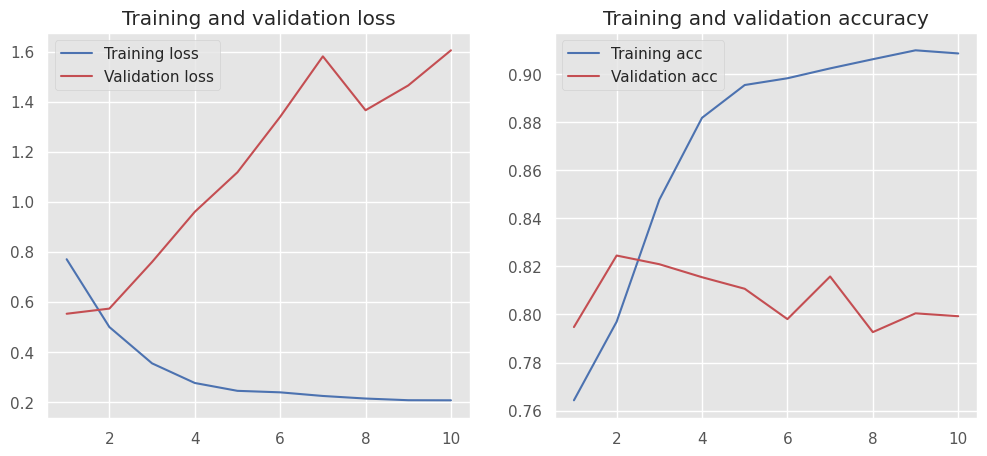

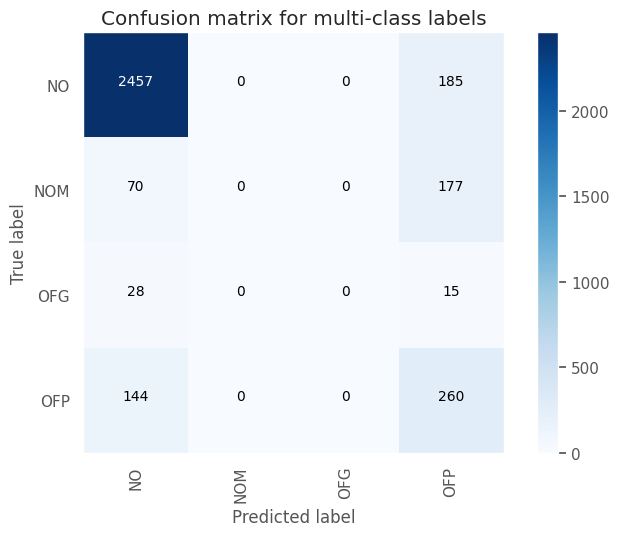

Test Accuracy: 0.8144
Test macro-F1: 0.3549


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4317    0.6152    0.5074       447
     no_hate     0.9363    0.8747    0.9044      2889

    accuracy                         0.8399      3336
   macro avg     0.6840    0.7450    0.7059      3336
weighted avg     0.8687    0.8399    0.8512      3336



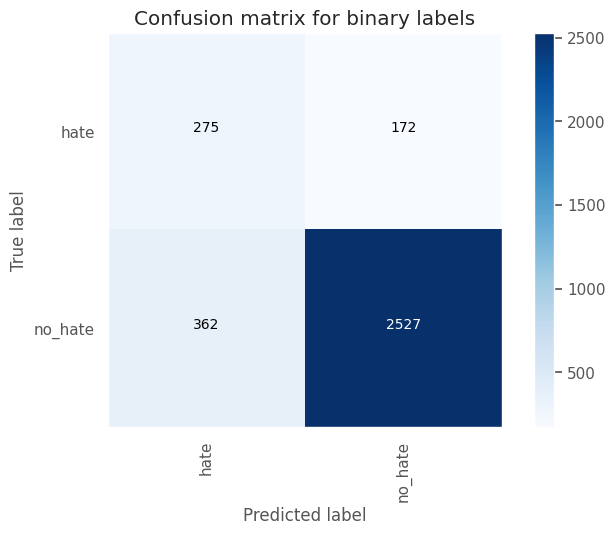

Test Accuracy: 0.8399
Test macro-F1: 0.7059






In [ ]:
vocab_size: int = 10000
max_length: int = 128
embedding_dim: int = 100

# Define Keras model
model = Sequential([
    Embedding(vocab_size, embedding_dim, input_length=max_length),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(64, activation='relu'),
    Dropout(0.5),
    Dense(32, activation='relu'),
    Dropout(0.5),
    Dense(4, activation='softmax')
])

# Data
dataset_folder: str = dataset_v1_folder
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data[
    "x_test"], data["y_test"]

# Train with our class
trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                         max_input_length=max_length))
trainer.train(x_train=x_train,
              y_train=y_train,
              opt_config=OptimizationConfig(
                  epochs=10,
                  batch_size=32,
                  validation_split=0.0,
                  validation_data=(x_val, y_val)
              ))
trainer.predict_with_report(x_test=x_test, y_test=y_test)

Obtenemos unos resultados preliminares bastante malos. Hablamos de un **35.49% de macro-F1 (MULTI-CLASS) y 70.59% de macro-f1 (BINARY CLASS)**. A las pocas epochs ya vemos como el modelo comienza a overfittear.

Agregaremos rápidamente `EarlyStopping` y utilizaremos también `class_weight`, el cual funciona de manera similar a lo que ya hemos probado antes en el notebook anterior para los modelos de scikit learn.

Total elements for train: 9960
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_8 (Embedding)         │ (9960, 128, 100)       │     1,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_8 (Flatten)             │ (9960, 12800)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (9960, 128)            │     1,638,528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_24 (Dropout)            │ (9960, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_33 (Dense)                │ (9960, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_25 (Dropout)            │ (9960, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_34 (Dense)                │ (9960, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_26 (Dropout)            │ (9960, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_35 (Dense)                │ (9960, 4)              │           132 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,648,996 (10.11 MB)

 Trainable params: 2,648,996 (10.11 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
class_weight dictionary: {0: 0.3145925457991156, 1: 3.4250343878954608, 2: 19.606299212598426, 3: 2.0906801007556677}
Epoch 1/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - acc: 0.2119 - loss: 1.4717 - val_acc: 0.1493 - val_loss: 1.3578
Epoch 2/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - acc: 0.2057 - loss: 1.4833 - val_acc: 0.0731 - val_loss: 1.3412
Epoch 3/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 6s 20ms/step - acc: 0.1672 - loss: 1.4408 - val_acc: 0.0728 - val_loss: 1.3876
Epoch 4/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - acc: 0.1370 - loss: 1.4435 - val_acc: 0.0728 - val_loss: 1.3761
Epoch 5/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - acc: 0.1136 - loss: 1.4569 - val_acc: 0.0126 - val_loss: 1.4000
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.0000    0.0000    0.0000    

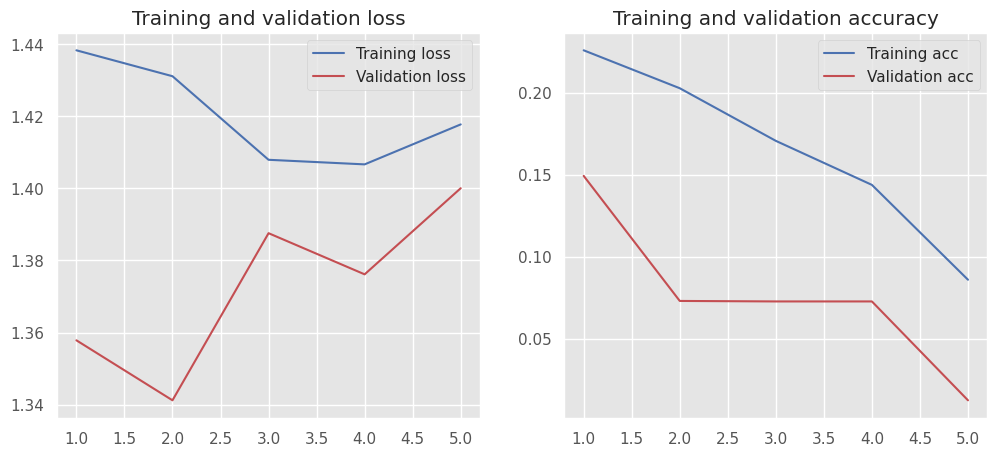

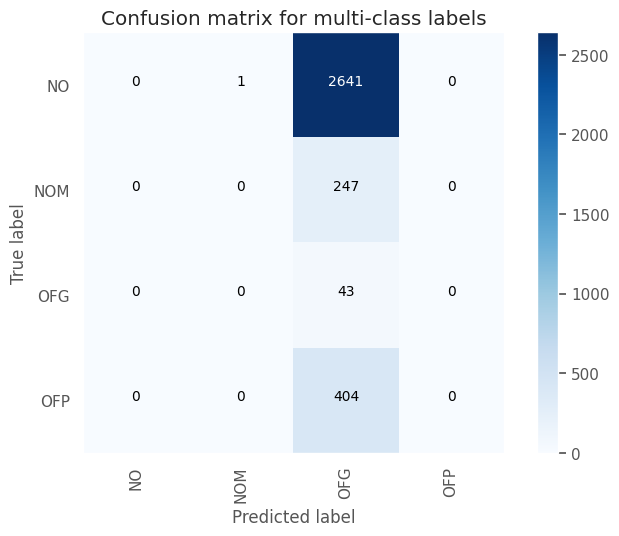

Test Accuracy: 0.0129
Test macro-F1: 0.0064


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.1340    1.0000    0.2364       447
     no_hate     1.0000    0.0003    0.0007      2889

    accuracy                         0.1343      3336
   macro avg     0.5670    0.5002    0.1185      3336
weighted avg     0.8840    0.1343    0.0323      3336



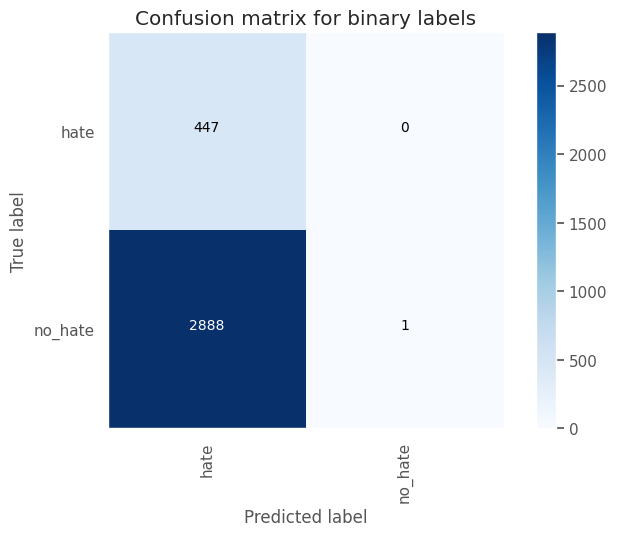

Test Accuracy: 0.1343
Test macro-F1: 0.1185






In [ ]:
vocab_size: int = 10000
max_length: int = 128
embedding_dim: int = 100

# Define Keras model
model = Sequential([
    Embedding(vocab_size, embedding_dim, input_length=max_length),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(64, activation='relu'),
    Dropout(0.5),
    Dense(32, activation='relu'),
    Dropout(0.5),
    Dense(4, activation='softmax')
])

# Data
dataset_folder: str = dataset_v1_folder
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data[
    "x_test"], data["y_test"]

# Train with our class
trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                         max_input_length=max_length))
trainer.train(x_train=x_train,
              y_train=y_train,
              opt_config=OptimizationConfig(
                  epochs=25,
                  batch_size=32,
                  validation_split=0.0,
                  validation_data=(x_val, y_val),
                  class_weight="balanced"
              ),
              callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=3, min_delta=0.01)])
trainer.predict_with_report(x_test=x_test, y_test=y_test)

Vemos que los resultados en este caso son tremendamente peores. Podemos comenzar por probar arquitecturas más sencillas (con menos parámetros) para ver cómo nos va.

Total elements for train: 9960
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_9"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_9 (Embedding)         │ (9960, 128, 100)       │     1,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_9 (Flatten)             │ (9960, 12800)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_36 (Dense)                │ (9960, 128)            │     1,638,528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_27 (Dropout)            │ (9960, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_37 (Dense)                │ (9960, 4)              │           516 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,639,044 (10.07 MB)

 Trainable params: 2,639,044 (10.07 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - acc: 0.7875 - loss: 0.6893 - val_acc: 0.8480 - val_loss: 0.4792
Epoch 2/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - acc: 0.8524 - loss: 0.3994 - val_acc: 0.8553 - val_loss: 0.5147
Epoch 3/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - acc: 0.9279 - loss: 0.2063 - val_acc: 0.8221 - val_loss: 0.6592
Epoch 4/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step - acc: 0.9727 - loss: 0.0849 - val_acc: 0.8459 - val_loss: 0.7151
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9045    0.9459    0.9247      2642
         NOM     0.6618    0.5466    0.5987       247
         OFG     0.0000    0.0000    0.0000        43
         OFP     0.5912    0.5297    0.5587       404

    accuracy                         0.8537      3336
   macro avg 

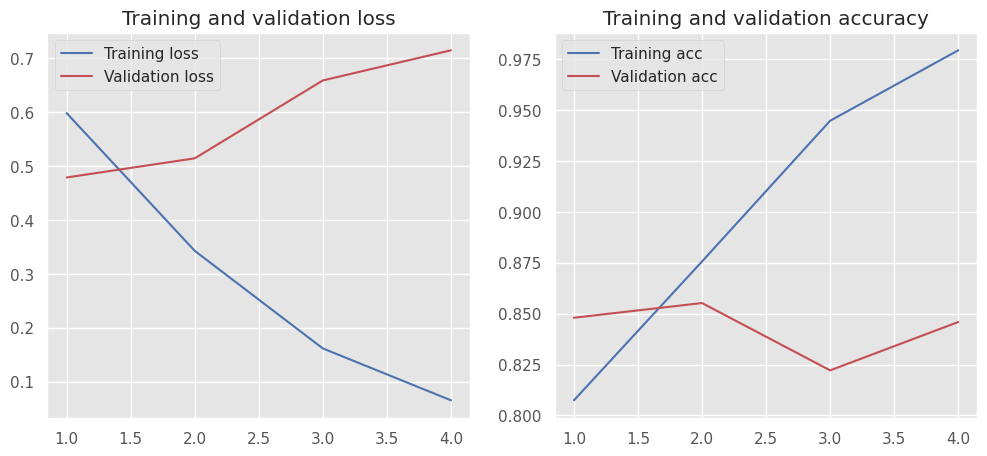

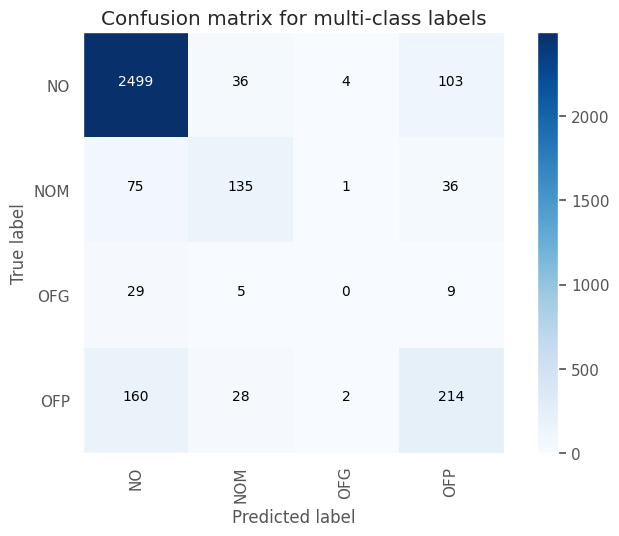

Test Accuracy: 0.8537
Test macro-F1: 0.5205


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6098    0.5034    0.5515       447
     no_hate     0.9252    0.9502    0.9375      2889

    accuracy                         0.8903      3336
   macro avg     0.7675    0.7268    0.7445      3336
weighted avg     0.8829    0.8903    0.8858      3336



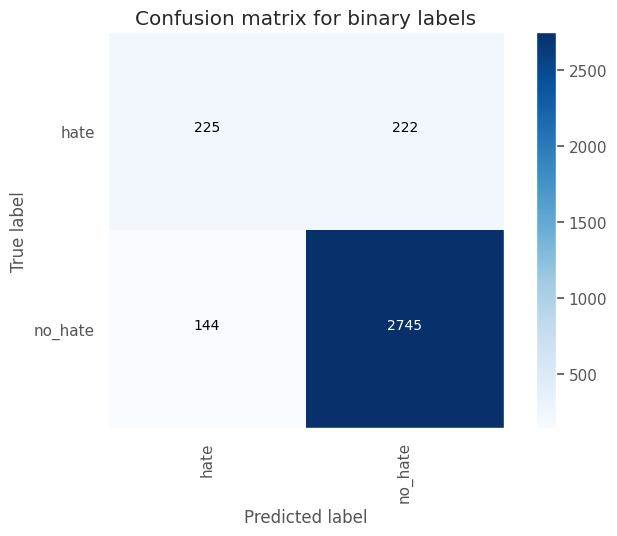

Test Accuracy: 0.8903
Test macro-F1: 0.7445






In [ ]:
vocab_size: int = 10000
max_length: int = 128
embedding_dim: int = 100

# Define Keras model
model = Sequential([
    Embedding(vocab_size, embedding_dim, input_length=max_length),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(4, activation='softmax')
])

# Data
dataset_folder: str = dataset_v1_folder
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data[
    "x_test"], data["y_test"]

# Train with our class
trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                         max_input_length=max_length))
trainer.train(x_train=x_train,
              y_train=y_train,
              opt_config=OptimizationConfig(
                  epochs=25,
                  batch_size=32,
                  validation_split=0.0,
                  validation_data=(x_val, y_val)
              ),
              callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=3, min_delta=0.01)])
trainer.predict_with_report(x_test=x_test, y_test=y_test)

Mejoramos un poco al hacer uso de `EarlyStopping` y utilizar una arquitectura más sencilla. Obtenemos un **52.05% de macro-F1 (MULTI-CLASS) y 74.45% de macro-f1 (BINARY CLASS)**. De igual manera, a las pocas epochs ya vemos como el modelo comienza a overfittear.

Simplifiquemos todavía más.

Total elements for train: 9960
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_10 (Embedding)        │ (9960, 128, 100)       │     1,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_10 (Flatten)            │ (9960, 12800)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_38 (Dense)                │ (9960, 64)             │       819,264 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_28 (Dropout)            │ (9960, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_39 (Dense)                │ (9960, 4)              │           260 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,819,524 (6.94 MB)

 Trainable params: 1,819,524 (6.94 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 6s 13ms/step - acc: 0.7828 - loss: 0.6909 - val_acc: 0.8303 - val_loss: 0.4862
Epoch 2/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - acc: 0.8519 - loss: 0.4073 - val_acc: 0.8459 - val_loss: 0.5141
Epoch 3/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - acc: 0.9275 - loss: 0.2154 - val_acc: 0.8288 - val_loss: 0.6578
Epoch 4/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - acc: 0.9696 - loss: 0.0949 - val_acc: 0.8405 - val_loss: 0.7378
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9115    0.9440    0.9275      2642
         NOM     0.6683    0.5466    0.6013       247
         OFG     0.0000    0.0000    0.0000        43
         OFP     0.5768    0.5668    0.5718       404

    accuracy                         0.8567      3336
   macro avg 

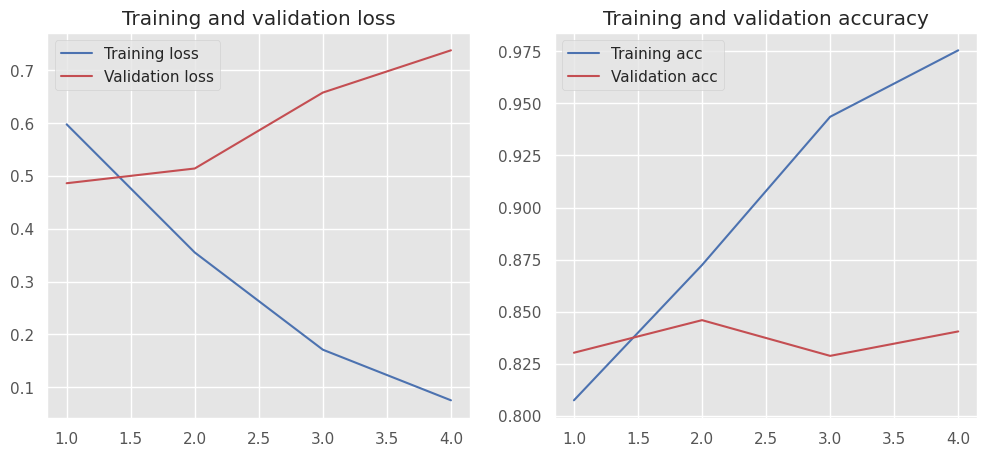

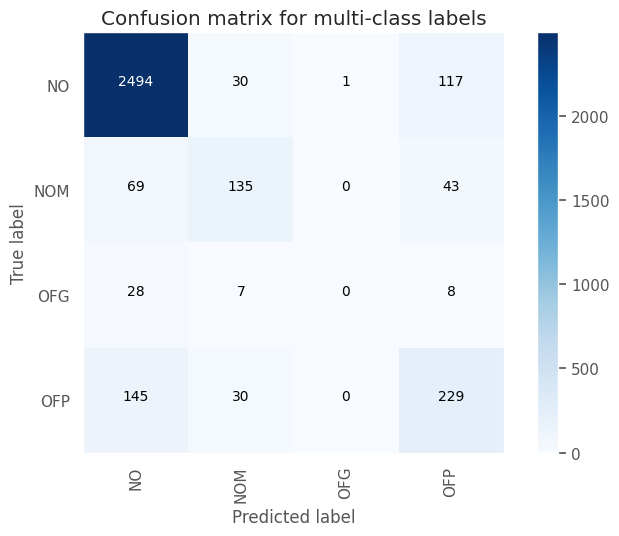

Test Accuracy: 0.8567
Test macro-F1: 0.5252


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5955    0.5302    0.5609       447
     no_hate     0.9285    0.9443    0.9363      2889

    accuracy                         0.8888      3336
   macro avg     0.7620    0.7372    0.7486      3336
weighted avg     0.8839    0.8888    0.8860      3336



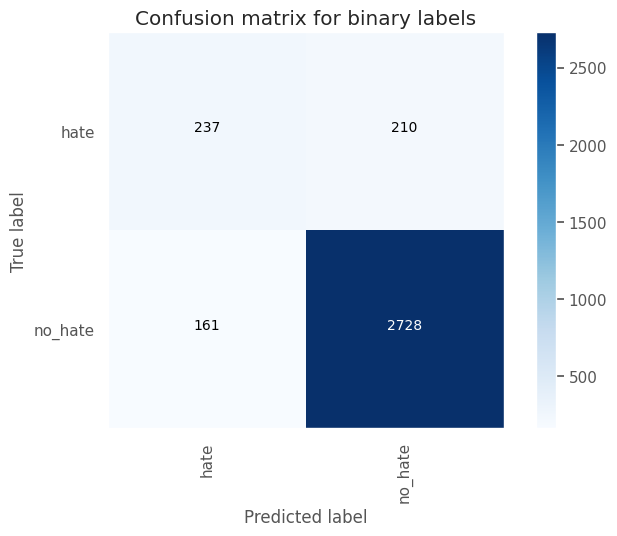

Test Accuracy: 0.8888
Test macro-F1: 0.7486






In [ ]:
vocab_size: int = 10000
max_length: int = 128
embedding_dim: int = 100

# Define Keras model
model = Sequential([
    Embedding(vocab_size, embedding_dim, input_length=max_length),
    Flatten(),
    Dense(64, activation='relu'),
    Dropout(0.3),
    Dense(4, activation='softmax')
])

# Data
dataset_folder: str = dataset_v1_folder
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data[
    "x_test"], data["y_test"]

# Train with our class
trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                         max_input_length=max_length))
trainer.train(x_train=x_train,
              y_train=y_train,
              opt_config=OptimizationConfig(
                  epochs=25,
                  batch_size=32,
                  validation_split=0.0,
                  validation_data=(x_val, y_val)
              ),
              callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=3, min_delta=0.01)])
trainer.predict_with_report(x_test=x_test, y_test=y_test)

Mejoramos un pelín al hacer uso de `EarlyStopping` y utilizar una arquitectura más sencilla. Obtenemos un **52.52% de macro-F1 (MULTI-CLASS) y 74.86% de macro-f1 (BINARY CLASS)**. De igual manera, a las pocas epochs ya vemos como el modelo comienza a overfittear.

Seguimos viendo los problemas que hemos notado en notebooks anteriores para `OFG`. Podemos probar reducir aún más la red a través del vocabulario de la Embedding layer.

Total elements for train: 9960
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_11 (Embedding)        │ (9960, 128, 100)       │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_11 (Flatten)            │ (9960, 12800)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ (9960, 64)             │       819,264 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_29 (Dropout)            │ (9960, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (9960, 4)              │           260 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,319,524 (5.03 MB)

 Trainable params: 1,319,524 (5.03 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 5s 10ms/step - acc: 0.7804 - loss: 0.6999 - val_acc: 0.8270 - val_loss: 0.4980
Epoch 2/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - acc: 0.8419 - loss: 0.4346 - val_acc: 0.8468 - val_loss: 0.4945
Epoch 3/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - acc: 0.9088 - loss: 0.2651 - val_acc: 0.8471 - val_loss: 0.6061
Epoch 4/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - acc: 0.9521 - loss: 0.1368 - val_acc: 0.8321 - val_loss: 0.7383
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9116    0.9364    0.9238      2642
         NOM     0.7160    0.4899    0.5817       247
         OFG     0.0000    0.0000    0.0000        43
         OFP     0.5541    0.6213    0.5858       404

    accuracy                         0.8531      3336
   macro avg    

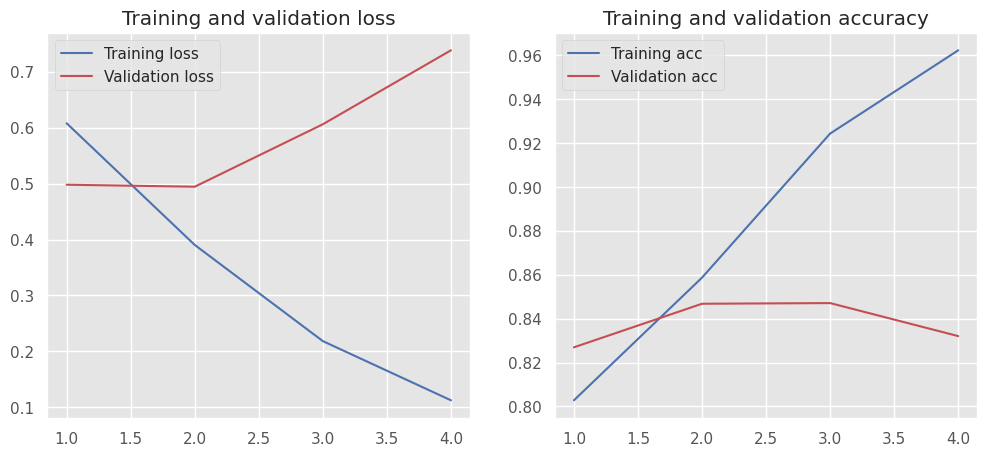

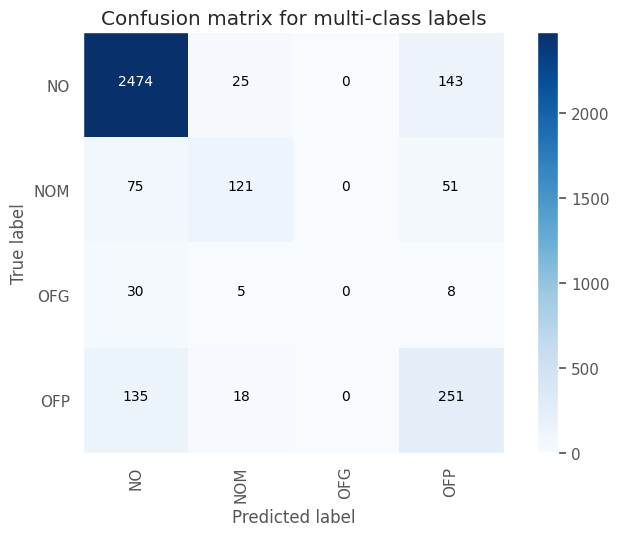

Test Accuracy: 0.8531
Test macro-F1: 0.5228


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5717    0.5794    0.5756       447
     no_hate     0.9348    0.9328    0.9338      2889

    accuracy                         0.8855      3336
   macro avg     0.7533    0.7561    0.7547      3336
weighted avg     0.8861    0.8855    0.8858      3336



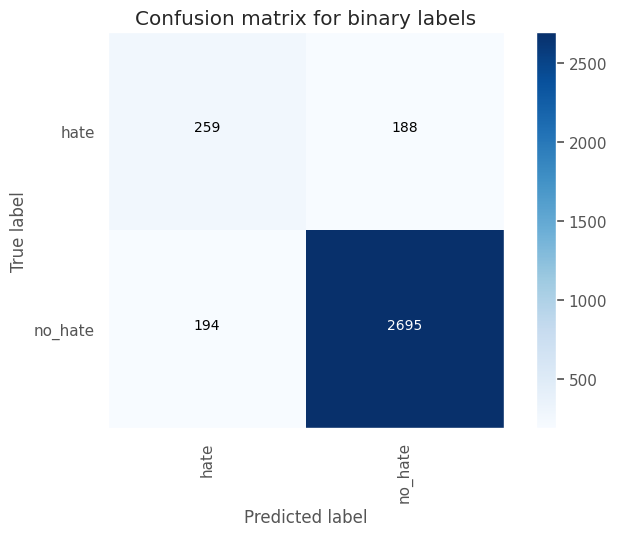

Test Accuracy: 0.8855
Test macro-F1: 0.7547






In [ ]:
vocab_size: int = 5000
max_length: int = 128
embedding_dim: int = 100

# Define Keras model
model = Sequential([
    Embedding(vocab_size, embedding_dim, input_length=max_length),
    Flatten(),
    Dense(64, activation='relu'),
    Dropout(0.3),
    Dense(4, activation='softmax')
])

# Data
dataset_folder: str = dataset_v1_folder
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data[
    "x_test"], data["y_test"]

# Train with our class
trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                         max_input_length=max_length))
trainer.train(x_train=x_train,
              y_train=y_train,
              opt_config=OptimizationConfig(
                  epochs=25,
                  batch_size=32,
                  validation_split=0.0,
                  validation_data=(x_val, y_val)
              ),
              callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=3, min_delta=0.01)])
trainer.predict_with_report(x_test=x_test, y_test=y_test)

No notamos demasiada diferencia con el caso anterior. Únicamente es interesante notar que la validation_loss no diverge en la primera epoch si no que se mantiene similar.

Training with dense_dim=4 ==============>
Total elements for train: 9960
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_13 (Embedding)        │ (9960, 128, 100)       │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_13 (Flatten)            │ (9960, 12800)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_44 (Dense)                │ (9960, 4)              │        51,204 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_31 (Dropout)            │ (9960, 4)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (9960, 4)              │            20 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 551,224 (2.10 MB)

 Trainable params: 551,224 (2.10 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - acc: 0.7607 - loss: 0.9307 - val_acc: 0.7939 - val_loss: 0.5675
Epoch 2/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - acc: 0.8040 - loss: 0.5833 - val_acc: 0.8258 - val_loss: 0.5058
Epoch 3/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - acc: 0.8398 - loss: 0.4609 - val_acc: 0.8152 - val_loss: 0.5351
Epoch 4/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - acc: 0.8548 - loss: 0.3895 - val_acc: 0.8152 - val_loss: 0.5750
Epoch 5/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - acc: 0.8558 - loss: 0.3531 - val_acc: 0.8152 - val_loss: 0.6287
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.8926    0.9625    0.9262      2642
         NOM     0.0000    0.0000    0.0000       247
         OFG     0.0000    0.0000    0.0000        43
        

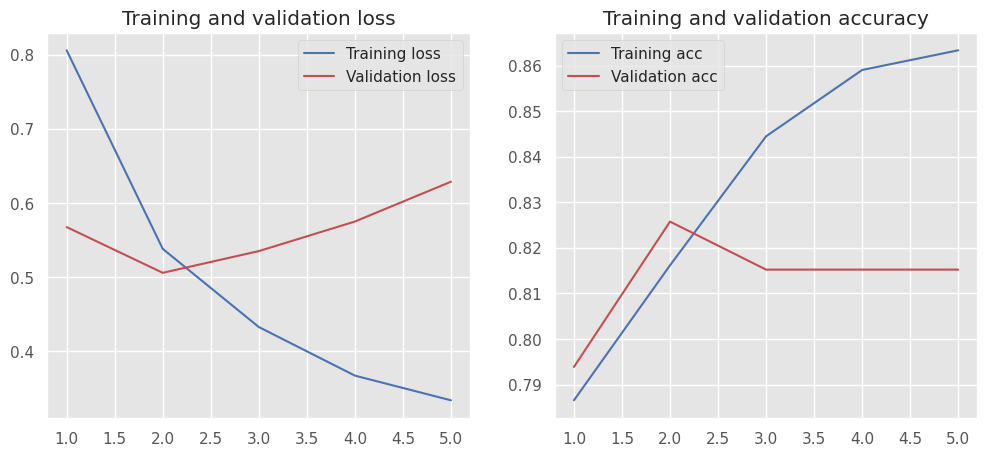

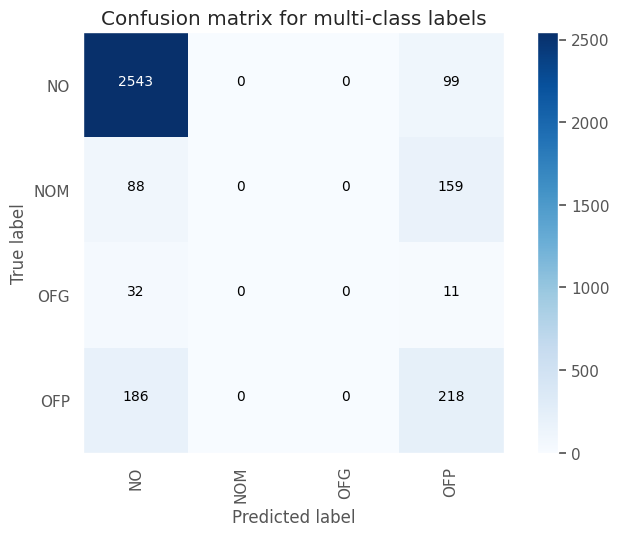

Test Accuracy: 0.8276
Test macro-F1: 0.3539


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4702    0.5123    0.4904       447
     no_hate     0.9235    0.9107    0.9170      2889

    accuracy                         0.8573      3336
   macro avg     0.6969    0.7115    0.7037      3336
weighted avg     0.8627    0.8573    0.8599      3336



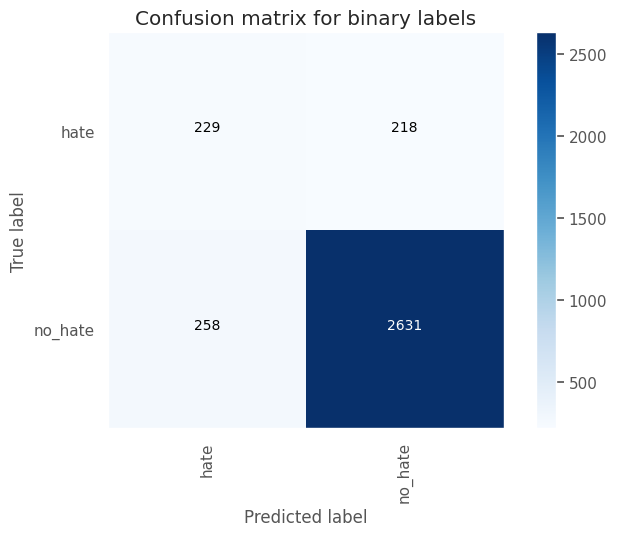

Test Accuracy: 0.8573
Test macro-F1: 0.7037




Training with dense_dim=8 ==============>
Total elements for train: 9960
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_14"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_14 (Embedding)        │ (9960, 128, 100)       │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_14 (Flatten)            │ (9960, 12800)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (9960, 8)              │       102,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_32 (Dropout)            │ (9960, 8)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (9960, 4)              │            36 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 602,444 (2.30 MB)

 Trainable params: 602,444 (2.30 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - acc: 0.7599 - loss: 0.9217 - val_acc: 0.7945 - val_loss: 0.5794
Epoch 2/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - acc: 0.8011 - loss: 0.5784 - val_acc: 0.8294 - val_loss: 0.5321
Epoch 3/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - acc: 0.8375 - loss: 0.4175 - val_acc: 0.8297 - val_loss: 0.5629
Epoch 4/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - acc: 0.8567 - loss: 0.3455 - val_acc: 0.8294 - val_loss: 0.6193
Epoch 5/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - acc: 0.8756 - loss: 0.2933 - val_acc: 0.8252 - val_loss: 0.7091
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9039    0.9538    0.9282      2642
         NOM     0.6377    0.1781    0.2785       247
         OFG     0.0000    0.0000    0.0000        43
        

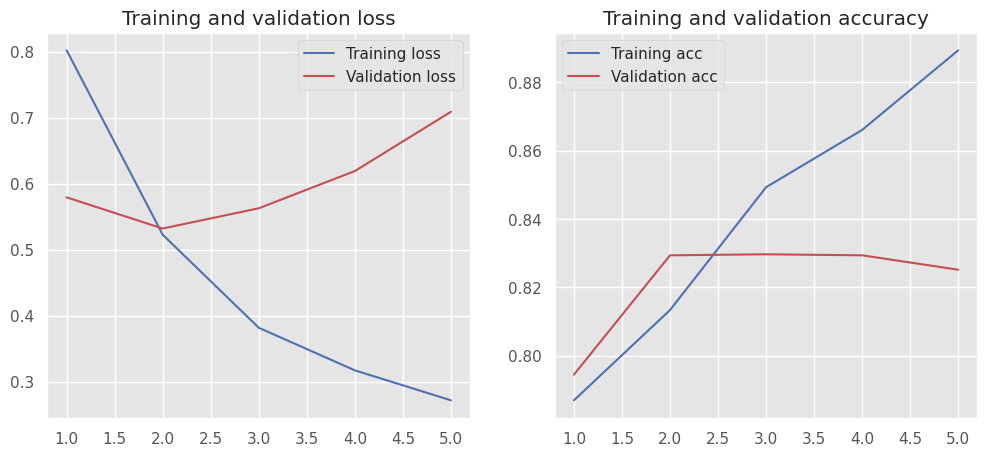

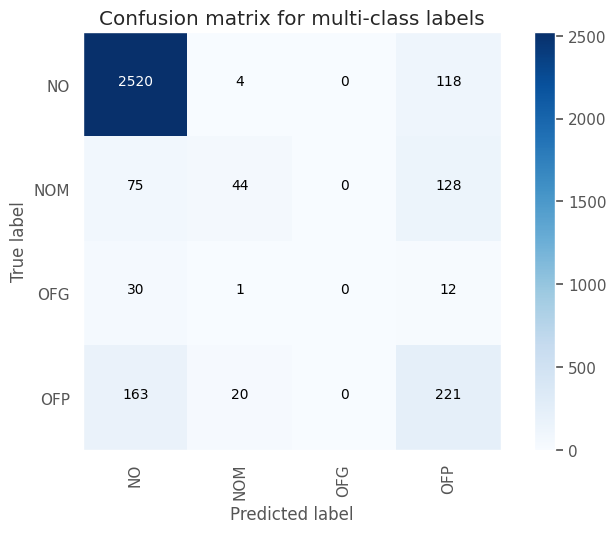

Test Accuracy: 0.8348
Test macro-F1: 0.4268


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4864    0.5213    0.5032       447
     no_hate     0.9251    0.9148    0.9199      2889

    accuracy                         0.8621      3336
   macro avg     0.7058    0.7181    0.7116      3336
weighted avg     0.8663    0.8621    0.8641      3336



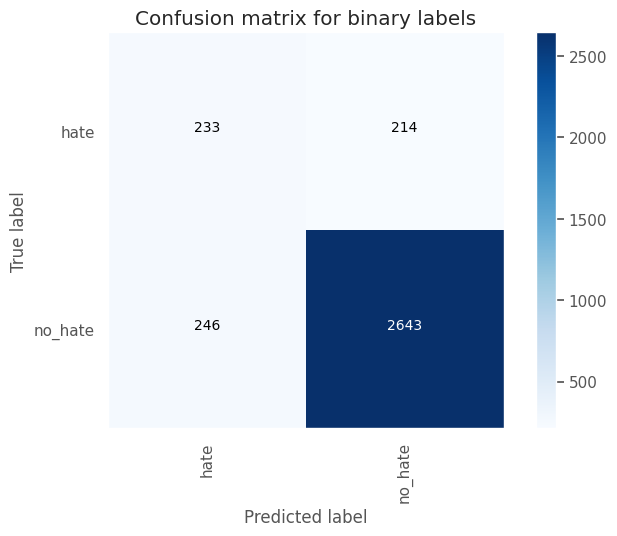

Test Accuracy: 0.8621
Test macro-F1: 0.7116




Training with dense_dim=16 ==============>
Total elements for train: 9960
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_15"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_15 (Embedding)        │ (9960, 128, 100)       │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_15 (Flatten)            │ (9960, 12800)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (9960, 16)             │       204,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_33 (Dropout)            │ (9960, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_49 (Dense)                │ (9960, 4)              │            68 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 704,884 (2.69 MB)

 Trainable params: 704,884 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - acc: 0.7655 - loss: 0.7840 - val_acc: 0.8276 - val_loss: 0.5110
Epoch 2/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - acc: 0.8303 - loss: 0.4880 - val_acc: 0.8429 - val_loss: 0.5039
Epoch 3/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - acc: 0.8775 - loss: 0.3330 - val_acc: 0.8438 - val_loss: 0.5633
Epoch 4/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - acc: 0.9211 - loss: 0.2288 - val_acc: 0.8489 - val_loss: 0.6446
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9052    0.9504    0.9273      2642
         NOM     0.6316    0.5830    0.6063       247
         OFG     0.0000    0.0000    0.0000        43
         OFP     0.6138    0.5074    0.5556       404

    accuracy                         0.8573      3336
   macro avg     

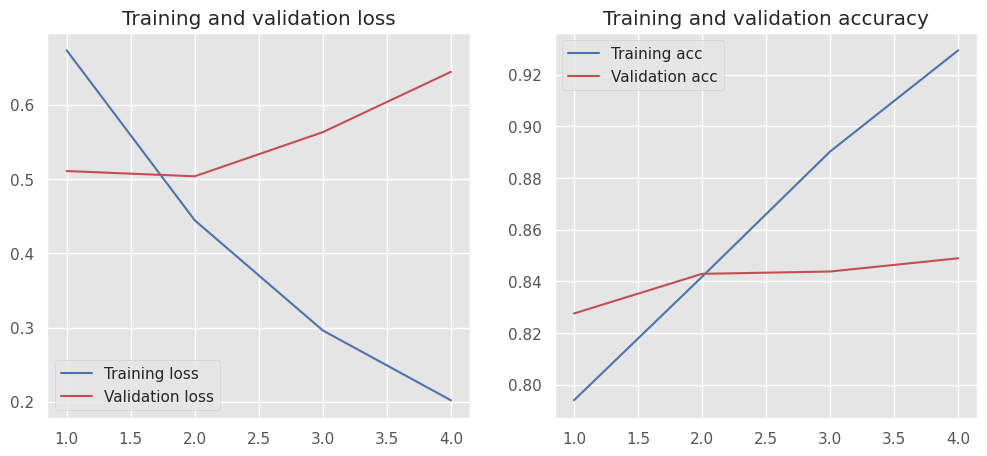

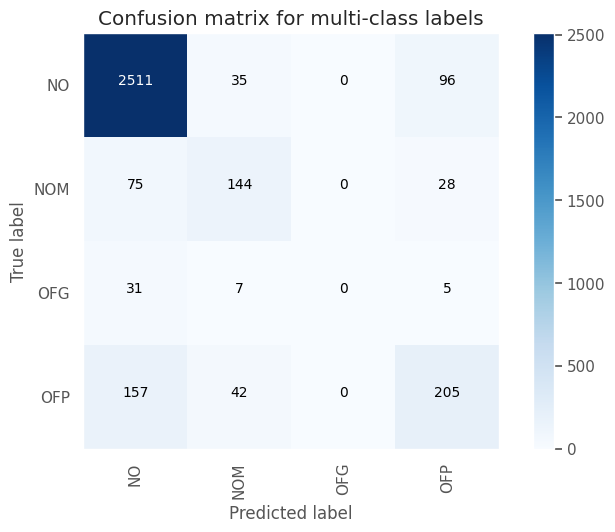

Test Accuracy: 0.8573
Test macro-F1: 0.5223


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6287    0.4698    0.5378       447
     no_hate     0.9211    0.9571    0.9387      2889

    accuracy                         0.8918      3336
   macro avg     0.7749    0.7134    0.7382      3336
weighted avg     0.8819    0.8918    0.8850      3336



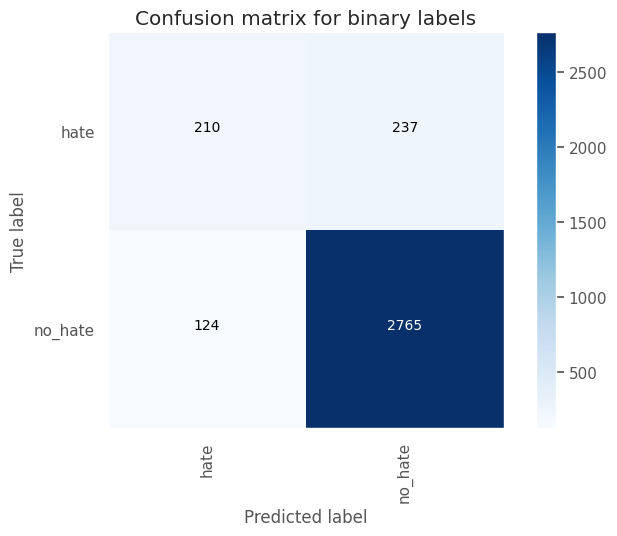

Test Accuracy: 0.8918
Test macro-F1: 0.7382




Training with dense_dim=32 ==============>
Total elements for train: 9960
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_16 (Embedding)        │ (9960, 128, 100)       │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_16 (Flatten)            │ (9960, 12800)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (9960, 32)             │       409,632 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_34 (Dropout)            │ (9960, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (9960, 4)              │           132 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 909,764 (3.47 MB)

 Trainable params: 909,764 (3.47 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.7795 - loss: 0.7277 - val_acc: 0.8276 - val_loss: 0.4967
Epoch 2/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.8403 - loss: 0.4472 - val_acc: 0.8516 - val_loss: 0.4881
Epoch 3/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.9135 - loss: 0.2611 - val_acc: 0.8435 - val_loss: 0.5735
Epoch 4/25
312/312 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.9474 - loss: 0.1438 - val_acc: 0.8498 - val_loss: 0.6784
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9050    0.9553    0.9295      2642
         NOM     0.6618    0.5466    0.5987       247
         OFG     0.0000    0.0000    0.0000        43
         OFP     0.6239    0.5297    0.5730       404

    accuracy                         0.8612      3336
   macro avg     

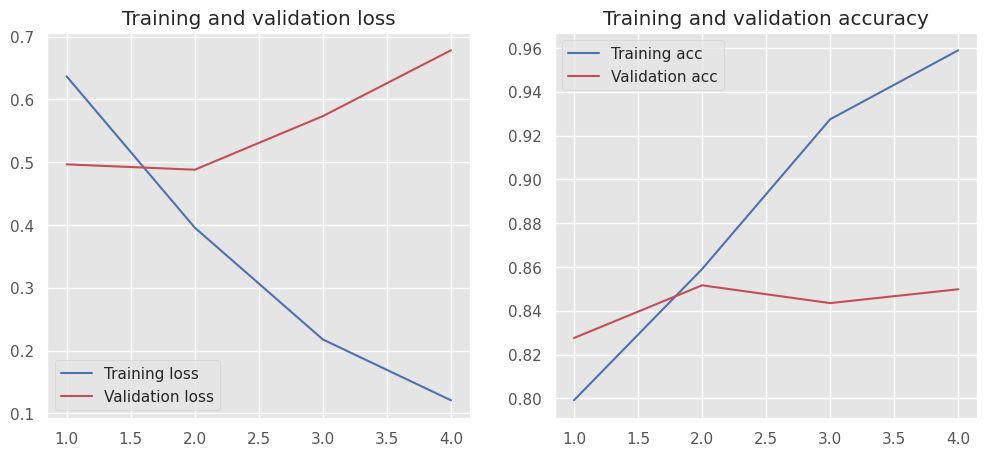

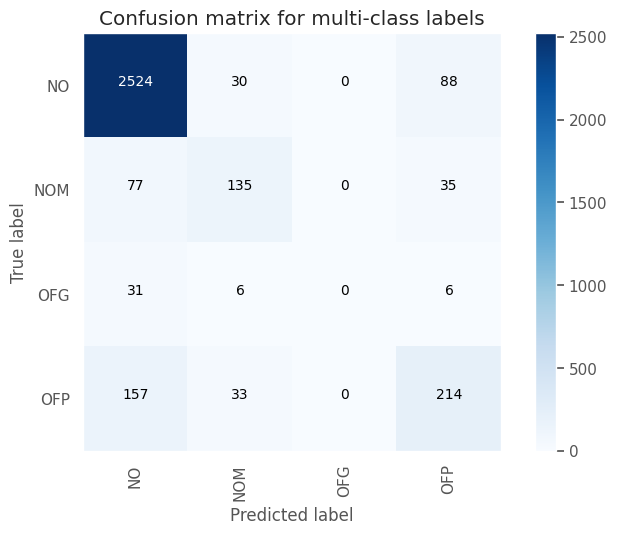

Test Accuracy: 0.8612
Test macro-F1: 0.5253


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6414    0.4922    0.5570       447
     no_hate     0.9242    0.9574    0.9405      2889

    accuracy                         0.8951      3336
   macro avg     0.7828    0.7248    0.7487      3336
weighted avg     0.8863    0.8951    0.8891      3336



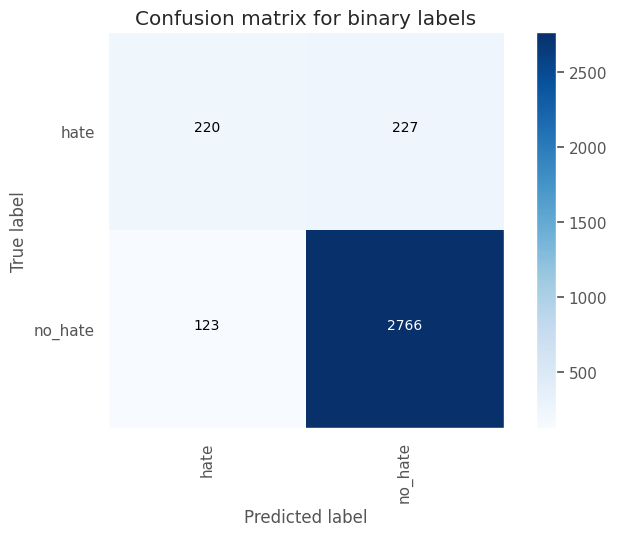

Test Accuracy: 0.8951
Test macro-F1: 0.7487






In [ ]:
vocab_size: int = 5000
max_length: int = 128
embedding_dim: int = 100

for dense_dim in [4, 8, 16, 32]:
    print(f"Training with dense_dim={dense_dim} ==============>")
    # Define Keras model
    model = Sequential([
        Embedding(vocab_size, embedding_dim, input_length=max_length),
        Flatten(),
        Dense(dense_dim, activation='relu'),
        Dropout(0.3),
        Dense(4, activation='softmax')
    ])

    # Data
    dataset_folder: str = dataset_v1_folder
    data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
    x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], \
        data[
            "x_test"], data["y_test"]

    # Train with our class
    trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                             max_input_length=max_length))
    trainer.train(x_train=x_train,
                  y_train=y_train,
                  opt_config=OptimizationConfig(
                      epochs=25,
                      batch_size=32,
                      validation_split=0.0,
                      validation_data=(x_val, y_val)
                  ),
                  callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=3, min_delta=0.01)])
    trainer.predict_with_report(x_test=x_test, y_test=y_test)

Podamos notar cosas interesantes como que llega un punto (con dense_dim=4) donde ya nos cuesta fittear el training set (underfitting). Conforme comenzamos a incrementar más y más la cantidad de dimensiones, logramos fitear muy bien el training set, pero el comportamiento sobre el validation set es bastante malo.

Esto lo hemos ido viendo en las prácticas anteriores también.

## Entrenando sobre `v2`

Probaremos ahora sobre `v2`, el cual tiene las mismas reglas que `v1` sólo que aplicamos Random Over Sampling para balancearlo.

Arrancaremos por algo bien sencillo.

Training with dense_dim=4 ==============>
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_17"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_17 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_17 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (31660, 4)             │        51,204 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_35 (Dropout)            │ (31660, 4)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_53 (Dense)                │ (31660, 4)             │            20 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 551,224 (2.10 MB)

 Trainable params: 551,224 (2.10 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - acc: 0.4400 - loss: 1.0638 - val_acc: 0.8125 - val_loss: 0.5704
Epoch 2/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.7428 - loss: 0.4905 - val_acc: 0.8252 - val_loss: 0.6394
Epoch 3/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.7791 - loss: 0.4126 - val_acc: 0.8131 - val_loss: 0.7646
Epoch 4/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.7992 - loss: 0.3830 - val_acc: 0.8110 - val_loss: 0.9283
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9081    0.9235    0.9157      2642
         NOM     0.6034    0.4372    0.5070       247
         OFG     0.1250    0.0233    0.0392        43
         OFP     0.4199    0.4802    0.4480       404

    accuracy                         0.8222      3336
   macro avg     

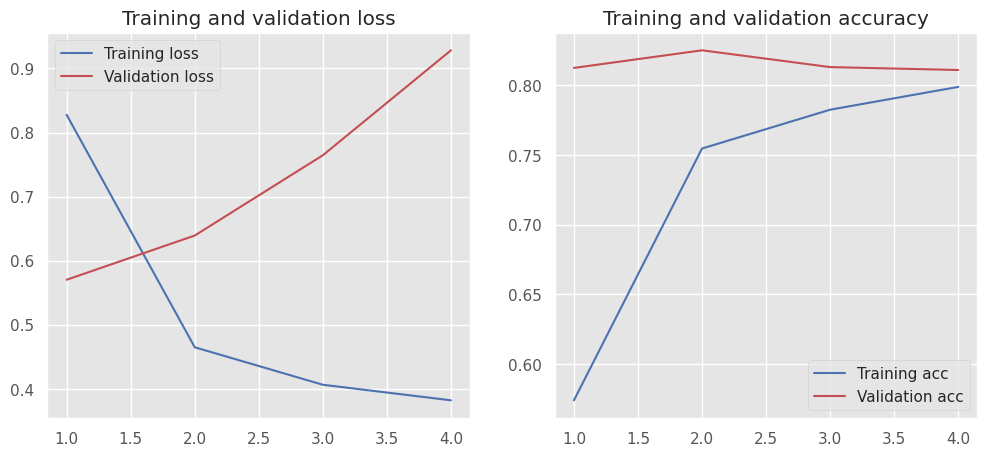

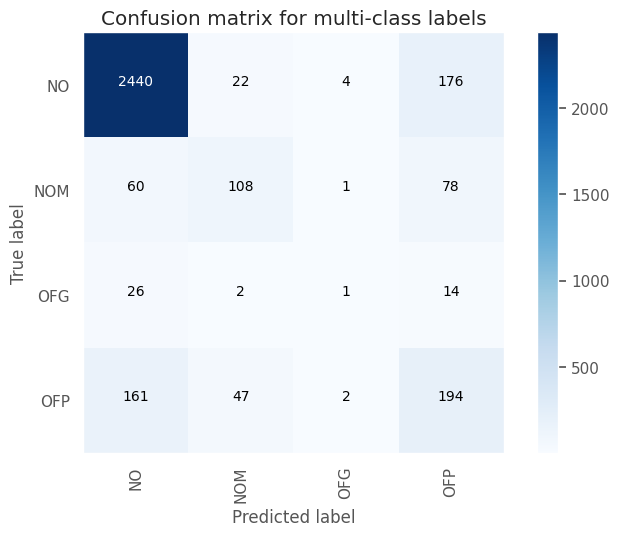

Test Accuracy: 0.8222
Test macro-F1: 0.4775


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4489    0.4720    0.4602       447
     no_hate     0.9177    0.9103    0.9140      2889

    accuracy                         0.8516      3336
   macro avg     0.6833    0.6912    0.6871      3336
weighted avg     0.8549    0.8516    0.8532      3336



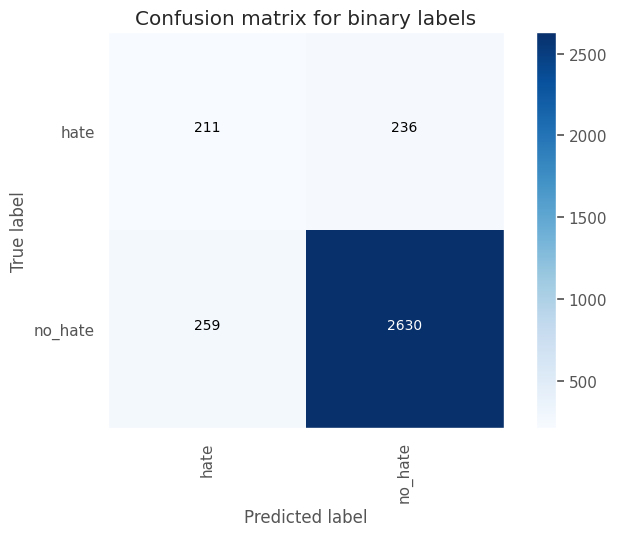

Test Accuracy: 0.8516
Test macro-F1: 0.6871




Training with dense_dim=8 ==============>
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_18"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_18 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_18 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_54 (Dense)                │ (31660, 8)             │       102,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_36 (Dropout)            │ (31660, 8)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_55 (Dense)                │ (31660, 4)             │            36 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 602,444 (2.30 MB)

 Trainable params: 602,444 (2.30 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - acc: 0.4394 - loss: 1.1090 - val_acc: 0.8291 - val_loss: 0.5341
Epoch 2/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.9128 - loss: 0.2555 - val_acc: 0.8474 - val_loss: 0.6194
Epoch 3/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.9484 - loss: 0.1426 - val_acc: 0.8390 - val_loss: 0.7863
Epoch 4/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.9548 - loss: 0.1156 - val_acc: 0.8375 - val_loss: 0.8935
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9009    0.9527    0.9260      2642
         NOM     0.5736    0.4575    0.5090       247
         OFG     0.1429    0.0233    0.0400        43
         OFP     0.6272    0.5248    0.5714       404

    accuracy                         0.8522      3336
   macro avg     

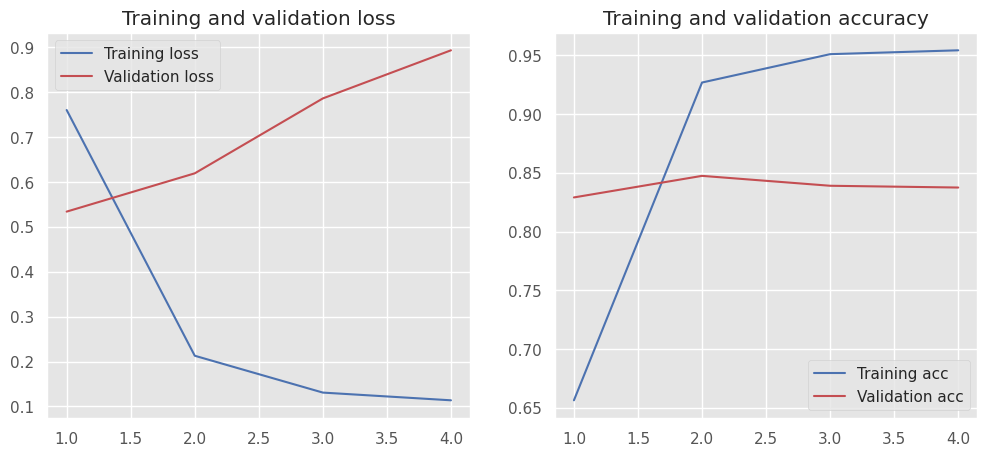

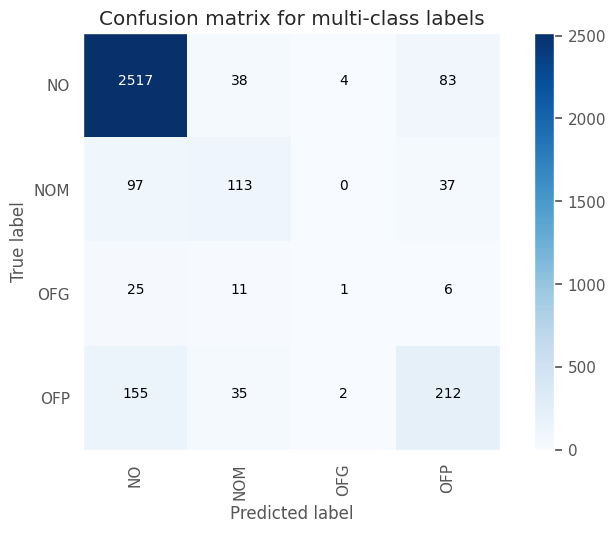

Test Accuracy: 0.8522
Test macro-F1: 0.5116


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6406    0.4944    0.5581       447
     no_hate     0.9244    0.9571    0.9405      2889

    accuracy                         0.8951      3336
   macro avg     0.7825    0.7257    0.7493      3336
weighted avg     0.8864    0.8951    0.8892      3336



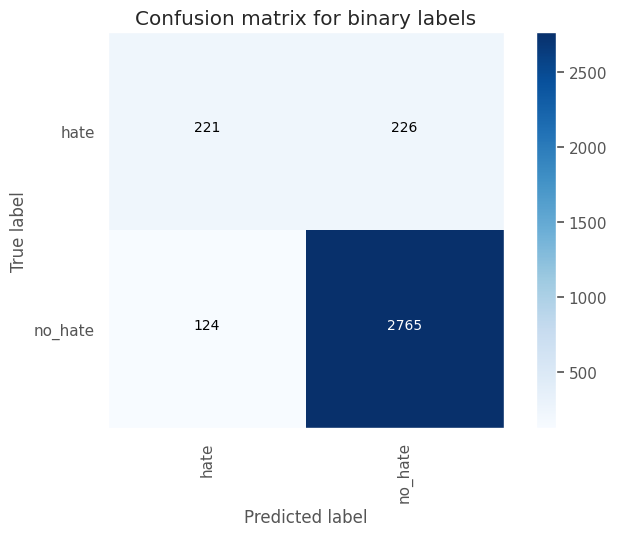

Test Accuracy: 0.8951
Test macro-F1: 0.7493




Training with dense_dim=16 ==============>
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_19"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_19 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_19 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_56 (Dense)                │ (31660, 16)            │       204,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_37 (Dropout)            │ (31660, 16)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_57 (Dense)                │ (31660, 4)             │            68 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 704,884 (2.69 MB)

 Trainable params: 704,884 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - acc: 0.5706 - loss: 0.9037 - val_acc: 0.8444 - val_loss: 0.5596
Epoch 2/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9643 - loss: 0.1345 - val_acc: 0.8550 - val_loss: 0.8404
Epoch 3/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9838 - loss: 0.0691 - val_acc: 0.8441 - val_loss: 0.9060
Epoch 4/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9916 - loss: 0.0414 - val_acc: 0.8453 - val_loss: 1.1075
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9015    0.9493    0.9248      2642
         NOM     0.5926    0.5182    0.5529       247
         OFG     0.0909    0.0233    0.0370        43
         OFP     0.6177    0.5000    0.5527       404

    accuracy                         0.8510      3336
   macro avg     

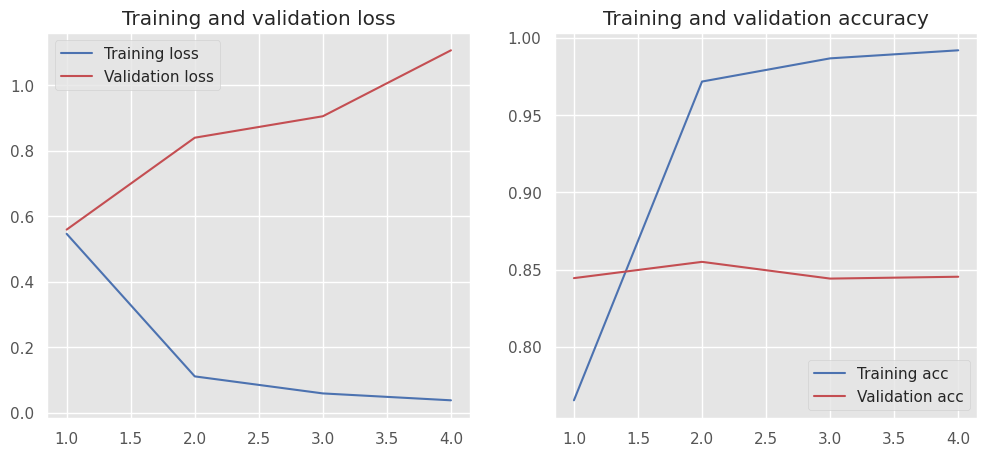

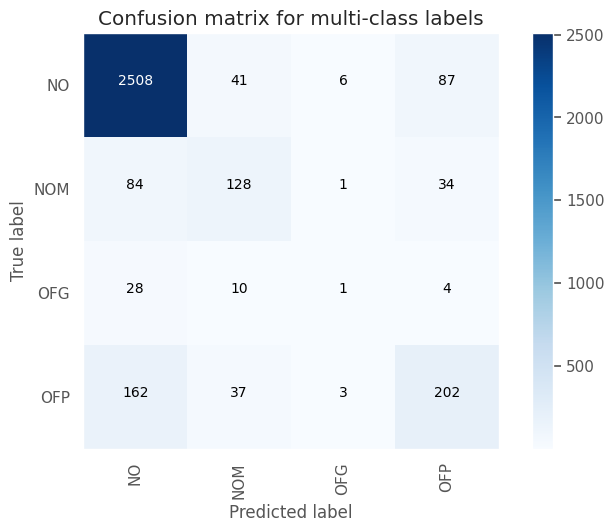

Test Accuracy: 0.851
Test macro-F1: 0.5168


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6213    0.4698    0.5350       447
     no_hate     0.9209    0.9557    0.9380      2889

    accuracy                         0.8906      3336
   macro avg     0.7711    0.7127    0.7365      3336
weighted avg     0.8808    0.8906    0.8840      3336



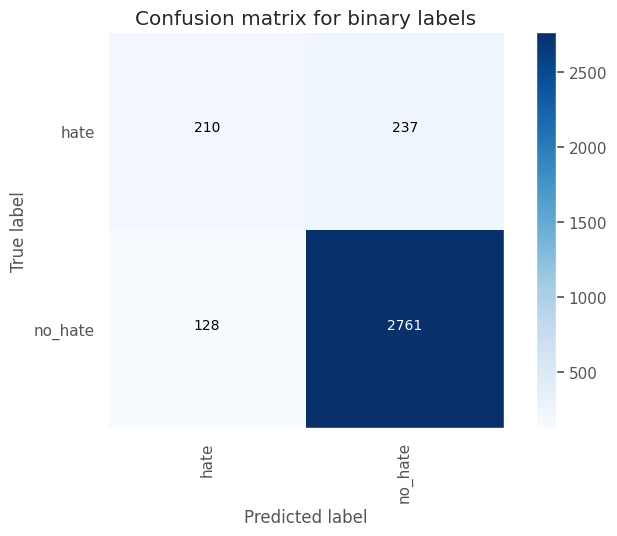

Test Accuracy: 0.8906
Test macro-F1: 0.7365




Training with dense_dim=32 ==============>
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_20"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_20 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_20 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_58 (Dense)                │ (31660, 32)            │       409,632 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_38 (Dropout)            │ (31660, 32)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_59 (Dense)                │ (31660, 4)             │           132 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 909,764 (3.47 MB)

 Trainable params: 909,764 (3.47 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - acc: 0.6550 - loss: 0.7866 - val_acc: 0.8492 - val_loss: 0.6389
Epoch 2/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - acc: 0.9838 - loss: 0.0596 - val_acc: 0.8426 - val_loss: 0.8271
Epoch 3/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - acc: 0.9934 - loss: 0.0254 - val_acc: 0.8429 - val_loss: 1.1182
Epoch 4/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - acc: 0.9952 - loss: 0.0166 - val_acc: 0.8324 - val_loss: 1.2571
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9019    0.9394    0.9203      2642
         NOM     0.5979    0.4575    0.5183       247
         OFG     0.2500    0.0233    0.0426        43
         OFP     0.5524    0.5347    0.5434       404

    accuracy                         0.8429      3336
   macro avg     

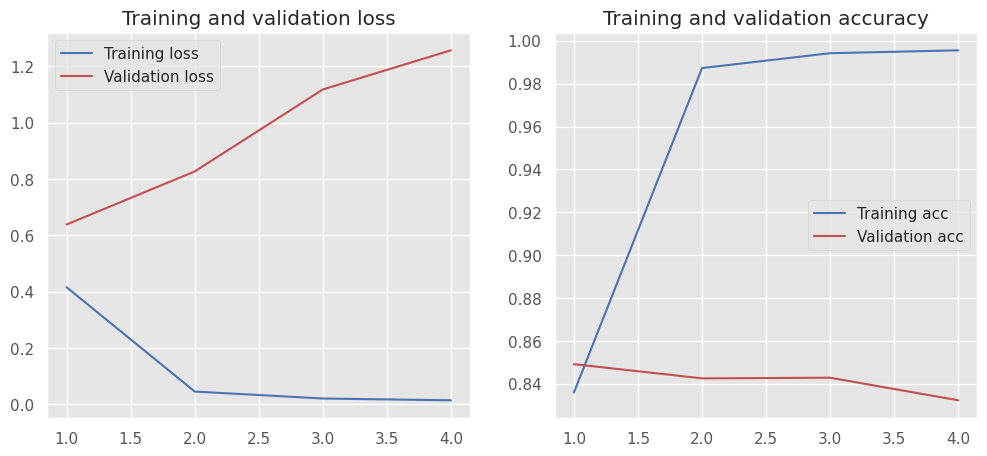

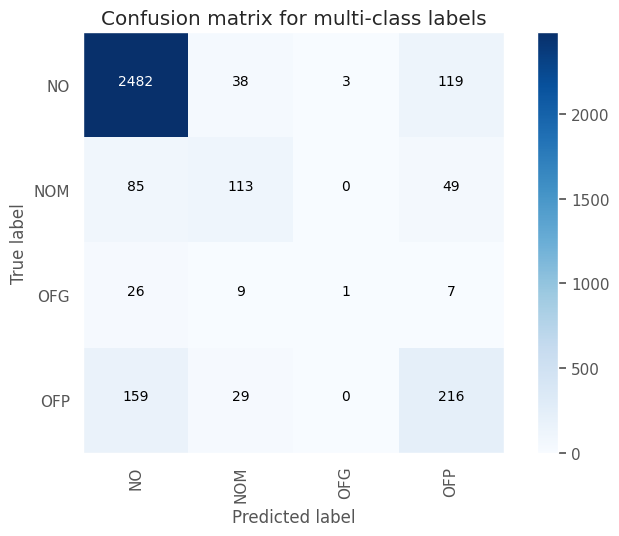

Test Accuracy: 0.8429
Test macro-F1: 0.5061


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5671    0.5011    0.5321       447
     no_hate     0.9242    0.9408    0.9324      2889

    accuracy                         0.8819      3336
   macro avg     0.7456    0.7210    0.7322      3336
weighted avg     0.8763    0.8819    0.8788      3336



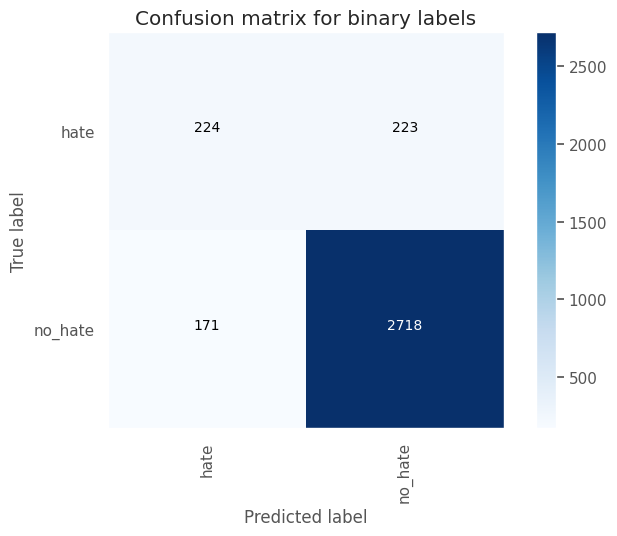

Test Accuracy: 0.8819
Test macro-F1: 0.7322






In [ ]:
vocab_size: int = 5000
max_length: int = 128
embedding_dim: int = 100

for dense_dim in [4, 8, 16, 32]:
    print(f"Training with dense_dim={dense_dim} ==============>")
    # Define Keras model
    model = Sequential([
        Embedding(vocab_size, embedding_dim, input_length=max_length),
        Flatten(),
        Dense(dense_dim, activation='relu'),
        Dropout(0.3),
        Dense(4, activation='softmax')
    ])

    # Data
    dataset_folder: str = dataset_v2_folder
    data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
    x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], \
        data[
            "x_test"], data["y_test"]

    # Train with our class
    trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                             max_input_length=max_length))
    trainer.train(x_train=x_train,
                  y_train=y_train,
                  opt_config=OptimizationConfig(
                      epochs=25,
                      batch_size=32,
                      validation_split=0.0,
                      validation_data=(x_val, y_val)
                  ),
                  callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=3, min_delta=0.01)])
    trainer.predict_with_report(x_test=x_test, y_test=y_test)

Vemos que no hay ganancias en performance con respecto a entrenar con `v1` directamente. Podemos probar de bajar el learning_rate, para ver si entrenando más lentamente podemos encontrar algún camino más óptimo.

Training with dense_dim=8 ==============>
Training with learning_rate=0.0005 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_21"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_21 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_21 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (31660, 8)             │       102,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_39 (Dropout)            │ (31660, 8)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (31660, 4)             │            36 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 602,444 (2.30 MB)

 Trainable params: 602,444 (2.30 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - acc: 0.4038 - loss: 1.1868 - val_acc: 0.8243 - val_loss: 0.5980
Epoch 2/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.8339 - loss: 0.4336 - val_acc: 0.8426 - val_loss: 0.5483
Epoch 3/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.8783 - loss: 0.2864 - val_acc: 0.8456 - val_loss: 0.6191
Epoch 4/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.8919 - loss: 0.2344 - val_acc: 0.8393 - val_loss: 0.6886
Epoch 5/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.9033 - loss: 0.2007 - val_acc: 0.8366 - val_loss: 0.7718
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9096    0.9410    0.9250      2642
         NOM     0.6845    0.4656    0.5542       247
         OFG     0.1818    0.0465    0.0741        43
        

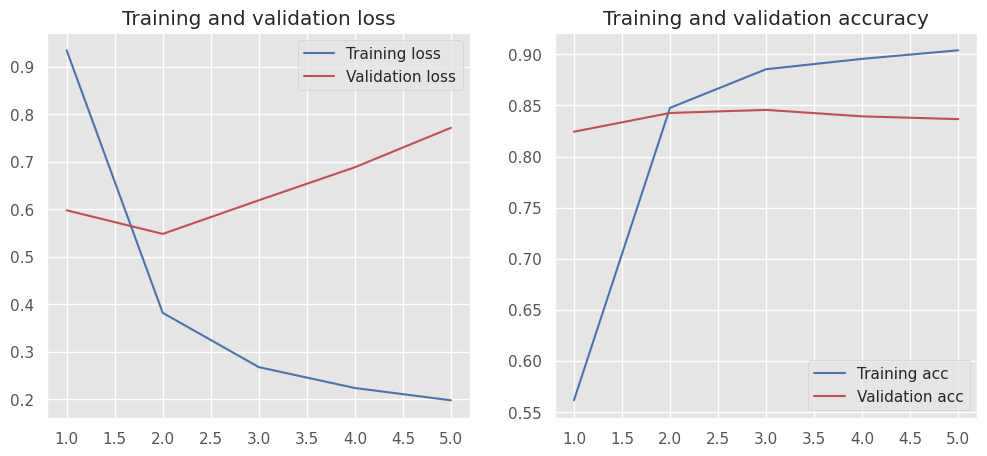

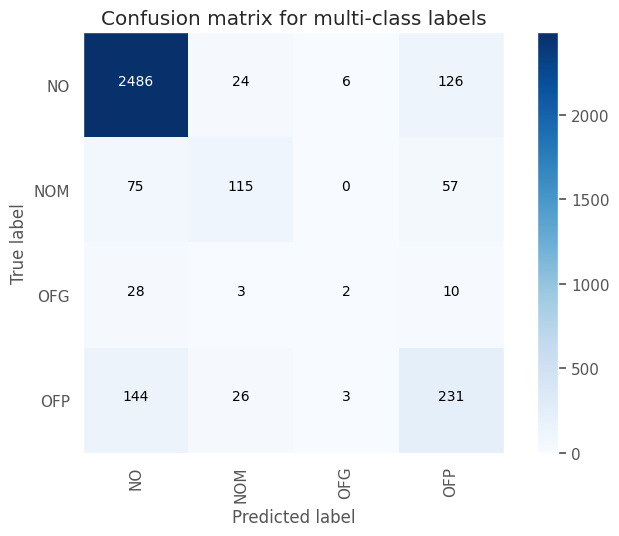

Test Accuracy: 0.8495
Test macro-F1: 0.5278


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5655    0.5503    0.5578       447
     no_hate     0.9307    0.9346    0.9326      2889

    accuracy                         0.8831      3336
   macro avg     0.7481    0.7425    0.7452      3336
weighted avg     0.8818    0.8831    0.8824      3336



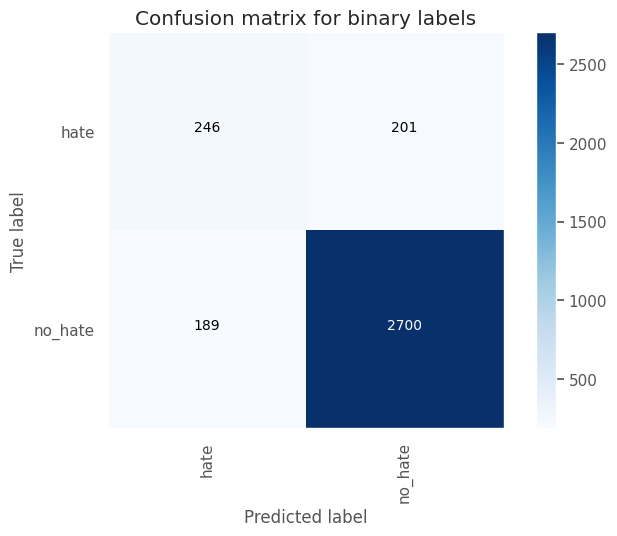

Test Accuracy: 0.8831
Test macro-F1: 0.7452




Training with learning_rate=0.00025 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_22"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_22 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_22 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ (31660, 8)             │       102,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_40 (Dropout)            │ (31660, 8)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_63 (Dense)                │ (31660, 4)             │            36 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 602,444 (2.30 MB)

 Trainable params: 602,444 (2.30 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.3260 - loss: 1.3155 - val_acc: 0.7048 - val_loss: 1.0685
Epoch 2/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.7111 - loss: 0.7433 - val_acc: 0.8309 - val_loss: 0.5703
Epoch 3/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.7878 - loss: 0.4595 - val_acc: 0.8363 - val_loss: 0.5044
Epoch 4/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.8785 - loss: 0.3498 - val_acc: 0.8402 - val_loss: 0.5264
Epoch 5/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.9047 - loss: 0.2930 - val_acc: 0.8390 - val_loss: 0.5767
Epoch 6/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.9159 - loss: 0.2624 - val_acc: 0.8432 - val_loss: 0.6369
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9050    0.9519    0.9279      264

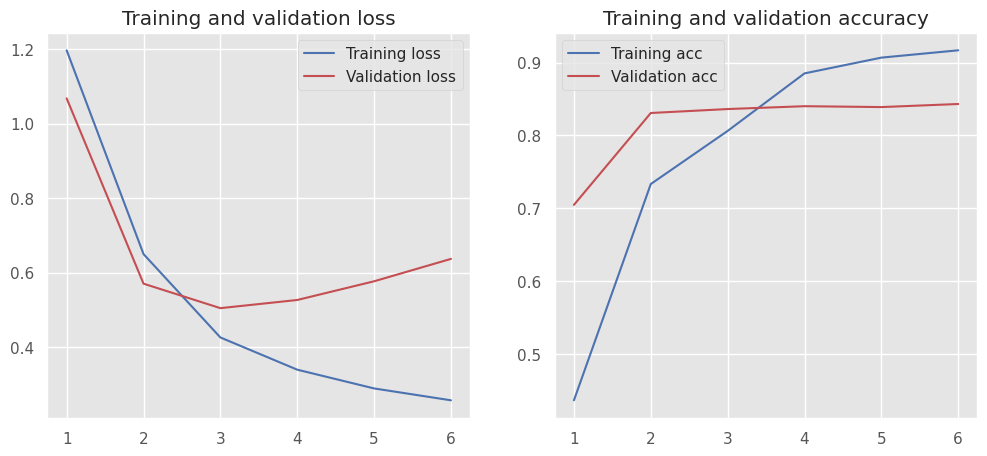

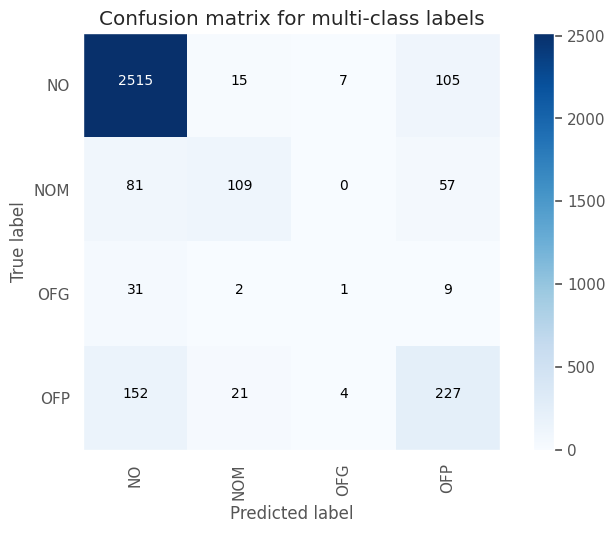

Test Accuracy: 0.8549
Test macro-F1: 0.5209


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5878    0.5391    0.5624       447
     no_hate     0.9296    0.9415    0.9355      2889

    accuracy                         0.8876      3336
   macro avg     0.7587    0.7403    0.7490      3336
weighted avg     0.8838    0.8876    0.8855      3336



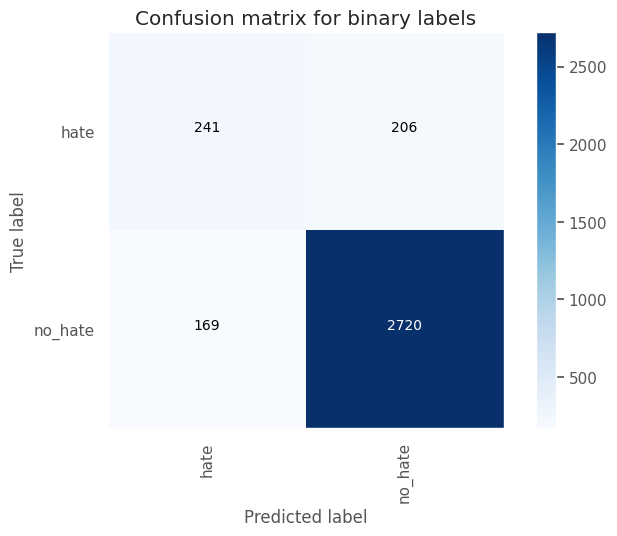

Test Accuracy: 0.8876
Test macro-F1: 0.749




Training with dense_dim=16 ==============>
Training with learning_rate=0.0005 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_23"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_23 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_23 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_64 (Dense)                │ (31660, 16)            │       204,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_41 (Dropout)            │ (31660, 16)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_65 (Dense)                │ (31660, 4)             │            68 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 704,884 (2.69 MB)

 Trainable params: 704,884 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - acc: 0.4464 - loss: 1.1065 - val_acc: 0.8291 - val_loss: 0.5142
Epoch 2/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.9150 - loss: 0.2557 - val_acc: 0.8462 - val_loss: 0.5759
Epoch 3/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9710 - loss: 0.1204 - val_acc: 0.8492 - val_loss: 0.7037
Epoch 4/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9826 - loss: 0.0771 - val_acc: 0.8486 - val_loss: 0.8192
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9046    0.9512    0.9273      2642
         NOM     0.6316    0.4858    0.5492       247
         OFG     0.2500    0.0233    0.0426        43
         OFP     0.6071    0.5470    0.5755       404

    accuracy                         0.8558      3336
   macro avg     

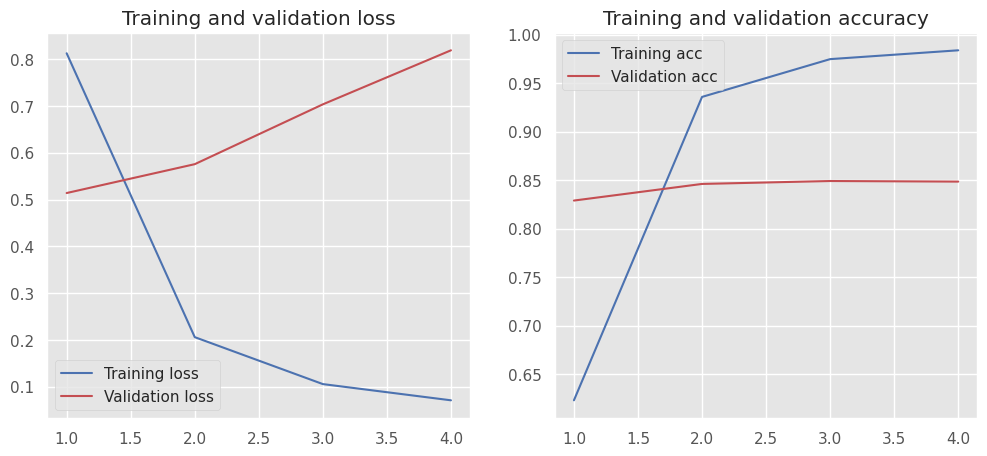

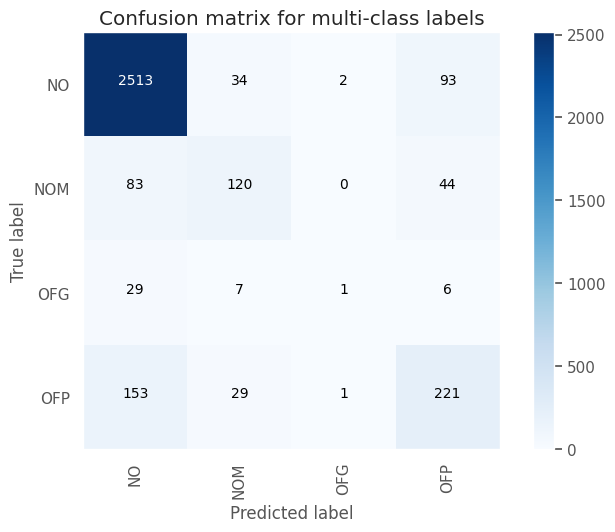

Test Accuracy: 0.8558
Test macro-F1: 0.5236


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6223    0.5123    0.5620       447
     no_hate     0.9265    0.9519    0.9390      2889

    accuracy                         0.8930      3336
   macro avg     0.7744    0.7321    0.7505      3336
weighted avg     0.8858    0.8930    0.8885      3336



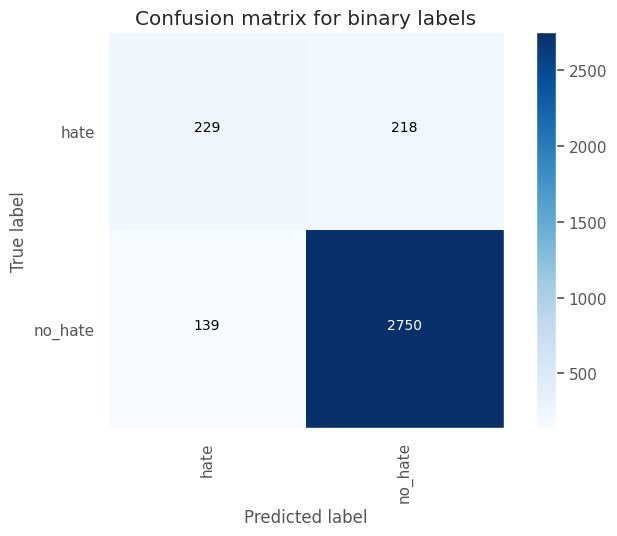

Test Accuracy: 0.893
Test macro-F1: 0.7505




Training with learning_rate=0.00025 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_24"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_24 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_24 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_66 (Dense)                │ (31660, 16)            │       204,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_42 (Dropout)            │ (31660, 16)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_67 (Dense)                │ (31660, 4)             │            68 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 704,884 (2.69 MB)

 Trainable params: 704,884 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - acc: 0.3925 - loss: 1.2239 - val_acc: 0.7722 - val_loss: 0.6662
Epoch 2/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.8566 - loss: 0.4175 - val_acc: 0.8363 - val_loss: 0.5198
Epoch 3/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.9488 - loss: 0.1849 - val_acc: 0.8459 - val_loss: 0.5817
Epoch 4/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.9750 - loss: 0.1036 - val_acc: 0.8423 - val_loss: 0.6629
Epoch 5/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.9833 - loss: 0.0724 - val_acc: 0.8438 - val_loss: 0.7520
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9018    0.9561    0.9282      2642
         NOM     0.6150    0.5304    0.5696       247
         OFG     0.4000    0.0465    0.0833        43
        

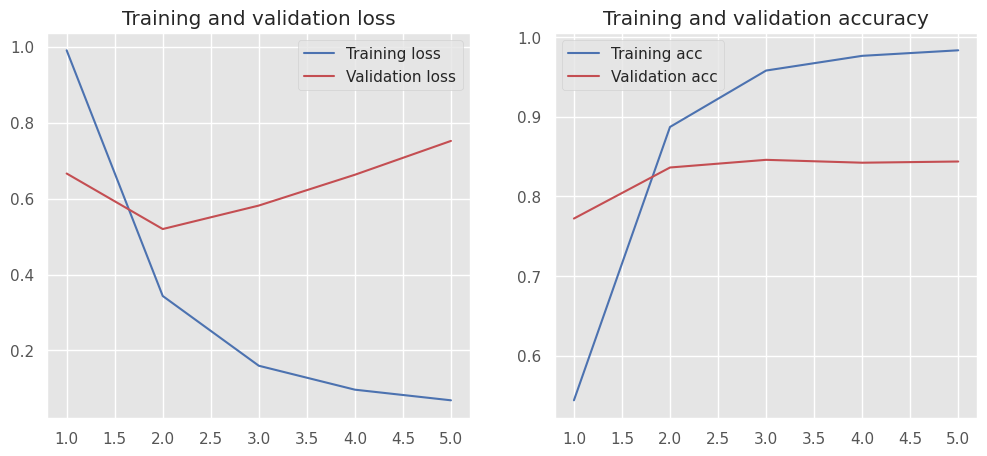

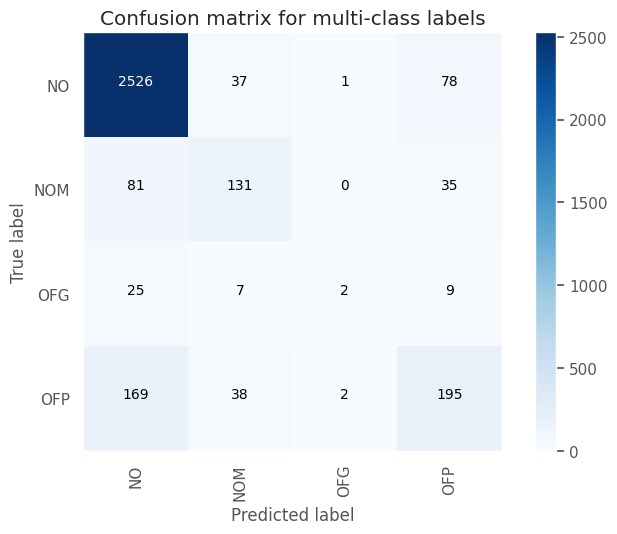

Test Accuracy: 0.8555
Test macro-F1: 0.5305


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6460    0.4653    0.5410       447
     no_hate     0.9207    0.9605    0.9402      2889

    accuracy                         0.8942      3336
   macro avg     0.7833    0.7129    0.7406      3336
weighted avg     0.8839    0.8942    0.8867      3336



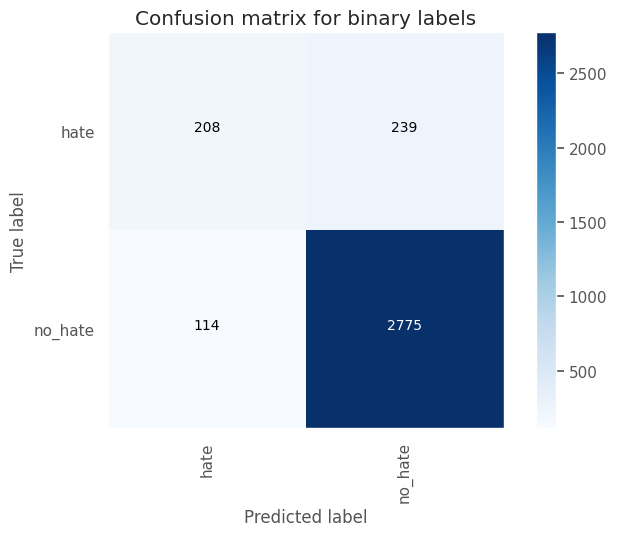

Test Accuracy: 0.8942
Test macro-F1: 0.7406




Training with dense_dim=32 ==============>
Training with learning_rate=0.0005 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_25"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_25 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_25 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_68 (Dense)                │ (31660, 32)            │       409,632 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_43 (Dropout)            │ (31660, 32)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_69 (Dense)                │ (31660, 4)             │           132 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 909,764 (3.47 MB)

 Trainable params: 909,764 (3.47 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - acc: 0.5413 - loss: 1.0101 - val_acc: 0.8447 - val_loss: 0.4889
Epoch 2/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - acc: 0.9706 - loss: 0.1099 - val_acc: 0.8522 - val_loss: 0.6484
Epoch 3/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - acc: 0.9901 - loss: 0.0400 - val_acc: 0.8465 - val_loss: 0.7867
Epoch 4/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - acc: 0.9940 - loss: 0.0240 - val_acc: 0.8411 - val_loss: 0.9288
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9024    0.9489    0.9251      2642
         NOM     0.6224    0.4939    0.5508       247
         OFG     0.2500    0.0233    0.0426        43
         OFP     0.5978    0.5297    0.5617       404

    accuracy                         0.8525      3336
   macro avg     

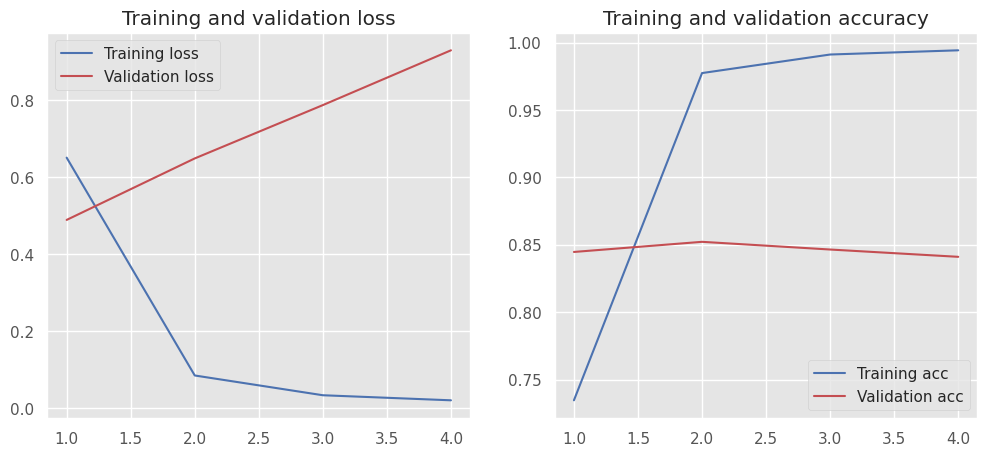

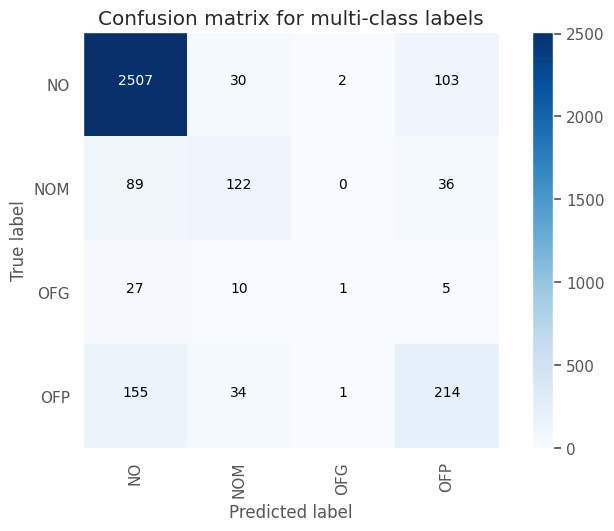

Test Accuracy: 0.8525
Test macro-F1: 0.52


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6105    0.4944    0.5464       447
     no_hate     0.9240    0.9512    0.9374      2889

    accuracy                         0.8900      3336
   macro avg     0.7673    0.7228    0.7419      3336
weighted avg     0.8820    0.8900    0.8850      3336



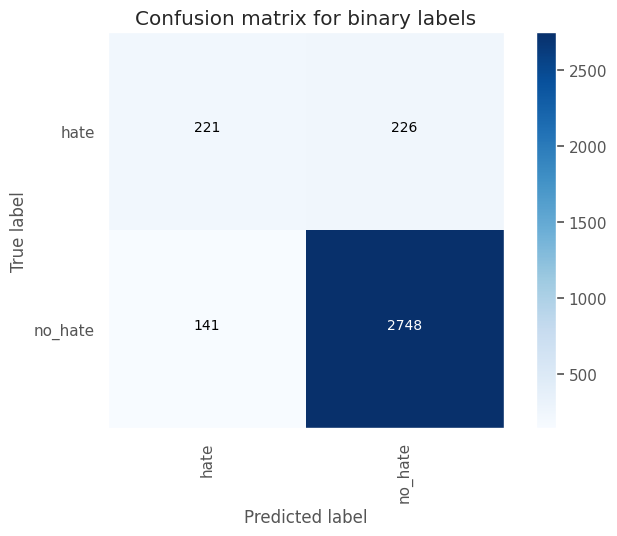

Test Accuracy: 0.89
Test macro-F1: 0.7419




Training with learning_rate=0.00025 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_26"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_26 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_26 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_70 (Dense)                │ (31660, 32)            │       409,632 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_44 (Dropout)            │ (31660, 32)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_71 (Dense)                │ (31660, 4)             │           132 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 909,764 (3.47 MB)

 Trainable params: 909,764 (3.47 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - acc: 0.4344 - loss: 1.1725 - val_acc: 0.7927 - val_loss: 0.6099
Epoch 2/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9120 - loss: 0.2881 - val_acc: 0.8465 - val_loss: 0.5013
Epoch 3/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9795 - loss: 0.0857 - val_acc: 0.8483 - val_loss: 0.5976
Epoch 4/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9888 - loss: 0.0478 - val_acc: 0.8456 - val_loss: 0.6894
Epoch 5/25
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9931 - loss: 0.0309 - val_acc: 0.8411 - val_loss: 0.7496
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9071    0.9459    0.9261      2642
         NOM     0.5974    0.5587    0.5774       247
         OFG     0.4000    0.0465    0.0833        43
        

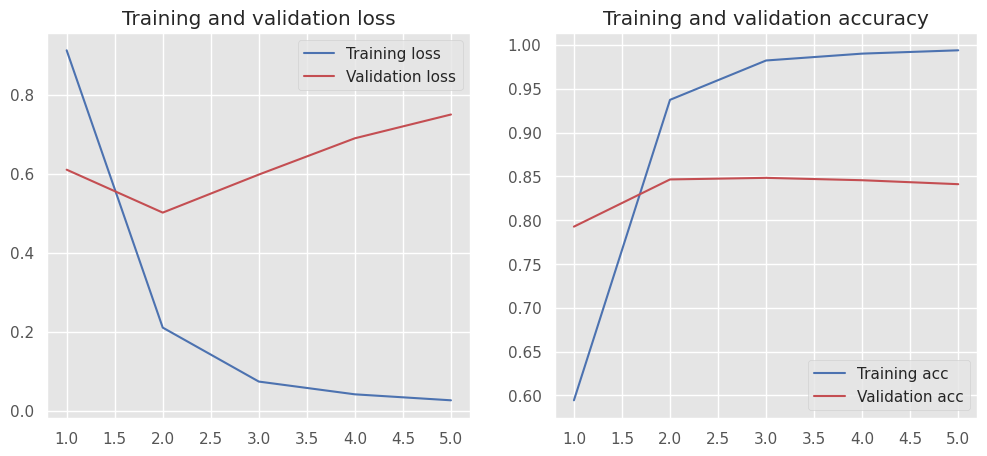

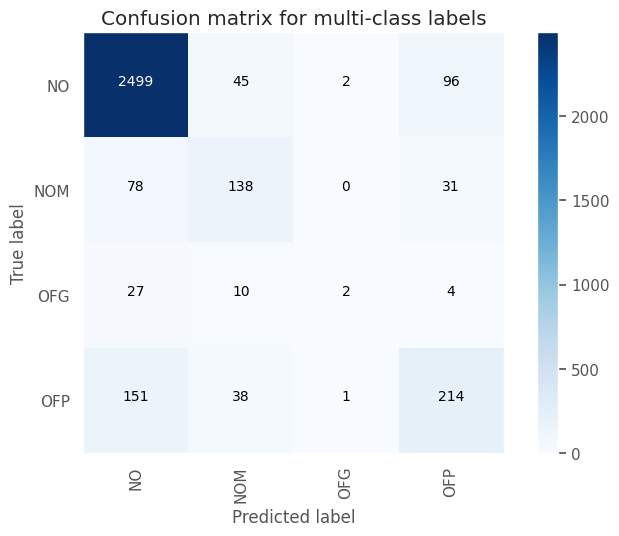

Test Accuracy: 0.8552
Test macro-F1: 0.5396


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6314    0.4944    0.5546       447
     no_hate     0.9243    0.9553    0.9396      2889

    accuracy                         0.8936      3336
   macro avg     0.7779    0.7249    0.7471      3336
weighted avg     0.8851    0.8936    0.8880      3336



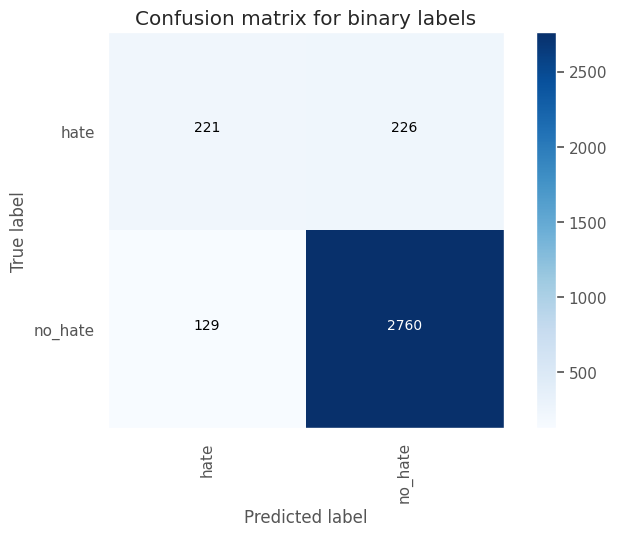

Test Accuracy: 0.8936
Test macro-F1: 0.7471






In [ ]:
vocab_size: int = 5000
max_length: int = 128
embedding_dim: int = 100

for dense_dim in [8, 16, 32]:
    print(f"Training with dense_dim={dense_dim} ==============>")
    for lr in [0.0005, 0.00025]:
        print(f"Training with learning_rate={lr} ======")
        # Define Keras model
        model = Sequential([
            Embedding(vocab_size, embedding_dim, input_length=max_length),
            Flatten(),
            Dense(dense_dim, activation='relu'),
            Dropout(0.3),
            Dense(4, activation='softmax')
        ])

        # Data
        dataset_folder: str = dataset_v2_folder
        data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
        x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], \
            data[
                "x_test"], data["y_test"]

        # Train with our class
        trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                 max_input_length=max_length))
        trainer.train(x_train=x_train,
                      y_train=y_train,
                      opt_config=OptimizationConfig(
                          epochs=25,
                          batch_size=32,
                          validation_split=0.0,
                          validation_data=(x_val, y_val),
                          optimizer=Adam(learning_rate=lr)
                      ),
                      callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=3, min_delta=0.01)])
        trainer.predict_with_report(x_test=x_test, y_test=y_test)

Alcanzamos algunos resultados mejores. Intentaremos reducir el learning rate aún más y bajar el patience.


Training with dense_dim=8 ==============>
Training with learning_rate=0.0005 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_27"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_27 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_27 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_72 (Dense)                │ (31660, 8)             │       102,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_45 (Dropout)            │ (31660, 8)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_73 (Dense)                │ (31660, 4)             │            36 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 602,444 (2.30 MB)

 Trainable params: 602,444 (2.30 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - acc: 0.4038 - loss: 1.1868 - val_acc: 0.8243 - val_loss: 0.5980
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.8339 - loss: 0.4336 - val_acc: 0.8426 - val_loss: 0.5483
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.8783 - loss: 0.2864 - val_acc: 0.8456 - val_loss: 0.6191
Epoch 4/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.8919 - loss: 0.2344 - val_acc: 0.8393 - val_loss: 0.6886
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9076    0.9478    0.9272      2642
         NOM     0.7048    0.4737    0.5666       247
         OFG     0.1176    0.0465    0.0667        43
         OFP     0.5761    0.5619    0.5689       404

    accuracy                         0.8543      3336
   macro avg     

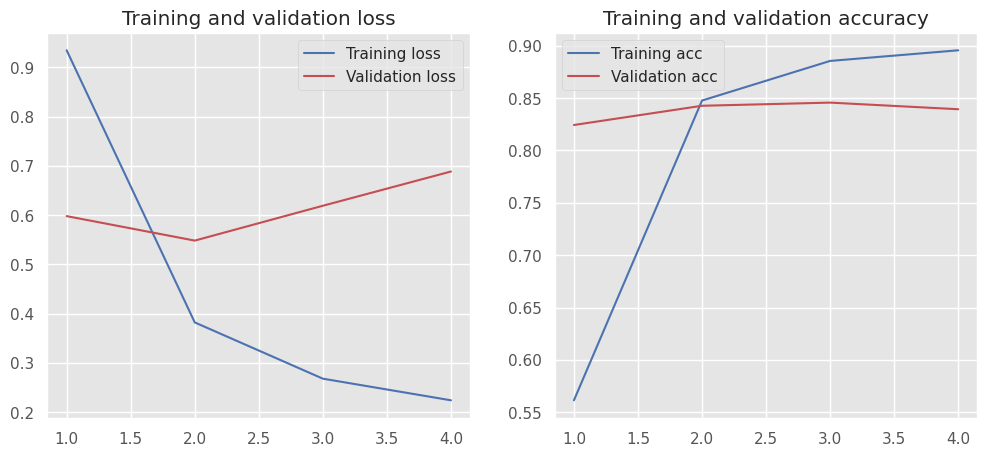

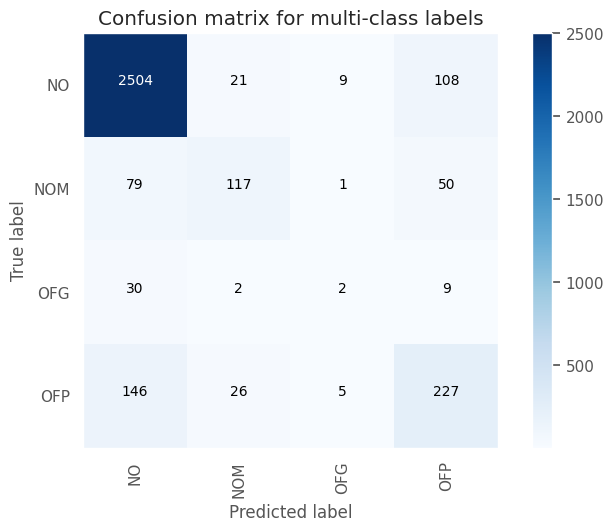

Test Accuracy: 0.8543
Test macro-F1: 0.5324


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5912    0.5436    0.5664       447
     no_hate     0.9303    0.9418    0.9360      2889

    accuracy                         0.8885      3336
   macro avg     0.7607    0.7427    0.7512      3336
weighted avg     0.8848    0.8885    0.8865      3336



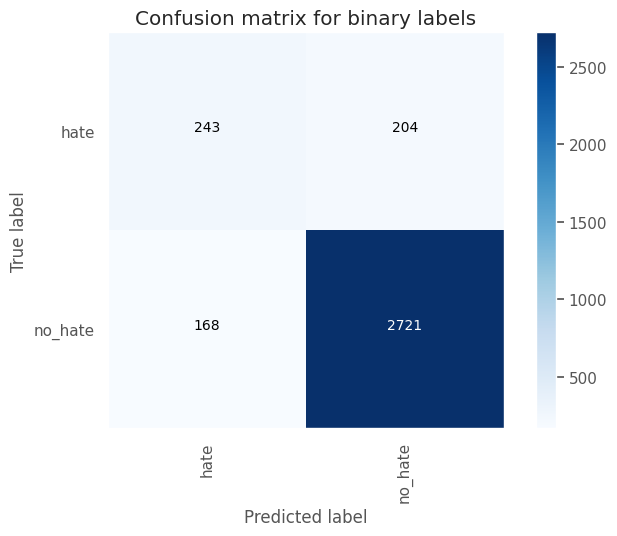

Test Accuracy: 0.8885
Test macro-F1: 0.7512




Training with learning_rate=0.00025 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_28"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_28 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_28 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_74 (Dense)                │ (31660, 8)             │       102,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_46 (Dropout)            │ (31660, 8)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_75 (Dense)                │ (31660, 4)             │            36 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 602,444 (2.30 MB)

 Trainable params: 602,444 (2.30 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 8s 7ms/step - acc: 0.3260 - loss: 1.3155 - val_acc: 0.7048 - val_loss: 1.0685
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - acc: 0.7111 - loss: 0.7433 - val_acc: 0.8309 - val_loss: 0.5703
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.7878 - loss: 0.4595 - val_acc: 0.8363 - val_loss: 0.5044
Epoch 4/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.8785 - loss: 0.3498 - val_acc: 0.8402 - val_loss: 0.5264
Epoch 5/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9047 - loss: 0.2930 - val_acc: 0.8390 - val_loss: 0.5767
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9124    0.9425    0.9272      2642
         NOM     0.7419    0.4656    0.5721       247
         OFG     0.0833    0.0233    0.0364        43
        

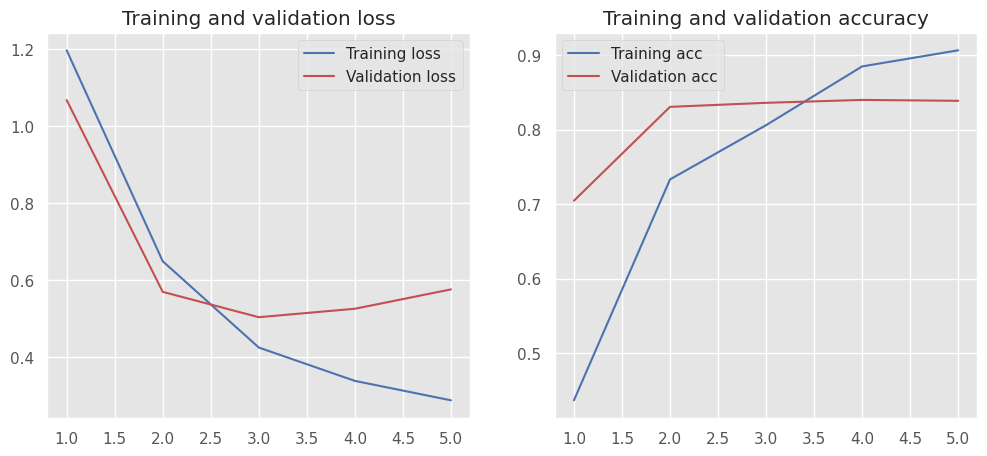

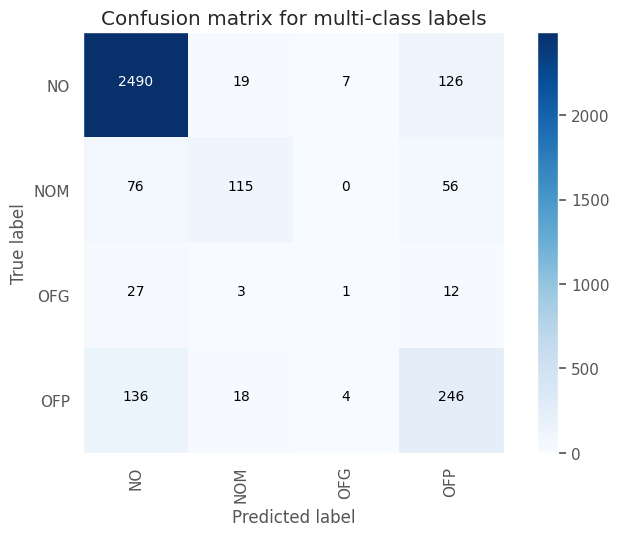

Test Accuracy: 0.8549
Test macro-F1: 0.5297


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5819    0.5884    0.5851       447
     no_hate     0.9362    0.9346    0.9354      2889

    accuracy                         0.8882      3336
   macro avg     0.7590    0.7615    0.7602      3336
weighted avg     0.8887    0.8882    0.8885      3336



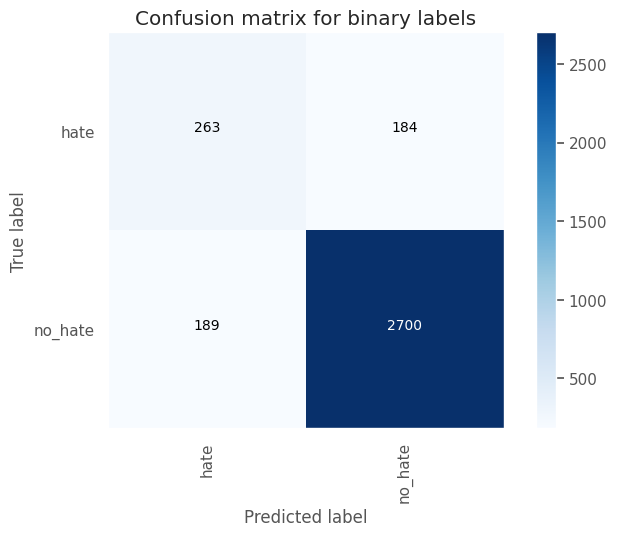

Test Accuracy: 0.8882
Test macro-F1: 0.7602




Training with learning_rate=0.000125 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_29"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_29 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_29 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_76 (Dense)                │ (31660, 8)             │       102,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_47 (Dropout)            │ (31660, 8)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_77 (Dense)                │ (31660, 4)             │            36 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 602,444 (2.30 MB)

 Trainable params: 602,444 (2.30 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - acc: 0.2958 - loss: 1.3442 - val_acc: 0.1815 - val_loss: 1.2847
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.5361 - loss: 0.9719 - val_acc: 0.7553 - val_loss: 0.9469
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.6712 - loss: 0.7373 - val_acc: 0.8191 - val_loss: 0.6758
Epoch 4/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.7655 - loss: 0.5677 - val_acc: 0.8234 - val_loss: 0.5822
Epoch 5/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.8526 - loss: 0.4171 - val_acc: 0.8282 - val_loss: 0.5539
Epoch 6/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.8756 - loss: 0.3468 - val_acc: 0.8360 - val_loss: 0.5324
Epoch 7/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.8849 - loss: 0.3086 - val_acc: 0.8333 - val_loss: 0.5518
Epoch 8/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.8950 - loss: 0.2658 - val_acc: 0.8378 - val_loss: 0.5647
Mo

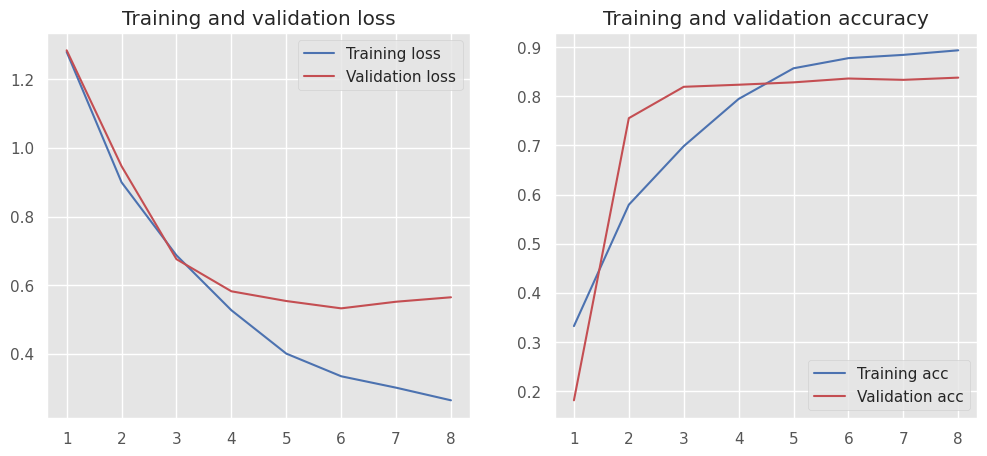

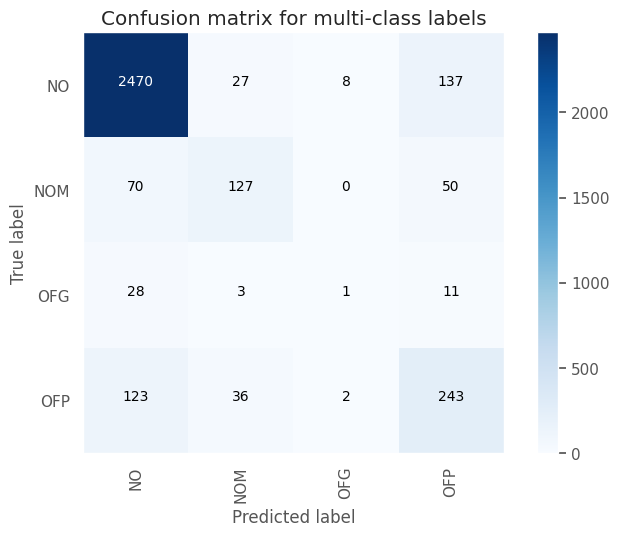

Test Accuracy: 0.8516
Test macro-F1: 0.5289


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5686    0.5749    0.5717       447
     no_hate     0.9341    0.9325    0.9333      2889

    accuracy                         0.8846      3336
   macro avg     0.7514    0.7537    0.7525      3336
weighted avg     0.8851    0.8846    0.8849      3336



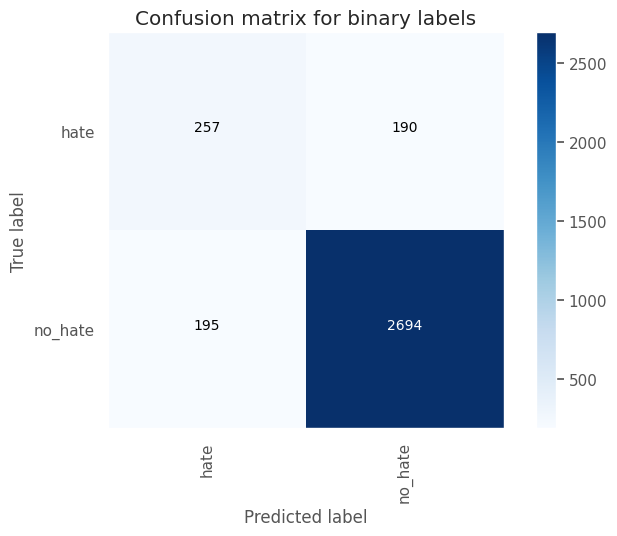

Test Accuracy: 0.8846
Test macro-F1: 0.7525




Training with dense_dim=16 ==============>
Training with learning_rate=0.0005 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_30"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_30 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_30 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_78 (Dense)                │ (31660, 16)            │       204,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_48 (Dropout)            │ (31660, 16)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_79 (Dense)                │ (31660, 4)             │            68 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 704,884 (2.69 MB)

 Trainable params: 704,884 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - acc: 0.4464 - loss: 1.1065 - val_acc: 0.8291 - val_loss: 0.5142
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.9150 - loss: 0.2557 - val_acc: 0.8462 - val_loss: 0.5759
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - acc: 0.9710 - loss: 0.1204 - val_acc: 0.8492 - val_loss: 0.7037
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9089    0.9512    0.9295      2642
         NOM     0.6432    0.5547    0.5957       247
         OFG     0.1111    0.0233    0.0385        43
         OFP     0.6275    0.5421    0.5817       404

    accuracy                         0.8603      3336
   macro avg     0.5727    0.5178    0.5363      3336
weighted avg     0.8448    0.8603    0.8512      3336



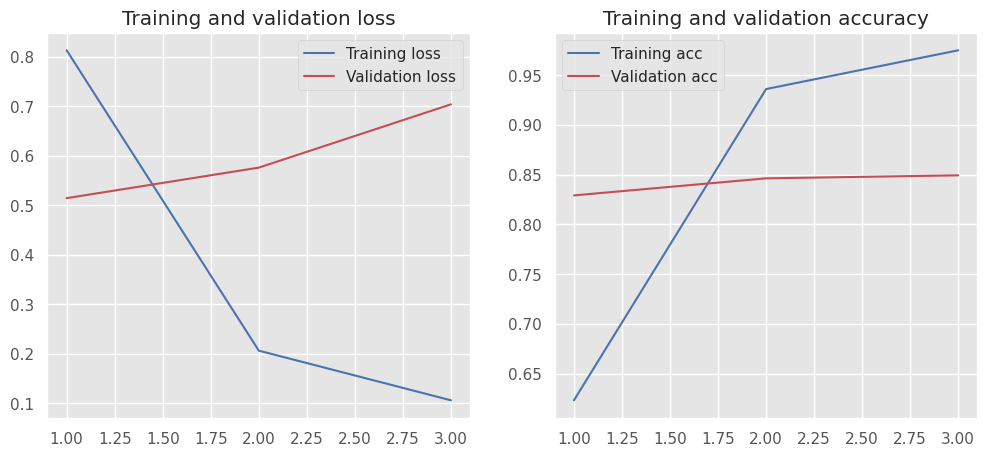

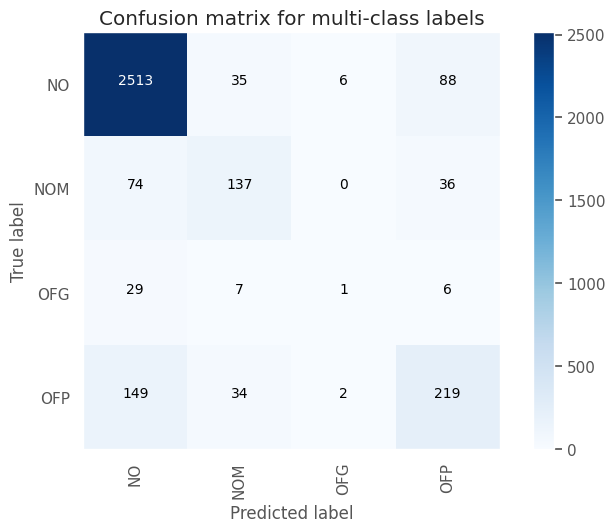

Test Accuracy: 0.8603
Test macro-F1: 0.5363


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6369    0.5101    0.5665       447
     no_hate     0.9265    0.9550    0.9405      2889

    accuracy                         0.8954      3336
   macro avg     0.7817    0.7325    0.7535      3336
weighted avg     0.8877    0.8954    0.8904      3336



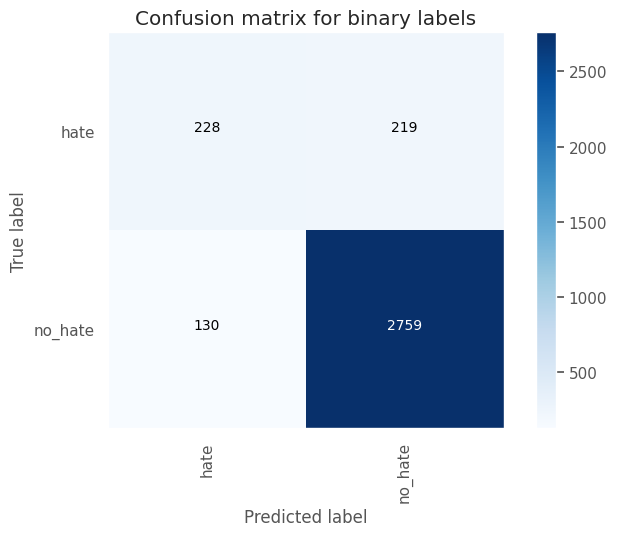

Test Accuracy: 0.8954
Test macro-F1: 0.7535




Training with learning_rate=0.00025 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_31"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_31 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_31 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_80 (Dense)                │ (31660, 16)            │       204,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_49 (Dropout)            │ (31660, 16)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_81 (Dense)                │ (31660, 4)             │            68 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 704,884 (2.69 MB)

 Trainable params: 704,884 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - acc: 0.3925 - loss: 1.2239 - val_acc: 0.7722 - val_loss: 0.6662
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - acc: 0.8566 - loss: 0.4175 - val_acc: 0.8363 - val_loss: 0.5198
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9488 - loss: 0.1849 - val_acc: 0.8459 - val_loss: 0.5817
Epoch 4/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9750 - loss: 0.1036 - val_acc: 0.8423 - val_loss: 0.6629
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9047    0.9557    0.9295      2642
         NOM     0.6071    0.5506    0.5775       247
         OFG     0.2857    0.0465    0.0800        43
         OFP     0.6369    0.4950    0.5571       404

    accuracy                         0.8582      3336
   macro avg     

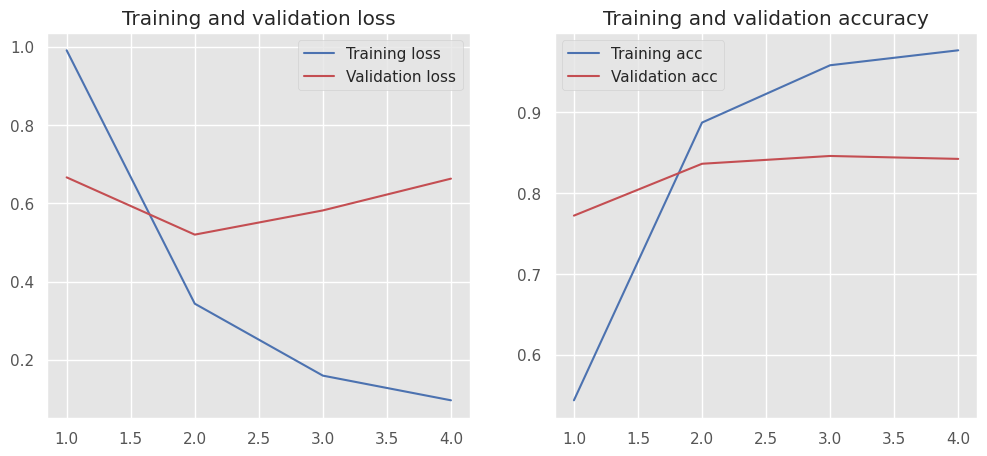

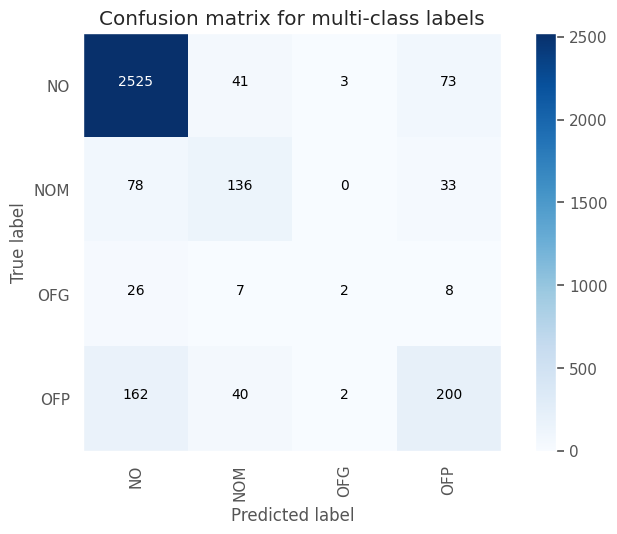

Test Accuracy: 0.8582
Test macro-F1: 0.536


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6604    0.4743    0.5521       447
     no_hate     0.9221    0.9623    0.9417      2889

    accuracy                         0.8969      3336
   macro avg     0.7912    0.7183    0.7469      3336
weighted avg     0.8870    0.8969    0.8895      3336



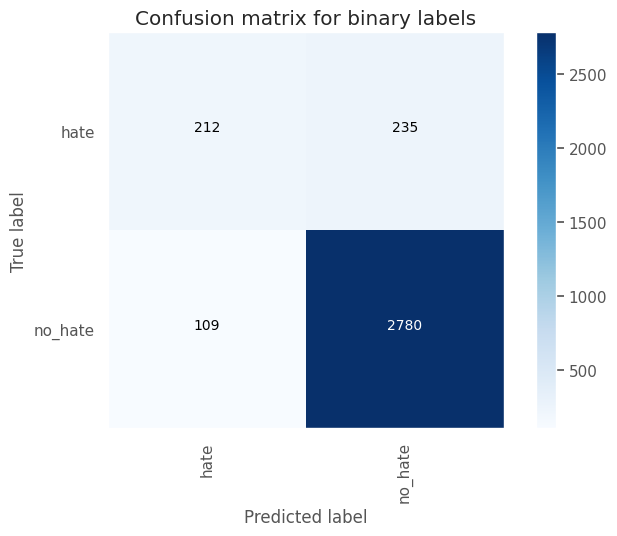

Test Accuracy: 0.8969
Test macro-F1: 0.7469




Training with learning_rate=0.000125 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_32"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_32 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_32 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_82 (Dense)                │ (31660, 16)            │       204,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_50 (Dropout)            │ (31660, 16)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_83 (Dense)                │ (31660, 4)             │            68 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 704,884 (2.69 MB)

 Trainable params: 704,884 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - acc: 0.3383 - loss: 1.3142 - val_acc: 0.6949 - val_loss: 1.0085
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.7221 - loss: 0.7338 - val_acc: 0.7761 - val_loss: 0.6517
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.8645 - loss: 0.4071 - val_acc: 0.8224 - val_loss: 0.5228
Epoch 4/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9282 - loss: 0.2520 - val_acc: 0.8342 - val_loss: 0.5183
Epoch 5/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9556 - loss: 0.1655 - val_acc: 0.8417 - val_loss: 0.5577
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9065    0.9463    0.9259      2642
         NOM     0.6009    0.5668    0.5833       247
         OFG     0.2222    0.0465    0.0769        43
        

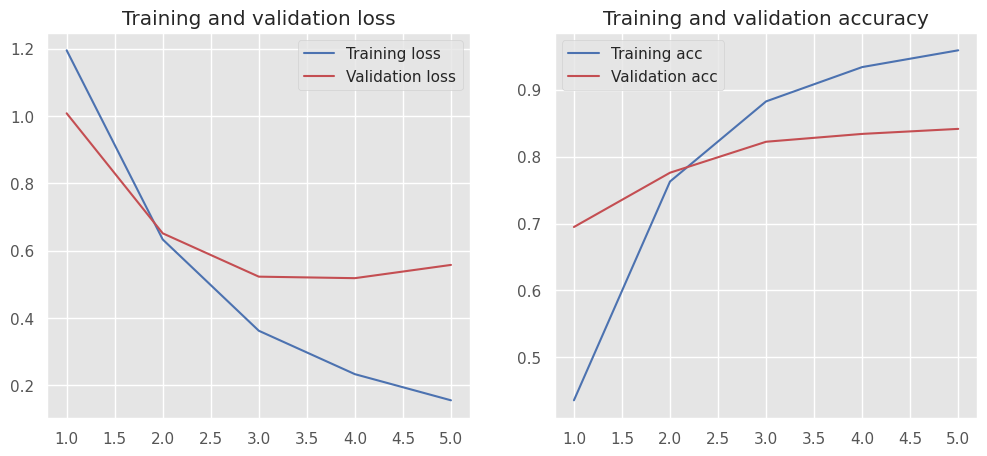

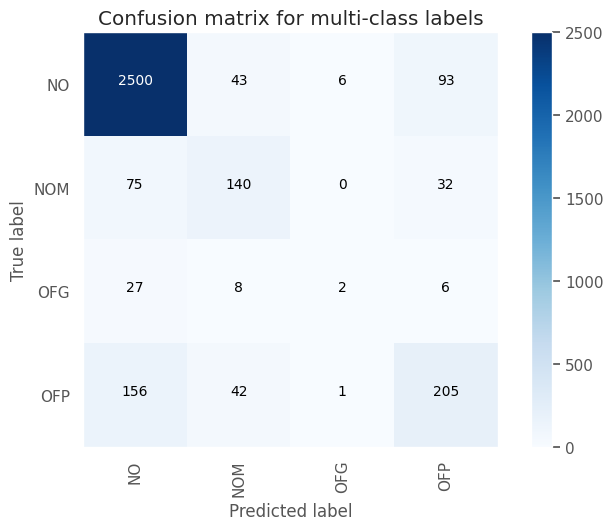

Test Accuracy: 0.8534
Test macro-F1: 0.5351


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6203    0.4787    0.5404       447
     no_hate     0.9221    0.9547    0.9381      2889

    accuracy                         0.8909      3336
   macro avg     0.7712    0.7167    0.7392      3336
weighted avg     0.8817    0.8909    0.8848      3336



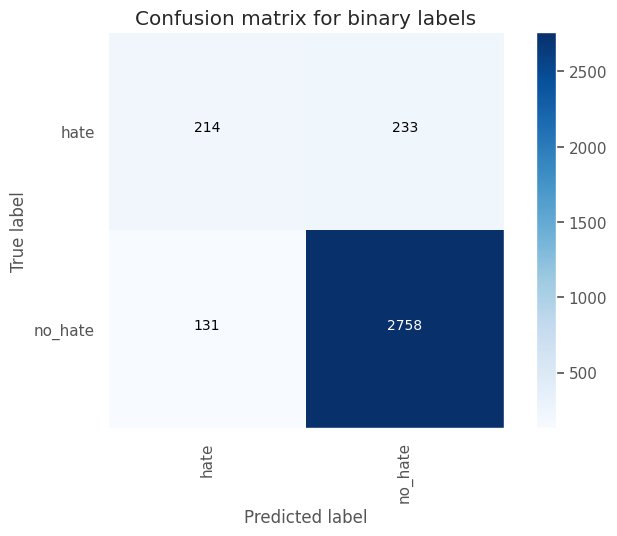

Test Accuracy: 0.8909
Test macro-F1: 0.7392




Training with dense_dim=32 ==============>
Training with learning_rate=0.0005 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_33"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_33 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_33 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_84 (Dense)                │ (31660, 32)            │       409,632 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_51 (Dropout)            │ (31660, 32)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_85 (Dense)                │ (31660, 4)             │           132 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 909,764 (3.47 MB)

 Trainable params: 909,764 (3.47 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - acc: 0.5413 - loss: 1.0101 - val_acc: 0.8447 - val_loss: 0.4889
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9706 - loss: 0.1099 - val_acc: 0.8522 - val_loss: 0.6484
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - acc: 0.9901 - loss: 0.0400 - val_acc: 0.8465 - val_loss: 0.7867
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9040    0.9516    0.9272      2642
         NOM     0.6111    0.5789    0.5946       247
         OFG     0.2500    0.0233    0.0426        43
         OFP     0.6341    0.4975    0.5576       404

    accuracy                         0.8570      3336
   macro avg     0.5998    0.5128    0.5305      3336
weighted avg     0.8412    0.8570    0.8464      3336



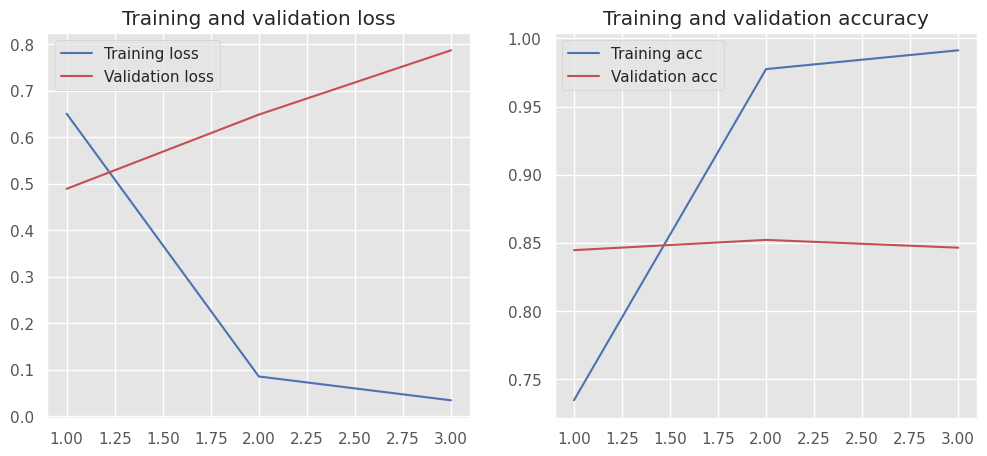

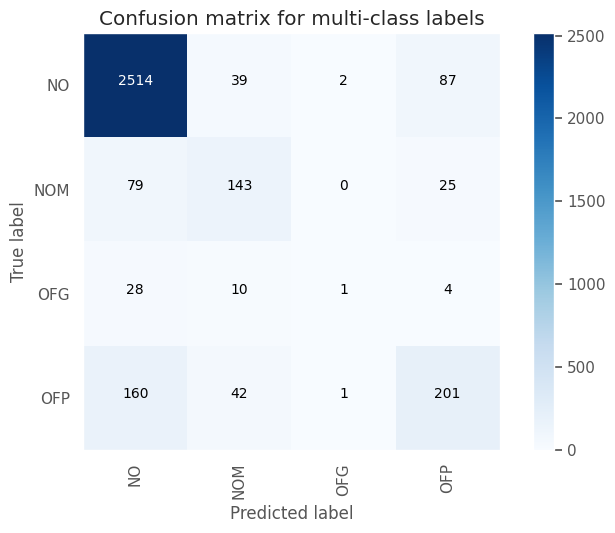

Test Accuracy: 0.857
Test macro-F1: 0.5305


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6449    0.4631    0.5391       447
     no_hate     0.9204    0.9605    0.9400      2889

    accuracy                         0.8939      3336
   macro avg     0.7826    0.7118    0.7396      3336
weighted avg     0.8835    0.8939    0.8863      3336



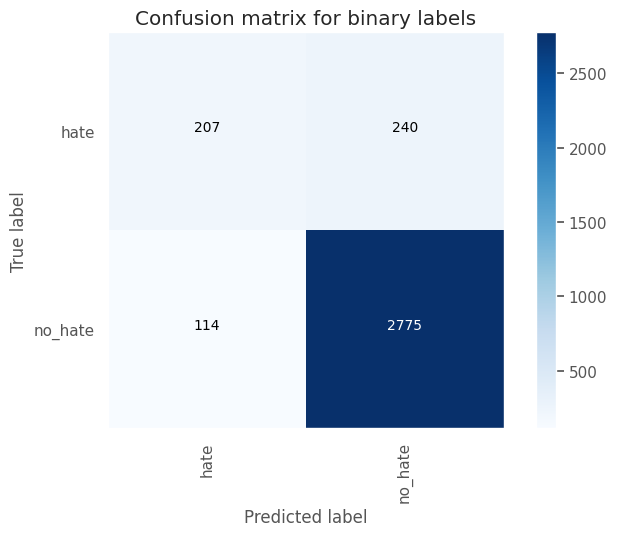

Test Accuracy: 0.8939
Test macro-F1: 0.7396




Training with learning_rate=0.00025 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_34"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_34 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_34 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_86 (Dense)                │ (31660, 32)            │       409,632 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_52 (Dropout)            │ (31660, 32)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_87 (Dense)                │ (31660, 4)             │           132 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 909,764 (3.47 MB)

 Trainable params: 909,764 (3.47 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - acc: 0.4344 - loss: 1.1725 - val_acc: 0.7927 - val_loss: 0.6099
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9120 - loss: 0.2881 - val_acc: 0.8465 - val_loss: 0.5013
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9795 - loss: 0.0857 - val_acc: 0.8483 - val_loss: 0.5976
Epoch 4/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9888 - loss: 0.0478 - val_acc: 0.8456 - val_loss: 0.6894
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9082    0.9516    0.9294      2642
         NOM     0.6164    0.5466    0.5794       247
         OFG     0.2500    0.0233    0.0426        43
         OFP     0.6290    0.5371    0.5794       404

    accuracy                         0.8594      3336
   macro avg     

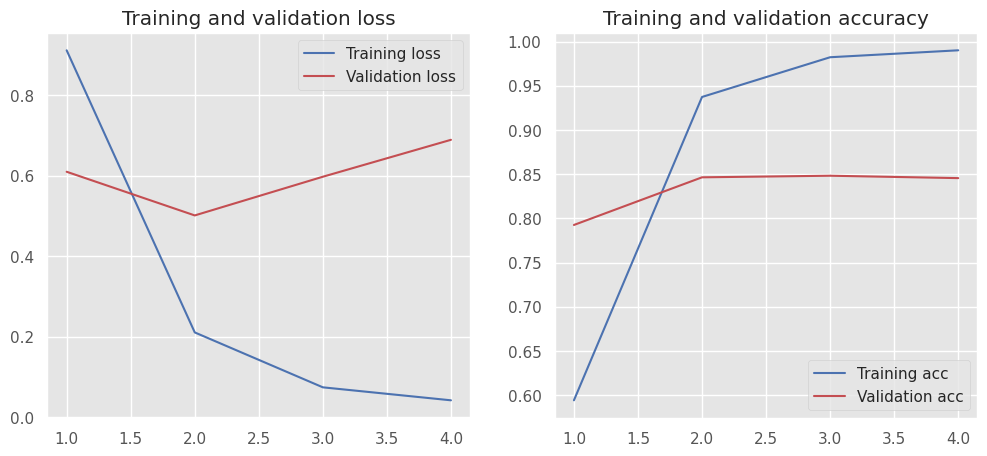

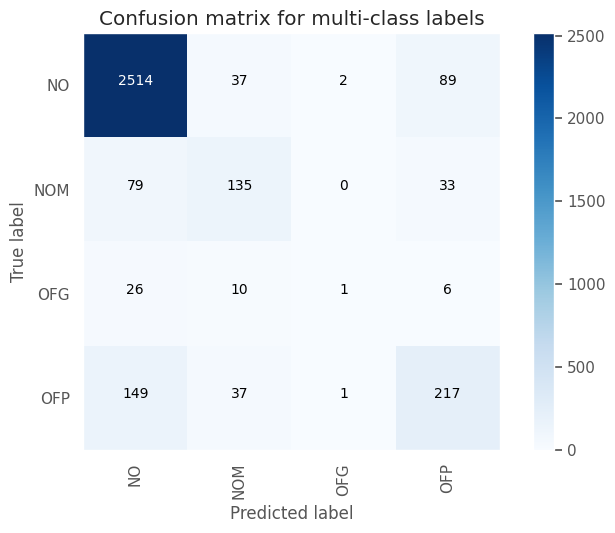

Test Accuracy: 0.8594
Test macro-F1: 0.5327


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6447    0.5034    0.5653       447
     no_hate     0.9257    0.9571    0.9411      2889

    accuracy                         0.8963      3336
   macro avg     0.7852    0.7302    0.7532      3336
weighted avg     0.8880    0.8963    0.8908      3336



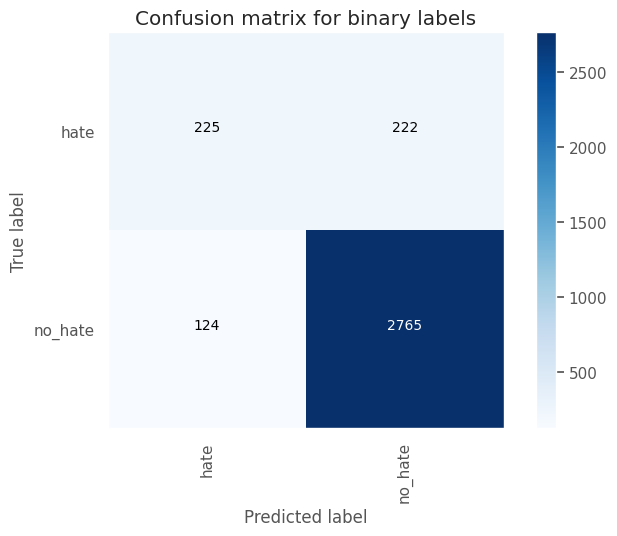

Test Accuracy: 0.8963
Test macro-F1: 0.7532




Training with learning_rate=0.000125 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_35"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_35 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_35 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_88 (Dense)                │ (31660, 32)            │       409,632 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_53 (Dropout)            │ (31660, 32)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_89 (Dense)                │ (31660, 4)             │           132 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 909,764 (3.47 MB)

 Trainable params: 909,764 (3.47 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - acc: 0.3895 - loss: 1.2725 - val_acc: 0.7087 - val_loss: 0.8744
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.8235 - loss: 0.5433 - val_acc: 0.8191 - val_loss: 0.5205
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - acc: 0.9408 - loss: 0.2138 - val_acc: 0.8408 - val_loss: 0.4949
Epoch 4/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - acc: 0.9721 - loss: 0.1167 - val_acc: 0.8444 - val_loss: 0.5411
Epoch 5/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - acc: 0.9848 - loss: 0.0736 - val_acc: 0.8420 - val_loss: 0.5815
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9112    0.9444    0.9275      2642
         NOM     0.6017    0.5749    0.5880       247
         OFG     0.3333    0.0465    0.0816        43
        

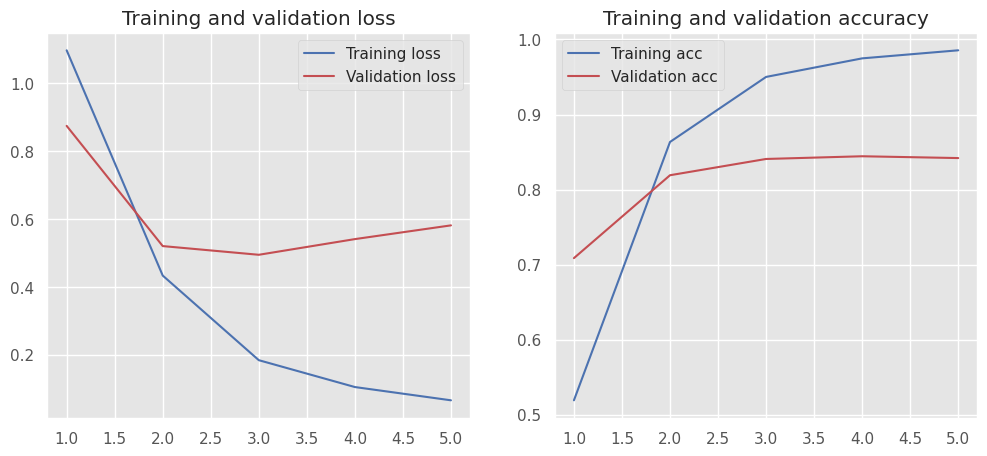

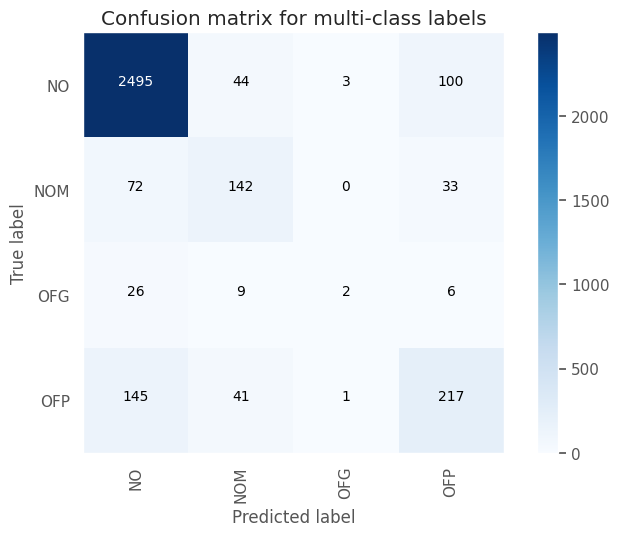

Test Accuracy: 0.8561
Test macro-F1: 0.542


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6243    0.5056    0.5587       447
     no_hate     0.9257    0.9529    0.9391      2889

    accuracy                         0.8930      3336
   macro avg     0.7750    0.7293    0.7489      3336
weighted avg     0.8853    0.8930    0.8881      3336



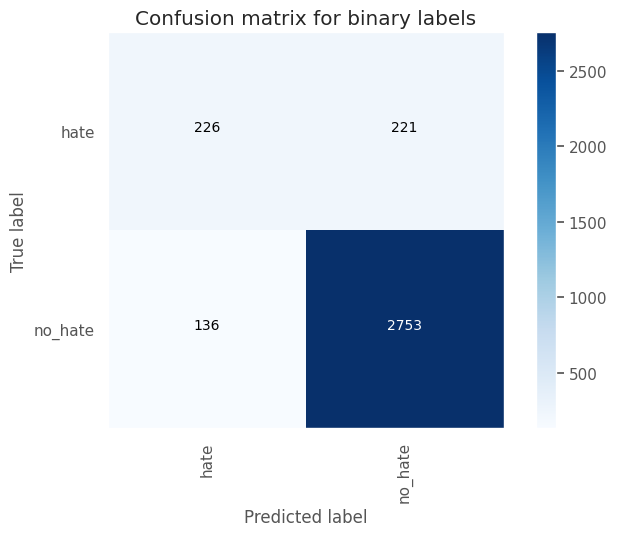

Test Accuracy: 0.893
Test macro-F1: 0.7489




Training with dense_dim=64 ==============>
Training with learning_rate=0.0005 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_36"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_36 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_36 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_90 (Dense)                │ (31660, 64)            │       819,264 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_54 (Dropout)            │ (31660, 64)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_91 (Dense)                │ (31660, 4)             │           260 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,319,524 (5.03 MB)

 Trainable params: 1,319,524 (5.03 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - acc: 0.5908 - loss: 0.9107 - val_acc: 0.8471 - val_loss: 0.5179
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - acc: 0.9791 - loss: 0.0789 - val_acc: 0.8447 - val_loss: 0.6775
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - acc: 0.9927 - loss: 0.0281 - val_acc: 0.8438 - val_loss: 0.8289
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9064    0.9527    0.9290      2642
         NOM     0.6008    0.5911    0.5959       247
         OFG     0.2500    0.0233    0.0426        43
         OFP     0.6378    0.4926    0.5559       404

    accuracy                         0.8582      3336
   macro avg     0.5988    0.5149    0.5308      3336
weighted avg     0.8428    0.8582    0.8477      3336



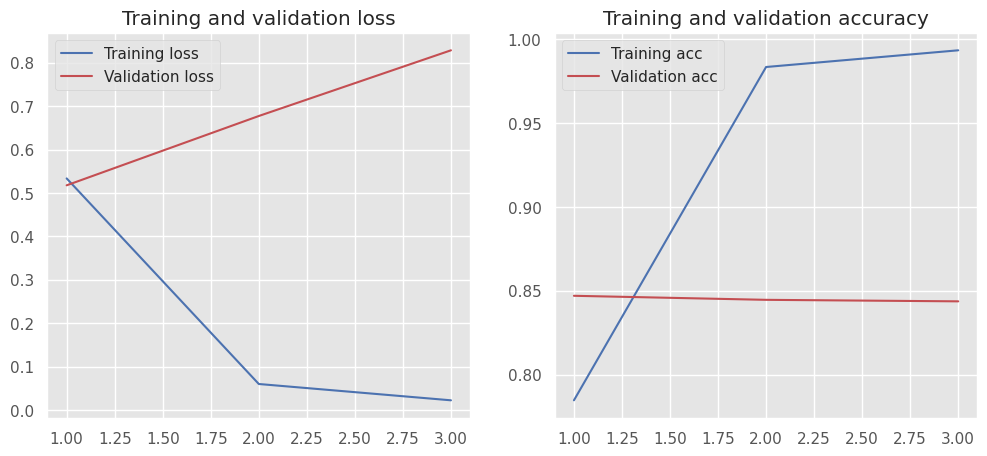

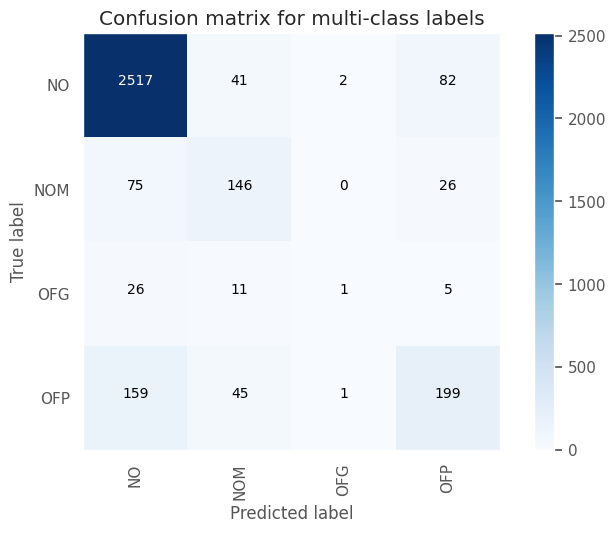

Test Accuracy: 0.8582
Test macro-F1: 0.5308


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6519    0.4609    0.5400       447
     no_hate     0.9202    0.9619    0.9406      2889

    accuracy                         0.8948      3336
   macro avg     0.7860    0.7114    0.7403      3336
weighted avg     0.8842    0.8948    0.8869      3336



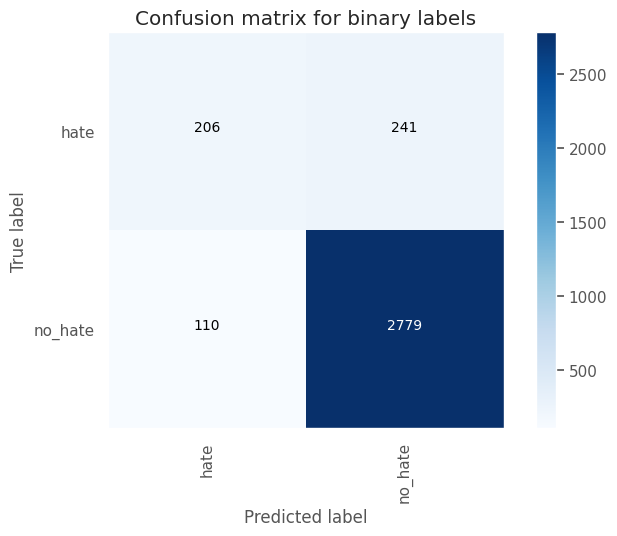

Test Accuracy: 0.8948
Test macro-F1: 0.7403




Training with learning_rate=0.00025 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_37"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_37 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_37 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_92 (Dense)                │ (31660, 64)            │       819,264 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_55 (Dropout)            │ (31660, 64)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_93 (Dense)                │ (31660, 4)             │           260 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,319,524 (5.03 MB)

 Trainable params: 1,319,524 (5.03 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 10s 9ms/step - acc: 0.4818 - loss: 1.1196 - val_acc: 0.8143 - val_loss: 0.5328
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - acc: 0.9458 - loss: 0.1955 - val_acc: 0.8429 - val_loss: 0.5322
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - acc: 0.9849 - loss: 0.0602 - val_acc: 0.8480 - val_loss: 0.6238
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9092    0.9512    0.9297      2642
         NOM     0.6229    0.5951    0.6087       247
         OFG     0.2500    0.0233    0.0426        43
         OFP     0.6506    0.5347    0.5870       404

    accuracy                         0.8624      3336
   macro avg     0.6082    0.5261    0.5420      3336
weighted avg     0.8482    0.8624    0.8530      3336



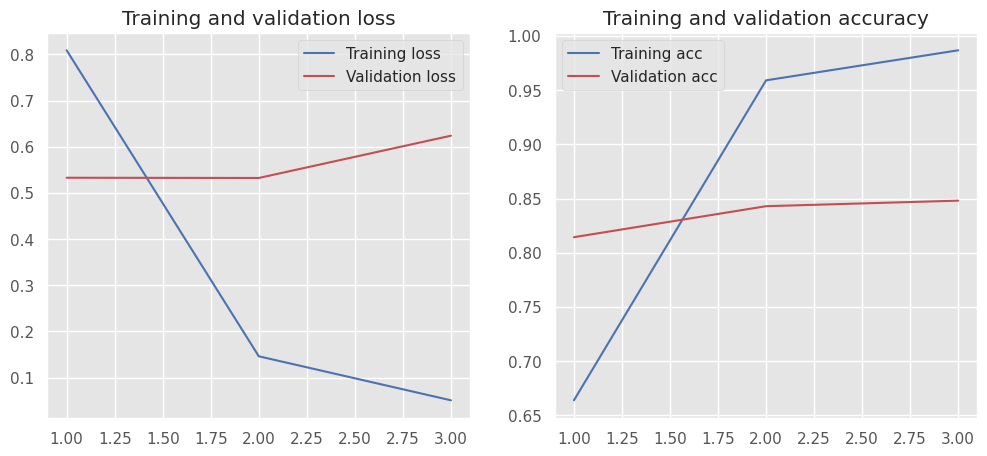

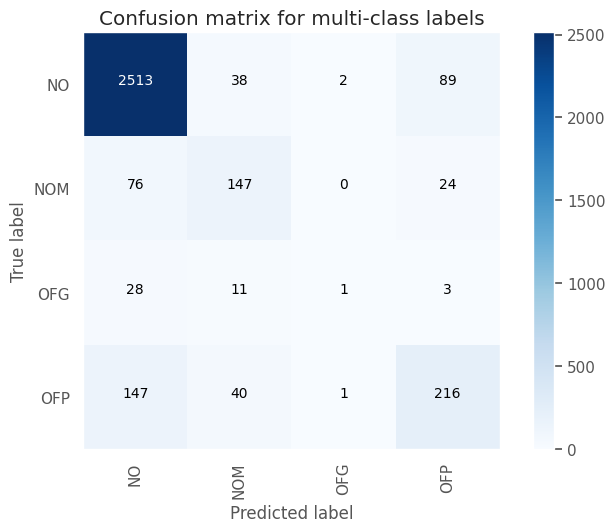

Test Accuracy: 0.8624
Test macro-F1: 0.542


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6577    0.4944    0.5645       447
     no_hate     0.9247    0.9602    0.9421      2889

    accuracy                         0.8978      3336
   macro avg     0.7912    0.7273    0.7533      3336
weighted avg     0.8889    0.8978    0.8915      3336



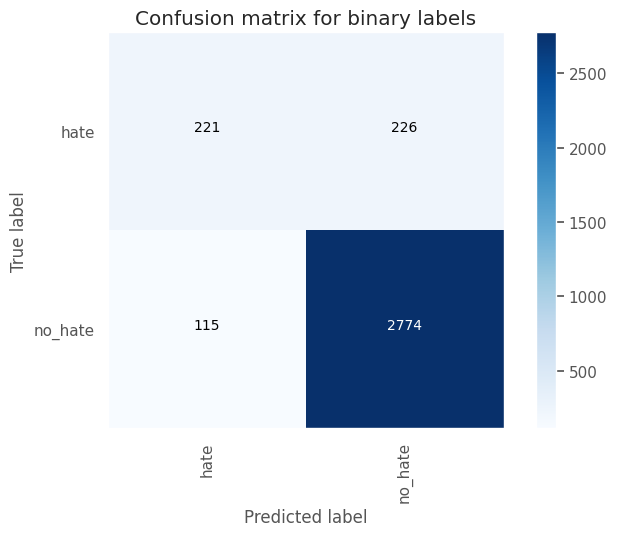

Test Accuracy: 0.8978
Test macro-F1: 0.7533




Training with learning_rate=0.000125 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_38"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_38 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_38 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_94 (Dense)                │ (31660, 64)            │       819,264 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_56 (Dropout)            │ (31660, 64)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_95 (Dense)                │ (31660, 4)             │           260 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,319,524 (5.03 MB)

 Trainable params: 1,319,524 (5.03 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 10s 9ms/step - acc: 0.4157 - loss: 1.2388 - val_acc: 0.7517 - val_loss: 0.7811
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - acc: 0.8740 - loss: 0.4176 - val_acc: 0.8285 - val_loss: 0.5041
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 8s 8ms/step - acc: 0.9608 - loss: 0.1544 - val_acc: 0.8396 - val_loss: 0.5079
Epoch 4/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - acc: 0.9827 - loss: 0.0795 - val_acc: 0.8483 - val_loss: 0.5618
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9122    0.9474    0.9294      2642
         NOM     0.6163    0.6113    0.6138       247
         OFG     0.2500    0.0233    0.0426        43
         OFP     0.6385    0.5421    0.5863       404

    accuracy                         0.8615      3336
   macro avg    

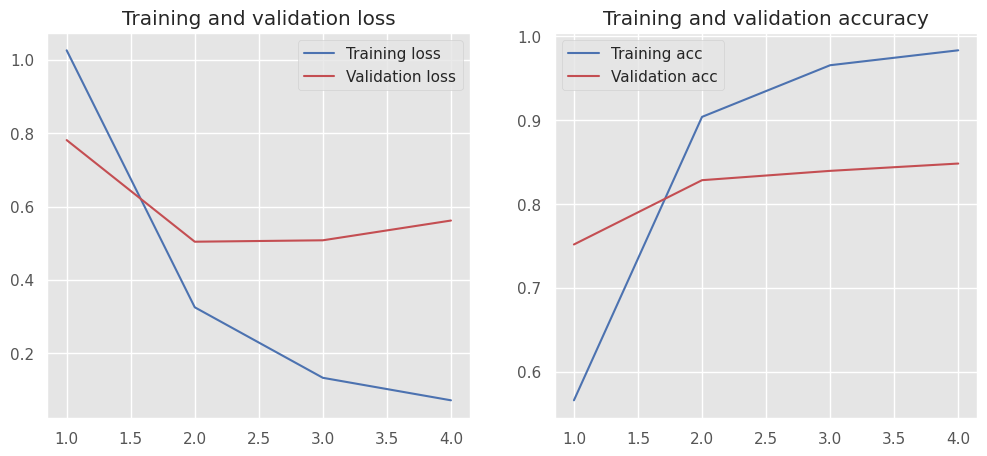

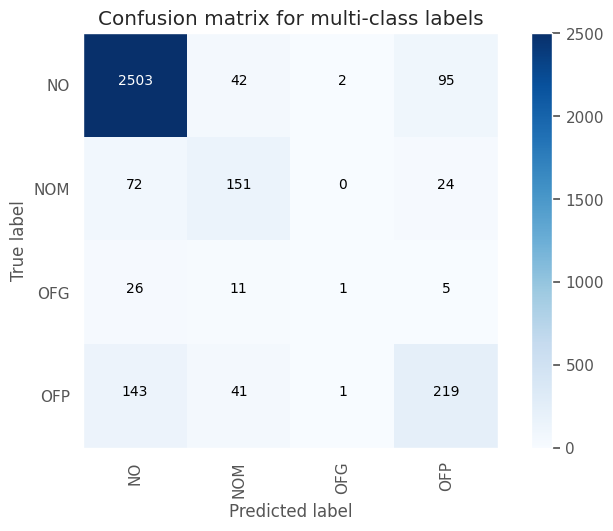

Test Accuracy: 0.8615
Test macro-F1: 0.543


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6513    0.5056    0.5693       447
     no_hate     0.9261    0.9581    0.9418      2889

    accuracy                         0.8975      3336
   macro avg     0.7887    0.7319    0.7555      3336
weighted avg     0.8892    0.8975    0.8919      3336



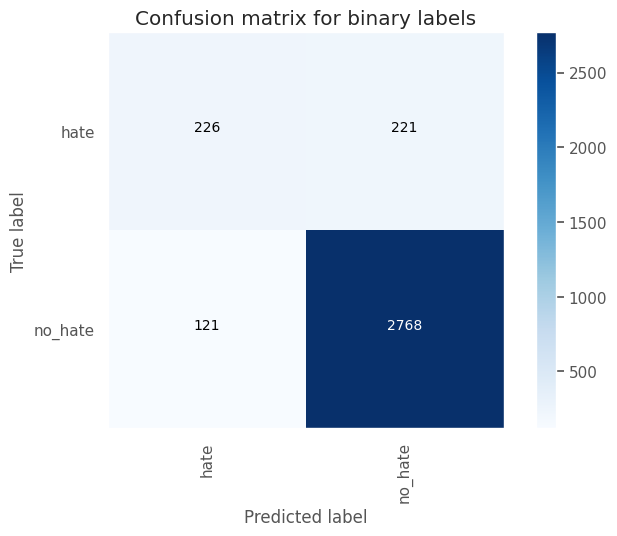

Test Accuracy: 0.8975
Test macro-F1: 0.7555




Training with dense_dim=128 ==============>
Training with learning_rate=0.0005 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_39"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_39 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_39 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_96 (Dense)                │ (31660, 128)           │     1,638,528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_57 (Dropout)            │ (31660, 128)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_97 (Dense)                │ (31660, 4)             │           516 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,139,044 (8.16 MB)

 Trainable params: 2,139,044 (8.16 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 16s 15ms/step - acc: 0.6221 - loss: 0.8633 - val_acc: 0.8474 - val_loss: 0.5344
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - acc: 0.9841 - loss: 0.0622 - val_acc: 0.8531 - val_loss: 0.7078
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 15s 15ms/step - acc: 0.9934 - loss: 0.0242 - val_acc: 0.8402 - val_loss: 0.8017
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9081    0.9421    0.9248      2642
         NOM     0.5875    0.6113    0.5992       247
         OFG     0.2500    0.0233    0.0426        43
         OFP     0.6168    0.5099    0.5583       404

    accuracy                         0.8534      3336
   macro avg     0.5906    0.5216    0.5312      3336
weighted avg     0.8406    0.8534    0.8449      3336



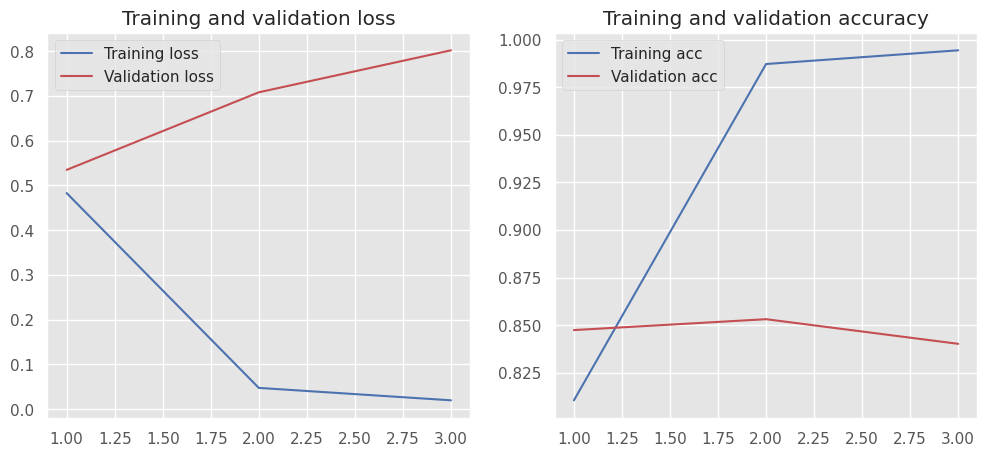

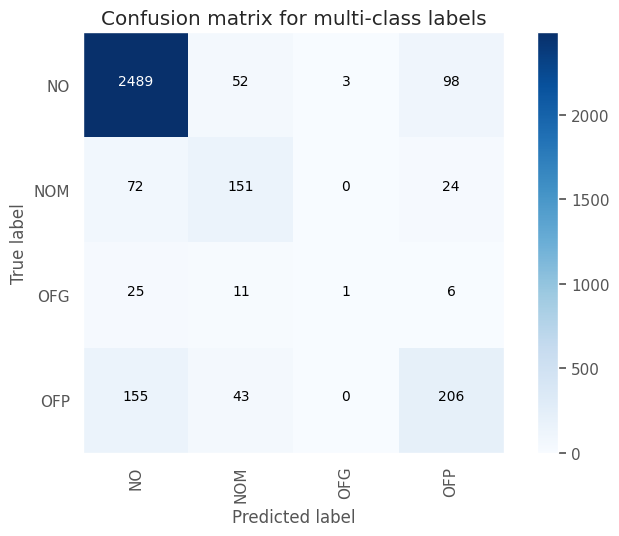

Test Accuracy: 0.8534
Test macro-F1: 0.5312


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6302    0.4765    0.5427       447
     no_hate     0.9219    0.9567    0.9390      2889

    accuracy                         0.8924      3336
   macro avg     0.7761    0.7166    0.7408      3336
weighted avg     0.8829    0.8924    0.8859      3336



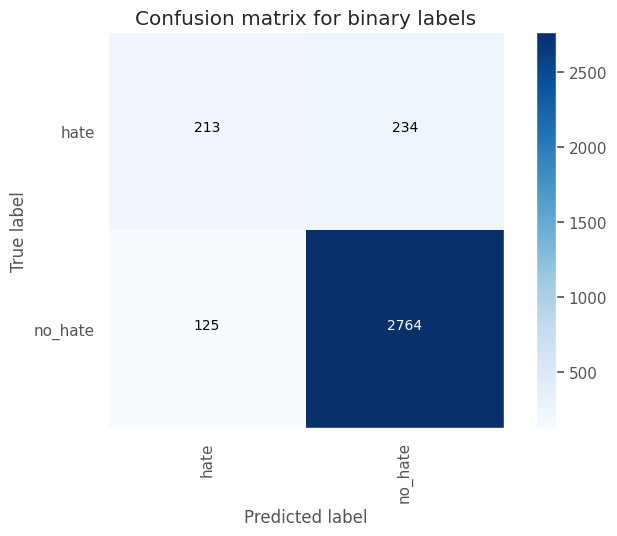

Test Accuracy: 0.8924
Test macro-F1: 0.7408




Training with learning_rate=0.00025 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_40"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_40 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_40 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_98 (Dense)                │ (31660, 128)           │     1,638,528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_58 (Dropout)            │ (31660, 128)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_99 (Dense)                │ (31660, 4)             │           516 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,139,044 (8.16 MB)

 Trainable params: 2,139,044 (8.16 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 16s 15ms/step - acc: 0.5104 - loss: 1.0765 - val_acc: 0.8206 - val_loss: 0.5185
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 16s 16ms/step - acc: 0.9525 - loss: 0.1605 - val_acc: 0.8471 - val_loss: 0.5694
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 15s 15ms/step - acc: 0.9874 - loss: 0.0515 - val_acc: 0.8432 - val_loss: 0.6630
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9122    0.9440    0.9278      2642
         NOM     0.6048    0.6073    0.6061       247
         OFG     0.2500    0.0233    0.0426        43
         OFP     0.6429    0.5569    0.5968       404

    accuracy                         0.8603      3336
   macro avg     0.6025    0.5329    0.5433      3336
weighted avg     0.8483    0.8603    0.8525      3336



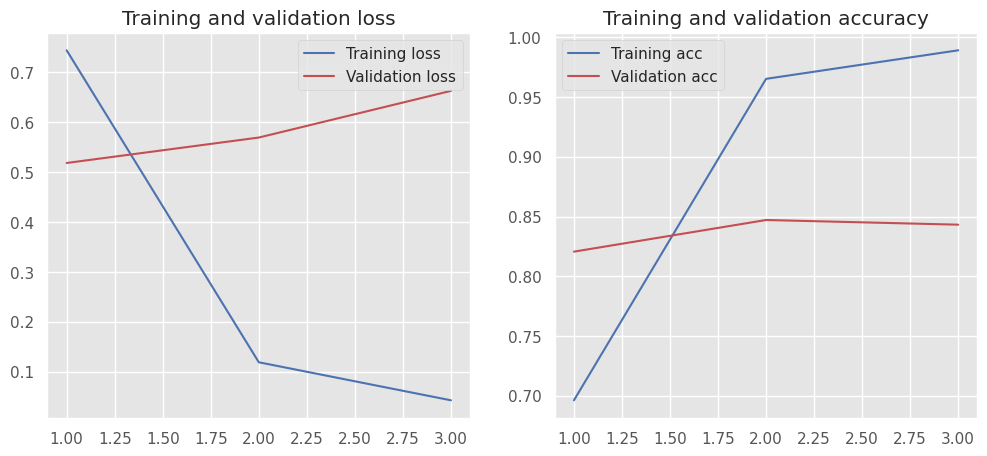

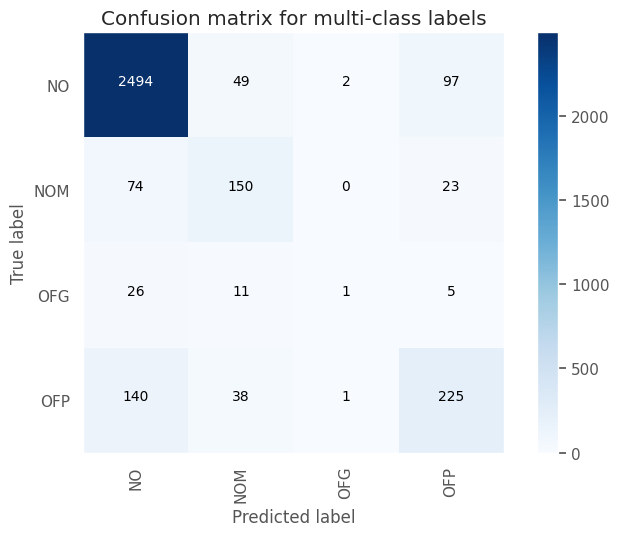

Test Accuracy: 0.8603
Test macro-F1: 0.5433


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6554    0.5190    0.5793       447
     no_hate     0.9279    0.9578    0.9426      2889

    accuracy                         0.8990      3336
   macro avg     0.7916    0.7384    0.7609      3336
weighted avg     0.8914    0.8990    0.8939      3336



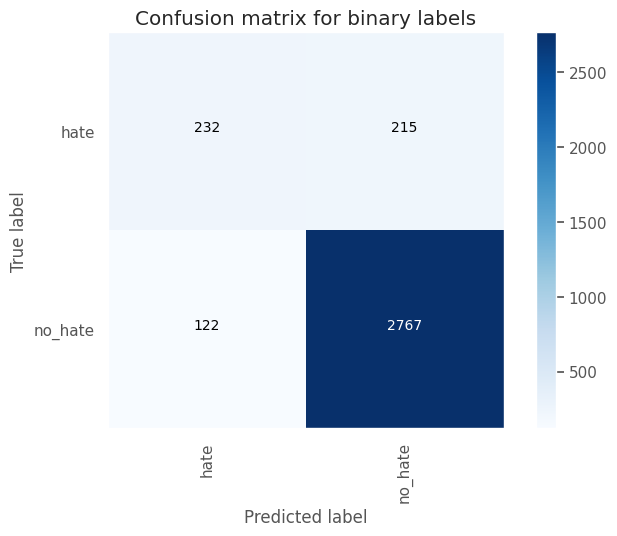

Test Accuracy: 0.899
Test macro-F1: 0.7609




Training with learning_rate=0.000125 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_41"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_41 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_41 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_100 (Dense)               │ (31660, 128)           │     1,638,528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_59 (Dropout)            │ (31660, 128)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_101 (Dense)               │ (31660, 4)             │           516 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,139,044 (8.16 MB)

 Trainable params: 2,139,044 (8.16 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 16s 15ms/step - acc: 0.4225 - loss: 1.2255 - val_acc: 0.7596 - val_loss: 0.7527
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 16s 16ms/step - acc: 0.8780 - loss: 0.3966 - val_acc: 0.8339 - val_loss: 0.4966
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 14s 15ms/step - acc: 0.9671 - loss: 0.1257 - val_acc: 0.8423 - val_loss: 0.5445
Epoch 4/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 16s 16ms/step - acc: 0.9868 - loss: 0.0615 - val_acc: 0.8450 - val_loss: 0.6076
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9112    0.9478    0.9291      2642
         NOM     0.6073    0.6073    0.6073       247
         OFG     0.4000    0.0465    0.0833        43
         OFP     0.6548    0.5446    0.5946       404

    accuracy                         0.8621      3336
   macro 

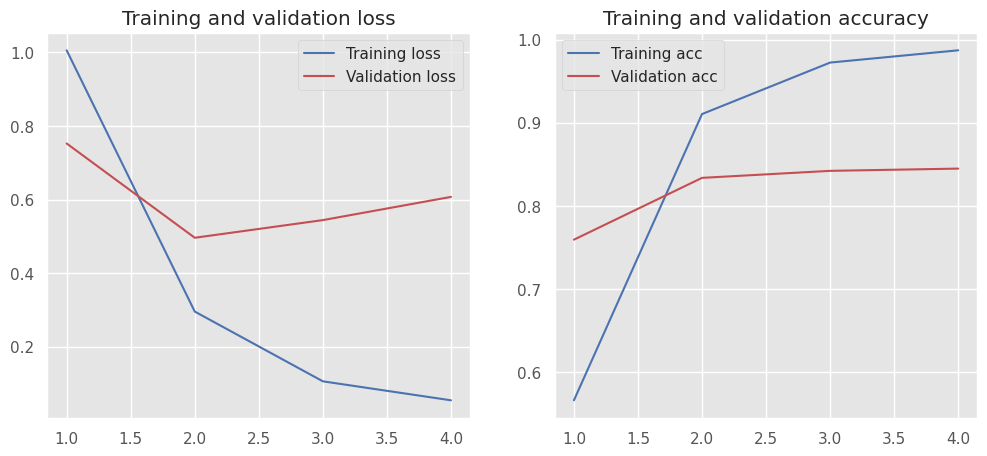

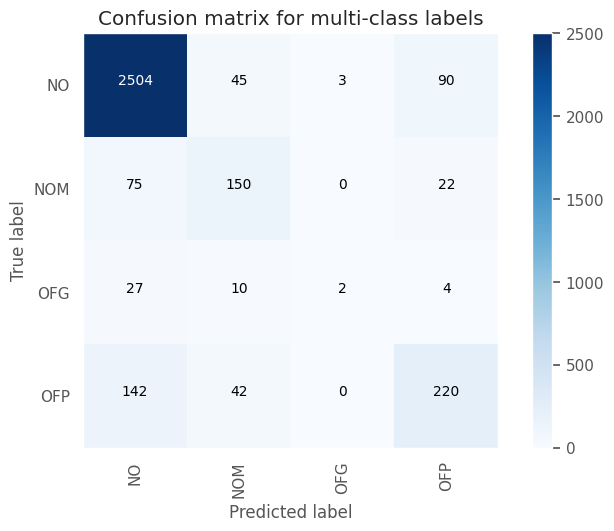

Test Accuracy: 0.8621
Test macro-F1: 0.5536


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6628    0.5056    0.5736       447
     no_hate     0.9262    0.9602    0.9429      2889

    accuracy                         0.8993      3336
   macro avg     0.7945    0.7329    0.7583      3336
weighted avg     0.8909    0.8993    0.8934      3336



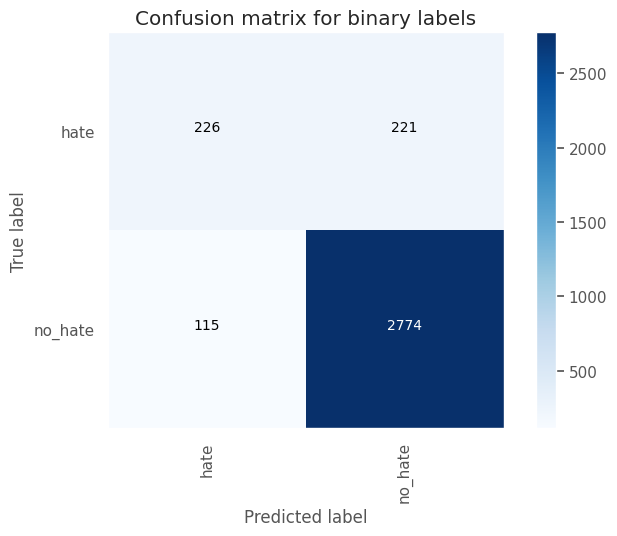

Test Accuracy: 0.8993
Test macro-F1: 0.7583






In [ ]:
vocab_size: int = 5000
max_length: int = 128
embedding_dim: int = 100

for dense_dim in [8, 16, 32, 64, 128]:
    print(f"Training with dense_dim={dense_dim} ==============>")
    for lr in [0.0005, 0.00025, 0.000125]:
        print(f"Training with learning_rate={lr} ======")
        # Define Keras model
        model = Sequential([
            Embedding(vocab_size, embedding_dim, input_length=max_length),
            Flatten(),
            Dense(dense_dim, activation='relu'),
            Dropout(0.3),
            Dense(4, activation='softmax')
        ])

        # Data
        dataset_folder: str = dataset_v2_folder
        data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
        x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], \
            data[
                "x_test"], data["y_test"]

        # Train with our class
        trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                 max_input_length=max_length))
        trainer.train(x_train=x_train,
                      y_train=y_train,
                      opt_config=OptimizationConfig(
                          epochs=50,
                          batch_size=32,
                          validation_split=0.0,
                          validation_data=(x_val, y_val),
                          optimizer=Adam(learning_rate=lr)
                      ),
                      callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
        trainer.predict_with_report(x_test=x_test, y_test=y_test)

Con estas pruebas, sí que logramos mejorar la performance. Notamos que nos ayuda bastante reducir el learning rate, y que tenemos algunas curvas que lucen un poco mejor. **En este caso, alcanzamos un 55.36% de macro-f1 (MULTI-CLASS) y 75.83% de macro-f1 (BINARY-CLASS)**.

De forma de facilitar la vista y poder ver los resultados comparativamente y más efectivamente, he creado el `ResultsReporter`, el cual nos generará al final del experimento un pandas dataframe con todos los resultados que hayamos trackeado en algún training en concreto.

## Entrenando sobre `v6`

Repetiremos entrenar pero sobre `v6`, el cual tiene le mismo cleanup que `v1` pero no está completamente balanceado y tiene aumentada `OFG`.

Training with dense_dim=16 ==============>
Training with learning_rate=0.001 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_18"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_18 (Embedding)        │ (11059, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_18 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_36 (Dense)                │ (11059, 16)            │       204,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_18 (Dropout)            │ (11059, 16)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_37 (Dense)                │ (11059, 4)             │            68 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 704,884 (2.69 MB)

 Trainable params: 704,884 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - acc: 0.7126 - loss: 0.8912 - val_acc: 0.8173 - val_loss: 0.5408
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - acc: 0.8349 - loss: 0.4987 - val_acc: 0.8348 - val_loss: 0.5131
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - acc: 0.9001 - loss: 0.2877 - val_acc: 0.8468 - val_loss: 0.5576
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - acc: 0.9395 - loss: 0.1778 - val_acc: 0.8414 - val_loss: 0.6378
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.8988    0.9512    0.9242      2642
         NOM     0.6614    0.5061    0.5734       247
         OFG     0.0667    0.0698    0.0682        43
         OFP     0.6373    0.4827    0.5493       404

    accuracy                         0.8501      3336
   macro avg     

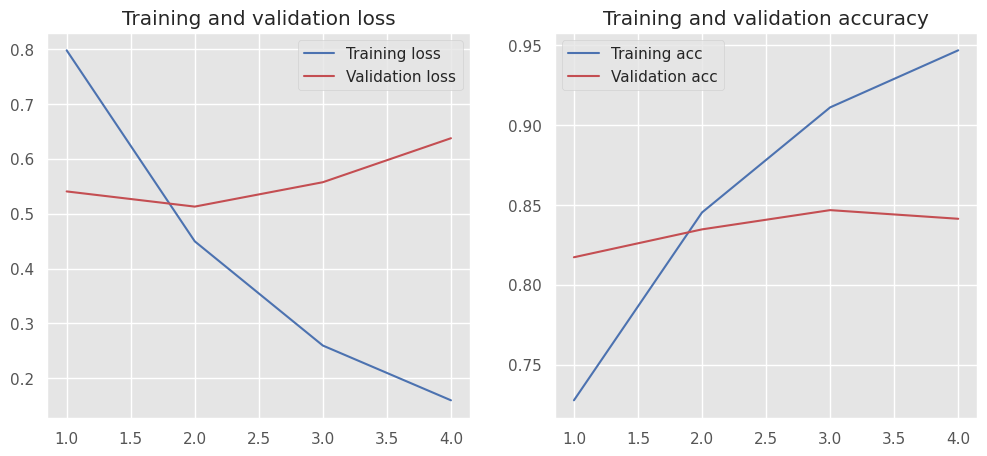

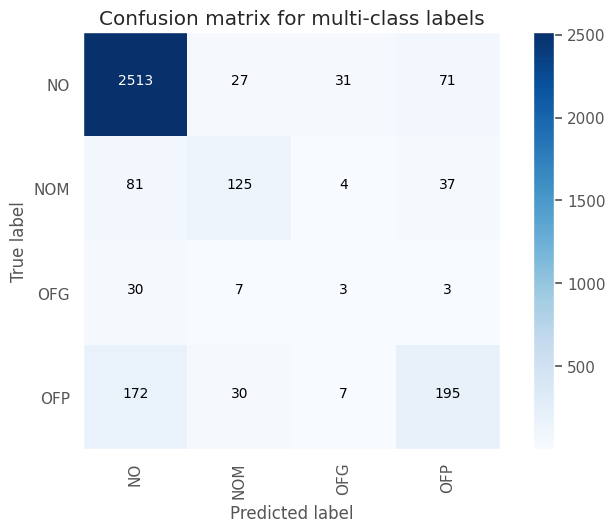

Test Accuracy: 0.8501
Test macro-F1: 0.5288


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5926    0.4653    0.5213       447
     no_hate     0.9199    0.9505    0.9350      2889

    accuracy                         0.8855      3336
   macro avg     0.7563    0.7079    0.7281      3336
weighted avg     0.8761    0.8855    0.8795      3336



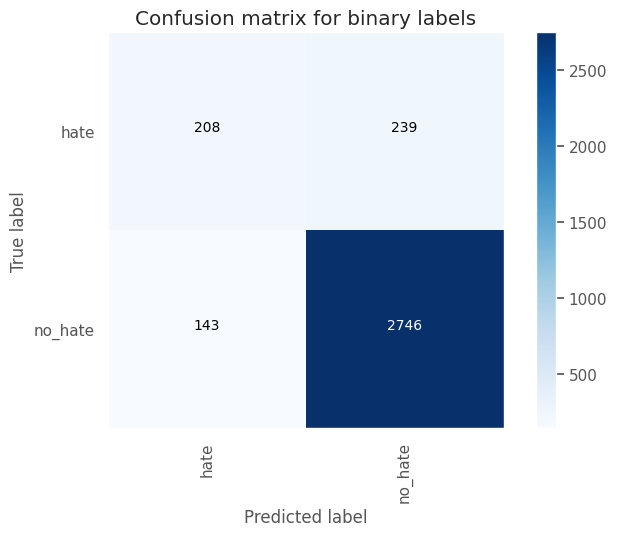

Test Accuracy: 0.8855
Test macro-F1: 0.7281




Training with learning_rate=0.00025 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_19"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_19 (Embedding)        │ (11059, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_19 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_38 (Dense)                │ (11059, 16)            │       204,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_19 (Dropout)            │ (11059, 16)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_39 (Dense)                │ (11059, 4)             │            68 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 704,884 (2.69 MB)

 Trainable params: 704,884 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - acc: 0.7072 - loss: 0.9627 - val_acc: 0.7942 - val_loss: 0.7015
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - acc: 0.7246 - loss: 0.7885 - val_acc: 0.7948 - val_loss: 0.6009
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.7265 - loss: 0.6644 - val_acc: 0.7972 - val_loss: 0.5477
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - acc: 0.7483 - loss: 0.5654 - val_acc: 0.8140 - val_loss: 0.5467
Epoch 5/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - acc: 0.8264 - loss: 0.4756 - val_acc: 0.8158 - val_loss: 0.5425
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.8831    0.9746    0.9266      2642
         NOM     0.8750    0.0283    0.0549       247
         OFG     0.0479    0.2093    0.0779        43
        

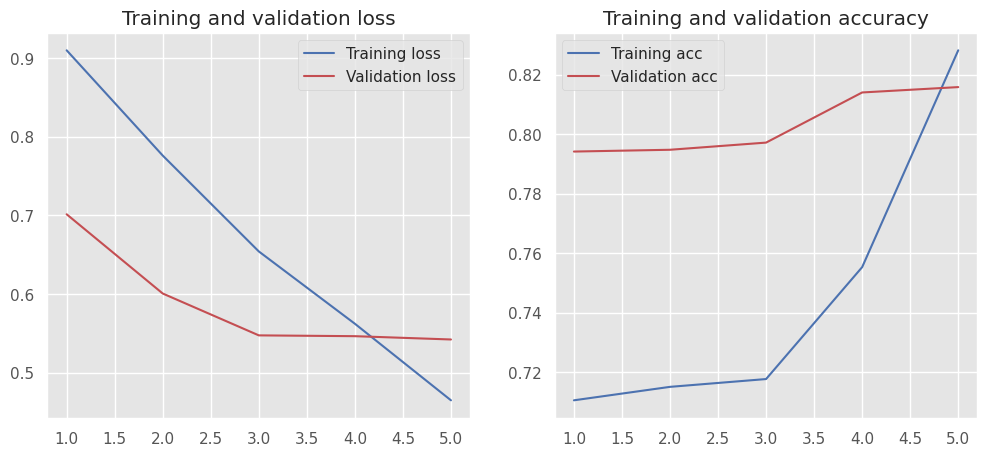

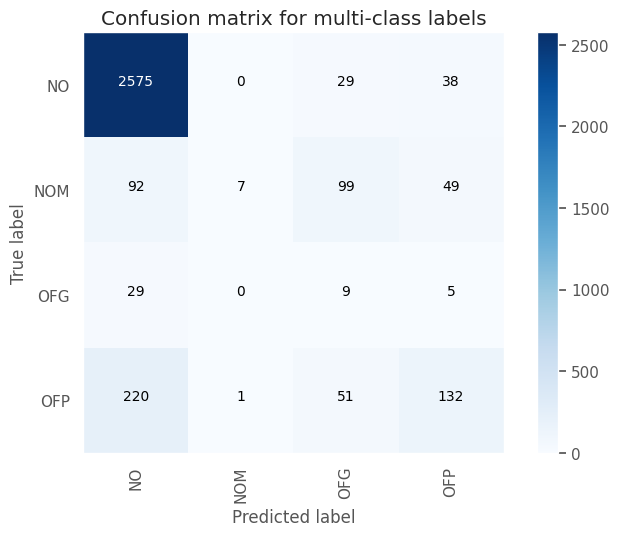

Test Accuracy: 0.8162
Test macro-F1: 0.3699


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4782    0.4407    0.4587       447
     no_hate     0.9145    0.9256    0.9200      2889

    accuracy                         0.8606      3336
   macro avg     0.6963    0.6831    0.6893      3336
weighted avg     0.8560    0.8606    0.8582      3336



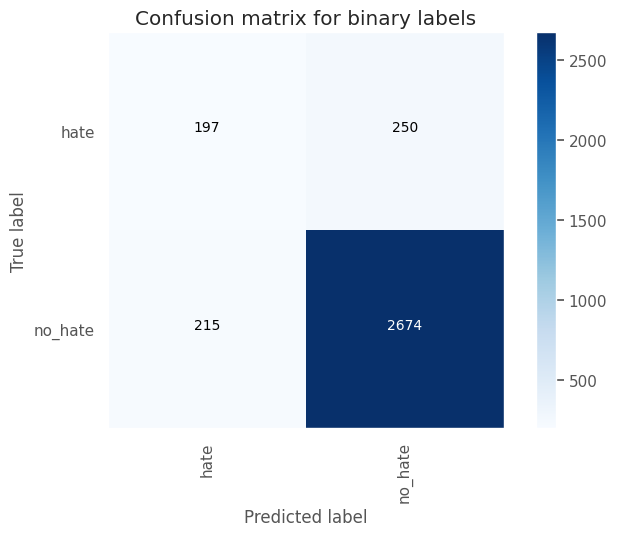

Test Accuracy: 0.8606
Test macro-F1: 0.6893




Training with learning_rate=0.000125 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_20"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_20 (Embedding)        │ (11059, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_20 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ (11059, 16)            │       204,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_20 (Dropout)            │ (11059, 16)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (11059, 4)             │            68 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 704,884 (2.69 MB)

 Trainable params: 704,884 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - acc: 0.7044 - loss: 1.0002 - val_acc: 0.7942 - val_loss: 0.7431
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - acc: 0.7250 - loss: 0.8428 - val_acc: 0.7948 - val_loss: 0.6871
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - acc: 0.7295 - loss: 0.7957 - val_acc: 0.7948 - val_loss: 0.6583
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - acc: 0.7318 - loss: 0.7304 - val_acc: 0.7948 - val_loss: 0.6018
Epoch 5/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.7339 - loss: 0.6582 - val_acc: 0.7951 - val_loss: 0.5686
Epoch 6/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - acc: 0.7634 - loss: 0.5899 - val_acc: 0.7987 - val_loss: 0.5492
Epoch 7/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - acc: 0.7944 - loss: 0.5429 - val_acc: 0.8044 - val_loss: 0.5431
Epoch 8/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - acc: 0.8213 - loss: 0.4892 - val_acc: 0.8218 - val_loss: 0.5326
Ep

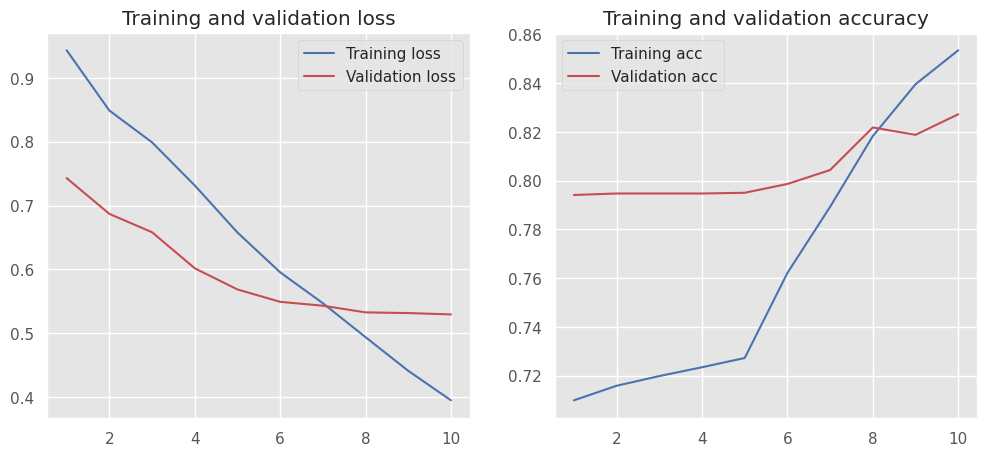

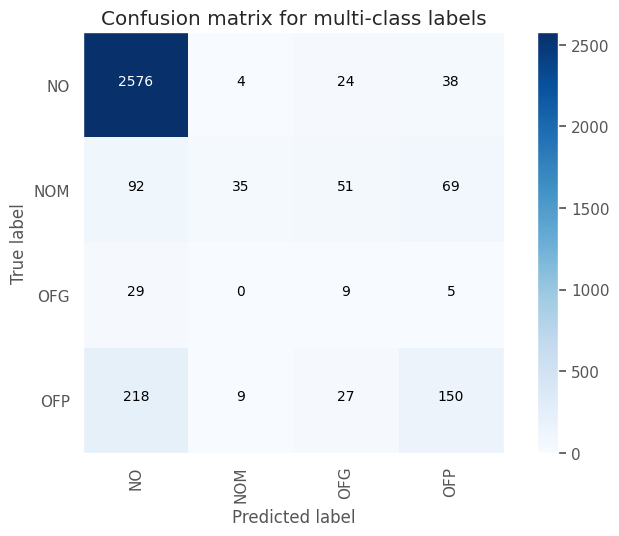

Test Accuracy: 0.8303
Test macro-F1: 0.4329


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5121    0.4273    0.4659       447
     no_hate     0.9136    0.9370    0.9252      2889

    accuracy                         0.8687      3336
   macro avg     0.7128    0.6821    0.6955      3336
weighted avg     0.8598    0.8687    0.8636      3336



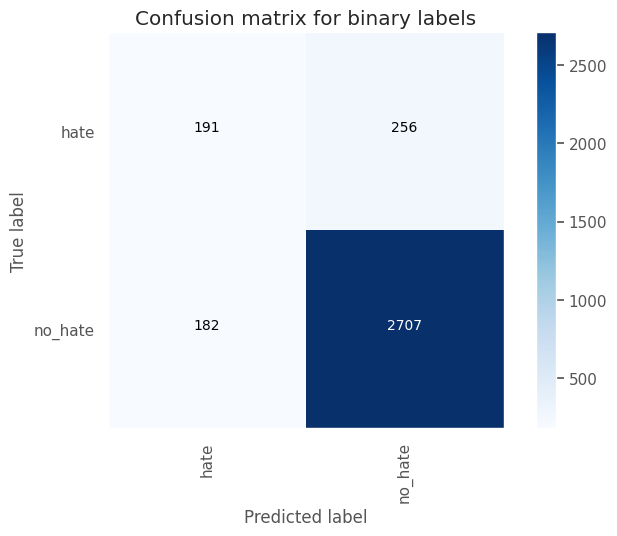

Test Accuracy: 0.8687
Test macro-F1: 0.6955




Training with dense_dim=32 ==============>
Training with learning_rate=0.001 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_21"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_21 (Embedding)        │ (11059, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_21 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_42 (Dense)                │ (11059, 32)            │       409,632 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_21 (Dropout)            │ (11059, 32)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (11059, 4)             │           132 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 909,764 (3.47 MB)

 Trainable params: 909,764 (3.47 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - acc: 0.7184 - loss: 0.8539 - val_acc: 0.8363 - val_loss: 0.5320
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.8562 - loss: 0.4155 - val_acc: 0.8456 - val_loss: 0.4860
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.9295 - loss: 0.2028 - val_acc: 0.8468 - val_loss: 0.5431
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.9690 - loss: 0.0992 - val_acc: 0.8450 - val_loss: 0.6803
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.8971    0.9569    0.9260      2642
         NOM     0.6791    0.5142    0.5853       247
         OFG     0.1111    0.0930    0.1013        43
         OFP     0.6305    0.4604    0.5322       404

    accuracy                         0.8528      3336
   macro avg     

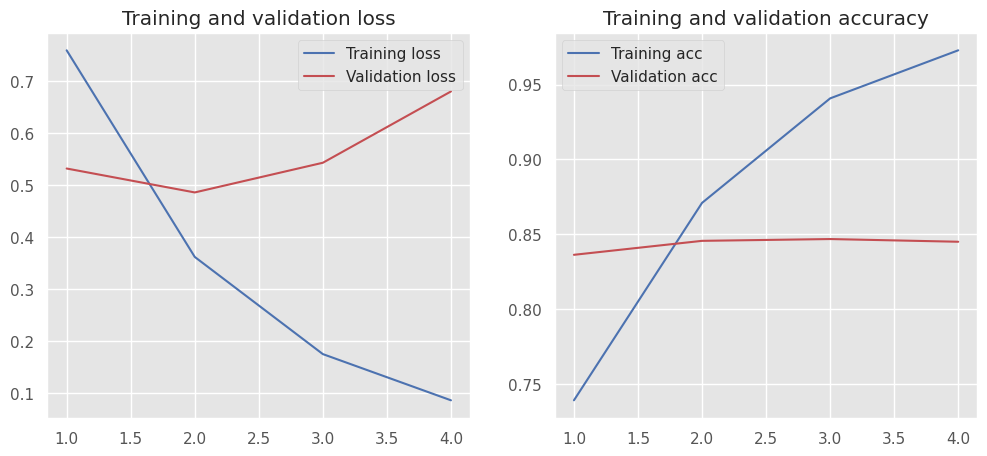

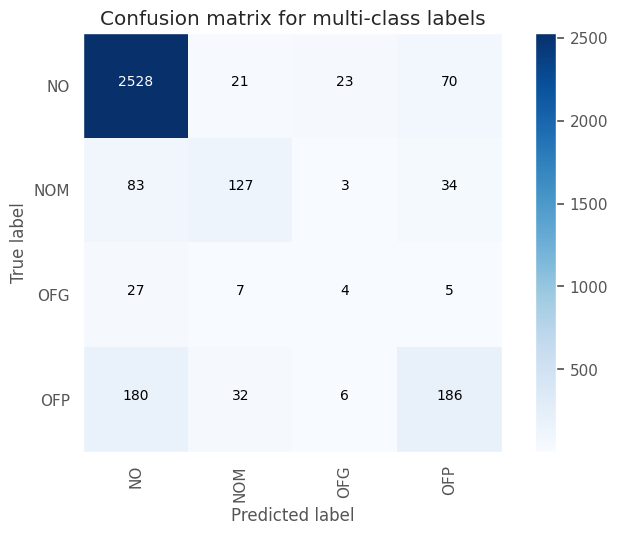

Test Accuracy: 0.8528
Test macro-F1: 0.5362


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6073    0.4497    0.5167       447
     no_hate     0.9181    0.9550    0.9362      2889

    accuracy                         0.8873      3336
   macro avg     0.7627    0.7023    0.7265      3336
weighted avg     0.8765    0.8873    0.8800      3336



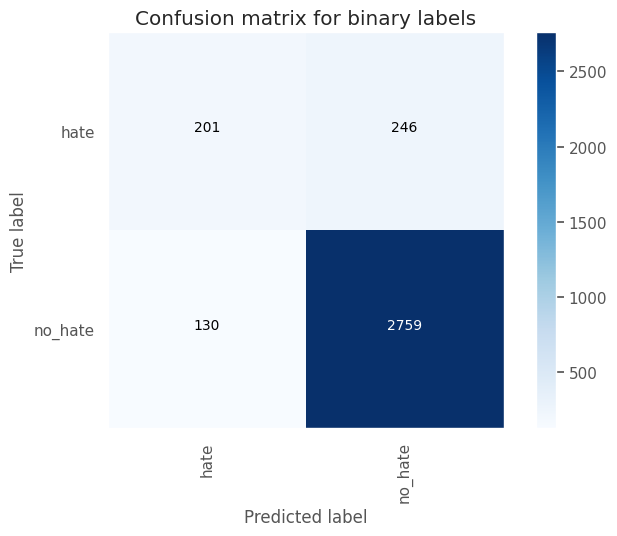

Test Accuracy: 0.8873
Test macro-F1: 0.7265




Training with learning_rate=0.00025 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_22"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_22 (Embedding)        │ (11059, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_22 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_44 (Dense)                │ (11059, 32)            │       409,632 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_22 (Dropout)            │ (11059, 32)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (11059, 4)             │           132 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 909,764 (3.47 MB)

 Trainable params: 909,764 (3.47 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - acc: 0.7131 - loss: 0.9045 - val_acc: 0.7948 - val_loss: 0.6609
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.7314 - loss: 0.7171 - val_acc: 0.8032 - val_loss: 0.5701
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.8162 - loss: 0.5356 - val_acc: 0.8297 - val_loss: 0.5210
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.8645 - loss: 0.3938 - val_acc: 0.8390 - val_loss: 0.5024
Epoch 5/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.8984 - loss: 0.2843 - val_acc: 0.8468 - val_loss: 0.4995
Epoch 6/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.9341 - loss: 0.2104 - val_acc: 0.8471 - val_loss: 0.5111
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.8954    0.9621    0.9276      264

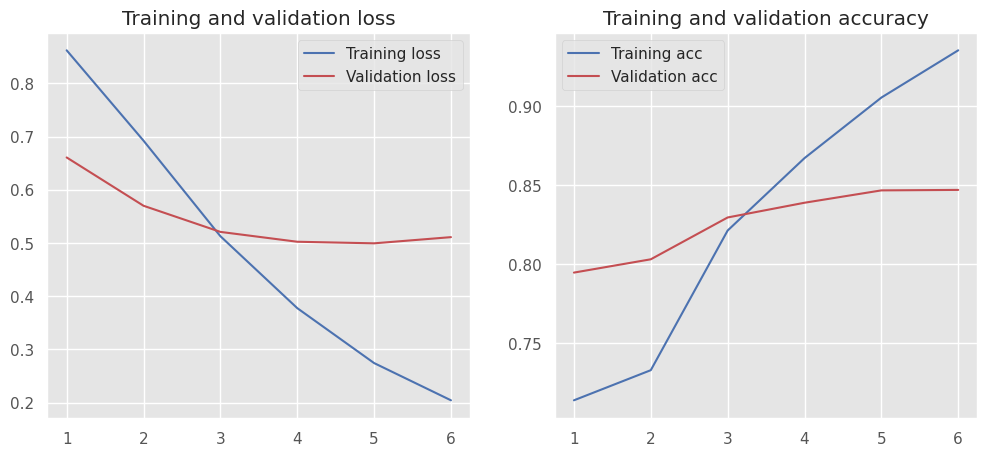

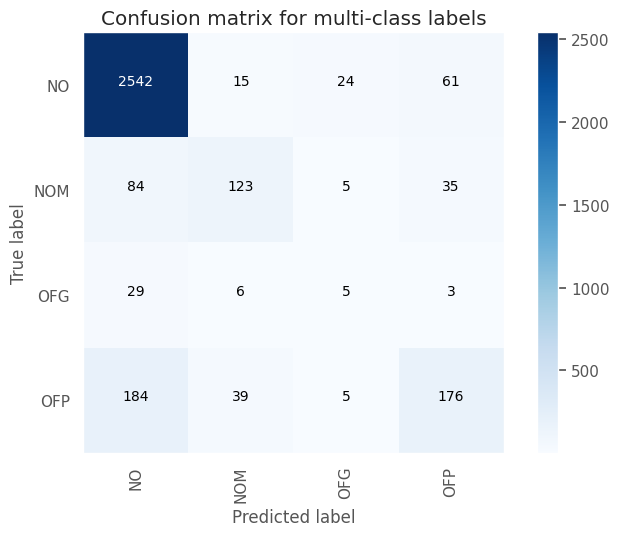

Test Accuracy: 0.8531
Test macro-F1: 0.535


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6019    0.4228    0.4967       447
     no_hate     0.9146    0.9567    0.9352      2889

    accuracy                         0.8852      3336
   macro avg     0.7583    0.6898    0.7160      3336
weighted avg     0.8727    0.8852    0.8765      3336



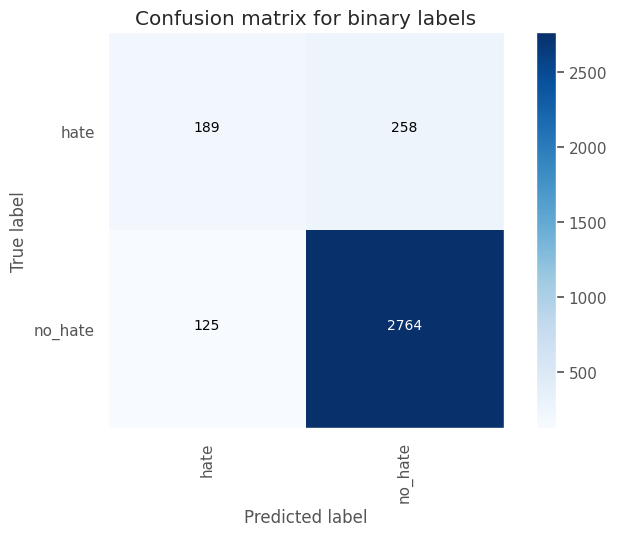

Test Accuracy: 0.8852
Test macro-F1: 0.716




Training with learning_rate=0.000125 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_23"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_23 (Embedding)        │ (11059, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_23 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (11059, 32)            │       409,632 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_23 (Dropout)            │ (11059, 32)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (11059, 4)             │           132 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 909,764 (3.47 MB)

 Trainable params: 909,764 (3.47 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - acc: 0.7125 - loss: 0.9369 - val_acc: 0.7945 - val_loss: 0.6902
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.7249 - loss: 0.8005 - val_acc: 0.7948 - val_loss: 0.6621
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - acc: 0.7320 - loss: 0.7292 - val_acc: 0.7993 - val_loss: 0.6045
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.7441 - loss: 0.6331 - val_acc: 0.8113 - val_loss: 0.5604
Epoch 5/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - acc: 0.8141 - loss: 0.5392 - val_acc: 0.8083 - val_loss: 0.5427
Epoch 6/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.8348 - loss: 0.4547 - val_acc: 0.8203 - val_loss: 0.5295
Epoch 7/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.8542 - loss: 0.3931 - val_acc: 0.8318 - val_loss: 0.5115
Epoch 8/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - acc: 0.8778 - loss: 0.3295 - val_acc: 0.8372 - val_loss: 0.5091
Ep

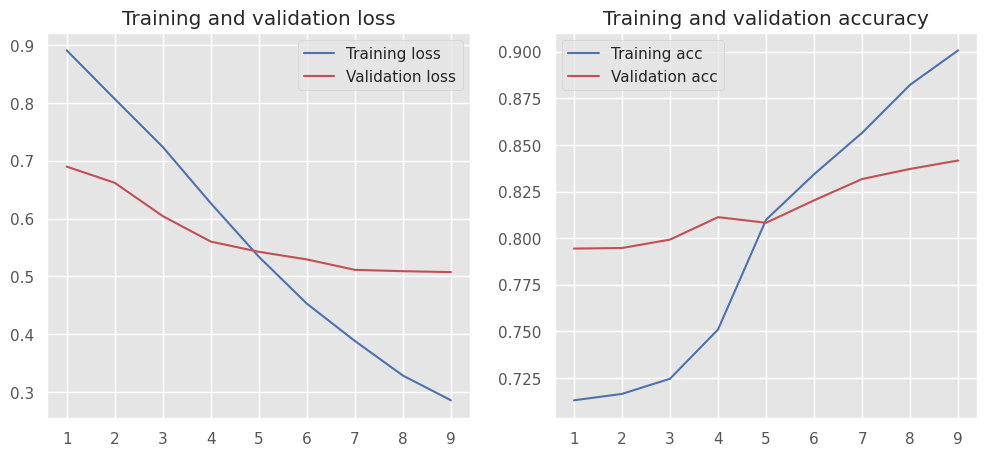

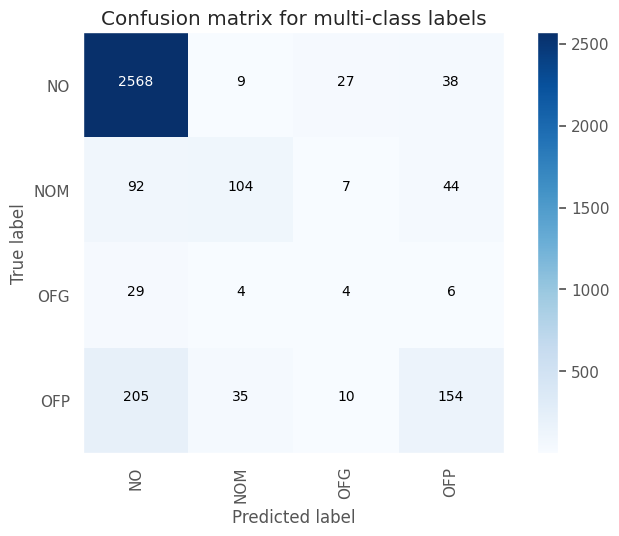

Test Accuracy: 0.8483
Test macro-F1: 0.5034


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6000    0.3893    0.4722       447
     no_hate     0.9104    0.9598    0.9345      2889

    accuracy                         0.8834      3336
   macro avg     0.7552    0.6746    0.7033      3336
weighted avg     0.8688    0.8834    0.8725      3336



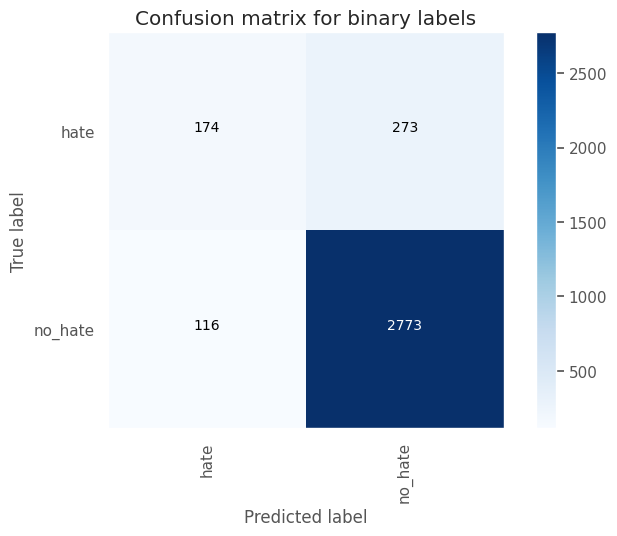

Test Accuracy: 0.8834
Test macro-F1: 0.7033




Training with dense_dim=64 ==============>
Training with learning_rate=0.001 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_24"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_24 (Embedding)        │ (11059, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_24 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (11059, 64)            │       819,264 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_24 (Dropout)            │ (11059, 64)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_49 (Dense)                │ (11059, 4)             │           260 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,319,524 (5.03 MB)

 Trainable params: 1,319,524 (5.03 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - acc: 0.7239 - loss: 0.8235 - val_acc: 0.8342 - val_loss: 0.5197
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - acc: 0.8716 - loss: 0.3599 - val_acc: 0.8486 - val_loss: 0.4924
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - acc: 0.9376 - loss: 0.1779 - val_acc: 0.8447 - val_loss: 0.5636
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - acc: 0.9707 - loss: 0.0848 - val_acc: 0.8426 - val_loss: 0.7038
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.8980    0.9531    0.9247      2642
         NOM     0.6493    0.5547    0.5983       247
         OFG     0.0909    0.0930    0.0920        43
         OFP     0.6534    0.4480    0.5316       404

    accuracy                         0.8513      3336
   macro avg     

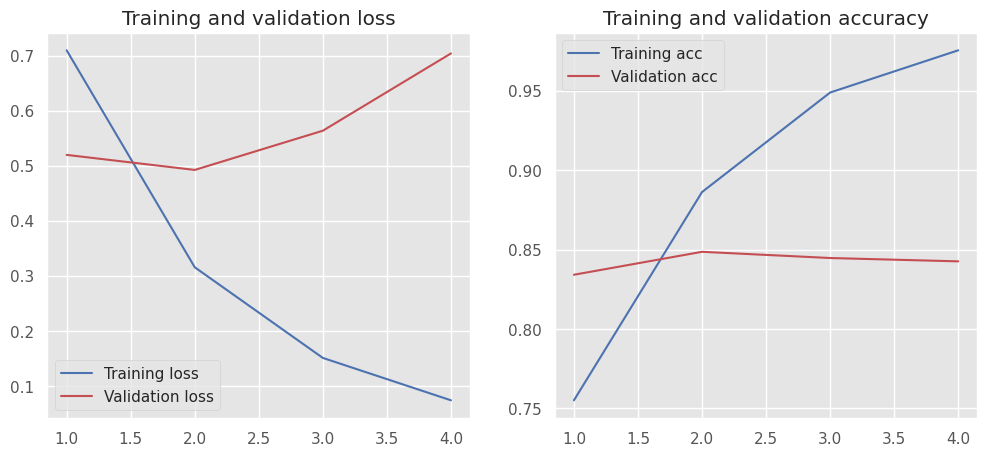

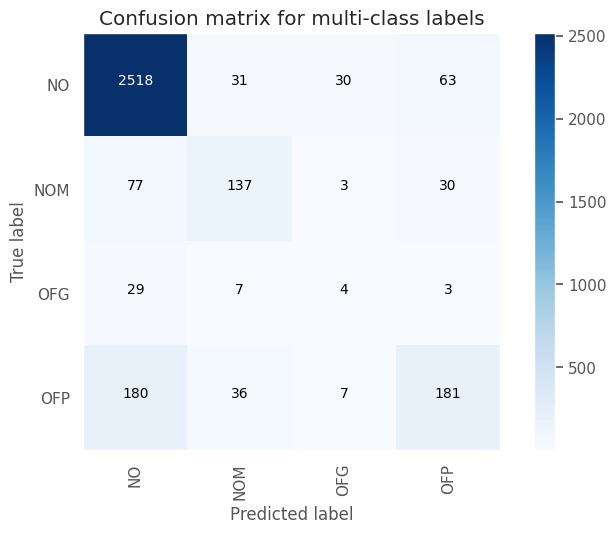

Test Accuracy: 0.8513
Test macro-F1: 0.5366


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6075    0.4362    0.5078       447
     no_hate     0.9164    0.9564    0.9360      2889

    accuracy                         0.8867      3336
   macro avg     0.7619    0.6963    0.7219      3336
weighted avg     0.8750    0.8867    0.8786      3336



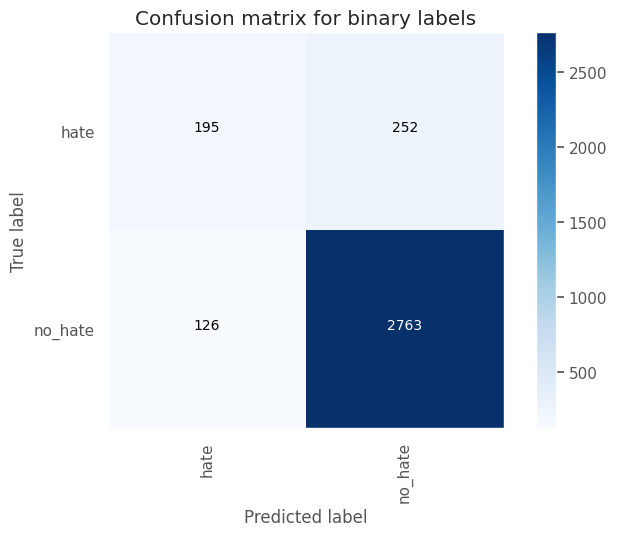

Test Accuracy: 0.8867
Test macro-F1: 0.7219




Training with learning_rate=0.00025 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_25"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_25 (Embedding)        │ (11059, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_25 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (11059, 64)            │       819,264 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_25 (Dropout)            │ (11059, 64)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (11059, 4)             │           260 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,319,524 (5.03 MB)

 Trainable params: 1,319,524 (5.03 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 10ms/step - acc: 0.7127 - loss: 0.8984 - val_acc: 0.7948 - val_loss: 0.6550
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - acc: 0.7417 - loss: 0.6975 - val_acc: 0.7930 - val_loss: 0.5639
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - acc: 0.8235 - loss: 0.4957 - val_acc: 0.8336 - val_loss: 0.5033
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - acc: 0.8742 - loss: 0.3410 - val_acc: 0.8369 - val_loss: 0.5007
Epoch 5/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - acc: 0.9124 - loss: 0.2472 - val_acc: 0.8474 - val_loss: 0.5115
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.8920    0.9690    0.9289      2642
         NOM     0.7006    0.5020    0.5849       247
         OFG     0.0909    0.0930    0.0920        43
       

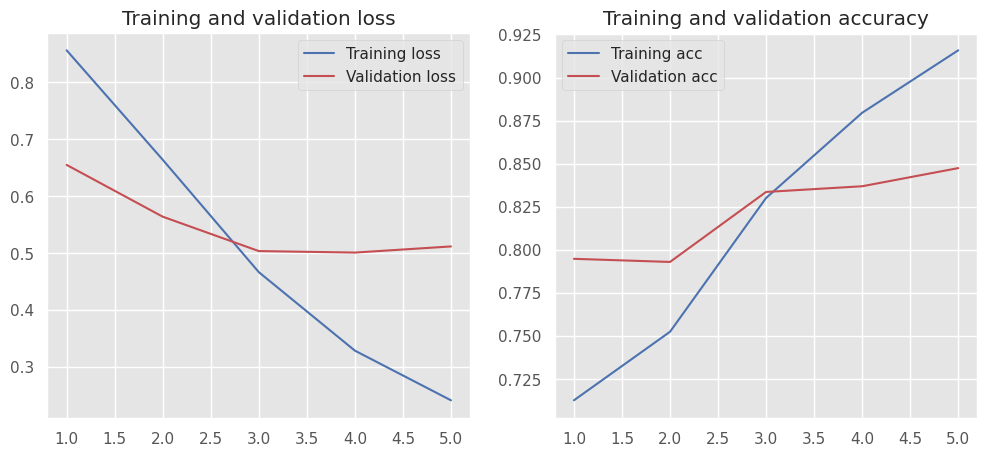

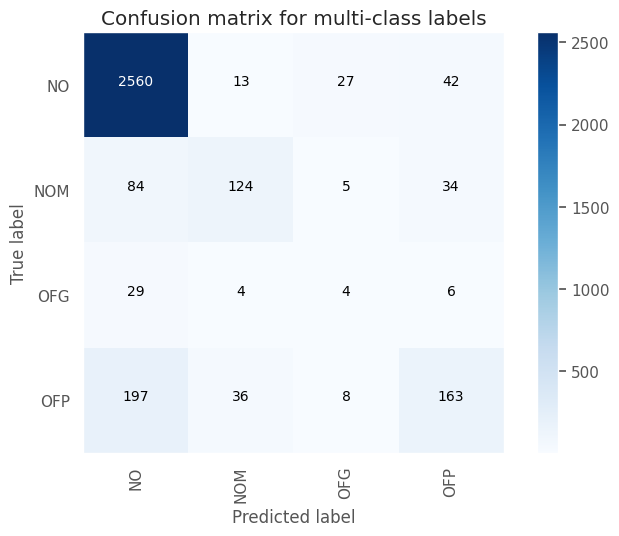

Test Accuracy: 0.8546
Test macro-F1: 0.527


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6263    0.4049    0.4918       447
     no_hate     0.9127    0.9626    0.9370      2889

    accuracy                         0.8879      3336
   macro avg     0.7695    0.6838    0.7144      3336
weighted avg     0.8743    0.8879    0.8773      3336



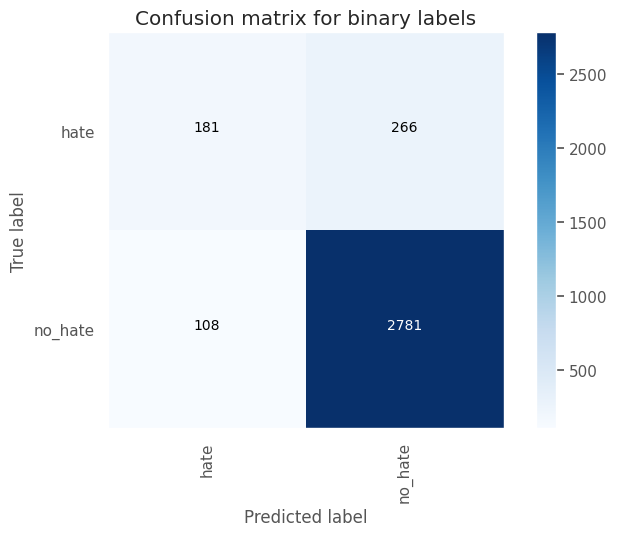

Test Accuracy: 0.8879
Test macro-F1: 0.7144




Training with learning_rate=0.000125 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_26"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_26 (Embedding)        │ (11059, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_26 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (11059, 64)            │       819,264 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_26 (Dropout)            │ (11059, 64)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_53 (Dense)                │ (11059, 4)             │           260 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,319,524 (5.03 MB)

 Trainable params: 1,319,524 (5.03 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - acc: 0.7128 - loss: 0.9256 - val_acc: 0.7942 - val_loss: 0.6887
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - acc: 0.7263 - loss: 0.7884 - val_acc: 0.7963 - val_loss: 0.6542
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - acc: 0.7339 - loss: 0.7095 - val_acc: 0.8029 - val_loss: 0.5878
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - acc: 0.7570 - loss: 0.6057 - val_acc: 0.8041 - val_loss: 0.5528
Epoch 5/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - acc: 0.8211 - loss: 0.5015 - val_acc: 0.8191 - val_loss: 0.5294
Epoch 6/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - acc: 0.8525 - loss: 0.4090 - val_acc: 0.8330 - val_loss: 0.5133
Epoch 7/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - acc: 0.8801 - loss: 0.3347 - val_acc: 0.8378 - val_loss: 0.5059
Epoch 8/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - acc: 0.9002 - loss: 0.2772 - val_acc: 0.8387 - val_loss: 0.5099
Mo

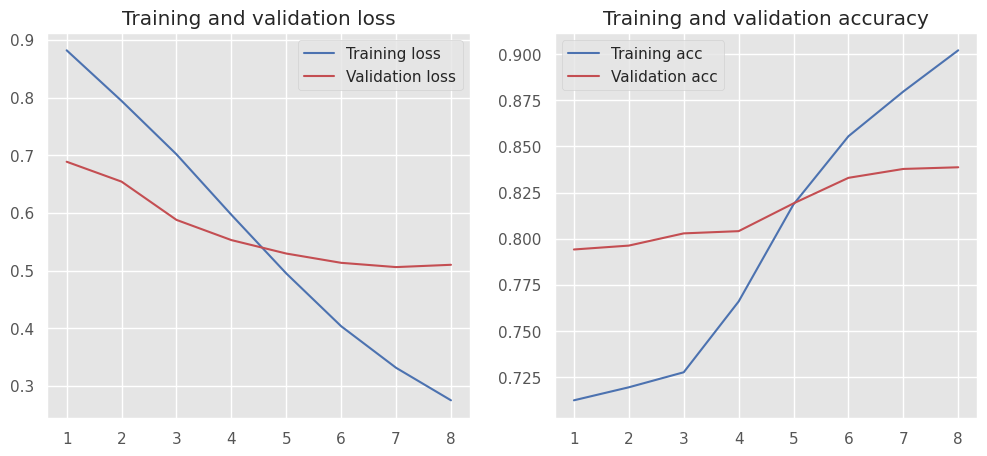

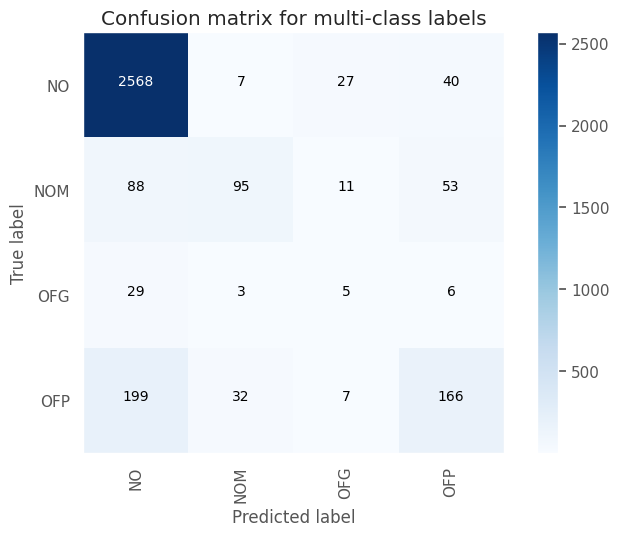

Test Accuracy: 0.8495
Test macro-F1: 0.507


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5841    0.4116    0.4829       447
     no_hate     0.9129    0.9547    0.9333      2889

    accuracy                         0.8819      3336
   macro avg     0.7485    0.6831    0.7081      3336
weighted avg     0.8689    0.8819    0.8730      3336



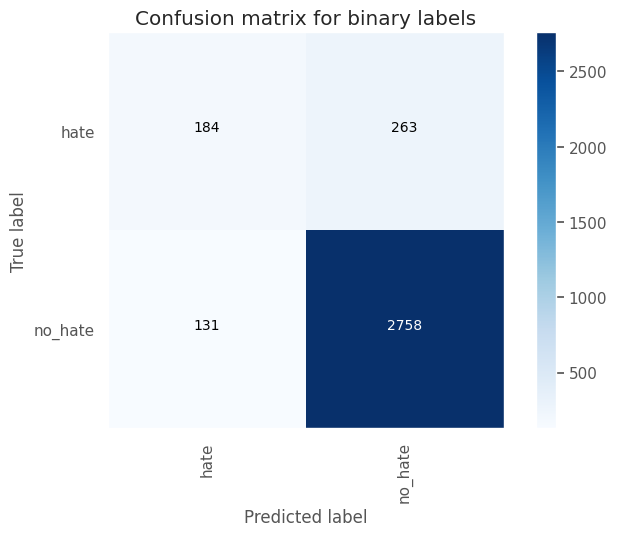

Test Accuracy: 0.8819
Test macro-F1: 0.7081




Training with dense_dim=128 ==============>
Training with learning_rate=0.001 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_27"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_27 (Embedding)        │ (11059, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_27 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_54 (Dense)                │ (11059, 128)           │     1,638,528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_27 (Dropout)            │ (11059, 128)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_55 (Dense)                │ (11059, 4)             │           516 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,139,044 (8.16 MB)

 Trainable params: 2,139,044 (8.16 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - acc: 0.7359 - loss: 0.7969 - val_acc: 0.8354 - val_loss: 0.4838
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - acc: 0.8864 - loss: 0.3167 - val_acc: 0.8477 - val_loss: 0.4894
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - acc: 0.9501 - loss: 0.1369 - val_acc: 0.8447 - val_loss: 0.6293
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9038    0.9459    0.9244      2642
         NOM     0.6793    0.5061    0.5800       247
         OFG     0.1250    0.1860    0.1495        43
         OFP     0.6192    0.4950    0.5502       404

    accuracy                         0.8489      3336
   macro avg     0.5818    0.5333    0.5510      3336
weighted avg     0.8427    0.8489    0.8436      3336



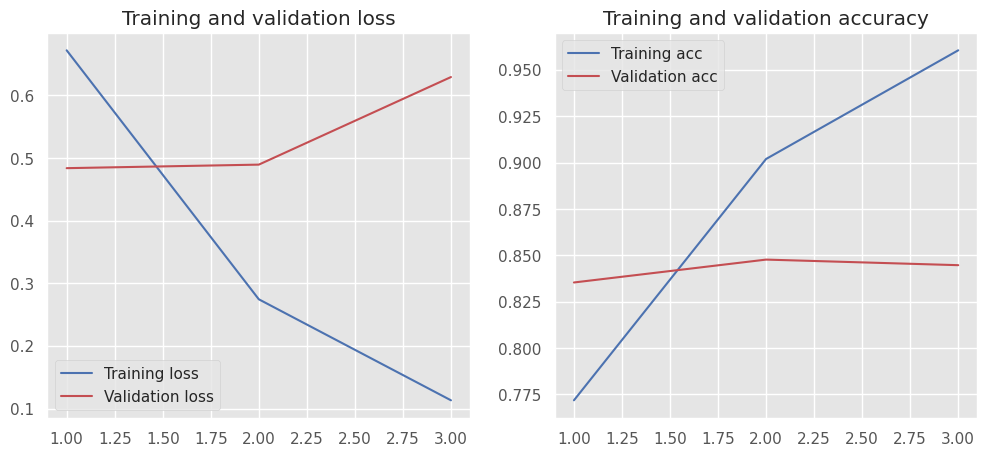

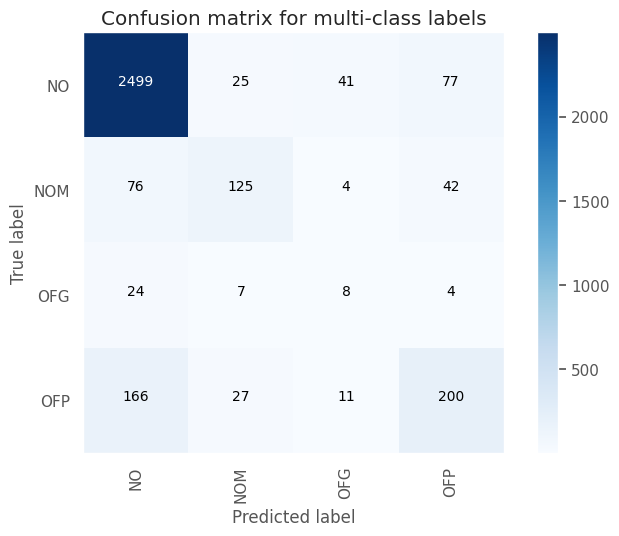

Test Accuracy: 0.8489
Test macro-F1: 0.551


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5762    0.4989    0.5348       447
     no_hate     0.9240    0.9432    0.9335      2889

    accuracy                         0.8837      3336
   macro avg     0.7501    0.7211    0.7342      3336
weighted avg     0.8774    0.8837    0.8801      3336



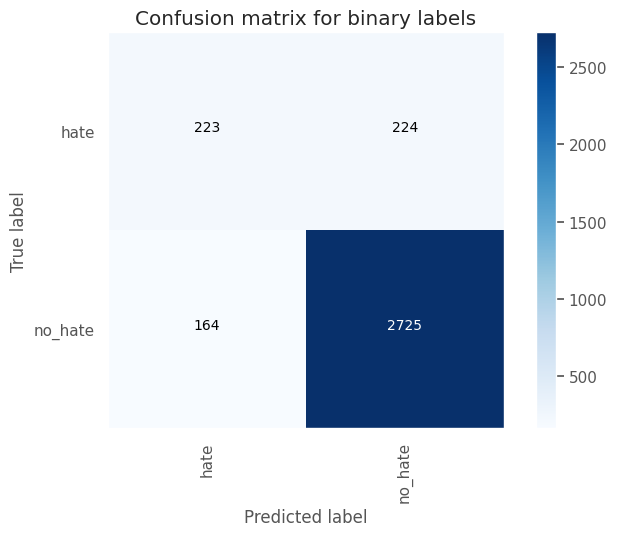

Test Accuracy: 0.8837
Test macro-F1: 0.7342




Training with learning_rate=0.00025 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_28"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_28 (Embedding)        │ (11059, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_28 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_56 (Dense)                │ (11059, 128)           │     1,638,528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_28 (Dropout)            │ (11059, 128)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_57 (Dense)                │ (11059, 4)             │           516 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,139,044 (8.16 MB)

 Trainable params: 2,139,044 (8.16 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - acc: 0.7168 - loss: 0.8753 - val_acc: 0.8017 - val_loss: 0.6370
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - acc: 0.7704 - loss: 0.6368 - val_acc: 0.8264 - val_loss: 0.5154
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - acc: 0.8622 - loss: 0.3900 - val_acc: 0.8381 - val_loss: 0.4896
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - acc: 0.9082 - loss: 0.2591 - val_acc: 0.8477 - val_loss: 0.4971
Epoch 5/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - acc: 0.9422 - loss: 0.1799 - val_acc: 0.8480 - val_loss: 0.5182
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.8936    0.9667    0.9287      2642
         NOM     0.6587    0.5547    0.6022       247
         OFG     0.1351    0.1163    0.1250        43
   

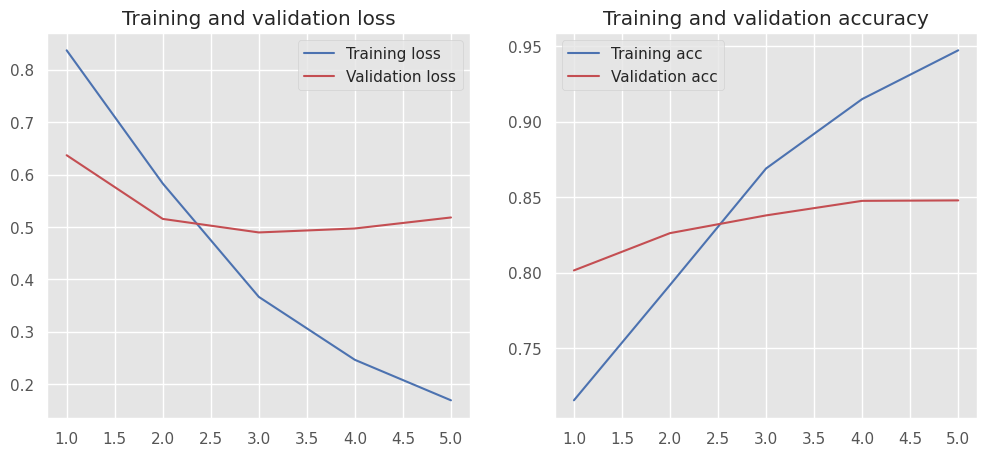

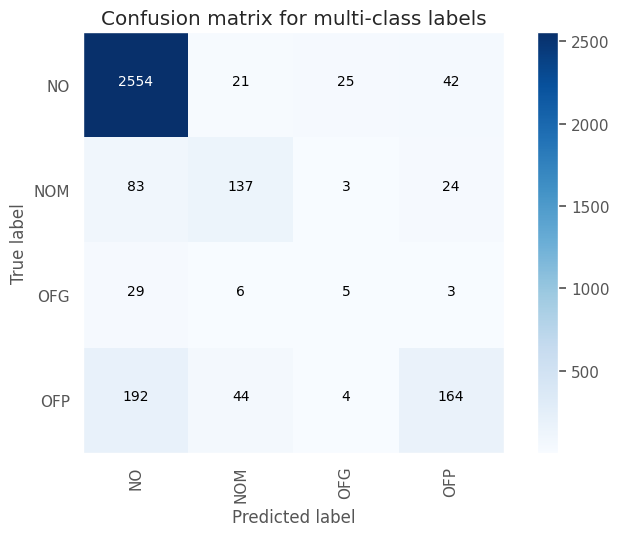

Test Accuracy: 0.8573
Test macro-F1: 0.5427


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6519    0.3937    0.4909       447
     no_hate     0.9116    0.9675    0.9387      2889

    accuracy                         0.8906      3336
   macro avg     0.7817    0.6806    0.7148      3336
weighted avg     0.8768    0.8906    0.8787      3336



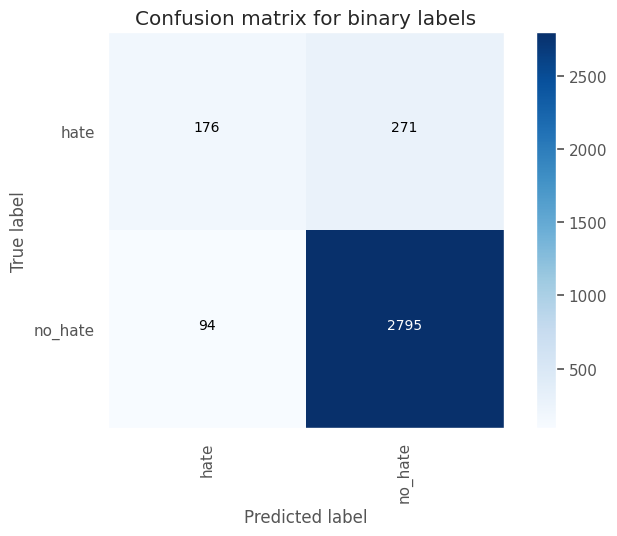

Test Accuracy: 0.8906
Test macro-F1: 0.7148




Training with learning_rate=0.000125 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_29"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_29 (Embedding)        │ (11059, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_29 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_58 (Dense)                │ (11059, 128)           │     1,638,528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_29 (Dropout)            │ (11059, 128)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_59 (Dense)                │ (11059, 4)             │           516 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,139,044 (8.16 MB)

 Trainable params: 2,139,044 (8.16 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 7s 16ms/step - acc: 0.7162 - loss: 0.9045 - val_acc: 0.7948 - val_loss: 0.6769
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - acc: 0.7256 - loss: 0.7741 - val_acc: 0.7966 - val_loss: 0.6286
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - acc: 0.7427 - loss: 0.6508 - val_acc: 0.8134 - val_loss: 0.5642
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - acc: 0.8279 - loss: 0.5018 - val_acc: 0.8264 - val_loss: 0.5110
Epoch 5/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - acc: 0.8667 - loss: 0.3763 - val_acc: 0.8369 - val_loss: 0.4914
Epoch 6/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - acc: 0.8921 - loss: 0.3005 - val_acc: 0.8402 - val_loss: 0.4919
Epoch 7/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - acc: 0.9139 - loss: 0.2396 - val_acc: 0.8474 - val_loss: 0.4967
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

 TEST SET REPORT (MULTI-CLASS) ================

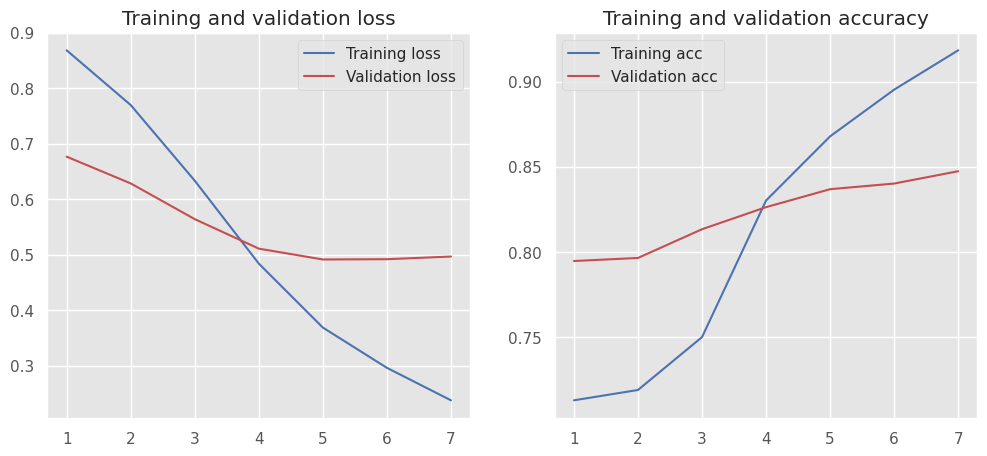

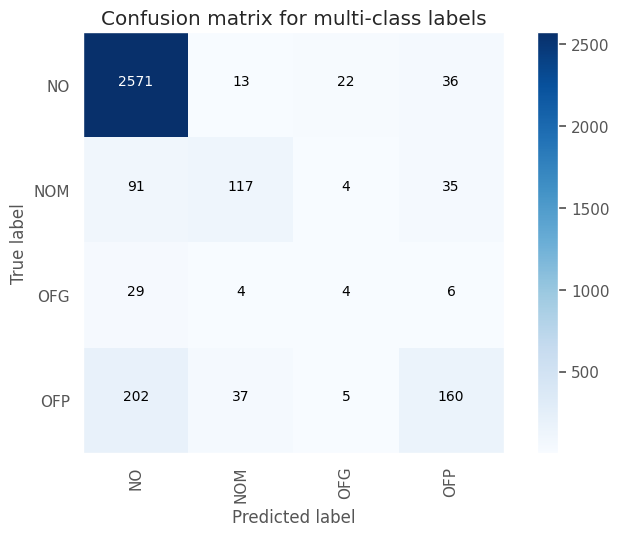

Test Accuracy: 0.8549
Test macro-F1: 0.5226


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6434    0.3915    0.4868       447
     no_hate     0.9112    0.9664    0.9380      2889

    accuracy                         0.8894      3336
   macro avg     0.7773    0.6790    0.7124      3336
weighted avg     0.8753    0.8894    0.8776      3336



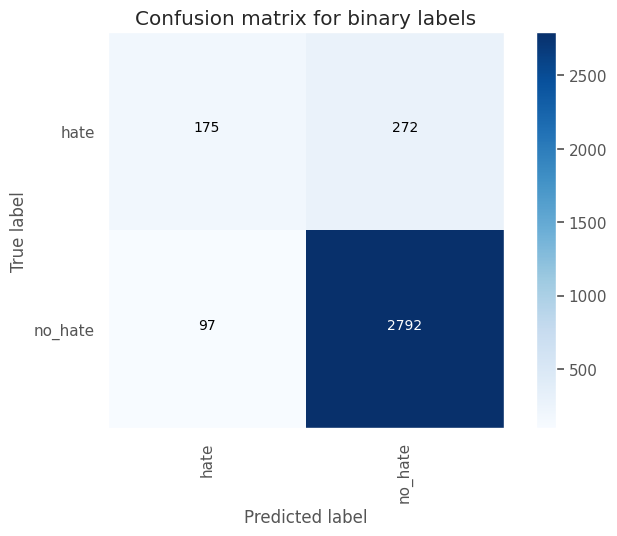

Test Accuracy: 0.8894
Test macro-F1: 0.7124






In [ ]:
vocab_size: int = 5000
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

for dense_dim in [16, 32, 64, 128]:
    print(f"Training with dense_dim={dense_dim} ==============>")
    for lr in [0.001, 0.00025, 0.000125]:
        print(f"Training with learning_rate={lr} ======")
        # Define Keras model
        model = Sequential([
            Embedding(vocab_size, embedding_dim, input_length=max_length),
            Flatten(),
            Dense(dense_dim, activation='relu'),
            Dropout(0.3),
            Dense(4, activation='softmax')
        ])

        # Data
        dataset_folder: str = dataset_v6_folder
        dataset_name: str = "v6"
        data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
        x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], \
            data[
                "x_test"], data["y_test"]

        # Train with our class
        trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                 max_input_length=max_length))
        optim_config: OptimizationConfig = OptimizationConfig(
            epochs=50,
            batch_size=32,
            validation_split=0.0,
            validation_data=(x_val, y_val),
            optimizer=Adam(learning_rate=lr)
        )
        trainer.train(x_train=x_train,
                      y_train=y_train,
                      opt_config=optim_config,
                      callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
        mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
        mc_report: dict
        bc_report: dict

        # Accumulate result so it can be plotted
        result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                        dataset_version=dataset_name,
                                        model_params=model.count_params(),
                                        optim_config=optim_config,
                                        macro_prec_mc=mc_report["macro avg"]["precision"],
                                        macro_recall_mc=mc_report["macro avg"]["recall"],
                                        macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                        macro_prec_bc=bc_report["macro avg"]["precision"],
                                        macro_recall_bc=bc_report["macro avg"]["recall"],
                                        macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                        )
        results_rep.accumulate(result)

In [ ]:
report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)


<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>9</th>
      <td>v6</td>
      <td>{'embedding_27': {'class_name': 'Embedding', 'param_count': 500000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_27': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_54': {'class_name': 'Dense', 'param_count': 1638528, 'input': (11059, 12800), 'output': (11059, 128)}, 'dropout_27': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 128), 'output': (11059, 128)}, 'dense_55': {'class_name': 'Dense', 'param_count': 516, 'input': (11059, 128), 'output': (11059, 4)}}</td>
      <td>2139044</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.001}}</td>
      <td>0.5818</td>
      <td>0.5333</td>
      <td>0.5510</td>
      <td>0.7501</td>
      <td>0.7211</td>
      <td>0.7342</td>
    </tr>
    <tr>
      <th>10</th>
      <td>v6</td>
      <td>{'embedding_28': {'class_name': 'Embedding', 'param_count': 500000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_28': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_56': {'class_name': 'Dense', 'param_count': 1638528, 'input': (11059, 12800), 'output': (11059, 128)}, 'dropout_28': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 128), 'output': (11059, 128)}, 'dense_57': {'class_name': 'Dense', 'param_count': 516, 'input': (11059, 128), 'output': (11059, 4)}}</td>
      <td>2139044</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.00025}}</td>
      <td>0.5978</td>
      <td>0.5109</td>
      <td>0.5427</td>
      <td>0.7817</td>
      <td>0.6806</td>
      <td>0.7148</td>
    </tr>
    <tr>
      <th>6</th>
      <td>v6</td>
      <td>{'embedding_24': {'class_name': 'Embedding', 'param_count': 500000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_24': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_48': {'class_name': 'Dense', 'param_count': 819264, 'input': (11059, 12800), 'output': (11059, 64)}, 'dropout_24': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 64), 'output': (11059, 64)}, 'dense_49': {'class_name': 'Dense', 'param_count': 260, 'input': (11059, 64), 'output': (11059, 4)}}</td>
      <td>1319524</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.001}}</td>
      <td>0.5729</td>
      <td>0.5122</td>
      <td>0.5366</td>
      <td>0.7619</td>
      <td>0.6963</td>
      <td>0.7219</td>
    </tr>
    <tr>
      <th>3</th>
      <td>v6</td>
      <td>{'embedding_21': {'class_name': 'Embedding', 'param_count': 500000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_21': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_42': {'class_name': 'Dense', 'param_count': 409632, 'input': (11059, 12800), 'output': (11059, 32)}, 'dropout_21': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 32), 'output': (11059, 32)}, 'dense_43': {'class_name': 'Dense', 'param_count': 132, 'input': (11059, 32), 'output': (11059, 4)}}</td>
      <td>909764</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.001}}</td>
      <td>0.5795</td>
      <td>0.5061</td>
      <td>0.5362</td>
      <td>0.7627</td>
      <td>0.7023</td>
      <td>0.7265</td>
    </tr>
    <tr>
      <th>4</th>
      <td>v6</td>
      <td>{'embedding_22': {'class_name': 'Embedding', 'param_count': 500000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_22': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_44': {'class_name': 'Dense', 'param_count': 409632, 'input': (11059, 12800), 'output': (11059, 32)}, 'dropout_22': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 32), 'output': (11059, 32)}, 'dense_45': {'class_name': 'Dense', 'param_count': 132, 'input': (11059, 32), 'output': (11059, 4)}}</td>
      <td>909764</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.00025}}</td>
      <td>0.5839</td>
      <td>0.5030</td>
      <td>0.5350</td>
      <td>0.7583</td>
      <td>0.6898</td>
      <td>0.7160</td>
    </tr>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_18': {'class_name': 'Embedding', 'param_count': 500000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_18': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_36': {'class_name': 'Dense', 'param_count': 204816, 'input': (11059, 12800), 'output': (11059, 16)}, 'dropout_18': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 16), 'output': (11059, 16)}, 'dense_37': {'class_name': 'Dense', 'param_count': 68, 'input': (11059, 16), 'output': (11059, 4)}}</td>
      <td>704884</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.001}}</td>
      <td>0.5660</td>
      <td>0.5024</td>
      <td>0.5288</td>
      <td>0.7563</td>
      <td>0.7079</td>
      <td>0.7281</td>
    </tr>
    <tr>
      <th>7</th>
      <td>v6</td>
      <td>{'embedding_25': {'class_name': 'Embedding', 'param_count': 500000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_25': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_50': {'class_name': 'Dense', 'param_count': 819264, 'input': (11059, 12800), 'output': (11059, 64)}, 'dropout_25': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 64), 'output': (11059, 64)}, 'dense_51': {'class_name': 'Dense', 'param_count': 260, 'input': (11059, 64), 'output': (11059, 4)}}</td>
      <td>1319524</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.00025}}</td>
      <td>0.5872</td>
      <td>0.4919</td>
      <td>0.5270</td>
      <td>0.7695</td>
      <td>0.6838</td>
      <td>0.7144</td>
    </tr>
    <tr>
      <th>11</th>
      <td>v6</td>
      <td>{'embedding_29': {'class_name': 'Embedding', 'param_count': 500000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_29': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_58': {'class_name': 'Dense', 'param_count': 1638528, 'input': (11059, 12800), 'output': (11059, 128)}, 'dropout_29': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 128), 'output': (11059, 128)}, 'dense_59': {'class_name': 'Dense', 'param_count': 516, 'input': (11059, 128), 'output': (11059, 4)}}</td>
      <td>2139044</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.000125}}</td>
      <td>0.5906</td>
      <td>0.4840</td>
      <td>0.5226</td>
      <td>0.7773</td>
      <td>0.6790</td>
      <td>0.7124</td>
    </tr>
    <tr>
      <th>8</th>
      <td>v6</td>
      <td>{'embedding_26': {'class_name': 'Embedding', 'param_count': 500000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_26': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_52': {'class_name': 'Dense', 'param_count': 819264, 'input': (11059, 12800), 'output': (11059, 64)}, 'dropout_26': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 64), 'output': (11059, 64)}, 'dense_53': {'class_name': 'Dense', 'param_count': 260, 'input': (11059, 64), 'output': (11059, 4)}}</td>
      <td>1319524</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.000125}}</td>
      <td>0.5776</td>
      <td>0.4709</td>
      <td>0.5070</td>
      <td>0.7485</td>
      <td>0.6831</td>
      <td>0.7081</td>
    </tr>
    <tr>
      <th>5</th>
      <td>v6</td>
      <td>{'embedding_23': {'class_name': 'Embedding', 'param_count': 500000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_23': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_46': {'class_name': 'Dense', 'param_count': 409632, 'input': (11059, 12800), 'output': (11059, 32)}, 'dropout_23': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 32), 'output': (11059, 32)}, 'dense_47': {'class_name': 'Dense', 'param_count': 132, 'input': (11059, 32), 'output': (11059, 4)}}</td>
      <td>909764</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.000125}}</td>
      <td>0.5728</td>
      <td>0.4668</td>
      <td>0.5034</td>
      <td>0.7552</td>
      <td>0.6746</td>
      <td>0.7033</td>
    </tr>
    <tr>
      <th>2</th>
      <td>v6</td>
      <td>{'embedding_20': {'class_name': 'Embedding', 'param_count': 500000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_20': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_40': {'class_name': 'Dense', 'param_count': 204816, 'input': (11059, 12800), 'output': (11059, 16)}, 'dropout_20': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 16), 'output': (11059, 16)}, 'dense_41': {'class_name': 'Dense', 'param_count': 68, 'input': (11059, 16), 'output': (11059, 4)}}</td>
      <td>704884</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.000125}}</td>
      <td>0.5666</td>
      <td>0.4243</td>
      <td>0.4329</td>
      <td>0.7128</td>
      <td>0.6821</td>
      <td>0.6955</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_19': {'class_name': 'Embedding', 'param_count': 500000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_19': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_38': {'class_name': 'Dense', 'param_count': 204816, 'input': (11059, 12800), 'output': (11059, 16)}, 'dropout_19': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 16), 'output': (11059, 16)}, 'dense_39': {'class_name': 'Dense', 'param_count': 68, 'input': (11059, 16), 'output': (11059, 4)}}</td>
      <td>704884</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.00025}}</td>
      <td>0.5988</td>
      <td>0.3848</td>
      <td>0.3699</td>
      <td>0.6963</td>
      <td>0.6831</td>
      <td>0.6893</td>
    </tr>
  </tbody>
</table>
    

Vemos que las arquitecturas más complejas funcionan un poco mejor. Intentaré agrandar aún más esa primera capa de la red.

Training with dense_dim=128 ==============>
Training with learning_rate=0.001 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_30"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_30 (Embedding)        │ (11059, 128, 100)      │     1,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_30 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (11059, 128)           │     1,638,528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_30 (Dropout)            │ (11059, 128)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (11059, 4)             │           516 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,639,044 (10.07 MB)

 Trainable params: 2,639,044 (10.07 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - acc: 0.7373 - loss: 0.7920 - val_acc: 0.8351 - val_loss: 0.4706
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - acc: 0.8969 - loss: 0.2870 - val_acc: 0.8426 - val_loss: 0.5188
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step - acc: 0.9640 - loss: 0.1006 - val_acc: 0.8456 - val_loss: 0.6197
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9043    0.9478    0.9255      2642
         NOM     0.5892    0.5749    0.5820       247
         OFG     0.1250    0.0930    0.1067        43
         OFP     0.6259    0.4554    0.5272       404

    accuracy                         0.8495      3336
   macro avg     0.5611    0.5178    0.5353      3336
weighted avg     0.8372    0.8495    0.8413      3336



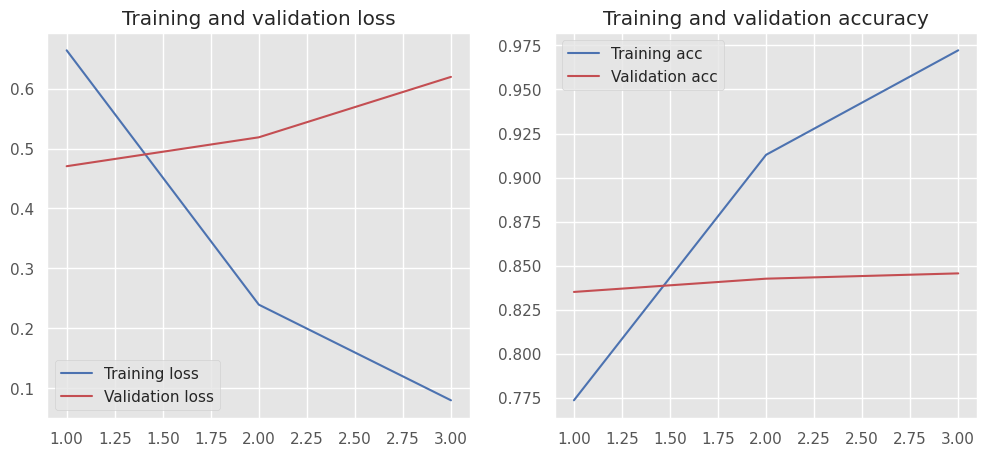

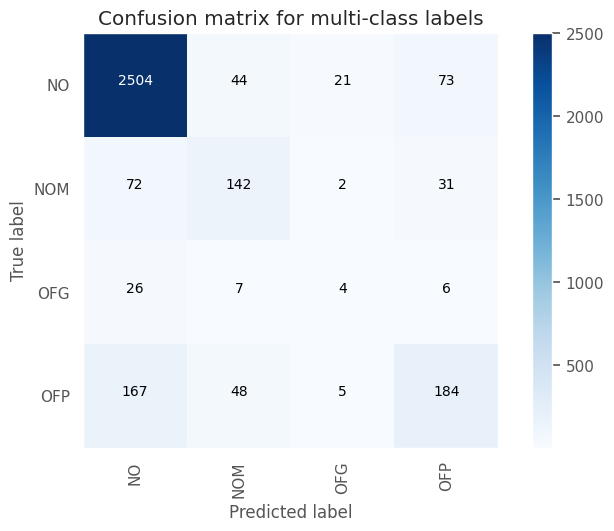

Test Accuracy: 0.8495
Test macro-F1: 0.5353


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6104    0.4452    0.5149       447
     no_hate     0.9176    0.9560    0.9364      2889

    accuracy                         0.8876      3336
   macro avg     0.7640    0.7006    0.7257      3336
weighted avg     0.8764    0.8876    0.8799      3336



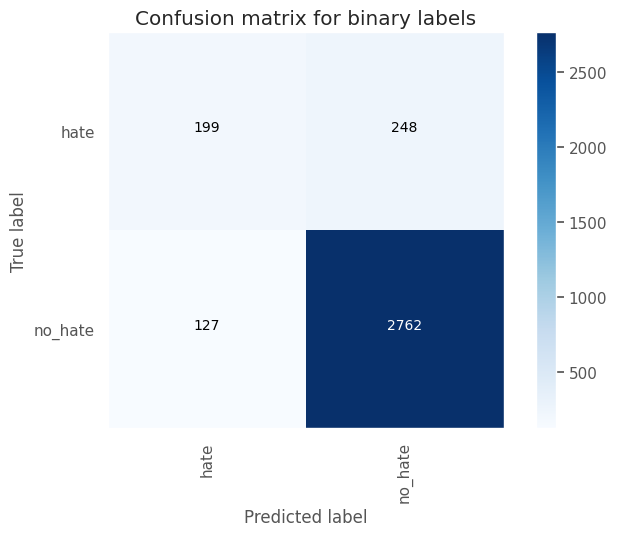

Test Accuracy: 0.8876
Test macro-F1: 0.7257




Training with learning_rate=0.00025 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_31"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_31 (Embedding)        │ (11059, 128, 100)      │     1,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_31 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ (11059, 128)           │     1,638,528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_31 (Dropout)            │ (11059, 128)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_63 (Dense)                │ (11059, 4)             │           516 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,639,044 (10.07 MB)

 Trainable params: 2,639,044 (10.07 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - acc: 0.7168 - loss: 0.8757 - val_acc: 0.7948 - val_loss: 0.6466
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - acc: 0.7512 - loss: 0.6496 - val_acc: 0.8279 - val_loss: 0.5050
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - acc: 0.8747 - loss: 0.3597 - val_acc: 0.8438 - val_loss: 0.4858
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - acc: 0.9324 - loss: 0.2060 - val_acc: 0.8516 - val_loss: 0.4982
Epoch 5/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - acc: 0.9612 - loss: 0.1259 - val_acc: 0.8537 - val_loss: 0.5401
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9016    0.9603    0.9300      2642
         NOM     0.6570    0.5506    0.5991       247
         OFG     0.1154    0.0698    0.0870        43
   

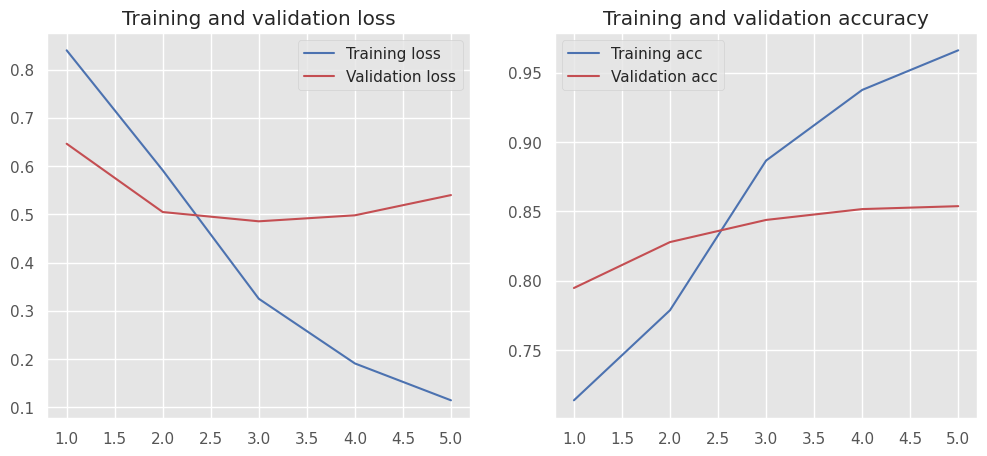

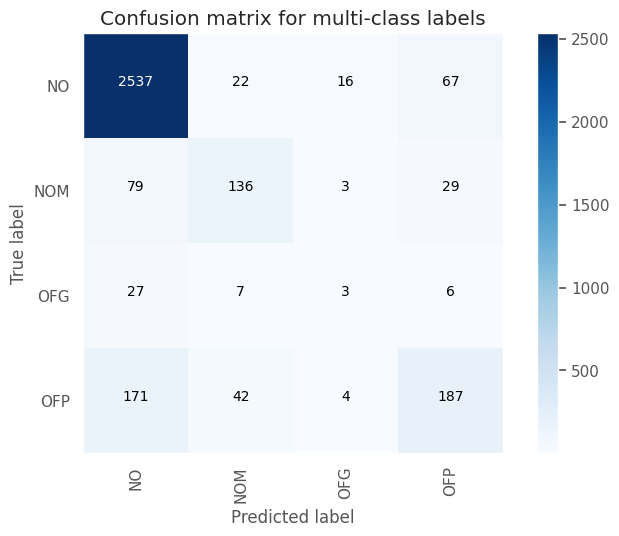

Test Accuracy: 0.8582
Test macro-F1: 0.5389


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6349    0.4474    0.5249       447
     no_hate     0.9182    0.9602    0.9387      2889

    accuracy                         0.8915      3336
   macro avg     0.7766    0.7038    0.7318      3336
weighted avg     0.8803    0.8915    0.8833      3336



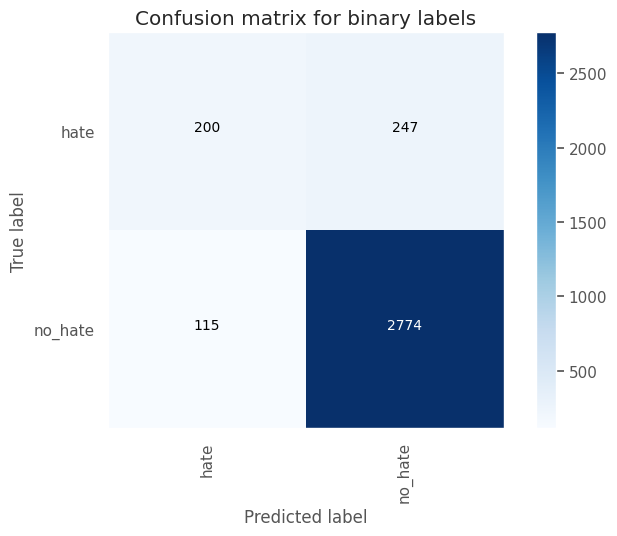

Test Accuracy: 0.8915
Test macro-F1: 0.7318




Training with learning_rate=0.000125 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_32"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_32 (Embedding)        │ (11059, 128, 100)      │     1,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_32 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_64 (Dense)                │ (11059, 128)           │     1,638,528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_32 (Dropout)            │ (11059, 128)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_65 (Dense)                │ (11059, 4)             │           516 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,639,044 (10.07 MB)

 Trainable params: 2,639,044 (10.07 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - acc: 0.7167 - loss: 0.9019 - val_acc: 0.7948 - val_loss: 0.6800
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - acc: 0.7273 - loss: 0.7690 - val_acc: 0.7999 - val_loss: 0.6261
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step - acc: 0.7599 - loss: 0.6362 - val_acc: 0.8206 - val_loss: 0.5400
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step - acc: 0.8473 - loss: 0.4502 - val_acc: 0.8297 - val_loss: 0.4983
Epoch 5/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - acc: 0.8801 - loss: 0.3268 - val_acc: 0.8381 - val_loss: 0.4847
Epoch 6/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - acc: 0.9116 - loss: 0.2508 - val_acc: 0.8411 - val_loss: 0.4888
Epoch 7/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step - acc: 0.9366 - loss: 0.1925 - val_acc: 0.8486 - val_loss: 0.4959
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

 TEST SET REPORT (MULTI-CLASS) ================

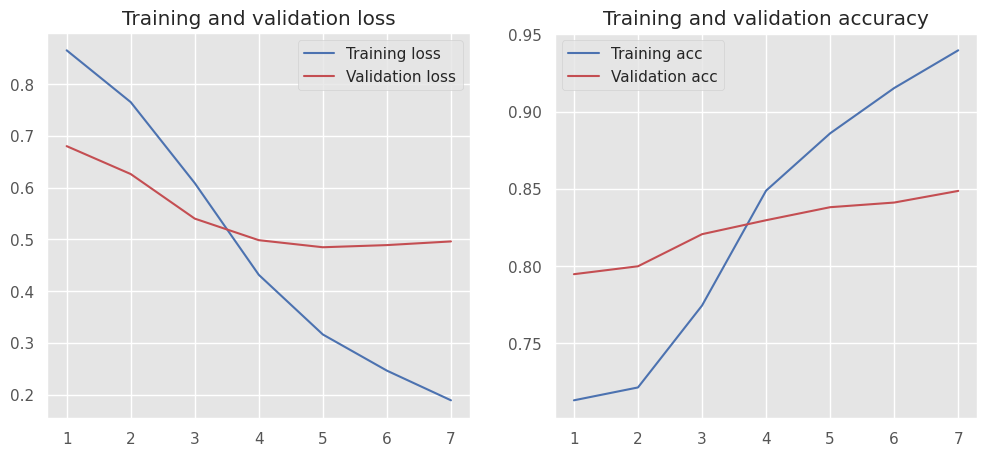

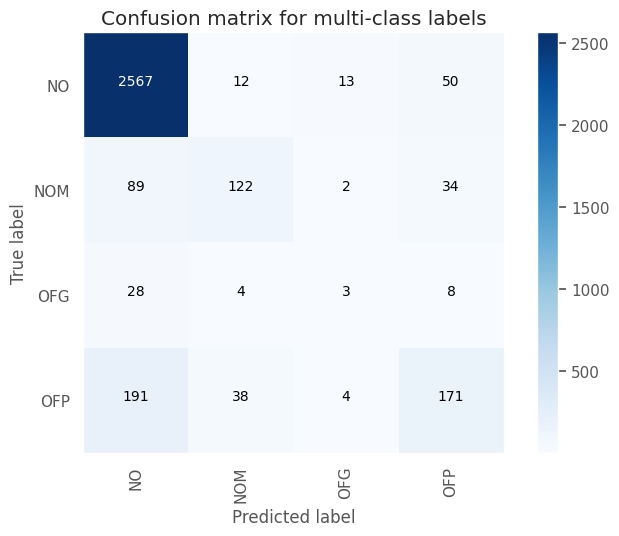

Test Accuracy: 0.8582
Test macro-F1: 0.5281


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6526    0.4161    0.5082       447
     no_hate     0.9145    0.9657    0.9394      2889

    accuracy                         0.8921      3336
   macro avg     0.7835    0.6909    0.7238      3336
weighted avg     0.8794    0.8921    0.8816      3336



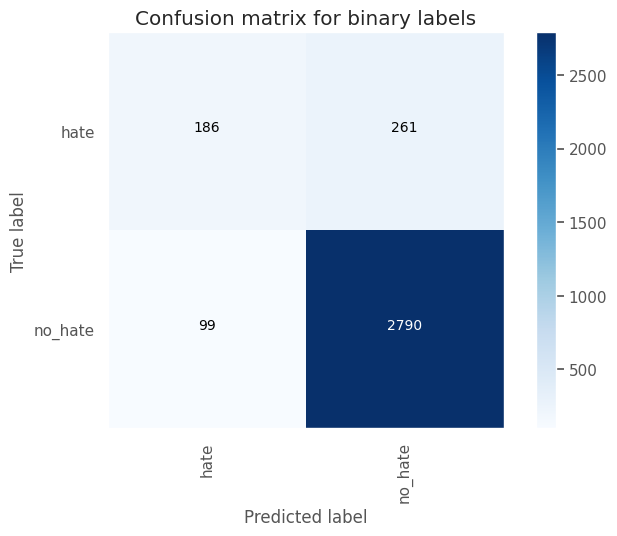

Test Accuracy: 0.8921
Test macro-F1: 0.7238




Training with dense_dim=256 ==============>
Training with learning_rate=0.001 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_33"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_33 (Embedding)        │ (11059, 128, 100)      │     1,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_33 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_66 (Dense)                │ (11059, 256)           │     3,277,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_33 (Dropout)            │ (11059, 256)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_67 (Dense)                │ (11059, 4)             │         1,028 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,278,084 (16.32 MB)

 Trainable params: 4,278,084 (16.32 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - acc: 0.7376 - loss: 0.7915 - val_acc: 0.8324 - val_loss: 0.4684
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 10s 29ms/step - acc: 0.9038 - loss: 0.2720 - val_acc: 0.8423 - val_loss: 0.5160
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 10s 28ms/step - acc: 0.9689 - loss: 0.0844 - val_acc: 0.8480 - val_loss: 0.7289
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.8992    0.9659    0.9314      2642
         NOM     0.6268    0.5304    0.5746       247
         OFG     0.1176    0.0465    0.0667        43
         OFP     0.6581    0.4431    0.5296       404

    accuracy                         0.8585      3336
   macro avg     0.5754    0.4965    0.5256      3336
weighted avg     0.8398    0.8585    0.8452      3336



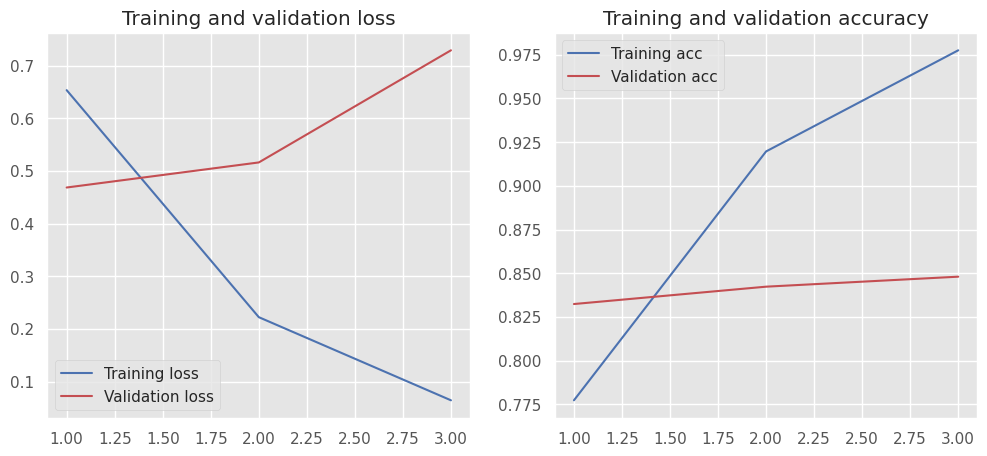

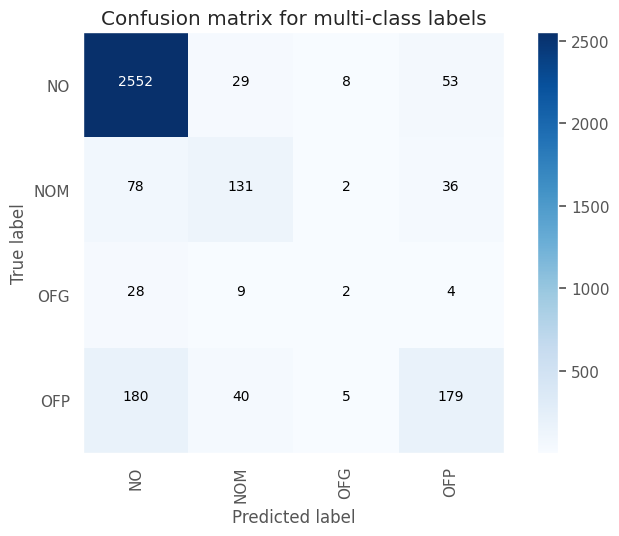

Test Accuracy: 0.8585
Test macro-F1: 0.5256


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6574    0.4251    0.5163       447
     no_hate     0.9157    0.9657    0.9400      2889

    accuracy                         0.8933      3336
   macro avg     0.7865    0.6954    0.7282      3336
weighted avg     0.8811    0.8933    0.8833      3336



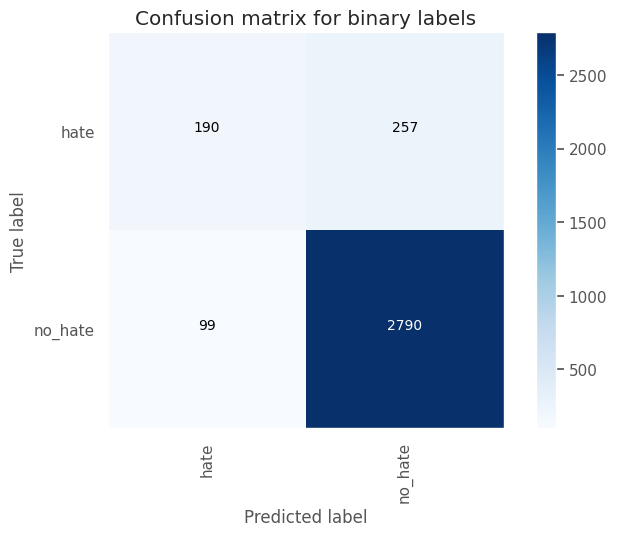

Test Accuracy: 0.8933
Test macro-F1: 0.7282




Training with learning_rate=0.00025 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_34"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_34 (Embedding)        │ (11059, 128, 100)      │     1,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_34 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_68 (Dense)                │ (11059, 256)           │     3,277,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_34 (Dropout)            │ (11059, 256)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_69 (Dense)                │ (11059, 4)             │         1,028 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,278,084 (16.32 MB)

 Trainable params: 4,278,084 (16.32 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - acc: 0.7173 - loss: 0.8646 - val_acc: 0.8035 - val_loss: 0.6012
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - acc: 0.7978 - loss: 0.5743 - val_acc: 0.8363 - val_loss: 0.4872
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 10s 29ms/step - acc: 0.8924 - loss: 0.3007 - val_acc: 0.8459 - val_loss: 0.4896
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 10s 28ms/step - acc: 0.9460 - loss: 0.1660 - val_acc: 0.8456 - val_loss: 0.5194
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.8986    0.9693    0.9326      2642
         NOM     0.6856    0.5385    0.6032       247
         OFG     0.1429    0.0698    0.0938        43
         OFP     0.6900    0.4629    0.5541       404

    accuracy                         0.8645      3336
   macro 

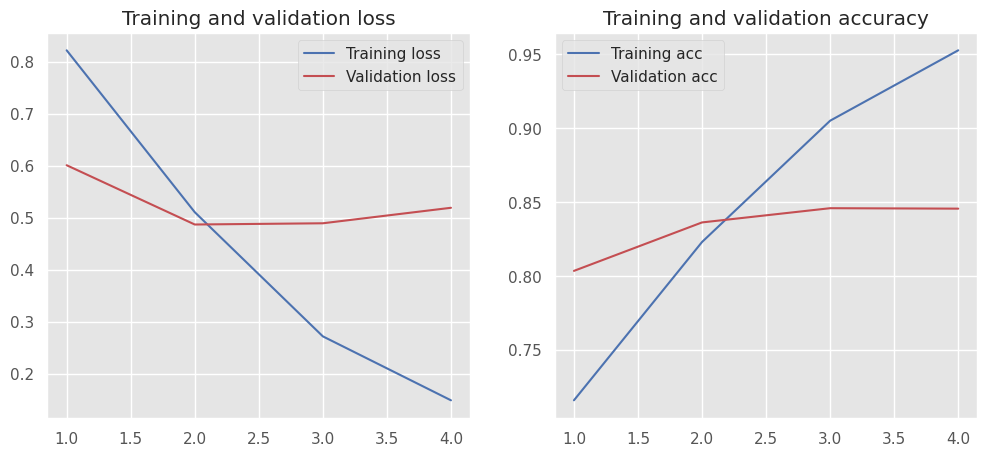

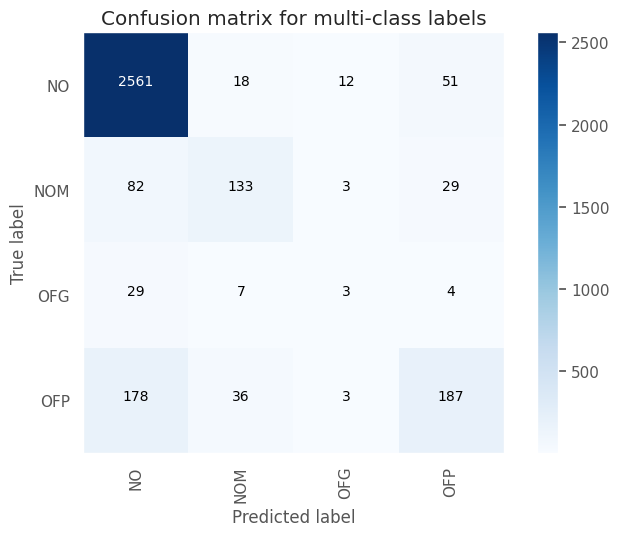

Test Accuracy: 0.8645
Test macro-F1: 0.5459


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6747    0.4407    0.5332       447
     no_hate     0.9179    0.9671    0.9419      2889

    accuracy                         0.8966      3336
   macro avg     0.7963    0.7039    0.7375      3336
weighted avg     0.8853    0.8966    0.8871      3336



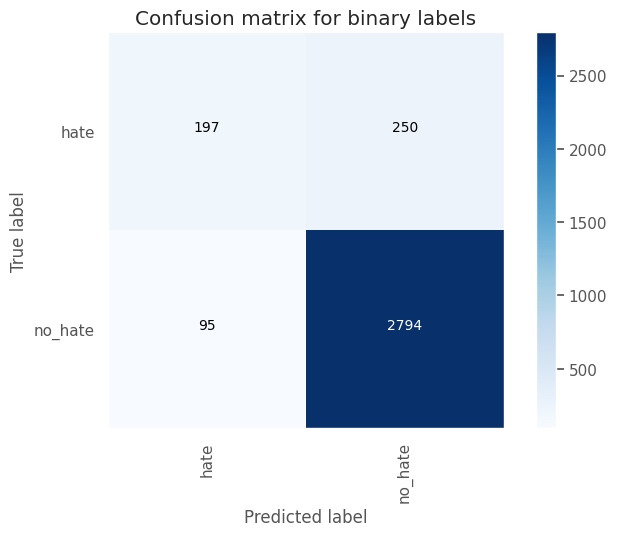

Test Accuracy: 0.8966
Test macro-F1: 0.7375




Training with learning_rate=0.000125 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_35"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_35 (Embedding)        │ (11059, 128, 100)      │     1,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_35 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_70 (Dense)                │ (11059, 256)           │     3,277,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_35 (Dropout)            │ (11059, 256)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_71 (Dense)                │ (11059, 4)             │         1,028 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,278,084 (16.32 MB)

 Trainable params: 4,278,084 (16.32 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - acc: 0.7171 - loss: 0.8872 - val_acc: 0.7948 - val_loss: 0.6602
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - acc: 0.7272 - loss: 0.7491 - val_acc: 0.8032 - val_loss: 0.6000
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 10s 29ms/step - acc: 0.7947 - loss: 0.5760 - val_acc: 0.8240 - val_loss: 0.5226
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 10s 29ms/step - acc: 0.8605 - loss: 0.3927 - val_acc: 0.8363 - val_loss: 0.4895
Epoch 5/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 10s 29ms/step - acc: 0.9021 - loss: 0.2752 - val_acc: 0.8408 - val_loss: 0.4882
Epoch 6/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 10s 29ms/step - acc: 0.9365 - loss: 0.1936 - val_acc: 0.8456 - val_loss: 0.4953
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.8956    0.9705    0.9

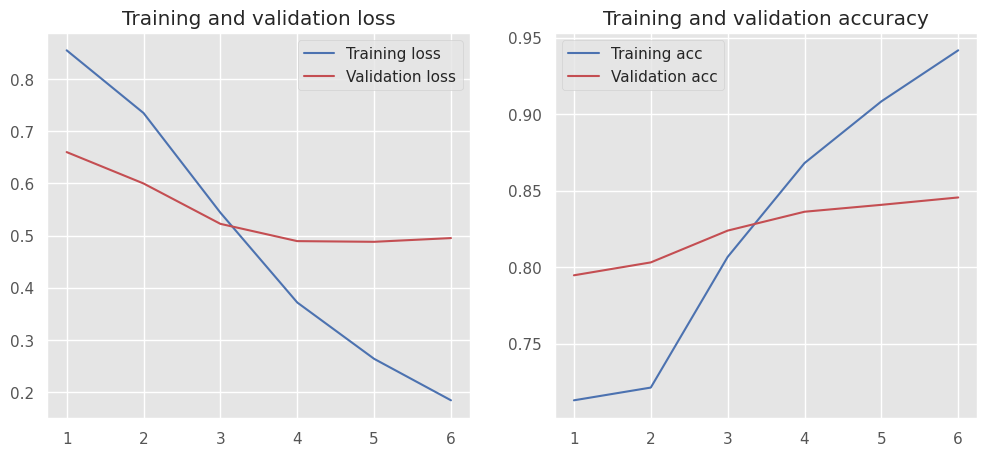

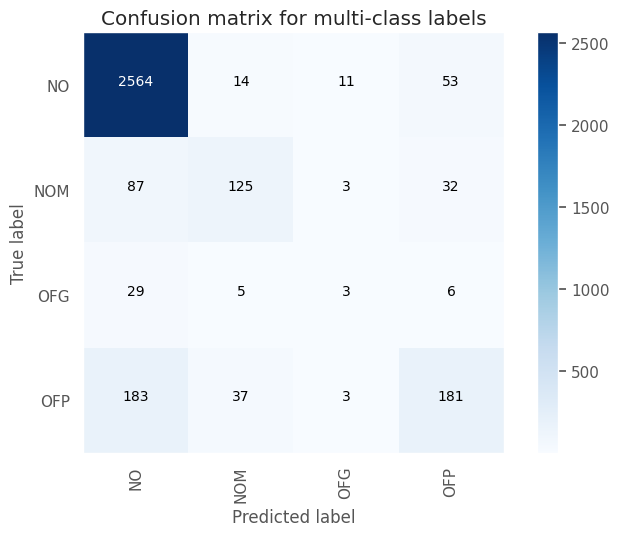

Test Accuracy: 0.8612
Test macro-F1: 0.5366


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6610    0.4318    0.5223       447
     no_hate     0.9166    0.9657    0.9405      2889

    accuracy                         0.8942      3336
   macro avg     0.7888    0.6987    0.7314      3336
weighted avg     0.8823    0.8942    0.8845      3336



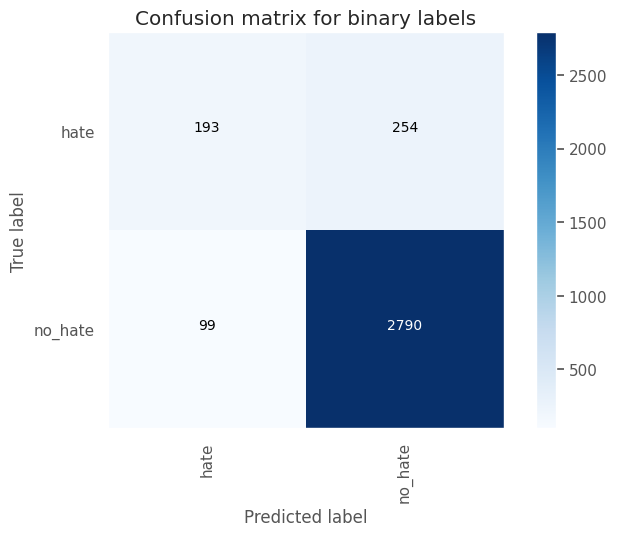

Test Accuracy: 0.8942
Test macro-F1: 0.7314




Training with dense_dim=512 ==============>
Training with learning_rate=0.001 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_36"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_36 (Embedding)        │ (11059, 128, 100)      │     1,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_36 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_72 (Dense)                │ (11059, 512)           │     6,554,112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_36 (Dropout)            │ (11059, 512)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_73 (Dense)                │ (11059, 4)             │         2,052 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,556,164 (28.82 MB)

 Trainable params: 7,556,164 (28.82 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 19s 51ms/step - acc: 0.7413 - loss: 0.7699 - val_acc: 0.8315 - val_loss: 0.4685
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 18s 52ms/step - acc: 0.9112 - loss: 0.2470 - val_acc: 0.8408 - val_loss: 0.5339
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 17s 49ms/step - acc: 0.9753 - loss: 0.0705 - val_acc: 0.8447 - val_loss: 0.7131
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9010    0.9546    0.9270      2642
         NOM     0.6027    0.5344    0.5665       247
         OFG     0.0714    0.0465    0.0563        43
         OFP     0.6414    0.4604    0.5360       404

    accuracy                         0.8519      3336
   macro avg     0.5541    0.4990    0.5215      3336
weighted avg     0.8368    0.8519    0.8418      3336



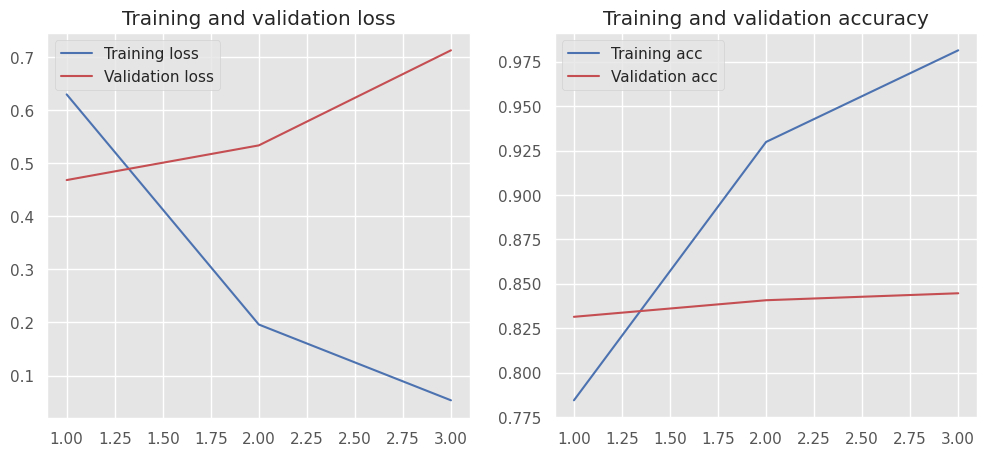

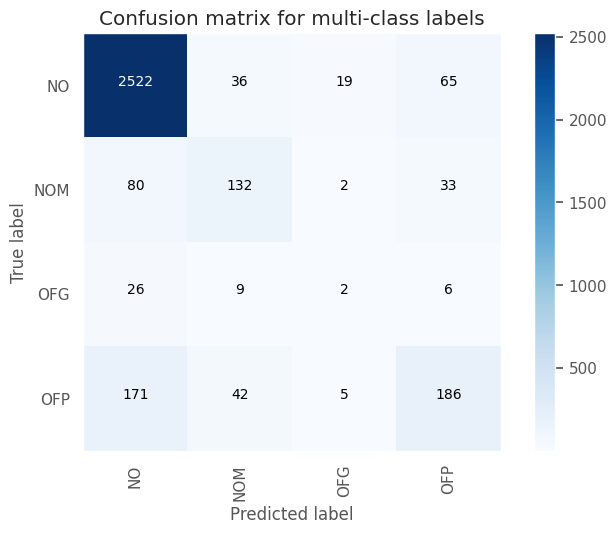

Test Accuracy: 0.8519
Test macro-F1: 0.5215


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6258    0.4452    0.5203       447
     no_hate     0.9178    0.9588    0.9379      2889

    accuracy                         0.8900      3336
   macro avg     0.7718    0.7020    0.7291      3336
weighted avg     0.8787    0.8900    0.8819      3336



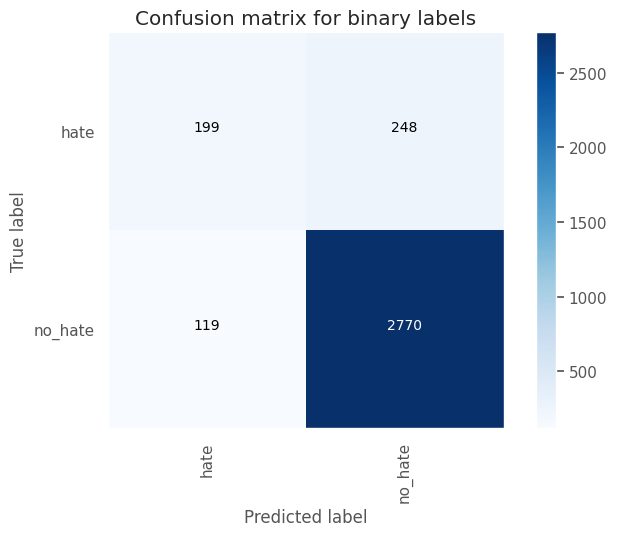

Test Accuracy: 0.89
Test macro-F1: 0.7291




Training with learning_rate=0.00025 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_37"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_37 (Embedding)        │ (11059, 128, 100)      │     1,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_37 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_74 (Dense)                │ (11059, 512)           │     6,554,112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_37 (Dropout)            │ (11059, 512)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_75 (Dense)                │ (11059, 4)             │         2,052 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,556,164 (28.82 MB)

 Trainable params: 7,556,164 (28.82 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 20s 52ms/step - acc: 0.7149 - loss: 0.8568 - val_acc: 0.8077 - val_loss: 0.5952
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 18s 52ms/step - acc: 0.8174 - loss: 0.5272 - val_acc: 0.8414 - val_loss: 0.4747
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 19s 55ms/step - acc: 0.9120 - loss: 0.2527 - val_acc: 0.8459 - val_loss: 0.5052
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 17s 49ms/step - acc: 0.9609 - loss: 0.1261 - val_acc: 0.8513 - val_loss: 0.5464
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.8989    0.9629    0.9298      2642
         NOM     0.6505    0.5425    0.5916       247
         OFG     0.1250    0.0698    0.0896        43
         OFP     0.6848    0.4678    0.5559       404

    accuracy                         0.8603      3336
   macro 

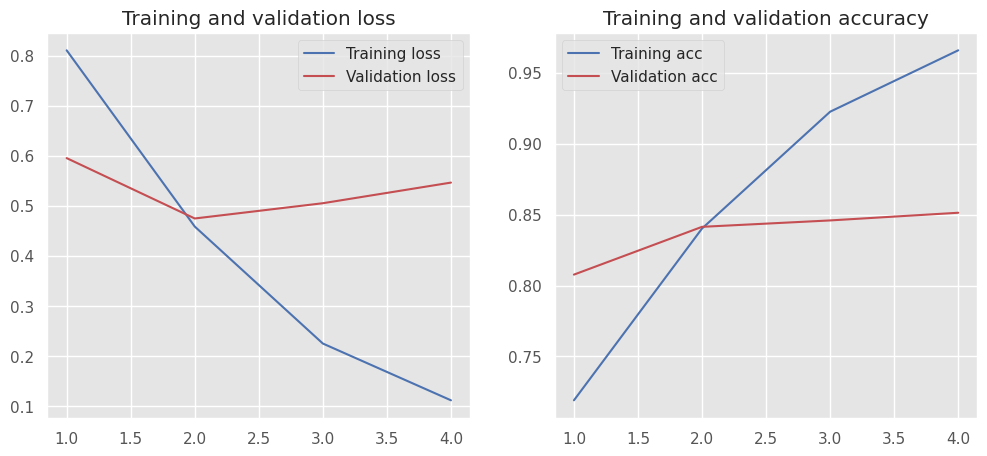

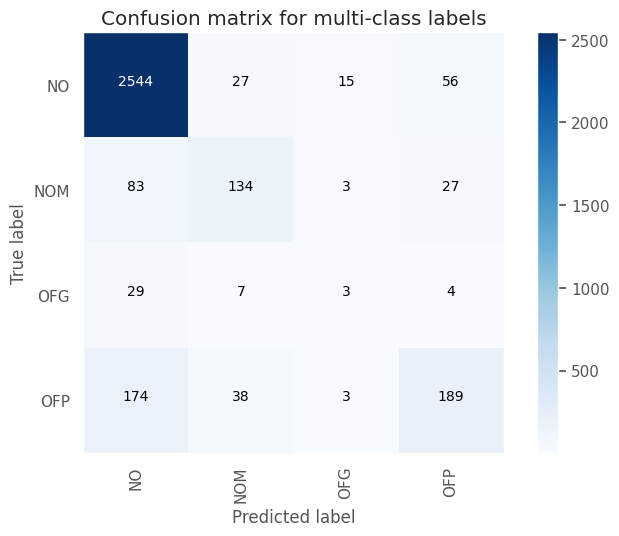

Test Accuracy: 0.8603
Test macro-F1: 0.5417


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6633    0.4452    0.5328       447
     no_hate     0.9183    0.9650    0.9411      2889

    accuracy                         0.8954      3336
   macro avg     0.7908    0.7051    0.7369      3336
weighted avg     0.8841    0.8954    0.8864      3336



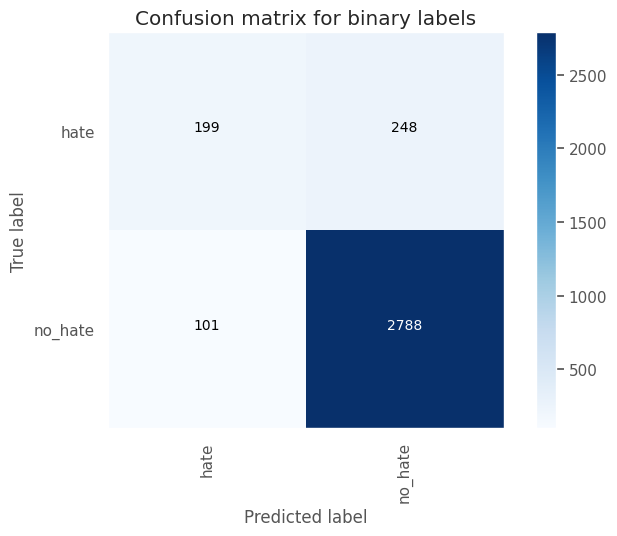

Test Accuracy: 0.8954
Test macro-F1: 0.7369




Training with learning_rate=0.000125 ======
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_38"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_38 (Embedding)        │ (11059, 128, 100)      │     1,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_38 (Flatten)            │ (11059, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_76 (Dense)                │ (11059, 512)           │     6,554,112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_38 (Dropout)            │ (11059, 512)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_77 (Dense)                │ (11059, 4)             │         2,052 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,556,164 (28.82 MB)

 Trainable params: 7,556,164 (28.82 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 19s 52ms/step - acc: 0.7139 - loss: 0.8760 - val_acc: 0.7951 - val_loss: 0.6541
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 18s 51ms/step - acc: 0.7349 - loss: 0.7327 - val_acc: 0.8125 - val_loss: 0.5758
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 17s 48ms/step - acc: 0.8300 - loss: 0.5001 - val_acc: 0.8342 - val_loss: 0.4949
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 17s 49ms/step - acc: 0.8866 - loss: 0.3134 - val_acc: 0.8390 - val_loss: 0.4827
Epoch 5/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 16s 47ms/step - acc: 0.9284 - loss: 0.2126 - val_acc: 0.8471 - val_loss: 0.4965
Epoch 6/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 16s 46ms/step - acc: 0.9571 - loss: 0.1425 - val_acc: 0.8501 - val_loss: 0.5145
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.8944    0.9682    0.9

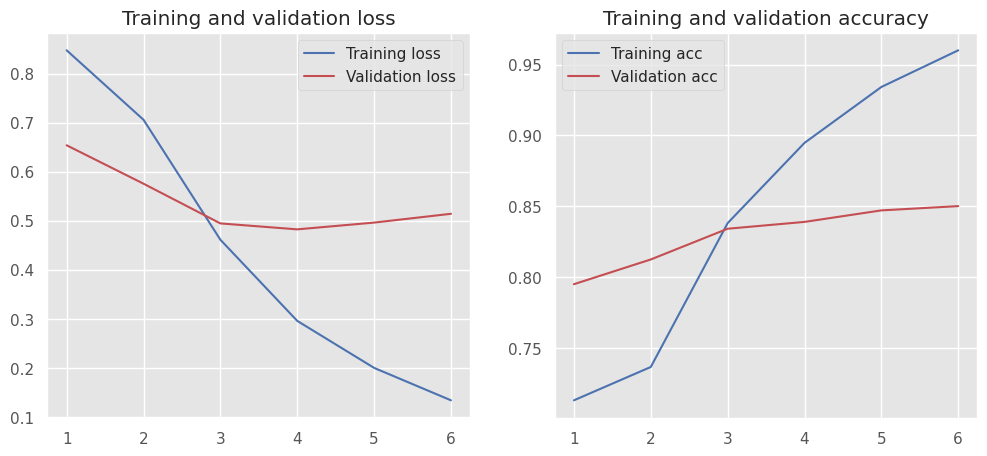

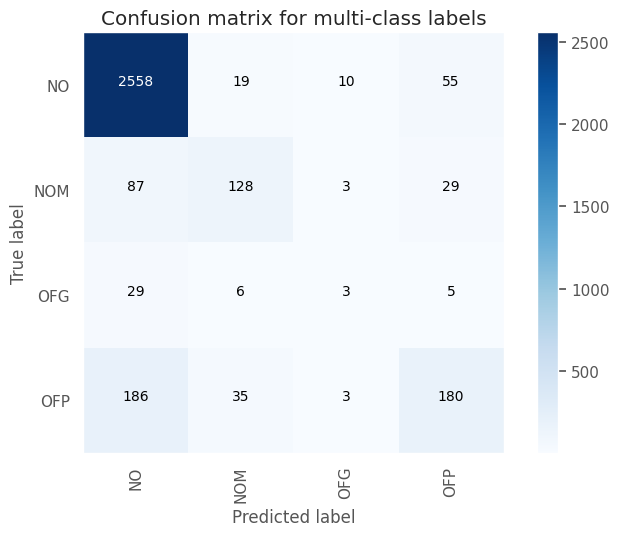

Test Accuracy: 0.86
Test macro-F1: 0.5375


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6632    0.4273    0.5197       447
     no_hate     0.9160    0.9664    0.9405      2889

    accuracy                         0.8942      3336
   macro avg     0.7896    0.6969    0.7301      3336
weighted avg     0.8821    0.8942    0.8842      3336



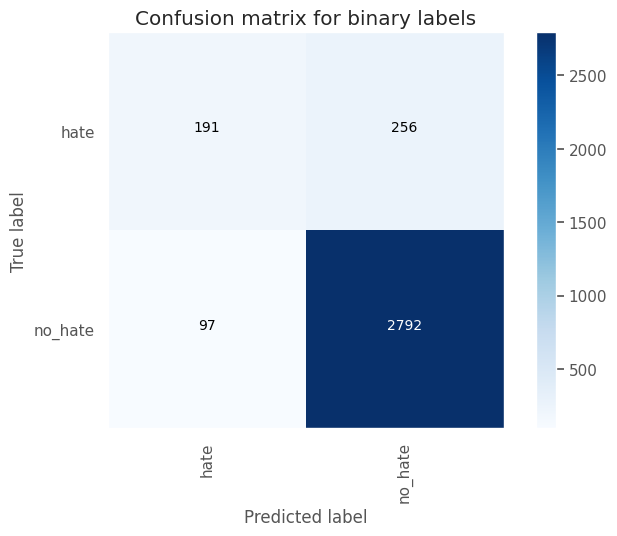

Test Accuracy: 0.8942
Test macro-F1: 0.7301






In [ ]:
vocab_size: int = 10000
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

for dense_dim in [128, 256, 512]:
    print(f"Training with dense_dim={dense_dim} ==============>")
    for lr in [0.001, 0.00025, 0.000125]:
        print(f"Training with learning_rate={lr} ======")
        # Define Keras model
        model = Sequential([
            Embedding(vocab_size, embedding_dim, input_length=max_length),
            Flatten(),
            Dense(dense_dim, activation='relu'),
            Dropout(0.3),
            Dense(4, activation='softmax')
        ])

        # Data
        dataset_folder: str = dataset_v6_folder
        dataset_name: str = "v6"
        data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
        x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], \
            data[
                "x_test"], data["y_test"]

        # Train with our class
        trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                 max_input_length=max_length))
        optim_config: OptimizationConfig = OptimizationConfig(
            epochs=50,
            batch_size=32,
            validation_split=0.0,
            validation_data=(x_val, y_val),
            optimizer=Adam(learning_rate=lr)
        )
        trainer.train(x_train=x_train,
                      y_train=y_train,
                      opt_config=optim_config,
                      callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
        mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
        mc_report: dict
        bc_report: dict

        # Accumulate result so it can be plotted
        result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                        dataset_version=dataset_name,
                                        model_params=model.count_params(),
                                        optim_config=optim_config,
                                        macro_prec_mc=mc_report["macro avg"]["precision"],
                                        macro_recall_mc=mc_report["macro avg"]["recall"],
                                        macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                        macro_prec_bc=bc_report["macro avg"]["precision"],
                                        macro_recall_bc=bc_report["macro avg"]["recall"],
                                        macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                        )
        results_rep.accumulate(result)

In [ ]:
report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)


<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>4</th>
      <td>v6</td>
      <td>{'embedding_34': {'class_name': 'Embedding', 'param_count': 1000000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_34': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_68': {'class_name': 'Dense', 'param_count': 3277056, 'input': (11059, 12800), 'output': (11059, 256)}, 'dropout_34': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 256), 'output': (11059, 256)}, 'dense_69': {'class_name': 'Dense', 'param_count': 1028, 'input': (11059, 256), 'output': (11059, 4)}}</td>
      <td>4278084</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.00025}}</td>
      <td>0.6043</td>
      <td>0.5101</td>
      <td>0.5459</td>
      <td>0.7963</td>
      <td>0.7039</td>
      <td>0.7375</td>
    </tr>
    <tr>
      <th>7</th>
      <td>v6</td>
      <td>{'embedding_37': {'class_name': 'Embedding', 'param_count': 1000000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_37': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_74': {'class_name': 'Dense', 'param_count': 6554112, 'input': (11059, 12800), 'output': (11059, 512)}, 'dropout_37': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 512), 'output': (11059, 512)}, 'dense_75': {'class_name': 'Dense', 'param_count': 2052, 'input': (11059, 512), 'output': (11059, 4)}}</td>
      <td>7556164</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.00025}}</td>
      <td>0.5898</td>
      <td>0.5108</td>
      <td>0.5417</td>
      <td>0.7908</td>
      <td>0.7051</td>
      <td>0.7369</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_31': {'class_name': 'Embedding', 'param_count': 1000000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_31': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_62': {'class_name': 'Dense', 'param_count': 1638528, 'input': (11059, 12800), 'output': (11059, 128)}, 'dropout_31': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 128), 'output': (11059, 128)}, 'dense_63': {'class_name': 'Dense', 'param_count': 516, 'input': (11059, 128), 'output': (11059, 4)}}</td>
      <td>2639044</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.00025}}</td>
      <td>0.5803</td>
      <td>0.5109</td>
      <td>0.5389</td>
      <td>0.7766</td>
      <td>0.7038</td>
      <td>0.7318</td>
    </tr>
    <tr>
      <th>8</th>
      <td>v6</td>
      <td>{'embedding_38': {'class_name': 'Embedding', 'param_count': 1000000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_38': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_76': {'class_name': 'Dense', 'param_count': 6554112, 'input': (11059, 12800), 'output': (11059, 512)}, 'dropout_38': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 512), 'output': (11059, 512)}, 'dense_77': {'class_name': 'Dense', 'param_count': 2052, 'input': (11059, 512), 'output': (11059, 4)}}</td>
      <td>7556164</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.000125}}</td>
      <td>0.6006</td>
      <td>0.5004</td>
      <td>0.5375</td>
      <td>0.7896</td>
      <td>0.6969</td>
      <td>0.7301</td>
    </tr>
    <tr>
      <th>5</th>
      <td>v6</td>
      <td>{'embedding_35': {'class_name': 'Embedding', 'param_count': 1000000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_35': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_70': {'class_name': 'Dense', 'param_count': 3277056, 'input': (11059, 12800), 'output': (11059, 256)}, 'dropout_35': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 256), 'output': (11059, 256)}, 'dense_71': {'class_name': 'Dense', 'param_count': 1028, 'input': (11059, 256), 'output': (11059, 4)}}</td>
      <td>4278084</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.000125}}</td>
      <td>0.6004</td>
      <td>0.4986</td>
      <td>0.5366</td>
      <td>0.7888</td>
      <td>0.6987</td>
      <td>0.7314</td>
    </tr>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_30': {'class_name': 'Embedding', 'param_count': 1000000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_30': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_60': {'class_name': 'Dense', 'param_count': 1638528, 'input': (11059, 12800), 'output': (11059, 128)}, 'dropout_30': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 128), 'output': (11059, 128)}, 'dense_61': {'class_name': 'Dense', 'param_count': 516, 'input': (11059, 128), 'output': (11059, 4)}}</td>
      <td>2639044</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.001}}</td>
      <td>0.5611</td>
      <td>0.5178</td>
      <td>0.5353</td>
      <td>0.7640</td>
      <td>0.7006</td>
      <td>0.7257</td>
    </tr>
    <tr>
      <th>2</th>
      <td>v6</td>
      <td>{'embedding_32': {'class_name': 'Embedding', 'param_count': 1000000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_32': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_64': {'class_name': 'Dense', 'param_count': 1638528, 'input': (11059, 12800), 'output': (11059, 128)}, 'dropout_32': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 128), 'output': (11059, 128)}, 'dense_65': {'class_name': 'Dense', 'param_count': 516, 'input': (11059, 128), 'output': (11059, 4)}}</td>
      <td>2639044</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.000125}}</td>
      <td>0.5932</td>
      <td>0.4896</td>
      <td>0.5281</td>
      <td>0.7835</td>
      <td>0.6909</td>
      <td>0.7238</td>
    </tr>
    <tr>
      <th>3</th>
      <td>v6</td>
      <td>{'embedding_33': {'class_name': 'Embedding', 'param_count': 1000000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_33': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_66': {'class_name': 'Dense', 'param_count': 3277056, 'input': (11059, 12800), 'output': (11059, 256)}, 'dropout_33': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 256), 'output': (11059, 256)}, 'dense_67': {'class_name': 'Dense', 'param_count': 1028, 'input': (11059, 256), 'output': (11059, 4)}}</td>
      <td>4278084</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.001}}</td>
      <td>0.5754</td>
      <td>0.4965</td>
      <td>0.5256</td>
      <td>0.7865</td>
      <td>0.6954</td>
      <td>0.7282</td>
    </tr>
    <tr>
      <th>6</th>
      <td>v6</td>
      <td>{'embedding_36': {'class_name': 'Embedding', 'param_count': 1000000, 'input': (11059, 128), 'output': (11059, 128, 100)}, 'flatten_36': {'class_name': 'Flatten', 'param_count': 0, 'input': (11059, 128, 100), 'output': (11059, 12800)}, 'dense_72': {'class_name': 'Dense', 'param_count': 6554112, 'input': (11059, 12800), 'output': (11059, 512)}, 'dropout_36': {'class_name': 'Dropout', 'param_count': 0, 'input': (11059, 512), 'output': (11059, 512)}, 'dense_73': {'class_name': 'Dense', 'param_count': 2052, 'input': (11059, 512), 'output': (11059, 4)}}</td>
      <td>7556164</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.001}}</td>
      <td>0.5541</td>
      <td>0.4990</td>
      <td>0.5215</td>
      <td>0.7718</td>
      <td>0.7020</td>
      <td>0.7291</td>
    </tr>
  </tbody>
</table>
    

Los resultados son similares al entrenamiento anterior, pero seguimos teniendo el mismo inconveniente de que en general no logramos entrenar por una gran cantidad de epochs.

Algo que podemos comprobar rápidamente y que no hemos modificado mucho es la utilizaciónd e Dropout luego de la Embedding layer, así como variar un poco el dropout que tenemos luego de la Dense previa a la cabeza de clasificación.

Lo exploraremos rápidamente a continuación:



Training with dense_dim=128 ==============>
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 128, 100)          1000100   
                                                                 
 dropout (Dropout)           (None, 128, 100)          0         
                                                                 
 flatten (Flatten)           (None, 12800)             0         
                                                                 
 dense (Dense)               (None, 128)               1638528   
                                                                 
 dropout_1 (Dropout)         (None, 

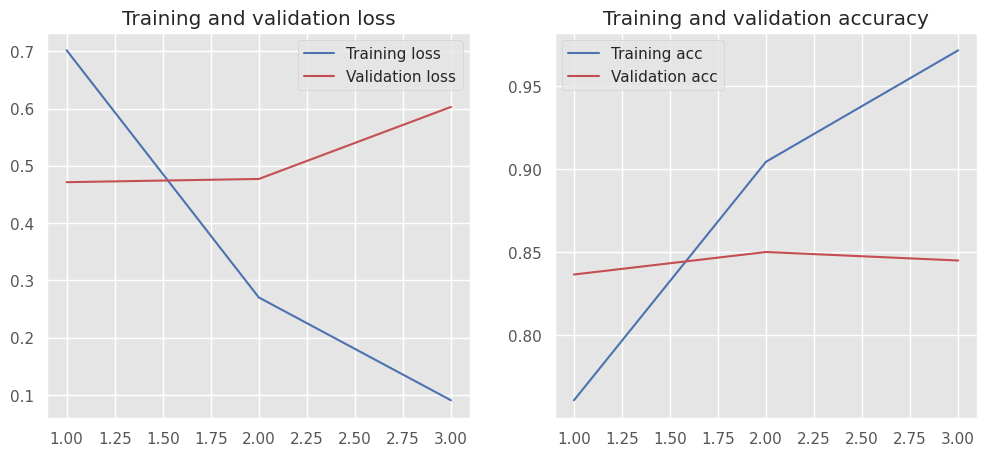

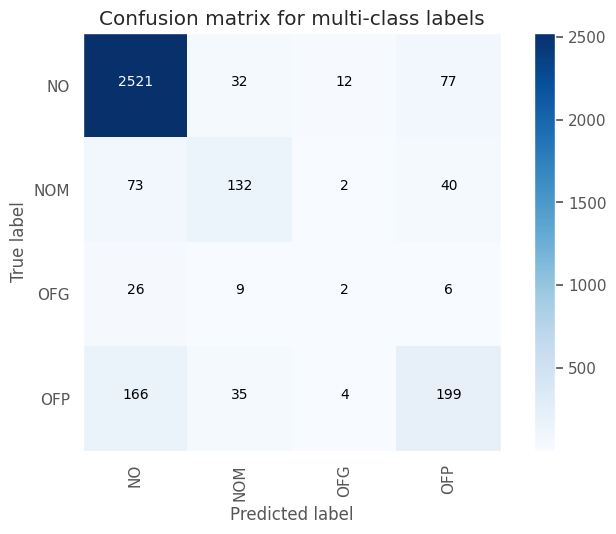

Test Accuracy: 0.8555
Test macro-F1: 0.5302


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6170    0.4720    0.5349       447
     no_hate     0.9212    0.9547    0.9376      2889

    accuracy                         0.8900      3336
   macro avg     0.7691    0.7133    0.7362      3336
weighted avg     0.8804    0.8900    0.8836      3336



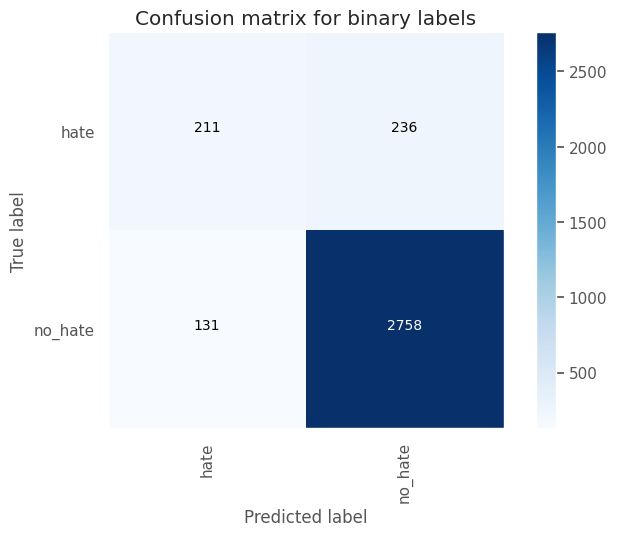

Test Accuracy: 0.89
Test macro-F1: 0.7362




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     (None, 128, 100)          1000100   
                                                                 
 dropout_2 (Dropout)         (None, 128, 100)          0         
                                                                 
 flatten_1 (Flatten)         (None, 12800)             0         
                                                                 
 dense_2 (Dense)             (None, 128)               1638528   
                                                                 
 dropout_3 (Dropout)         (No

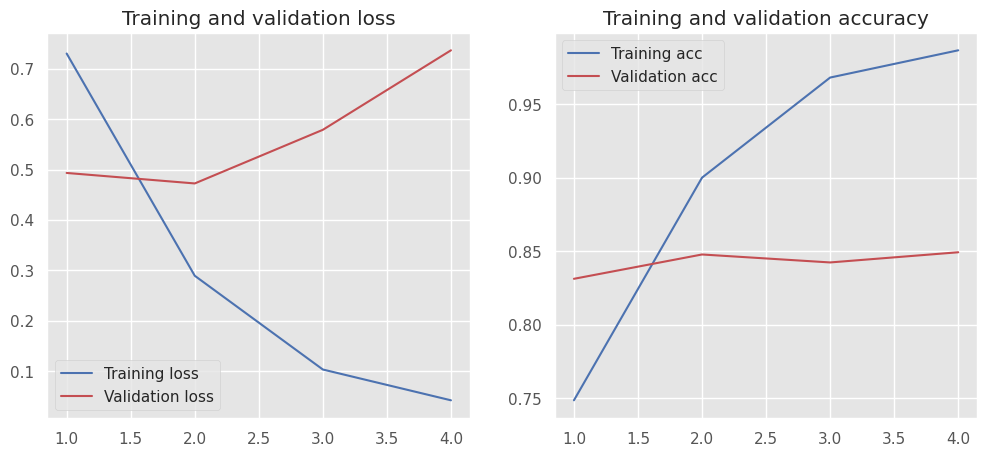

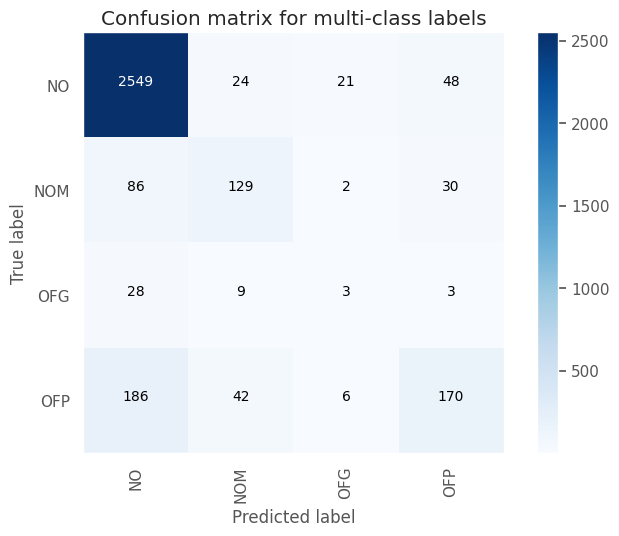

Test Accuracy: 0.8546
Test macro-F1: 0.5249


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6431    0.4072    0.4986       447
     no_hate     0.9132    0.9650    0.9384      2889

    accuracy                         0.8903      3336
   macro avg     0.7782    0.6861    0.7185      3336
weighted avg     0.8770    0.8903    0.8795      3336



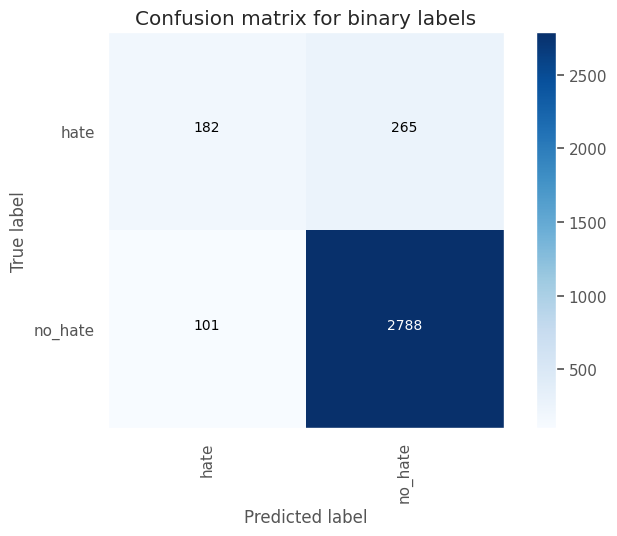

Test Accuracy: 0.8903
Test macro-F1: 0.7185




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_2 (Embedding)     (None, 128, 100)          1000100   
                                                                 
 dropout_4 (Dropout)         (None, 128, 100)          0         
                                                                 
 flatten_2 (Flatten)         (None, 12800)             0         
                                                                 
 dense_4 (Dense)             (None, 128)               1638528   
                                                                 
 dropout_5 (Dropout)         (

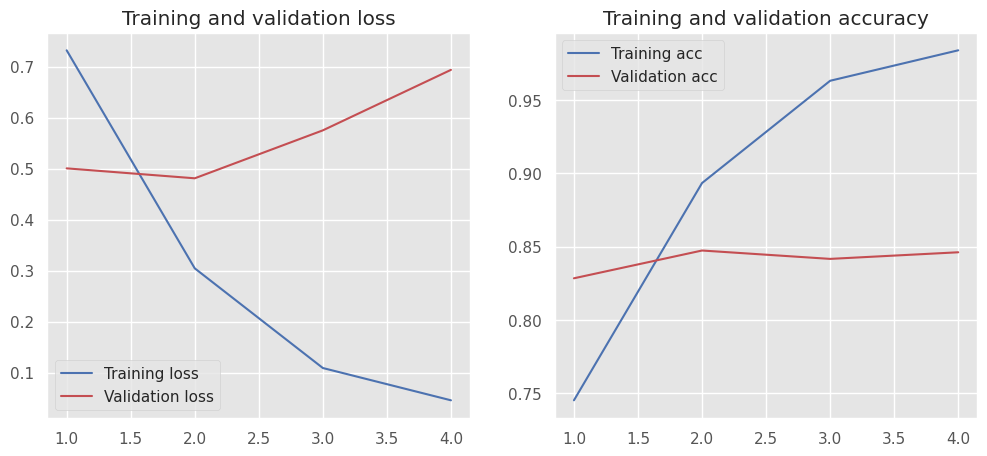

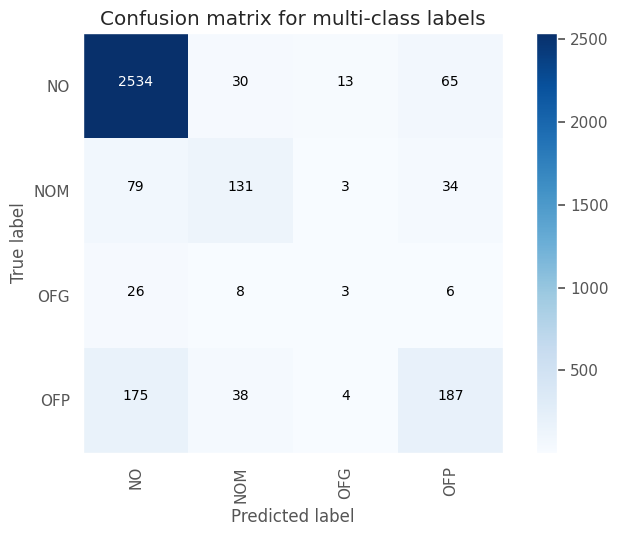

Test Accuracy: 0.8558
Test macro-F1: 0.5336


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6349    0.4474    0.5249       447
     no_hate     0.9182    0.9602    0.9387      2889

    accuracy                         0.8915      3336
   macro avg     0.7766    0.7038    0.7318      3336
weighted avg     0.8803    0.8915    0.8833      3336



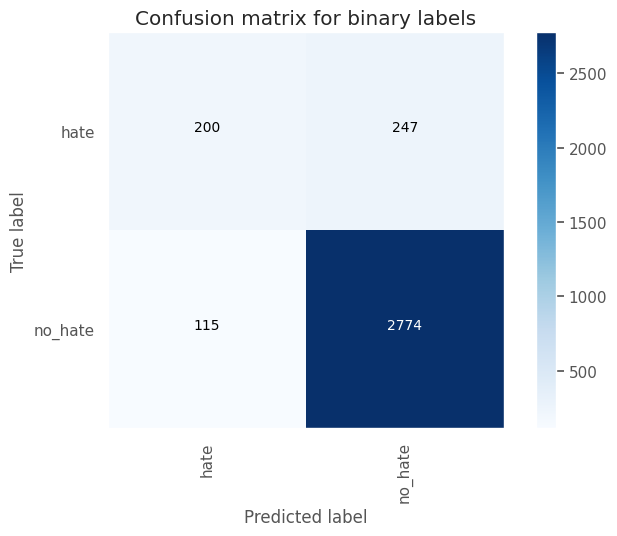

Test Accuracy: 0.8915
Test macro-F1: 0.7318




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_3 (Embedding)     (None, 128, 100)          1000100   
                                                                 
 dropout_6 (Dropout)         (None, 128, 100)          0         
                                                                 
 flatten_3 (Flatten)         (None, 12800)             0         
                                                                 
 dense_6 (Dense)             (None, 128)               1638528   
                                                                 
 dropout_7 (Dropout)         (

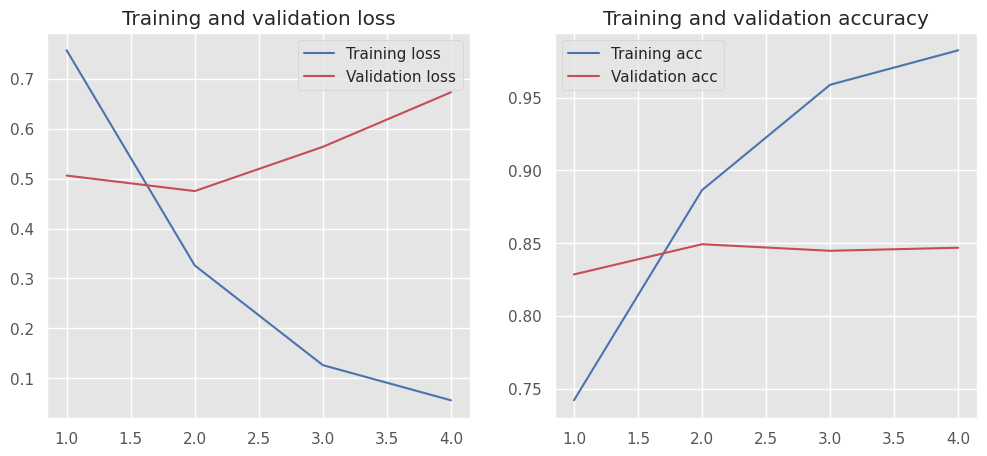

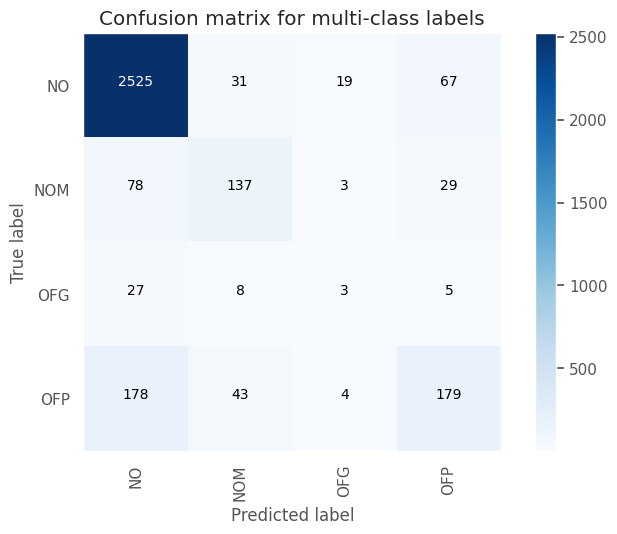

Test Accuracy: 0.8525
Test macro-F1: 0.5303


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6181    0.4273    0.5053       447
     no_hate     0.9154    0.9592    0.9368      2889

    accuracy                         0.8879      3336
   macro avg     0.7668    0.6932    0.7210      3336
weighted avg     0.8756    0.8879    0.8790      3336



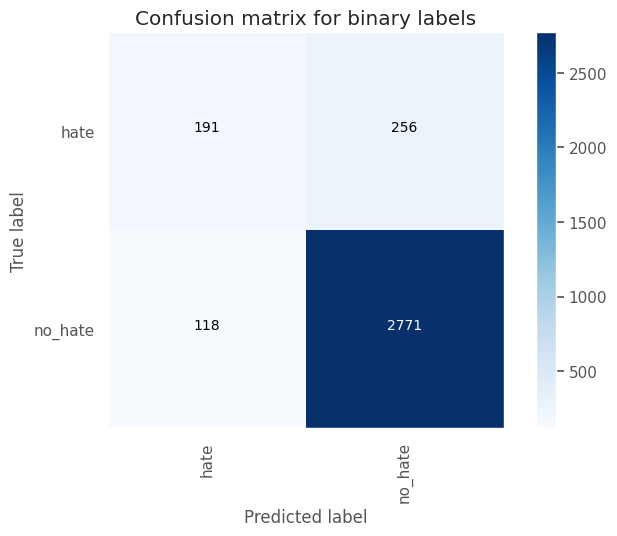

Test Accuracy: 0.8879
Test macro-F1: 0.721




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_4 (Embedding)     (None, 128, 100)          1000100   
                                                                 
 dropout_8 (Dropout)         (None, 128, 100)          0         
                                                                 
 flatten_4 (Flatten)         (None, 12800)             0         
                                                                 
 dense_8 (Dense)             (None, 128)               1638528   
                                                                 
 dropout_9 (Dropout)         (N

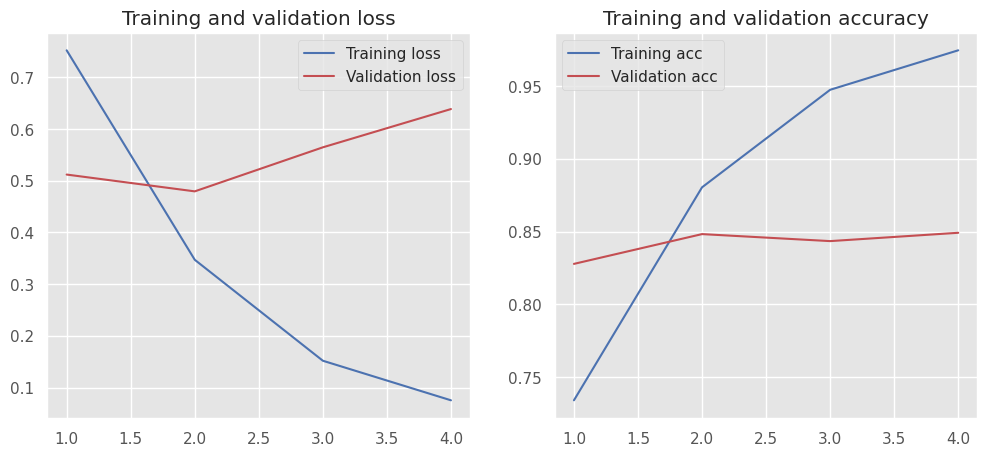

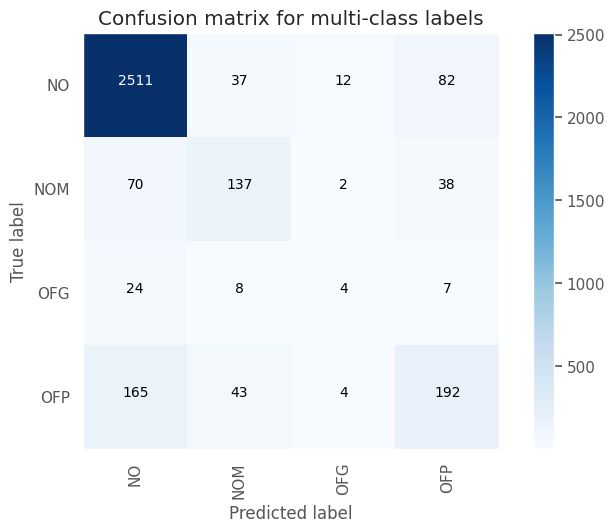

Test Accuracy: 0.8525
Test macro-F1: 0.5407


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6070    0.4631    0.5254       447
     no_hate     0.9199    0.9536    0.9364      2889

    accuracy                         0.8879      3336
   macro avg     0.7635    0.7084    0.7309      3336
weighted avg     0.8779    0.8879    0.8814      3336



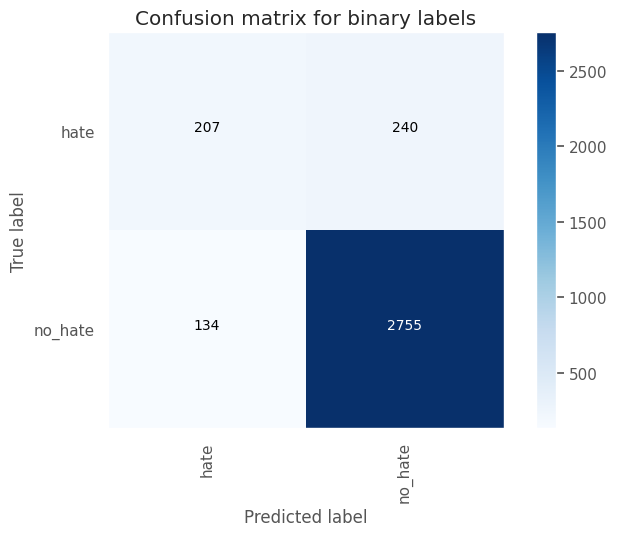

Test Accuracy: 0.8879
Test macro-F1: 0.7309




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_5 (Embedding)     (None, 128, 100)          1000100   
                                                                 
 dropout_10 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_5 (Flatten)         (None, 12800)             0         
                                                                 
 dense_10 (Dense)            (None, 128)               1638528   
                                                                 
 dropout_11 (Dropout)        (

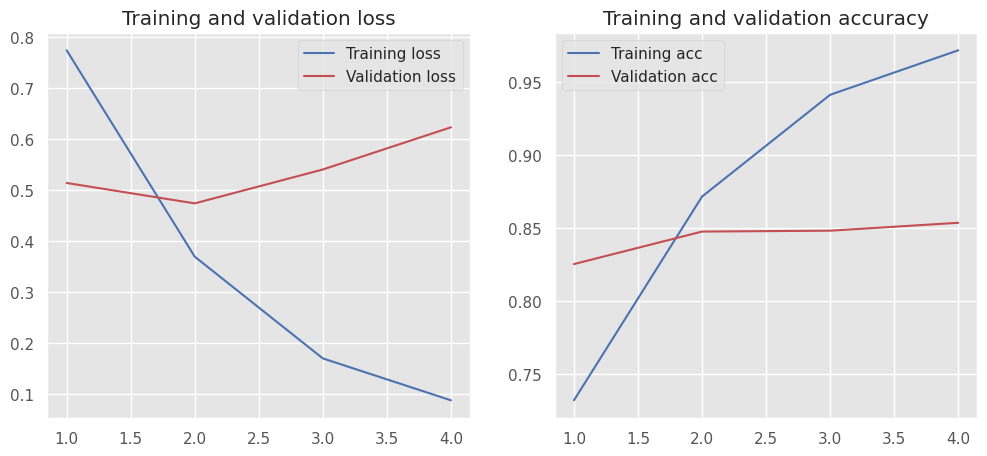

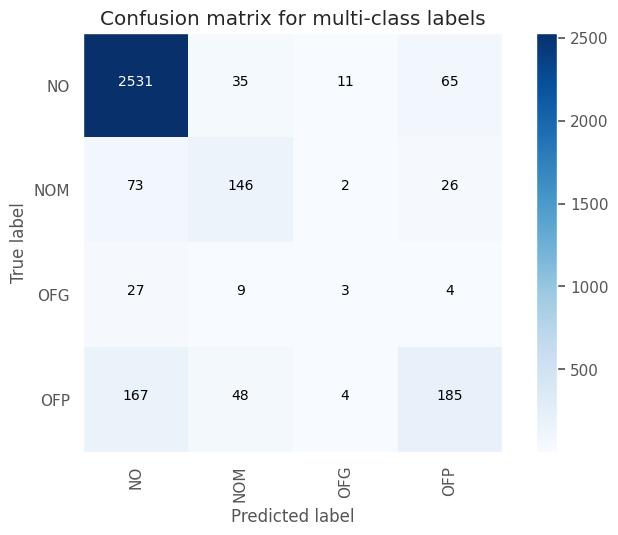

Test Accuracy: 0.8588
Test macro-F1: 0.5422


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6533    0.4385    0.5248       447
     no_hate     0.9173    0.9640    0.9401      2889

    accuracy                         0.8936      3336
   macro avg     0.7853    0.7012    0.7324      3336
weighted avg     0.8820    0.8936    0.8844      3336



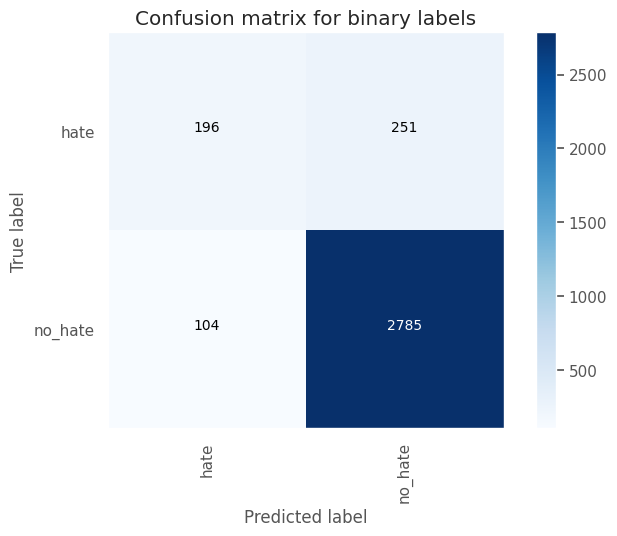

Test Accuracy: 0.8936
Test macro-F1: 0.7324




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_6 (Embedding)     (None, 128, 100)          1000100   
                                                                 
 dropout_12 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_6 (Flatten)         (None, 12800)             0         
                                                                 
 dense_12 (Dense)            (None, 128)               1638528   
                                                                 
 dropout_13 (Dropout)        (

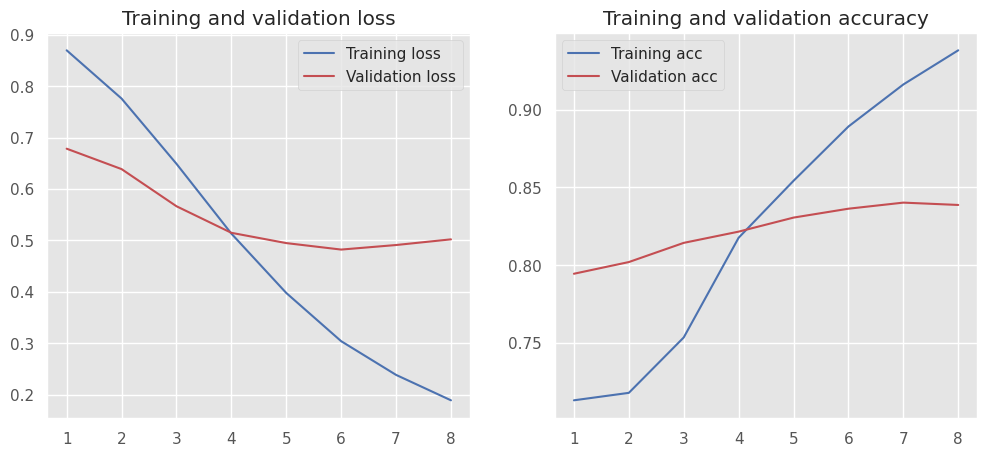

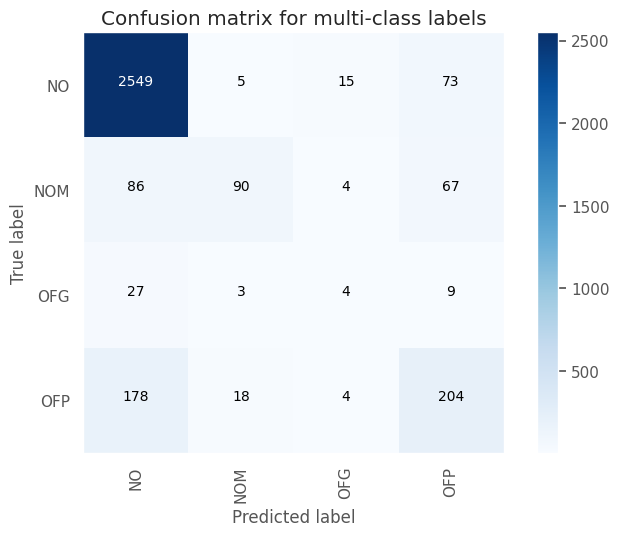

Test Accuracy: 0.8534
Test macro-F1: 0.5198


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5816    0.4944    0.5345       447
     no_hate     0.9235    0.9450    0.9341      2889

    accuracy                         0.8846      3336
   macro avg     0.7526    0.7197    0.7343      3336
weighted avg     0.8777    0.8846    0.8806      3336



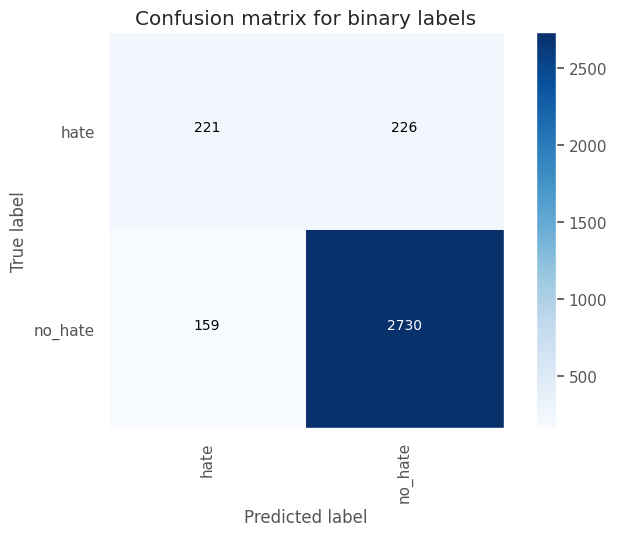

Test Accuracy: 0.8846
Test macro-F1: 0.7343




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_7 (Embedding)     (None, 128, 100)          1000100   
                                                                 
 dropout_14 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_7 (Flatten)         (None, 12800)             0         
                                                                 
 dense_14 (Dense)            (None, 128)               1638528   
                                                                 
 dropout_15 (Dropout)        (

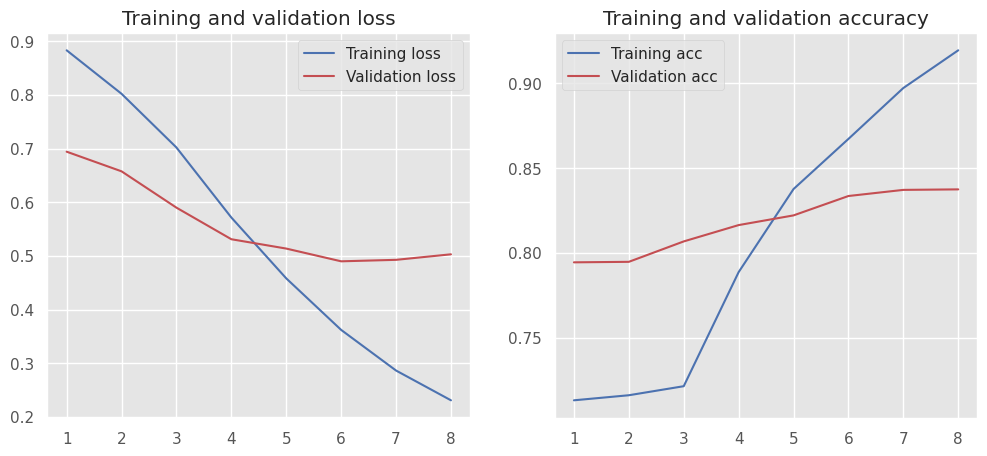

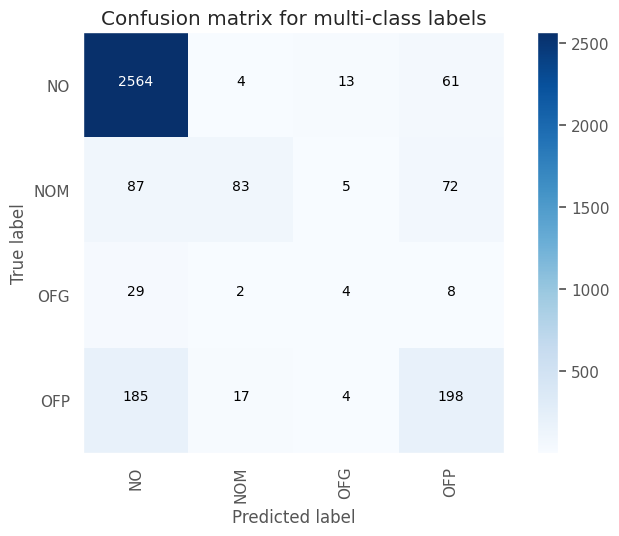

Test Accuracy: 0.854
Test macro-F1: 0.5126


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5863    0.4787    0.5271       447
     no_hate     0.9216    0.9477    0.9345      2889

    accuracy                         0.8849      3336
   macro avg     0.7539    0.7132    0.7308      3336
weighted avg     0.8767    0.8849    0.8799      3336



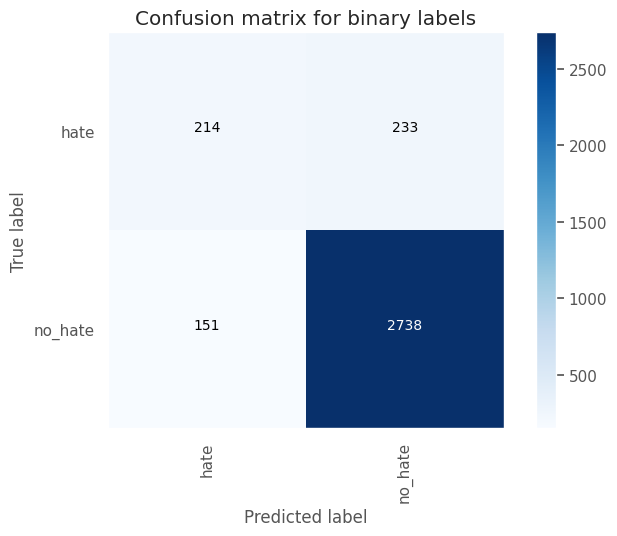

Test Accuracy: 0.8849
Test macro-F1: 0.7308




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_8 (Embedding)     (None, 128, 100)          1000100   
                                                                 
 dropout_16 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_8 (Flatten)         (None, 12800)             0         
                                                                 
 dense_16 (Dense)            (None, 128)               1638528   
                                                                 
 dropout_17 (Dropout)        (

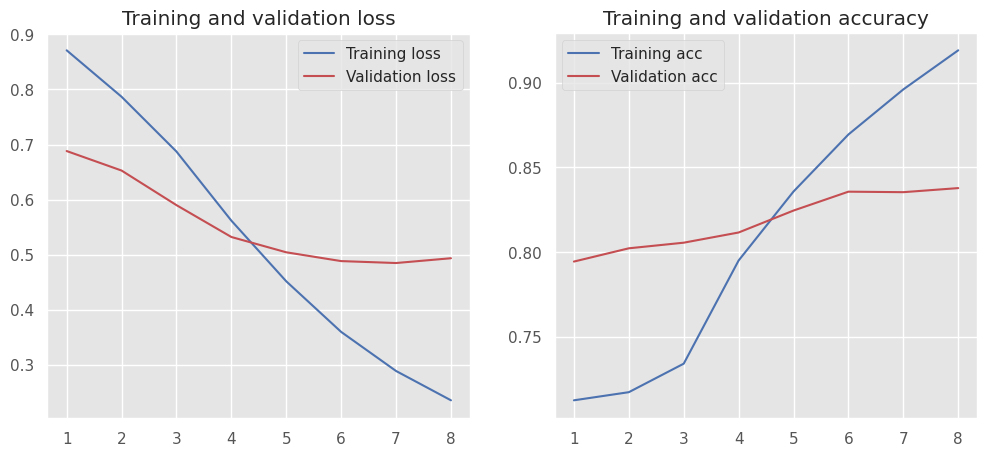

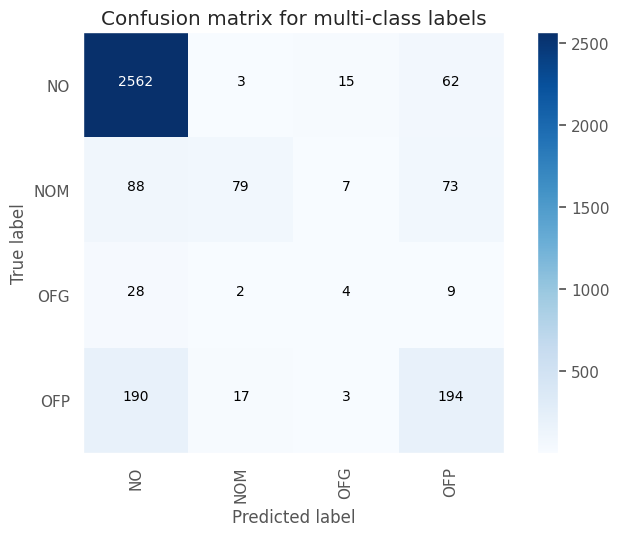

Test Accuracy: 0.851
Test macro-F1: 0.5045


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5722    0.4698    0.5160       447
     no_hate     0.9202    0.9457    0.9327      2889

    accuracy                         0.8819      3336
   macro avg     0.7462    0.7077    0.7244      3336
weighted avg     0.8735    0.8819    0.8769      3336



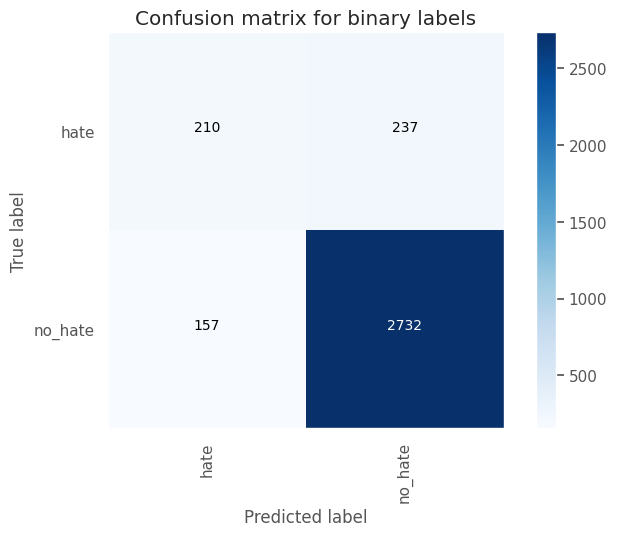

Test Accuracy: 0.8819
Test macro-F1: 0.7244




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_9 (Embedding)     (None, 128, 100)          1000100   
                                                                 
 dropout_18 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_9 (Flatten)         (None, 12800)             0         
                                                                 
 dense_18 (Dense)            (None, 128)               1638528   
                                                                 
 dropout_19 (Dropout)        (

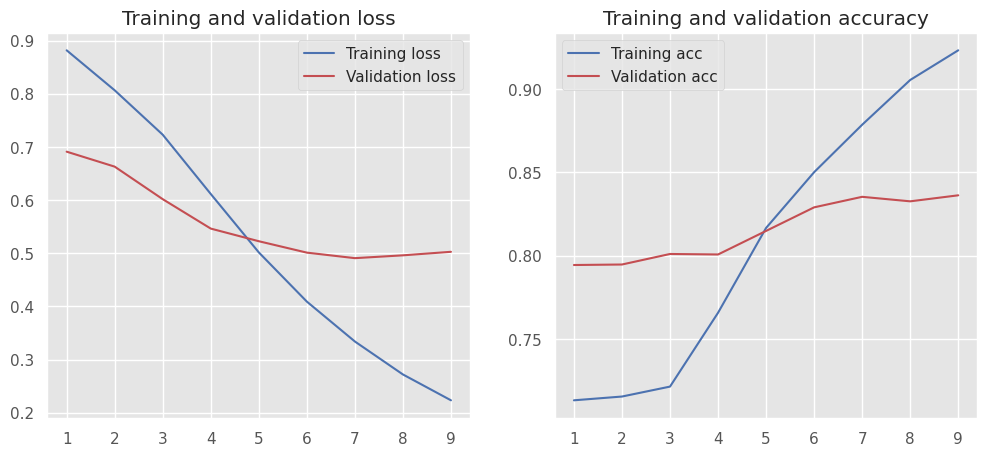

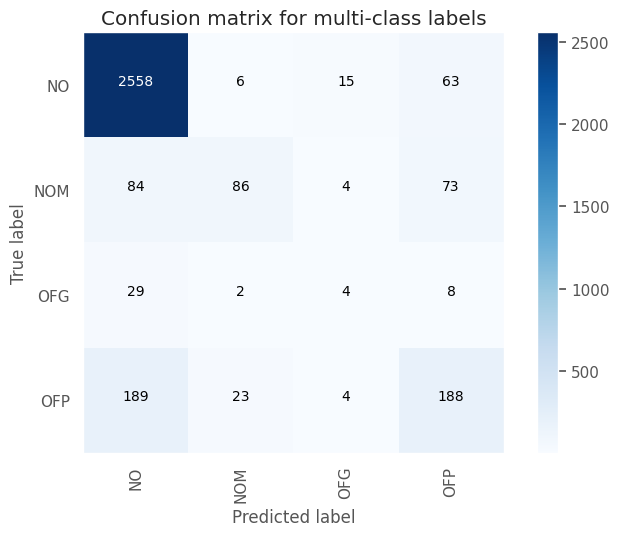

Test Accuracy: 0.8501
Test macro-F1: 0.5069


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5682    0.4564    0.5062       447
     no_hate     0.9184    0.9463    0.9322      2889

    accuracy                         0.8807      3336
   macro avg     0.7433    0.7014    0.7192      3336
weighted avg     0.8715    0.8807    0.8751      3336



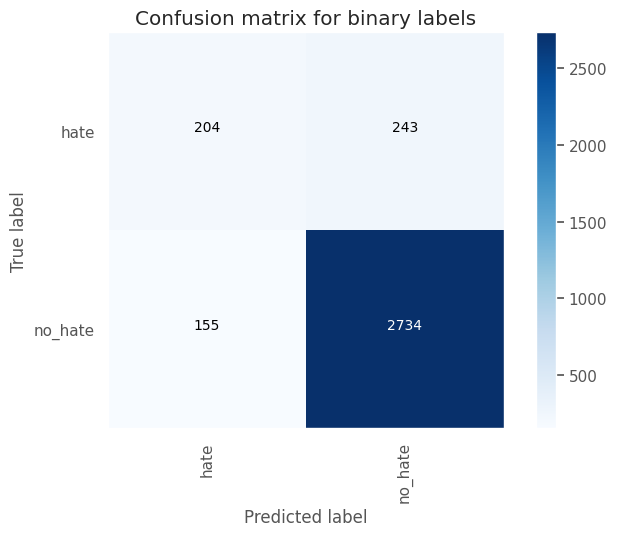

Test Accuracy: 0.8807
Test macro-F1: 0.7192




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_10 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_20 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_10 (Flatten)        (None, 12800)             0         
                                                                 
 dense_20 (Dense)            (None, 128)               1638528   
                                                                 
 dropout_21 (Dropout)        

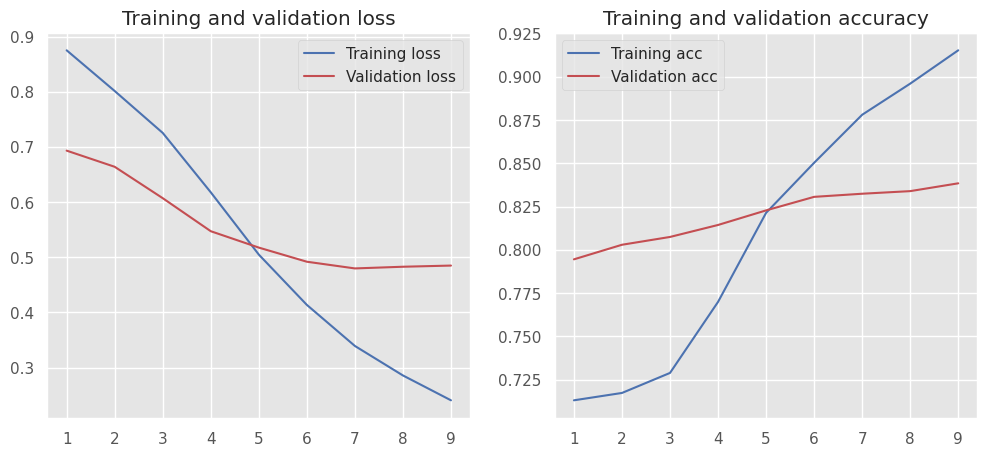

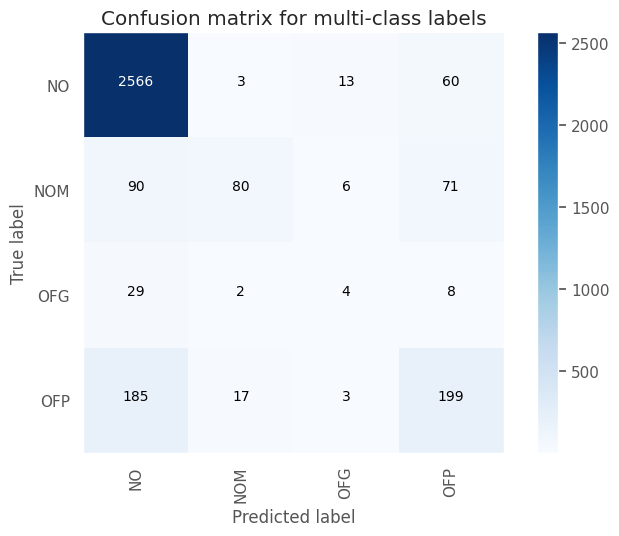

Test Accuracy: 0.854
Test macro-F1: 0.5105


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5879    0.4787    0.5277       447
     no_hate     0.9216    0.9481    0.9347      2889

    accuracy                         0.8852      3336
   macro avg     0.7548    0.7134    0.7312      3336
weighted avg     0.8769    0.8852    0.8801      3336



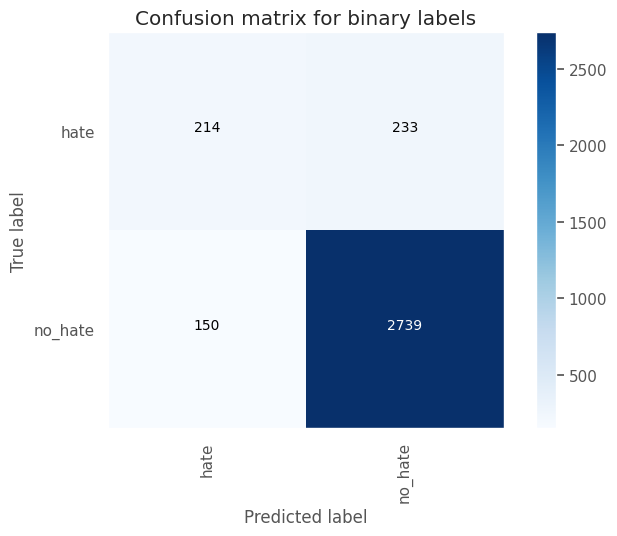

Test Accuracy: 0.8852
Test macro-F1: 0.7312




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_11 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_22 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_11 (Flatten)        (None, 12800)             0         
                                                                 
 dense_22 (Dense)            (None, 128)               1638528   
                                                                 
 dropout_23 (Dropout)        

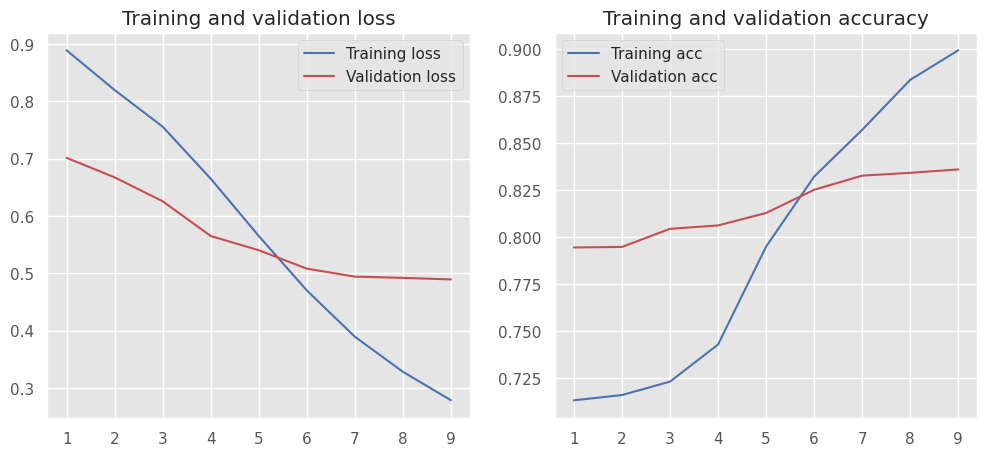

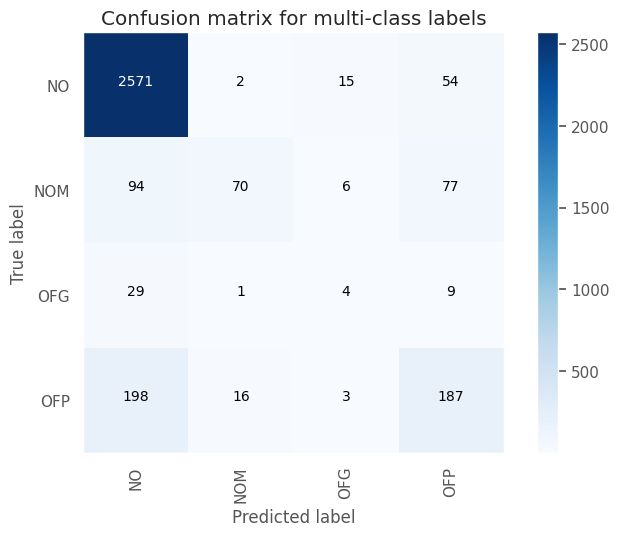

Test Accuracy: 0.8489
Test macro-F1: 0.4925


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5718    0.4541    0.5062       447
     no_hate     0.9181    0.9474    0.9325      2889

    accuracy                         0.8813      3336
   macro avg     0.7450    0.7008    0.7194      3336
weighted avg     0.8717    0.8813    0.8754      3336



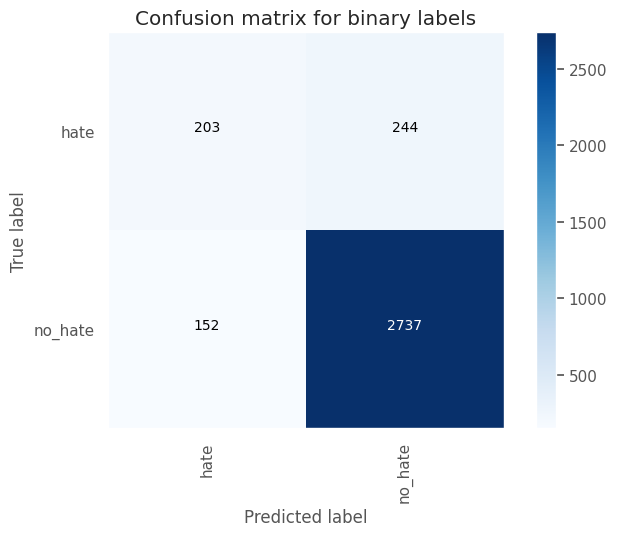

Test Accuracy: 0.8813
Test macro-F1: 0.7194




Training with dense_dim=256 ==============>
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_12 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_24 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_12 (Flatten)        (None, 12800)             0         
                                                                 
 dense_24 (Dense)            (None, 256)               3277056   
                                                   

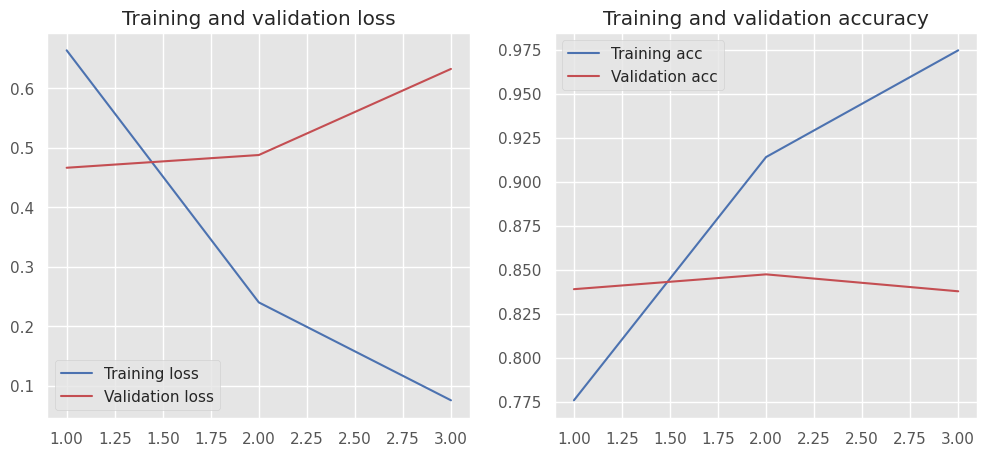

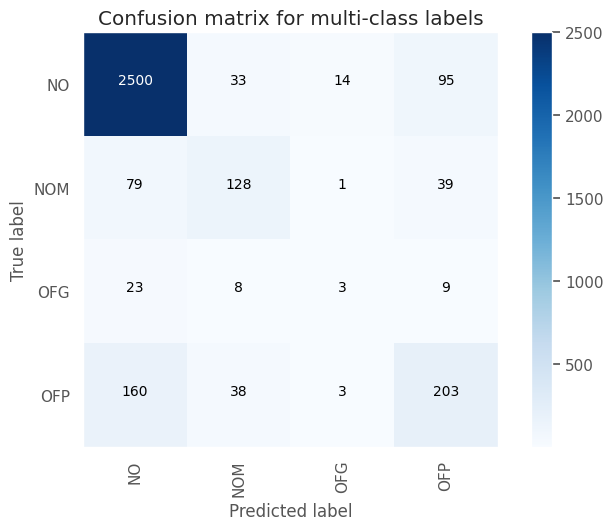

Test Accuracy: 0.8495
Test macro-F1: 0.5311


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5940    0.4877    0.5356       447
     no_hate     0.9229    0.9484    0.9355      2889

    accuracy                         0.8867      3336
   macro avg     0.7584    0.7181    0.7355      3336
weighted avg     0.8788    0.8867    0.8819      3336



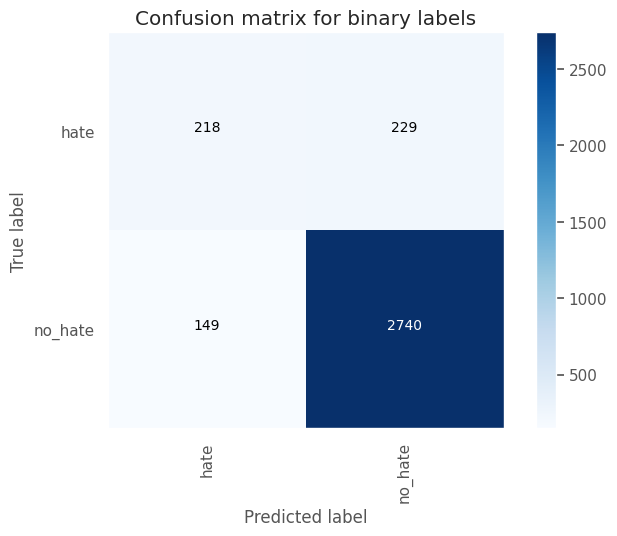

Test Accuracy: 0.8867
Test macro-F1: 0.7355




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_13 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_26 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_13 (Flatten)        (None, 12800)             0         
                                                                 
 dense_26 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_27 (Dropout)        

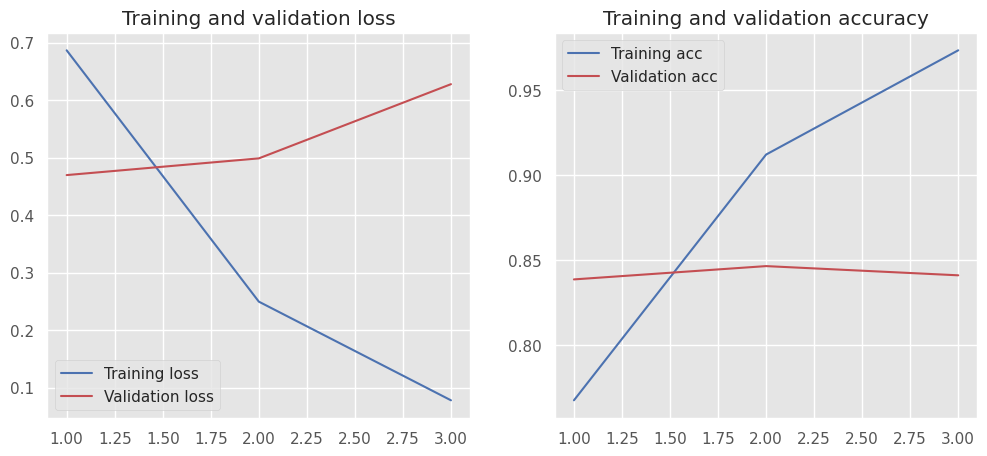

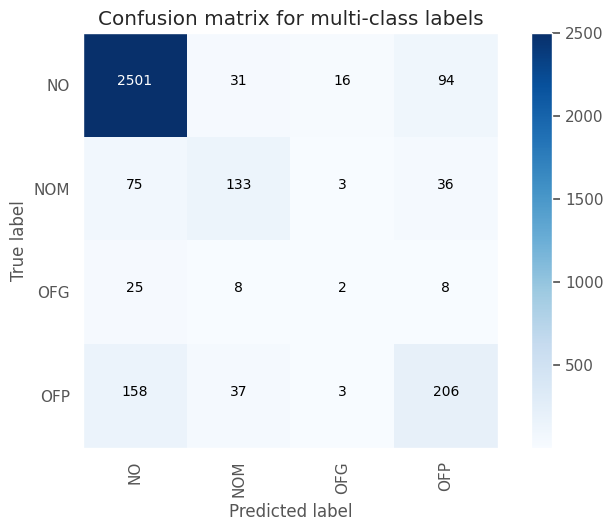

Test Accuracy: 0.8519
Test macro-F1: 0.53


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5951    0.4899    0.5374       447
     no_hate     0.9232    0.9484    0.9356      2889

    accuracy                         0.8870      3336
   macro avg     0.7591    0.7192    0.7365      3336
weighted avg     0.8792    0.8870    0.8823      3336



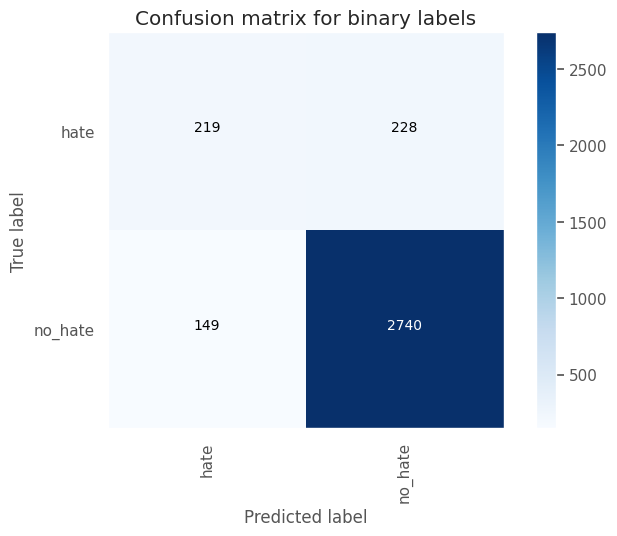

Test Accuracy: 0.887
Test macro-F1: 0.7365




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_14 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_28 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_14 (Flatten)        (None, 12800)             0         
                                                                 
 dense_28 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_29 (Dropout)        (

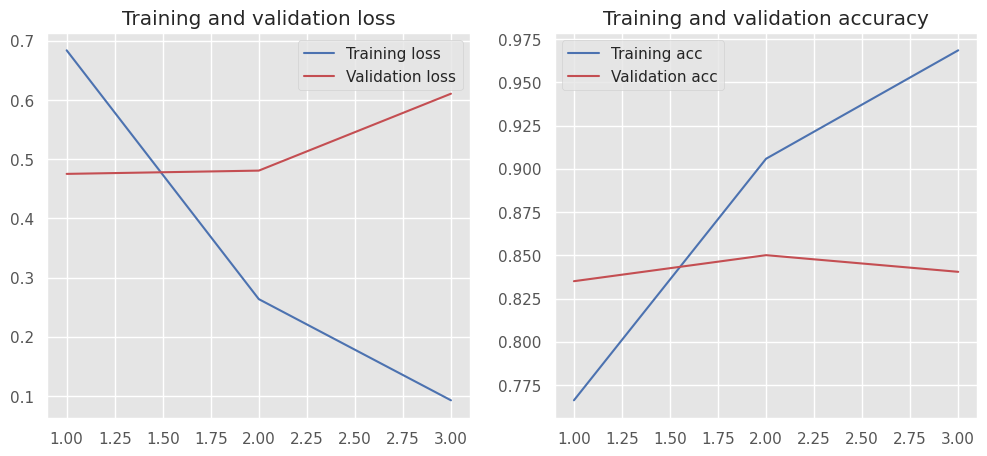

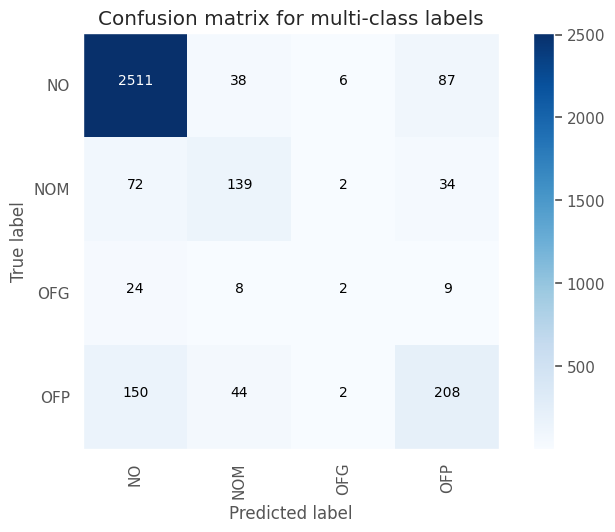

Test Accuracy: 0.8573
Test macro-F1: 0.5369


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6314    0.4944    0.5546       447
     no_hate     0.9243    0.9553    0.9396      2889

    accuracy                         0.8936      3336
   macro avg     0.7779    0.7249    0.7471      3336
weighted avg     0.8851    0.8936    0.8880      3336



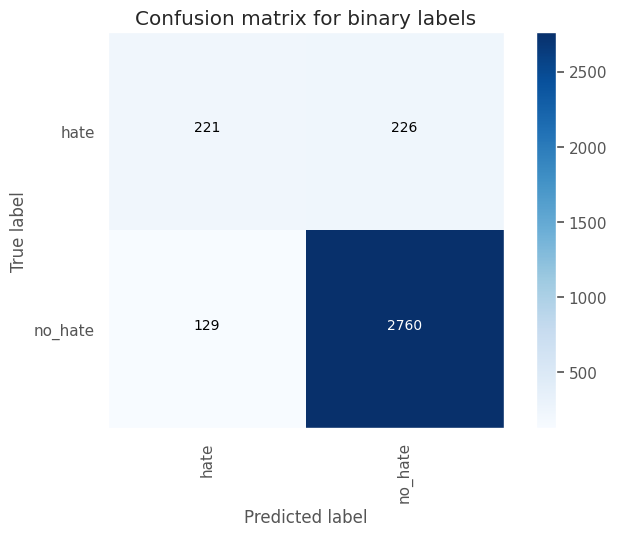

Test Accuracy: 0.8936
Test macro-F1: 0.7471




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_15 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_30 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_15 (Flatten)        (None, 12800)             0         
                                                                 
 dense_30 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_31 (Dropout)        

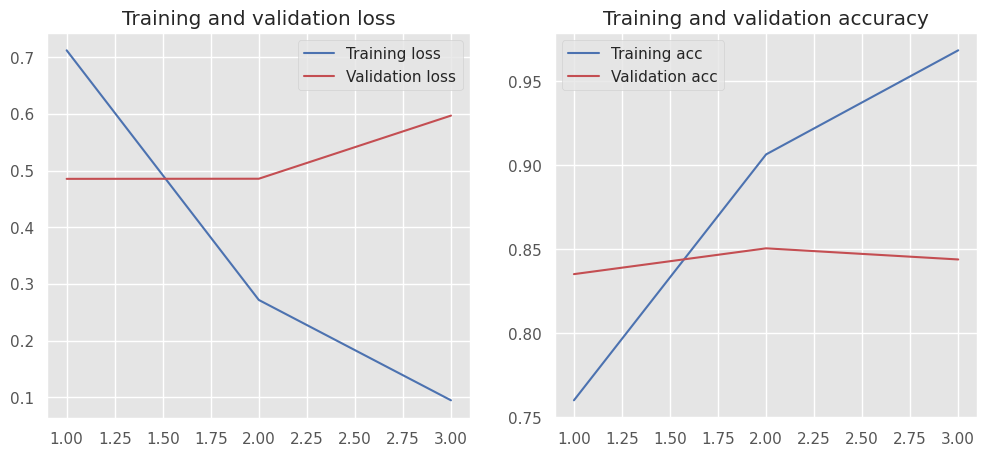

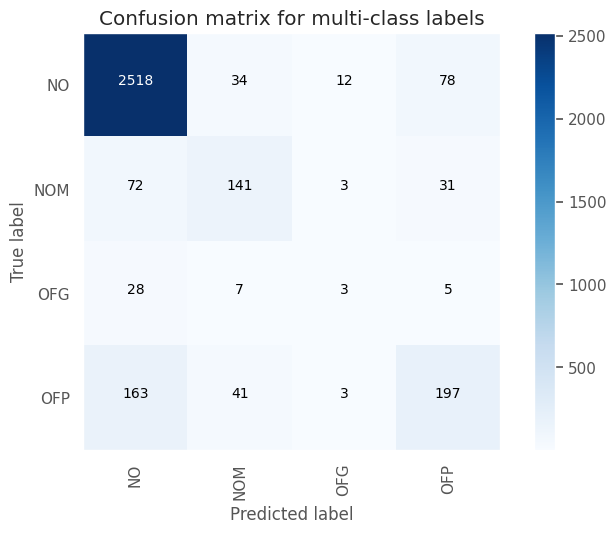

Test Accuracy: 0.857
Test macro-F1: 0.5434


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6265    0.4653    0.5340       447
     no_hate     0.9204    0.9571    0.9384      2889

    accuracy                         0.8912      3336
   macro avg     0.7735    0.7112    0.7362      3336
weighted avg     0.8811    0.8912    0.8842      3336



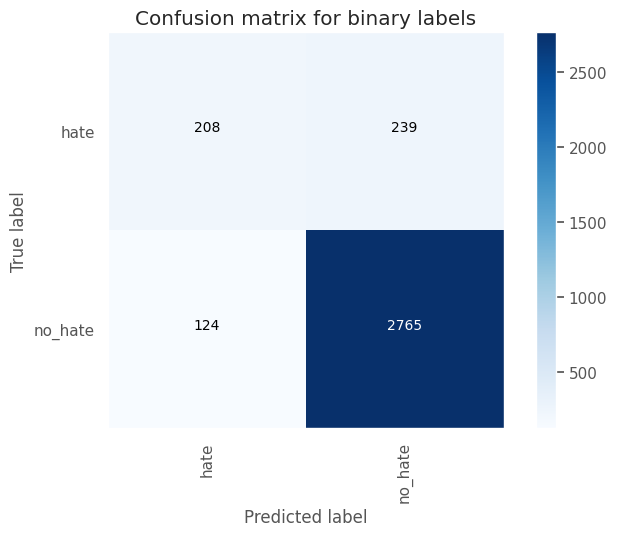

Test Accuracy: 0.8912
Test macro-F1: 0.7362




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_16 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_32 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_16 (Flatten)        (None, 12800)             0         
                                                                 
 dense_32 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_33 (Dropout)        

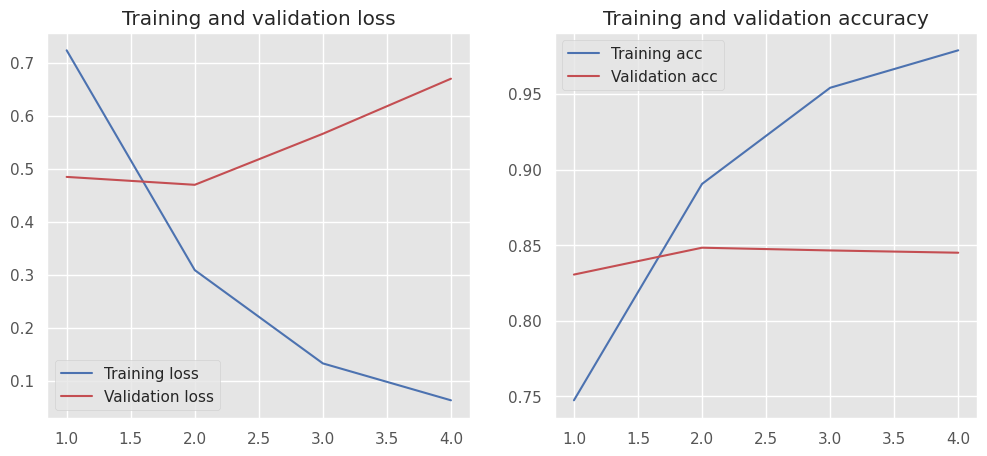

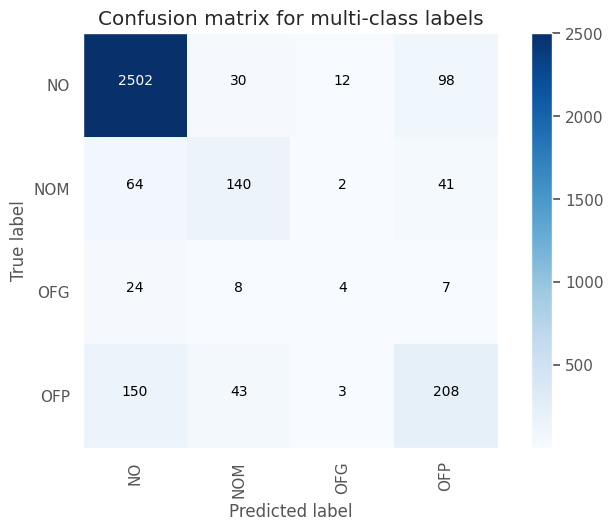

Test Accuracy: 0.8555
Test macro-F1: 0.5505


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5920    0.4966    0.5401       447
     no_hate     0.9240    0.9470    0.9354      2889

    accuracy                         0.8867      3336
   macro avg     0.7580    0.7218    0.7378      3336
weighted avg     0.8795    0.8867    0.8824      3336



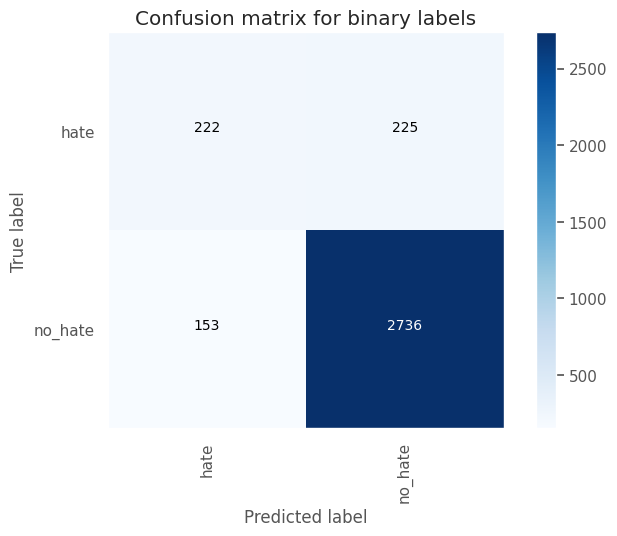

Test Accuracy: 0.8867
Test macro-F1: 0.7378




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_17 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_34 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_17 (Flatten)        (None, 12800)             0         
                                                                 
 dense_34 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_35 (Dropout)        

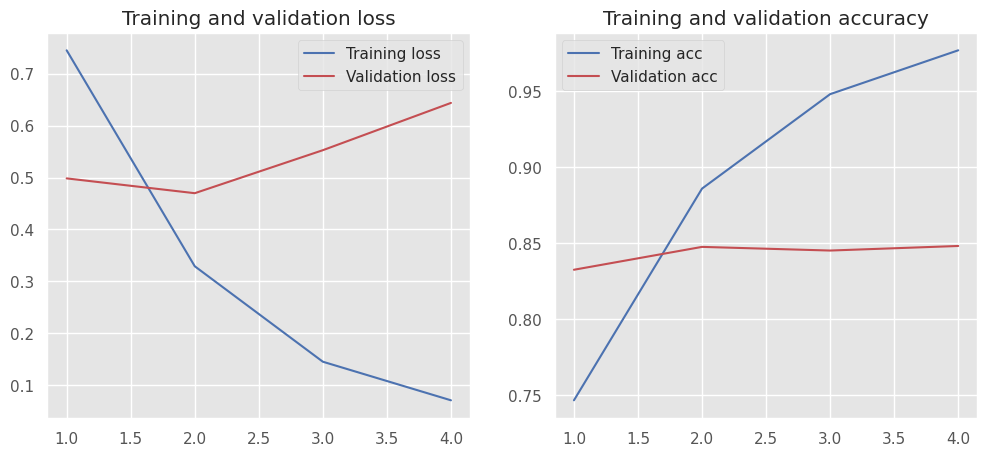

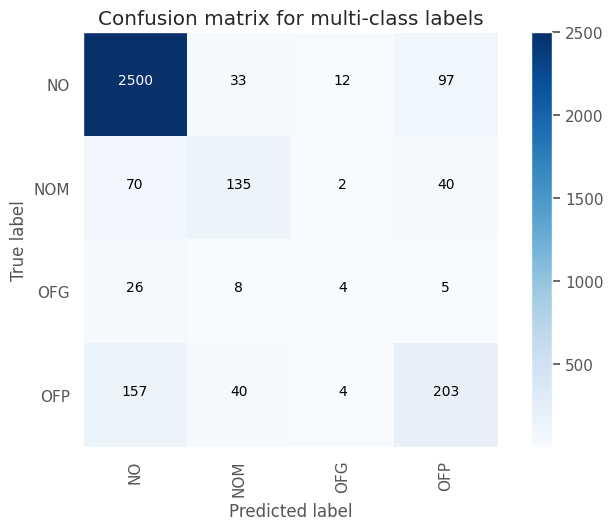

Test Accuracy: 0.8519
Test macro-F1: 0.5438


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5886    0.4832    0.5307       447
     no_hate     0.9222    0.9477    0.9348      2889

    accuracy                         0.8855      3336
   macro avg     0.7554    0.7155    0.7328      3336
weighted avg     0.8775    0.8855    0.8806      3336



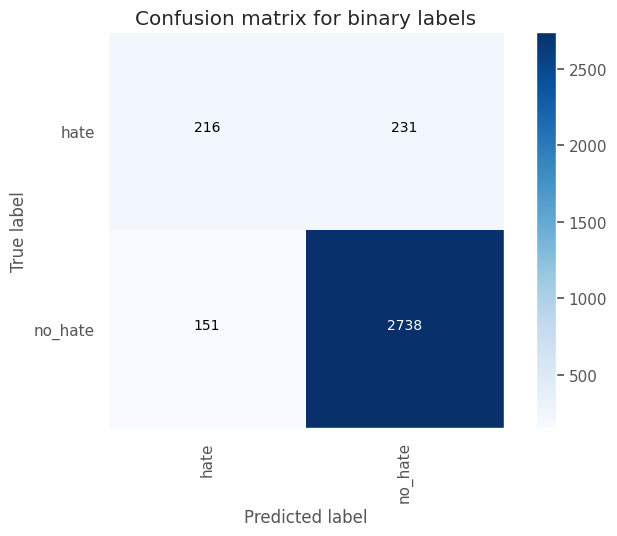

Test Accuracy: 0.8855
Test macro-F1: 0.7328




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_18 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_36 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_18 (Flatten)        (None, 12800)             0         
                                                                 
 dense_36 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_37 (Dropout)        

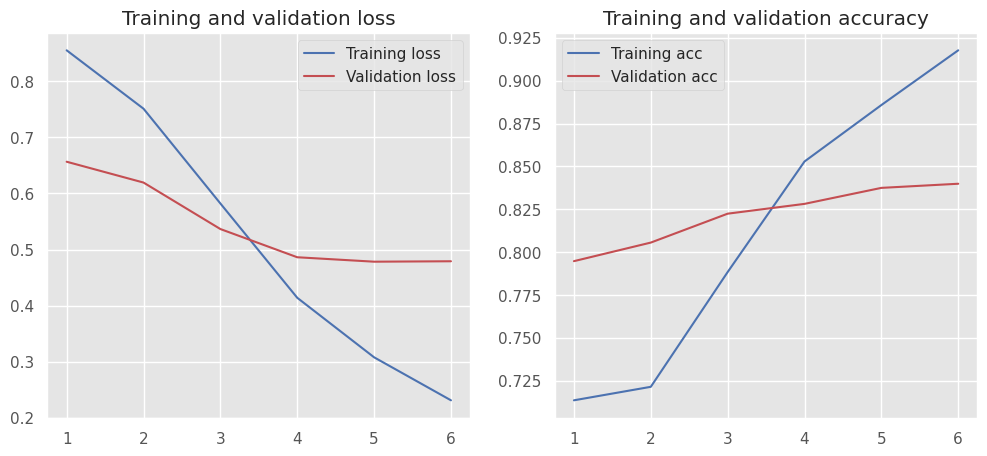

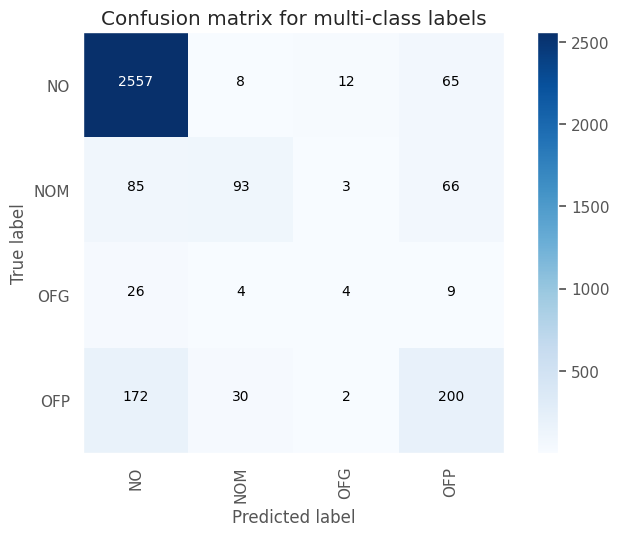

Test Accuracy: 0.8555
Test macro-F1: 0.5206


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5956    0.4810    0.5322       447
     no_hate     0.9220    0.9495    0.9355      2889

    accuracy                         0.8867      3336
   macro avg     0.7588    0.7152    0.7339      3336
weighted avg     0.8783    0.8867    0.8815      3336



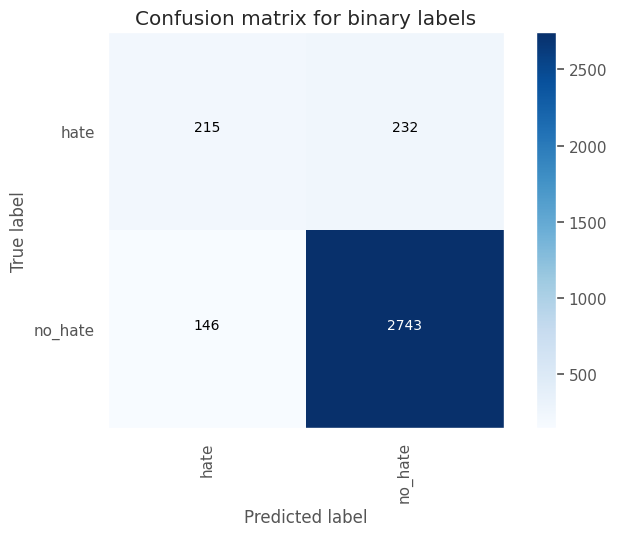

Test Accuracy: 0.8867
Test macro-F1: 0.7339




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_19 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_38 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_19 (Flatten)        (None, 12800)             0         
                                                                 
 dense_38 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_39 (Dropout)        

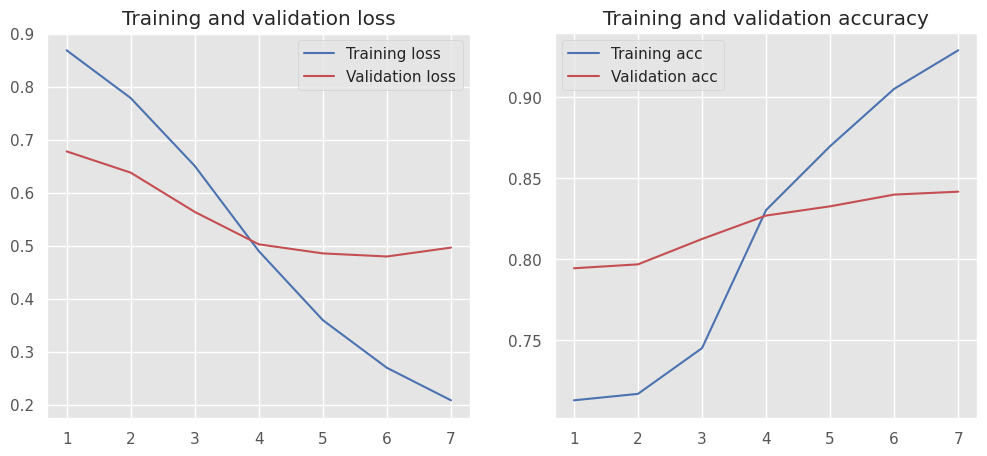

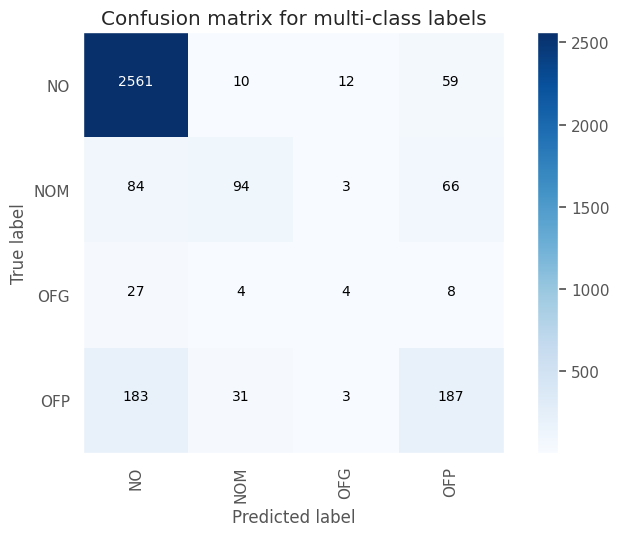

Test Accuracy: 0.8531
Test macro-F1: 0.5146


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5906    0.4519    0.5120       447
     no_hate     0.9182    0.9515    0.9346      2889

    accuracy                         0.8846      3336
   macro avg     0.7544    0.7017    0.7233      3336
weighted avg     0.8743    0.8846    0.8779      3336



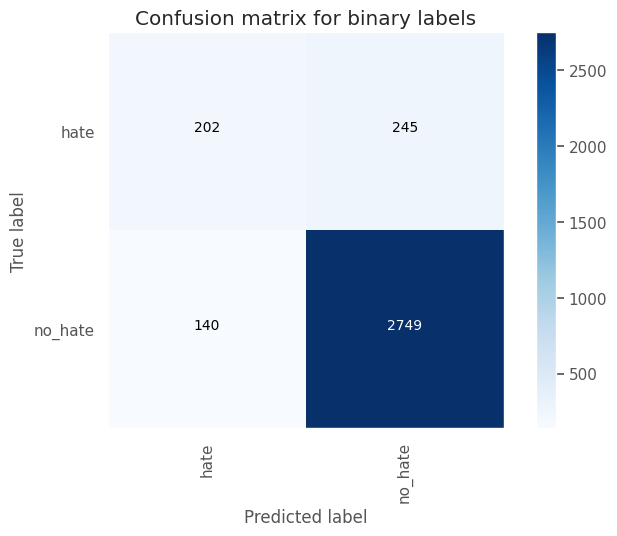

Test Accuracy: 0.8846
Test macro-F1: 0.7233




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_20 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_40 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_20 (Flatten)        (None, 12800)             0         
                                                                 
 dense_40 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_41 (Dropout)        

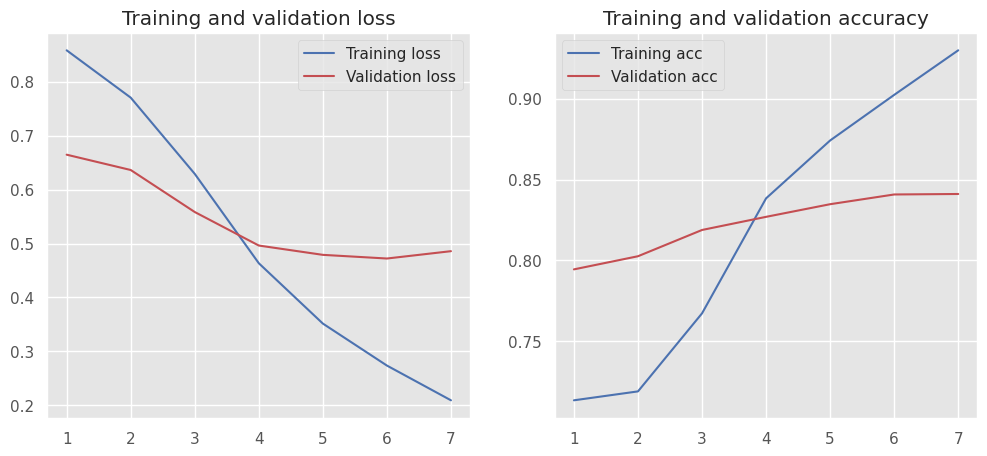

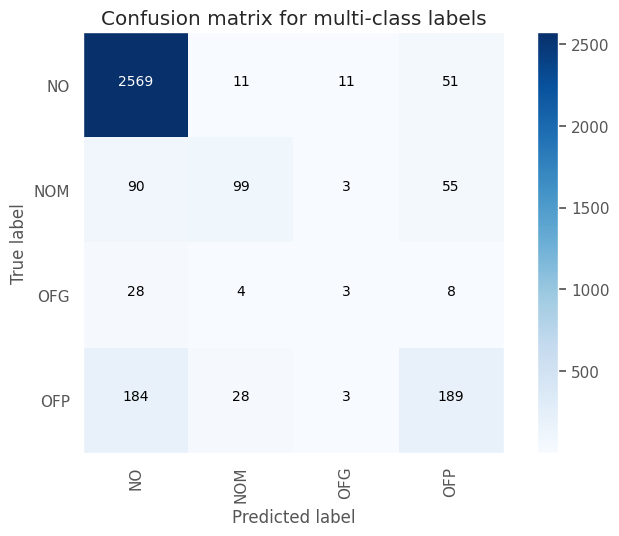

Test Accuracy: 0.8573
Test macro-F1: 0.5177


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6285    0.4541    0.5273       447
     no_hate     0.9190    0.9585    0.9383      2889

    accuracy                         0.8909      3336
   macro avg     0.7738    0.7063    0.7328      3336
weighted avg     0.8801    0.8909    0.8832      3336



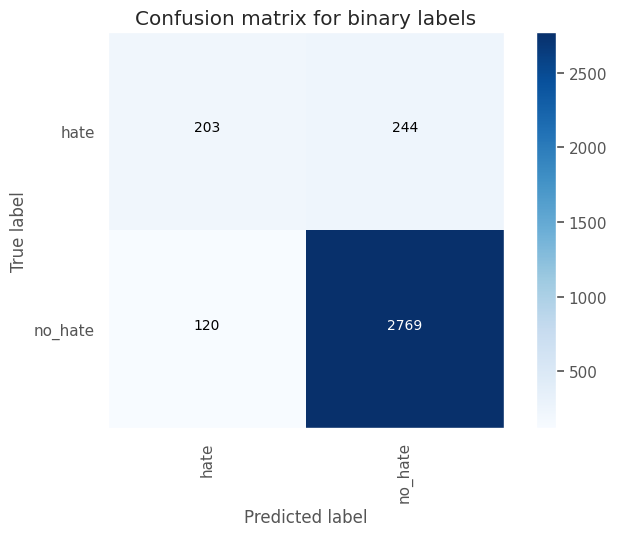

Test Accuracy: 0.8909
Test macro-F1: 0.7328




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_21 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_42 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_21 (Flatten)        (None, 12800)             0         
                                                                 
 dense_42 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_43 (Dropout)        

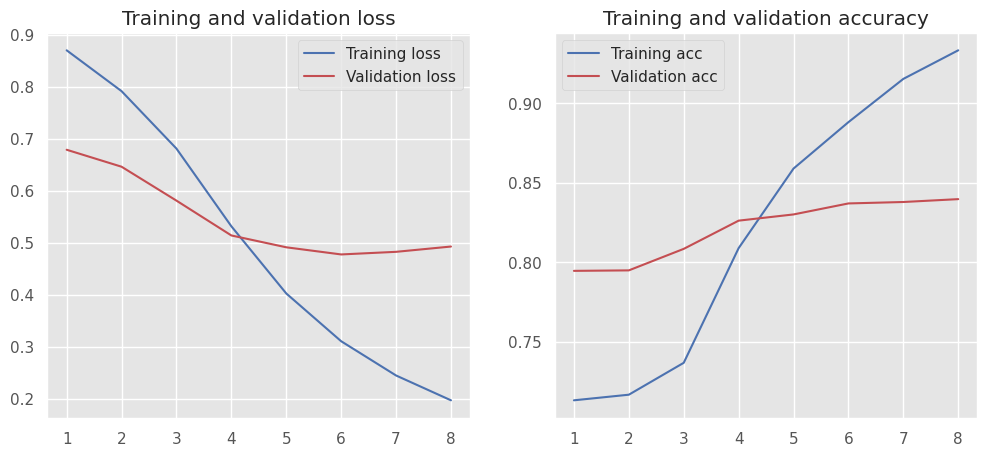

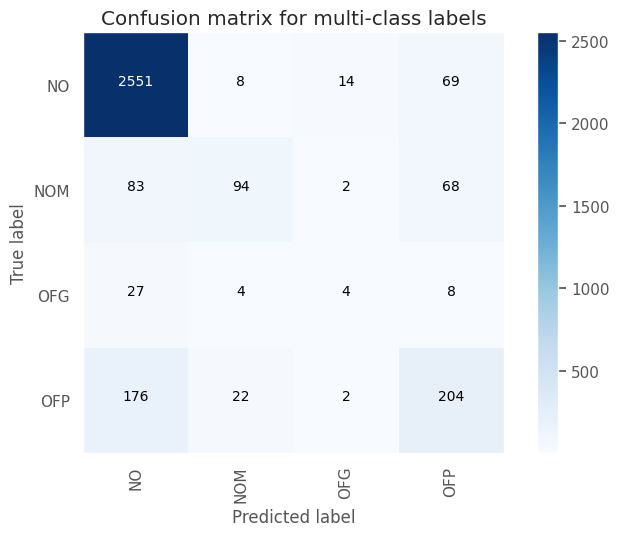

Test Accuracy: 0.8552
Test macro-F1: 0.5244


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5876    0.4877    0.5330       447
     no_hate     0.9228    0.9470    0.9347      2889

    accuracy                         0.8855      3336
   macro avg     0.7552    0.7174    0.7339      3336
weighted avg     0.8779    0.8855    0.8809      3336



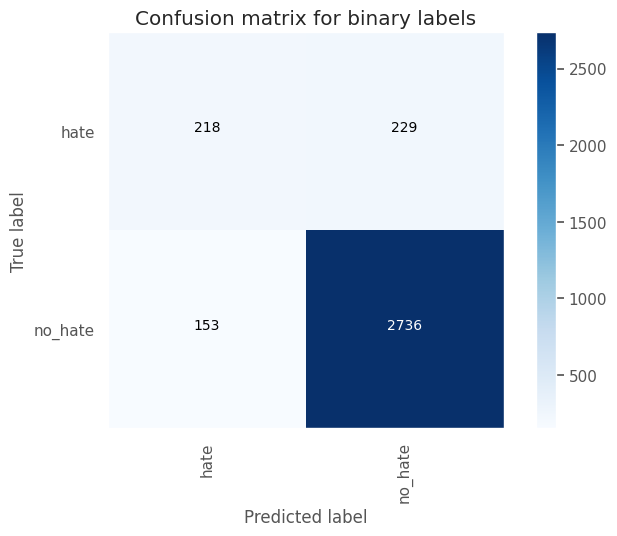

Test Accuracy: 0.8855
Test macro-F1: 0.7339




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_22 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_44 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_22 (Flatten)        (None, 12800)             0         
                                                                 
 dense_44 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_45 (Dropout)        

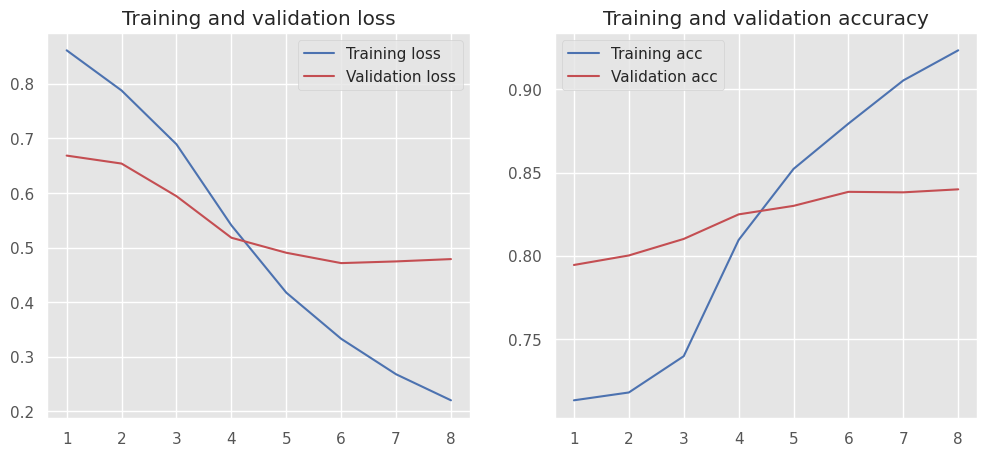

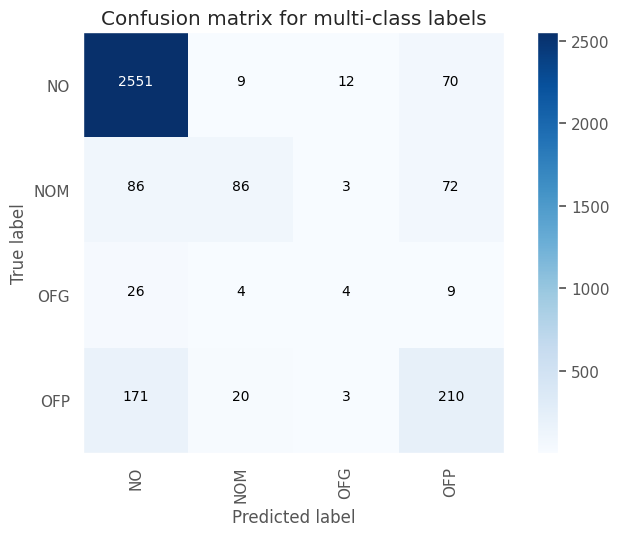

Test Accuracy: 0.8546
Test macro-F1: 0.5184


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5901    0.5056    0.5446       447
     no_hate     0.9252    0.9457    0.9353      2889

    accuracy                         0.8867      3336
   macro avg     0.7576    0.7256    0.7399      3336
weighted avg     0.8803    0.8867    0.8829      3336



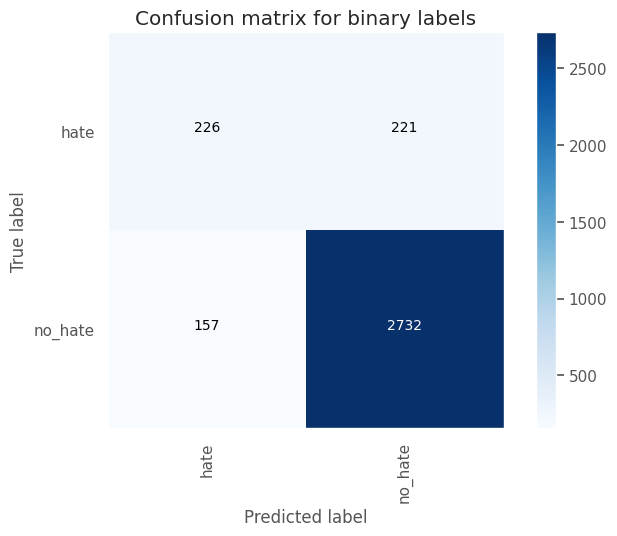

Test Accuracy: 0.8867
Test macro-F1: 0.7399




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_23 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_46 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_23 (Flatten)        (None, 12800)             0         
                                                                 
 dense_46 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_47 (Dropout)        

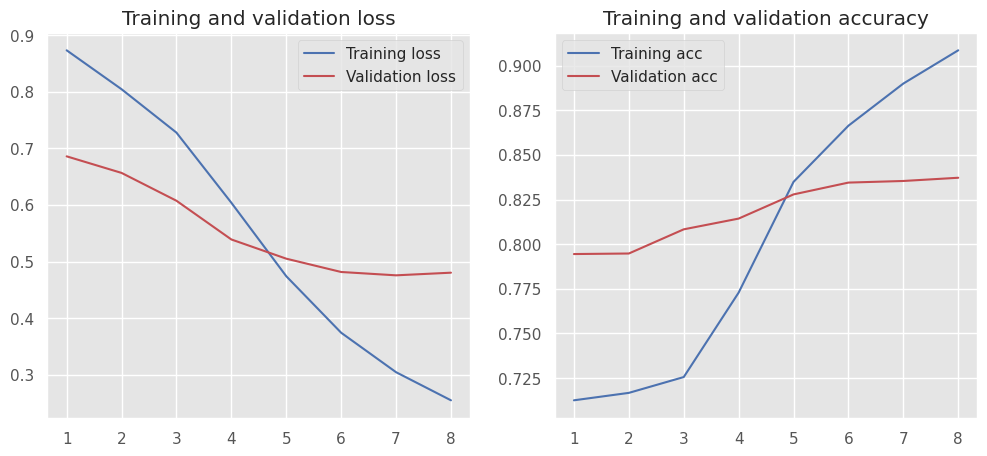

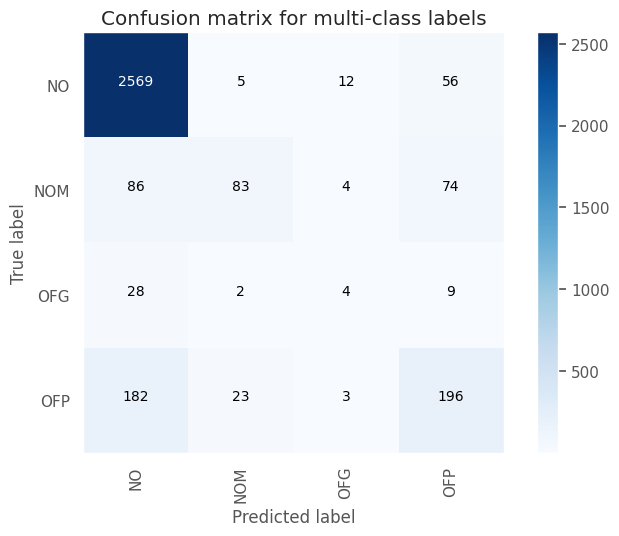

Test Accuracy: 0.8549
Test macro-F1: 0.5114


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5922    0.4743    0.5267       447
     no_hate     0.9211    0.9495    0.9351      2889

    accuracy                         0.8858      3336
   macro avg     0.7566    0.7119    0.7309      3336
weighted avg     0.8770    0.8858    0.8803      3336



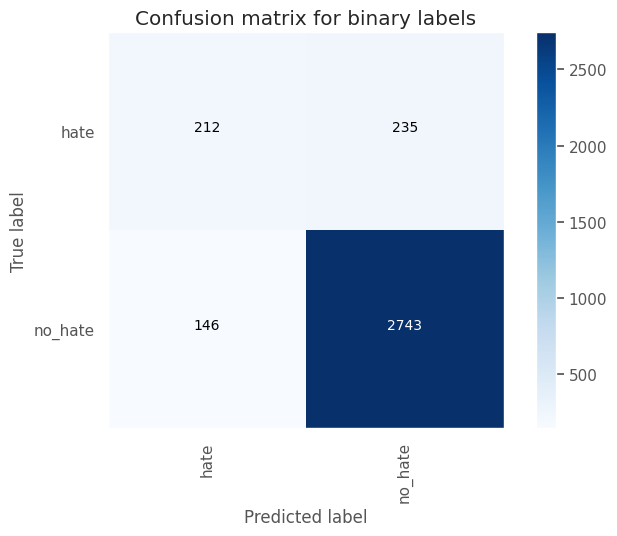

Test Accuracy: 0.8858
Test macro-F1: 0.7309






In [12]:
vocab_size: int = 10000 + 1   # +1 for padding (I was not accounting for it before)
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

for dense_dim in [128, 256]:
    print(f"Training with dense_dim={dense_dim} ==============>")
    for lr in [0.001, 0.000125]:
        for dp_after_emb in [0.1, 0.3, 0.5]:
            for dp_after_before_class_head in [0.3, 0.5]:
                # Define Keras model
                model = Sequential([
                    Embedding(vocab_size, embedding_dim, input_length=max_length),
                    Dropout(dp_after_emb),
                    Flatten(),
                    Dense(dense_dim, activation='relu'),
                    Dropout(dp_after_before_class_head),
                    Dense(4, activation='softmax')
                ])

                # Data
                dataset_folder: str = dataset_v6_folder
                dataset_name: str = "v6"
                data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
                x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], \
                    data[
                        "x_test"], data["y_test"]

                # Train with our class
                trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                        max_input_length=max_length))
                optim_config: OptimizationConfig = OptimizationConfig(
                    epochs=50,
                    batch_size=32,
                    validation_split=0.0,
                    validation_data=(x_val, y_val),
                    optimizer=Adam(learning_rate=lr)
                )
                trainer.train(x_train=x_train,
                              y_train=y_train,
                              opt_config=optim_config,
                              callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
                mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
                mc_report: dict
                bc_report: dict

                # Accumulate result so it can be plotted
                result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                                dataset_version=dataset_name,
                                                model_params=model.count_params(),
                                                optim_config=optim_config,
                                                macro_prec_mc=mc_report["macro avg"]["precision"],
                                                macro_recall_mc=mc_report["macro avg"]["recall"],
                                                macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                                macro_prec_bc=bc_report["macro avg"]["precision"],
                                                macro_recall_bc=bc_report["macro avg"]["recall"],
                                                macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                                )
                results_rep.accumulate(result)

In [13]:
report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)


<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>16</th>
      <td>v6</td>
      <td>{'embedding_16': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_32': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_16': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_32': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_33': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_33': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5812</td>
      <td>0.5304</td>
      <td>0.5505</td>
      <td>0.7580</td>
      <td>0.7218</td>
      <td>0.7378</td>
    </tr>
    <tr>
      <th>17</th>
      <td>v6</td>
      <td>{'embedding_17': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_34': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_17': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_34': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_35': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_35': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5758</td>
      <td>0.5221</td>
      <td>0.5438</td>
      <td>0.7554</td>
      <td>0.7155</td>
      <td>0.7328</td>
    </tr>
    <tr>
      <th>15</th>
      <td>v6</td>
      <td>{'embedding_15': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_30': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_15': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_30': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_31': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_31': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5785</td>
      <td>0.5203</td>
      <td>0.5434</td>
      <td>0.7735</td>
      <td>0.7112</td>
      <td>0.7362</td>
    </tr>
    <tr>
      <th>5</th>
      <td>v6</td>
      <td>{'embedding_5': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_10': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_5': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_10': {'class_name': 'Dense', 'param_count': 1638528, 'input': (None, 12800), 'output': (None, 128)}, 'dropout_11': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_11': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2639144</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5822</td>
      <td>0.5192</td>
      <td>0.5422</td>
      <td>0.7853</td>
      <td>0.7012</td>
      <td>0.7324</td>
    </tr>
    <tr>
      <th>4</th>
      <td>v6</td>
      <td>{'embedding_4': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_8': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_4': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_8': {'class_name': 'Dense', 'param_count': 1638528, 'input': (None, 12800), 'output': (None, 128)}, 'dropout_9': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_9': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2639144</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5748</td>
      <td>0.5183</td>
      <td>0.5407</td>
      <td>0.7635</td>
      <td>0.7084</td>
      <td>0.7309</td>
    </tr>
    <tr>
      <th>14</th>
      <td>v6</td>
      <td>{'embedding_14': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_28': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_14': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_28': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_29': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_29': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5750</td>
      <td>0.5186</td>
      <td>0.5369</td>
      <td>0.7779</td>
      <td>0.7249</td>
      <td>0.7471</td>
    </tr>
    <tr>
      <th>2</th>
      <td>v6</td>
      <td>{'embedding_2': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_4': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_2': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_4': {'class_name': 'Dense', 'param_count': 1638528, 'input': (None, 12800), 'output': (None, 128)}, 'dropout_5': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_5': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2639144</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5760</td>
      <td>0.5055</td>
      <td>0.5336</td>
      <td>0.7766</td>
      <td>0.7038</td>
      <td>0.7318</td>
    </tr>
    <tr>
      <th>12</th>
      <td>v6</td>
      <td>{'embedding_12': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_24': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_12': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_24': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_25': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_25': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5633</td>
      <td>0.5092</td>
      <td>0.5311</td>
      <td>0.7584</td>
      <td>0.7181</td>
      <td>0.7355</td>
    </tr>
    <tr>
      <th>3</th>
      <td>v6</td>
      <td>{'embedding_3': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_6': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_3': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_6': {'class_name': 'Dense', 'param_count': 1638528, 'input': (None, 12800), 'output': (None, 128)}, 'dropout_7': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_7': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2639144</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5669</td>
      <td>0.5058</td>
      <td>0.5303</td>
      <td>0.7668</td>
      <td>0.6932</td>
      <td>0.7210</td>
    </tr>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense': {'class_name': 'Dense', 'param_count': 1638528, 'input': (None, 12800), 'output': (None, 128)}, 'dropout_1': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_1': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2639144</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5644</td>
      <td>0.5069</td>
      <td>0.5302</td>
      <td>0.7691</td>
      <td>0.7133</td>
      <td>0.7362</td>
    </tr>
    <tr>
      <th>13</th>
      <td>v6</td>
      <td>{'embedding_13': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_26': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_13': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_26': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_27': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_27': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5563</td>
      <td>0.5104</td>
      <td>0.5300</td>
      <td>0.7591</td>
      <td>0.7192</td>
      <td>0.7365</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_1': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_2': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_1': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_2': {'class_name': 'Dense', 'param_count': 1638528, 'input': (None, 12800), 'output': (None, 128)}, 'dropout_3': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_3': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2639144</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5745</td>
      <td>0.4944</td>
      <td>0.5249</td>
      <td>0.7782</td>
      <td>0.6861</td>
      <td>0.7185</td>
    </tr>
    <tr>
      <th>21</th>
      <td>v6</td>
      <td>{'embedding_21': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_42': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_21': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_42': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_43': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_43': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.000125}}</td>
      <td>0.6000</td>
      <td>0.4860</td>
      <td>0.5244</td>
      <td>0.7552</td>
      <td>0.7174</td>
      <td>0.7339</td>
    </tr>
    <tr>
      <th>18</th>
      <td>v6</td>
      <td>{'embedding_18': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_36': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_18': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_36': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_37': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_37': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.000125}}</td>
      <td>0.5920</td>
      <td>0.4831</td>
      <td>0.5206</td>
      <td>0.7588</td>
      <td>0.7152</td>
      <td>0.7339</td>
    </tr>
    <tr>
      <th>6</th>
      <td>v6</td>
      <td>{'embedding_6': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_12': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_6': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_12': {'class_name': 'Dense', 'param_count': 1638528, 'input': (None, 12800), 'output': (None, 128)}, 'dropout_13': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_13': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2639144</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.000125}}</td>
      <td>0.5999</td>
      <td>0.4818</td>
      <td>0.5198</td>
      <td>0.7526</td>
      <td>0.7197</td>
      <td>0.7343</td>
    </tr>
    <tr>
      <th>22</th>
      <td>v6</td>
      <td>{'embedding_22': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_44': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_22': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_44': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_45': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_45': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.000125}}</td>
      <td>0.5966</td>
      <td>0.4816</td>
      <td>0.5184</td>
      <td>0.7576</td>
      <td>0.7256</td>
      <td>0.7399</td>
    </tr>
    <tr>
      <th>20</th>
      <td>v6</td>
      <td>{'embedding_20': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_40': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_20': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_40': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_41': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_41': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.000125}}</td>
      <td>0.5914</td>
      <td>0.4777</td>
      <td>0.5177</td>
      <td>0.7738</td>
      <td>0.7063</td>
      <td>0.7328</td>
    </tr>
    <tr>
      <th>19</th>
      <td>v6</td>
      <td>{'embedding_19': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_38': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_19': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_38': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_39': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_39': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.000125}}</td>
      <td>0.5849</td>
      <td>0.4765</td>
      <td>0.5146</td>
      <td>0.7544</td>
      <td>0.7017</td>
      <td>0.7233</td>
    </tr>
    <tr>
      <th>7</th>
      <td>v6</td>
      <td>{'embedding_7': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_14': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_7': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_14': {'class_name': 'Dense', 'param_count': 1638528, 'input': (None, 12800), 'output': (None, 128)}, 'dropout_15': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_15': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2639144</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.000125}}</td>
      <td>0.6040</td>
      <td>0.4724</td>
      <td>0.5126</td>
      <td>0.7539</td>
      <td>0.7132</td>
      <td>0.7308</td>
    </tr>
    <tr>
      <th>23</th>
      <td>v6</td>
      <td>{'embedding_23': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_46': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_23': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_46': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_47': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_47': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.000125}}</td>
      <td>0.5975</td>
      <td>0.4716</td>
      <td>0.5114</td>
      <td>0.7566</td>
      <td>0.7119</td>
      <td>0.7309</td>
    </tr>
    <tr>
      <th>10</th>
      <td>v6</td>
      <td>{'embedding_10': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_20': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_10': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_20': {'class_name': 'Dense', 'param_count': 1638528, 'input': (None, 12800), 'output': (None, 128)}, 'dropout_21': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_21': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2639144</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.000125}}</td>
      <td>0.6052</td>
      <td>0.4702</td>
      <td>0.5105</td>
      <td>0.7548</td>
      <td>0.7134</td>
      <td>0.7312</td>
    </tr>
    <tr>
      <th>9</th>
      <td>v6</td>
      <td>{'embedding_9': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_18': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_9': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_18': {'class_name': 'Dense', 'param_count': 1638528, 'input': (None, 12800), 'output': (None, 128)}, 'dropout_19': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_19': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2639144</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.000125}}</td>
      <td>0.5860</td>
      <td>0.4687</td>
      <td>0.5069</td>
      <td>0.7433</td>
      <td>0.7014</td>
      <td>0.7192</td>
    </tr>
    <tr>
      <th>8</th>
      <td>v6</td>
      <td>{'embedding_8': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_16': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_8': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_16': {'class_name': 'Dense', 'param_count': 1638528, 'input': (None, 12800), 'output': (None, 128)}, 'dropout_17': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_17': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2639144</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.000125}}</td>
      <td>0.5968</td>
      <td>0.4657</td>
      <td>0.5045</td>
      <td>0.7462</td>
      <td>0.7077</td>
      <td>0.7244</td>
    </tr>
    <tr>
      <th>11</th>
      <td>v6</td>
      <td>{'embedding_11': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_22': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_11': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_22': {'class_name': 'Dense', 'param_count': 1638528, 'input': (None, 12800), 'output': (None, 128)}, 'dropout_23': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_23': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2639144</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.000125}}</td>
      <td>0.5976</td>
      <td>0.4531</td>
      <td>0.4925</td>
      <td>0.7450</td>
      <td>0.7008</td>
      <td>0.7194</td>
    </tr>
  </tbody>
</table>
    

Obtenemos resultados similares a los anteriores.

Me enfocaré en una prueba más pero aumentando el dropout.

Training with dense_dim=256 ==============>
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_24"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_24 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_48 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_24 (Flatten)        (None, 12800)             0         
                                                                 
 dense_48 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_49 (Dropout)        (Non

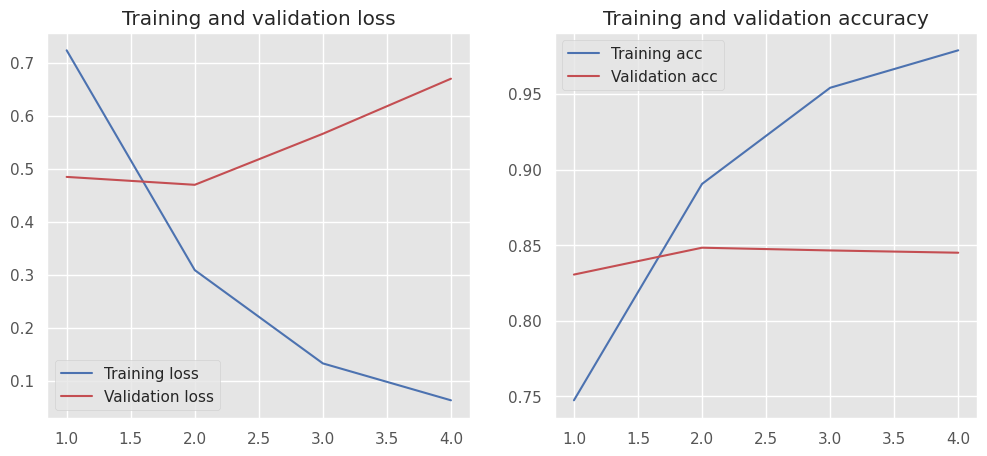

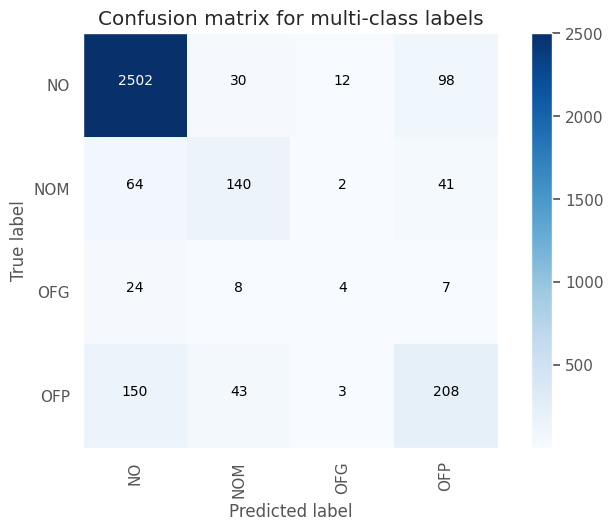

Test Accuracy: 0.8555
Test macro-F1: 0.5505


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5920    0.4966    0.5401       447
     no_hate     0.9240    0.9470    0.9354      2889

    accuracy                         0.8867      3336
   macro avg     0.7580    0.7218    0.7378      3336
weighted avg     0.8795    0.8867    0.8824      3336



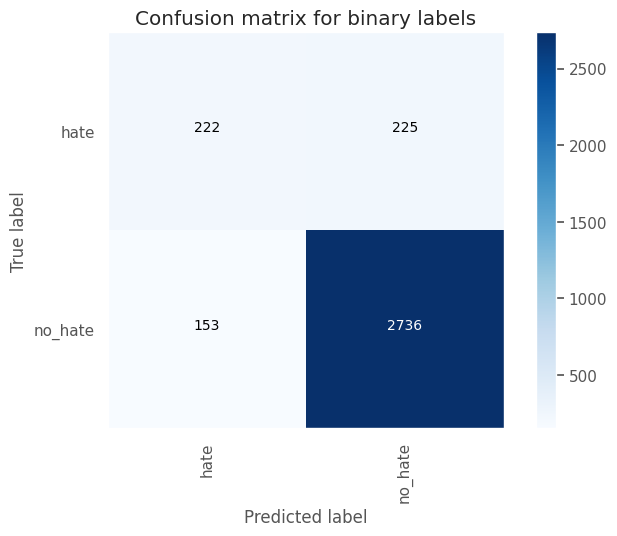

Test Accuracy: 0.8867
Test macro-F1: 0.7378




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_25"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_25 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_50 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_25 (Flatten)        (None, 12800)             0         
                                                                 
 dense_50 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_51 (Dropout)        

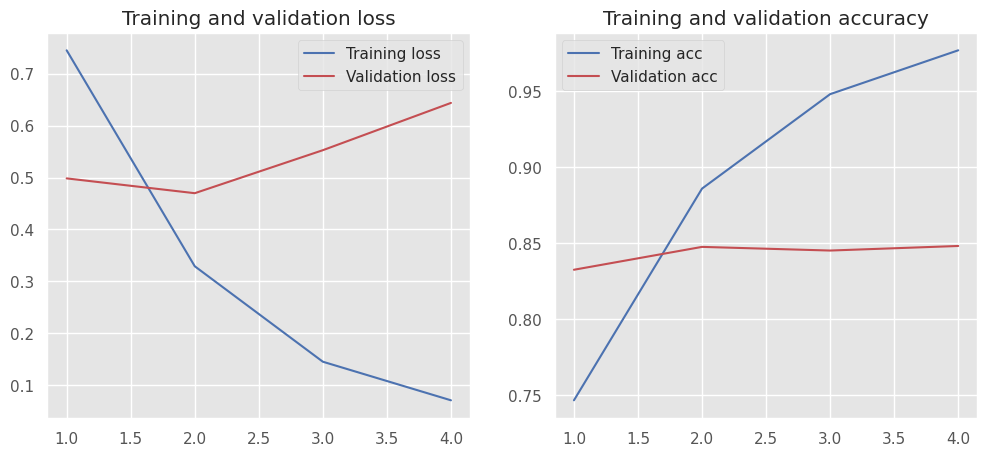

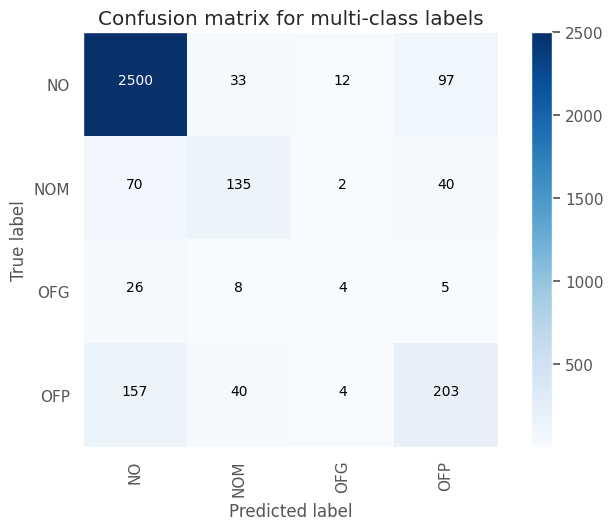

Test Accuracy: 0.8519
Test macro-F1: 0.5438


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5886    0.4832    0.5307       447
     no_hate     0.9222    0.9477    0.9348      2889

    accuracy                         0.8855      3336
   macro avg     0.7554    0.7155    0.7328      3336
weighted avg     0.8775    0.8855    0.8806      3336



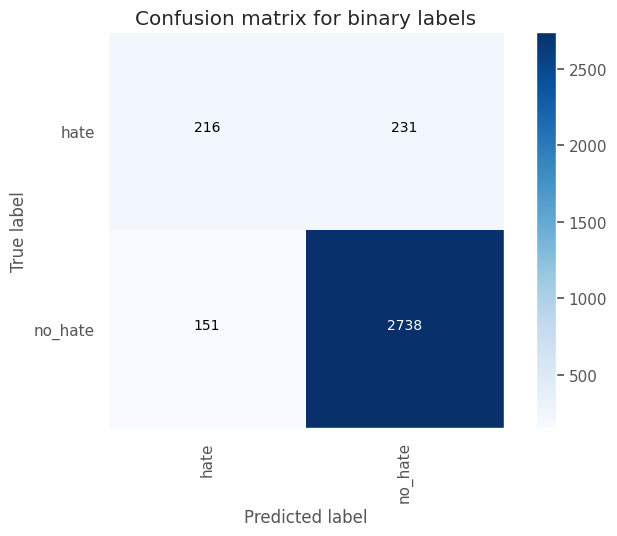

Test Accuracy: 0.8855
Test macro-F1: 0.7328




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_26"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_26 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_52 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_26 (Flatten)        (None, 12800)             0         
                                                                 
 dense_52 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_53 (Dropout)        

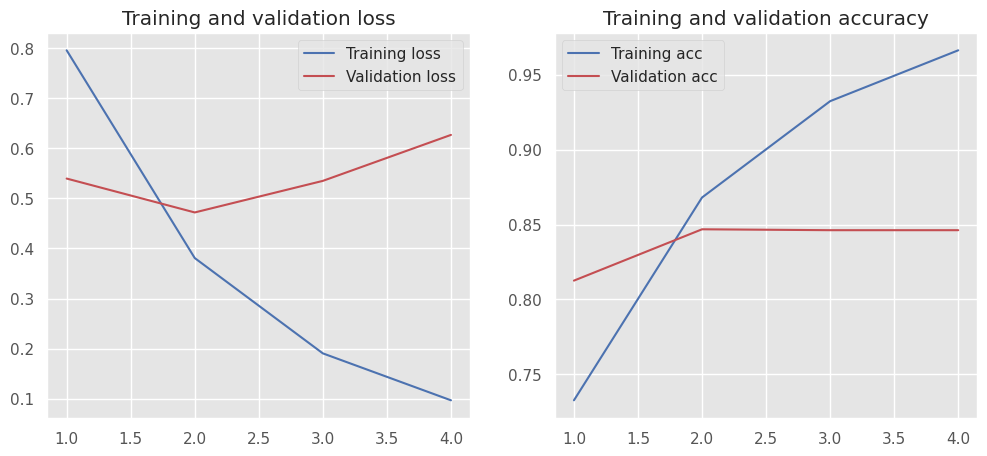

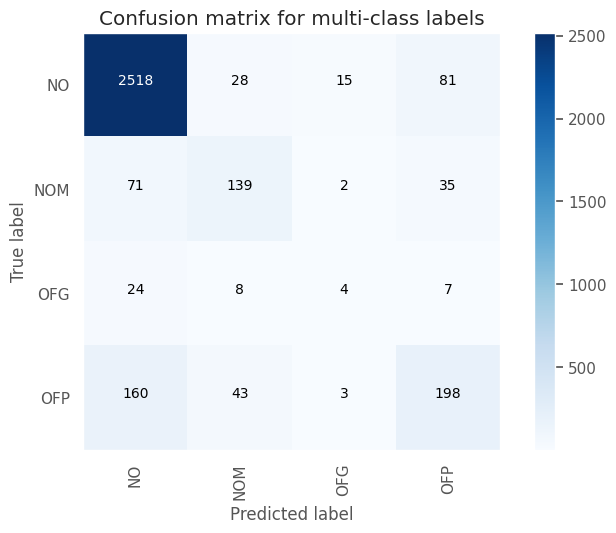

Test Accuracy: 0.857
Test macro-F1: 0.5484


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6145    0.4743    0.5354       447
     no_hate     0.9214    0.9540    0.9374      2889

    accuracy                         0.8897      3336
   macro avg     0.7680    0.7141    0.7364      3336
weighted avg     0.8803    0.8897    0.8835      3336



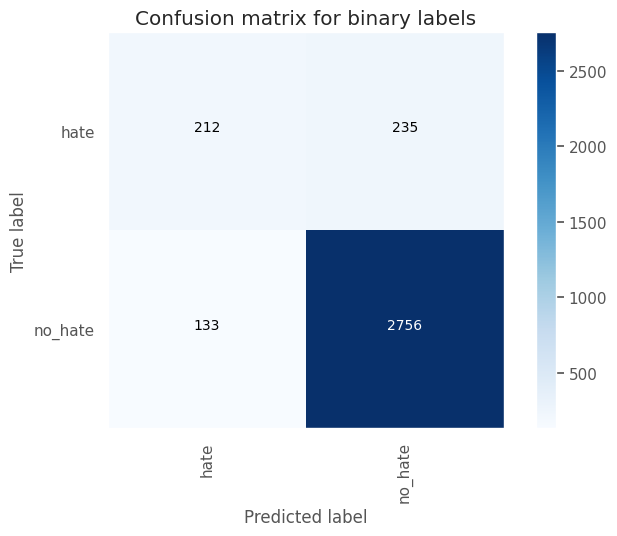

Test Accuracy: 0.8897
Test macro-F1: 0.7364




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_27 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_54 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_27 (Flatten)        (None, 12800)             0         
                                                                 
 dense_54 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_55 (Dropout)        

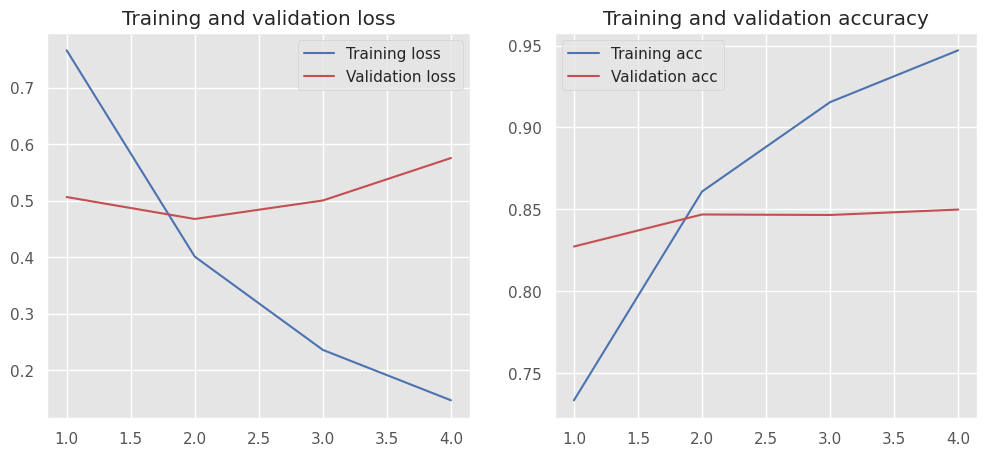

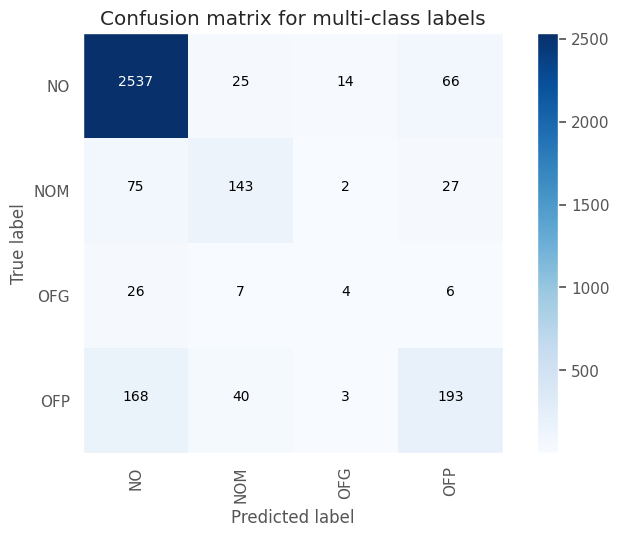

Test Accuracy: 0.8624
Test macro-F1: 0.5566


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6540    0.4609    0.5407       447
     no_hate     0.9202    0.9623    0.9408      2889

    accuracy                         0.8951      3336
   macro avg     0.7871    0.7116    0.7407      3336
weighted avg     0.8845    0.8951    0.8872      3336



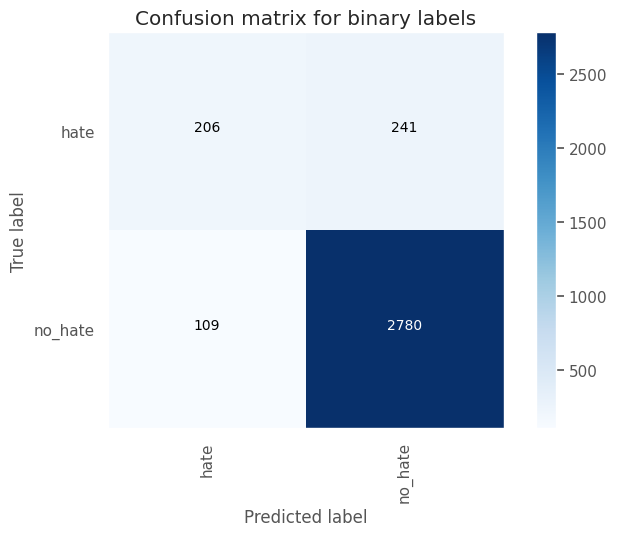

Test Accuracy: 0.8951
Test macro-F1: 0.7407




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_28 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_56 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_28 (Flatten)        (None, 12800)             0         
                                                                 
 dense_56 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_57 (Dropout)        

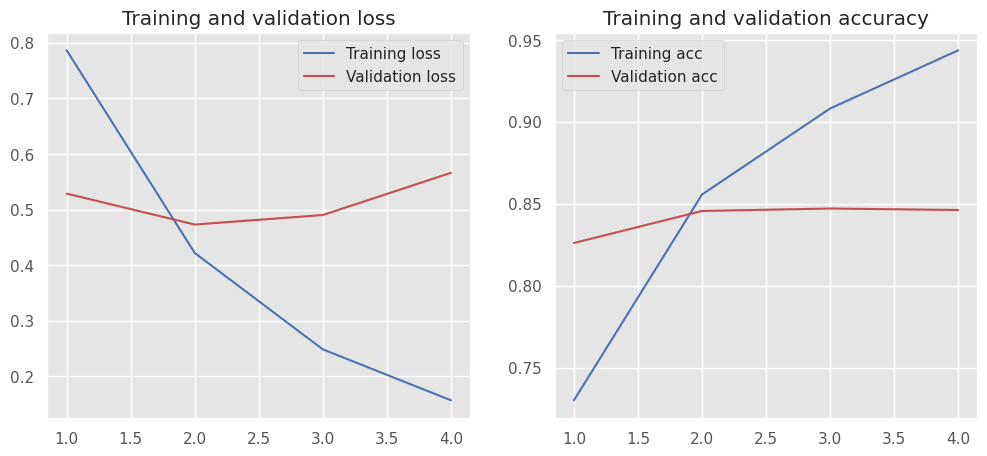

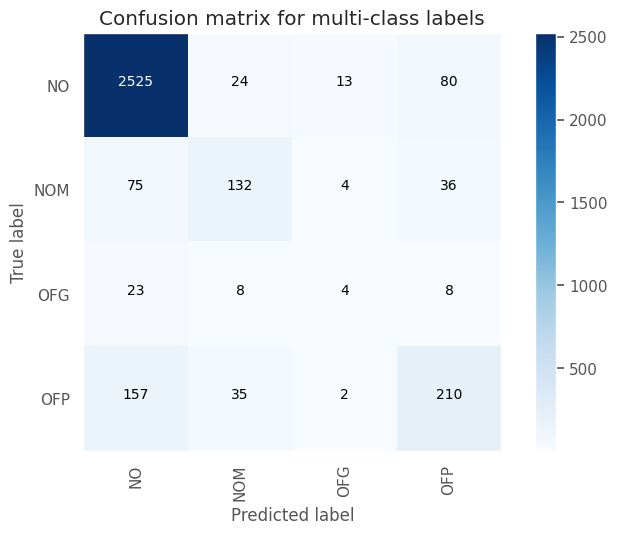

Test Accuracy: 0.8606
Test macro-F1: 0.5534


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6275    0.5011    0.5572       447
     no_hate     0.9251    0.9540    0.9393      2889

    accuracy                         0.8933      3336
   macro avg     0.7763    0.7275    0.7483      3336
weighted avg     0.8853    0.8933    0.8881      3336



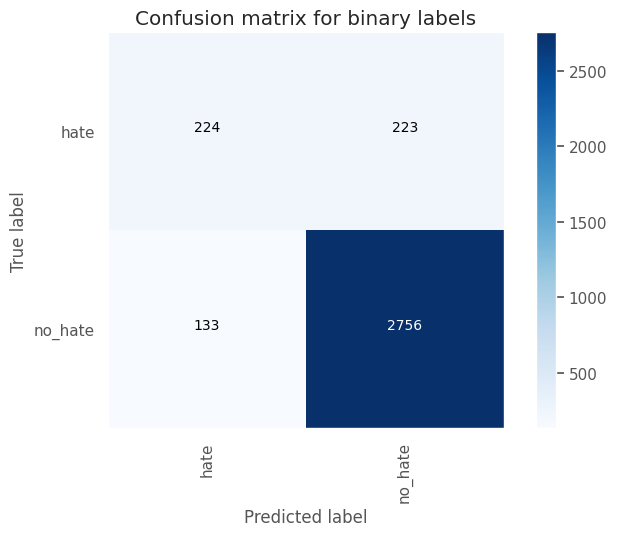

Test Accuracy: 0.8933
Test macro-F1: 0.7483




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_29 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_58 (Dropout)        (None, 128, 100)          0         
                                                                 
 flatten_29 (Flatten)        (None, 12800)             0         
                                                                 
 dense_58 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_59 (Dropout)        

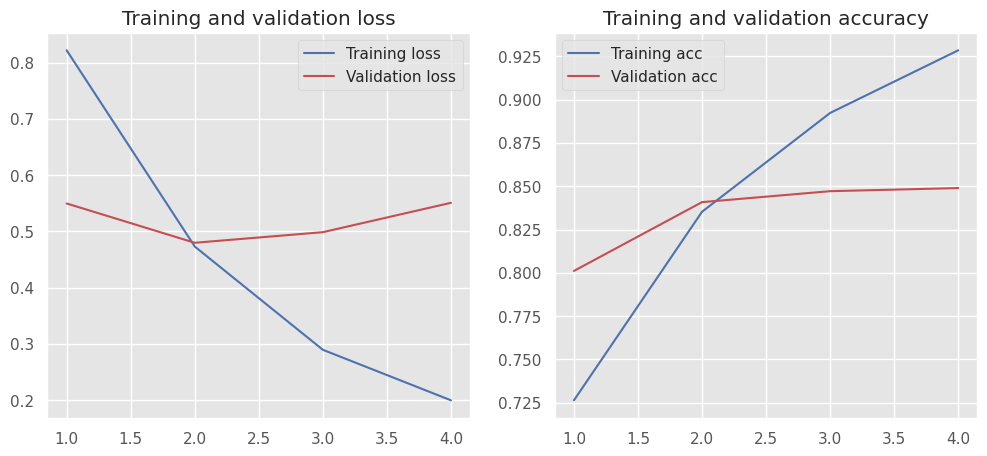

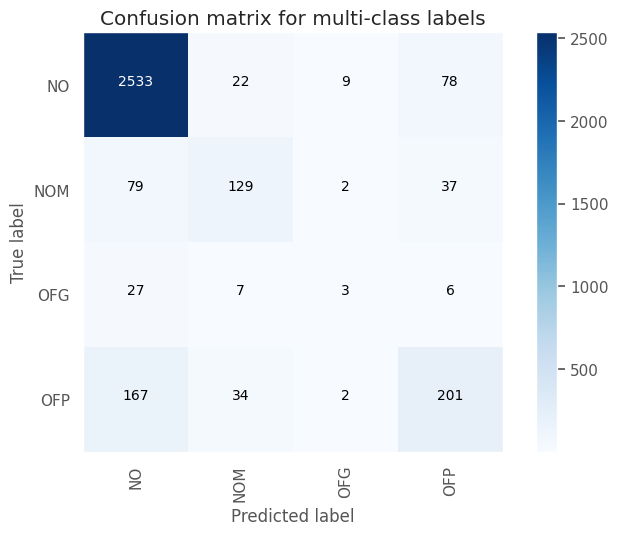

Test Accuracy: 0.8591
Test macro-F1: 0.5432


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6272    0.4743    0.5401       447
     no_hate     0.9216    0.9564    0.9387      2889

    accuracy                         0.8918      3336
   macro avg     0.7744    0.7153    0.7394      3336
weighted avg     0.8822    0.8918    0.8853      3336



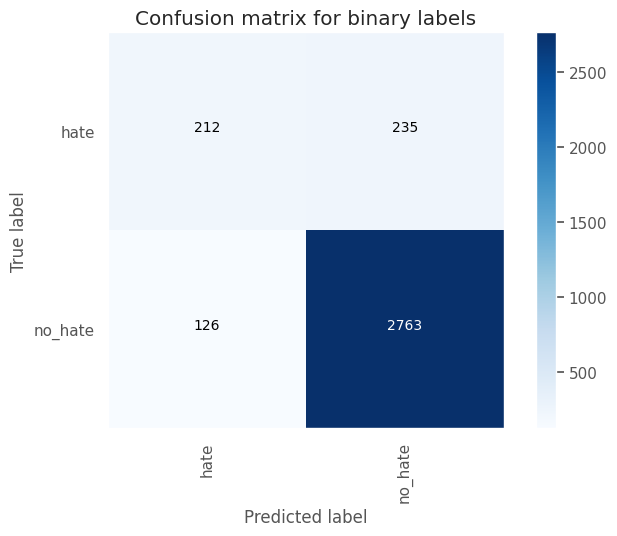

Test Accuracy: 0.8918
Test macro-F1: 0.7394






In [14]:
vocab_size: int = 10000 + 1   # +1 for padding (I was not accounting for it before)
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

for dense_dim in [256]:
    print(f"Training with dense_dim={dense_dim} ==============>")
    for lr in [0.001]:
        for dp_after_emb in [0.5, 0.7]:
            for dp_after_before_class_head in [0.3, 0.5, 0.7]:
                # Define Keras model
                model = Sequential([
                    Embedding(vocab_size, embedding_dim, input_length=max_length),
                    Dropout(dp_after_emb),
                    Flatten(),
                    Dense(dense_dim, activation='relu'),
                    Dropout(dp_after_before_class_head),
                    Dense(4, activation='softmax')
                ])

                # Data
                dataset_folder: str = dataset_v6_folder
                dataset_name: str = "v6"
                data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
                x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], \
                    data[
                        "x_test"], data["y_test"]

                # Train with our class
                trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                        max_input_length=max_length))
                optim_config: OptimizationConfig = OptimizationConfig(
                    epochs=50,
                    batch_size=32,
                    validation_split=0.0,
                    validation_data=(x_val, y_val),
                    optimizer=Adam(learning_rate=lr)
                )
                trainer.train(x_train=x_train,
                              y_train=y_train,
                              opt_config=optim_config,
                              callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
                mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
                mc_report: dict
                bc_report: dict

                # Accumulate result so it can be plotted
                result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                                dataset_version=dataset_name,
                                                model_params=model.count_params(),
                                                optim_config=optim_config,
                                                macro_prec_mc=mc_report["macro avg"]["precision"],
                                                macro_recall_mc=mc_report["macro avg"]["recall"],
                                                macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                                macro_prec_bc=bc_report["macro avg"]["precision"],
                                                macro_recall_bc=bc_report["macro avg"]["recall"],
                                                macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                                )
                results_rep.accumulate(result)

In [15]:
report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)


<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>3</th>
      <td>v6</td>
      <td>{'embedding_27': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_54': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_27': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_54': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_55': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_55': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.6010</td>
      <td>0.5275</td>
      <td>0.5566</td>
      <td>0.7871</td>
      <td>0.7116</td>
      <td>0.7407</td>
    </tr>
    <tr>
      <th>4</th>
      <td>v6</td>
      <td>{'embedding_28': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_56': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_28': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_56': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_57': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_57': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5936</td>
      <td>0.5257</td>
      <td>0.5534</td>
      <td>0.7763</td>
      <td>0.7275</td>
      <td>0.7483</td>
    </tr>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_24': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_48': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_24': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_48': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_49': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_49': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5812</td>
      <td>0.5304</td>
      <td>0.5505</td>
      <td>0.7580</td>
      <td>0.7218</td>
      <td>0.7378</td>
    </tr>
    <tr>
      <th>2</th>
      <td>v6</td>
      <td>{'embedding_26': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_52': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_26': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_52': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_53': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_53': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5823</td>
      <td>0.5247</td>
      <td>0.5484</td>
      <td>0.7680</td>
      <td>0.7141</td>
      <td>0.7364</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_25': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_50': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_25': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_50': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_51': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_51': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5758</td>
      <td>0.5221</td>
      <td>0.5438</td>
      <td>0.7554</td>
      <td>0.7155</td>
      <td>0.7328</td>
    </tr>
    <tr>
      <th>5</th>
      <td>v6</td>
      <td>{'embedding_29': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_58': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'flatten_29': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 12800)}, 'dense_58': {'class_name': 'Dense', 'param_count': 3277056, 'input': (None, 12800), 'output': (None, 256)}, 'dropout_59': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_59': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>4278184</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5966</td>
      <td>0.5121</td>
      <td>0.5432</td>
      <td>0.7744</td>
      <td>0.7153</td>
      <td>0.7394</td>
    </tr>
  </tbody>
</table>
    

En este caso, usando un Dropout de 0.5 luego de la Embedding Layer, y un Dropout de 0.7 luego de la Dense previa a la cabeza de clasificación, obtenemos una performance de **55.66% de macro-f1 (MULTI-CLASS) y 74.07% de macro-f1 (BINARY-CLASS)**, la cual es mejor que la que veníamos obteniendo antes, aunque levemente.

Otro aspecto interesante es ver de reducir la dimensionalidad de salida de la embedding layer, a ver si esa simplificación de la red, nos ayuda a combatir el overfitting.

Training with dense_dim=256 ==============>
Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_30"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_30 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_60 (Dropout)        (None, 128, 50)           0         
                                                                 
 flatten_30 (Flatten)        (None, 6400)              0         
                                                                 
 dense_60 (Dense)            (None, 256)               1638656   
                                                                 
 dropout_61 (Dropout)        (Non

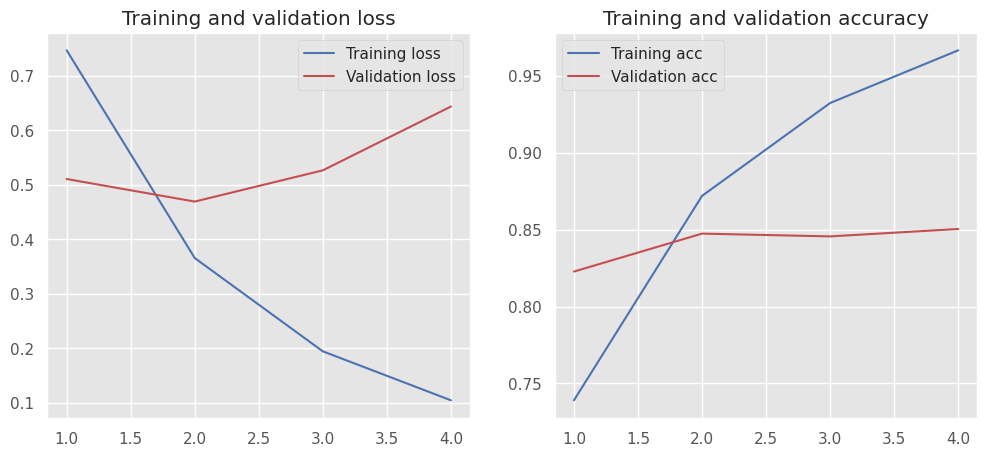

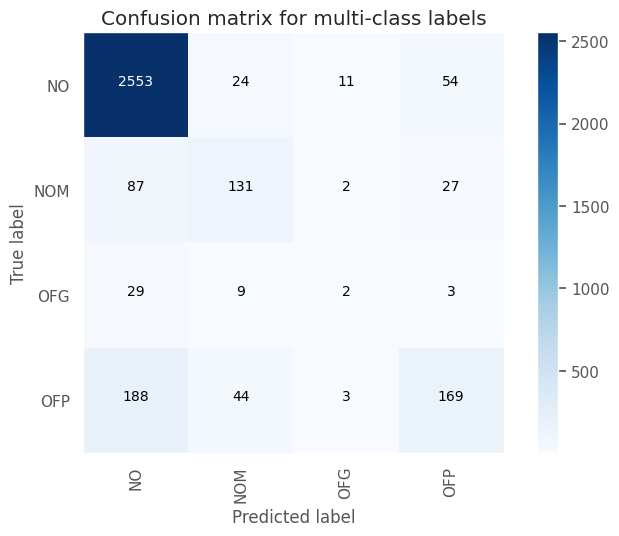

Test Accuracy: 0.8558
Test macro-F1: 0.5211


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6531    0.3960    0.4930       447
     no_hate     0.9119    0.9675    0.9389      2889

    accuracy                         0.8909      3336
   macro avg     0.7825    0.6817    0.7160      3336
weighted avg     0.8772    0.8909    0.8791      3336



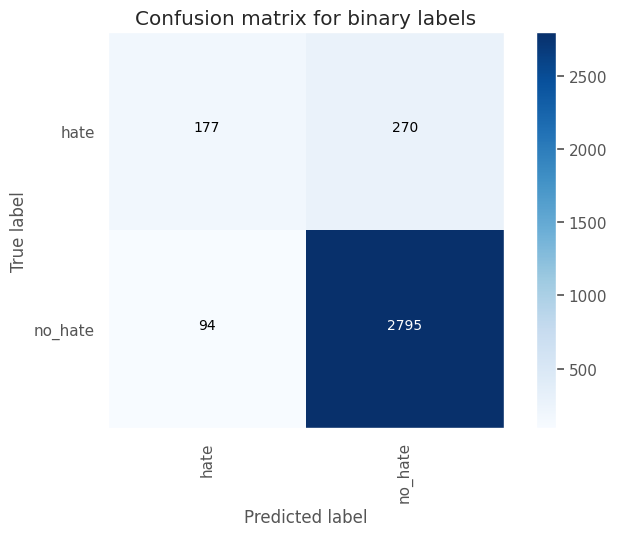

Test Accuracy: 0.8909
Test macro-F1: 0.716




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_31"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_31 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_62 (Dropout)        (None, 128, 50)           0         
                                                                 
 flatten_31 (Flatten)        (None, 6400)              0         
                                                                 
 dense_62 (Dense)            (None, 256)               1638656   
                                                                 
 dropout_63 (Dropout)        (

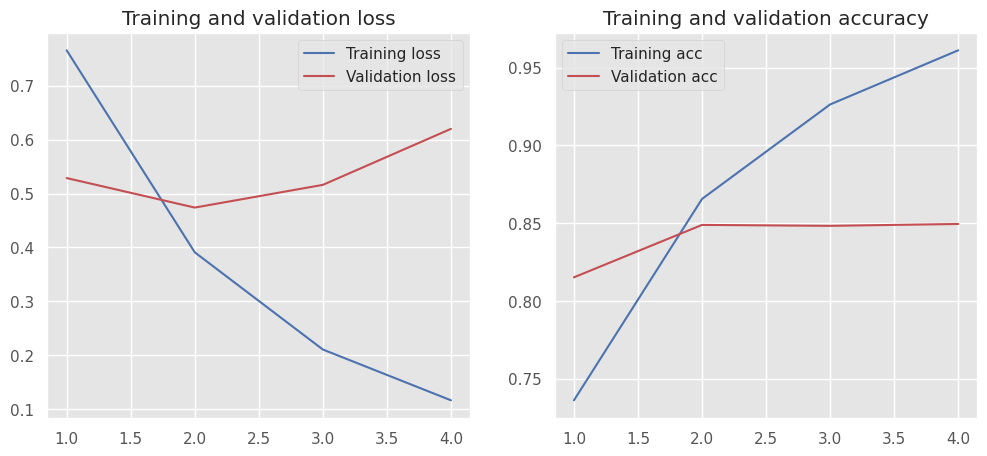

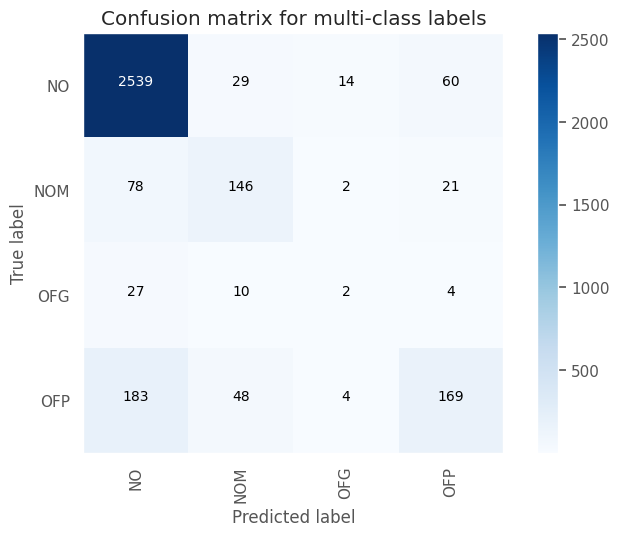

Test Accuracy: 0.8561
Test macro-F1: 0.528


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6486    0.4004    0.4952       447
     no_hate     0.9124    0.9664    0.9386      2889

    accuracy                         0.8906      3336
   macro avg     0.7805    0.6834    0.7169      3336
weighted avg     0.8771    0.8906    0.8792      3336



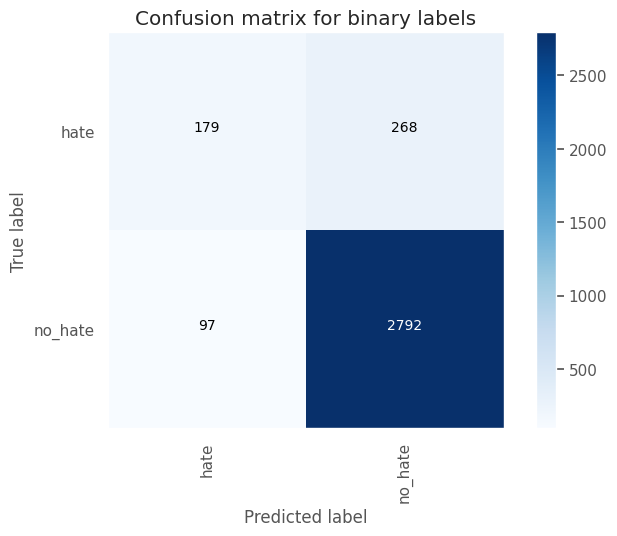

Test Accuracy: 0.8906
Test macro-F1: 0.7169




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_32"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_32 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_64 (Dropout)        (None, 128, 50)           0         
                                                                 
 flatten_32 (Flatten)        (None, 6400)              0         
                                                                 
 dense_64 (Dense)            (None, 256)               1638656   
                                                                 
 dropout_65 (Dropout)        

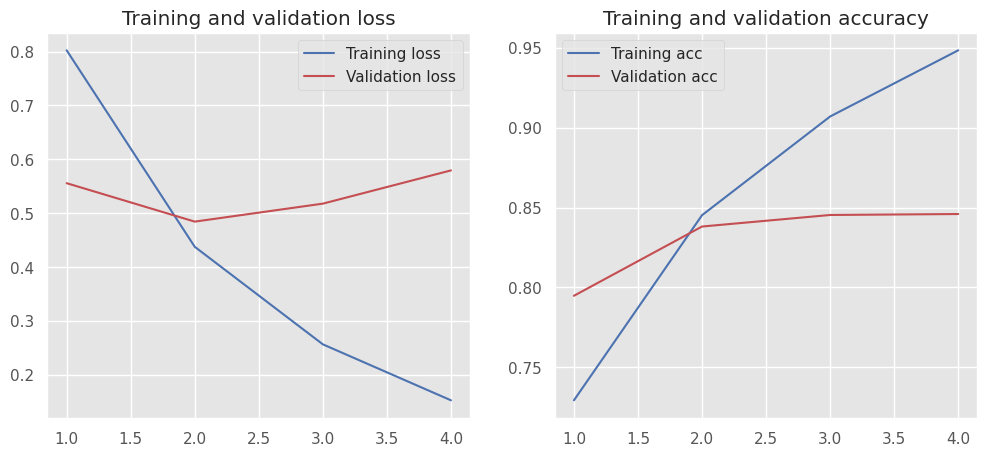

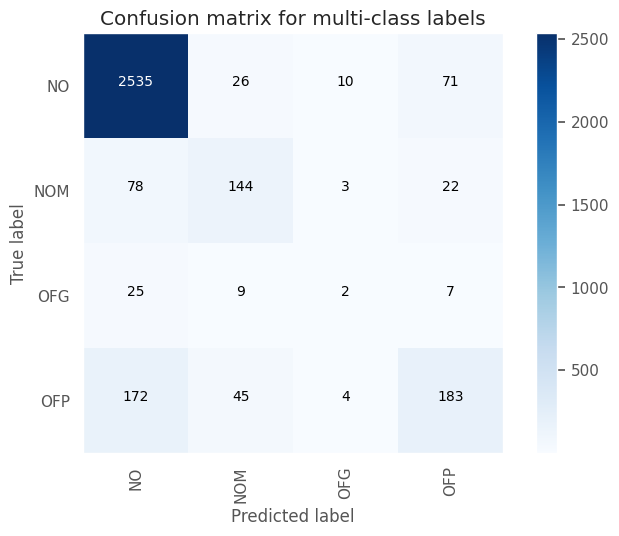

Test Accuracy: 0.8585
Test macro-F1: 0.5347


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6490    0.4385    0.5234       447
     no_hate     0.9173    0.9633    0.9397      2889

    accuracy                         0.8930      3336
   macro avg     0.7831    0.7009    0.7315      3336
weighted avg     0.8813    0.8930    0.8839      3336



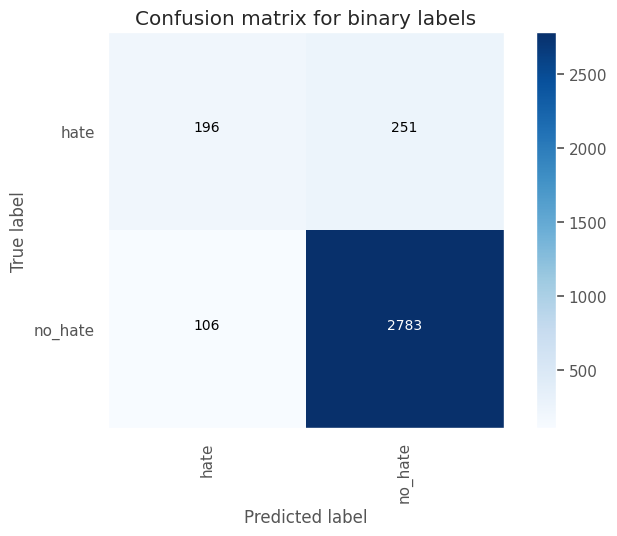

Test Accuracy: 0.893
Test macro-F1: 0.7315




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_33"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_33 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_66 (Dropout)        (None, 128, 50)           0         
                                                                 
 flatten_33 (Flatten)        (None, 6400)              0         
                                                                 
 dense_66 (Dense)            (None, 256)               1638656   
                                                                 
 dropout_67 (Dropout)        (

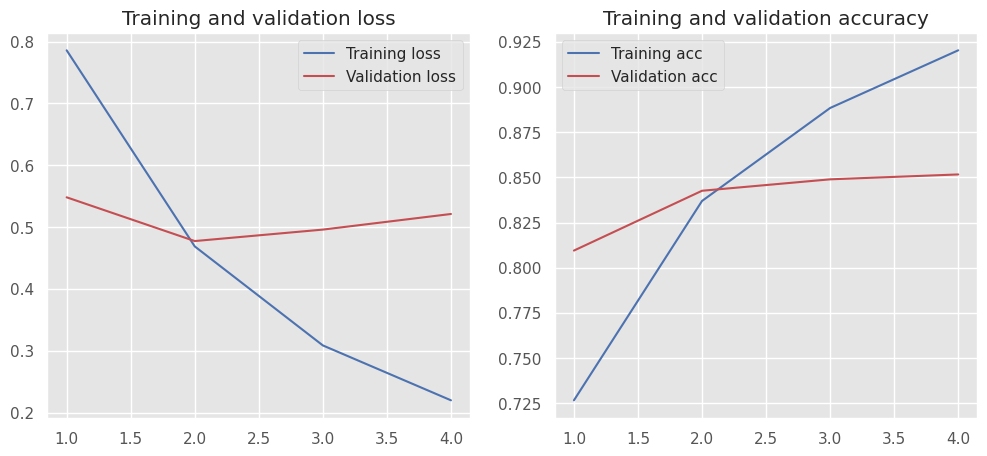

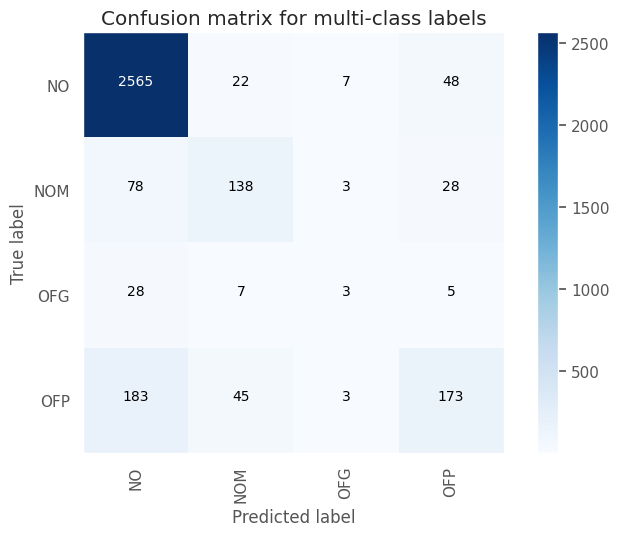

Test Accuracy: 0.863
Test macro-F1: 0.5406


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6815    0.4116    0.5132       447
     no_hate     0.9142    0.9702    0.9414      2889

    accuracy                         0.8954      3336
   macro avg     0.7979    0.6909    0.7273      3336
weighted avg     0.8830    0.8954    0.8840      3336



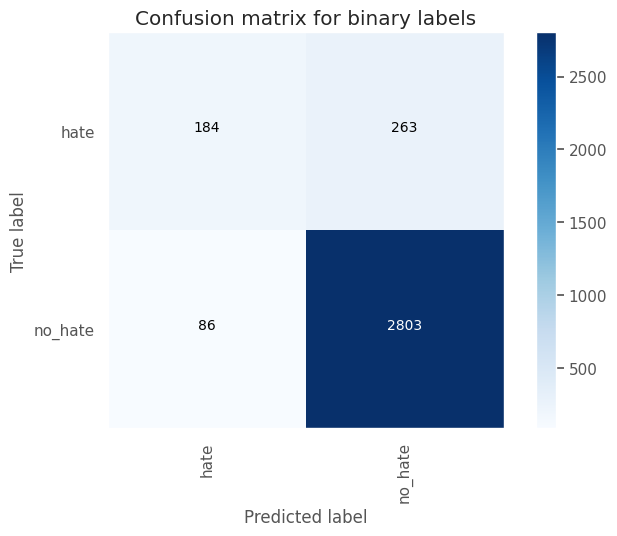

Test Accuracy: 0.8954
Test macro-F1: 0.7273




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_34"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_34 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_68 (Dropout)        (None, 128, 50)           0         
                                                                 
 flatten_34 (Flatten)        (None, 6400)              0         
                                                                 
 dense_68 (Dense)            (None, 256)               1638656   
                                                                 
 dropout_69 (Dropout)        

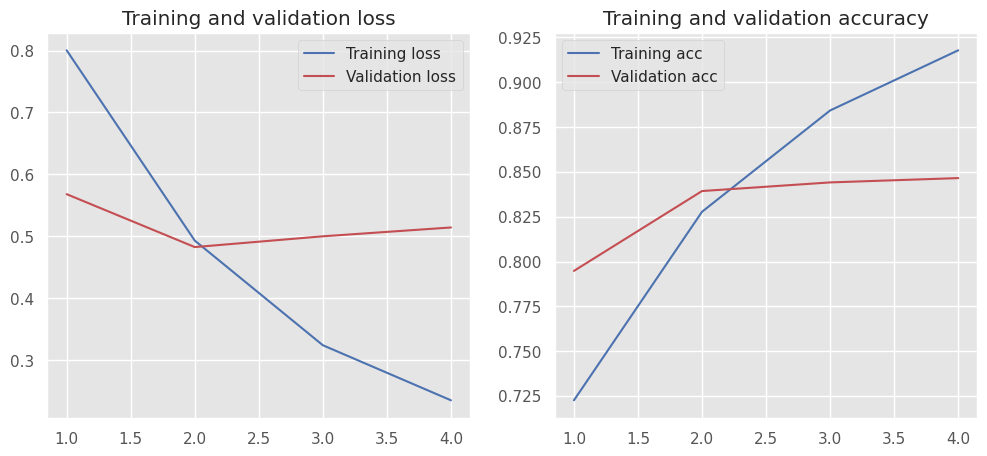

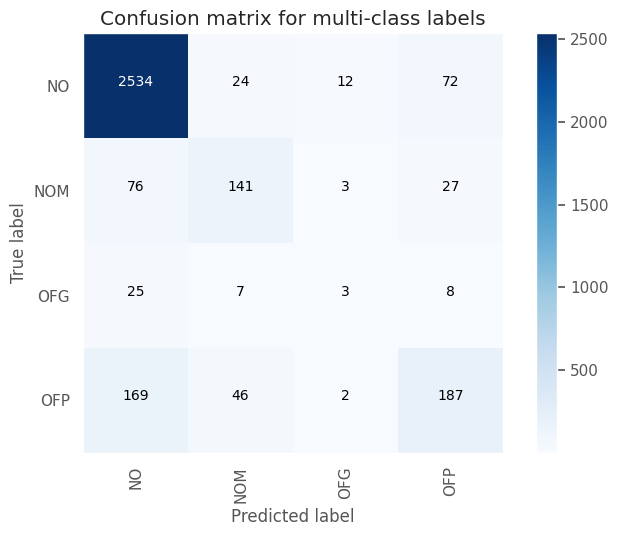

Test Accuracy: 0.8588
Test macro-F1: 0.542


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6369    0.4474    0.5256       447
     no_hate     0.9183    0.9605    0.9389      2889

    accuracy                         0.8918      3336
   macro avg     0.7776    0.7040    0.7323      3336
weighted avg     0.8806    0.8918    0.8835      3336



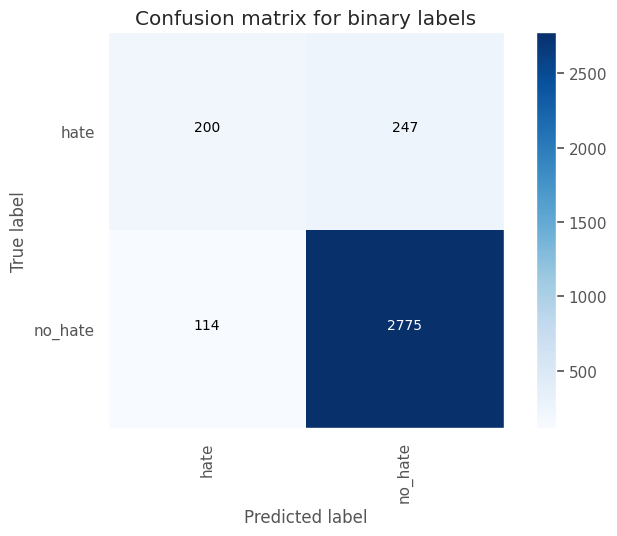

Test Accuracy: 0.8918
Test macro-F1: 0.7323




Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "sequential_35"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_35 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_70 (Dropout)        (None, 128, 50)           0         
                                                                 
 flatten_35 (Flatten)        (None, 6400)              0         
                                                                 
 dense_70 (Dense)            (None, 256)               1638656   
                                                                 
 dropout_71 (Dropout)        

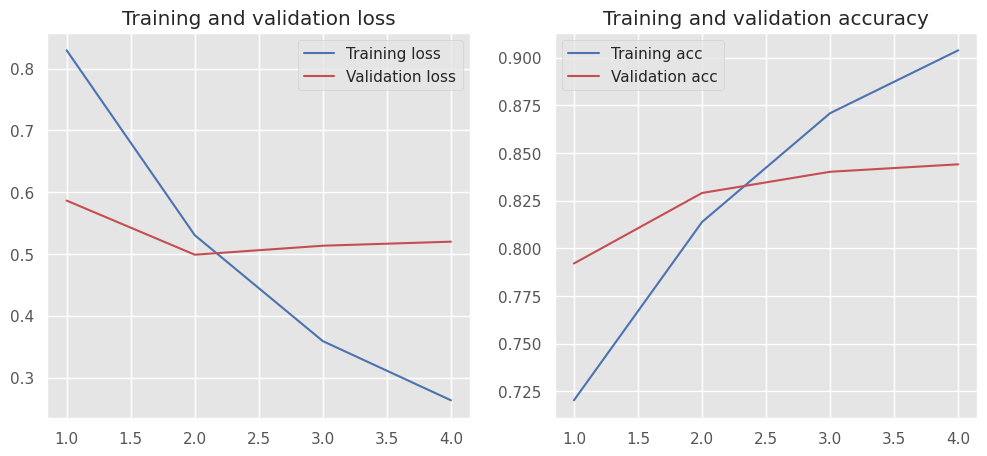

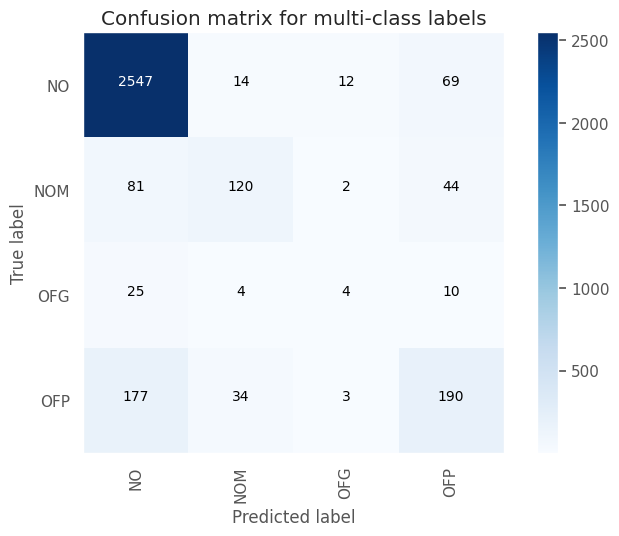

Test Accuracy: 0.8576
Test macro-F1: 0.5397


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6198    0.4631    0.5301       447
     no_hate     0.9201    0.9560    0.9377      2889

    accuracy                         0.8900      3336
   macro avg     0.7699    0.7096    0.7339      3336
weighted avg     0.8798    0.8900    0.8831      3336



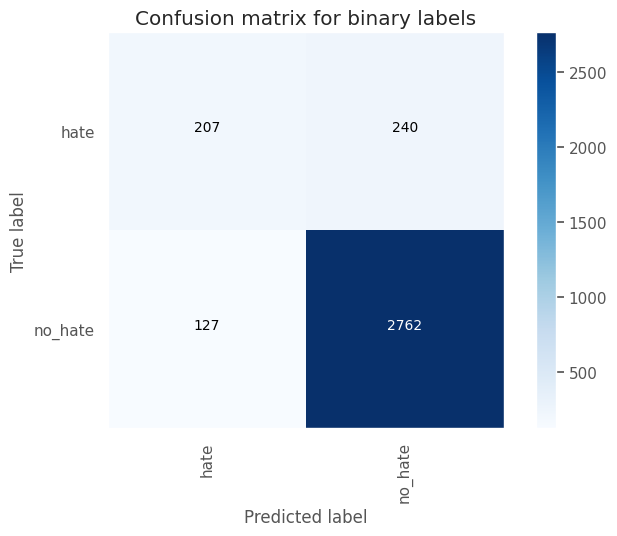

Test Accuracy: 0.89
Test macro-F1: 0.7339






In [16]:
vocab_size: int = 10000 + 1   # +1 for padding (I was not accounting for it before)
max_length: int = 128
embedding_dim: int = 50

results_rep: ResultsReporter = ResultsReporter()

for dense_dim in [256]:
    print(f"Training with dense_dim={dense_dim} ==============>")
    for lr in [0.001]:
        for dp_after_emb in [0.5, 0.7]:
            for dp_after_before_class_head in [0.3, 0.5, 0.7]:
                # Define Keras model
                model = Sequential([
                    Embedding(vocab_size, embedding_dim, input_length=max_length),
                    Dropout(dp_after_emb),
                    Flatten(),
                    Dense(dense_dim, activation='relu'),
                    Dropout(dp_after_before_class_head),
                    Dense(4, activation='softmax')
                ])

                # Data
                dataset_folder: str = dataset_v6_folder
                dataset_name: str = "v6"
                data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
                x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], \
                    data[
                        "x_test"], data["y_test"]

                # Train with our class
                trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                        max_input_length=max_length))
                optim_config: OptimizationConfig = OptimizationConfig(
                    epochs=50,
                    batch_size=32,
                    validation_split=0.0,
                    validation_data=(x_val, y_val),
                    optimizer=Adam(learning_rate=lr)
                )
                trainer.train(x_train=x_train,
                              y_train=y_train,
                              opt_config=optim_config,
                              callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
                mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
                mc_report: dict
                bc_report: dict

                # Accumulate result so it can be plotted
                result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                                dataset_version=dataset_name,
                                                model_params=model.count_params(),
                                                optim_config=optim_config,
                                                macro_prec_mc=mc_report["macro avg"]["precision"],
                                                macro_recall_mc=mc_report["macro avg"]["recall"],
                                                macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                                macro_prec_bc=bc_report["macro avg"]["precision"],
                                                macro_recall_bc=bc_report["macro avg"]["recall"],
                                                macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                                )
                results_rep.accumulate(result)

In [17]:
report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)


<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>4</th>
      <td>v6</td>
      <td>{'embedding_34': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_68': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'flatten_34': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 6400)}, 'dense_68': {'class_name': 'Dense', 'param_count': 1638656, 'input': (None, 6400), 'output': (None, 256)}, 'dropout_69': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_69': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>2139734</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5841</td>
      <td>0.5157</td>
      <td>0.5420</td>
      <td>0.7776</td>
      <td>0.7040</td>
      <td>0.7323</td>
    </tr>
    <tr>
      <th>3</th>
      <td>v6</td>
      <td>{'embedding_33': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_66': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'flatten_33': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 6400)}, 'dense_66': {'class_name': 'Dense', 'param_count': 1638656, 'input': (None, 6400), 'output': (None, 256)}, 'dropout_67': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_67': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>2139734</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.6046</td>
      <td>0.5069</td>
      <td>0.5406</td>
      <td>0.7979</td>
      <td>0.6909</td>
      <td>0.7273</td>
    </tr>
    <tr>
      <th>5</th>
      <td>v6</td>
      <td>{'embedding_35': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_70': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'flatten_35': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 6400)}, 'dense_70': {'class_name': 'Dense', 'param_count': 1638656, 'input': (None, 6400), 'output': (None, 256)}, 'dropout_71': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_71': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>2139734</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5988</td>
      <td>0.5033</td>
      <td>0.5397</td>
      <td>0.7699</td>
      <td>0.7096</td>
      <td>0.7339</td>
    </tr>
    <tr>
      <th>2</th>
      <td>v6</td>
      <td>{'embedding_32': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_64': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'flatten_32': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 6400)}, 'dense_64': {'class_name': 'Dense', 'param_count': 1638656, 'input': (None, 6400), 'output': (None, 256)}, 'dropout_65': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_65': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>2139734</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5742</td>
      <td>0.5105</td>
      <td>0.5347</td>
      <td>0.7831</td>
      <td>0.7009</td>
      <td>0.7315</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_31': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_62': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'flatten_31': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 6400)}, 'dense_62': {'class_name': 'Dense', 'param_count': 1638656, 'input': (None, 6400), 'output': (None, 256)}, 'dropout_63': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_63': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>2139734</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5702</td>
      <td>0.5042</td>
      <td>0.5280</td>
      <td>0.7805</td>
      <td>0.6834</td>
      <td>0.7169</td>
    </tr>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_30': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_60': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'flatten_30': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 6400)}, 'dense_60': {'class_name': 'Dense', 'param_count': 1638656, 'input': (None, 6400), 'output': (None, 256)}, 'dropout_61': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 256), 'output': (None, 256)}, 'dense_61': {'class_name': 'Dense', 'param_count': 1028, 'input': (None, 256), 'output': (None, 4)}}</td>
      <td>2139734</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5756</td>
      <td>0.4904</td>
      <td>0.5211</td>
      <td>0.7825</td>
      <td>0.6817</td>
      <td>0.7160</td>
    </tr>
  </tbody>
</table>
    

Podemos ver que nos pasamos, pruneamos demasiado la red con esta configuración.

Para concluir estas pruebas con DNNs, realizaremos lo mismo, pero utilizando `v8`, el cual es igual a `v6`, con la diferencia de que hemos aplicado Random Over Sampling por encima para balancear la cantidad de samples por clase.

## Entrenando sobre `v8`

Training with dense_dim=128 ==============>
Training with learning_rate=0.001 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_39"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_39 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_39 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_78 (Dense)                │ (31660, 128)           │     1,638,528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_39 (Dropout)            │ (31660, 128)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_79 (Dense)                │ (31660, 4)             │           516 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,139,044 (8.16 MB)

 Trainable params: 2,139,044 (8.16 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 14s 13ms/step - acc: 0.7135 - loss: 0.6561 - val_acc: 0.8531 - val_loss: 0.7536
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - acc: 0.9875 - loss: 0.0380 - val_acc: 0.8408 - val_loss: 1.0051
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 13s 14ms/step - acc: 0.9951 - loss: 0.0146 - val_acc: 0.8342 - val_loss: 1.1561
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.8932    0.9436    0.9177      2642
         NOM     0.7292    0.2834    0.4082       247
         OFG     0.0000    0.0000    0.0000        43
         OFP     0.5078    0.5619    0.5335       404

    accuracy                         0.8363      3336
   macro avg     0.5326    0.4472    0.4648      3336
weighted avg     0.8229    0.8363    0.8216      3336



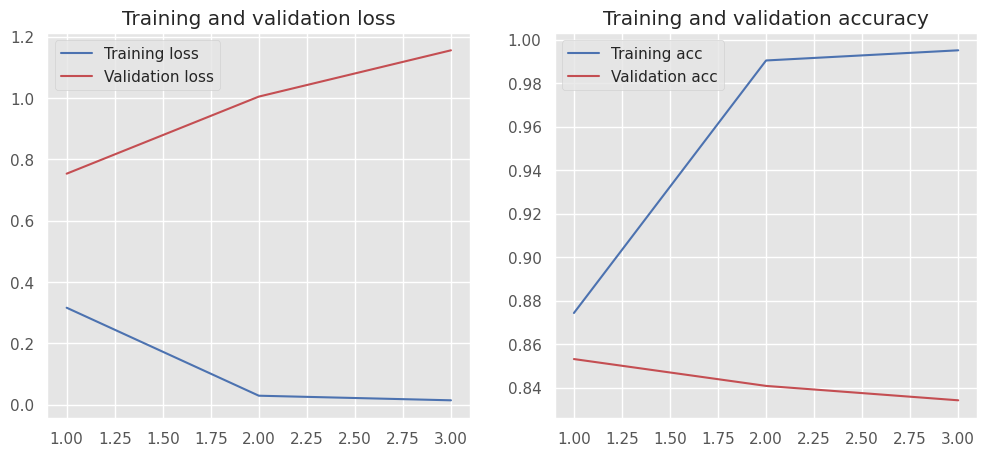

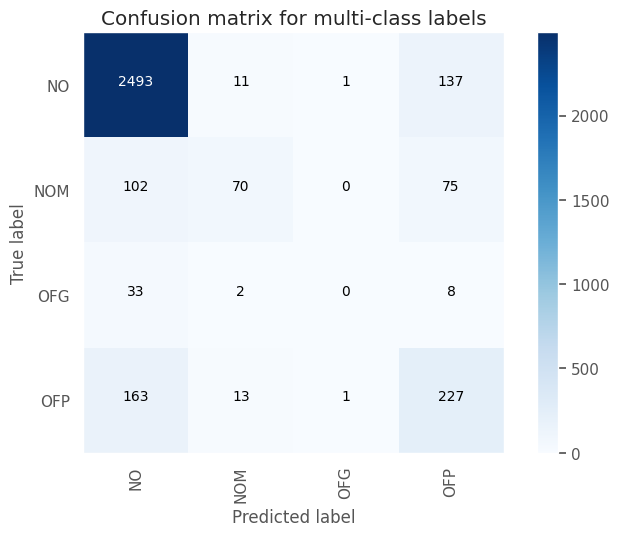

Test Accuracy: 0.8363
Test macro-F1: 0.4648


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5256    0.5280    0.5268       447
     no_hate     0.9269    0.9263    0.9266      2889

    accuracy                         0.8729      3336
   macro avg     0.7263    0.7271    0.7267      3336
weighted avg     0.8731    0.8729    0.8730      3336



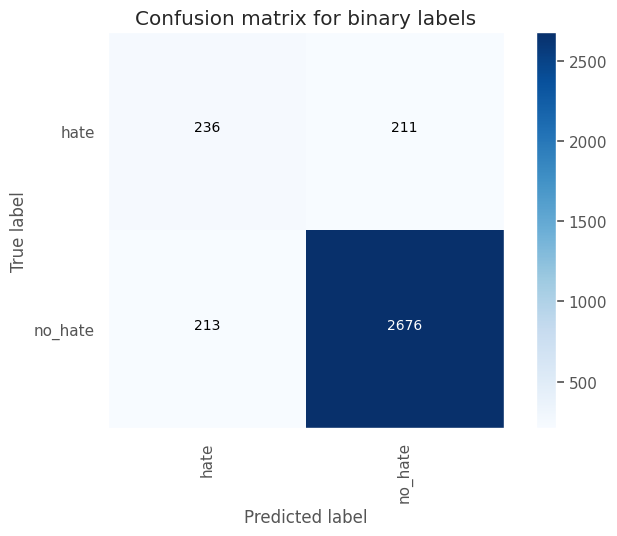

Test Accuracy: 0.8729
Test macro-F1: 0.7267




Training with learning_rate=0.00025 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_40"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_40 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_40 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_80 (Dense)                │ (31660, 128)           │     1,638,528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_40 (Dropout)            │ (31660, 128)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_81 (Dense)                │ (31660, 4)             │           516 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,139,044 (8.16 MB)

 Trainable params: 2,139,044 (8.16 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 16s 15ms/step - acc: 0.4978 - loss: 1.0746 - val_acc: 0.8360 - val_loss: 0.5093
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 15s 15ms/step - acc: 0.9469 - loss: 0.1713 - val_acc: 0.8501 - val_loss: 0.6086
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 15s 15ms/step - acc: 0.9846 - loss: 0.0546 - val_acc: 0.8462 - val_loss: 0.6806
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9106    0.9440    0.9270      2642
         NOM     0.7066    0.4777    0.5700       247
         OFG     0.0000    0.0000    0.0000        43
         OFP     0.5785    0.6114    0.5945       404

    accuracy                         0.8570      3336
   macro avg     0.5489    0.5083    0.5229      3336
weighted avg     0.8435    0.8570    0.8483      3336



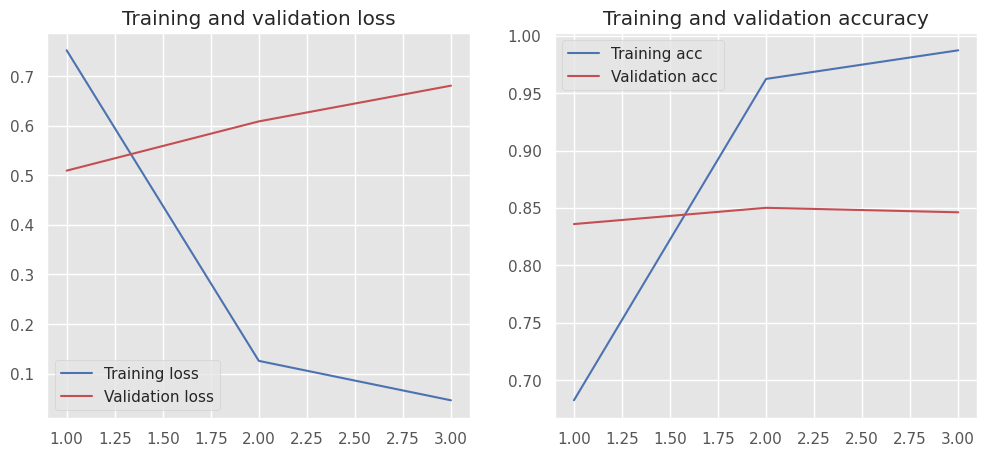

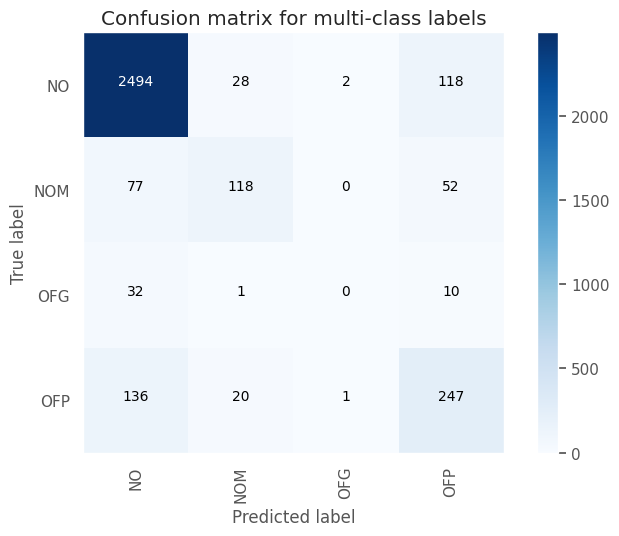

Test Accuracy: 0.857
Test macro-F1: 0.5229


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6000    0.5772    0.5884       447
     no_hate     0.9350    0.9405    0.9377      2889

    accuracy                         0.8918      3336
   macro avg     0.7675    0.7588    0.7630      3336
weighted avg     0.8901    0.8918    0.8909      3336



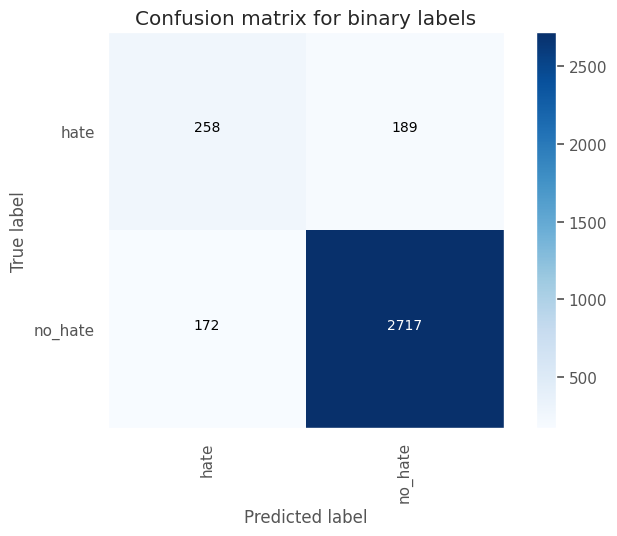

Test Accuracy: 0.8918
Test macro-F1: 0.763




Training with learning_rate=0.000125 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_41"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_41 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_41 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_82 (Dense)                │ (31660, 128)           │     1,638,528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_41 (Dropout)            │ (31660, 128)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_83 (Dense)                │ (31660, 4)             │           516 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,139,044 (8.16 MB)

 Trainable params: 2,139,044 (8.16 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 16s 15ms/step - acc: 0.4394 - loss: 1.1955 - val_acc: 0.7725 - val_loss: 0.7012
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 15s 15ms/step - acc: 0.8835 - loss: 0.3691 - val_acc: 0.8396 - val_loss: 0.4916
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 15s 15ms/step - acc: 0.9668 - loss: 0.1209 - val_acc: 0.8429 - val_loss: 0.5369
Epoch 4/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 15s 15ms/step - acc: 0.9836 - loss: 0.0631 - val_acc: 0.8486 - val_loss: 0.5880
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9088    0.9466    0.9273      2642
         NOM     0.6809    0.5182    0.5885       247
         OFG     0.0000    0.0000    0.0000        43
         OFP     0.5852    0.5693    0.5772       404

    accuracy                         0.8570      3336
   macro 

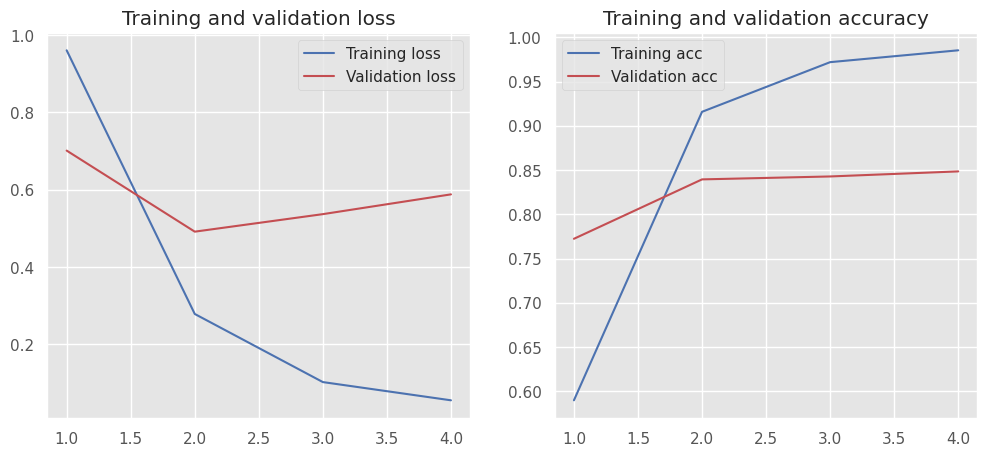

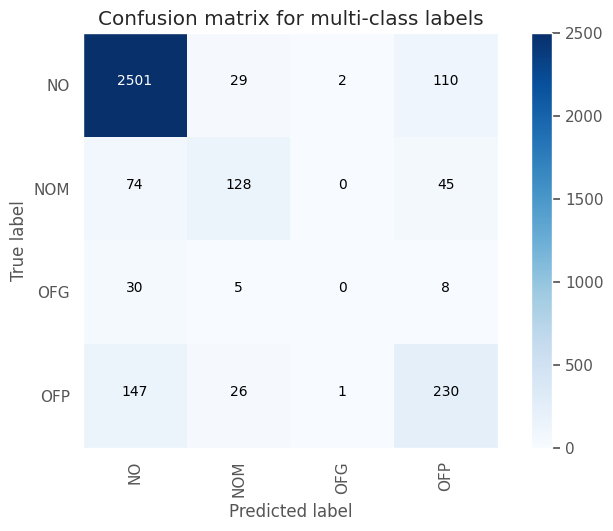

Test Accuracy: 0.857
Test macro-F1: 0.5232


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6035    0.5347    0.5670       447
     no_hate     0.9293    0.9457    0.9374      2889

    accuracy                         0.8906      3336
   macro avg     0.7664    0.7402    0.7522      3336
weighted avg     0.8856    0.8906    0.8878      3336



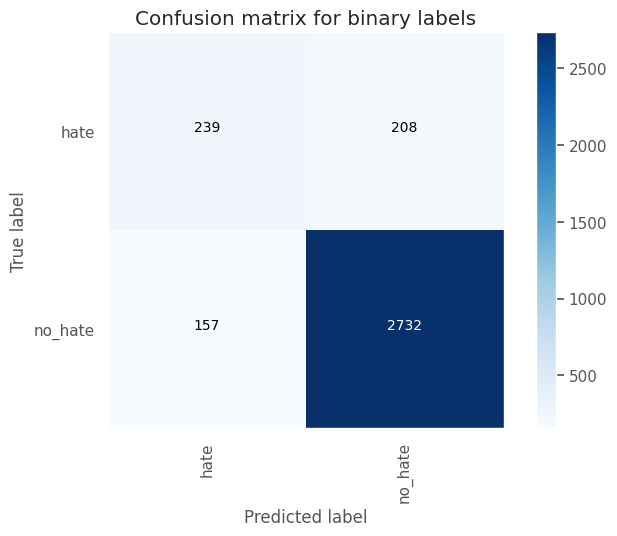

Test Accuracy: 0.8906
Test macro-F1: 0.7522




Training with dense_dim=256 ==============>
Training with learning_rate=0.001 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_42"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_42 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_42 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_84 (Dense)                │ (31660, 256)           │     3,277,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_42 (Dropout)            │ (31660, 256)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_85 (Dense)                │ (31660, 4)             │         1,028 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,778,084 (14.41 MB)

 Trainable params: 3,778,084 (14.41 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 29s 28ms/step - acc: 0.7439 - loss: 0.5930 - val_acc: 0.8450 - val_loss: 0.9384
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 27s 27ms/step - acc: 0.9874 - loss: 0.0367 - val_acc: 0.8357 - val_loss: 1.0780
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 29s 29ms/step - acc: 0.9951 - loss: 0.0142 - val_acc: 0.8288 - val_loss: 1.4042
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.8849    0.9576    0.9198      2642
         NOM     0.7647    0.2105    0.3302       247
         OFG     0.0000    0.0000    0.0000        43
         OFP     0.5271    0.5297    0.5284       404

    accuracy                         0.8381      3336
   macro avg     0.5442    0.4245    0.4446      3336
weighted avg     0.8213    0.8381    0.8169      3336



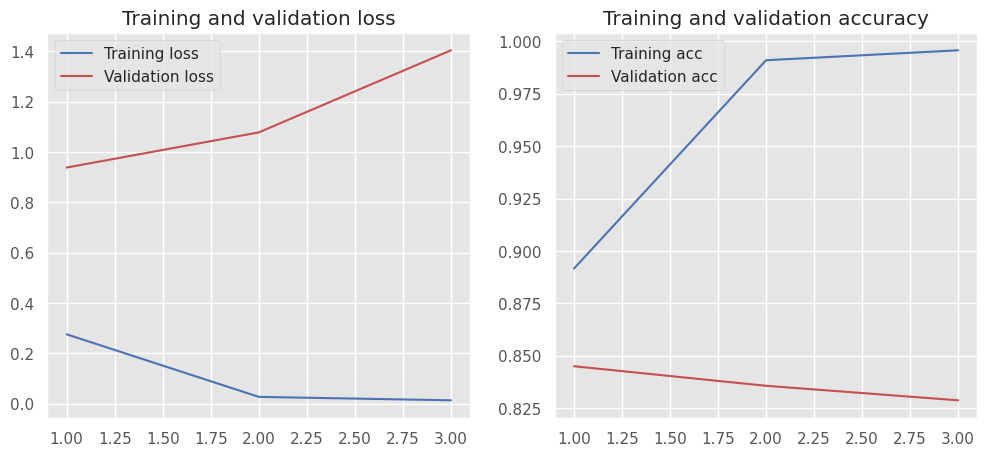

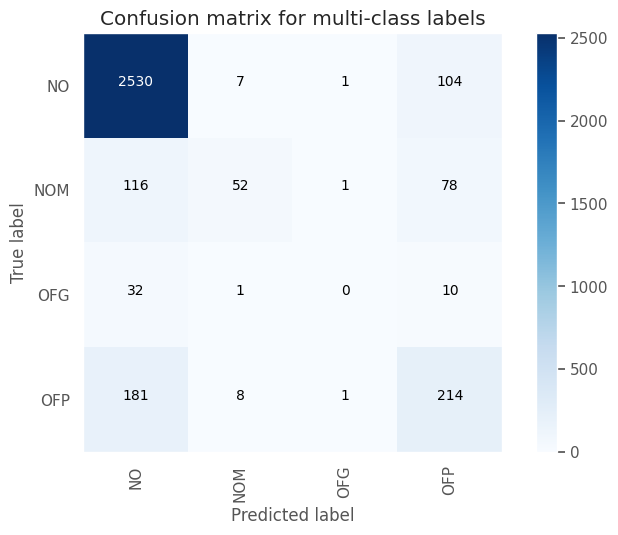

Test Accuracy: 0.8381
Test macro-F1: 0.4446


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5501    0.5034    0.5257       447
     no_hate     0.9242    0.9363    0.9302      2889

    accuracy                         0.8783      3336
   macro avg     0.7371    0.7198    0.7279      3336
weighted avg     0.8740    0.8783    0.8760      3336



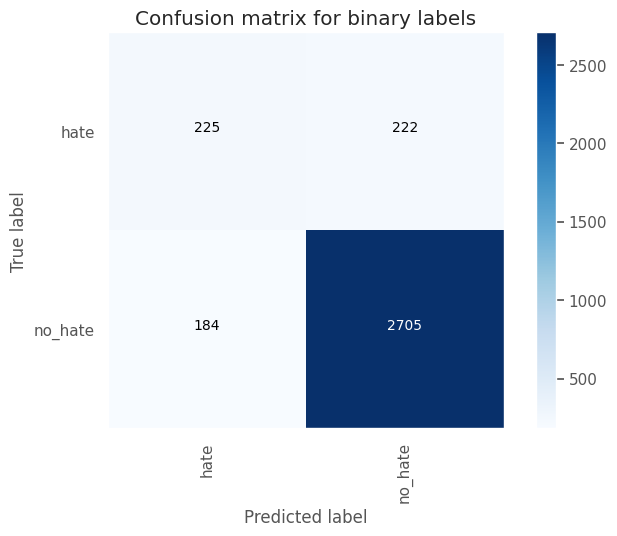

Test Accuracy: 0.8783
Test macro-F1: 0.7279




Training with learning_rate=0.00025 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_43"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_43 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_43 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_86 (Dense)                │ (31660, 256)           │     3,277,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_43 (Dropout)            │ (31660, 256)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_87 (Dense)                │ (31660, 4)             │         1,028 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,778,084 (14.41 MB)

 Trainable params: 3,778,084 (14.41 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 28s 28ms/step - acc: 0.5352 - loss: 1.0151 - val_acc: 0.8396 - val_loss: 0.4985
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 28s 28ms/step - acc: 0.9620 - loss: 0.1273 - val_acc: 0.8525 - val_loss: 0.6304
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 26s 26ms/step - acc: 0.9888 - loss: 0.0396 - val_acc: 0.8489 - val_loss: 0.7172
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9019    0.9497    0.9251      2642
         NOM     0.6857    0.4858    0.5687       247
         OFG     0.0000    0.0000    0.0000        43
         OFP     0.5878    0.5470    0.5667       404

    accuracy                         0.8543      3336
   macro avg     0.5438    0.4956    0.5151      3336
weighted avg     0.8362    0.8543    0.8434      3336



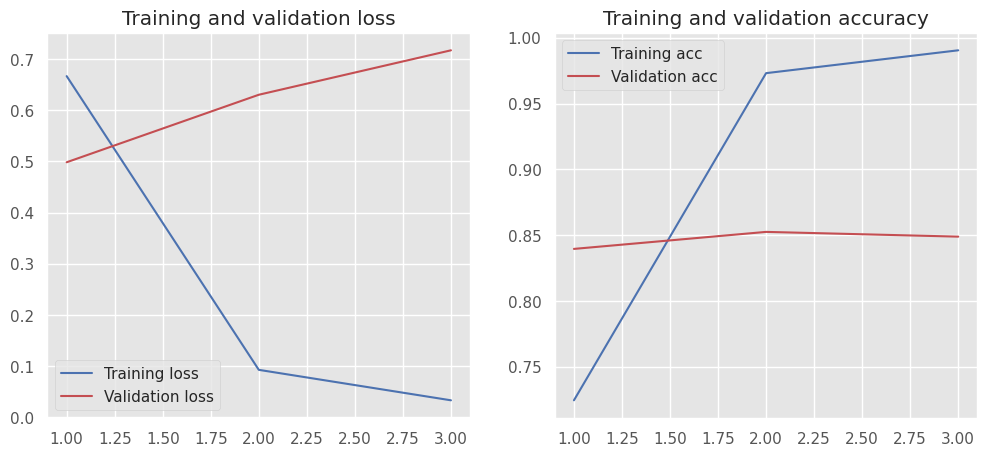

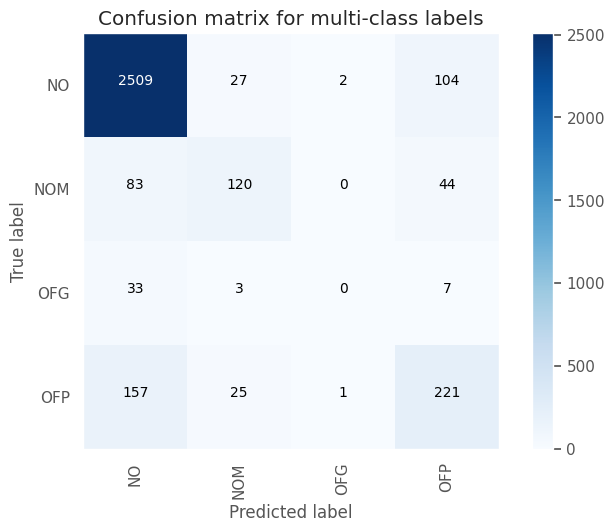

Test Accuracy: 0.8543
Test macro-F1: 0.5151


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6042    0.5123    0.5545       447
     no_hate     0.9263    0.9481    0.9371      2889

    accuracy                         0.8897      3336
   macro avg     0.7652    0.7302    0.7458      3336
weighted avg     0.8831    0.8897    0.8858      3336



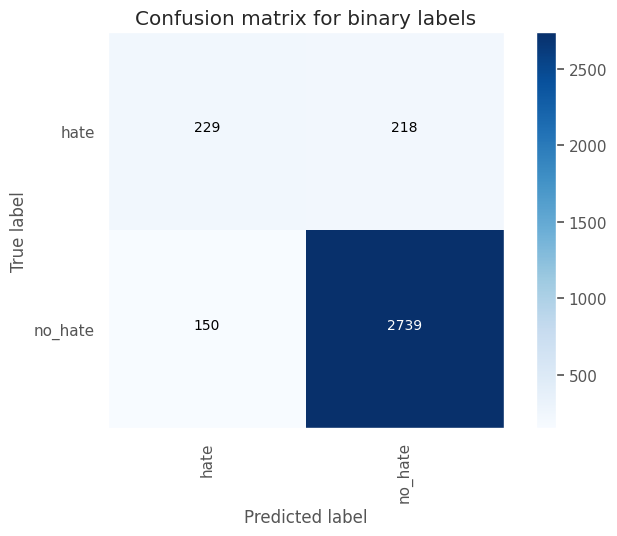

Test Accuracy: 0.8897
Test macro-F1: 0.7458




Training with learning_rate=0.000125 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_44"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_44 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_44 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_88 (Dense)                │ (31660, 256)           │     3,277,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_44 (Dropout)            │ (31660, 256)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_89 (Dense)                │ (31660, 4)             │         1,028 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,778,084 (14.41 MB)

 Trainable params: 3,778,084 (14.41 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 27s 27ms/step - acc: 0.4568 - loss: 1.1671 - val_acc: 0.7869 - val_loss: 0.6443
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 26s 26ms/step - acc: 0.9066 - loss: 0.3053 - val_acc: 0.8417 - val_loss: 0.4995
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 26s 27ms/step - acc: 0.9743 - loss: 0.0954 - val_acc: 0.8498 - val_loss: 0.5628
Epoch 4/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 26s 26ms/step - acc: 0.9877 - loss: 0.0475 - val_acc: 0.8471 - val_loss: 0.6338
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9095    0.9466    0.9277      2642
         NOM     0.6940    0.5142    0.5907       247
         OFG     0.0000    0.0000    0.0000        43
         OFP     0.5935    0.5891    0.5913       404

    accuracy                         0.8591      3336
   macro 

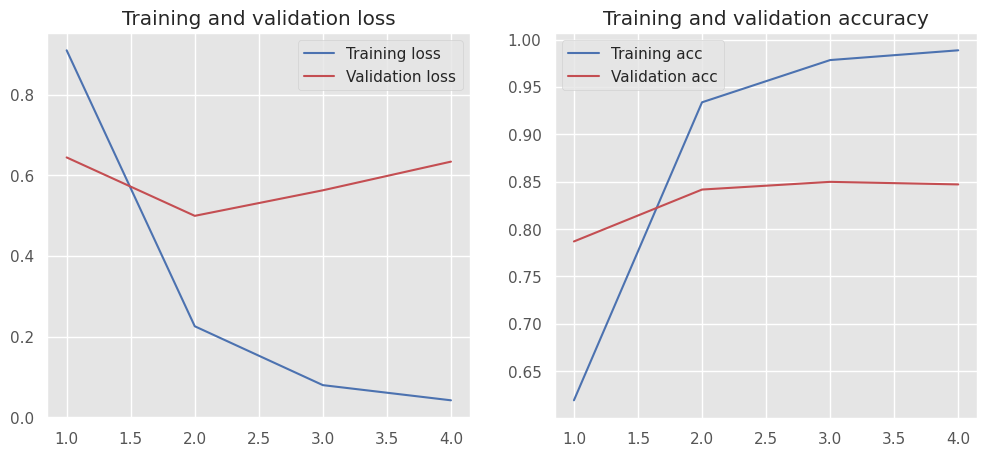

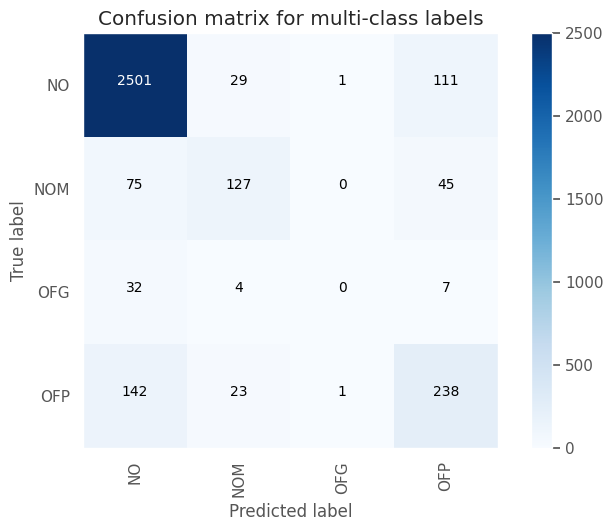

Test Accuracy: 0.8591
Test macro-F1: 0.5274


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6104    0.5503    0.5788       447
     no_hate     0.9315    0.9457    0.9385      2889

    accuracy                         0.8927      3336
   macro avg     0.7709    0.7480    0.7587      3336
weighted avg     0.8885    0.8927    0.8903      3336



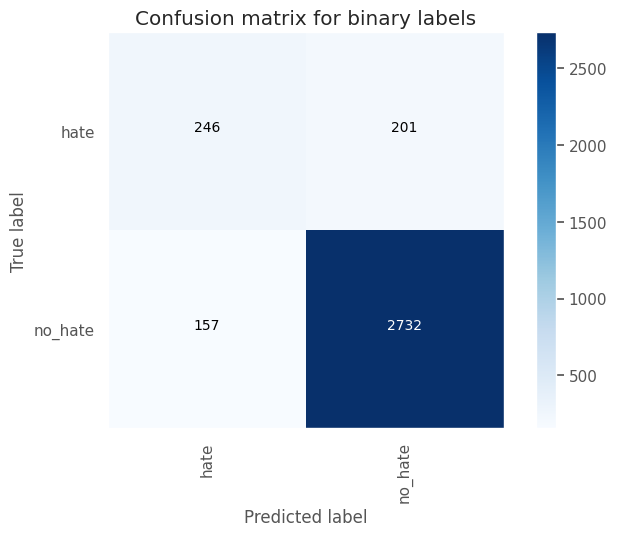

Test Accuracy: 0.8927
Test macro-F1: 0.7587




Training with dense_dim=512 ==============>
Training with learning_rate=0.001 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_45"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_45 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_45 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_90 (Dense)                │ (31660, 512)           │     6,554,112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_45 (Dropout)            │ (31660, 512)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_91 (Dense)                │ (31660, 4)             │         2,052 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,056,164 (26.92 MB)

 Trainable params: 7,056,164 (26.92 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 47s 46ms/step - acc: 0.7664 - loss: 0.5448 - val_acc: 0.8459 - val_loss: 0.8871
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 46s 46ms/step - acc: 0.9892 - loss: 0.0328 - val_acc: 0.8342 - val_loss: 1.0637
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 47s 48ms/step - acc: 0.9950 - loss: 0.0139 - val_acc: 0.8231 - val_loss: 1.2145
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.8906    0.9432    0.9162      2642
         NOM     0.7656    0.1984    0.3151       247
         OFG     0.0000    0.0000    0.0000        43
         OFP     0.4979    0.5792    0.5355       404

    accuracy                         0.8318      3336
   macro avg     0.5385    0.4302    0.4417      3336
weighted avg     0.8223    0.8318    0.8138      3336



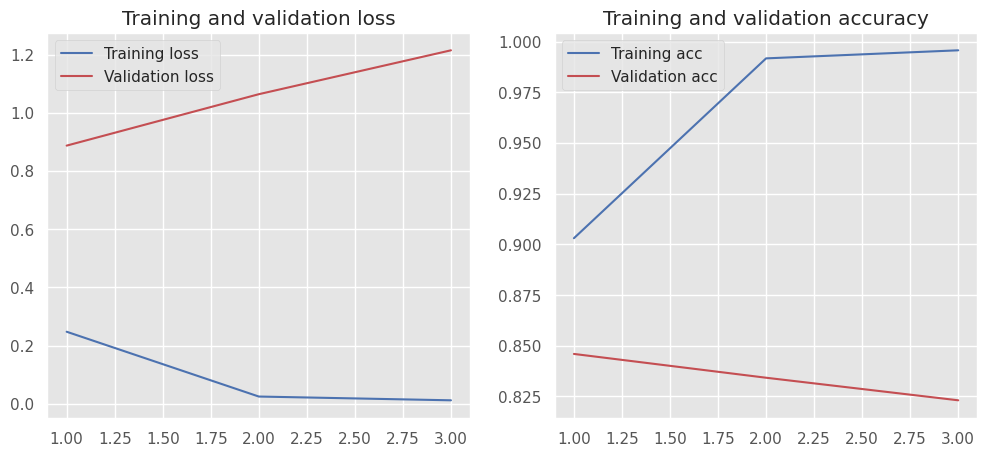

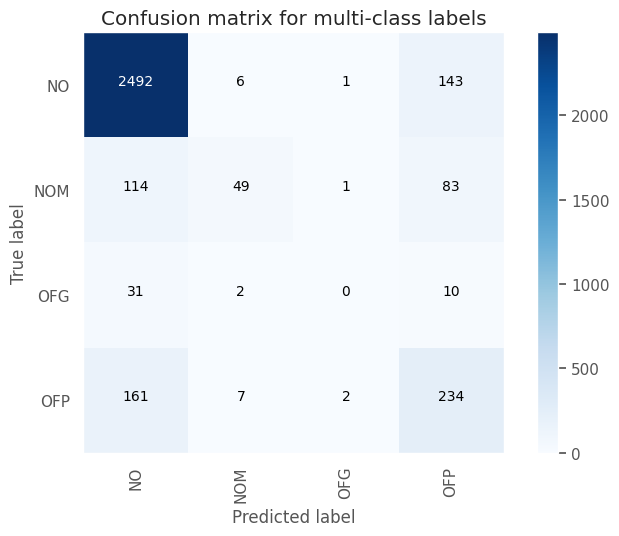

Test Accuracy: 0.8318
Test macro-F1: 0.4417


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5190    0.5503    0.5342       447
     no_hate     0.9298    0.9211    0.9254      2889

    accuracy                         0.8714      3336
   macro avg     0.7244    0.7357    0.7298      3336
weighted avg     0.8747    0.8714    0.8730      3336



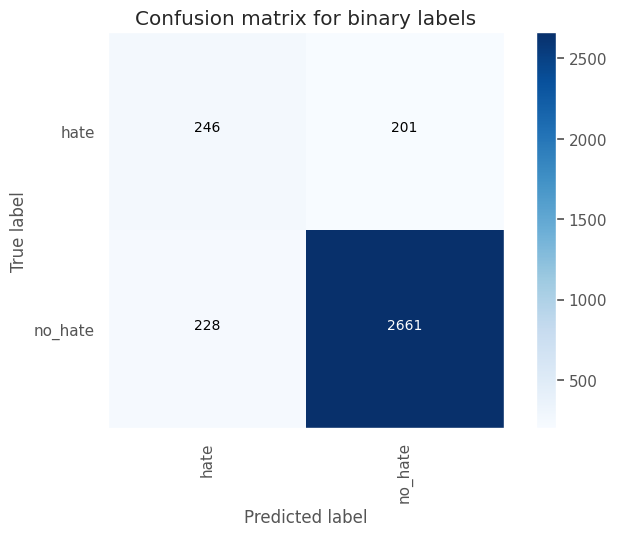

Test Accuracy: 0.8714
Test macro-F1: 0.7298




Training with learning_rate=0.00025 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_46"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_46 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_46 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_92 (Dense)                │ (31660, 512)           │     6,554,112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_46 (Dropout)            │ (31660, 512)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_93 (Dense)                │ (31660, 4)             │         2,052 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,056,164 (26.92 MB)

 Trainable params: 7,056,164 (26.92 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 49s 48ms/step - acc: 0.5647 - loss: 0.9621 - val_acc: 0.8528 - val_loss: 0.5027
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 49s 49ms/step - acc: 0.9695 - loss: 0.0971 - val_acc: 0.8522 - val_loss: 0.6818
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 47s 47ms/step - acc: 0.9897 - loss: 0.0337 - val_acc: 0.8450 - val_loss: 0.7545
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9074    0.9425    0.9246      2642
         NOM     0.6796    0.4980    0.5748       247
         OFG     0.0000    0.0000    0.0000        43
         OFP     0.5672    0.5743    0.5707       404

    accuracy                         0.8528      3336
   macro avg     0.5386    0.5037    0.5175      3336
weighted avg     0.8377    0.8528    0.8439      3336



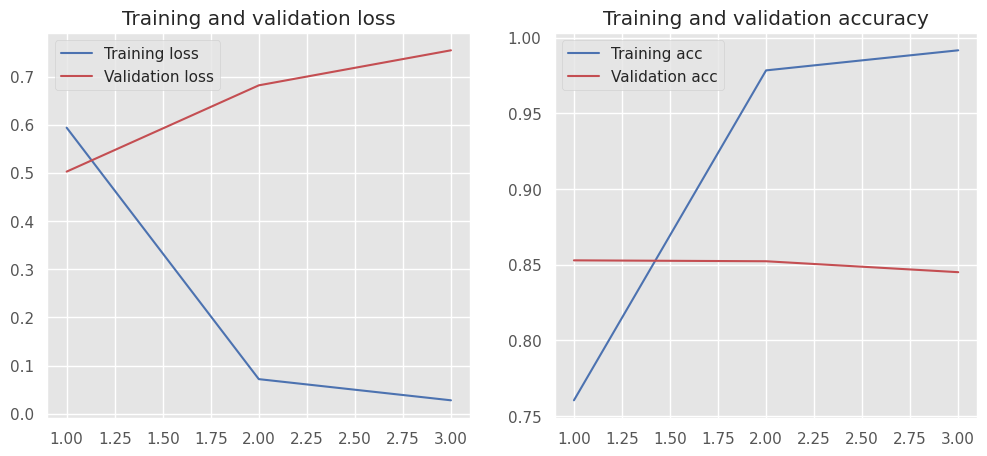

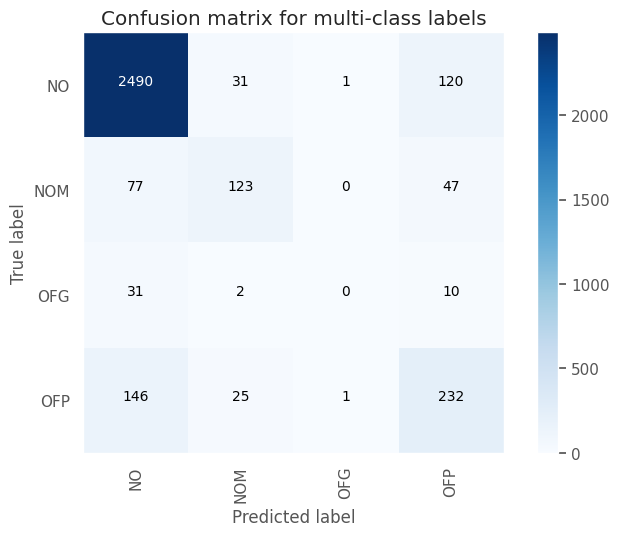

Test Accuracy: 0.8528
Test macro-F1: 0.5175


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5912    0.5436    0.5664       447
     no_hate     0.9303    0.9418    0.9360      2889

    accuracy                         0.8885      3336
   macro avg     0.7607    0.7427    0.7512      3336
weighted avg     0.8848    0.8885    0.8865      3336



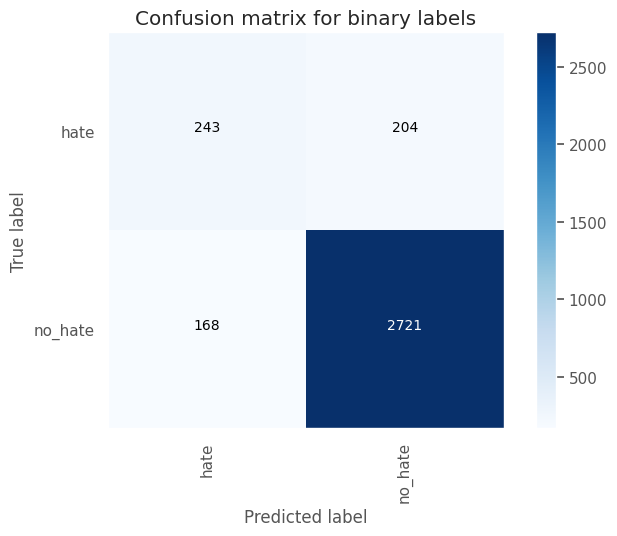

Test Accuracy: 0.8885
Test macro-F1: 0.7512




Training with learning_rate=0.000125 ======
Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!


Model: "sequential_47"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_47 (Embedding)        │ (31660, 128, 100)      │       500,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_47 (Flatten)            │ (31660, 12800)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_94 (Dense)                │ (31660, 512)           │     6,554,112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_47 (Dropout)            │ (31660, 512)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_95 (Dense)                │ (31660, 4)             │         2,052 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,056,164 (26.92 MB)

 Trainable params: 7,056,164 (26.92 MB)

 Non-trainable params: 0 (0.00 B)

None
Training classifier with validation split of 0.0
Epoch 1/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 50s 49ms/step - acc: 0.4796 - loss: 1.1277 - val_acc: 0.8110 - val_loss: 0.5726
Epoch 2/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 49s 49ms/step - acc: 0.9338 - loss: 0.2243 - val_acc: 0.8513 - val_loss: 0.5233
Epoch 3/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 48s 48ms/step - acc: 0.9799 - loss: 0.0730 - val_acc: 0.8474 - val_loss: 0.6117
Epoch 4/50
990/990 ━━━━━━━━━━━━━━━━━━━━ 49s 50ms/step - acc: 0.9898 - loss: 0.0370 - val_acc: 0.8486 - val_loss: 0.6870
Model trained correctly
105/105 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

 TEST SET REPORT (MULTI-CLASS) =================================
              precision    recall  f1-score   support

          NO     0.9051    0.9463    0.9252      2642
         NOM     0.6791    0.5142    0.5853       247
         OFG     0.0000    0.0000    0.0000        43
         OFP     0.5875    0.5569    0.5718       404

    accuracy                         0.8549      3336
   macro 

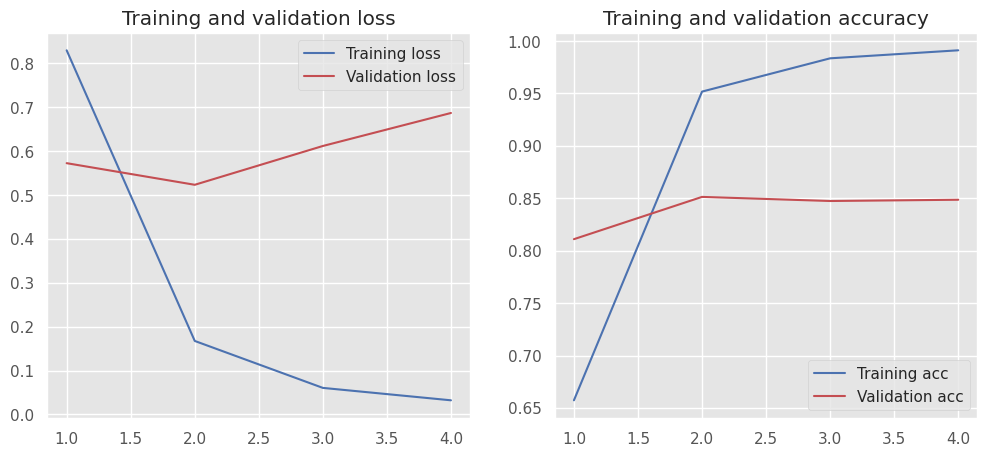

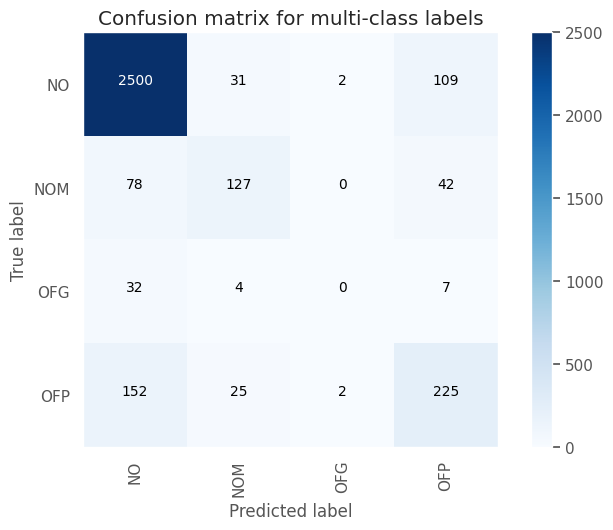

Test Accuracy: 0.8549
Test macro-F1: 0.5206


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6047    0.5235    0.5612       447
     no_hate     0.9278    0.9470    0.9373      2889

    accuracy                         0.8903      3336
   macro avg     0.7662    0.7353    0.7492      3336
weighted avg     0.8845    0.8903    0.8869      3336



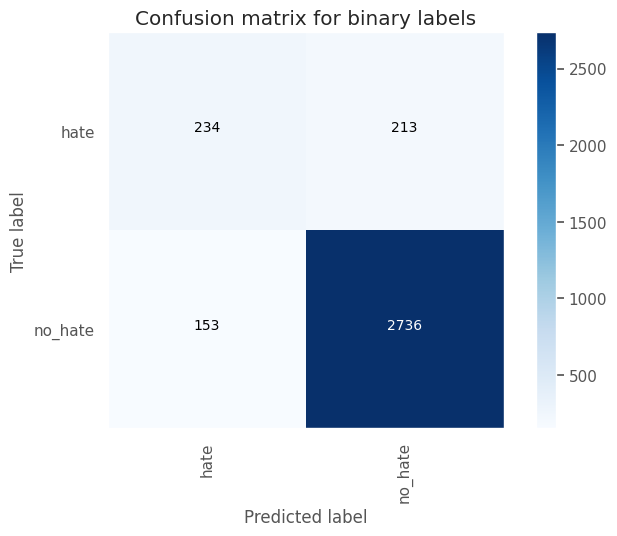

Test Accuracy: 0.8903
Test macro-F1: 0.7492






In [ ]:
vocab_size: int = 5000
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

for dense_dim in [128, 256, 512]:
    print(f"Training with dense_dim={dense_dim} ==============>")
    for lr in [0.001, 0.00025, 0.000125]:
        print(f"Training with learning_rate={lr} ======")
        # Define Keras model
        model = Sequential([
            Embedding(vocab_size, embedding_dim, input_length=max_length),
            Flatten(),
            Dense(dense_dim, activation='relu'),
            Dropout(0.3),
            Dense(4, activation='softmax')
        ])

        # Data
        dataset_folder: str = dataset_v8_folder
        dataset_name: str = "v8"
        data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
        x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], \
            data[
                "x_test"], data["y_test"]

        # Train with our class
        trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                 max_input_length=max_length))
        optim_config: OptimizationConfig = OptimizationConfig(
            epochs=50,
            batch_size=32,
            validation_split=0.0,
            validation_data=(x_val, y_val),
            optimizer=Adam(learning_rate=lr)
        )
        trainer.train(x_train=x_train,
                      y_train=y_train,
                      opt_config=optim_config,
                      callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
        mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
        mc_report: dict
        bc_report: dict

        # Accumulate result so it can be plotted
        result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                        dataset_version=dataset_name,
                                        model_params=model.count_params(),
                                        optim_config=optim_config,
                                        macro_prec_mc=mc_report["macro avg"]["precision"],
                                        macro_recall_mc=mc_report["macro avg"]["recall"],
                                        macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                        macro_prec_bc=bc_report["macro avg"]["precision"],
                                        macro_recall_bc=bc_report["macro avg"]["recall"],
                                        macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                        )
        results_rep.accumulate(result)

In [ ]:
report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)


<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>5</th>
      <td>v8</td>
      <td>{'embedding_44': {'class_name': 'Embedding', 'param_count': 500000, 'input': (31660, 128), 'output': (31660, 128, 100)}, 'flatten_44': {'class_name': 'Flatten', 'param_count': 0, 'input': (31660, 128, 100), 'output': (31660, 12800)}, 'dense_88': {'class_name': 'Dense', 'param_count': 3277056, 'input': (31660, 12800), 'output': (31660, 256)}, 'dropout_44': {'class_name': 'Dropout', 'param_count': 0, 'input': (31660, 256), 'output': (31660, 256)}, 'dense_89': {'class_name': 'Dense', 'param_count': 1028, 'input': (31660, 256), 'output': (31660, 4)}}</td>
      <td>3778084</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.000125}}</td>
      <td>0.5492</td>
      <td>0.5125</td>
      <td>0.5274</td>
      <td>0.7709</td>
      <td>0.7480</td>
      <td>0.7587</td>
    </tr>
    <tr>
      <th>2</th>
      <td>v8</td>
      <td>{'embedding_41': {'class_name': 'Embedding', 'param_count': 500000, 'input': (31660, 128), 'output': (31660, 128, 100)}, 'flatten_41': {'class_name': 'Flatten', 'param_count': 0, 'input': (31660, 128, 100), 'output': (31660, 12800)}, 'dense_82': {'class_name': 'Dense', 'param_count': 1638528, 'input': (31660, 12800), 'output': (31660, 128)}, 'dropout_41': {'class_name': 'Dropout', 'param_count': 0, 'input': (31660, 128), 'output': (31660, 128)}, 'dense_83': {'class_name': 'Dense', 'param_count': 516, 'input': (31660, 128), 'output': (31660, 4)}}</td>
      <td>2139044</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.000125}}</td>
      <td>0.5437</td>
      <td>0.5085</td>
      <td>0.5232</td>
      <td>0.7664</td>
      <td>0.7402</td>
      <td>0.7522</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v8</td>
      <td>{'embedding_40': {'class_name': 'Embedding', 'param_count': 500000, 'input': (31660, 128), 'output': (31660, 128, 100)}, 'flatten_40': {'class_name': 'Flatten', 'param_count': 0, 'input': (31660, 128, 100), 'output': (31660, 12800)}, 'dense_80': {'class_name': 'Dense', 'param_count': 1638528, 'input': (31660, 12800), 'output': (31660, 128)}, 'dropout_40': {'class_name': 'Dropout', 'param_count': 0, 'input': (31660, 128), 'output': (31660, 128)}, 'dense_81': {'class_name': 'Dense', 'param_count': 516, 'input': (31660, 128), 'output': (31660, 4)}}</td>
      <td>2139044</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.00025}}</td>
      <td>0.5489</td>
      <td>0.5083</td>
      <td>0.5229</td>
      <td>0.7675</td>
      <td>0.7588</td>
      <td>0.7630</td>
    </tr>
    <tr>
      <th>8</th>
      <td>v8</td>
      <td>{'embedding_47': {'class_name': 'Embedding', 'param_count': 500000, 'input': (31660, 128), 'output': (31660, 128, 100)}, 'flatten_47': {'class_name': 'Flatten', 'param_count': 0, 'input': (31660, 128, 100), 'output': (31660, 12800)}, 'dense_94': {'class_name': 'Dense', 'param_count': 6554112, 'input': (31660, 12800), 'output': (31660, 512)}, 'dropout_47': {'class_name': 'Dropout', 'param_count': 0, 'input': (31660, 512), 'output': (31660, 512)}, 'dense_95': {'class_name': 'Dense', 'param_count': 2052, 'input': (31660, 512), 'output': (31660, 4)}}</td>
      <td>7056164</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.000125}}</td>
      <td>0.5429</td>
      <td>0.5043</td>
      <td>0.5206</td>
      <td>0.7662</td>
      <td>0.7353</td>
      <td>0.7492</td>
    </tr>
    <tr>
      <th>7</th>
      <td>v8</td>
      <td>{'embedding_46': {'class_name': 'Embedding', 'param_count': 500000, 'input': (31660, 128), 'output': (31660, 128, 100)}, 'flatten_46': {'class_name': 'Flatten', 'param_count': 0, 'input': (31660, 128, 100), 'output': (31660, 12800)}, 'dense_92': {'class_name': 'Dense', 'param_count': 6554112, 'input': (31660, 12800), 'output': (31660, 512)}, 'dropout_46': {'class_name': 'Dropout', 'param_count': 0, 'input': (31660, 512), 'output': (31660, 512)}, 'dense_93': {'class_name': 'Dense', 'param_count': 2052, 'input': (31660, 512), 'output': (31660, 4)}}</td>
      <td>7056164</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.00025}}</td>
      <td>0.5386</td>
      <td>0.5037</td>
      <td>0.5175</td>
      <td>0.7607</td>
      <td>0.7427</td>
      <td>0.7512</td>
    </tr>
    <tr>
      <th>4</th>
      <td>v8</td>
      <td>{'embedding_43': {'class_name': 'Embedding', 'param_count': 500000, 'input': (31660, 128), 'output': (31660, 128, 100)}, 'flatten_43': {'class_name': 'Flatten', 'param_count': 0, 'input': (31660, 128, 100), 'output': (31660, 12800)}, 'dense_86': {'class_name': 'Dense', 'param_count': 3277056, 'input': (31660, 12800), 'output': (31660, 256)}, 'dropout_43': {'class_name': 'Dropout', 'param_count': 0, 'input': (31660, 256), 'output': (31660, 256)}, 'dense_87': {'class_name': 'Dense', 'param_count': 1028, 'input': (31660, 256), 'output': (31660, 4)}}</td>
      <td>3778084</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.00025}}</td>
      <td>0.5438</td>
      <td>0.4956</td>
      <td>0.5151</td>
      <td>0.7652</td>
      <td>0.7302</td>
      <td>0.7458</td>
    </tr>
    <tr>
      <th>0</th>
      <td>v8</td>
      <td>{'embedding_39': {'class_name': 'Embedding', 'param_count': 500000, 'input': (31660, 128), 'output': (31660, 128, 100)}, 'flatten_39': {'class_name': 'Flatten', 'param_count': 0, 'input': (31660, 128, 100), 'output': (31660, 12800)}, 'dense_78': {'class_name': 'Dense', 'param_count': 1638528, 'input': (31660, 12800), 'output': (31660, 128)}, 'dropout_39': {'class_name': 'Dropout', 'param_count': 0, 'input': (31660, 128), 'output': (31660, 128)}, 'dense_79': {'class_name': 'Dense', 'param_count': 516, 'input': (31660, 128), 'output': (31660, 4)}}</td>
      <td>2139044</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.001}}</td>
      <td>0.5326</td>
      <td>0.4472</td>
      <td>0.4648</td>
      <td>0.7263</td>
      <td>0.7271</td>
      <td>0.7267</td>
    </tr>
    <tr>
      <th>3</th>
      <td>v8</td>
      <td>{'embedding_42': {'class_name': 'Embedding', 'param_count': 500000, 'input': (31660, 128), 'output': (31660, 128, 100)}, 'flatten_42': {'class_name': 'Flatten', 'param_count': 0, 'input': (31660, 128, 100), 'output': (31660, 12800)}, 'dense_84': {'class_name': 'Dense', 'param_count': 3277056, 'input': (31660, 12800), 'output': (31660, 256)}, 'dropout_42': {'class_name': 'Dropout', 'param_count': 0, 'input': (31660, 256), 'output': (31660, 256)}, 'dense_85': {'class_name': 'Dense', 'param_count': 1028, 'input': (31660, 256), 'output': (31660, 4)}}</td>
      <td>3778084</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.001}}</td>
      <td>0.5442</td>
      <td>0.4245</td>
      <td>0.4446</td>
      <td>0.7371</td>
      <td>0.7198</td>
      <td>0.7279</td>
    </tr>
    <tr>
      <th>6</th>
      <td>v8</td>
      <td>{'embedding_45': {'class_name': 'Embedding', 'param_count': 500000, 'input': (31660, 128), 'output': (31660, 128, 100)}, 'flatten_45': {'class_name': 'Flatten', 'param_count': 0, 'input': (31660, 128, 100), 'output': (31660, 12800)}, 'dense_90': {'class_name': 'Dense', 'param_count': 6554112, 'input': (31660, 12800), 'output': (31660, 512)}, 'dropout_45': {'class_name': 'Dropout', 'param_count': 0, 'input': (31660, 512), 'output': (31660, 512)}, 'dense_91': {'class_name': 'Dense', 'param_count': 2052, 'input': (31660, 512), 'output': (31660, 4)}}</td>
      <td>7056164</td>
      <td>{'epochs': 50, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'adam', 'lr': 0.001}}</td>
      <td>0.5385</td>
      <td>0.4302</td>
      <td>0.4417</td>
      <td>0.7244</td>
      <td>0.7357</td>
      <td>0.7298</td>
    </tr>
  </tbody>
</table>
    

En este caso, comprobamos que no obtenemos mejores resultados con las mismas arquitecturas que antes, pero entrenando sobre `v8`. Viendo las curvas, no se trata de un problema de underfit por tener más datos porque el modelo alcanza rápidamente una accuracy muy alta en training.

Por limitaciones de tiempo, pasaré a explorar acercamientos más prometedores, basados en `CNNs` y `RNNs`.

# Convolutional Neural Networks

Pasaremos ahora a intentar resolver este problema de clasificación de discurso del odio haciendo uso de [redes neuronales convolucionales](https://www.tensorflow.org/tutorials/images/cnn), también conocidas como `Convolutional Neural Networks`, `CNNs` o `covnets`.

Estas redes estas inspiradas originalmente en el funcionamiento de las áreas cebrales para el procesamiento de la visión. De hecho, si bien las estamos utilizando para problemas de texto (NLP), su uso más típico o popular es en el área de [computer vision](https://azure.microsoft.com/en-us/resources/cloud-computing-dictionary/what-is-computer-vision#:~:text=Computer%20vision%20is%20a%20field,tasks%20that%20replicate%20human%20capabilities.).

En el caso de texto, permiten capturar características del texto y encontrar relaciones entre diversas partes del mismo, gracias a los filtros que aprenden. Como desventaja, requiren un gran volumen de datos, debido a la cantidad de parámetros que suelen tener, y suelen ser poco capaces de modelar información de largo alcance (muy separada en el texto) así como mantener el orden de las secuencias en este modelado (no hay recurrencia).

Como solemos hacer, comenzaremos con alguna arquitectura de base que pensemos que puede tener sentido y luego iremos iterando.

Para las pruebas, y de forma de ahorrar tiempo, las realizaré principalmente sobre el dataset `v6`, el cual cuenta con ejemplos adicionales aumentados para la clase `OFG`.

## Entrenando sobre `v6`

Haremos una prueba rápida para comprobar que funciona.

Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_36 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_72 (Dropout)        (None, 128, 100)          0         
                                                                 
 conv1d (Conv1D)             (None, 126, 32)           9632      
                                                                 
 max_pooling1d (MaxPooling1  (None, 42, 32)            0         
 D)                                                              
                                                                 
 flatten_3

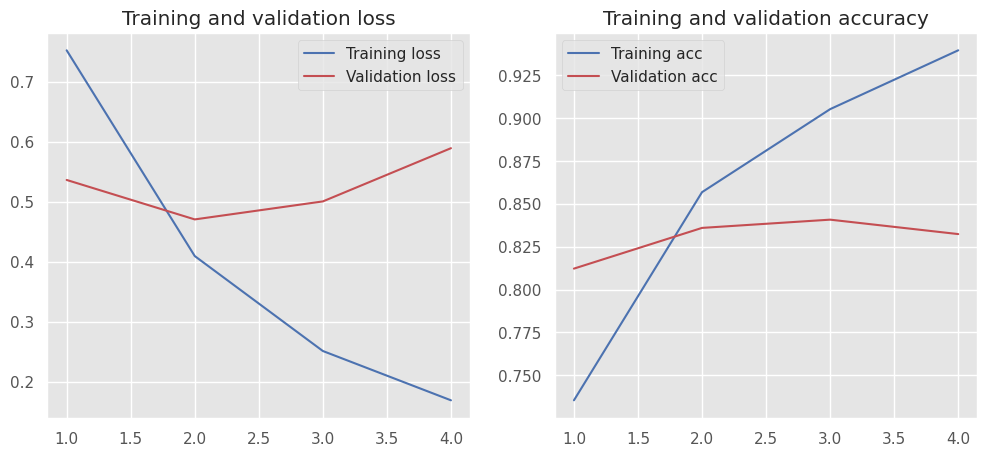

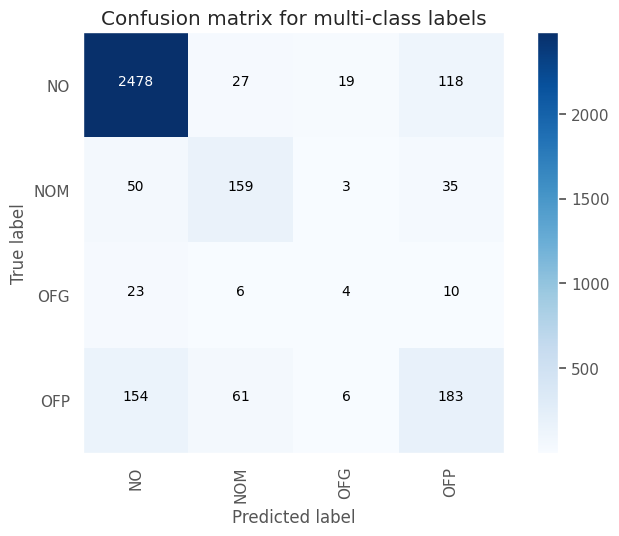

Test Accuracy: 0.8465
Test macro-F1: 0.5394


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5370    0.4541    0.4921       447
     no_hate     0.9175    0.9394    0.9283      2889

    accuracy                         0.8744      3336
   macro avg     0.7273    0.6968    0.7102      3336
weighted avg     0.8665    0.8744    0.8699      3336



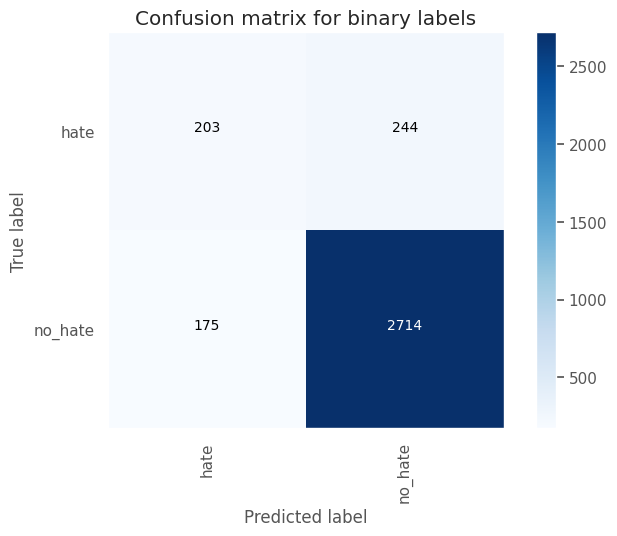

Test Accuracy: 0.8744
Test macro-F1: 0.7102






In [20]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

# Build CNN model  ===========
model_config = KerasCNNClassifierModelConfig(
    # General
    vocab_size=vocab_size,
    model_name="cnn_classifier",
    # Embeddings
    embedding_config=EmbeddingConfig(output_dim=embedding_dim, input_length=max_length, trainable=True, pre_trained_matrix=None),
    # CNN Layers
    cnn_filter_dims=[32],
    cnn_kernel_sizes=[3],
    cnn_activations=["relu"],
    cnn_stride_sizes=[1],
    cnn_padding=["valid"],
    pool_sizes=[3],
    use_global_pooling=False,
    # Dense layers at the end
    dense_activations=["relu", "softmax"],
    dense_dims=[128,4],
    # Dropouts
    dp_after_embedding=0.5,
    dp_after_pooling=None,
    dp_before_classif_dense=None)
model: tf.keras.Model = CNNModelFactory.create(model_config)
# ============================


# Train  ===========
trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                          max_input_length=max_length))
optim_config: OptimizationConfig = OptimizationConfig(
    epochs=25,
    batch_size=32,
    validation_split=0.0,
    validation_data=(x_val, y_val),
    optimizer=Adam(learning_rate=0.001)
)
trainer.train(x_train=x_train,
              y_train=y_train,
              opt_config=optim_config,
              callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
mc_report: dict
bc_report: dict

# Accumulate result so it can be plotted
result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                dataset_version=dataset_name,
                                model_params=model.count_params(),
                                optim_config=optim_config,
                                macro_prec_mc=mc_report["macro avg"]["precision"],
                                macro_recall_mc=mc_report["macro avg"]["recall"],
                                macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                macro_prec_bc=bc_report["macro avg"]["precision"],
                                macro_recall_bc=bc_report["macro avg"]["recall"],
                                macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                )
results_rep.accumulate(result)
# ============================

In [21]:
report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)


<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_36': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_72': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'flatten_36': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_72': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dense_73': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1182408</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5496</td>
      <td>0.5319</td>
      <td>0.5394</td>
      <td>0.7273</td>
      <td>0.6968</td>
      <td>0.7102</td>
    </tr>
  </tbody>
</table>
    

En un primer acercamiento, obtenemos un **53.94% de macro-f1 (MULTI-CLASS) y 71.02% de macro-f1 (BINARY-CLASS)**. Vemos que el comportamiento de las curvas de validación es bastante malo, no logramos entrenar por mucho tiempo.

Repetiremos algunas pruebas más intentando simplificar la arquitectura de la red y explorando diversos parámetros en simultáneo.

Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 128, 50)           500050    
                                                                 
 dropout (Dropout)           (None, 128, 50)           0         
                                                                 
 conv1d (Conv1D)             (None, 126, 32)           4832      
                                                                 
 max_pooling1d (MaxPooling1  (None, 42, 32)            0         
 D)                                                              
                                                                 
 flatten (

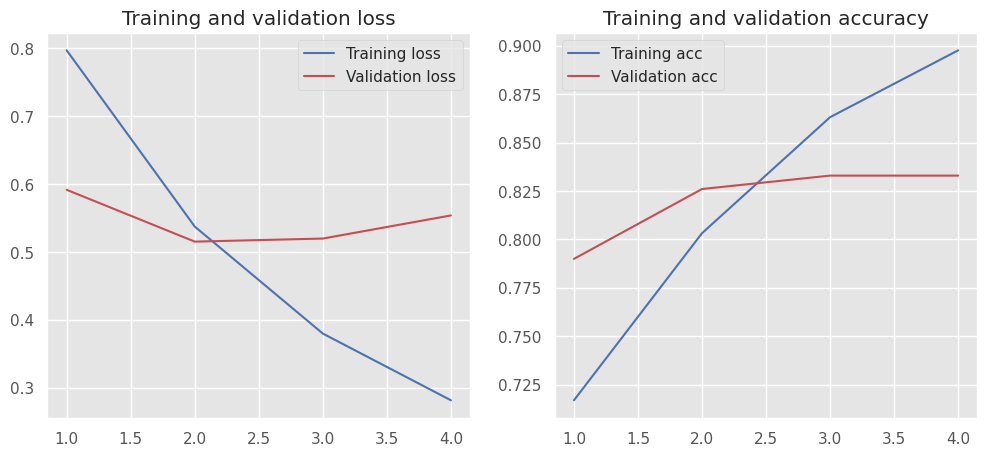

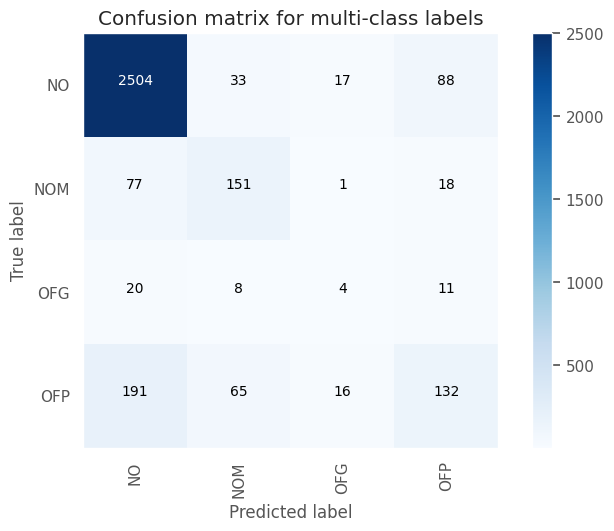

Test Accuracy: 0.8366
Test macro-F1: 0.506


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5679    0.3647    0.4441       447
     no_hate     0.9069    0.9571    0.9313      2889

    accuracy                         0.8777      3336
   macro avg     0.7374    0.6609    0.6877      3336
weighted avg     0.8614    0.8777    0.8660      3336



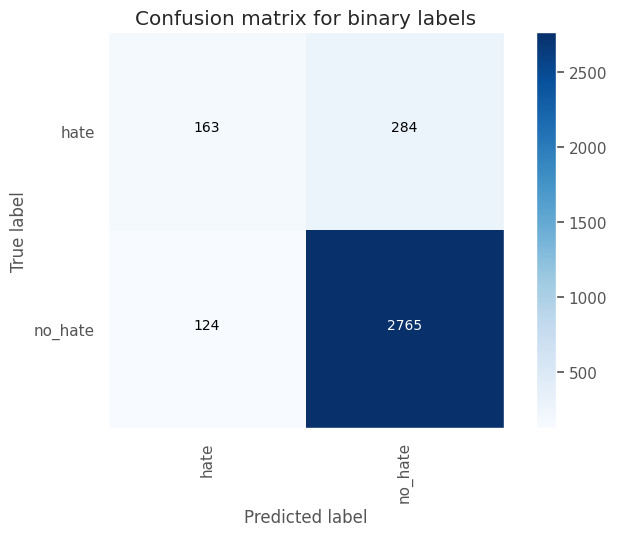

Test Accuracy: 0.8777
Test macro-F1: 0.6877




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     (None, 128, 50)           500050    
                                                                 
 dropout_1 (Dropout)         (None, 128, 50)           0         
                                                                 
 conv1d_1 (Conv1D)           (None, 126, 32)           4832      
                                                                 
 max_pooling1d_1 (MaxPoolin  (None, 42, 32)            0         
 g1D)                                                            
                                                                 
 flatten_1 (Flatten)         (None, 1344)            

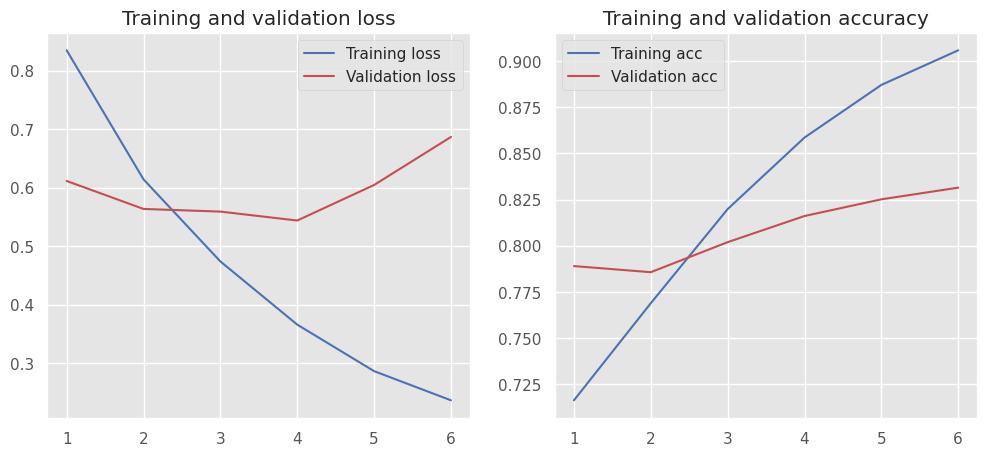

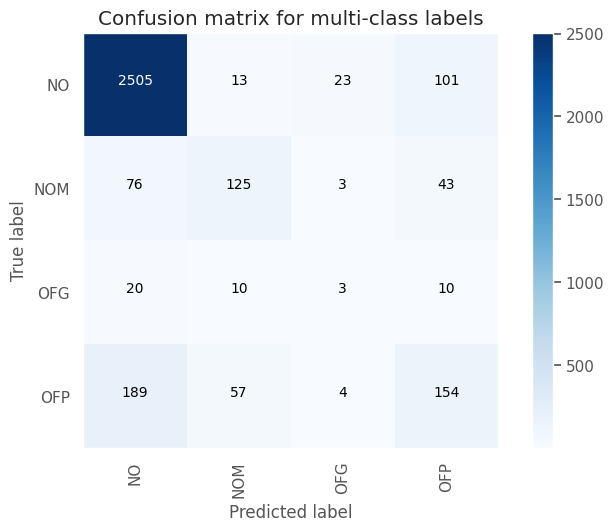

Test Accuracy: 0.8354
Test macro-F1: 0.4967


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5015    0.3826    0.4340       447
     no_hate     0.9078    0.9412    0.9242      2889

    accuracy                         0.8663      3336
   macro avg     0.7047    0.6619    0.6791      3336
weighted avg     0.8534    0.8663    0.8585      3336



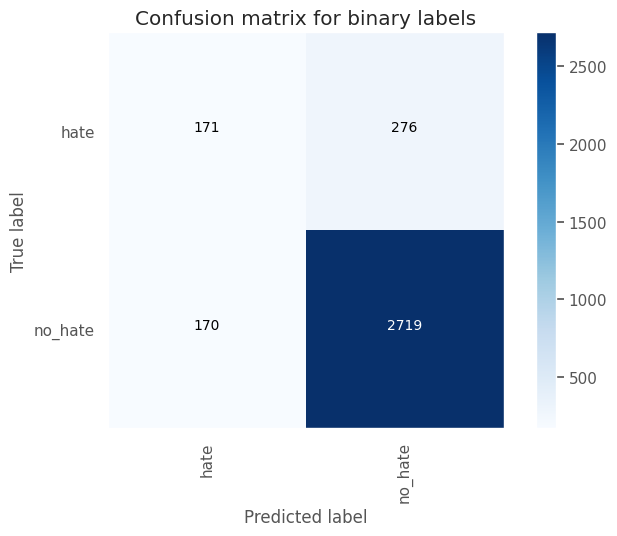

Test Accuracy: 0.8663
Test macro-F1: 0.6791




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_2 (Embedding)     (None, 128, 50)           500050    
                                                                 
 dropout_3 (Dropout)         (None, 128, 50)           0         
                                                                 
 conv1d_2 (Conv1D)           (None, 126, 32)           4832      
                                                                 
 max_pooling1d_2 (MaxPoolin  (None, 42, 32)            0         
 g1D)                                                            
                                                                 
 dropout_4 (Dropout)         (None, 42, 32)          

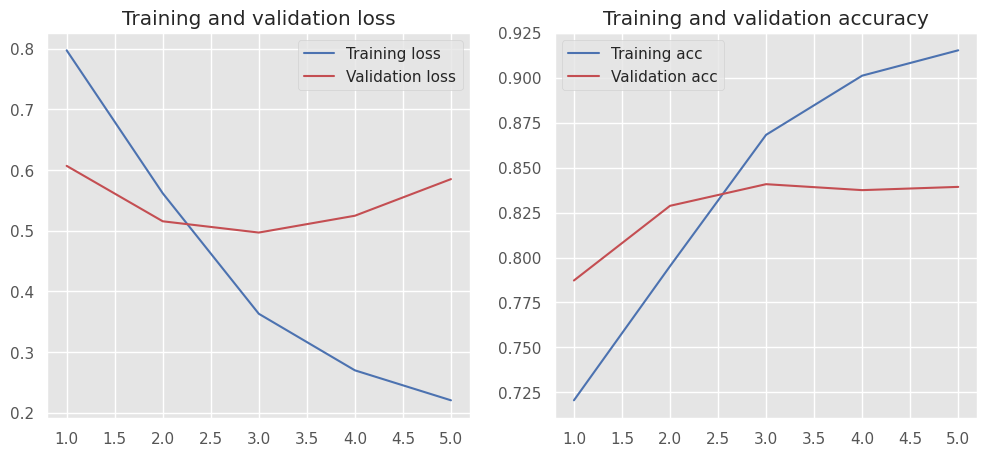

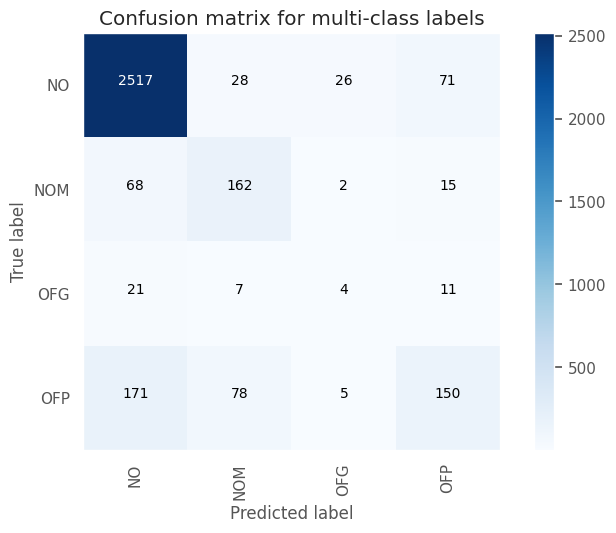

Test Accuracy: 0.8492
Test macro-F1: 0.5276


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5986    0.3803    0.4651       447
     no_hate     0.9092    0.9605    0.9342      2889

    accuracy                         0.8828      3336
   macro avg     0.7539    0.6704    0.6997      3336
weighted avg     0.8676    0.8828    0.8713      3336



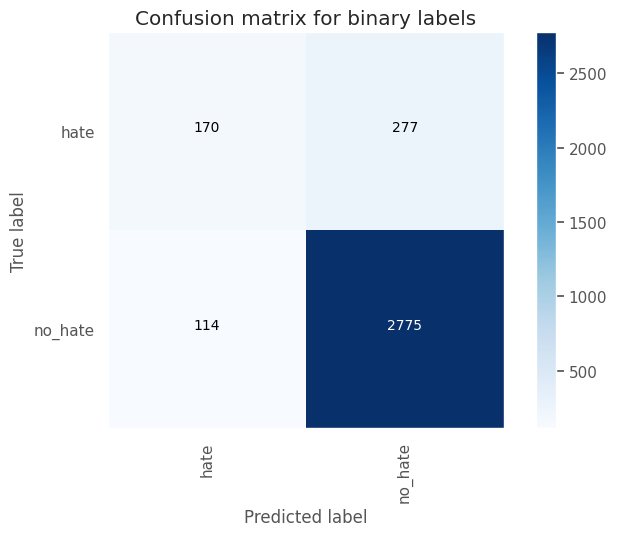

Test Accuracy: 0.8828
Test macro-F1: 0.6997




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_3 (Embedding)     (None, 128, 50)           500050    
                                                                 
 dropout_5 (Dropout)         (None, 128, 50)           0         
                                                                 
 conv1d_3 (Conv1D)           (None, 126, 32)           4832      
                                                                 
 max_pooling1d_3 (MaxPoolin  (None, 42, 32)            0         
 g1D)                                                            
                                                                 
 dropout_6 (Dropout)         (None, 42, 32)          

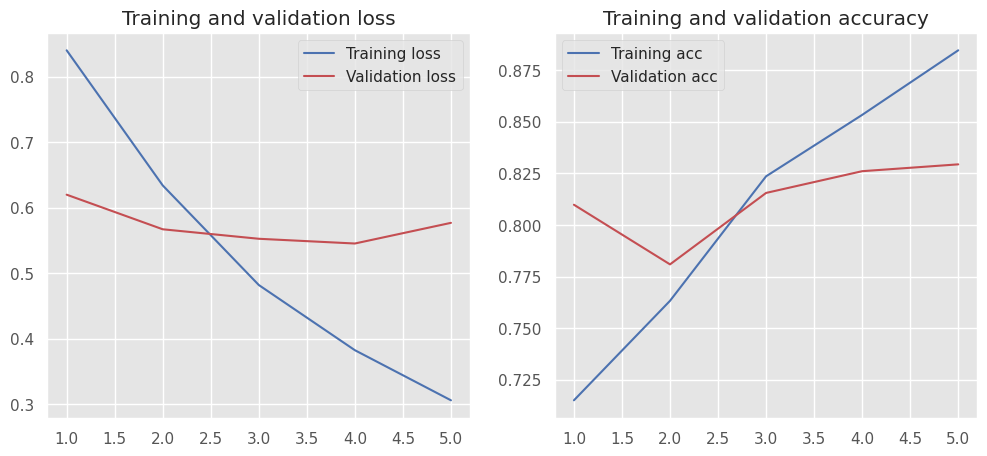

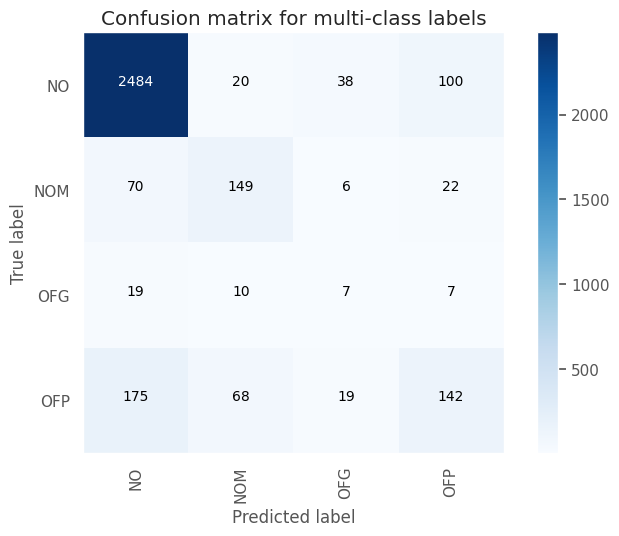

Test Accuracy: 0.8339
Test macro-F1: 0.5174


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5132    0.3915    0.4442       447
     no_hate     0.9092    0.9425    0.9256      2889

    accuracy                         0.8687      3336
   macro avg     0.7112    0.6670    0.6849      3336
weighted avg     0.8561    0.8687    0.8611      3336



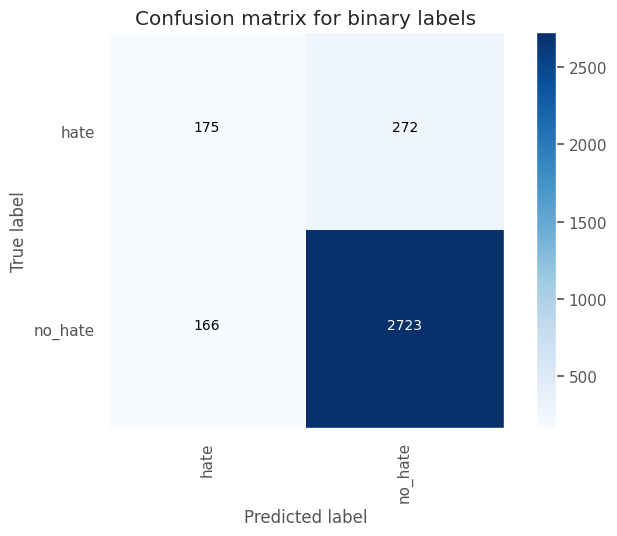

Test Accuracy: 0.8687
Test macro-F1: 0.6849




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_4 (Embedding)     (None, 128, 50)           500050    
                                                                 
 dropout_8 (Dropout)         (None, 128, 50)           0         
                                                                 
 conv1d_4 (Conv1D)           (None, 126, 32)           4832      
                                                                 
 max_pooling1d_4 (MaxPoolin  (None, 42, 32)            0         
 g1D)                                                            
                                                                 
 flatten_4 (Flatten)         (None, 1344)            

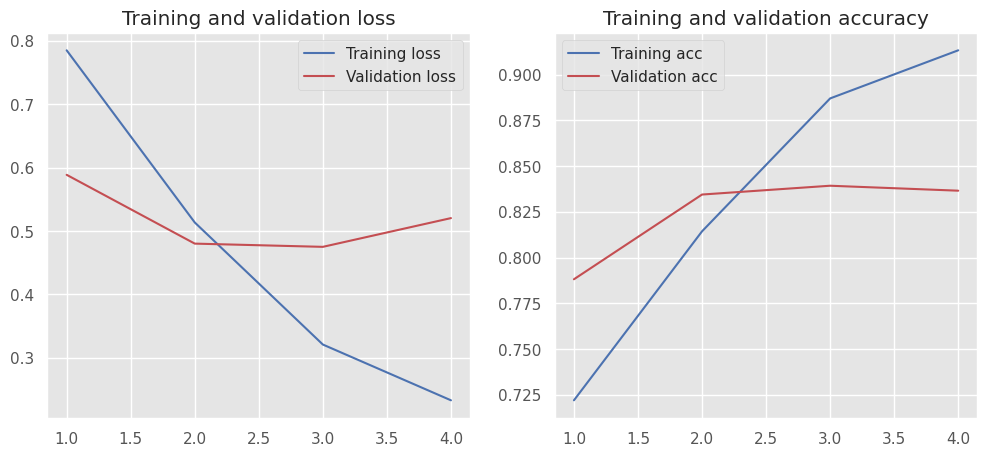

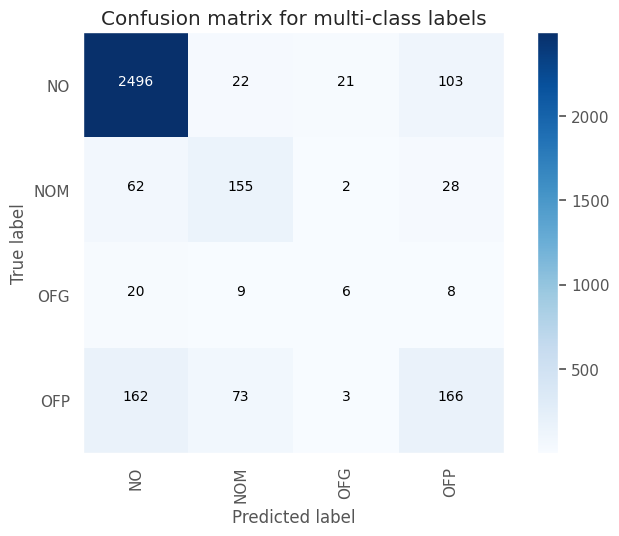

Test Accuracy: 0.8462
Test macro-F1: 0.5421


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5430    0.4094    0.4668       447
     no_hate     0.9120    0.9467    0.9290      2889

    accuracy                         0.8747      3336
   macro avg     0.7275    0.6780    0.6979      3336
weighted avg     0.8625    0.8747    0.8671      3336



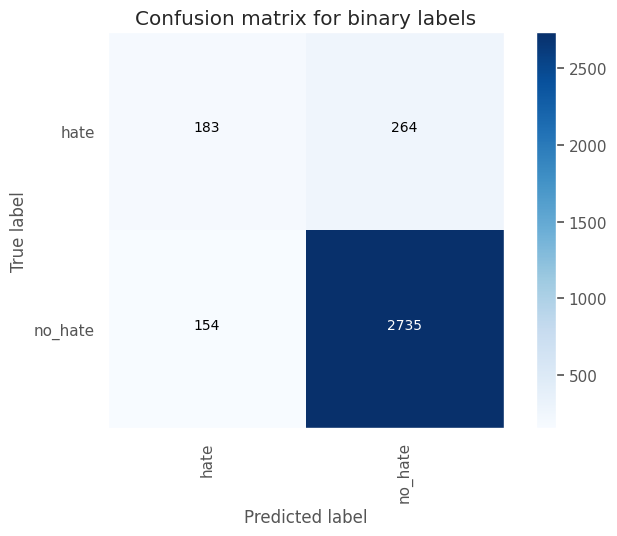

Test Accuracy: 0.8747
Test macro-F1: 0.6979




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_5 (Embedding)     (None, 128, 50)           500050    
                                                                 
 dropout_9 (Dropout)         (None, 128, 50)           0         
                                                                 
 conv1d_5 (Conv1D)           (None, 126, 32)           4832      
                                                                 
 max_pooling1d_5 (MaxPoolin  (None, 42, 32)            0         
 g1D)                                                            
                                                                 
 flatten_5 (Flatten)         (None, 1344)            

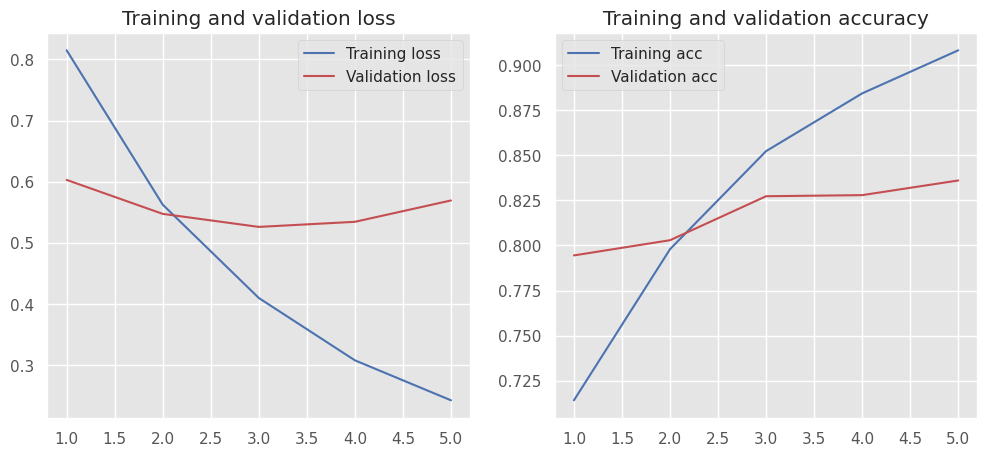

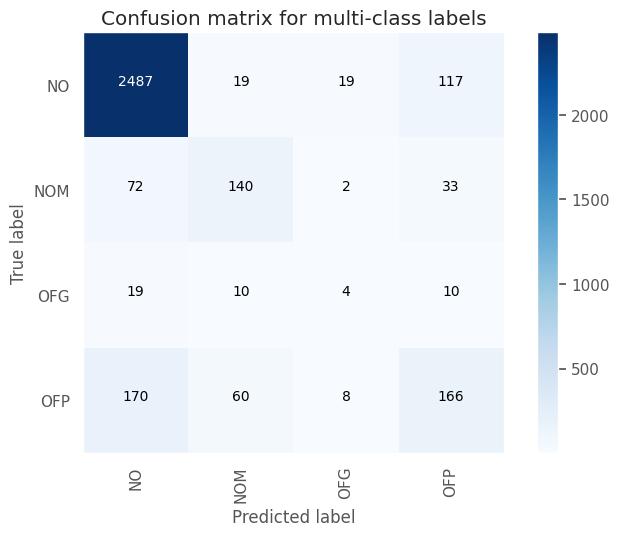

Test Accuracy: 0.8384
Test macro-F1: 0.5178


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5237    0.4206    0.4665       447
     no_hate     0.9130    0.9408    0.9267      2889

    accuracy                         0.8711      3336
   macro avg     0.7183    0.6807    0.6966      3336
weighted avg     0.8608    0.8711    0.8650      3336



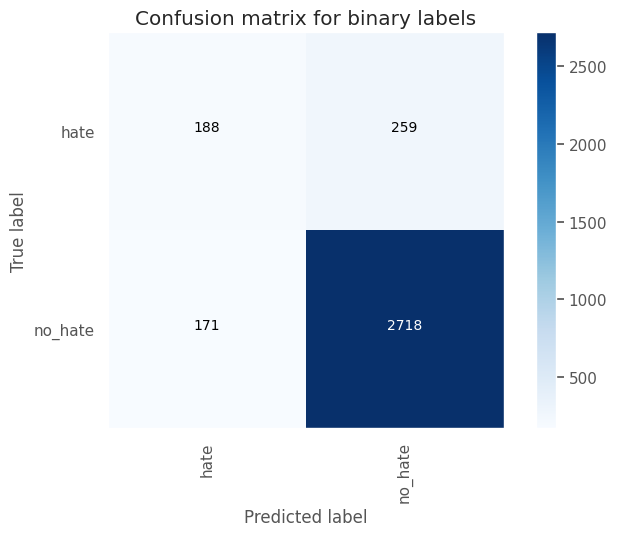

Test Accuracy: 0.8711
Test macro-F1: 0.6966




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_6 (Embedding)     (None, 128, 50)           500050    
                                                                 
 dropout_11 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_6 (Conv1D)           (None, 126, 32)           4832      
                                                                 
 max_pooling1d_6 (MaxPoolin  (None, 42, 32)            0         
 g1D)                                                            
                                                                 
 dropout_12 (Dropout)        (None, 42, 32)          

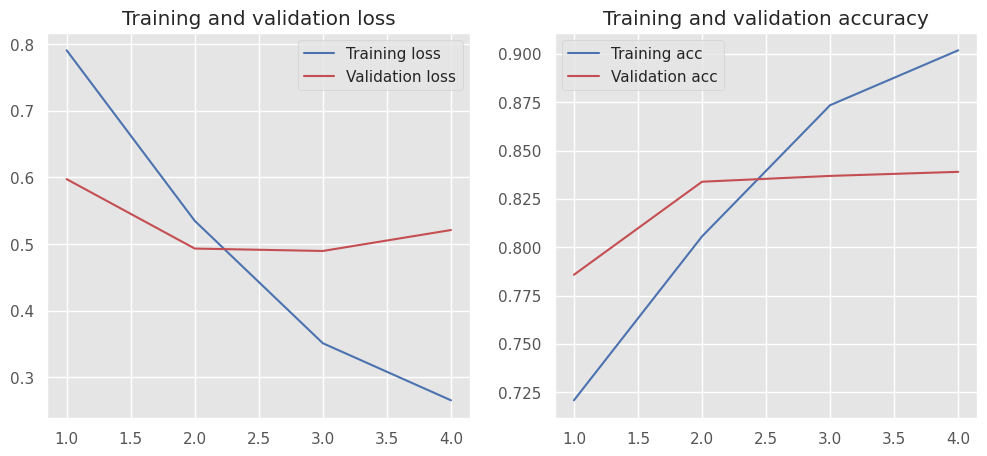

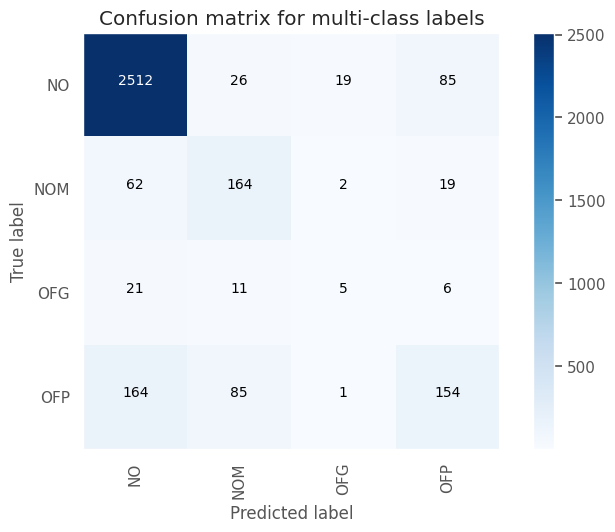

Test Accuracy: 0.8498
Test macro-F1: 0.5374


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5704    0.3714    0.4499       447
     no_hate     0.9077    0.9567    0.9316      2889

    accuracy                         0.8783      3336
   macro avg     0.7391    0.6640    0.6907      3336
weighted avg     0.8625    0.8783    0.8670      3336



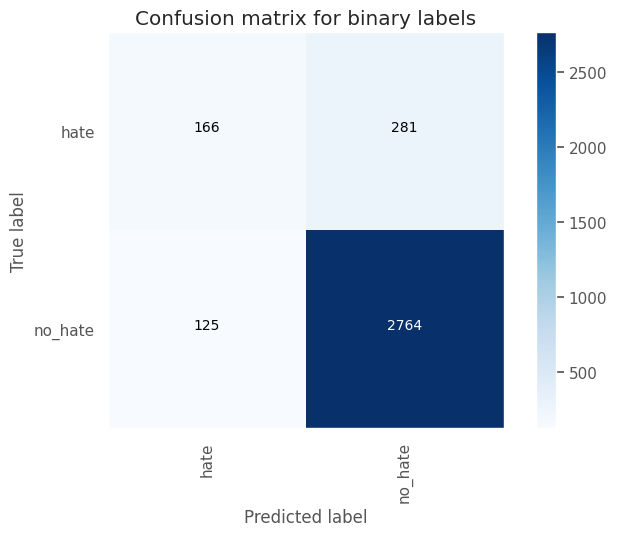

Test Accuracy: 0.8783
Test macro-F1: 0.6907




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_7 (Embedding)     (None, 128, 50)           500050    
                                                                 
 dropout_13 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_7 (Conv1D)           (None, 126, 32)           4832      
                                                                 
 max_pooling1d_7 (MaxPoolin  (None, 42, 32)            0         
 g1D)                                                            
                                                                 
 dropout_14 (Dropout)        (None, 42, 32)          

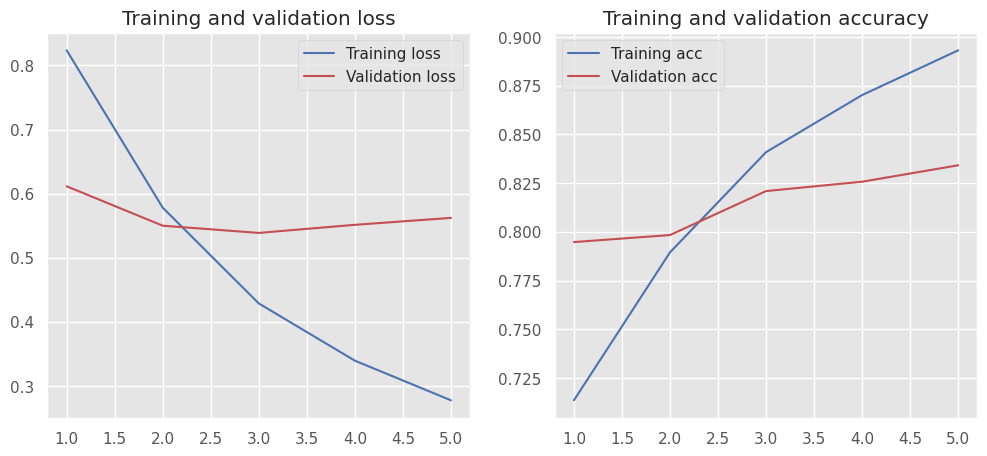

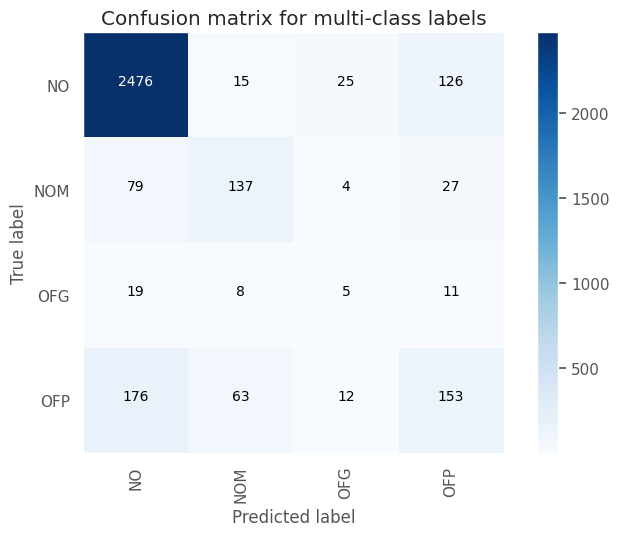

Test Accuracy: 0.8306
Test macro-F1: 0.5095


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4986    0.4049    0.4469       447
     no_hate     0.9105    0.9370    0.9236      2889

    accuracy                         0.8657      3336
   macro avg     0.7046    0.6710    0.6852      3336
weighted avg     0.8553    0.8657    0.8597      3336



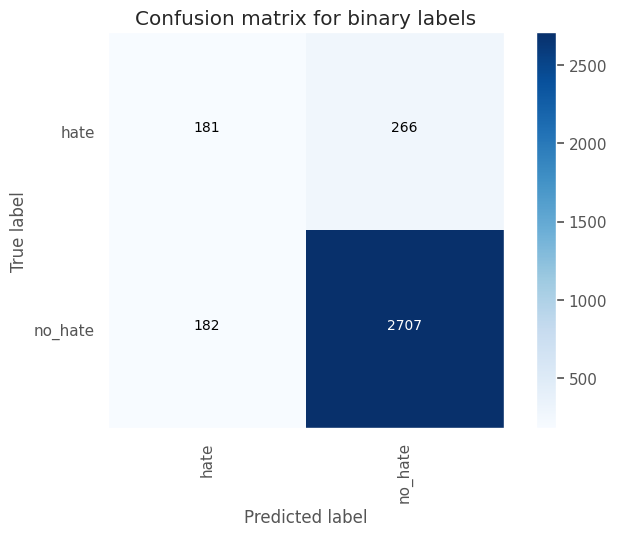

Test Accuracy: 0.8657
Test macro-F1: 0.6852




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_8 (Embedding)     (None, 128, 50)           500050    
                                                                 
 dropout_16 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_8 (Conv1D)           (None, 126, 64)           9664      
                                                                 
 max_pooling1d_8 (MaxPoolin  (None, 42, 64)            0         
 g1D)                                                            
                                                                 
 flatten_8 (Flatten)         (None, 2688)            

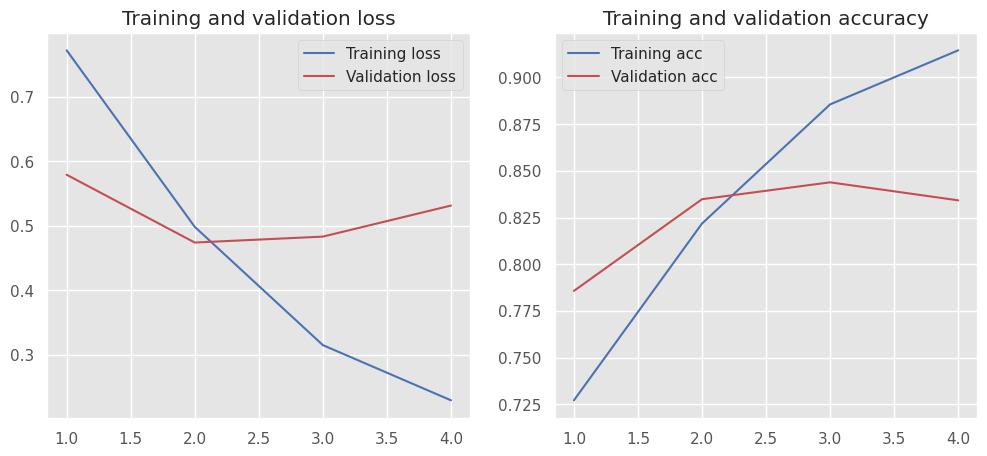

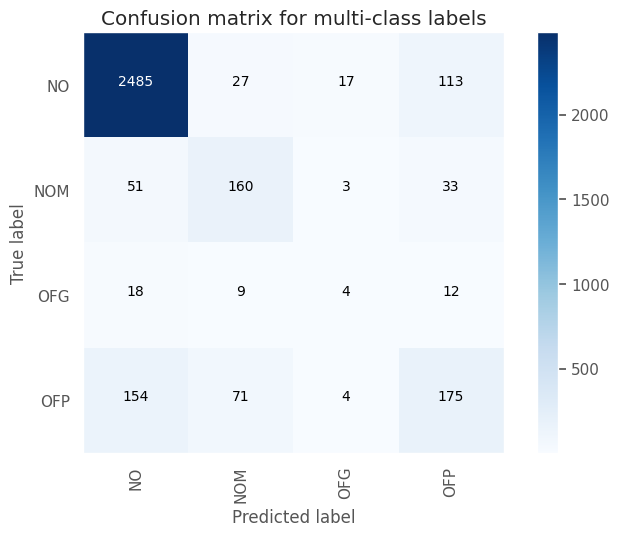

Test Accuracy: 0.8465
Test macro-F1: 0.5348


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5402    0.4362    0.4827       447
     no_hate     0.9153    0.9425    0.9287      2889

    accuracy                         0.8747      3336
   macro avg     0.7277    0.6894    0.7057      3336
weighted avg     0.8650    0.8747    0.8690      3336



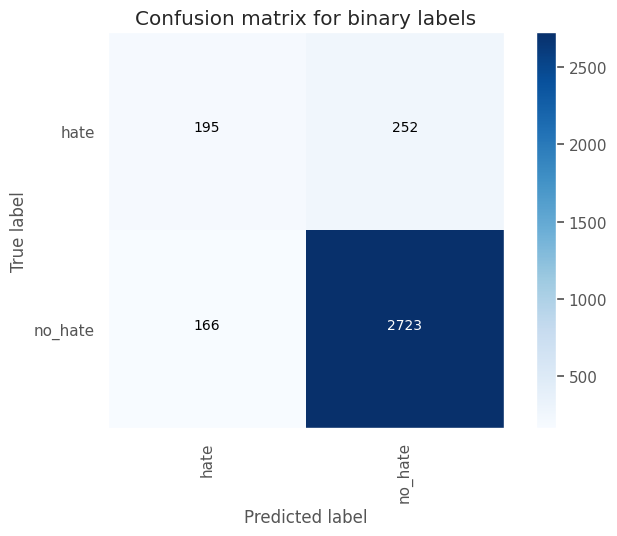

Test Accuracy: 0.8747
Test macro-F1: 0.7057




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_9 (Embedding)     (None, 128, 50)           500050    
                                                                 
 dropout_17 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_9 (Conv1D)           (None, 126, 64)           9664      
                                                                 
 max_pooling1d_9 (MaxPoolin  (None, 42, 64)            0         
 g1D)                                                            
                                                                 
 flatten_9 (Flatten)         (None, 2688)            

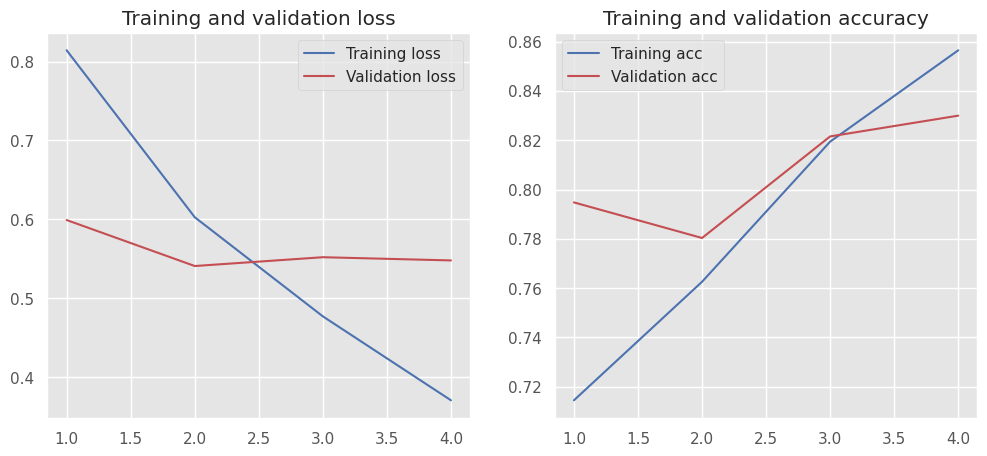

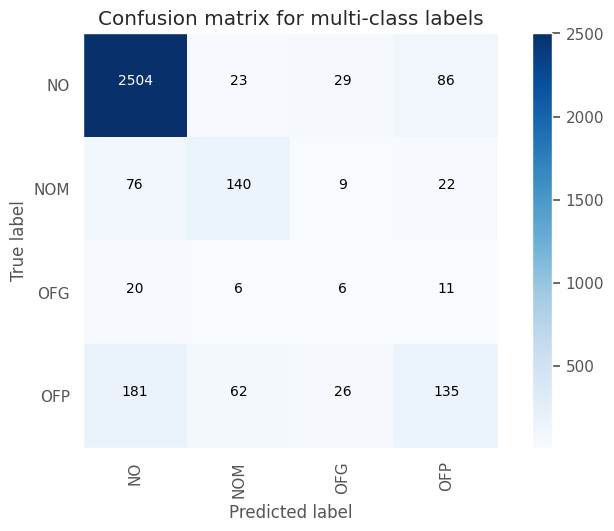

Test Accuracy: 0.8348
Test macro-F1: 0.5064


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5494    0.3982    0.4617       447
     no_hate     0.9107    0.9495    0.9297      2889

    accuracy                         0.8756      3336
   macro avg     0.7300    0.6738    0.6957      3336
weighted avg     0.8623    0.8756    0.8670      3336



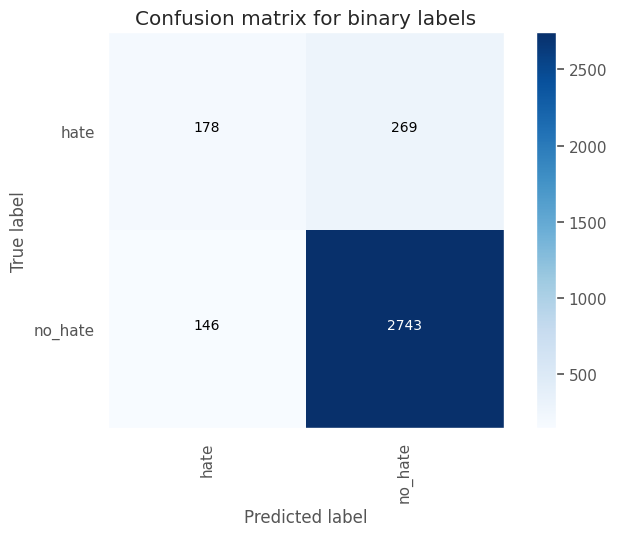

Test Accuracy: 0.8756
Test macro-F1: 0.6957




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_10 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_19 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_10 (Conv1D)          (None, 126, 64)           9664      
                                                                 
 max_pooling1d_10 (MaxPooli  (None, 42, 64)            0         
 ng1D)                                                           
                                                                 
 dropout_20 (Dropout)        (None, 42, 64)          

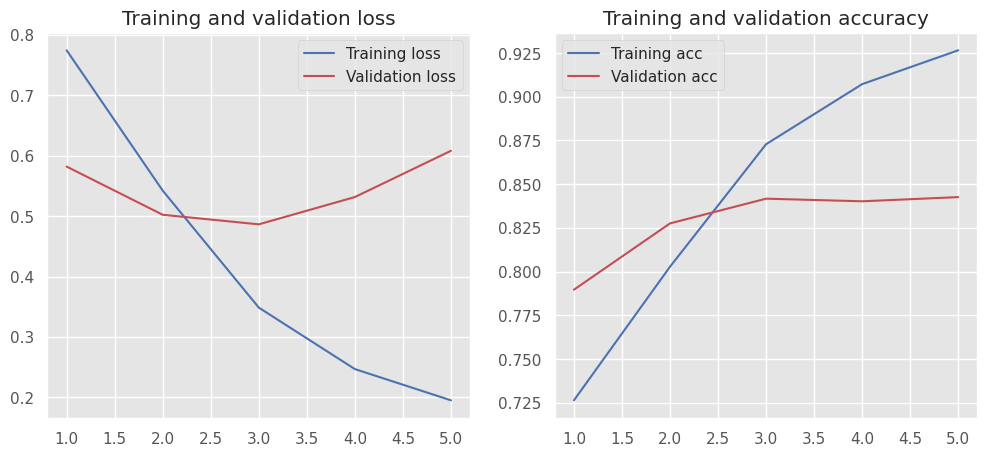

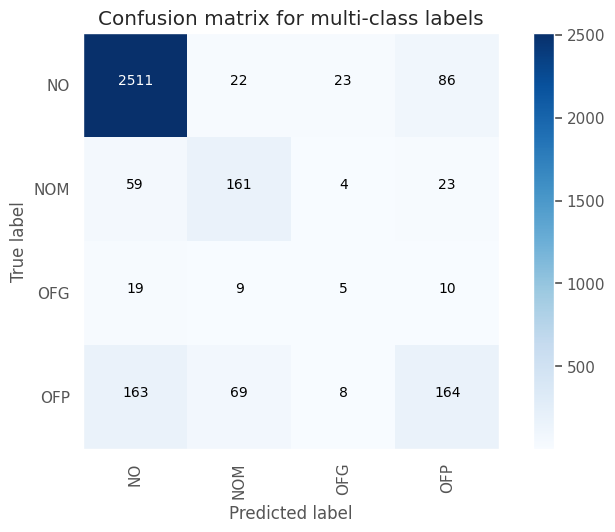

Test Accuracy: 0.8516
Test macro-F1: 0.5407


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5789    0.4183    0.4857       447
     no_hate     0.9137    0.9529    0.9329      2889

    accuracy                         0.8813      3336
   macro avg     0.7463    0.6856    0.7093      3336
weighted avg     0.8689    0.8813    0.8730      3336



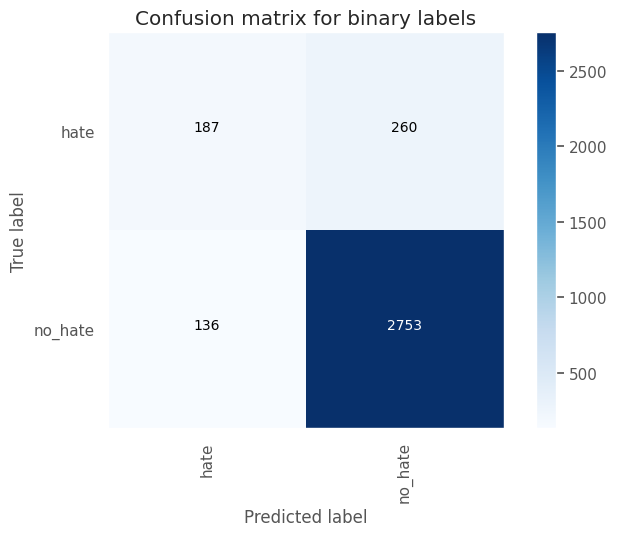

Test Accuracy: 0.8813
Test macro-F1: 0.7093




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_11 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_21 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_11 (Conv1D)          (None, 126, 64)           9664      
                                                                 
 max_pooling1d_11 (MaxPooli  (None, 42, 64)            0         
 ng1D)                                                           
                                                                 
 dropout_22 (Dropout)        (None, 42, 64)          

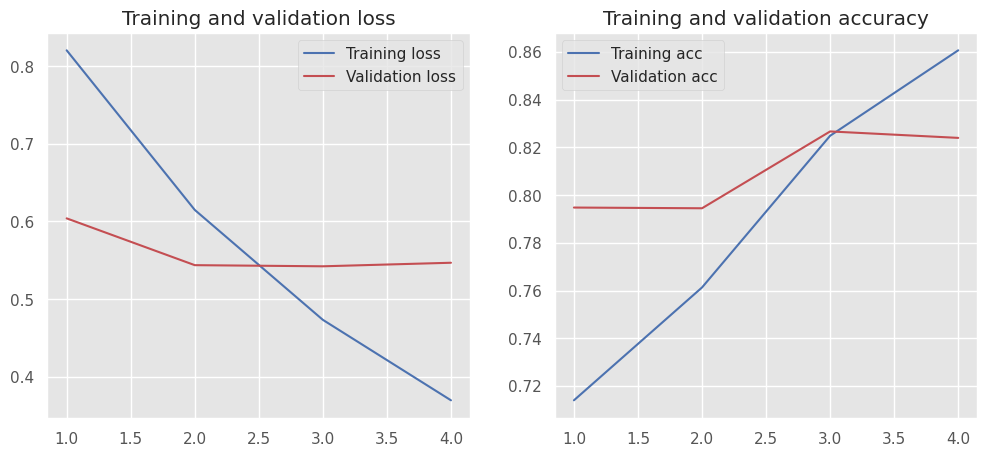

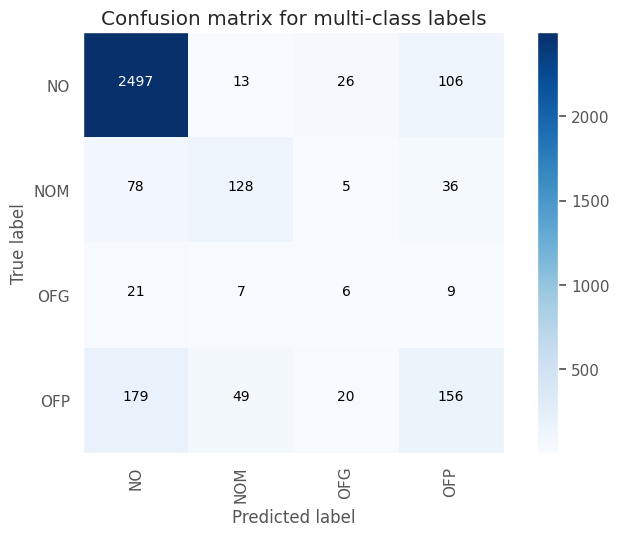

Test Accuracy: 0.8354
Test macro-F1: 0.5143


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5247    0.4273    0.4710       447
     no_hate     0.9139    0.9401    0.9268      2889

    accuracy                         0.8714      3336
   macro avg     0.7193    0.6837    0.6989      3336
weighted avg     0.8617    0.8714    0.8657      3336



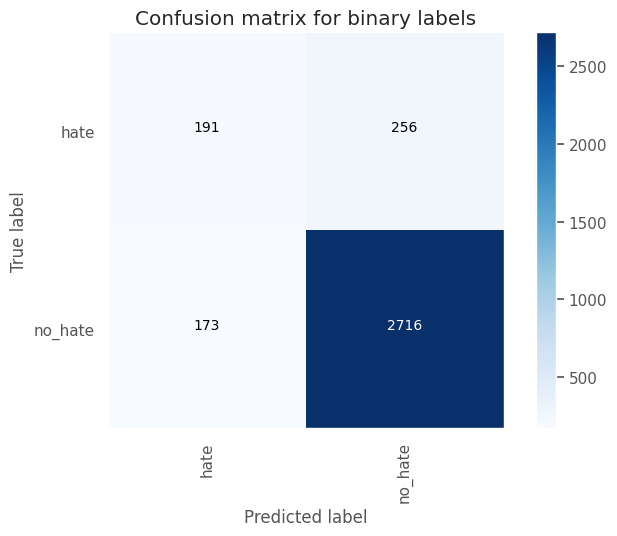

Test Accuracy: 0.8714
Test macro-F1: 0.6989




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_12 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_24 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_12 (Conv1D)          (None, 126, 64)           9664      
                                                                 
 max_pooling1d_12 (MaxPooli  (None, 42, 64)            0         
 ng1D)                                                           
                                                                 
 flatten_12 (Flatten)        (None, 2688)            

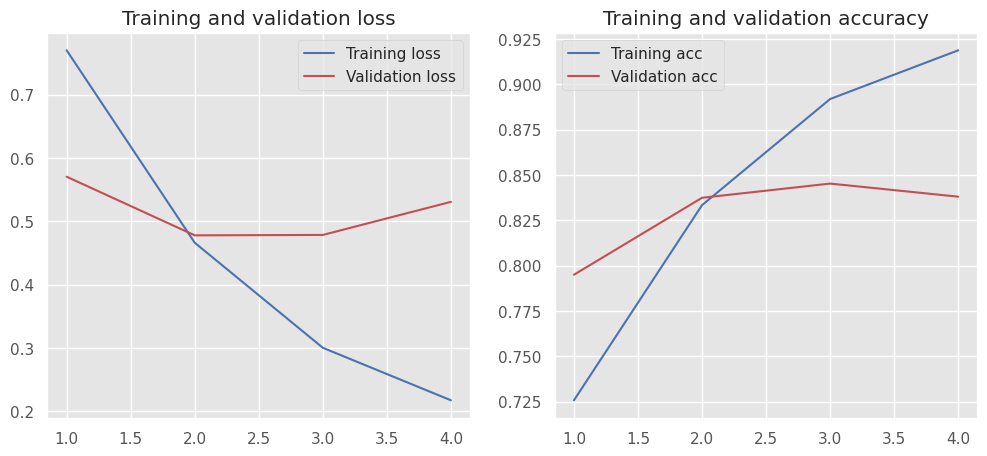

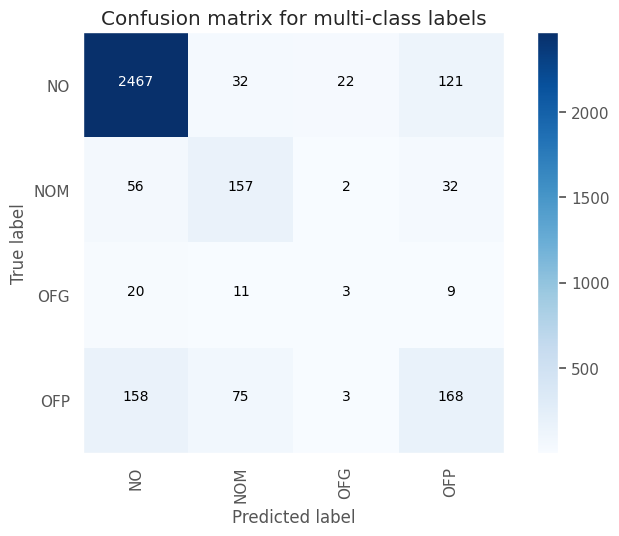

Test Accuracy: 0.8378
Test macro-F1: 0.5162


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5083    0.4094    0.4535       447
     no_hate     0.9113    0.9387    0.9248      2889

    accuracy                         0.8678      3336
   macro avg     0.7098    0.6741    0.6892      3336
weighted avg     0.8573    0.8678    0.8617      3336



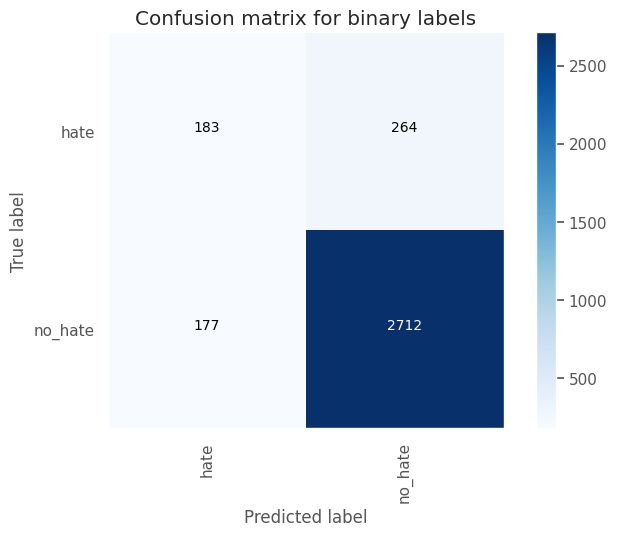

Test Accuracy: 0.8678
Test macro-F1: 0.6892




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_13 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_25 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_13 (Conv1D)          (None, 126, 64)           9664      
                                                                 
 max_pooling1d_13 (MaxPooli  (None, 42, 64)            0         
 ng1D)                                                           
                                                                 
 flatten_13 (Flatten)        (None, 2688)            

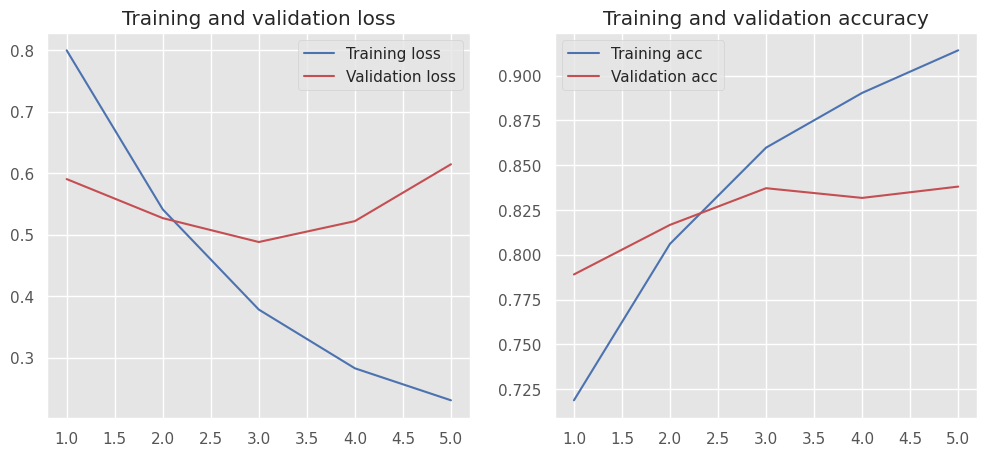

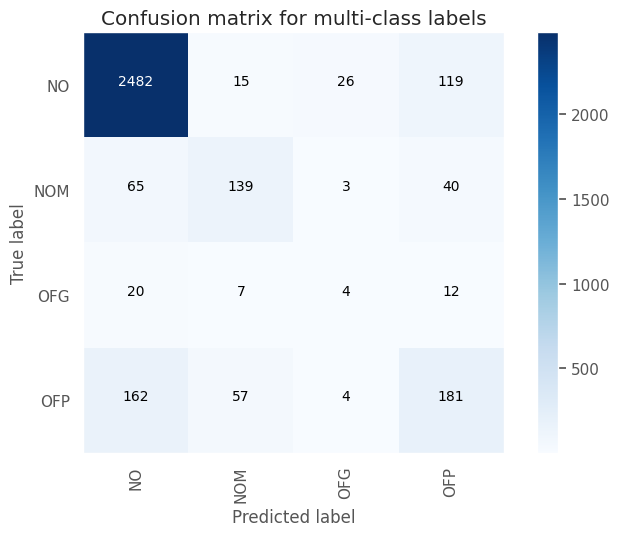

Test Accuracy: 0.8411
Test macro-F1: 0.5252


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5167    0.4497    0.4809       447
     no_hate     0.9165    0.9349    0.9256      2889

    accuracy                         0.8699      3336
   macro avg     0.7166    0.6923    0.7032      3336
weighted avg     0.8630    0.8699    0.8660      3336



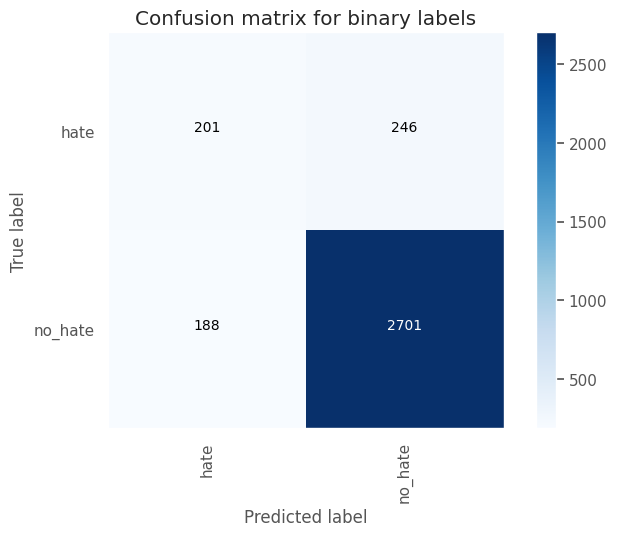

Test Accuracy: 0.8699
Test macro-F1: 0.7032




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_14 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_27 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_14 (Conv1D)          (None, 126, 64)           9664      
                                                                 
 max_pooling1d_14 (MaxPooli  (None, 42, 64)            0         
 ng1D)                                                           
                                                                 
 dropout_28 (Dropout)        (None, 42, 64)          

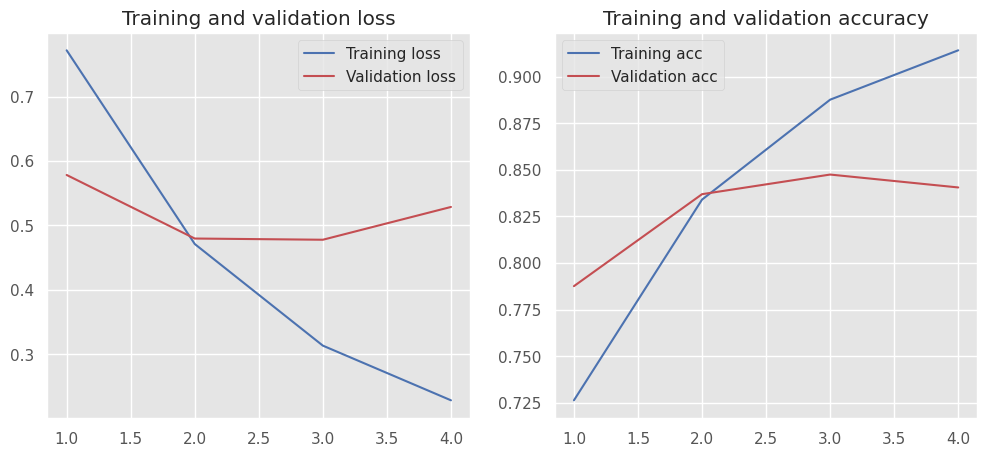

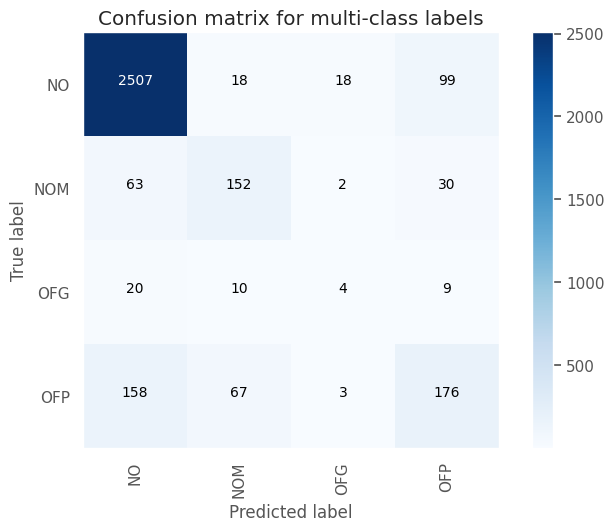

Test Accuracy: 0.851
Test macro-F1: 0.5375


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5630    0.4295    0.4873       447
     no_hate     0.9149    0.9484    0.9313      2889

    accuracy                         0.8789      3336
   macro avg     0.7390    0.6890    0.7093      3336
weighted avg     0.8677    0.8789    0.8718      3336



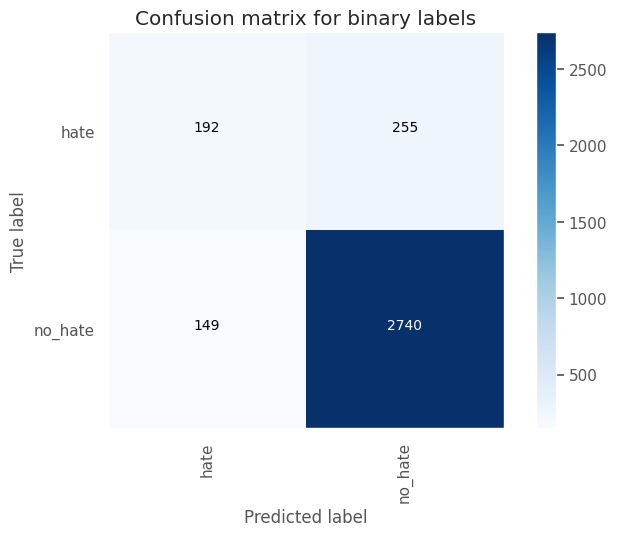

Test Accuracy: 0.8789
Test macro-F1: 0.7093




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_15 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_29 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_15 (Conv1D)          (None, 126, 64)           9664      
                                                                 
 max_pooling1d_15 (MaxPooli  (None, 42, 64)            0         
 ng1D)                                                           
                                                                 
 dropout_30 (Dropout)        (None, 42, 64)          

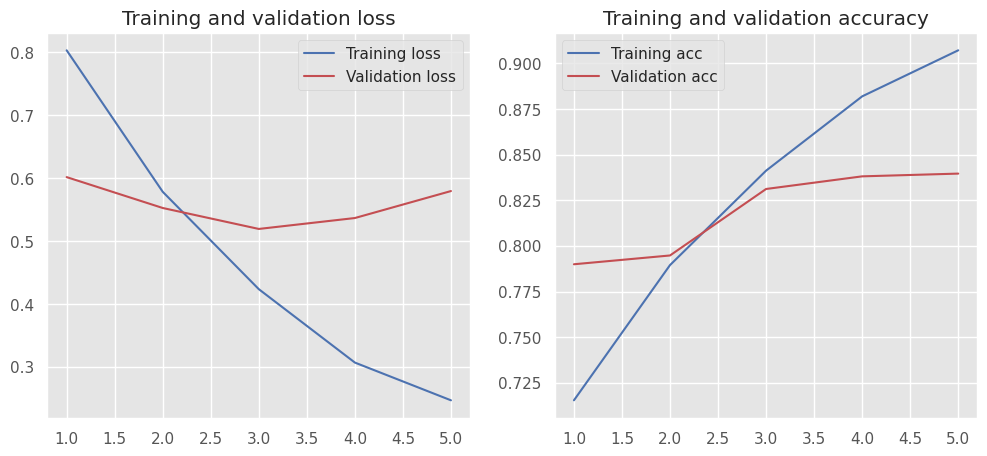

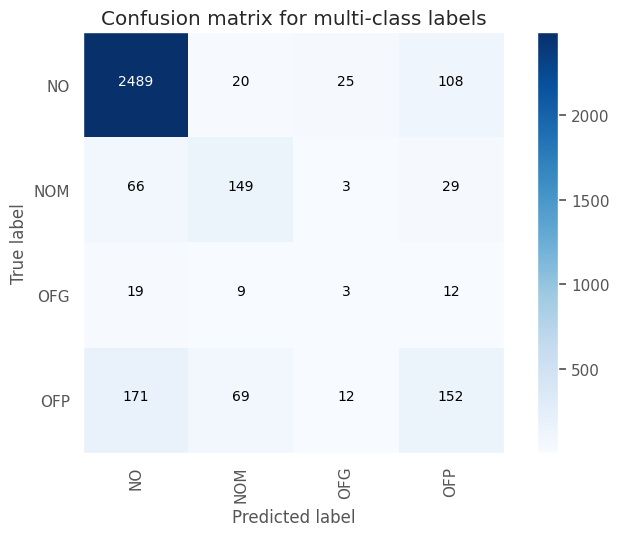

Test Accuracy: 0.8372
Test macro-F1: 0.5071


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5203    0.4004    0.4526       447
     no_hate     0.9104    0.9429    0.9264      2889

    accuracy                         0.8702      3336
   macro avg     0.7154    0.6717    0.6895      3336
weighted avg     0.8582    0.8702    0.8629      3336



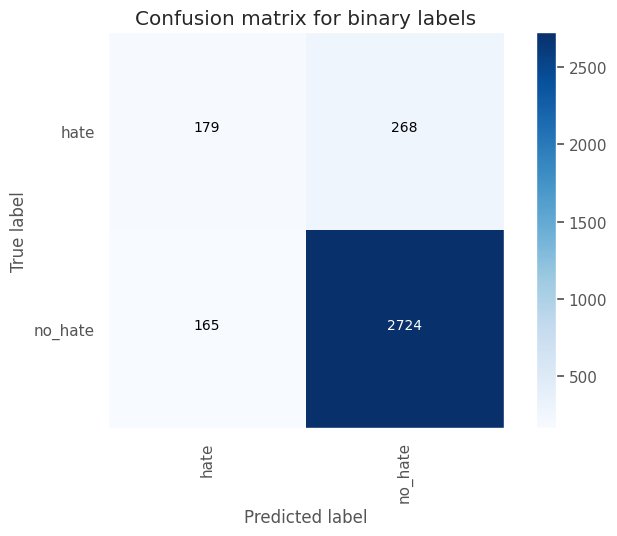

Test Accuracy: 0.8702
Test macro-F1: 0.6895




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_16 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_32 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_16 (Conv1D)          (None, 126, 32)           4832      
                                                                 
 max_pooling1d_16 (MaxPooli  (None, 42, 32)            0         
 ng1D)                                                           
                                                                 
 flatten_16 (Flatten)        (None, 1344)            

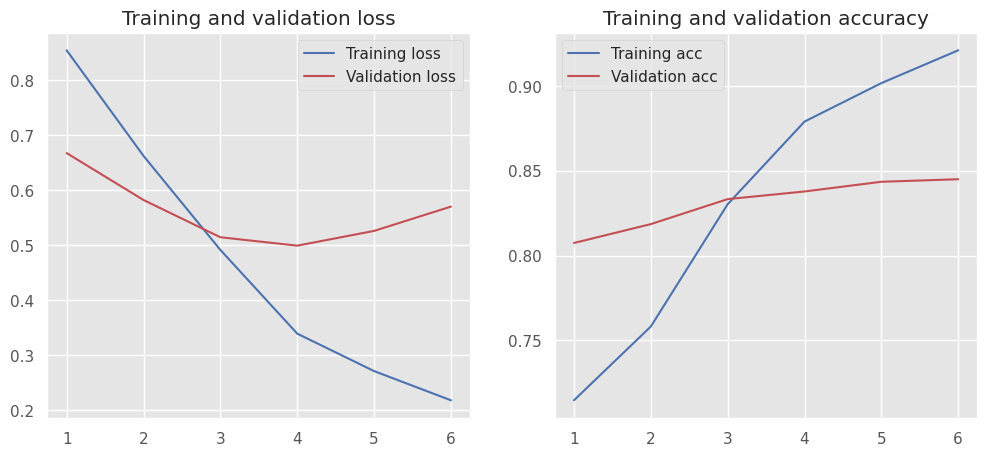

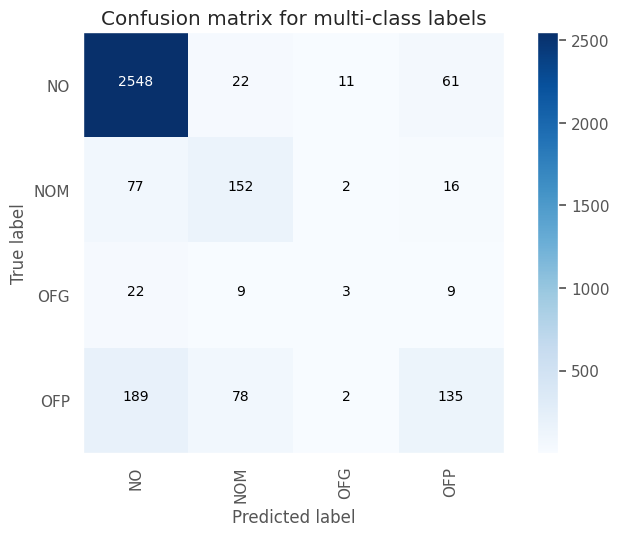

Test Accuracy: 0.8507
Test macro-F1: 0.5148


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6234    0.3333    0.4344       447
     no_hate     0.9038    0.9688    0.9352      2889

    accuracy                         0.8837      3336
   macro avg     0.7636    0.6511    0.6848      3336
weighted avg     0.8662    0.8837    0.8681      3336



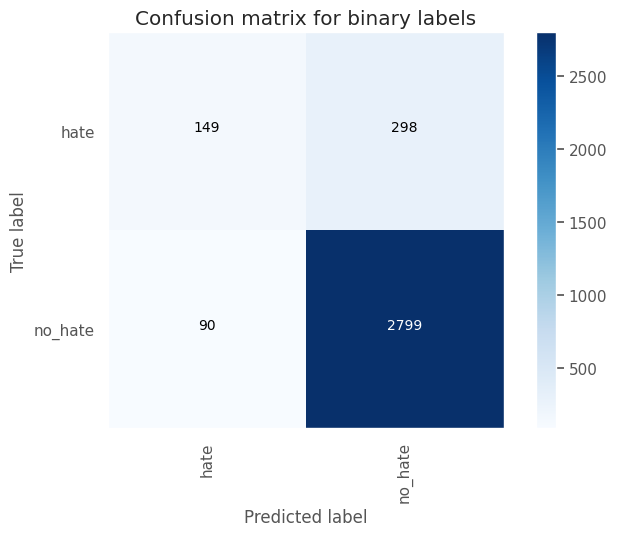

Test Accuracy: 0.8837
Test macro-F1: 0.6848




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_17 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_33 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_17 (Conv1D)          (None, 126, 32)           4832      
                                                                 
 max_pooling1d_17 (MaxPooli  (None, 42, 32)            0         
 ng1D)                                                           
                                                                 
 flatten_17 (Flatten)        (None, 1344)            

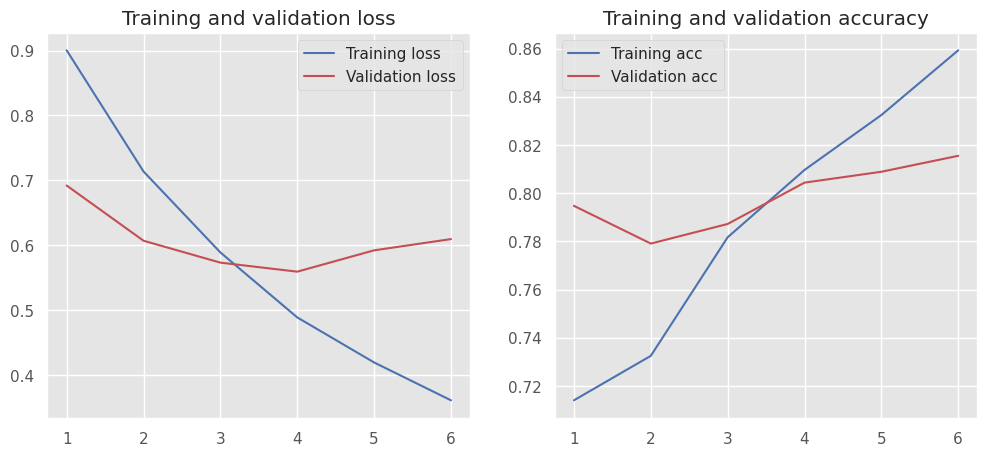

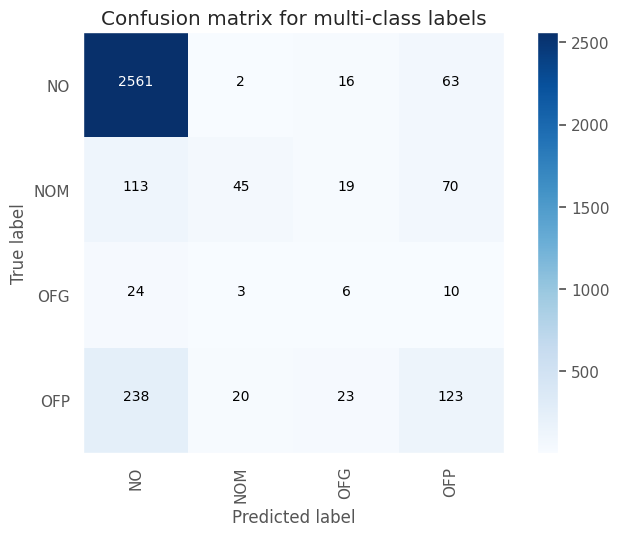

Test Accuracy: 0.8198
Test macro-F1: 0.4204


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4909    0.3624    0.4170       447
     no_hate     0.9052    0.9418    0.9232      2889

    accuracy                         0.8642      3336
   macro avg     0.6980    0.6521    0.6701      3336
weighted avg     0.8497    0.8642    0.8553      3336



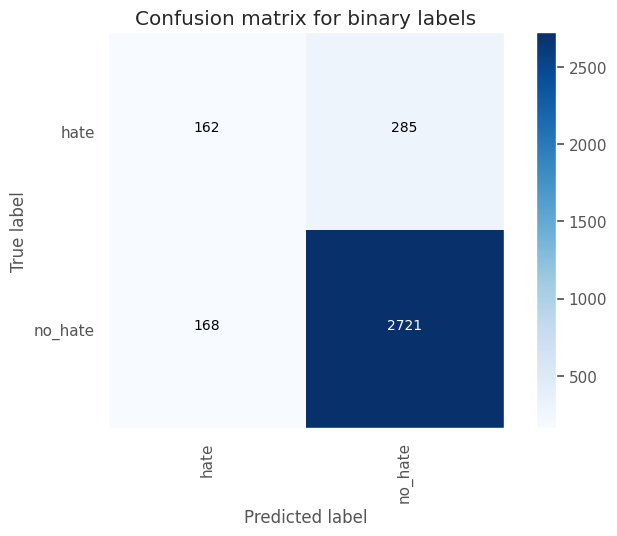

Test Accuracy: 0.8642
Test macro-F1: 0.6701




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_18 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_35 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_18 (Conv1D)          (None, 126, 32)           4832      
                                                                 
 max_pooling1d_18 (MaxPooli  (None, 42, 32)            0         
 ng1D)                                                           
                                                                 
 dropout_36 (Dropout)        (None, 42, 32)          

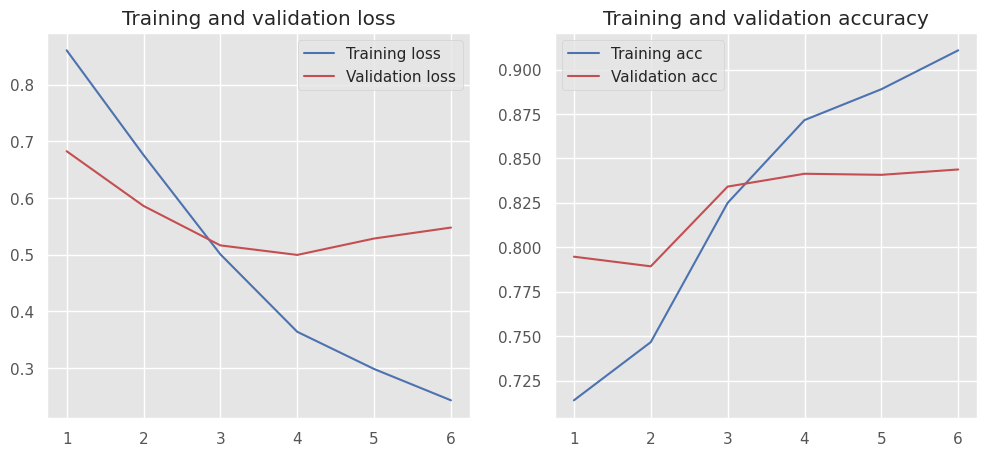

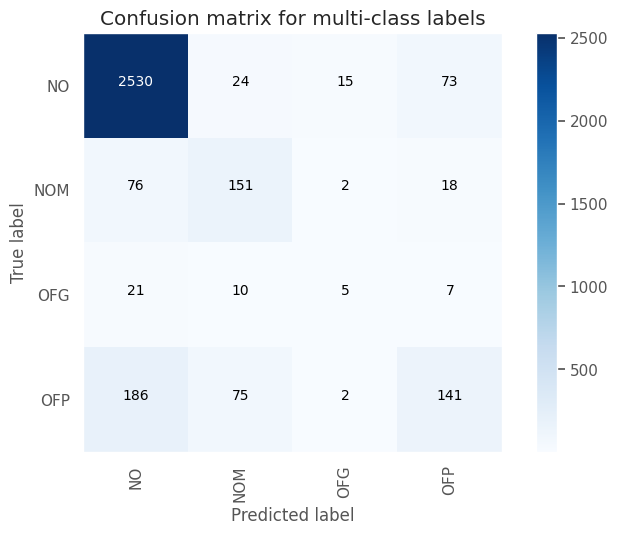

Test Accuracy: 0.8474
Test macro-F1: 0.5278


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5894    0.3468    0.4366       447
     no_hate     0.9050    0.9626    0.9329      2889

    accuracy                         0.8801      3336
   macro avg     0.7472    0.6547    0.6848      3336
weighted avg     0.8627    0.8801    0.8664      3336



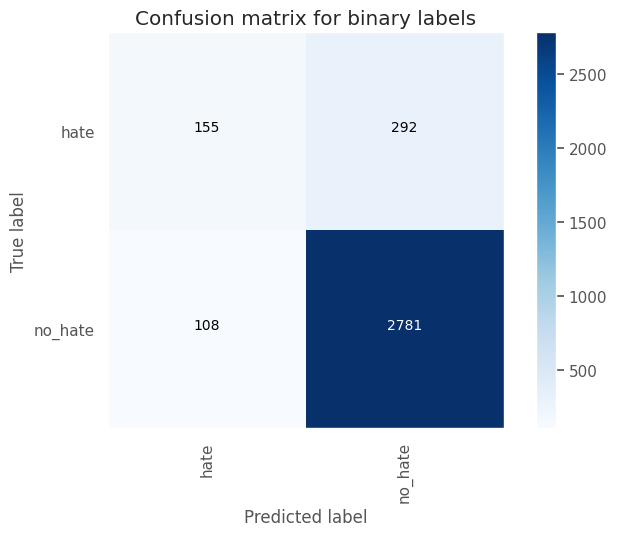

Test Accuracy: 0.8801
Test macro-F1: 0.6848




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_19 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_37 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_19 (Conv1D)          (None, 126, 32)           4832      
                                                                 
 max_pooling1d_19 (MaxPooli  (None, 42, 32)            0         
 ng1D)                                                           
                                                                 
 dropout_38 (Dropout)        (None, 42, 32)          

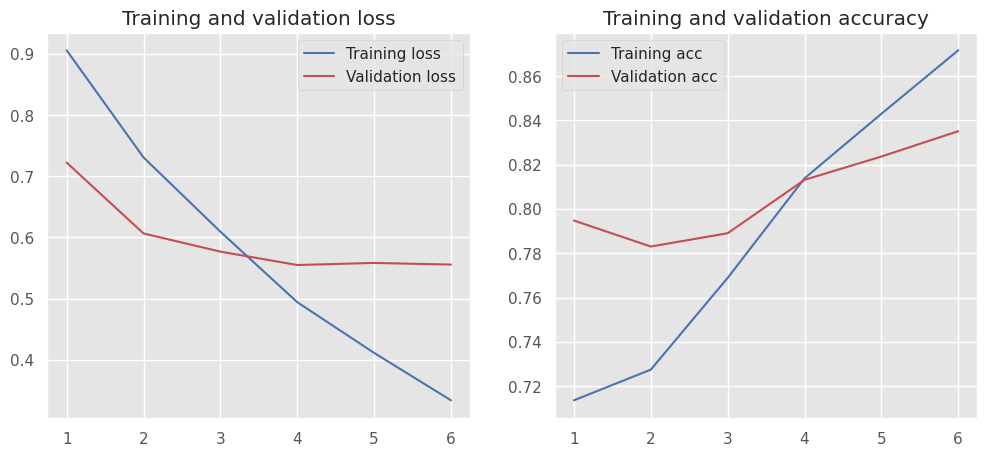

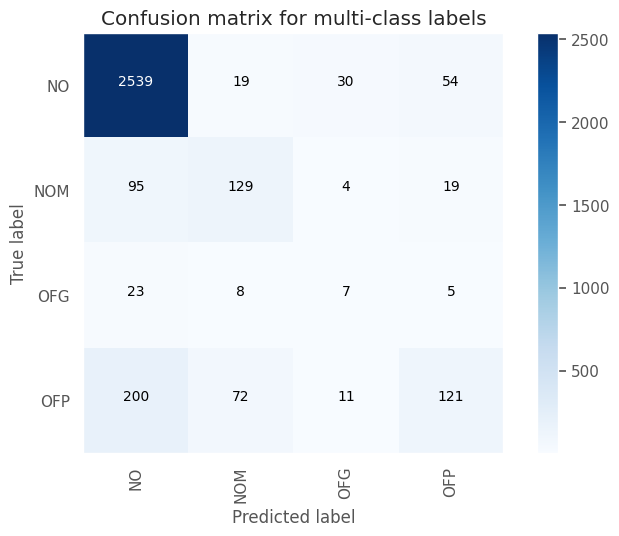

Test Accuracy: 0.8381
Test macro-F1: 0.5038


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5737    0.3221    0.4126       447
     no_hate     0.9018    0.9630    0.9314      2889

    accuracy                         0.8771      3336
   macro avg     0.7377    0.6426    0.6720      3336
weighted avg     0.8578    0.8771    0.8619      3336



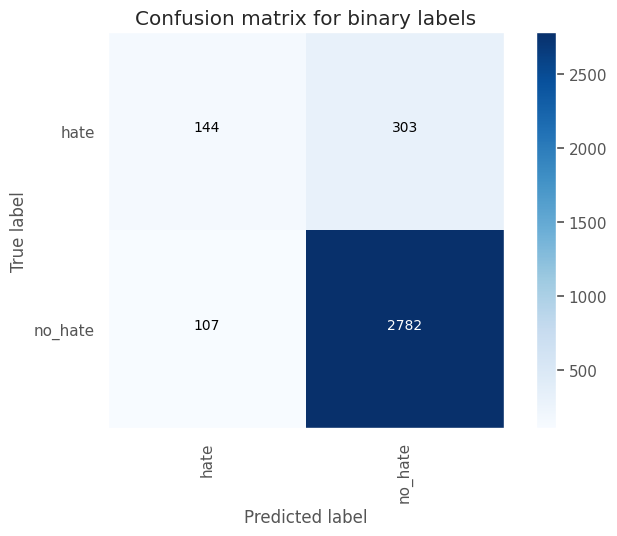

Test Accuracy: 0.8771
Test macro-F1: 0.672




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_20 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_40 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_20 (Conv1D)          (None, 126, 32)           4832      
                                                                 
 max_pooling1d_20 (MaxPooli  (None, 42, 32)            0         
 ng1D)                                                           
                                                                 
 flatten_20 (Flatten)        (None, 1344)             

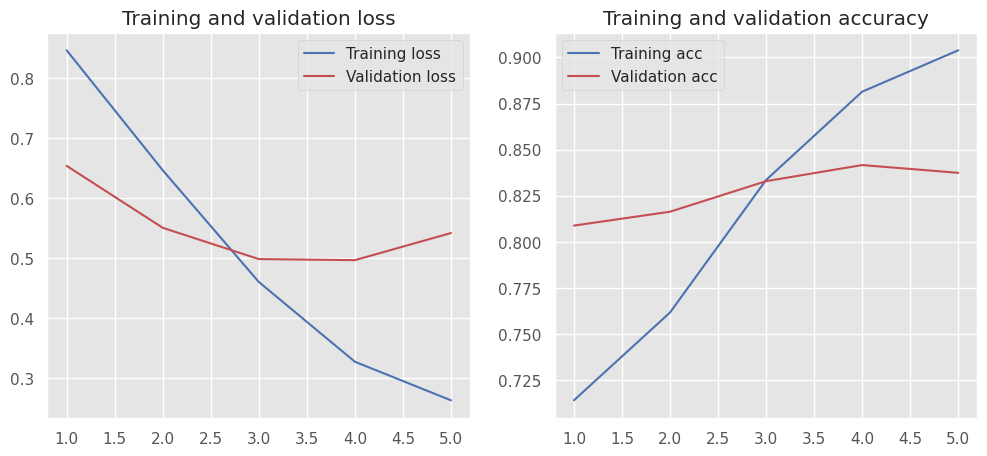

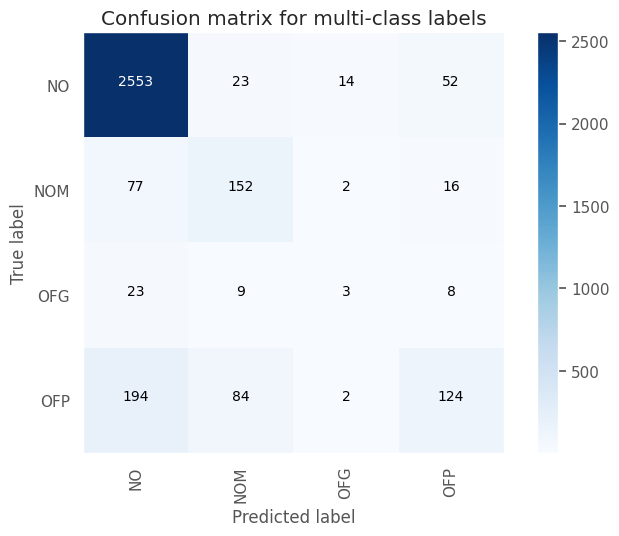

Test Accuracy: 0.8489
Test macro-F1: 0.5062


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6199    0.3065    0.4102       447
     no_hate     0.9005    0.9709    0.9344      2889

    accuracy                         0.8819      3336
   macro avg     0.7602    0.6387    0.6723      3336
weighted avg     0.8629    0.8819    0.8641      3336



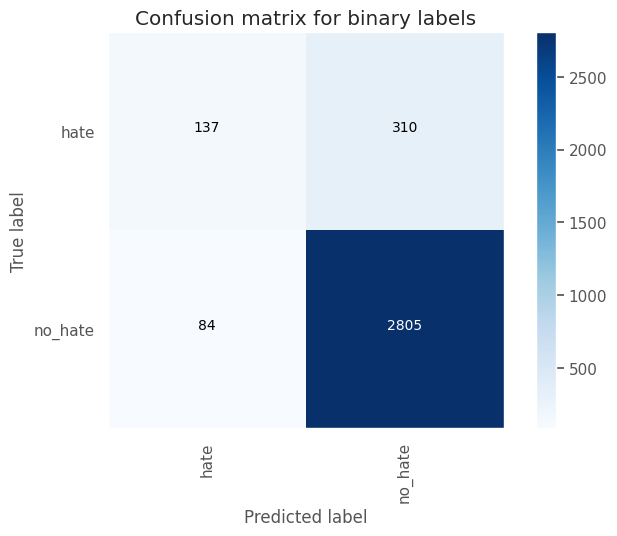

Test Accuracy: 0.8819
Test macro-F1: 0.6723




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_21 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_41 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_21 (Conv1D)          (None, 126, 32)           4832      
                                                                 
 max_pooling1d_21 (MaxPooli  (None, 42, 32)            0         
 ng1D)                                                           
                                                                 
 flatten_21 (Flatten)        (None, 1344)            

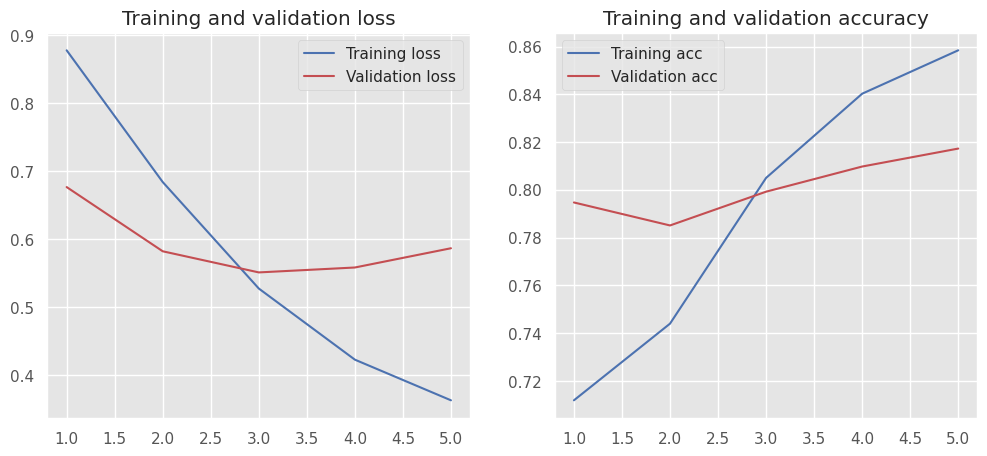

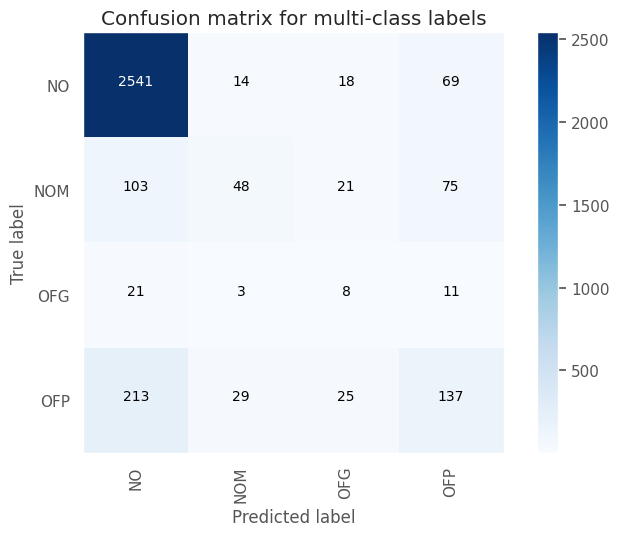

Test Accuracy: 0.8195
Test macro-F1: 0.4337


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4973    0.4049    0.4464       447
     no_hate     0.9105    0.9367    0.9234      2889

    accuracy                         0.8654      3336
   macro avg     0.7039    0.6708    0.6849      3336
weighted avg     0.8551    0.8654    0.8595      3336



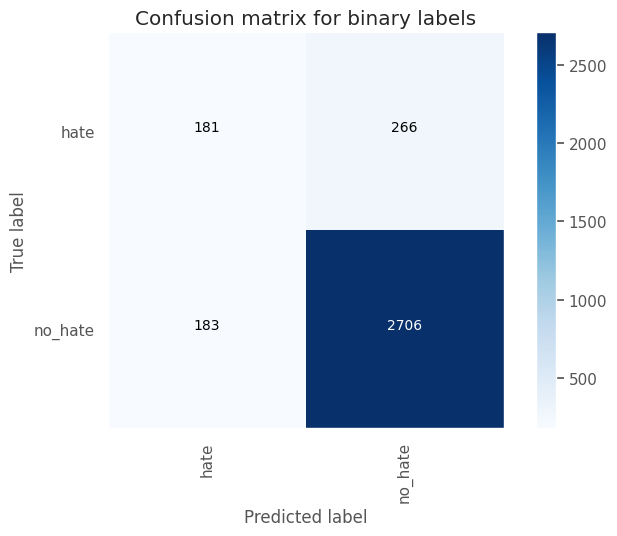

Test Accuracy: 0.8654
Test macro-F1: 0.6849




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_22 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_43 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_22 (Conv1D)          (None, 126, 32)           4832      
                                                                 
 max_pooling1d_22 (MaxPooli  (None, 42, 32)            0         
 ng1D)                                                           
                                                                 
 dropout_44 (Dropout)        (None, 42, 32)          

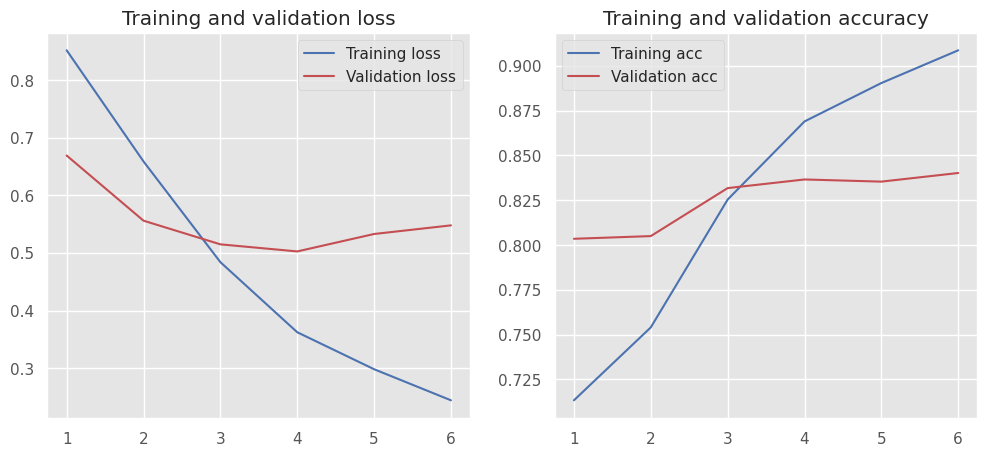

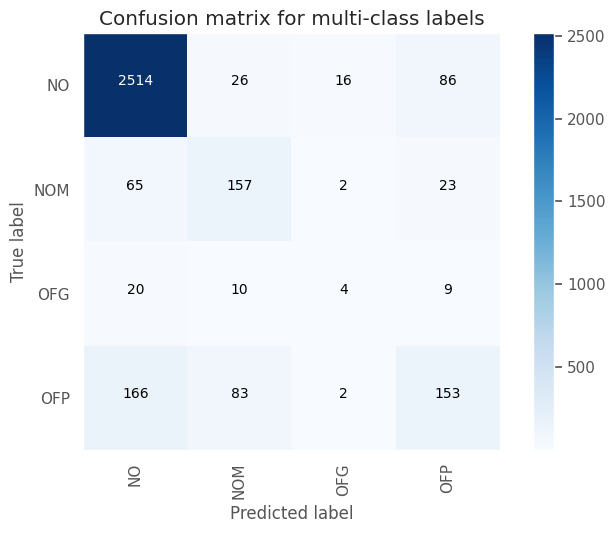

Test Accuracy: 0.8477
Test macro-F1: 0.5258


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5695    0.3758    0.4528       447
     no_hate     0.9083    0.9560    0.9315      2889

    accuracy                         0.8783      3336
   macro avg     0.7389    0.6659    0.6922      3336
weighted avg     0.8629    0.8783    0.8674      3336



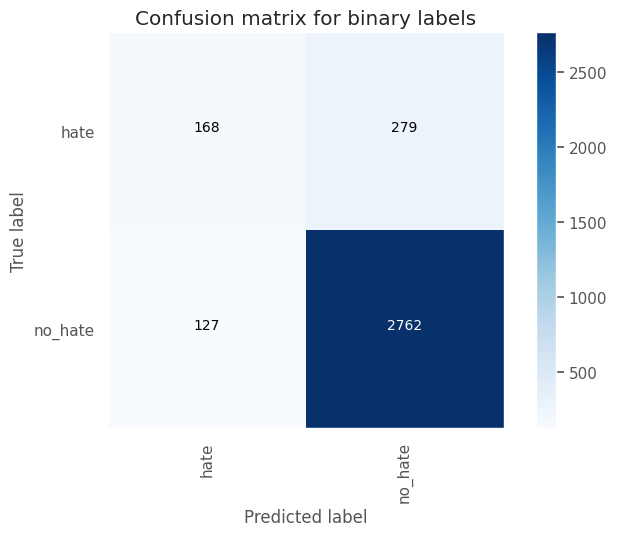

Test Accuracy: 0.8783
Test macro-F1: 0.6922




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_23 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_45 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_23 (Conv1D)          (None, 126, 32)           4832      
                                                                 
 max_pooling1d_23 (MaxPooli  (None, 42, 32)            0         
 ng1D)                                                           
                                                                 
 dropout_46 (Dropout)        (None, 42, 32)          

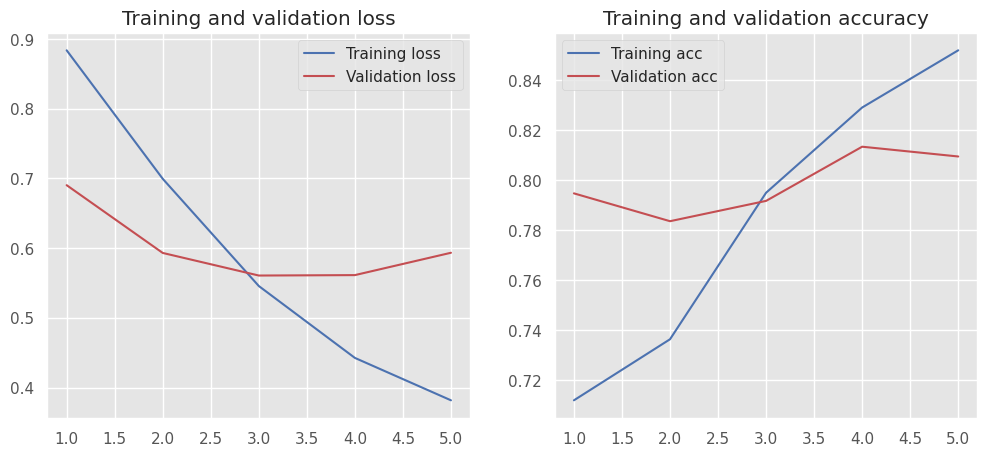

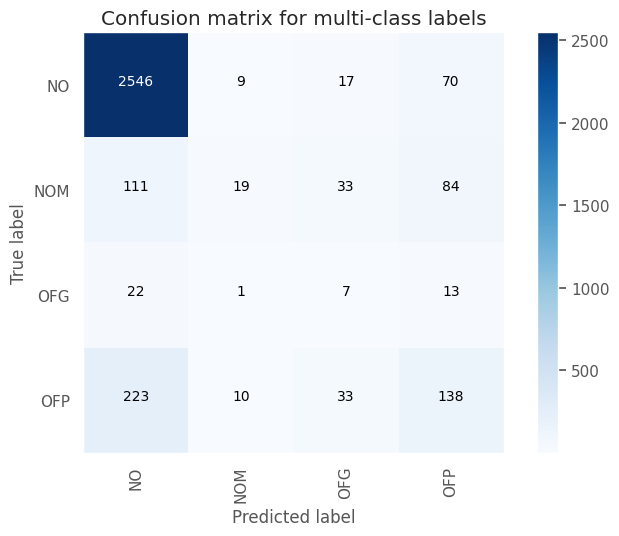

Test Accuracy: 0.8124
Test macro-F1: 0.3865


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4835    0.4273    0.4537       447
     no_hate     0.9130    0.9294    0.9211      2889

    accuracy                         0.8621      3336
   macro avg     0.6982    0.6783    0.6874      3336
weighted avg     0.8554    0.8621    0.8585      3336



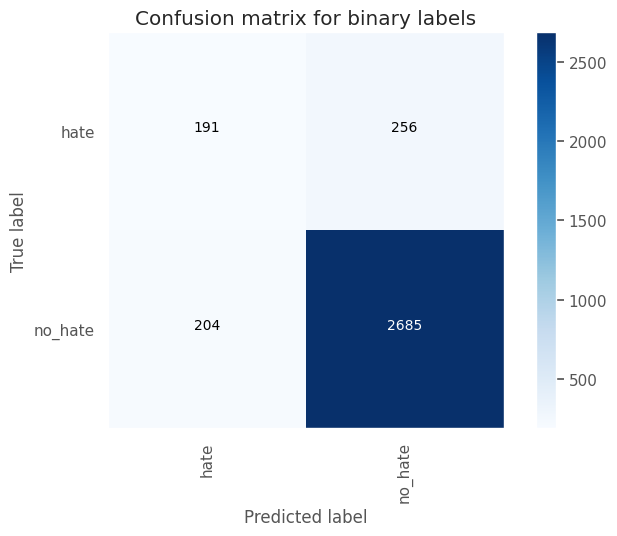

Test Accuracy: 0.8621
Test macro-F1: 0.6874




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_24 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_48 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_24 (Conv1D)          (None, 126, 64)           9664      
                                                                 
 max_pooling1d_24 (MaxPooli  (None, 42, 64)            0         
 ng1D)                                                           
                                                                 
 flatten_24 (Flatten)        (None, 2688)            

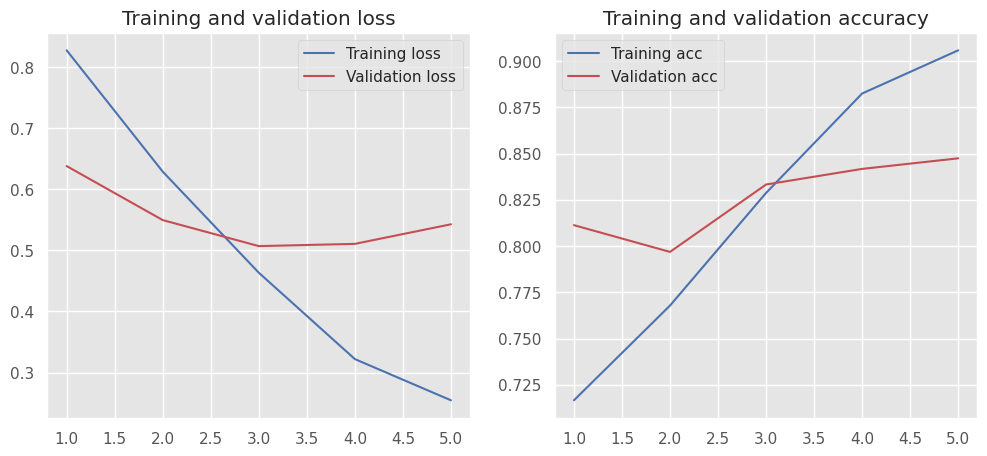

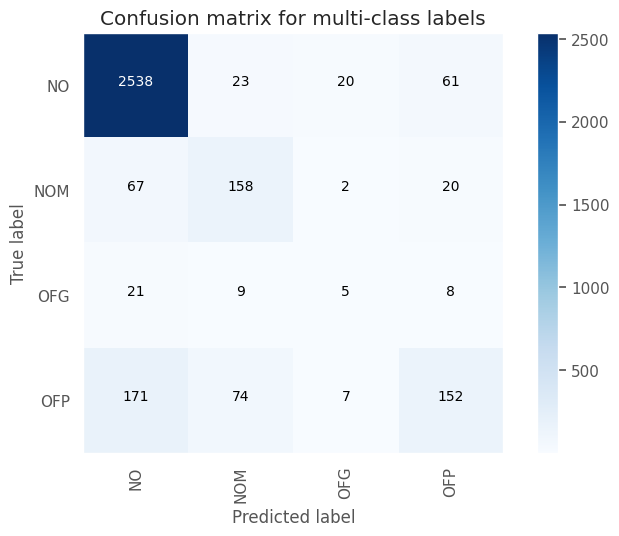

Test Accuracy: 0.8552
Test macro-F1: 0.5382


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6255    0.3848    0.4765       447
     no_hate     0.9102    0.9643    0.9365      2889

    accuracy                         0.8867      3336
   macro avg     0.7678    0.6746    0.7065      3336
weighted avg     0.8720    0.8867    0.8748      3336



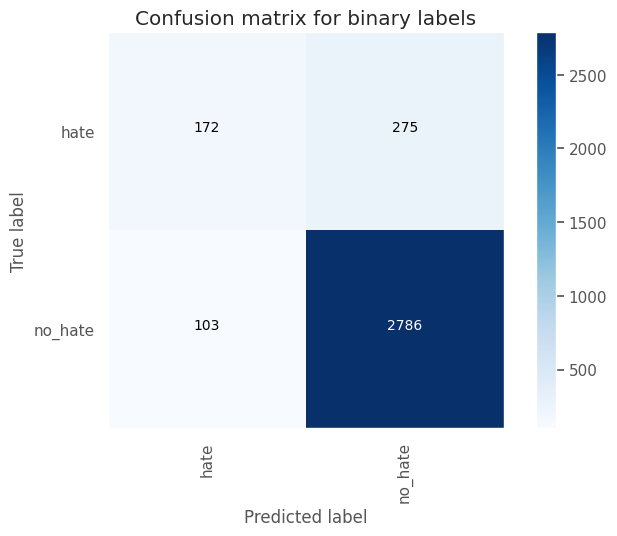

Test Accuracy: 0.8867
Test macro-F1: 0.7065




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_25 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_49 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_25 (Conv1D)          (None, 126, 64)           9664      
                                                                 
 max_pooling1d_25 (MaxPooli  (None, 42, 64)            0         
 ng1D)                                                           
                                                                 
 flatten_25 (Flatten)        (None, 2688)            

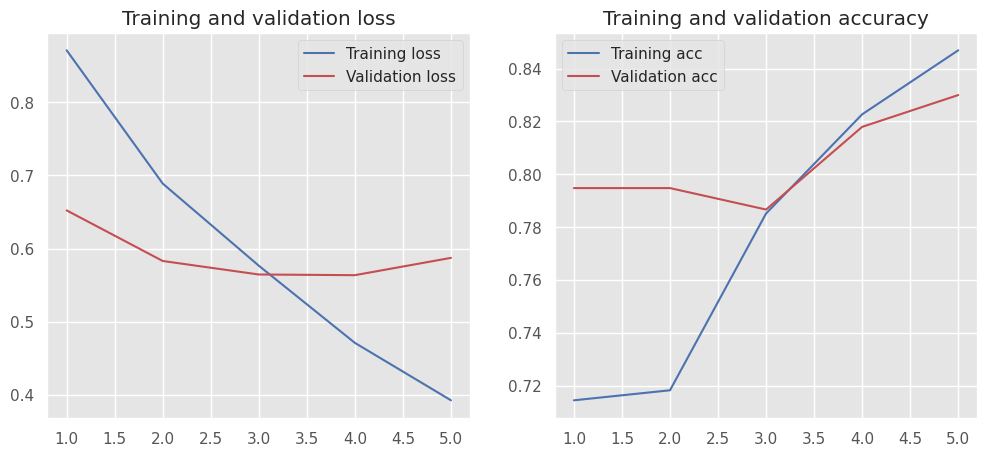

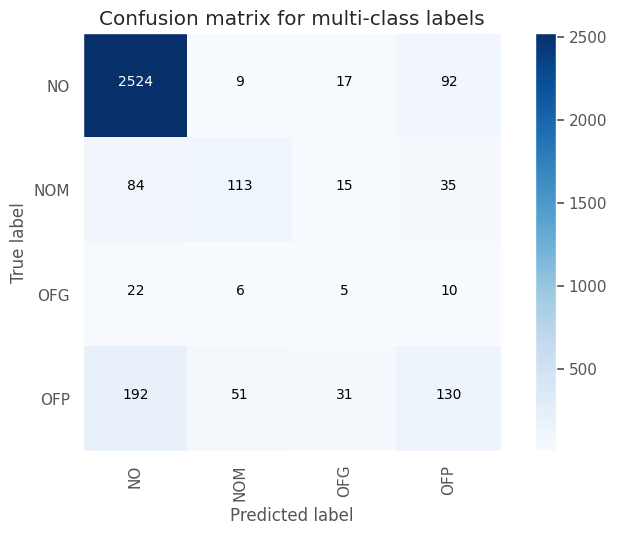

Test Accuracy: 0.8309
Test macro-F1: 0.483


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5254    0.3937    0.4501       447
     no_hate     0.9097    0.9450    0.9270      2889

    accuracy                         0.8711      3336
   macro avg     0.7175    0.6693    0.6886      3336
weighted avg     0.8582    0.8711    0.8631      3336



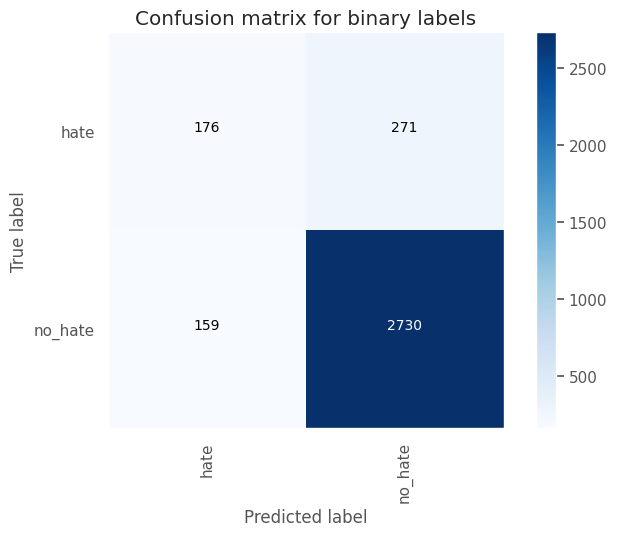

Test Accuracy: 0.8711
Test macro-F1: 0.6886




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_26 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_51 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_26 (Conv1D)          (None, 126, 64)           9664      
                                                                 
 max_pooling1d_26 (MaxPooli  (None, 42, 64)            0         
 ng1D)                                                           
                                                                 
 dropout_52 (Dropout)        (None, 42, 64)          

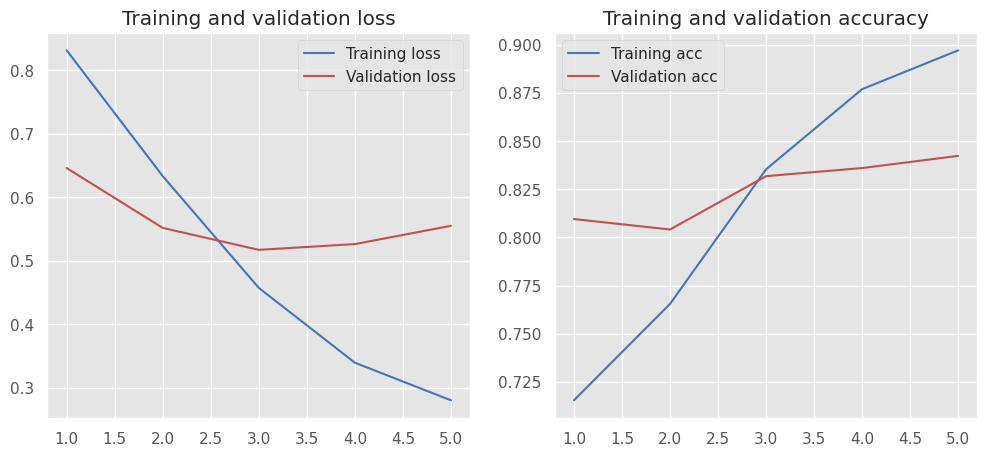

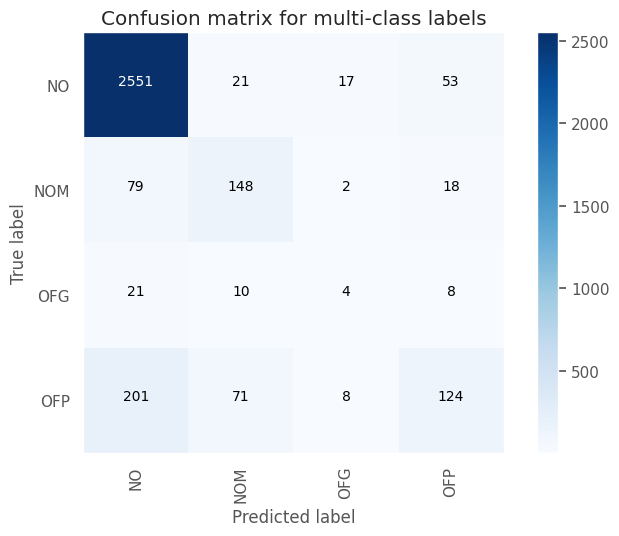

Test Accuracy: 0.8474
Test macro-F1: 0.5102


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6154    0.3221    0.4229       447
     no_hate     0.9023    0.9688    0.9344      2889

    accuracy                         0.8822      3336
   macro avg     0.7589    0.6455    0.6787      3336
weighted avg     0.8639    0.8822    0.8659      3336



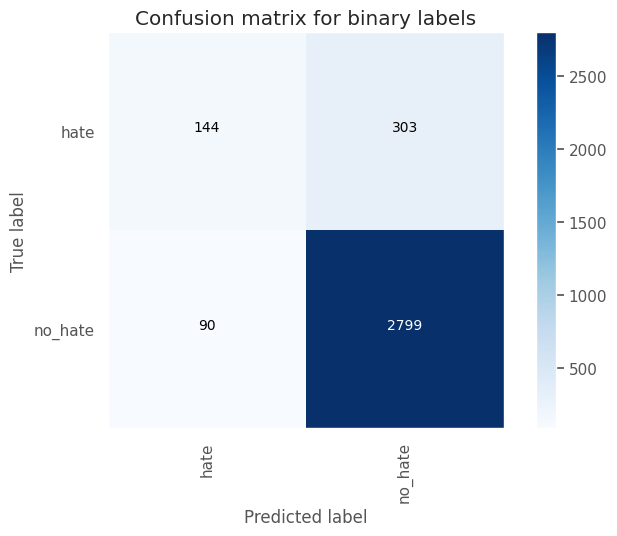

Test Accuracy: 0.8822
Test macro-F1: 0.6787




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_27 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_53 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_27 (Conv1D)          (None, 126, 64)           9664      
                                                                 
 max_pooling1d_27 (MaxPooli  (None, 42, 64)            0         
 ng1D)                                                           
                                                                 
 dropout_54 (Dropout)        (None, 42, 64)          

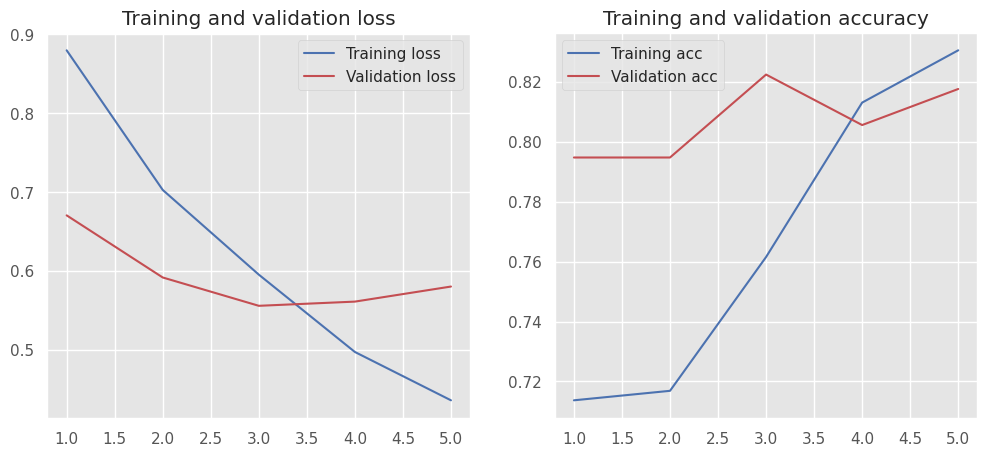

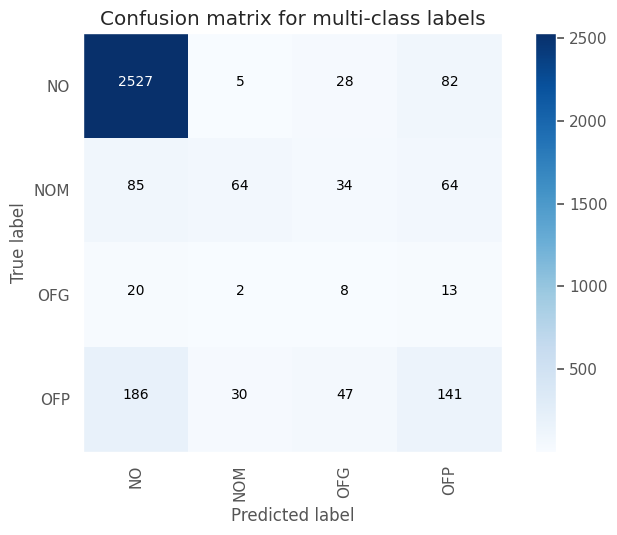

Test Accuracy: 0.8213
Test macro-F1: 0.4485


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5012    0.4676    0.4838       447
     no_hate     0.9185    0.9280    0.9232      2889

    accuracy                         0.8663      3336
   macro avg     0.7098    0.6978    0.7035      3336
weighted avg     0.8626    0.8663    0.8643      3336



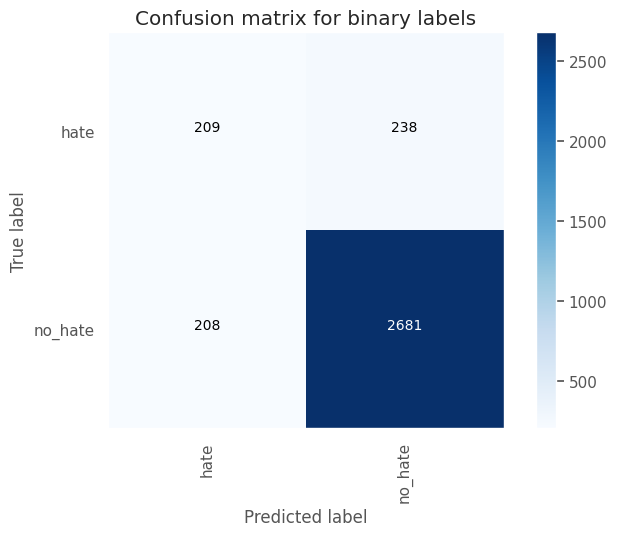

Test Accuracy: 0.8663
Test macro-F1: 0.7035




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_28 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_56 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_28 (Conv1D)          (None, 126, 64)           9664      
                                                                 
 max_pooling1d_28 (MaxPooli  (None, 42, 64)            0         
 ng1D)                                                           
                                                                 
 flatten_28 (Flatten)        (None, 2688)            

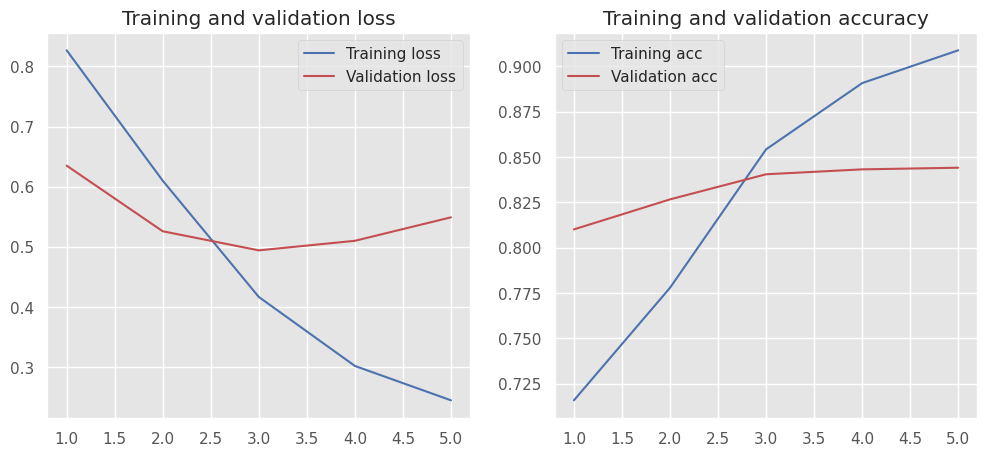

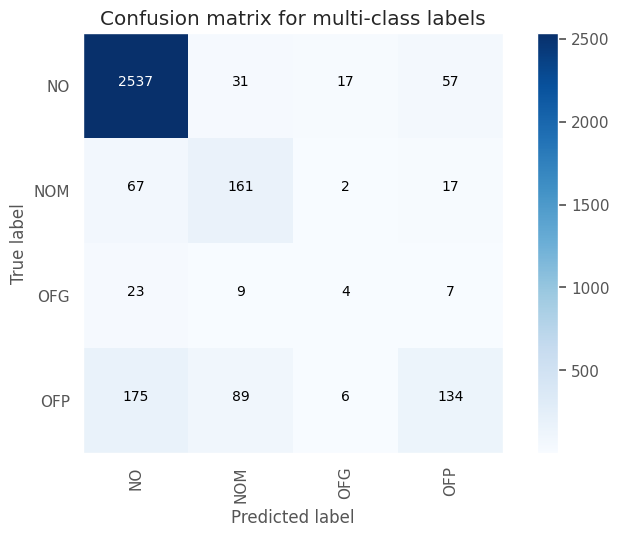

Test Accuracy: 0.8501
Test macro-F1: 0.5189


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6189    0.3378    0.4370       447
     no_hate     0.9043    0.9678    0.9350      2889

    accuracy                         0.8834      3336
   macro avg     0.7616    0.6528    0.6860      3336
weighted avg     0.8660    0.8834    0.8682      3336



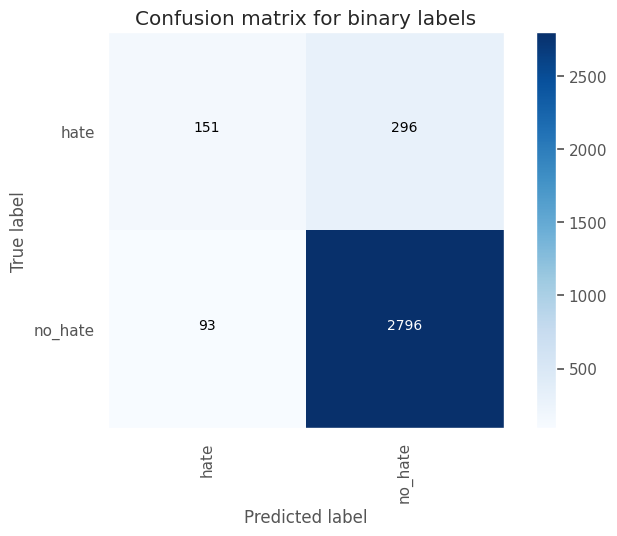

Test Accuracy: 0.8834
Test macro-F1: 0.686




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_29 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_57 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_29 (Conv1D)          (None, 126, 64)           9664      
                                                                 
 max_pooling1d_29 (MaxPooli  (None, 42, 64)            0         
 ng1D)                                                           
                                                                 
 flatten_29 (Flatten)        (None, 2688)             

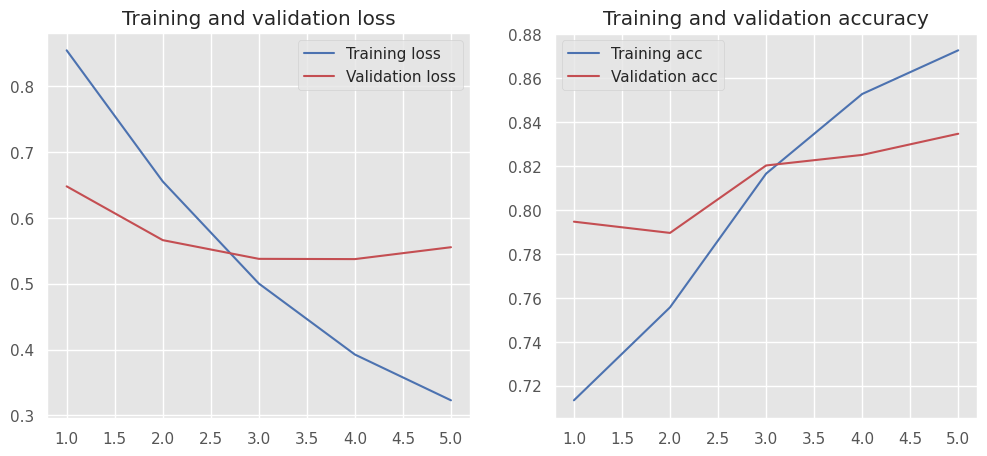

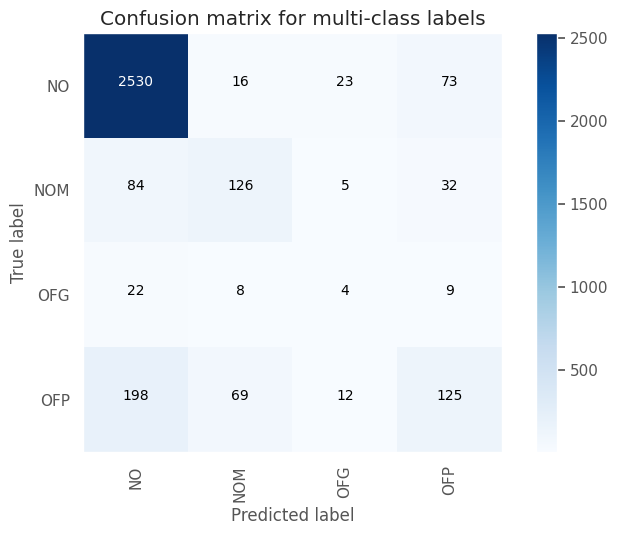

Test Accuracy: 0.8348
Test macro-F1: 0.4864


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5300    0.3356    0.4110       447
     no_hate     0.9027    0.9540    0.9276      2889

    accuracy                         0.8711      3336
   macro avg     0.7164    0.6448    0.6693      3336
weighted avg     0.8528    0.8711    0.8584      3336



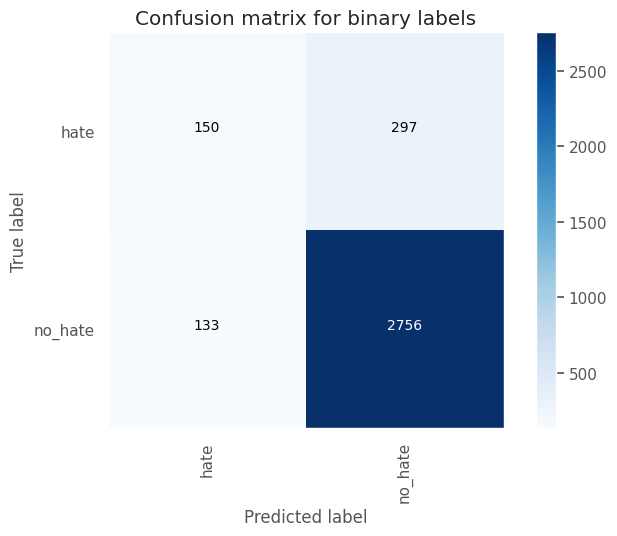

Test Accuracy: 0.8711
Test macro-F1: 0.6693




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_30 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_59 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_30 (Conv1D)          (None, 126, 64)           9664      
                                                                 
 max_pooling1d_30 (MaxPooli  (None, 42, 64)            0         
 ng1D)                                                           
                                                                 
 dropout_60 (Dropout)        (None, 42, 64)          

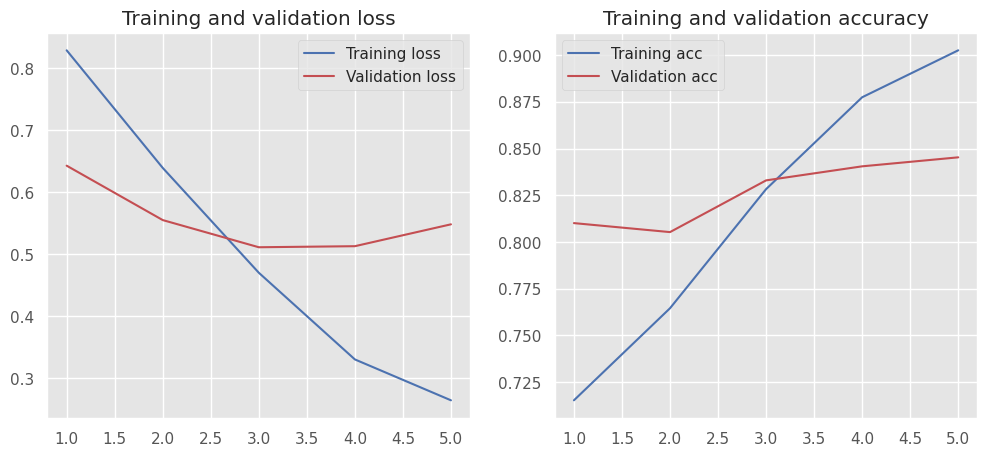

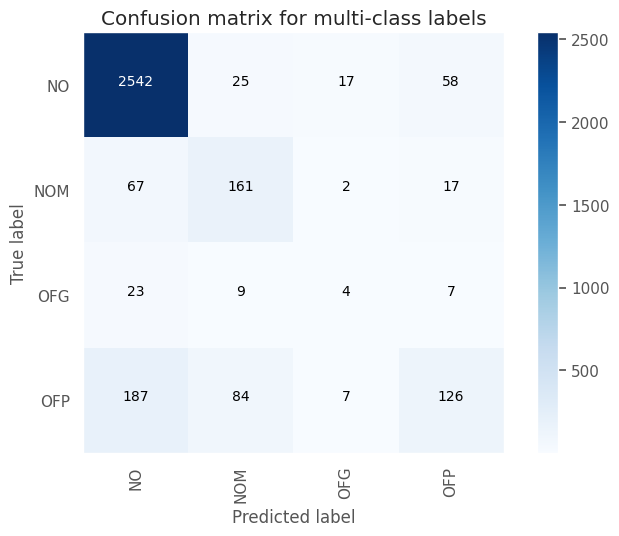

Test Accuracy: 0.8492
Test macro-F1: 0.5161


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6050    0.3221    0.4204       447
     no_hate     0.9022    0.9675    0.9337      2889

    accuracy                         0.8810      3336
   macro avg     0.7536    0.6448    0.6771      3336
weighted avg     0.8624    0.8810    0.8649      3336



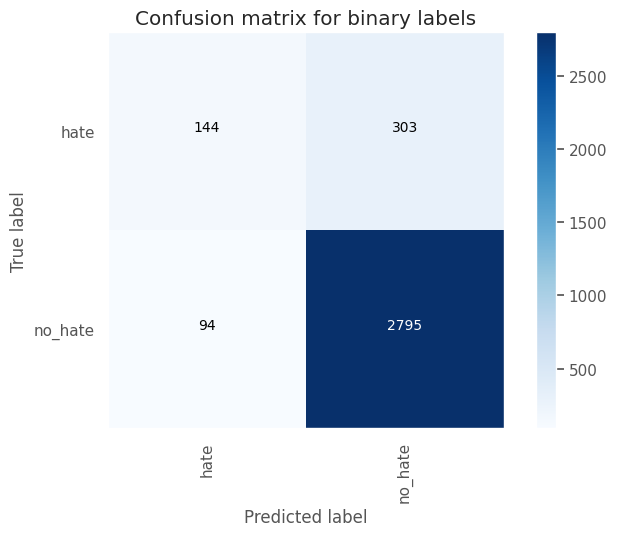

Test Accuracy: 0.881
Test macro-F1: 0.6771




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_31 (Embedding)    (None, 128, 50)           500050    
                                                                 
 dropout_61 (Dropout)        (None, 128, 50)           0         
                                                                 
 conv1d_31 (Conv1D)          (None, 126, 64)           9664      
                                                                 
 max_pooling1d_31 (MaxPooli  (None, 42, 64)            0         
 ng1D)                                                           
                                                                 
 dropout_62 (Dropout)        (None, 42, 64)           

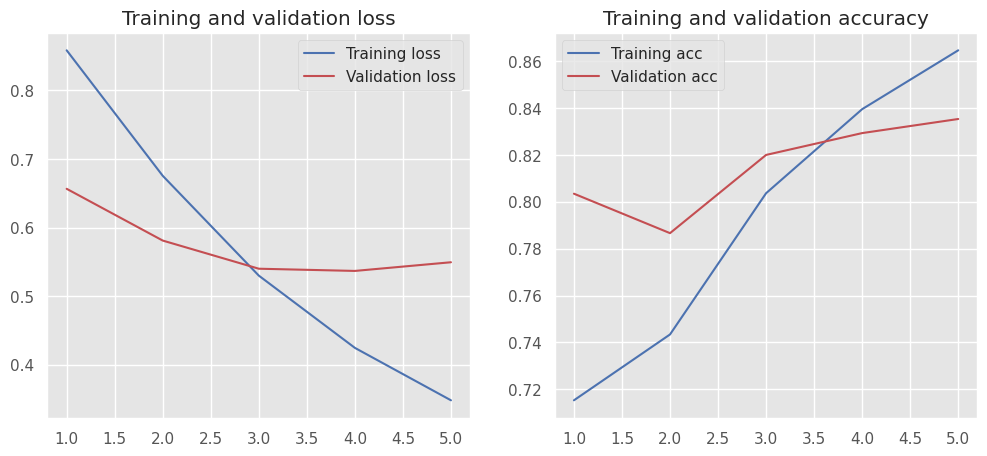

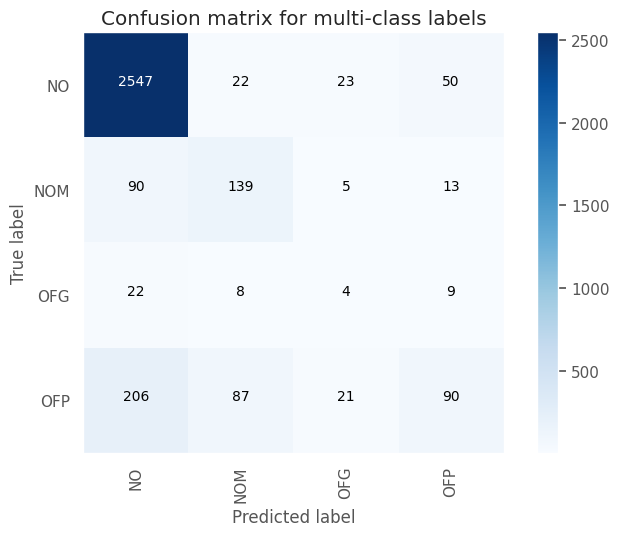

Test Accuracy: 0.8333
Test macro-F1: 0.4698


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5767    0.2774    0.3746       447
     no_hate     0.8965    0.9685    0.9311      2889

    accuracy                         0.8759      3336
   macro avg     0.7366    0.6230    0.6529      3336
weighted avg     0.8537    0.8759    0.8565      3336



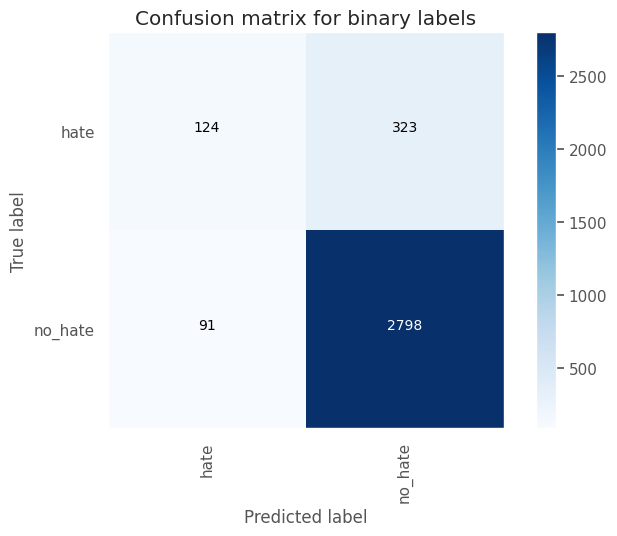

Test Accuracy: 0.8759
Test macro-F1: 0.6529






In [14]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]


# Conditions
for emb_dim in [50]:
  for lr in [0.001, 0.0005]:
      for cnn_filter_dim in [32, 64]:
          for dense_dim in [32, 64]:
            for dp_after_pool in [None, [0.2]]:
              for dp_before_class_head in [None, 0.5]:
                # Build CNN model  ===========
                model_config = KerasCNNClassifierModelConfig(
                    # General
                    vocab_size=vocab_size,
                    model_name="cnn_classifier",
                    # Embeddings
                    embedding_config=EmbeddingConfig(output_dim=emb_dim, input_length=max_length, trainable=True, pre_trained_matrix=None),
                    # CNN Layers
                    cnn_filter_dims=[cnn_filter_dim],
                    cnn_kernel_sizes=[3],
                    cnn_activations=["relu"],
                    cnn_stride_sizes=[1],
                    cnn_padding=["valid"],
                    pool_sizes=[3],
                    use_global_pooling=False,
                    # Dense layers at the end
                    dense_activations=["relu", "softmax"],
                    dense_dims=[dense_dim, 4],
                    # Dropouts
                    dp_after_embedding=0.5,
                    dp_after_pooling=dp_after_pool,
                    dp_before_classif_dense=dp_before_class_head)
                model: tf.keras.Model = CNNModelFactory.create(model_config)
                # ============================


                # Train  ===========
                trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                          max_input_length=max_length))
                optim_config: OptimizationConfig = OptimizationConfig(
                    epochs=25,
                    batch_size=32,
                    validation_split=0.0,
                    validation_data=(x_val, y_val),
                    optimizer=Adam(learning_rate=lr)
                )
                trainer.train(x_train=x_train,
                              y_train=y_train,
                              opt_config=optim_config,
                              callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
                mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
                mc_report: dict
                bc_report: dict

                # Accumulate result so it can be plotted
                result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                                dataset_version=dataset_name,
                                                model_params=model.count_params(),
                                                optim_config=optim_config,
                                                macro_prec_mc=mc_report["macro avg"]["precision"],
                                                macro_recall_mc=mc_report["macro avg"]["recall"],
                                                macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                                macro_prec_bc=bc_report["macro avg"]["precision"],
                                                macro_recall_bc=bc_report["macro avg"]["recall"],
                                                macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                                )
                results_rep.accumulate(result)
                # ============================

In [15]:
report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)


<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>4</th>
      <td>v6</td>
      <td>{'embedding_4': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_8': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_4': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_4': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'flatten_4': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_8': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dense_9': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>591222</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5603</td>
      <td>0.5307</td>
      <td>0.5421</td>
      <td>0.7275</td>
      <td>0.6780</td>
      <td>0.6979</td>
    </tr>
    <tr>
      <th>10</th>
      <td>v6</td>
      <td>{'embedding_10': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_19': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_10': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_10': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_20': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_10': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_20': {'class_name': 'Dense', 'param_count': 86048, 'input': (None, 2688), 'output': (None, 32)}, 'dense_21': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>595894</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5584</td>
      <td>0.5311</td>
      <td>0.5407</td>
      <td>0.7463</td>
      <td>0.6856</td>
      <td>0.7093</td>
    </tr>
    <tr>
      <th>24</th>
      <td>v6</td>
      <td>{'embedding_24': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_48': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_24': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_24': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'flatten_24': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_48': {'class_name': 'Dense', 'param_count': 86048, 'input': (None, 2688), 'output': (None, 32)}, 'dense_49': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>595894</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.5709</td>
      <td>0.5232</td>
      <td>0.5382</td>
      <td>0.7678</td>
      <td>0.6746</td>
      <td>0.7065</td>
    </tr>
    <tr>
      <th>14</th>
      <td>v6</td>
      <td>{'embedding_14': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_27': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_14': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_14': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_28': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_14': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_28': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dense_29': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>682070</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5591</td>
      <td>0.5232</td>
      <td>0.5375</td>
      <td>0.7390</td>
      <td>0.6890</td>
      <td>0.7093</td>
    </tr>
    <tr>
      <th>6</th>
      <td>v6</td>
      <td>{'embedding_6': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_11': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_6': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_6': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_12': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_6': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_12': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dense_13': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>591222</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5631</td>
      <td>0.5281</td>
      <td>0.5374</td>
      <td>0.7391</td>
      <td>0.6640</td>
      <td>0.6907</td>
    </tr>
    <tr>
      <th>8</th>
      <td>v6</td>
      <td>{'embedding_8': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_16': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_8': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_8': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'flatten_8': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_16': {'class_name': 'Dense', 'param_count': 86048, 'input': (None, 2688), 'output': (None, 32)}, 'dense_17': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>595894</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5463</td>
      <td>0.5286</td>
      <td>0.5348</td>
      <td>0.7277</td>
      <td>0.6894</td>
      <td>0.7057</td>
    </tr>
    <tr>
      <th>18</th>
      <td>v6</td>
      <td>{'embedding_18': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_35': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_18': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_18': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_36': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_18': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_36': {'class_name': 'Dense', 'param_count': 43040, 'input': (None, 1344), 'output': (None, 32)}, 'dense_37': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>548054</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.5696</td>
      <td>0.5086</td>
      <td>0.5278</td>
      <td>0.7472</td>
      <td>0.6547</td>
      <td>0.6848</td>
    </tr>
    <tr>
      <th>2</th>
      <td>v6</td>
      <td>{'embedding_2': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_3': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_2': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_2': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_4': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_2': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_4': {'class_name': 'Dense', 'param_count': 43040, 'input': (None, 1344), 'output': (None, 32)}, 'dense_5': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>548054</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5527</td>
      <td>0.5182</td>
      <td>0.5276</td>
      <td>0.7539</td>
      <td>0.6704</td>
      <td>0.6997</td>
    </tr>
    <tr>
      <th>22</th>
      <td>v6</td>
      <td>{'embedding_22': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_43': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_22': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_22': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_44': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_22': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_44': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dense_45': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>591222</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.5523</td>
      <td>0.5147</td>
      <td>0.5258</td>
      <td>0.7389</td>
      <td>0.6659</td>
      <td>0.6922</td>
    </tr>
    <tr>
      <th>13</th>
      <td>v6</td>
      <td>{'embedding_13': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_25': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_13': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_13': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'flatten_13': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_26': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_26': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_27': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>682070</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5424</td>
      <td>0.5108</td>
      <td>0.5252</td>
      <td>0.7166</td>
      <td>0.6923</td>
      <td>0.7032</td>
    </tr>
    <tr>
      <th>28</th>
      <td>v6</td>
      <td>{'embedding_28': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_56': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_28': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_28': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'flatten_28': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_56': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dense_57': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>682070</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.5554</td>
      <td>0.5092</td>
      <td>0.5189</td>
      <td>0.7616</td>
      <td>0.6528</td>
      <td>0.6860</td>
    </tr>
    <tr>
      <th>5</th>
      <td>v6</td>
      <td>{'embedding_5': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_9': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_5': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_5': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'flatten_5': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_10': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_10': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_11': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>591222</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5367</td>
      <td>0.5030</td>
      <td>0.5178</td>
      <td>0.7183</td>
      <td>0.6807</td>
      <td>0.6966</td>
    </tr>
    <tr>
      <th>3</th>
      <td>v6</td>
      <td>{'embedding_3': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_5': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_3': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_3': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_6': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_3': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_6': {'class_name': 'Dense', 'param_count': 43040, 'input': (None, 1344), 'output': (None, 32)}, 'dropout_7': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_7': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>548054</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5328</td>
      <td>0.5144</td>
      <td>0.5174</td>
      <td>0.7112</td>
      <td>0.6670</td>
      <td>0.6849</td>
    </tr>
    <tr>
      <th>12</th>
      <td>v6</td>
      <td>{'embedding_12': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_24': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_12': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_12': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'flatten_12': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_24': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dense_25': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>682070</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5233</td>
      <td>0.5137</td>
      <td>0.5162</td>
      <td>0.7098</td>
      <td>0.6741</td>
      <td>0.6892</td>
    </tr>
    <tr>
      <th>30</th>
      <td>v6</td>
      <td>{'embedding_30': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_59': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_30': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_30': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_60': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_30': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_60': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dense_61': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>682070</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.5545</td>
      <td>0.5047</td>
      <td>0.5161</td>
      <td>0.7536</td>
      <td>0.6448</td>
      <td>0.6771</td>
    </tr>
    <tr>
      <th>16</th>
      <td>v6</td>
      <td>{'embedding_16': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_32': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_16': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_16': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'flatten_16': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_32': {'class_name': 'Dense', 'param_count': 43040, 'input': (None, 1344), 'output': (None, 32)}, 'dense_33': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>548054</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.5646</td>
      <td>0.4959</td>
      <td>0.5148</td>
      <td>0.7636</td>
      <td>0.6511</td>
      <td>0.6848</td>
    </tr>
    <tr>
      <th>11</th>
      <td>v6</td>
      <td>{'embedding_11': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_21': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_11': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_11': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_22': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_11': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_22': {'class_name': 'Dense', 'param_count': 86048, 'input': (None, 2688), 'output': (None, 32)}, 'dropout_23': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_23': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>595894</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5407</td>
      <td>0.4973</td>
      <td>0.5143</td>
      <td>0.7193</td>
      <td>0.6837</td>
      <td>0.6989</td>
    </tr>
    <tr>
      <th>26</th>
      <td>v6</td>
      <td>{'embedding_26': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_51': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_26': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_26': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_52': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_26': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_52': {'class_name': 'Dense', 'param_count': 86048, 'input': (None, 2688), 'output': (None, 32)}, 'dense_53': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>595894</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.5566</td>
      <td>0.4912</td>
      <td>0.5102</td>
      <td>0.7589</td>
      <td>0.6455</td>
      <td>0.6787</td>
    </tr>
    <tr>
      <th>7</th>
      <td>v6</td>
      <td>{'embedding_7': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_13': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_7': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_7': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_14': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_7': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_14': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_15': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_15': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>591222</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5265</td>
      <td>0.4967</td>
      <td>0.5095</td>
      <td>0.7046</td>
      <td>0.6710</td>
      <td>0.6852</td>
    </tr>
    <tr>
      <th>15</th>
      <td>v6</td>
      <td>{'embedding_15': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_29': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_15': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_15': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_30': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_15': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_30': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_31': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_31': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>682070</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5212</td>
      <td>0.4978</td>
      <td>0.5071</td>
      <td>0.7154</td>
      <td>0.6717</td>
      <td>0.6895</td>
    </tr>
    <tr>
      <th>9</th>
      <td>v6</td>
      <td>{'embedding_9': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_17': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_9': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_9': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'flatten_9': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_18': {'class_name': 'Dense', 'param_count': 86048, 'input': (None, 2688), 'output': (None, 32)}, 'dropout_18': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_19': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>595894</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5309</td>
      <td>0.4971</td>
      <td>0.5064</td>
      <td>0.7300</td>
      <td>0.6738</td>
      <td>0.6957</td>
    </tr>
    <tr>
      <th>20</th>
      <td>v6</td>
      <td>{'embedding_20': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_40': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_20': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_20': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'flatten_20': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_40': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dense_41': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>591222</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.5567</td>
      <td>0.4896</td>
      <td>0.5062</td>
      <td>0.7602</td>
      <td>0.6387</td>
      <td>0.6723</td>
    </tr>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'flatten': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense': {'class_name': 'Dense', 'param_count': 43040, 'input': (None, 1344), 'output': (None, 32)}, 'dense_1': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>548054</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5299</td>
      <td>0.4947</td>
      <td>0.5060</td>
      <td>0.7374</td>
      <td>0.6609</td>
      <td>0.6877</td>
    </tr>
    <tr>
      <th>19</th>
      <td>v6</td>
      <td>{'embedding_19': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_37': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_19': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_19': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_38': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_19': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_38': {'class_name': 'Dense', 'param_count': 43040, 'input': (None, 1344), 'output': (None, 32)}, 'dropout_39': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_39': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>548054</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.5493</td>
      <td>0.4864</td>
      <td>0.5038</td>
      <td>0.7377</td>
      <td>0.6426</td>
      <td>0.6720</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_1': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_1': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_1': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_1': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'flatten_1': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_2': {'class_name': 'Dense', 'param_count': 43040, 'input': (None, 1344), 'output': (None, 32)}, 'dropout_2': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_3': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>548054</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5246</td>
      <td>0.4763</td>
      <td>0.4967</td>
      <td>0.7047</td>
      <td>0.6619</td>
      <td>0.6791</td>
    </tr>
    <tr>
      <th>29</th>
      <td>v6</td>
      <td>{'embedding_29': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_57': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_29': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_29': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'flatten_29': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_58': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_58': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_59': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>682070</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.5205</td>
      <td>0.4675</td>
      <td>0.4864</td>
      <td>0.7164</td>
      <td>0.6448</td>
      <td>0.6693</td>
    </tr>
    <tr>
      <th>25</th>
      <td>v6</td>
      <td>{'embedding_25': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_49': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_25': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_25': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'flatten_25': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_50': {'class_name': 'Dense', 'param_count': 86048, 'input': (None, 2688), 'output': (None, 32)}, 'dropout_50': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_51': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>595894</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.5215</td>
      <td>0.4627</td>
      <td>0.4830</td>
      <td>0.7175</td>
      <td>0.6693</td>
      <td>0.6886</td>
    </tr>
    <tr>
      <th>31</th>
      <td>v6</td>
      <td>{'embedding_31': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_61': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_31': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_31': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_62': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_31': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_62': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_63': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_63': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>682070</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.5158</td>
      <td>0.4606</td>
      <td>0.4698</td>
      <td>0.7366</td>
      <td>0.6230</td>
      <td>0.6529</td>
    </tr>
    <tr>
      <th>27</th>
      <td>v6</td>
      <td>{'embedding_27': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_53': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_27': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_27': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_54': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_27': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_54': {'class_name': 'Dense', 'param_count': 86048, 'input': (None, 2688), 'output': (None, 32)}, 'dropout_55': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_55': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>595894</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.5172</td>
      <td>0.4377</td>
      <td>0.4485</td>
      <td>0.7098</td>
      <td>0.6978</td>
      <td>0.7035</td>
    </tr>
    <tr>
      <th>21</th>
      <td>v6</td>
      <td>{'embedding_21': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_41': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_21': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_21': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'flatten_21': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_42': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_42': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_43': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>591222</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.4935</td>
      <td>0.4203</td>
      <td>0.4337</td>
      <td>0.7039</td>
      <td>0.6708</td>
      <td>0.6849</td>
    </tr>
    <tr>
      <th>17</th>
      <td>v6</td>
      <td>{'embedding_17': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_33': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_17': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_17': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'flatten_17': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_34': {'class_name': 'Dense', 'param_count': 43040, 'input': (None, 1344), 'output': (None, 32)}, 'dropout_34': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_35': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>548054</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.5178</td>
      <td>0.3989</td>
      <td>0.4204</td>
      <td>0.6980</td>
      <td>0.6521</td>
      <td>0.6701</td>
    </tr>
    <tr>
      <th>23</th>
      <td>v6</td>
      <td>{'embedding_23': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_45': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_23': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_23': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_46': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_23': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_46': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_47': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_47': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>591222</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.4737</td>
      <td>0.3862</td>
      <td>0.3865</td>
      <td>0.6982</td>
      <td>0.6783</td>
      <td>0.6874</td>
    </tr>
  </tbody>
</table>
    

Logramos mejorar la performance pero da manera muy leve. Mirando las curvas seguimos viendo que la red es entrenada solo por algunas epochs (5 o 6) y luego comienza a overfittear.

Como hay un gran abanico de combinaciones a abarcar, intentaré partir de algún diseño que piense que pueda servirnos y lo iré modificando.

Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_32 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_64 (Dropout)        (None, 128, 100)          0         
                                                                 
 conv1d_32 (Conv1D)          (None, 124, 128)          64128     
                                                                 
 max_pooling1d_32 (MaxPooli  (None, 41, 128)           0         
 ng1D)                                                           
                                                                 
 dropout_6

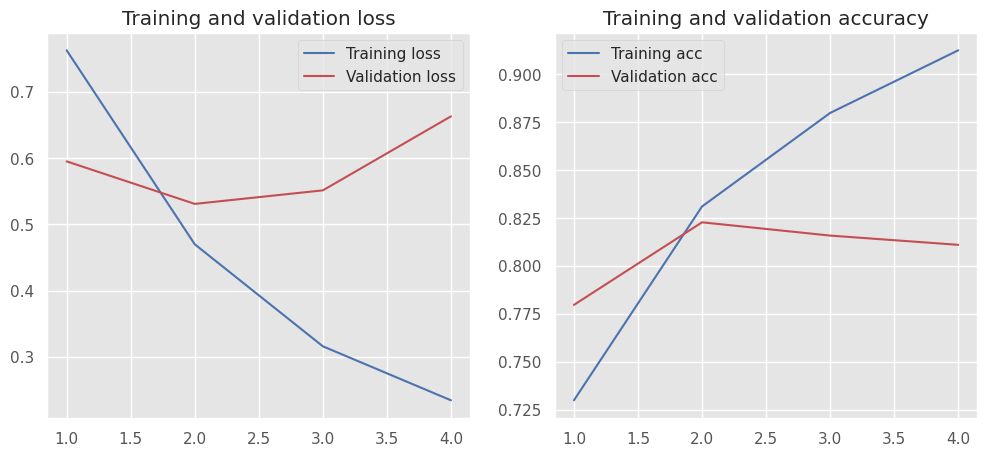

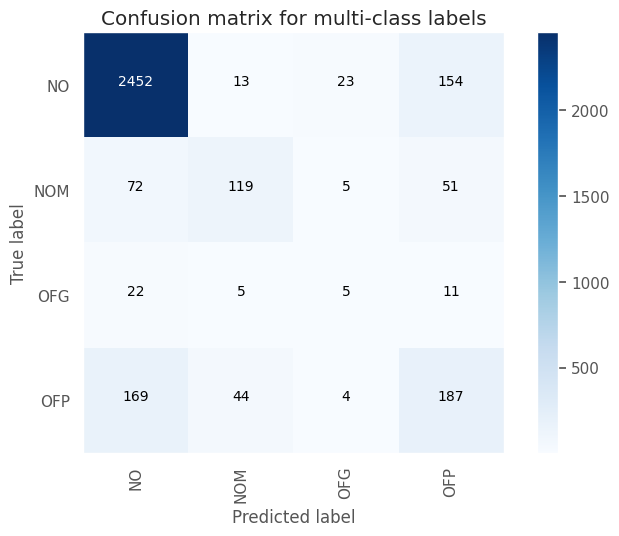

Test Accuracy: 0.8282
Test macro-F1: 0.515


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4705    0.4631    0.4667       447
     no_hate     0.9171    0.9193    0.9182      2889

    accuracy                         0.8582      3336
   macro avg     0.6938    0.6912    0.6925      3336
weighted avg     0.8573    0.8582    0.8577      3336



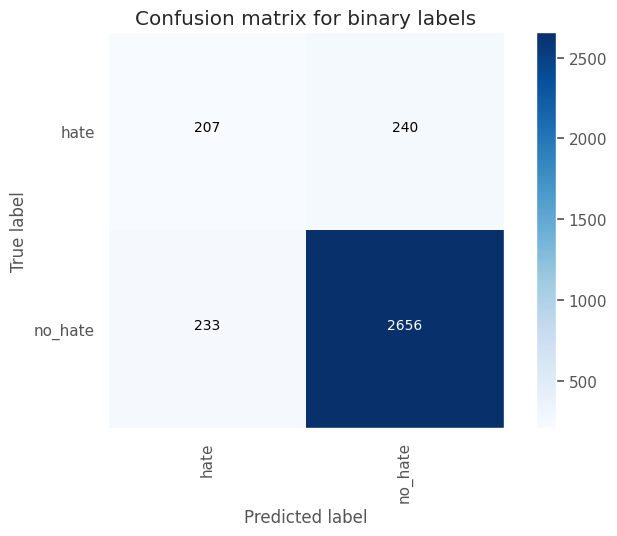

Test Accuracy: 0.8582
Test macro-F1: 0.6925




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_33 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_67 (Dropout)        (None, 128, 100)          0         
                                                                 
 conv1d_33 (Conv1D)          (None, 124, 128)          64128     
                                                                 
 max_pooling1d_33 (MaxPooli  (None, 41, 128)           0         
 ng1D)                                                           
                                                                 
 dropout_68 (Dropout)        (None, 41, 128)         

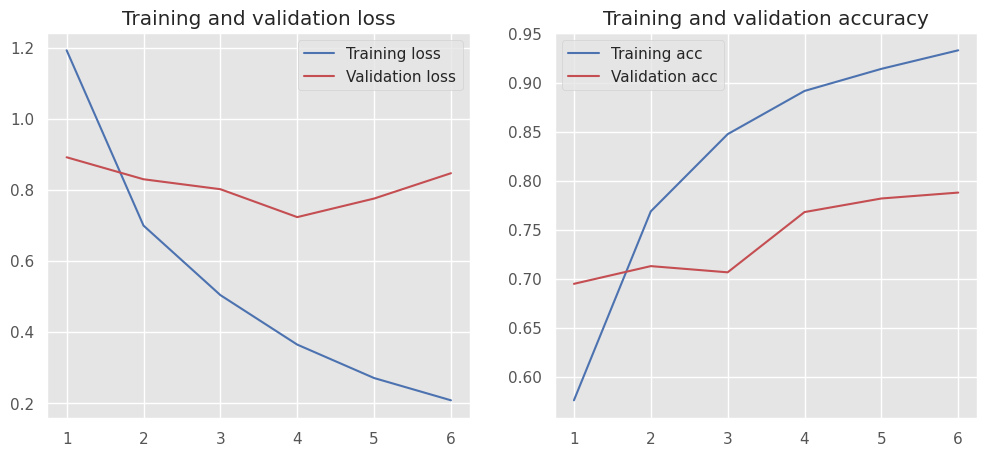

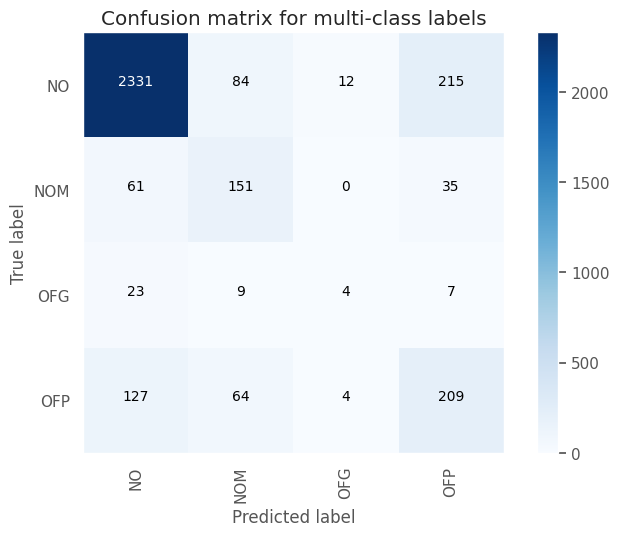

Test Accuracy: 0.8079
Test macro-F1: 0.5127


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4609    0.5011    0.4802       447
     no_hate     0.9218    0.9093    0.9155      2889

    accuracy                         0.8546      3336
   macro avg     0.6913    0.7052    0.6978      3336
weighted avg     0.8600    0.8546    0.8572      3336



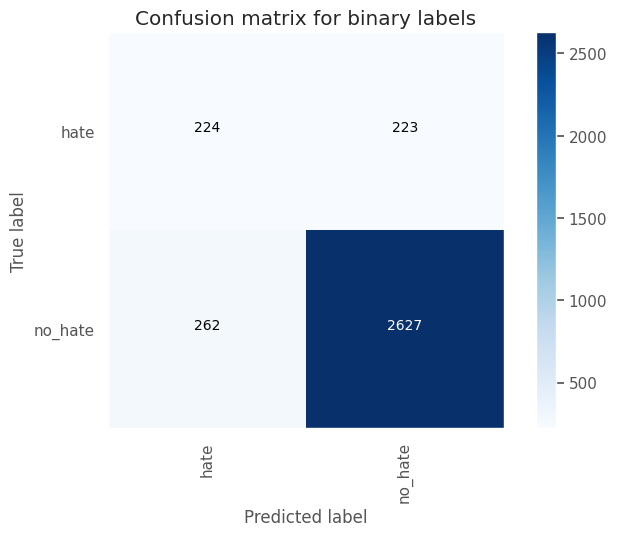

Test Accuracy: 0.8546
Test macro-F1: 0.6978






In [16]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

for class_weight in [None, "balanced"]:
  # Build CNN model  ===========
  model_config = KerasCNNClassifierModelConfig(
      # General
      vocab_size=vocab_size,
      model_name="cnn_classifier",
      # Embeddings
      embedding_config=EmbeddingConfig(output_dim=embedding_dim, input_length=max_length, trainable=True, pre_trained_matrix=None),
      # CNN Layers
      cnn_filter_dims=[128],
      cnn_kernel_sizes=[5],
      cnn_activations=["relu"],
      cnn_stride_sizes=[1],
      cnn_padding=["valid"],
      pool_sizes=[3],
      use_global_pooling=False,
      # Dense layers at the end
      dense_activations=["relu", "softmax"],
      dense_dims=[128,4],
      # Dropouts
      dp_after_embedding=0.5,
      dp_after_pooling=[0.3],
      dp_before_classif_dense=0.3)
  model: tf.keras.Model = CNNModelFactory.create(model_config)
  # ============================


  # Train  ===========
  trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                            max_input_length=max_length))
  optim_config: OptimizationConfig = OptimizationConfig(
      epochs=25,
      batch_size=32,
      validation_split=0.0,
      validation_data=(x_val, y_val),
      optimizer=Adam(learning_rate=0.001),
      class_weight=class_weight
  )
  trainer.train(x_train=x_train,
                y_train=y_train,
                opt_config=optim_config,
                callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
  mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
  mc_report: dict
  bc_report: dict

  # Accumulate result so it can be plotted
  result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                  dataset_version=dataset_name,
                                  model_params=model.count_params(),
                                  optim_config=optim_config,
                                  macro_prec_mc=mc_report["macro avg"]["precision"],
                                  macro_recall_mc=mc_report["macro avg"]["recall"],
                                  macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                  macro_prec_bc=bc_report["macro avg"]["precision"],
                                  macro_recall_bc=bc_report["macro avg"]["recall"],
                                  macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                  )
  results_rep.accumulate(result)
  # ============================

In [17]:
report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)


<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_32': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_64': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_32': {'class_name': 'Conv1D', 'param_count': 64128, 'input': (None, 128, 100), 'output': (None, 124, 128)}, 'max_pooling1d_32': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 124, 128), 'output': (None, 41, 128)}, 'dropout_65': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 41, 128), 'output': (None, 41, 128)}, 'flatten_32': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 41, 128), 'output': (None, 5248)}, 'dense_64': {'class_name': 'Dense', 'param_count': 671872, 'input': (None, 5248), 'output': (None, 128)}, 'dropout_66': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_65': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1736616</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5399</td>
      <td>0.4973</td>
      <td>0.5150</td>
      <td>0.6938</td>
      <td>0.6912</td>
      <td>0.6925</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_33': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_67': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_33': {'class_name': 'Conv1D', 'param_count': 64128, 'input': (None, 128, 100), 'output': (None, 124, 128)}, 'max_pooling1d_33': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 124, 128), 'output': (None, 41, 128)}, 'dropout_68': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 41, 128), 'output': (None, 41, 128)}, 'flatten_33': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 41, 128), 'output': (None, 5248)}, 'dense_66': {'class_name': 'Dense', 'param_count': 671872, 'input': (None, 5248), 'output': (None, 128)}, 'dropout_69': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_67': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1736616</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': 'balanced', 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5139</td>
      <td>0.5260</td>
      <td>0.5127</td>
      <td>0.6913</td>
      <td>0.7052</td>
      <td>0.6978</td>
    </tr>
  </tbody>
</table>
    

Peor usando `class_weight="balanced"` que sin usarlo, algo que hemos notado en otros casos también.

Reduciremos los Dropout.

Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_34 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_70 (Dropout)        (None, 128, 100)          0         
                                                                 
 conv1d_34 (Conv1D)          (None, 124, 128)          64128     
                                                                 
 max_pooling1d_34 (MaxPooli  (None, 41, 128)           0         
 ng1D)                                                           
                                                                 
 dropout_7

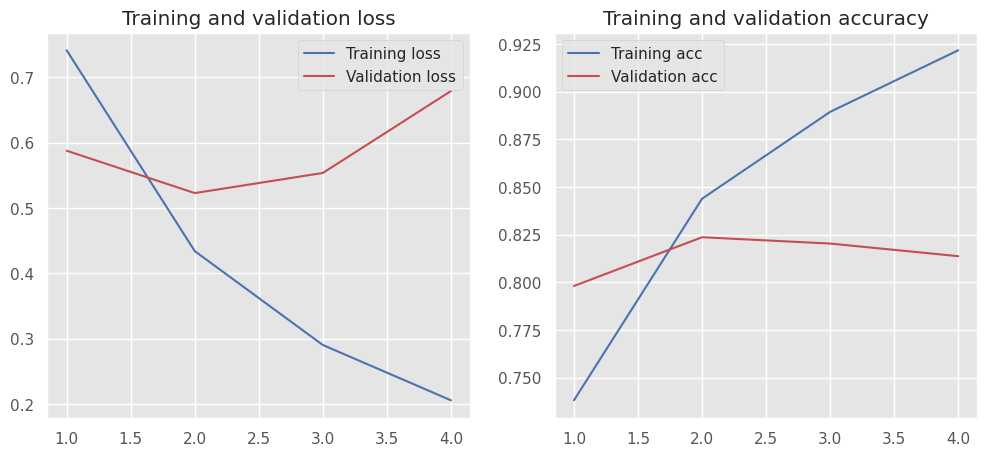

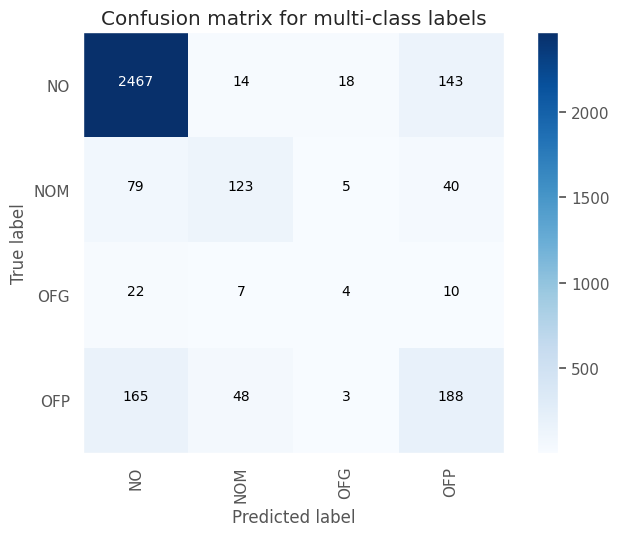

Test Accuracy: 0.8339
Test macro-F1: 0.5167


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4988    0.4586    0.4779       447
     no_hate     0.9173    0.9287    0.9229      2889

    accuracy                         0.8657      3336
   macro avg     0.7080    0.6937    0.7004      3336
weighted avg     0.8612    0.8657    0.8633      3336



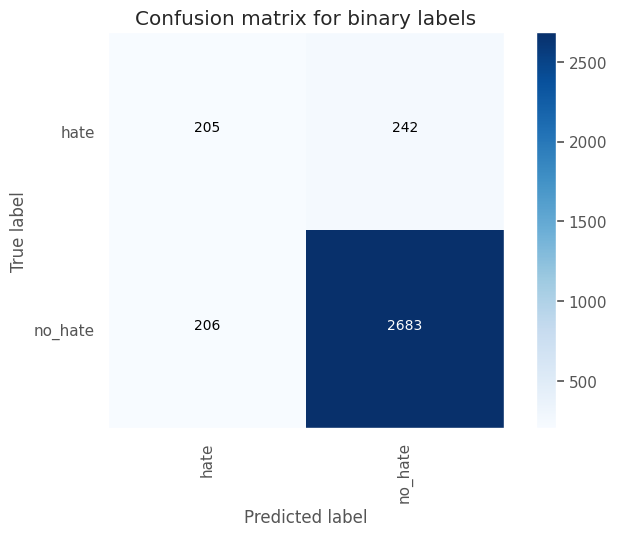

Test Accuracy: 0.8657
Test macro-F1: 0.7004




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_35 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_73 (Dropout)        (None, 128, 100)          0         
                                                                 
 conv1d_35 (Conv1D)          (None, 124, 128)          64128     
                                                                 
 max_pooling1d_35 (MaxPooli  (None, 41, 128)           0         
 ng1D)                                                           
                                                                 
 dropout_74 (Dropout)        (None, 41, 128)         

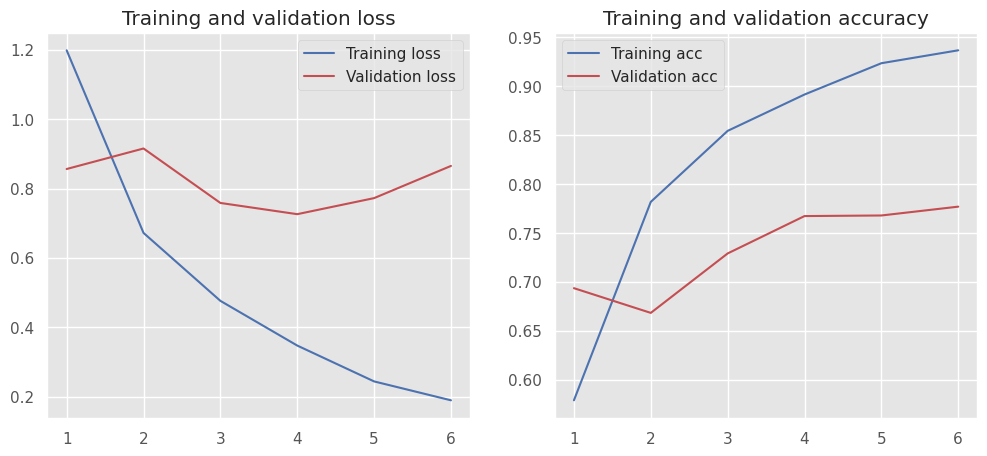

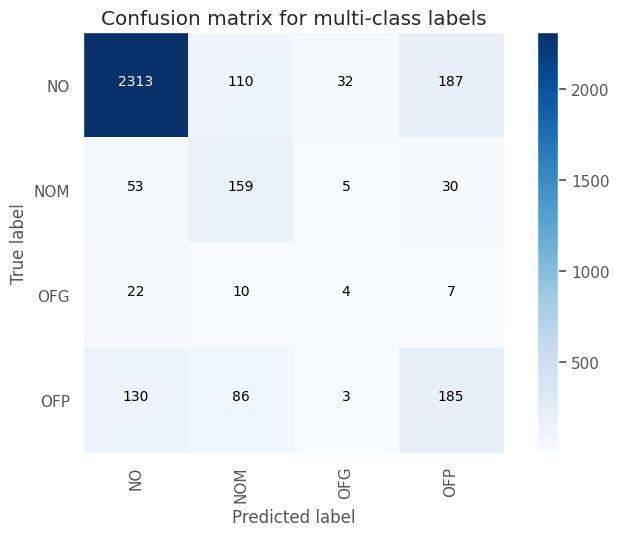

Test Accuracy: 0.7977
Test macro-F1: 0.4908


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4393    0.4452    0.4422       447
     no_hate     0.9140    0.9121    0.9130      2889

    accuracy                         0.8495      3336
   macro avg     0.6766    0.6786    0.6776      3336
weighted avg     0.8504    0.8495    0.8499      3336



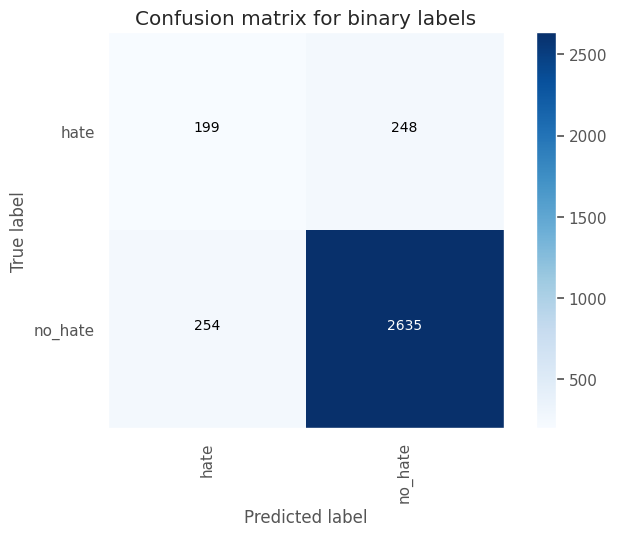

Test Accuracy: 0.8495
Test macro-F1: 0.6776






In [18]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

for class_weight in [None, "balanced"]:
  # Build CNN model  ===========
  model_config = KerasCNNClassifierModelConfig(
      # General
      vocab_size=vocab_size,
      model_name="cnn_classifier",
      # Embeddings
      embedding_config=EmbeddingConfig(output_dim=embedding_dim, input_length=max_length, trainable=True, pre_trained_matrix=None),
      # CNN Layers
      cnn_filter_dims=[128],
      cnn_kernel_sizes=[5],
      cnn_activations=["relu"],
      cnn_stride_sizes=[1],
      cnn_padding=["valid"],
      pool_sizes=[3],
      use_global_pooling=False,
      # Dense layers at the end
      dense_activations=["relu", "softmax"],
      dense_dims=[128,4],
      # Dropouts
      dp_after_embedding=0.5,
      dp_after_pooling=[0.1],
      dp_before_classif_dense=0.1)
  model: tf.keras.Model = CNNModelFactory.create(model_config)
  # ============================


  # Train  ===========
  trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                            max_input_length=max_length))
  optim_config: OptimizationConfig = OptimizationConfig(
      epochs=25,
      batch_size=32,
      validation_split=0.0,
      validation_data=(x_val, y_val),
      optimizer=Adam(learning_rate=0.001),
      class_weight=class_weight
  )
  trainer.train(x_train=x_train,
                y_train=y_train,
                opt_config=optim_config,
                callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
  mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
  mc_report: dict
  bc_report: dict

  # Accumulate result so it can be plotted
  result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                  dataset_version=dataset_name,
                                  model_params=model.count_params(),
                                  optim_config=optim_config,
                                  macro_prec_mc=mc_report["macro avg"]["precision"],
                                  macro_recall_mc=mc_report["macro avg"]["recall"],
                                  macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                  macro_prec_bc=bc_report["macro avg"]["precision"],
                                  macro_recall_bc=bc_report["macro avg"]["recall"],
                                  macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                  )
  results_rep.accumulate(result)
  # ============================

In [19]:
report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)


<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_34': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_70': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_34': {'class_name': 'Conv1D', 'param_count': 64128, 'input': (None, 128, 100), 'output': (None, 124, 128)}, 'max_pooling1d_34': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 124, 128), 'output': (None, 41, 128)}, 'dropout_71': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 41, 128), 'output': (None, 41, 128)}, 'flatten_34': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 41, 128), 'output': (None, 5248)}, 'dense_68': {'class_name': 'Dense', 'param_count': 671872, 'input': (None, 5248), 'output': (None, 128)}, 'dropout_72': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_69': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1736616</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5425</td>
      <td>0.4975</td>
      <td>0.5167</td>
      <td>0.7080</td>
      <td>0.6937</td>
      <td>0.7004</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_35': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_73': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_35': {'class_name': 'Conv1D', 'param_count': 64128, 'input': (None, 128, 100), 'output': (None, 124, 128)}, 'max_pooling1d_35': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 124, 128), 'output': (None, 41, 128)}, 'dropout_74': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 41, 128), 'output': (None, 41, 128)}, 'flatten_35': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 41, 128), 'output': (None, 5248)}, 'dense_70': {'class_name': 'Dense', 'param_count': 671872, 'input': (None, 5248), 'output': (None, 128)}, 'dropout_75': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_71': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1736616</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': 'balanced', 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.4744</td>
      <td>0.5175</td>
      <td>0.4908</td>
      <td>0.6766</td>
      <td>0.6786</td>
      <td>0.6776</td>
    </tr>
  </tbody>
</table>
    

Peor aún. Misma prueba que antes pero usando `GlobalMaxPooling1D`.

Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_37 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_79 (Dropout)        (None, 128, 100)          0         
                                                                 
 conv1d_37 (Conv1D)          (None, 124, 128)          64128     
                                                                 
 max_pooling1d_37 (MaxPooli  (None, 41, 128)           0         
 ng1D)                                                           
                                                                 
 global_ma

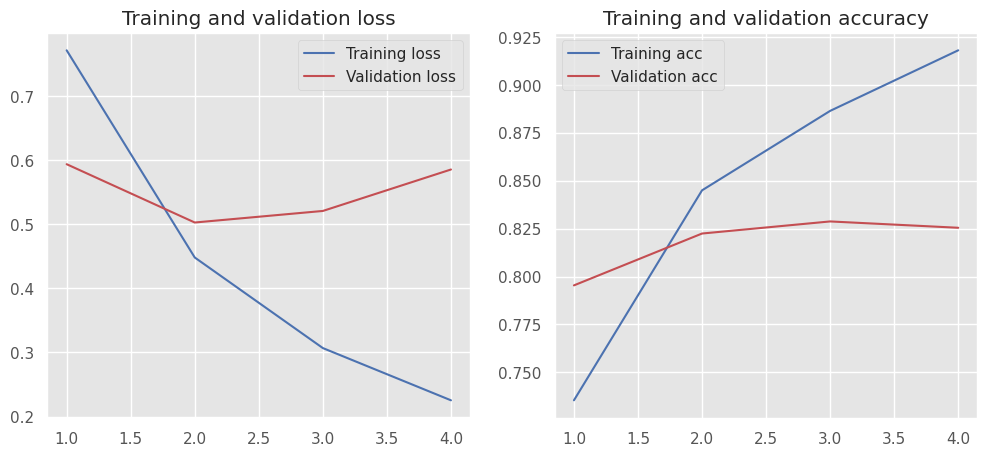

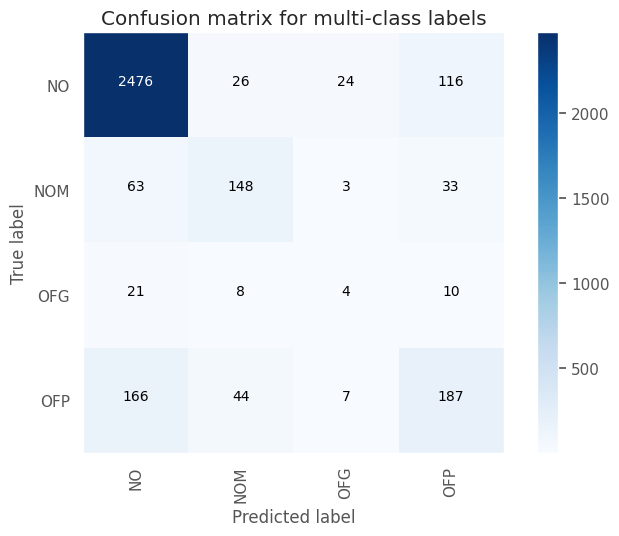

Test Accuracy: 0.8438
Test macro-F1: 0.5364


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5417    0.4653    0.5006       447
     no_hate     0.9190    0.9391    0.9290      2889

    accuracy                         0.8756      3336
   macro avg     0.7304    0.7022    0.7148      3336
weighted avg     0.8685    0.8756    0.8716      3336



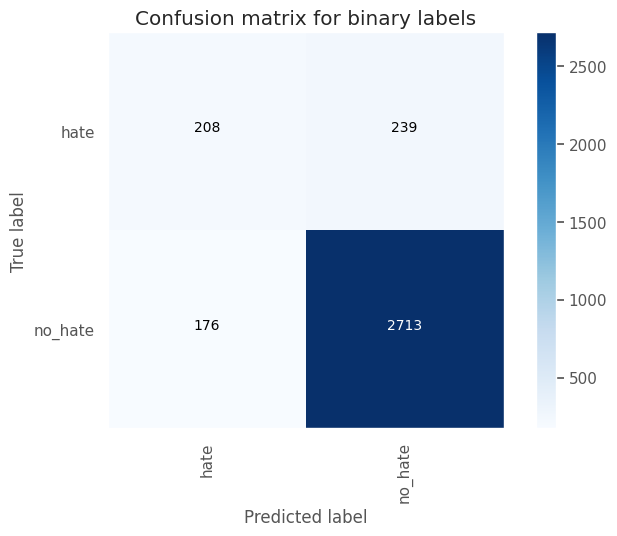

Test Accuracy: 0.8756
Test macro-F1: 0.7148




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_38 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_81 (Dropout)        (None, 128, 100)          0         
                                                                 
 conv1d_38 (Conv1D)          (None, 124, 128)          64128     
                                                                 
 max_pooling1d_38 (MaxPooli  (None, 41, 128)           0         
 ng1D)                                                           
                                                                 
 global_max_pooling1d_1 (Gl  (None, 128)             

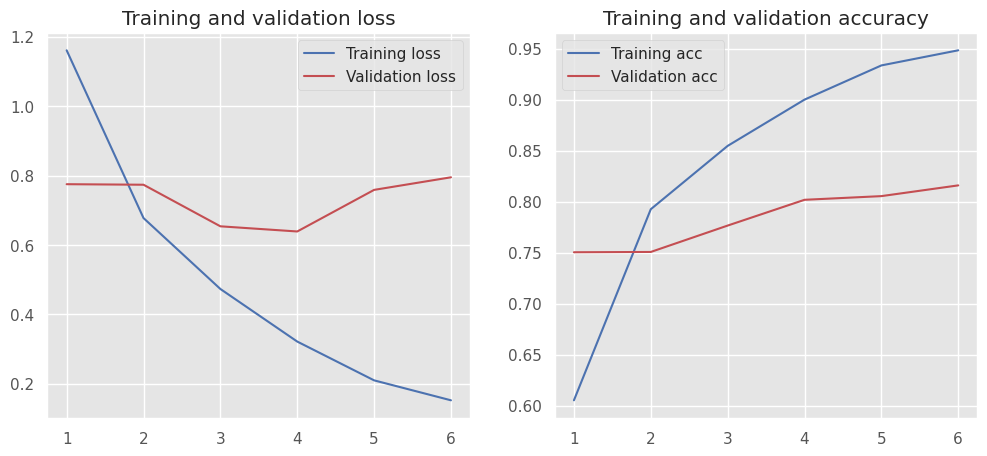

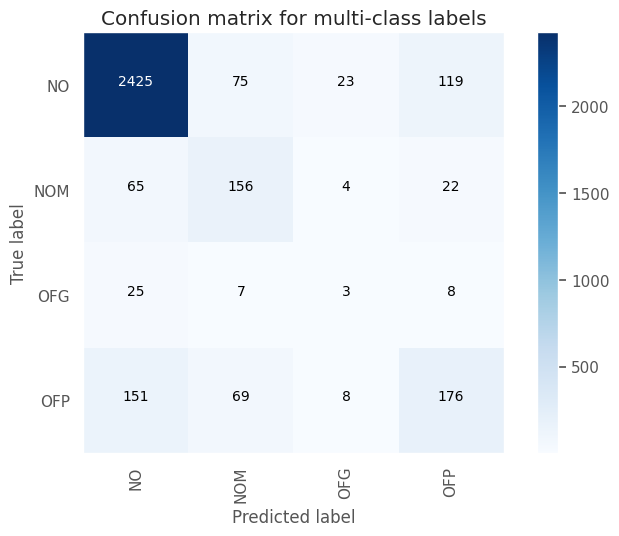

Test Accuracy: 0.8273
Test macro-F1: 0.5085


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5372    0.4362    0.4815       447
     no_hate     0.9152    0.9418    0.9284      2889

    accuracy                         0.8741      3336
   macro avg     0.7262    0.6890    0.7049      3336
weighted avg     0.8646    0.8741    0.8685      3336



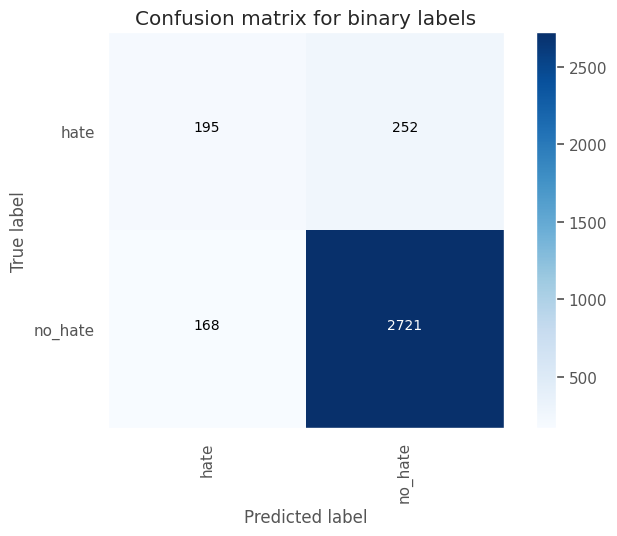

Test Accuracy: 0.8741
Test macro-F1: 0.7049






In [22]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

for class_weight in [None, "balanced"]:
  # Build CNN model  ===========
  model_config = KerasCNNClassifierModelConfig(
      # General
      vocab_size=vocab_size,
      model_name="cnn_classifier",
      # Embeddings
      embedding_config=EmbeddingConfig(output_dim=embedding_dim, input_length=max_length, trainable=True, pre_trained_matrix=None),
      # CNN Layers
      cnn_filter_dims=[128],
      cnn_kernel_sizes=[5],
      cnn_activations=["relu"],
      cnn_stride_sizes=[1],
      cnn_padding=["valid"],
      pool_sizes=[3],
      use_global_pooling=True,
      # Dense layers at the end
      dense_activations=["relu", "softmax"],
      dense_dims=[128,4],
      # Dropouts
      dp_after_embedding=0.5,
      dp_after_pooling=None,
      dp_before_classif_dense=0.3)
  model: tf.keras.Model = CNNModelFactory.create(model_config)
  # ============================


  # Train  ===========
  trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                            max_input_length=max_length))
  optim_config: OptimizationConfig = OptimizationConfig(
      epochs=25,
      batch_size=32,
      validation_split=0.0,
      validation_data=(x_val, y_val),
      optimizer=Adam(learning_rate=0.001),
      class_weight=class_weight
  )
  trainer.train(x_train=x_train,
                y_train=y_train,
                opt_config=optim_config,
                callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
  mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
  mc_report: dict
  bc_report: dict

  # Accumulate result so it can be plotted
  result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                  dataset_version=dataset_name,
                                  model_params=model.count_params(),
                                  optim_config=optim_config,
                                  macro_prec_mc=mc_report["macro avg"]["precision"],
                                  macro_recall_mc=mc_report["macro avg"]["recall"],
                                  macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                  macro_prec_bc=bc_report["macro avg"]["precision"],
                                  macro_recall_bc=bc_report["macro avg"]["recall"],
                                  macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                  )
  results_rep.accumulate(result)
  # ============================

In [23]:
report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)


<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_37': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_79': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_37': {'class_name': 'Conv1D', 'param_count': 64128, 'input': (None, 128, 100), 'output': (None, 124, 128)}, 'max_pooling1d_37': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 124, 128), 'output': (None, 41, 128)}, 'global_max_pooling1d': {'class_name': 'GlobalMaxPooling1D', 'param_count': 0, 'input': (None, 41, 128), 'output': (None, 128)}, 'dense_74': {'class_name': 'Dense', 'param_count': 16512, 'input': (None, 128), 'output': (None, 128)}, 'dropout_80': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_75': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1081256</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5522</td>
      <td>0.5231</td>
      <td>0.5364</td>
      <td>0.7304</td>
      <td>0.7022</td>
      <td>0.7148</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_38': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_81': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_38': {'class_name': 'Conv1D', 'param_count': 64128, 'input': (None, 128, 100), 'output': (None, 124, 128)}, 'max_pooling1d_38': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 124, 128), 'output': (None, 41, 128)}, 'global_max_pooling1d_1': {'class_name': 'GlobalMaxPooling1D', 'param_count': 0, 'input': (None, 41, 128), 'output': (None, 128)}, 'dense_76': {'class_name': 'Dense', 'param_count': 16512, 'input': (None, 128), 'output': (None, 128)}, 'dropout_82': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_77': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1081256</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': 'balanced', 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5096</td>
      <td>0.5137</td>
      <td>0.5085</td>
      <td>0.7262</td>
      <td>0.6890</td>
      <td>0.7049</td>
    </tr>
  </tbody>
</table>
    

No notamos una diferencia considerable, pero sí que vemos que usar `class_weight="balanced"` parecería no ayudarnos, así que dejaremos de usarlo.

Realizaré algúnas pruebas más con arquitecturas un poco más complejas y pasaré a RNNs.

Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_41 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_87 (Dropout)        (None, 128, 100)          0         
                                                                 
 conv1d_45 (Conv1D)          (None, 126, 128)          38528     
                                                                 
 max_pooling1d_45 (MaxPooli  (None, 42, 128)           0         
 ng1D)                                                           
                                                                 
 conv1d_46

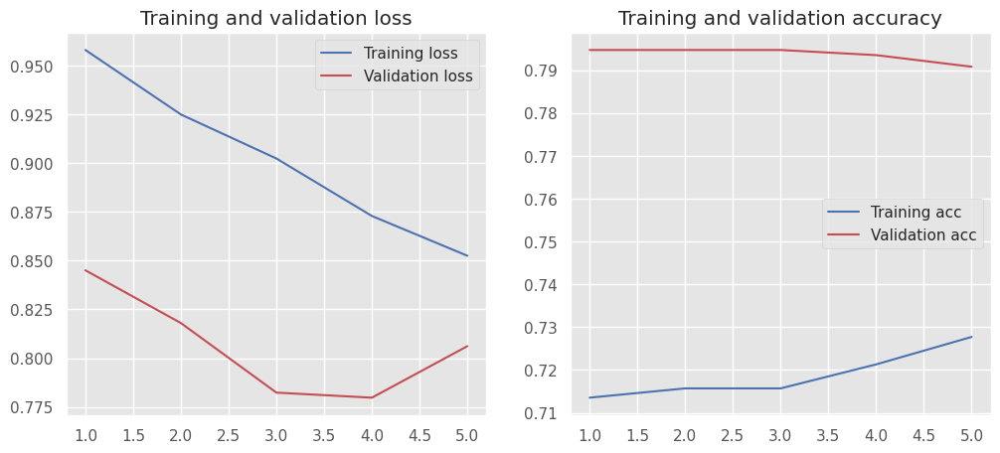

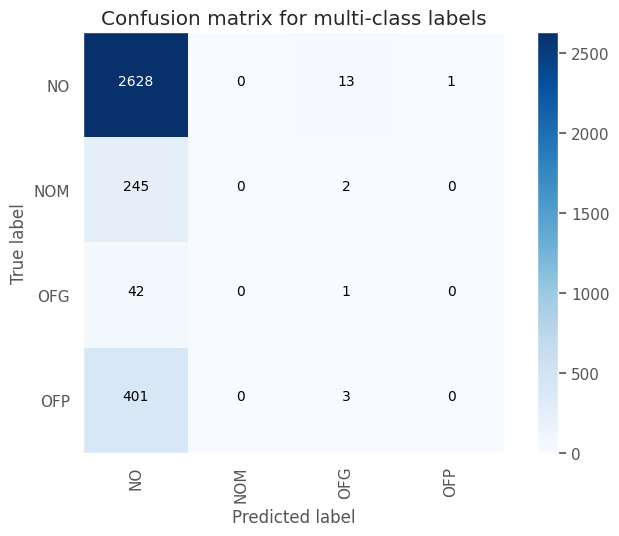

Test Accuracy: 0.7881
Test macro-F1: 0.2286


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.2000    0.0089    0.0171       447
     no_hate     0.8664    0.9945    0.9260      2889

    accuracy                         0.8624      3336
   macro avg     0.5332    0.5017    0.4716      3336
weighted avg     0.7771    0.8624    0.8042      3336



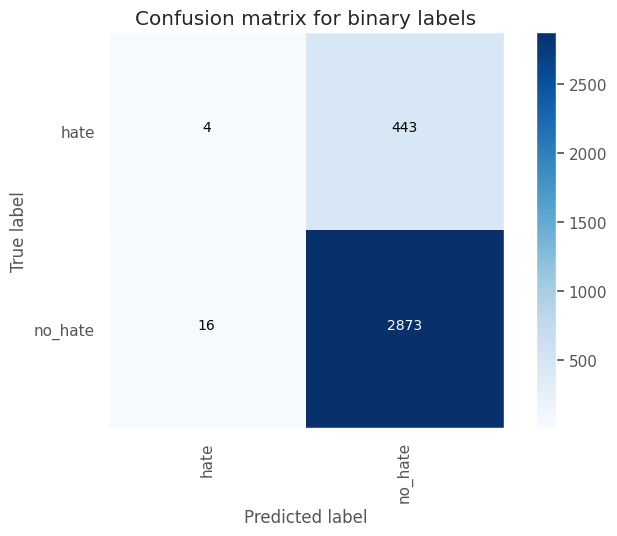

Test Accuracy: 0.8624
Test macro-F1: 0.4716




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_42 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_89 (Dropout)        (None, 128, 100)          0         
                                                                 
 conv1d_48 (Conv1D)          (None, 126, 128)          38528     
                                                                 
 max_pooling1d_48 (MaxPooli  (None, 42, 128)           0         
 ng1D)                                                           
                                                                 
 conv1d_49 (Conv1D)          (None, 40, 64)          

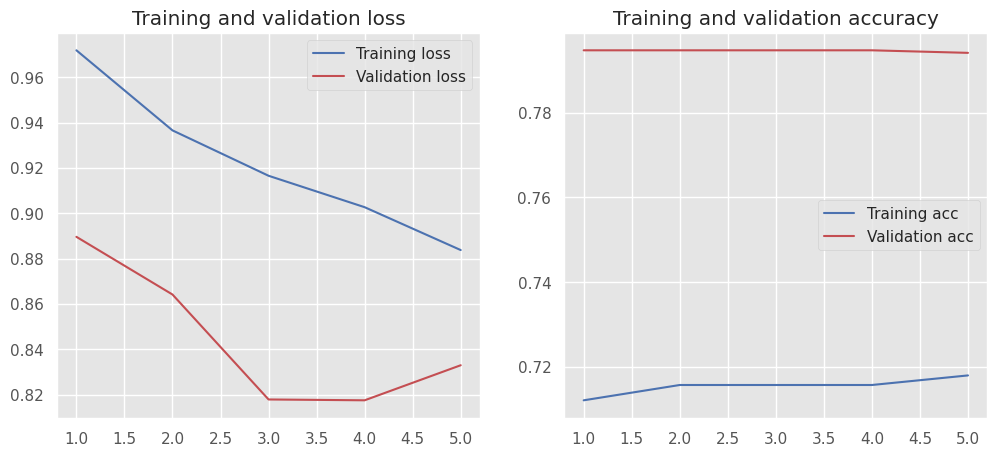

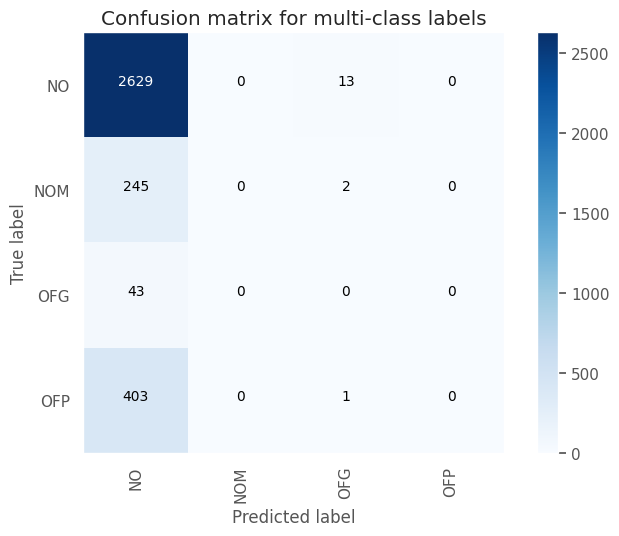

Test Accuracy: 0.7881
Test macro-F1: 0.2205


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.0625    0.0022    0.0043       447
     no_hate     0.8657    0.9948    0.9258      2889

    accuracy                         0.8618      3336
   macro avg     0.4641    0.4985    0.4650      3336
weighted avg     0.7580    0.8618    0.8023      3336



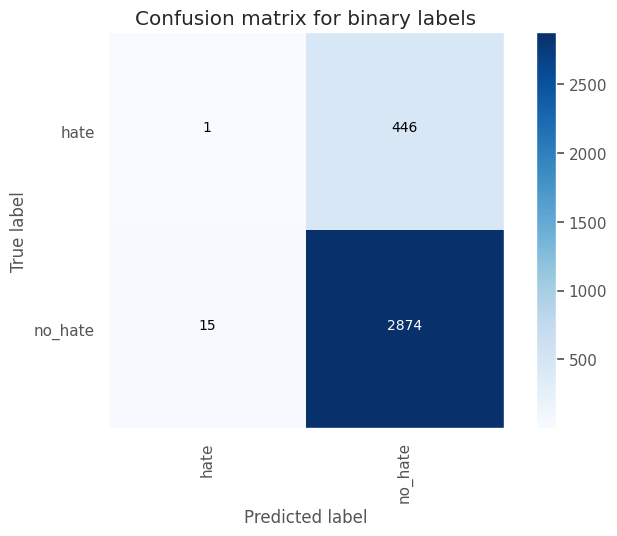

Test Accuracy: 0.8618
Test macro-F1: 0.465




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_43 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_91 (Dropout)        (None, 128, 100)          0         
                                                                 
 conv1d_51 (Conv1D)          (None, 126, 128)          38528     
                                                                 
 max_pooling1d_51 (MaxPooli  (None, 42, 128)           0         
 ng1D)                                                           
                                                                 
 conv1d_52 (Conv1D)          (None, 40, 64)           

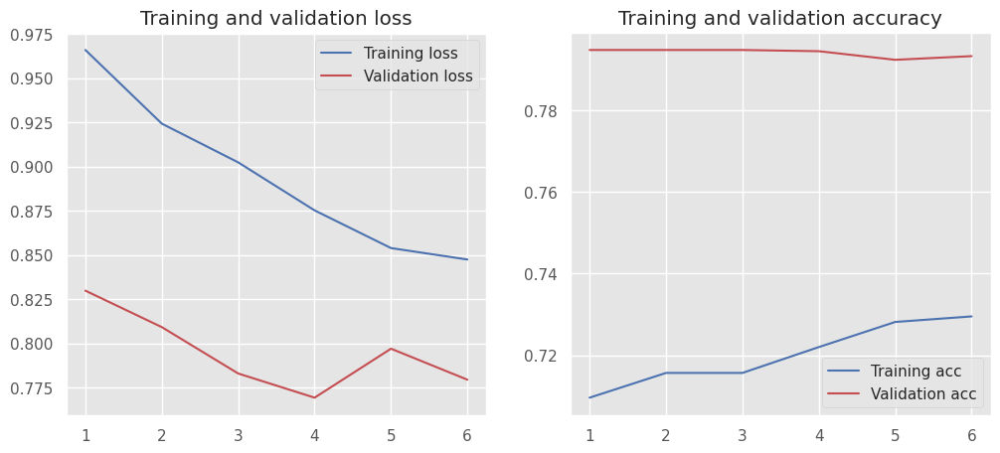

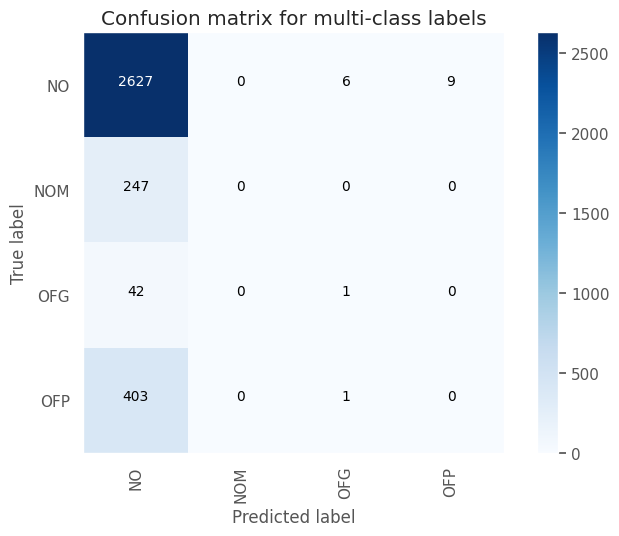

Test Accuracy: 0.7878
Test macro-F1: 0.2302


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.1176    0.0045    0.0086       447
     no_hate     0.8659    0.9948    0.9259      2889

    accuracy                         0.8621      3336
   macro avg     0.4918    0.4996    0.4673      3336
weighted avg     0.7657    0.8621    0.8030      3336



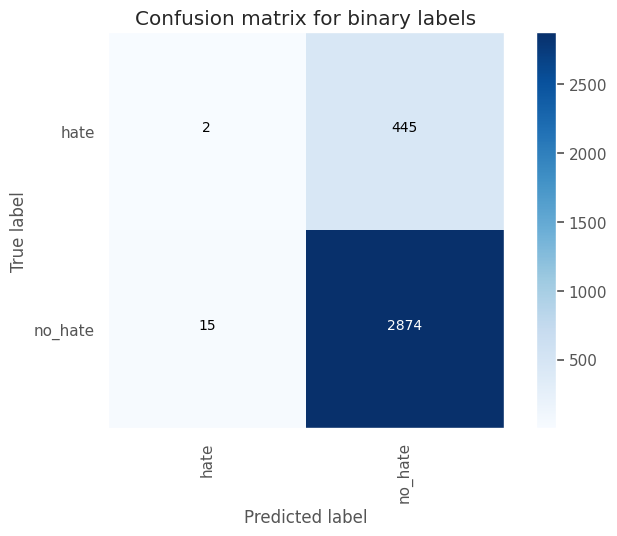

Test Accuracy: 0.8621
Test macro-F1: 0.4673




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_44 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_93 (Dropout)        (None, 128, 100)          0         
                                                                 
 conv1d_54 (Conv1D)          (None, 126, 128)          38528     
                                                                 
 max_pooling1d_54 (MaxPooli  (None, 42, 128)           0         
 ng1D)                                                           
                                                                 
 conv1d_55 (Conv1D)          (None, 40, 64)          

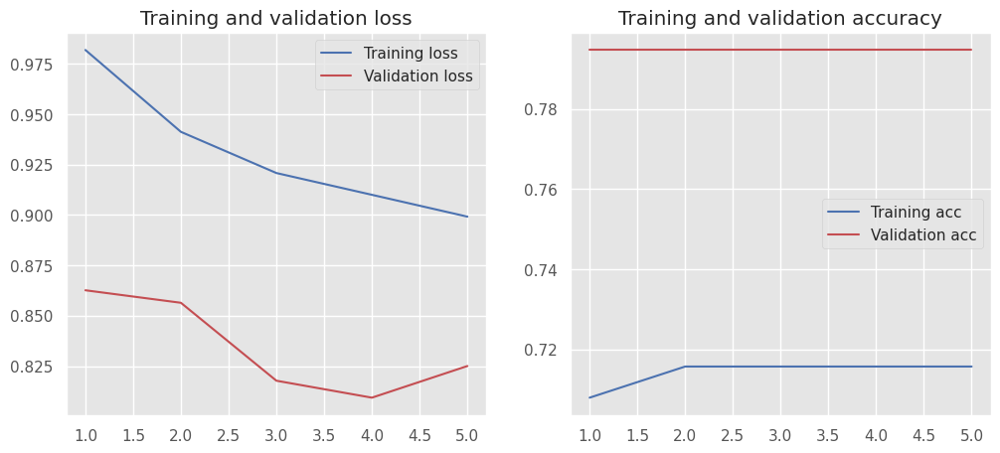

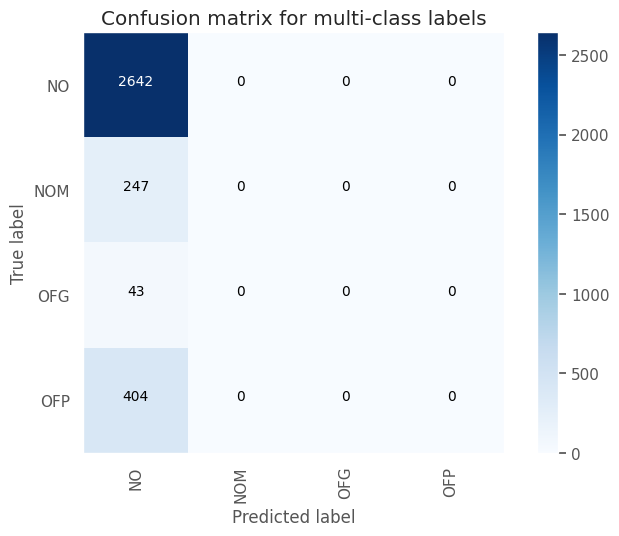

Test Accuracy: 0.792
Test macro-F1: 0.221


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.0000    0.0000    0.0000       447
     no_hate     0.8660    1.0000    0.9282      2889

    accuracy                         0.8660      3336
   macro avg     0.4330    0.5000    0.4641      3336
weighted avg     0.7500    0.8660    0.8038      3336



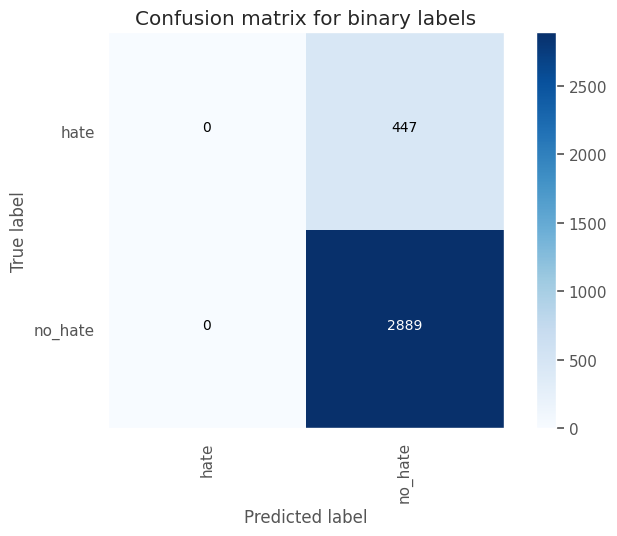

Test Accuracy: 0.866
Test macro-F1: 0.4641







<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>2</th>
      <td>v6</td>
      <td>{'embedding_43': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_91': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_51': {'class_name': 'Conv1D', 'param_count': 38528, 'input': (None, 128, 100), 'output': (None, 126, 128)}, 'max_pooling1d_51': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 128), 'output': (None, 42, 128)}, 'conv1d_52': {'class_name': 'Conv1D', 'param_count': 24640, 'input': (None, 42, 128), 'output': (None, 40, 64)}, 'max_pooling1d_52': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 40, 64), 'output': (None, 13, 64)}, 'conv1d_53': {'class_name': 'Conv1D', 'param_count': 6176, 'input': (None, 13, 64), 'output': (None, 11, 32)}, 'max_pooling1d_53': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 11, 32), 'output': (None, 3, 32)}, 'global_max_pooling1d_3': {'class_name': 'GlobalMaxPooling1D', 'param_count': 0, 'input': (None, 3, 32), 'output': (None, 32)}, 'dense_86': {'class_name': 'Dense', 'param_count': 1056, 'input': (None, 32), 'output': (None, 32)}, 'dropout_92': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_87': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1070632</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.2291</td>
      <td>0.2544</td>
      <td>0.2302</td>
      <td>0.4918</td>
      <td>0.4996</td>
      <td>0.4673</td>
    </tr>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_41': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_87': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_45': {'class_name': 'Conv1D', 'param_count': 38528, 'input': (None, 128, 100), 'output': (None, 126, 128)}, 'max_pooling1d_45': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 128), 'output': (None, 42, 128)}, 'conv1d_46': {'class_name': 'Conv1D', 'param_count': 24640, 'input': (None, 42, 128), 'output': (None, 40, 64)}, 'max_pooling1d_46': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 40, 64), 'output': (None, 13, 64)}, 'conv1d_47': {'class_name': 'Conv1D', 'param_count': 6176, 'input': (None, 13, 64), 'output': (None, 11, 32)}, 'max_pooling1d_47': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 11, 32), 'output': (None, 3, 32)}, 'flatten_38': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 3, 32), 'output': (None, 96)}, 'dense_82': {'class_name': 'Dense', 'param_count': 3104, 'input': (None, 96), 'output': (None, 32)}, 'dropout_88': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_83': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1072680</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.2113</td>
      <td>0.2545</td>
      <td>0.2286</td>
      <td>0.5332</td>
      <td>0.5017</td>
      <td>0.4716</td>
    </tr>
    <tr>
      <th>3</th>
      <td>v6</td>
      <td>{'embedding_44': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_93': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_54': {'class_name': 'Conv1D', 'param_count': 38528, 'input': (None, 128, 100), 'output': (None, 126, 128)}, 'max_pooling1d_54': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 128), 'output': (None, 42, 128)}, 'conv1d_55': {'class_name': 'Conv1D', 'param_count': 24640, 'input': (None, 42, 128), 'output': (None, 40, 64)}, 'max_pooling1d_55': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 40, 64), 'output': (None, 13, 64)}, 'conv1d_56': {'class_name': 'Conv1D', 'param_count': 6176, 'input': (None, 13, 64), 'output': (None, 11, 32)}, 'max_pooling1d_56': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 11, 32), 'output': (None, 3, 32)}, 'global_max_pooling1d_4': {'class_name': 'GlobalMaxPooling1D', 'param_count': 0, 'input': (None, 3, 32), 'output': (None, 32)}, 'dense_88': {'class_name': 'Dense', 'param_count': 1056, 'input': (None, 32), 'output': (None, 32)}, 'dropout_94': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_89': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1070632</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.1980</td>
      <td>0.2500</td>
      <td>0.2210</td>
      <td>0.4330</td>
      <td>0.5000</td>
      <td>0.4641</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_42': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_89': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_48': {'class_name': 'Conv1D', 'param_count': 38528, 'input': (None, 128, 100), 'output': (None, 126, 128)}, 'max_pooling1d_48': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 128), 'output': (None, 42, 128)}, 'conv1d_49': {'class_name': 'Conv1D', 'param_count': 24640, 'input': (None, 42, 128), 'output': (None, 40, 64)}, 'max_pooling1d_49': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 40, 64), 'output': (None, 13, 64)}, 'conv1d_50': {'class_name': 'Conv1D', 'param_count': 6176, 'input': (None, 13, 64), 'output': (None, 11, 32)}, 'max_pooling1d_50': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 11, 32), 'output': (None, 3, 32)}, 'flatten_39': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 3, 32), 'output': (None, 96)}, 'dense_84': {'class_name': 'Dense', 'param_count': 3104, 'input': (None, 96), 'output': (None, 32)}, 'dropout_90': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_85': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1072680</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.1980</td>
      <td>0.2488</td>
      <td>0.2205</td>
      <td>0.4641</td>
      <td>0.4985</td>
      <td>0.4650</td>
    </tr>
  </tbody>
</table>
    

In [25]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

for use_global_pooling in [False, True]:
  for lr in [0.001, 0.0005]:
    # Build CNN model  ===========
    model_config = KerasCNNClassifierModelConfig(
        # General
        vocab_size=vocab_size,
        model_name="cnn_classifier",
        # Embeddings
        embedding_config=EmbeddingConfig(output_dim=embedding_dim, input_length=max_length, trainable=True, pre_trained_matrix=None),
        # CNN Layers
        cnn_filter_dims=[128, 64, 32],
        cnn_kernel_sizes=[3, 3, 3],
        cnn_activations=["relu", "relu", "relu"],
        cnn_stride_sizes=[1, 1, 1],
        cnn_padding=["valid", "valid", "valid"],
        pool_sizes=[3,3,3],
        use_global_pooling=use_global_pooling,
        # Dense layers at the end
        dense_activations=["relu", "softmax"],
        dense_dims=[32,4],
        # Dropouts
        dp_after_embedding=0.6,
        dp_after_pooling=None,
        dp_before_classif_dense=0.5)
    model: tf.keras.Model = CNNModelFactory.create(model_config)
    # ============================


    # Train  ===========
    trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                              max_input_length=max_length))
    optim_config: OptimizationConfig = OptimizationConfig(
        epochs=25,
        batch_size=32,
        validation_split=0.0,
        validation_data=(x_val, y_val),
        optimizer=Adam(learning_rate=lr),
        class_weight=None
    )
    trainer.train(x_train=x_train,
                  y_train=y_train,
                  opt_config=optim_config,
                  callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
    mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
    mc_report: dict
    bc_report: dict

    # Accumulate result so it can be plotted
    result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                    dataset_version=dataset_name,
                                    model_params=model.count_params(),
                                    optim_config=optim_config,
                                    macro_prec_mc=mc_report["macro avg"]["precision"],
                                    macro_recall_mc=mc_report["macro avg"]["recall"],
                                    macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                    macro_prec_bc=bc_report["macro avg"]["precision"],
                                    macro_recall_bc=bc_report["macro avg"]["recall"],
                                    macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                    )
    results_rep.accumulate(result)
    # ============================

report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)

Muy malos estos resultados. Vemos que underfiteamos con la arquitectura planteada. En función de estos resultados y de los que obtuvimos antes usando sólo Dense layers, suena a que nuestra mejor apuesta está en utilizar una única layer de convolución. Intentaré optimizar esa arquitectura entonces.

Exploramos los hiperparámetros alrededor de eso entonces.

Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_45 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_95 (Dropout)        (None, 128, 100)          0         
                                                                 
 conv1d_57 (Conv1D)          (None, 126, 128)          38528     
                                                                 
 max_pooling1d_57 (MaxPooli  (None, 42, 128)           0         
 ng1D)                                                           
                                                                 
 dropout_9

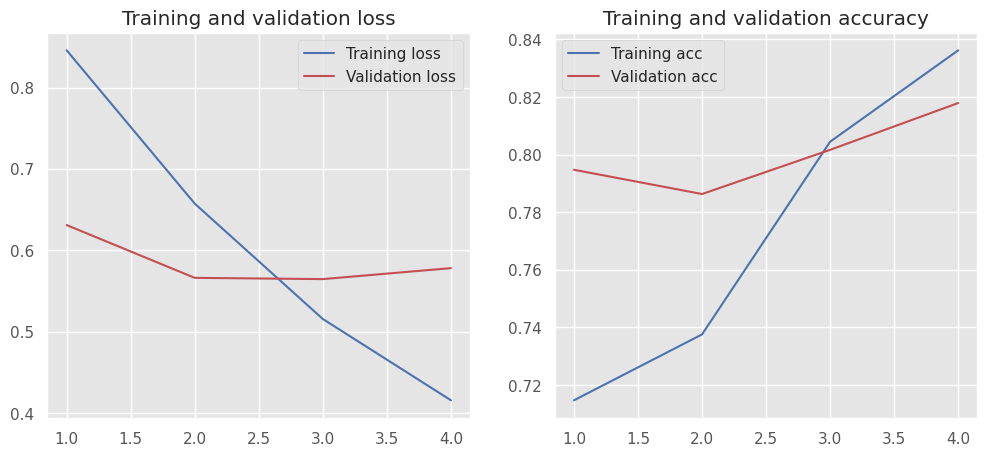

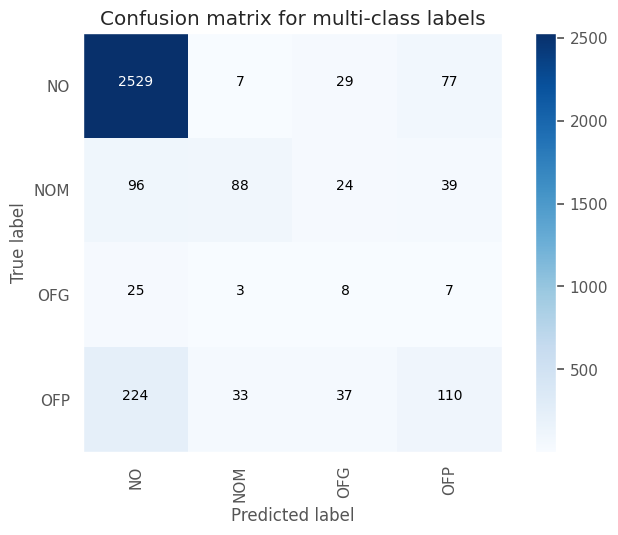

Test Accuracy: 0.8198
Test macro-F1: 0.4604


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4894    0.3624    0.4165       447
     no_hate     0.9052    0.9415    0.9230      2889

    accuracy                         0.8639      3336
   macro avg     0.6973    0.6520    0.6697      3336
weighted avg     0.8495    0.8639    0.8551      3336



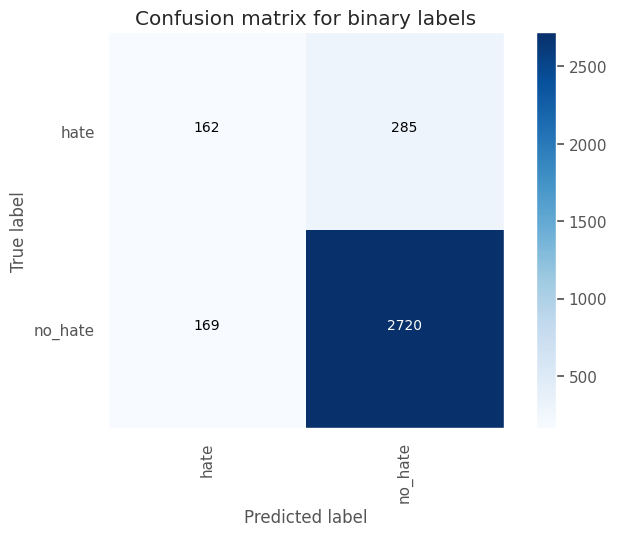

Test Accuracy: 0.8639
Test macro-F1: 0.6697







<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_45': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_95': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_57': {'class_name': 'Conv1D', 'param_count': 38528, 'input': (None, 128, 100), 'output': (None, 126, 128)}, 'max_pooling1d_57': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 128), 'output': (None, 42, 128)}, 'dropout_96': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 128), 'output': (None, 42, 128)}, 'flatten_40': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 128), 'output': (None, 5376)}, 'dense_90': {'class_name': 'Dense', 'param_count': 172064, 'input': (None, 5376), 'output': (None, 32)}, 'dropout_97': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_91': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1210824</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.0005}}</td>
      <td>0.5264</td>
      <td>0.443</td>
      <td>0.4604</td>
      <td>0.6973</td>
      <td>0.652</td>
      <td>0.6697</td>
    </tr>
  </tbody>
</table>
    

In [26]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

# Build CNN model  ===========
model_config = KerasCNNClassifierModelConfig(
    # General
    vocab_size=vocab_size,
    model_name="cnn_classifier",
    # Embeddings
    embedding_config=EmbeddingConfig(output_dim=embedding_dim, input_length=max_length, trainable=True, pre_trained_matrix=None),
    # CNN Layers
    cnn_filter_dims=[128],
    cnn_kernel_sizes=[3],
    cnn_activations=["relu"],
    cnn_stride_sizes=[1],
    cnn_padding=["valid"],
    pool_sizes=[3],
    use_global_pooling=False,
    # Dense layers at the end
    dense_activations=["relu", "softmax"],
    dense_dims=[32,4],
    # Dropouts
    dp_after_embedding=0.5,
    dp_after_pooling=[0.2],
    dp_before_classif_dense=0.5)
model: tf.keras.Model = CNNModelFactory.create(model_config)
# ============================


# Train  ===========
trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                          max_input_length=max_length))
optim_config: OptimizationConfig = OptimizationConfig(
    epochs=25,
    batch_size=32,
    validation_split=0.0,
    validation_data=(x_val, y_val),
    optimizer=Adam(learning_rate=lr),
    class_weight=None
)
trainer.train(x_train=x_train,
              y_train=y_train,
              opt_config=optim_config,
              callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
mc_report: dict
bc_report: dict

# Accumulate result so it can be plotted
result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                dataset_version=dataset_name,
                                model_params=model.count_params(),
                                optim_config=optim_config,
                                macro_prec_mc=mc_report["macro avg"]["precision"],
                                macro_recall_mc=mc_report["macro avg"]["recall"],
                                macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                macro_prec_bc=bc_report["macro avg"]["precision"],
                                macro_recall_bc=bc_report["macro avg"]["recall"],
                                macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                )
results_rep.accumulate(result)
# ============================

report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)

Teniendo esta base (la cual era mejor el punto de partida en la primera prueba que hicimos), optimizaremos el resto de los parámetros a ver si logramos mejores resultados.

Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_86 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_218 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_98 (Conv1D)          (None, 126, 16)           4816      
                                                                 
 max_pooling1d_98 (MaxPooli  (None, 63, 16)            0         
 ng1D)                                                           
                                                                 
 dropout_2

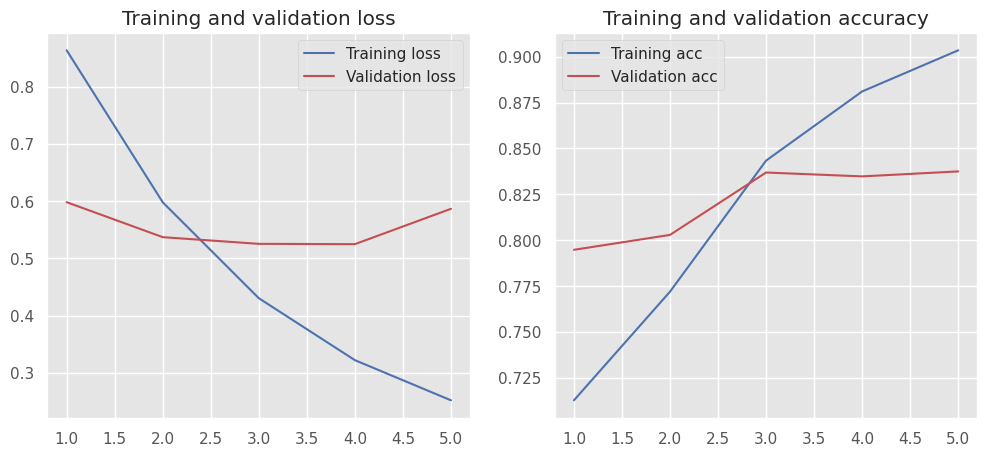

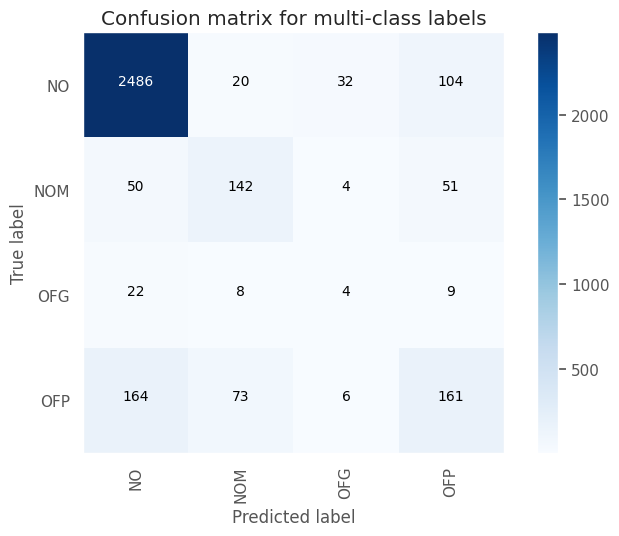

Test Accuracy: 0.8372
Test macro-F1: 0.5095


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4852    0.4027    0.4401       447
     no_hate     0.9099    0.9339    0.9218      2889

    accuracy                         0.8627      3336
   macro avg     0.6976    0.6683    0.6809      3336
weighted avg     0.8530    0.8627    0.8572      3336



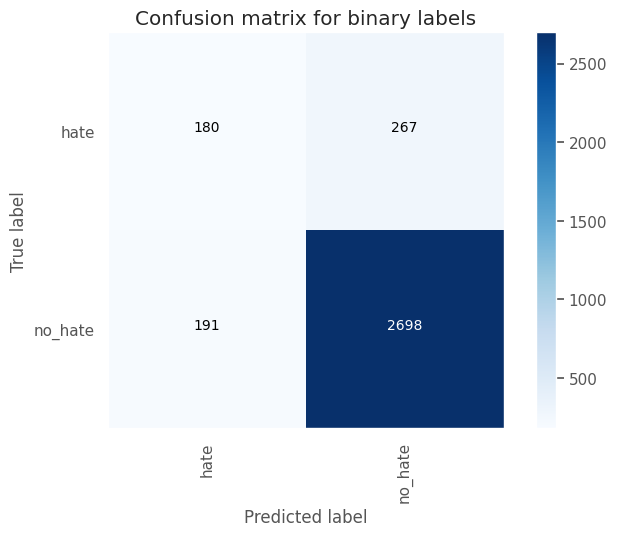

Test Accuracy: 0.8627
Test macro-F1: 0.6809




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_87 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_221 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_99 (Conv1D)          (None, 126, 16)           4816      
                                                                 
 max_pooling1d_99 (MaxPooli  (None, 63, 16)            0         
 ng1D)                                                           
                                                                 
 dropout_222 (Dropout)       (None, 63, 16)          

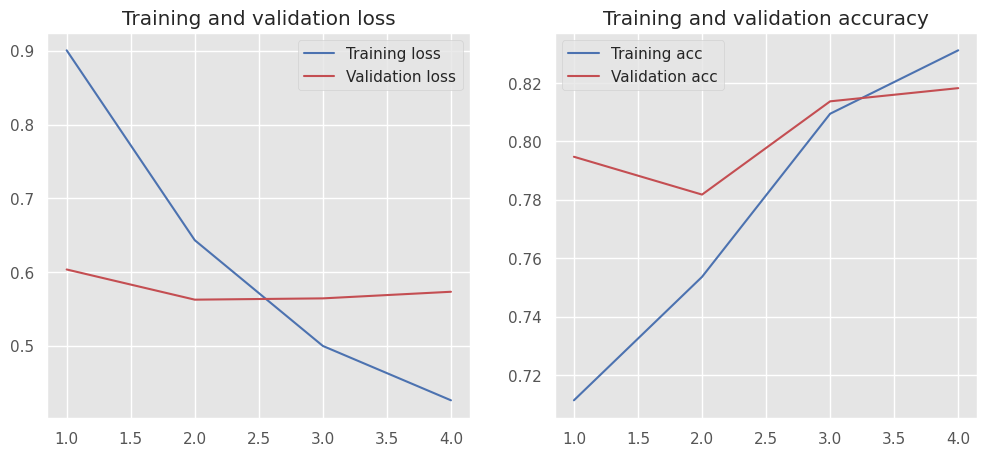

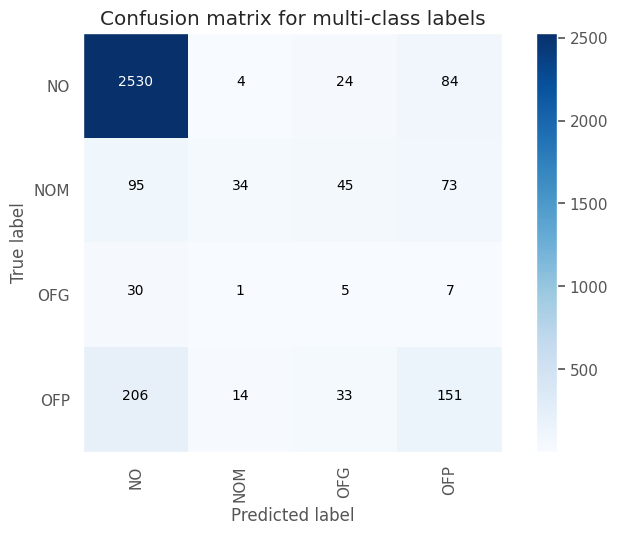

Test Accuracy: 0.8153
Test macro-F1: 0.4082


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4645    0.4385    0.4511       447
     no_hate     0.9139    0.9218    0.9178      2889

    accuracy                         0.8570      3336
   macro avg     0.6892    0.6801    0.6844      3336
weighted avg     0.8536    0.8570    0.8553      3336



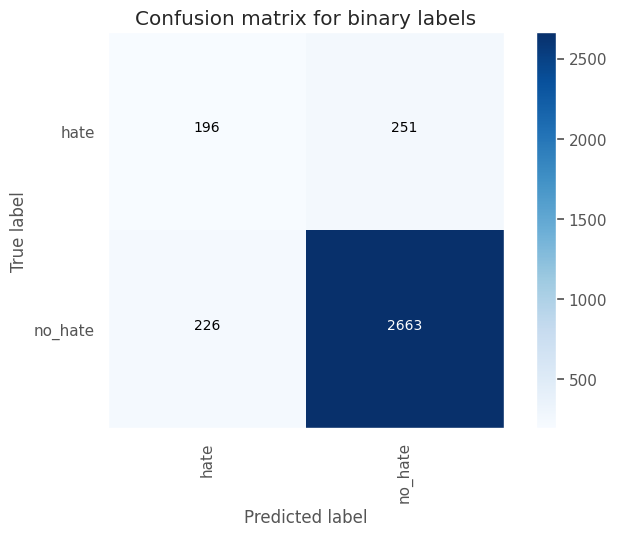

Test Accuracy: 0.857
Test macro-F1: 0.6844




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_88 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_224 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_100 (Conv1D)         (None, 126, 16)           4816      
                                                                 
 max_pooling1d_100 (MaxPool  (None, 63, 16)            0         
 ing1D)                                                          
                                                                 
 dropout_225 (Dropout)       (None, 63, 16)           

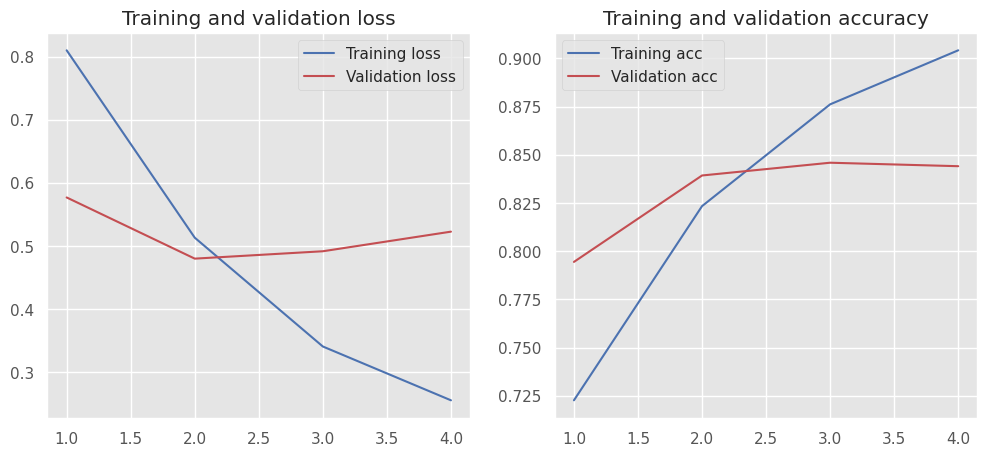

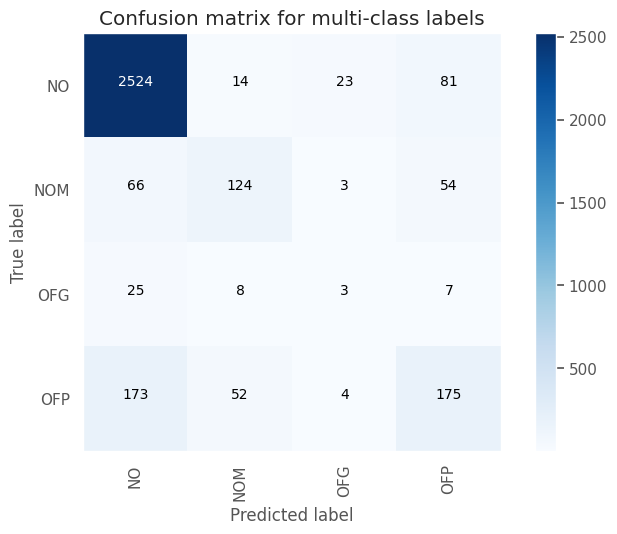

Test Accuracy: 0.8471
Test macro-F1: 0.5128


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5400    0.4228    0.4743       447
     no_hate     0.9136    0.9443    0.9287      2889

    accuracy                         0.8744      3336
   macro avg     0.7268    0.6835    0.7015      3336
weighted avg     0.8635    0.8744    0.8678      3336



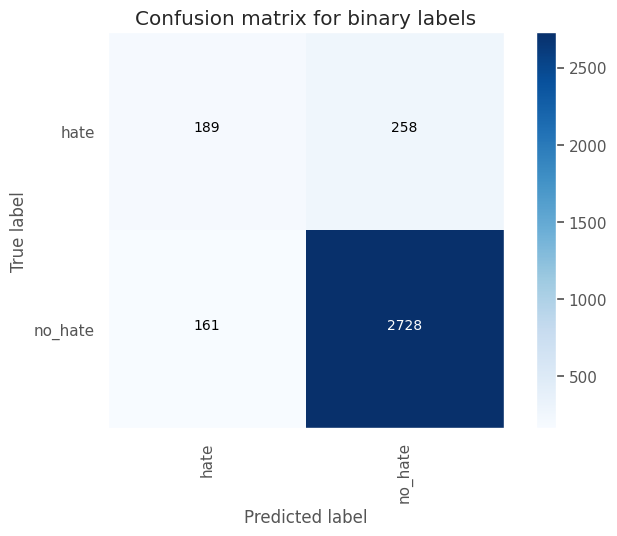

Test Accuracy: 0.8744
Test macro-F1: 0.7015




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_89 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_227 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_101 (Conv1D)         (None, 126, 16)           4816      
                                                                 
 max_pooling1d_101 (MaxPool  (None, 63, 16)            0         
 ing1D)                                                          
                                                                 
 dropout_228 (Dropout)       (None, 63, 16)          

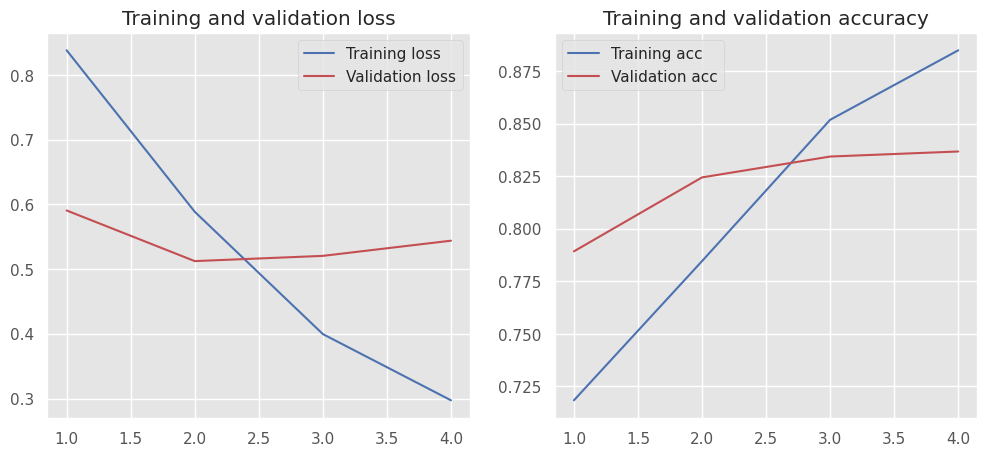

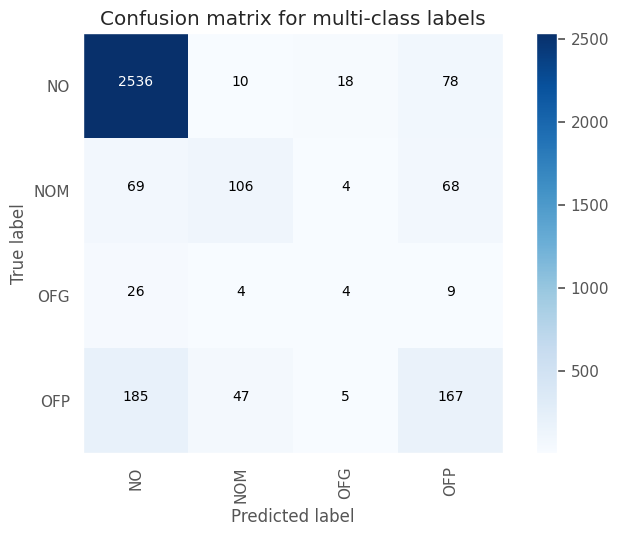

Test Accuracy: 0.8432
Test macro-F1: 0.5024


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5241    0.4139    0.4625       447
     no_hate     0.9122    0.9418    0.9268      2889

    accuracy                         0.8711      3336
   macro avg     0.7181    0.6779    0.6946      3336
weighted avg     0.8602    0.8711    0.8646      3336



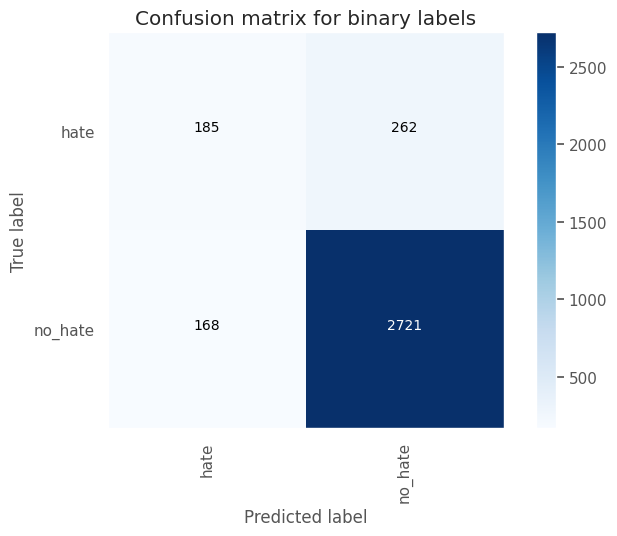

Test Accuracy: 0.8711
Test macro-F1: 0.6946




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_90 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_230 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_102 (Conv1D)         (None, 126, 16)           4816      
                                                                 
 max_pooling1d_102 (MaxPool  (None, 63, 16)            0         
 ing1D)                                                          
                                                                 
 dropout_231 (Dropout)       (None, 63, 16)          

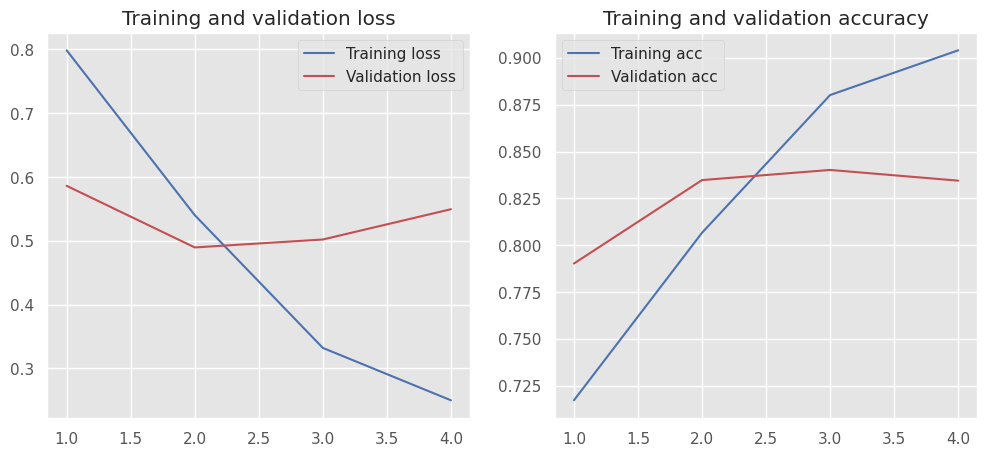

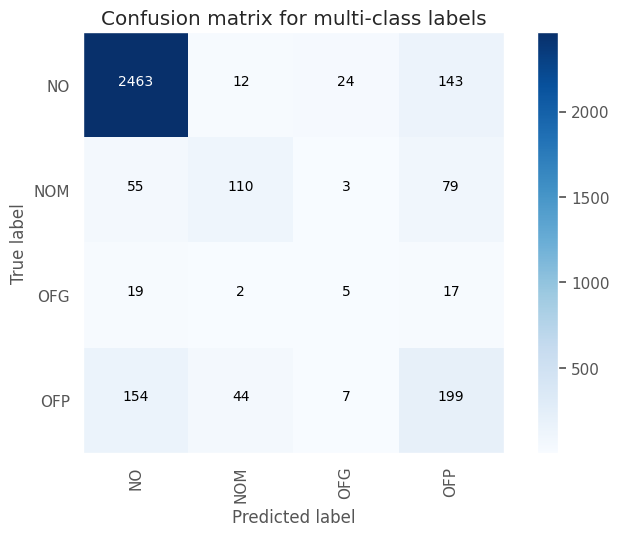

Test Accuracy: 0.8324
Test macro-F1: 0.5121


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4780    0.5101    0.4935       447
     no_hate     0.9234    0.9138    0.9186      2889

    accuracy                         0.8597      3336
   macro avg     0.7007    0.7119    0.7060      3336
weighted avg     0.8637    0.8597    0.8616      3336



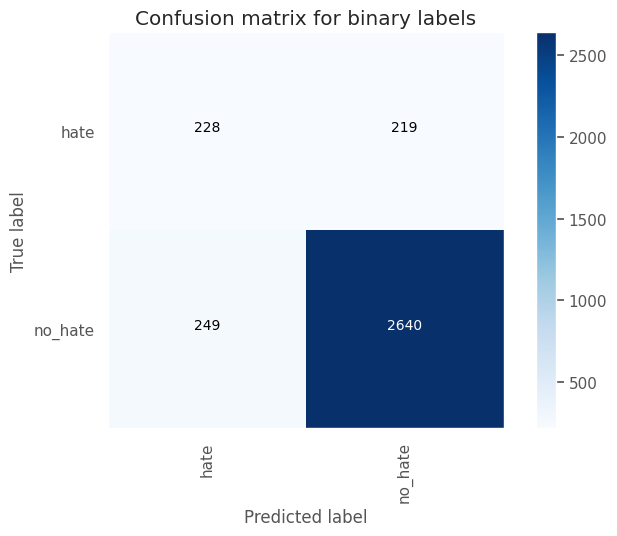

Test Accuracy: 0.8597
Test macro-F1: 0.706




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_91 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_233 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_103 (Conv1D)         (None, 126, 16)           4816      
                                                                 
 max_pooling1d_103 (MaxPool  (None, 63, 16)            0         
 ing1D)                                                          
                                                                 
 dropout_234 (Dropout)       (None, 63, 16)           

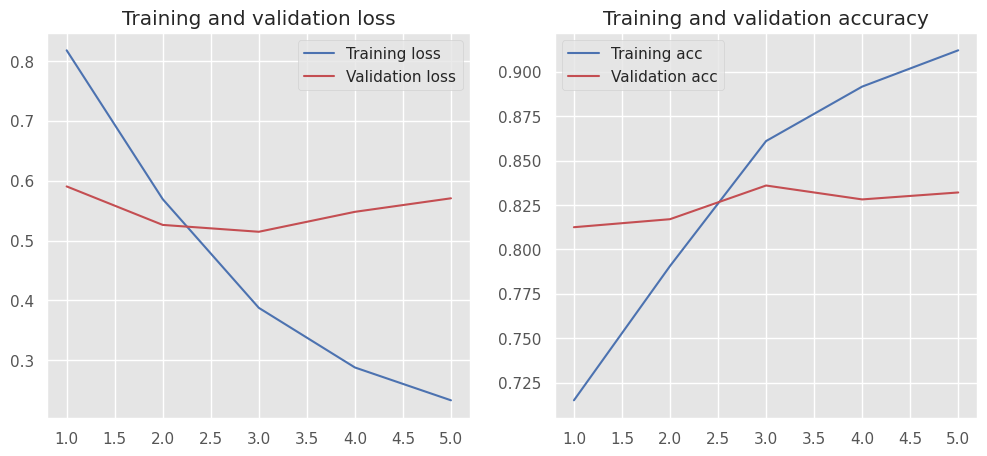

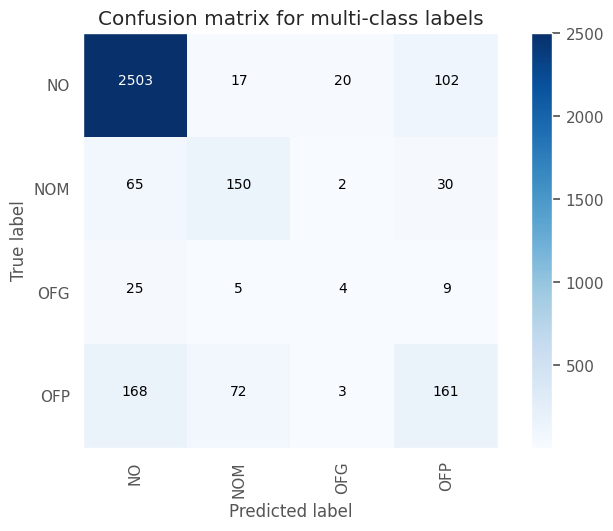

Test Accuracy: 0.8447
Test macro-F1: 0.5262


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5347    0.3960    0.4550       447
     no_hate     0.9101    0.9467    0.9281      2889

    accuracy                         0.8729      3336
   macro avg     0.7224    0.6713    0.6915      3336
weighted avg     0.8598    0.8729    0.8647      3336



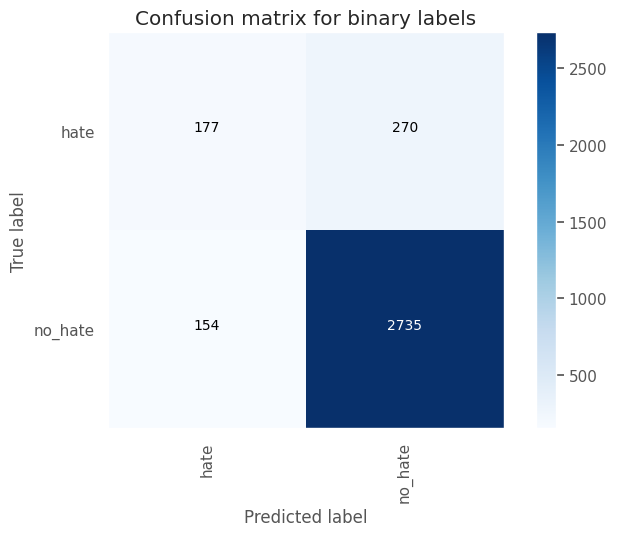

Test Accuracy: 0.8729
Test macro-F1: 0.6915




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_92 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_236 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_104 (Conv1D)         (None, 126, 16)           4816      
                                                                 
 max_pooling1d_104 (MaxPool  (None, 42, 16)            0         
 ing1D)                                                          
                                                                 
 dropout_237 (Dropout)       (None, 42, 16)          

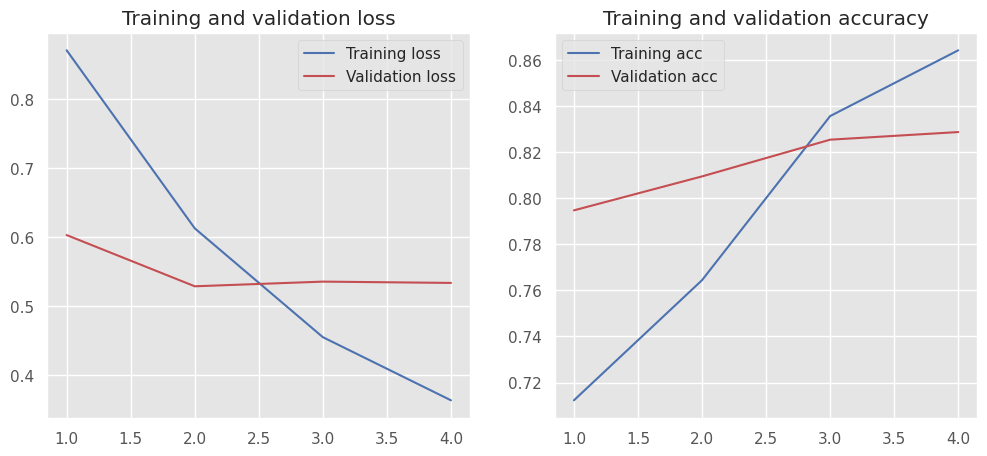

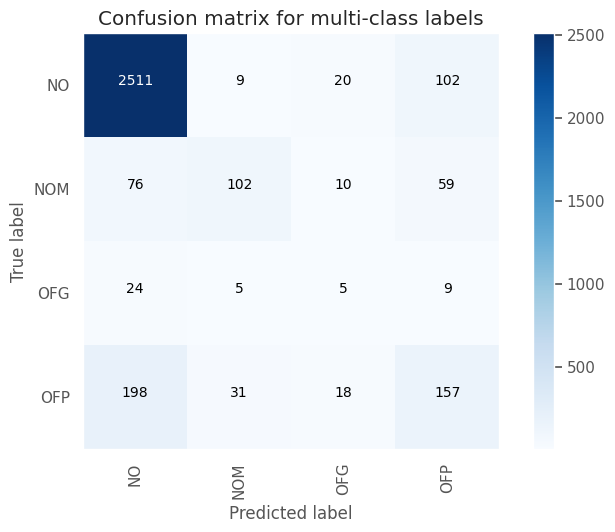

Test Accuracy: 0.8318
Test macro-F1: 0.4932


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4974    0.4228    0.4571       447
     no_hate     0.9127    0.9339    0.9232      2889

    accuracy                         0.8654      3336
   macro avg     0.7050    0.6784    0.6901      3336
weighted avg     0.8571    0.8654    0.8607      3336



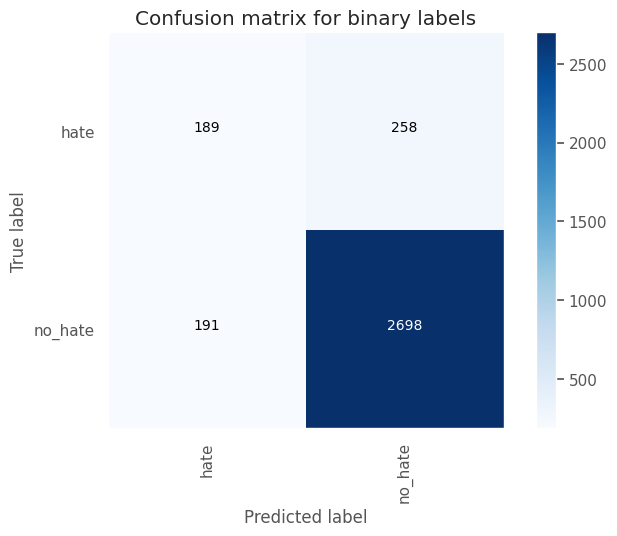

Test Accuracy: 0.8654
Test macro-F1: 0.6901




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_93 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_239 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_105 (Conv1D)         (None, 126, 16)           4816      
                                                                 
 max_pooling1d_105 (MaxPool  (None, 42, 16)            0         
 ing1D)                                                          
                                                                 
 dropout_240 (Dropout)       (None, 42, 16)          

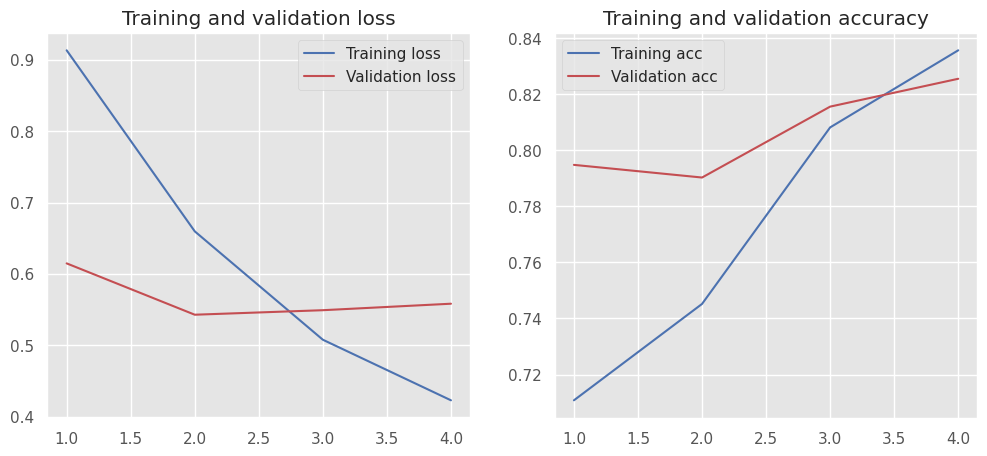

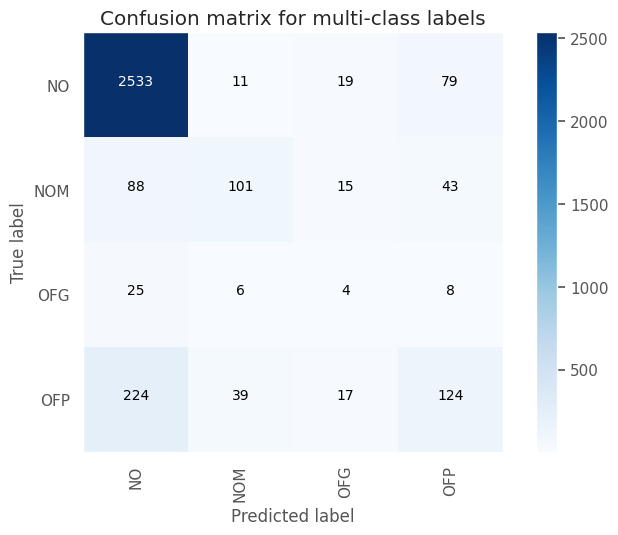

Test Accuracy: 0.8279
Test macro-F1: 0.4694


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4951    0.3423    0.4048       447
     no_hate     0.9029    0.9460    0.9239      2889

    accuracy                         0.8651      3336
   macro avg     0.6990    0.6441    0.6643      3336
weighted avg     0.8482    0.8651    0.8544      3336



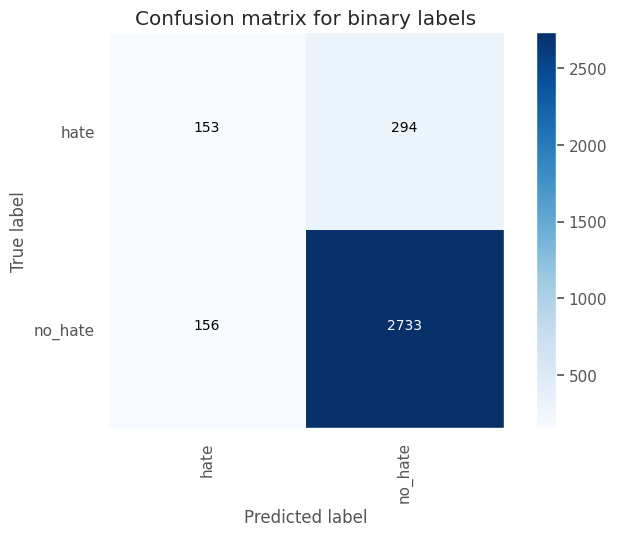

Test Accuracy: 0.8651
Test macro-F1: 0.6643




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_94 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_242 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_106 (Conv1D)         (None, 126, 16)           4816      
                                                                 
 max_pooling1d_106 (MaxPool  (None, 42, 16)            0         
 ing1D)                                                          
                                                                 
 dropout_243 (Dropout)       (None, 42, 16)          

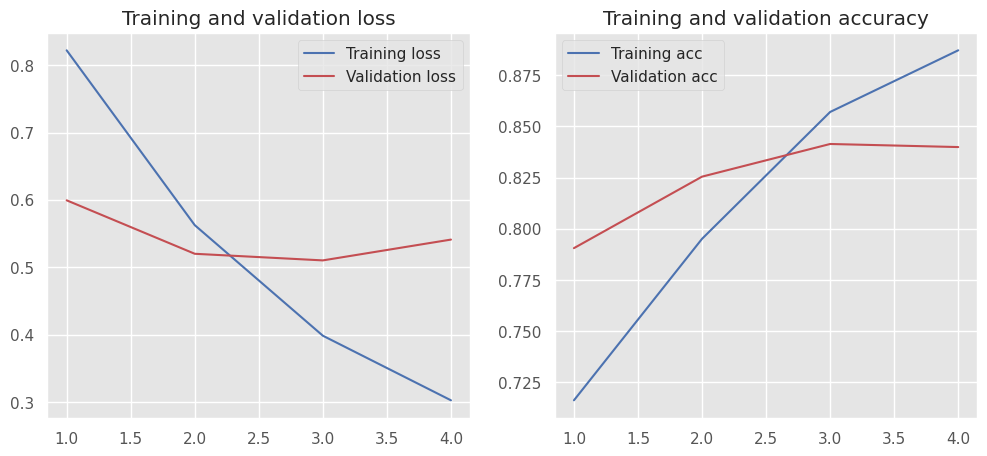

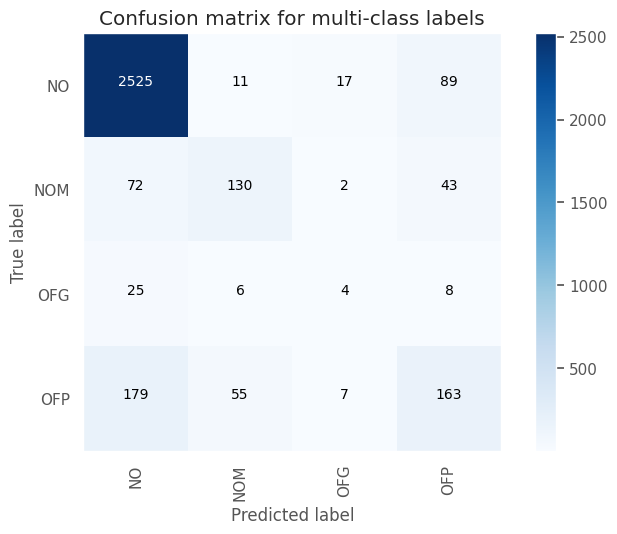

Test Accuracy: 0.8459
Test macro-F1: 0.5194


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5465    0.4072    0.4667       447
     no_hate     0.9118    0.9477    0.9294      2889

    accuracy                         0.8753      3336
   macro avg     0.7292    0.6774    0.6980      3336
weighted avg     0.8628    0.8753    0.8674      3336



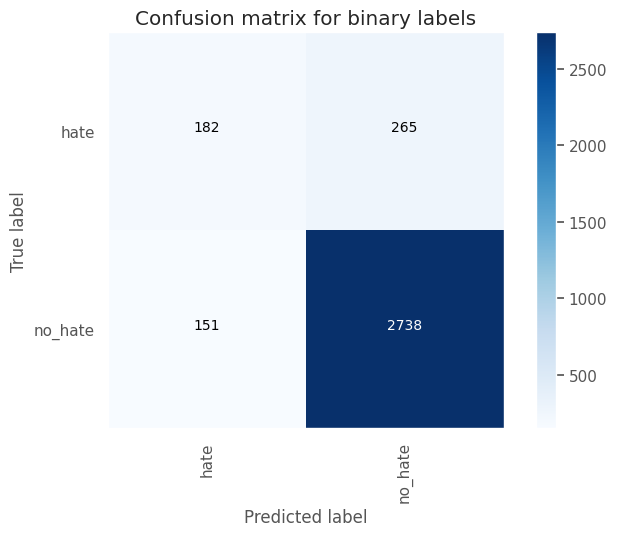

Test Accuracy: 0.8753
Test macro-F1: 0.698




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_95 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_245 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_107 (Conv1D)         (None, 126, 16)           4816      
                                                                 
 max_pooling1d_107 (MaxPool  (None, 42, 16)            0         
 ing1D)                                                          
                                                                 
 dropout_246 (Dropout)       (None, 42, 16)           

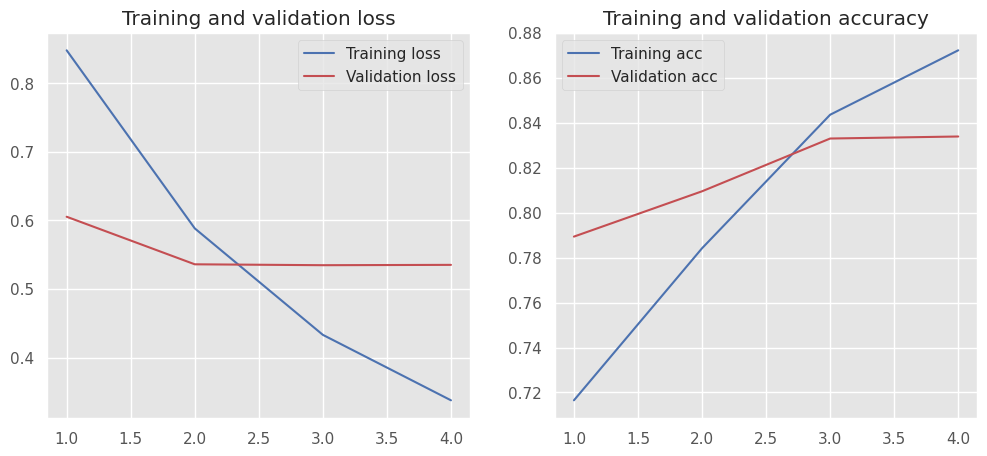

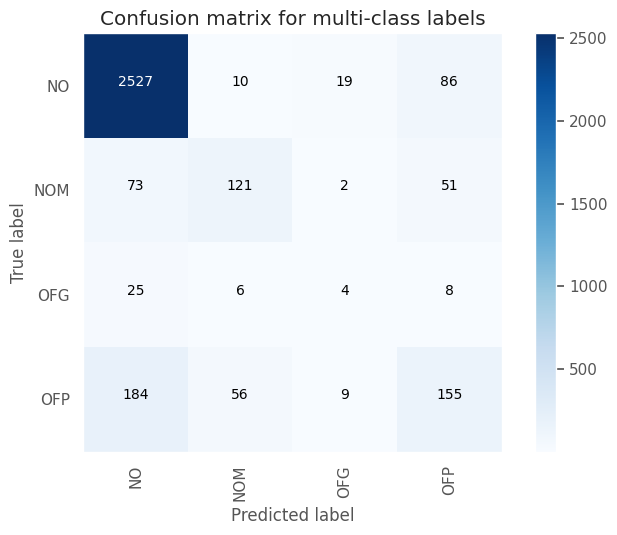

Test Accuracy: 0.8414
Test macro-F1: 0.5054


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5269    0.3937    0.4507       447
     no_hate     0.9097    0.9453    0.9272      2889

    accuracy                         0.8714      3336
   macro avg     0.7183    0.6695    0.6889      3336
weighted avg     0.8584    0.8714    0.8633      3336



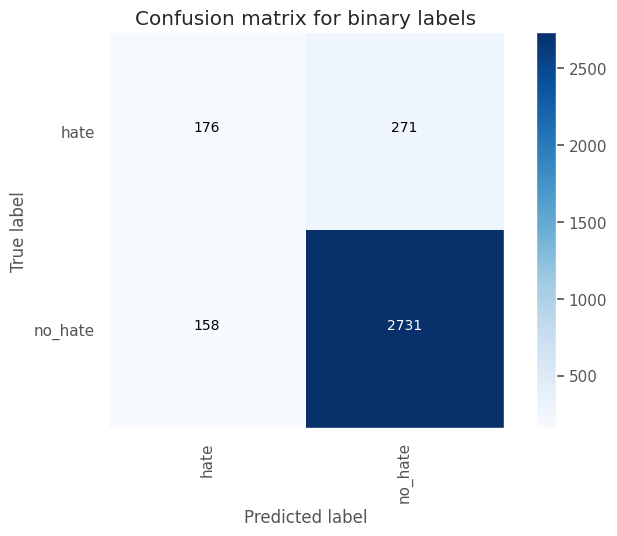

Test Accuracy: 0.8714
Test macro-F1: 0.6889




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_96 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_248 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_108 (Conv1D)         (None, 126, 16)           4816      
                                                                 
 max_pooling1d_108 (MaxPool  (None, 42, 16)            0         
 ing1D)                                                          
                                                                 
 dropout_249 (Dropout)       (None, 42, 16)          

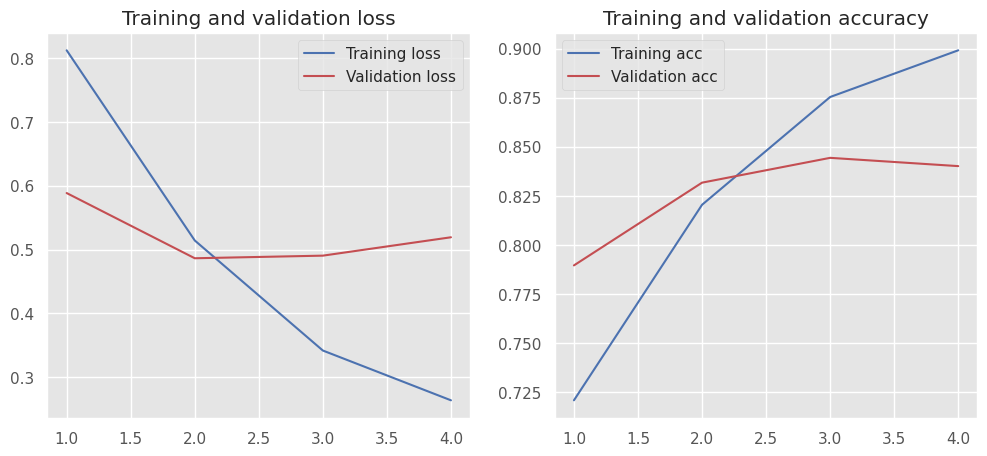

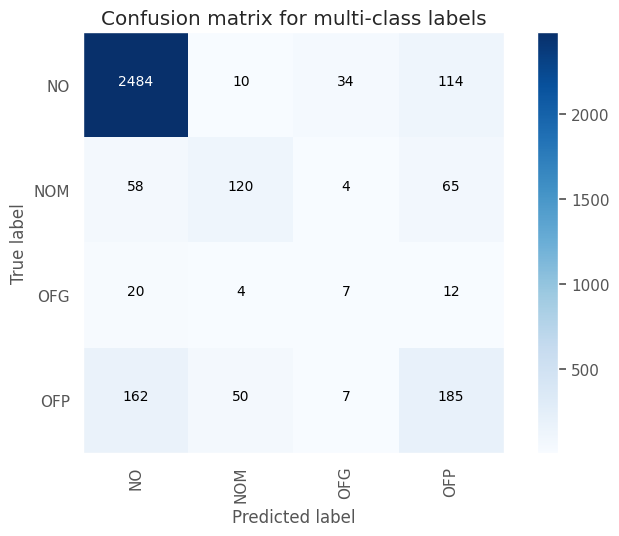

Test Accuracy: 0.8381
Test macro-F1: 0.5261


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4930    0.4720    0.4823       447
     no_hate     0.9188    0.9249    0.9219      2889

    accuracy                         0.8642      3336
   macro avg     0.7059    0.6985    0.7021      3336
weighted avg     0.8618    0.8642    0.8630      3336



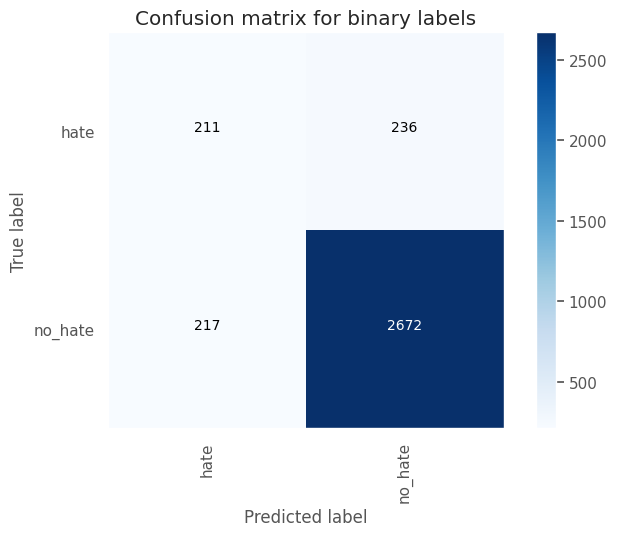

Test Accuracy: 0.8642
Test macro-F1: 0.7021




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_97 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_251 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_109 (Conv1D)         (None, 126, 16)           4816      
                                                                 
 max_pooling1d_109 (MaxPool  (None, 42, 16)            0         
 ing1D)                                                          
                                                                 
 dropout_252 (Dropout)       (None, 42, 16)          

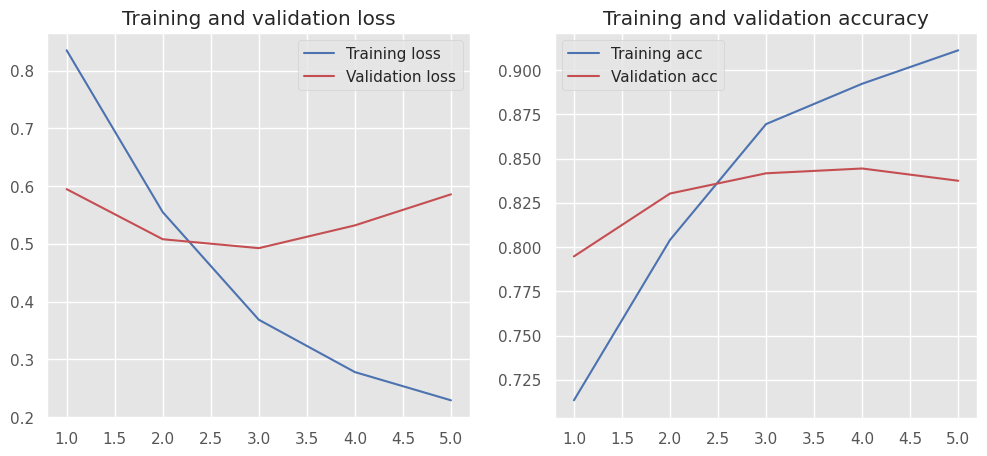

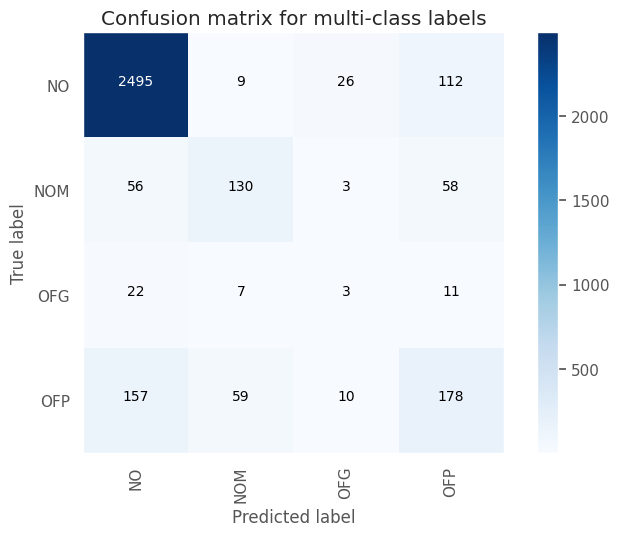

Test Accuracy: 0.8411
Test macro-F1: 0.5103


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5037    0.4519    0.4764       447
     no_hate     0.9165    0.9311    0.9238      2889

    accuracy                         0.8669      3336
   macro avg     0.7101    0.6915    0.7001      3336
weighted avg     0.8612    0.8669    0.8638      3336



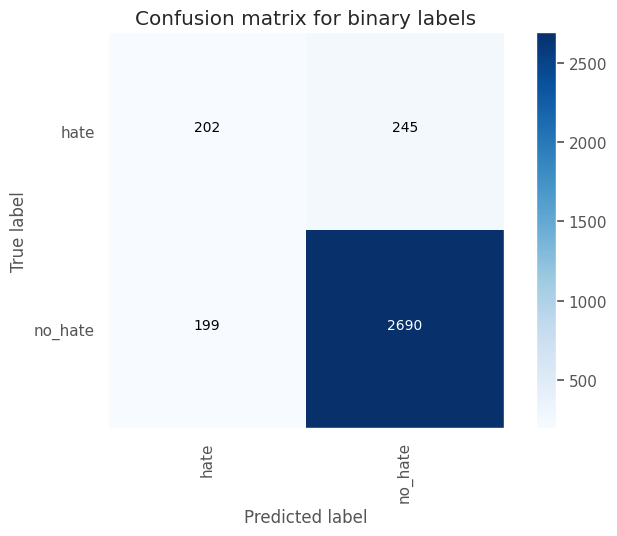

Test Accuracy: 0.8669
Test macro-F1: 0.7001




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_98 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_254 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_110 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_110 (MaxPool  (None, 63, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_255 (Dropout)       (None, 63, 32)          

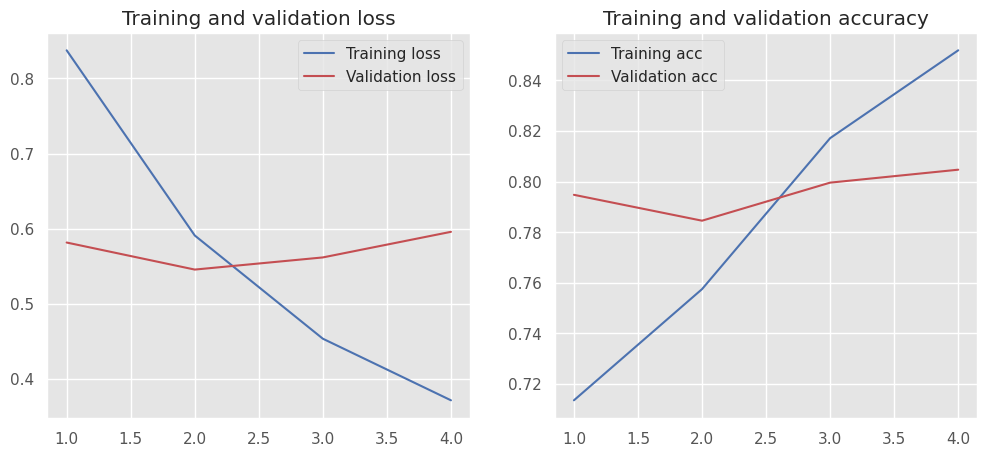

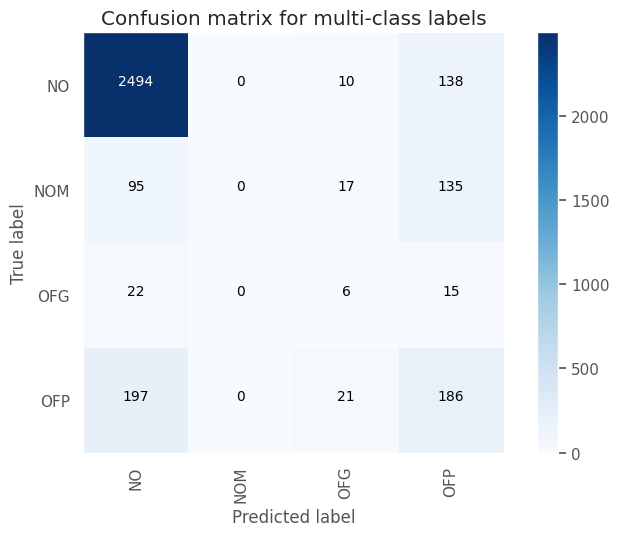

Test Accuracy: 0.8052
Test macro-F1: 0.3657


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4318    0.5101    0.4677       447
     no_hate     0.9220    0.8962    0.9089      2889

    accuracy                         0.8444      3336
   macro avg     0.6769    0.7031    0.6883      3336
weighted avg     0.8563    0.8444    0.8498      3336



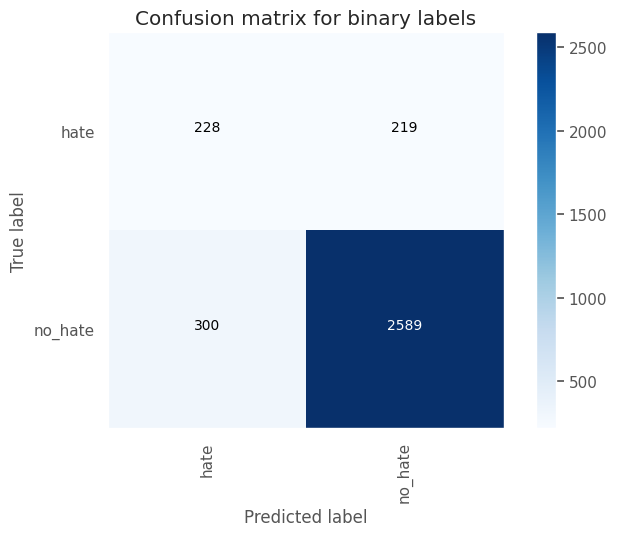

Test Accuracy: 0.8444
Test macro-F1: 0.6883




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_99 (Embedding)    (None, 128, 100)          1000100   
                                                                 
 dropout_257 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_111 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_111 (MaxPool  (None, 63, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_258 (Dropout)       (None, 63, 32)          

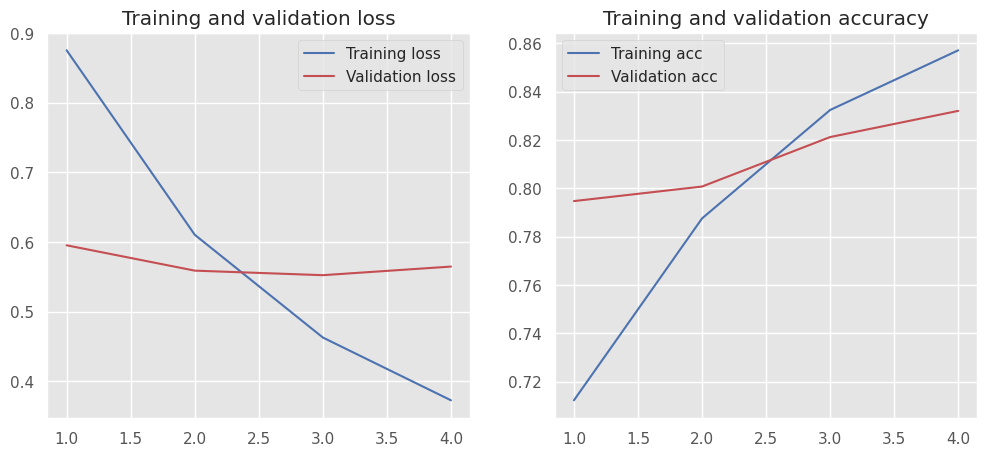

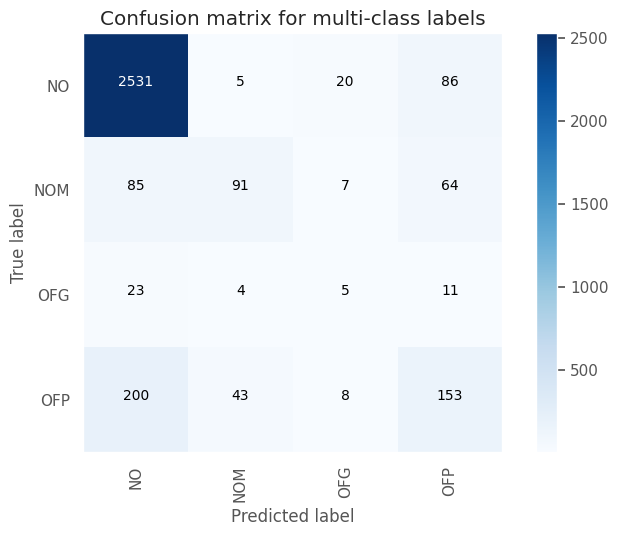

Test Accuracy: 0.8333
Test macro-F1: 0.4842


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5000    0.3960    0.4419       447
     no_hate     0.9095    0.9387    0.9239      2889

    accuracy                         0.8660      3336
   macro avg     0.7047    0.6674    0.6829      3336
weighted avg     0.8546    0.8660    0.8593      3336



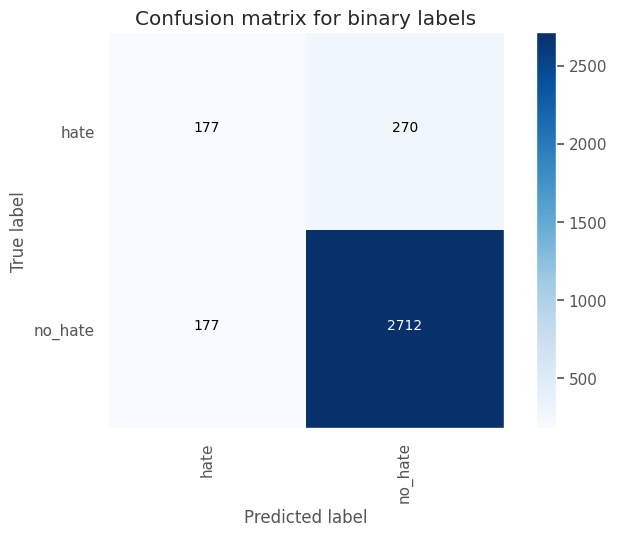

Test Accuracy: 0.866
Test macro-F1: 0.6829




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_100 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_260 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_112 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_112 (MaxPool  (None, 63, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_261 (Dropout)       (None, 63, 32)           

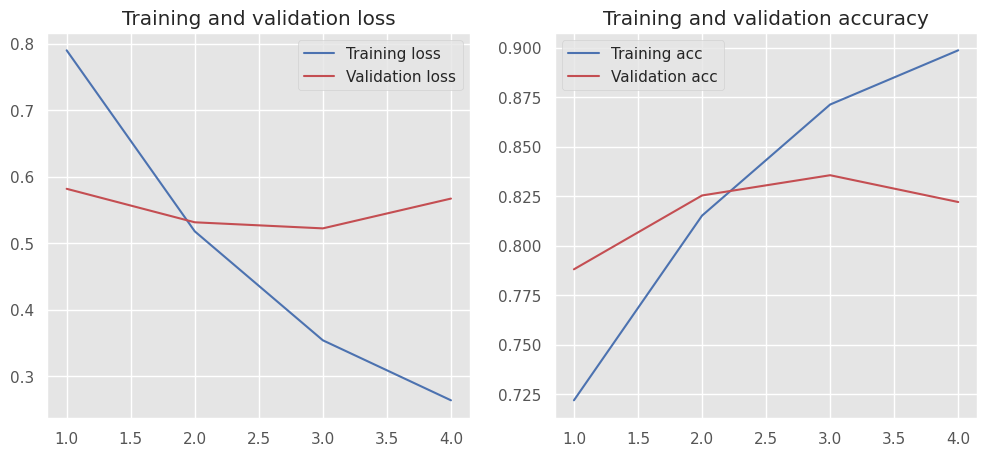

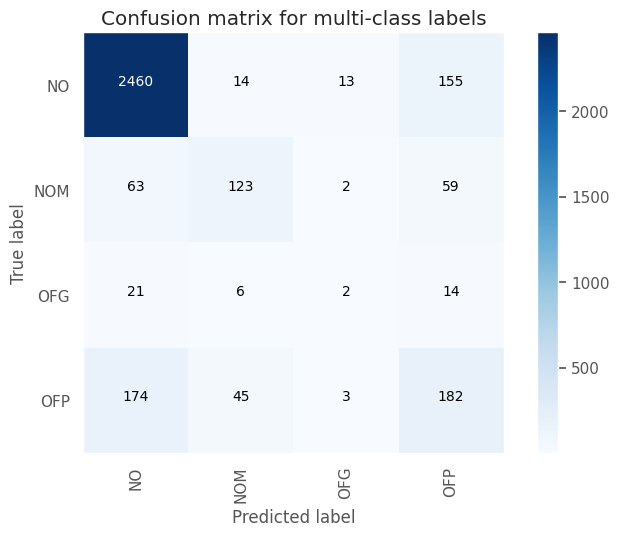

Test Accuracy: 0.8294
Test macro-F1: 0.4985


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4674    0.4497    0.4584       447
     no_hate     0.9153    0.9207    0.9180      2889

    accuracy                         0.8576      3336
   macro avg     0.6914    0.6852    0.6882      3336
weighted avg     0.8553    0.8576    0.8564      3336



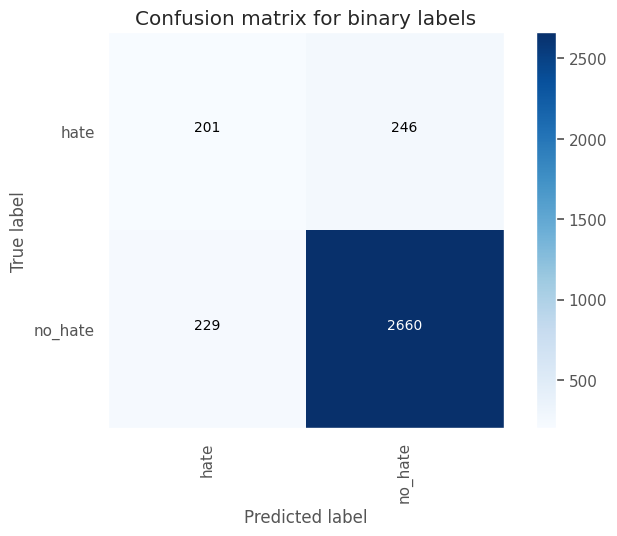

Test Accuracy: 0.8576
Test macro-F1: 0.6882




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_101 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_263 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_113 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_113 (MaxPool  (None, 63, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_264 (Dropout)       (None, 63, 32)          

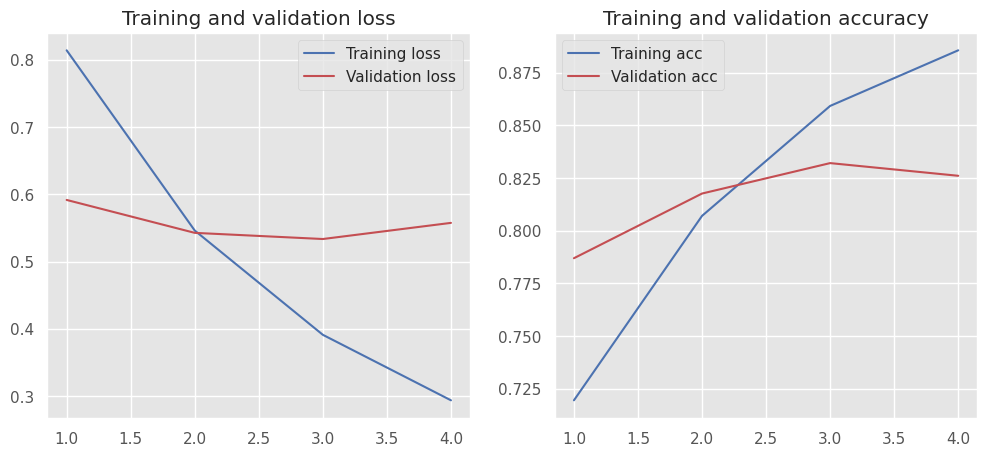

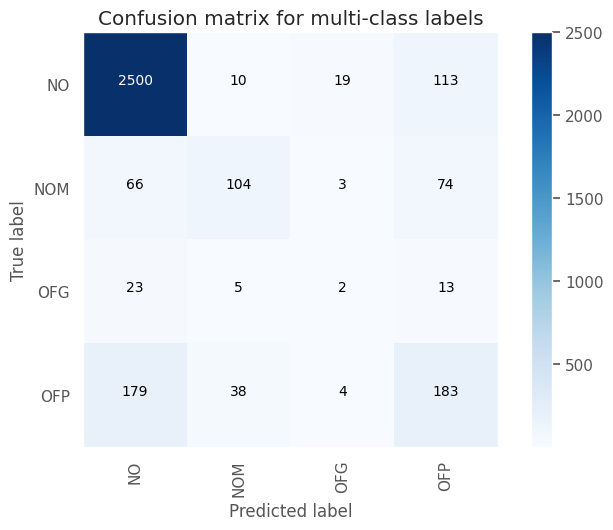

Test Accuracy: 0.836
Test macro-F1: 0.4901


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4915    0.4519    0.4709       447
     no_hate     0.9162    0.9277    0.9219      2889

    accuracy                         0.8639      3336
   macro avg     0.7039    0.6898    0.6964      3336
weighted avg     0.8593    0.8639    0.8615      3336



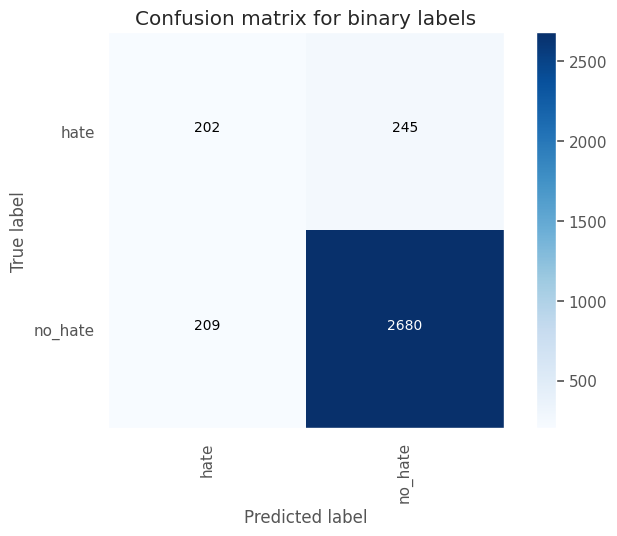

Test Accuracy: 0.8639
Test macro-F1: 0.6964




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_102 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_266 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_114 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_114 (MaxPool  (None, 63, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_267 (Dropout)       (None, 63, 32)          

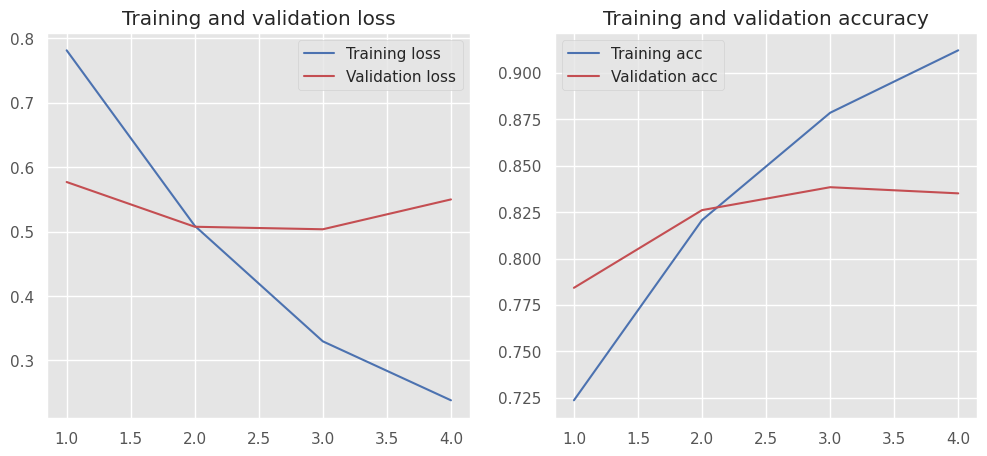

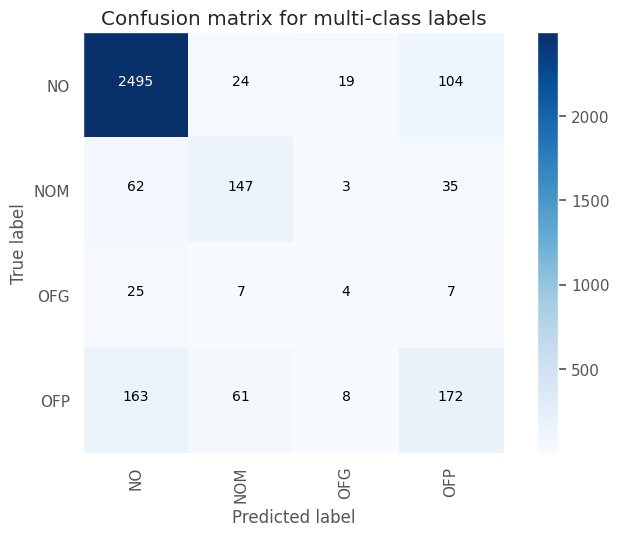

Test Accuracy: 0.8447
Test macro-F1: 0.5279


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5426    0.4273    0.4781       447
     no_hate     0.9142    0.9443    0.9290      2889

    accuracy                         0.8750      3336
   macro avg     0.7284    0.6858    0.7035      3336
weighted avg     0.8644    0.8750    0.8686      3336



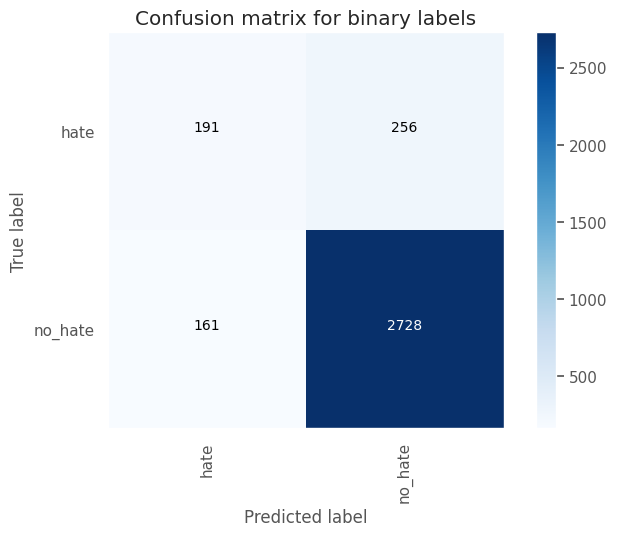

Test Accuracy: 0.875
Test macro-F1: 0.7035




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_103 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_269 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_115 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_115 (MaxPool  (None, 63, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_270 (Dropout)       (None, 63, 32)           

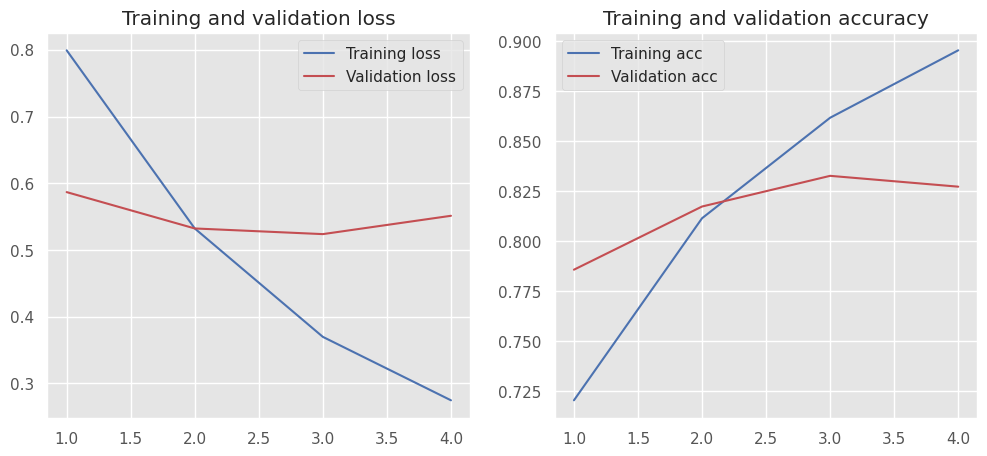

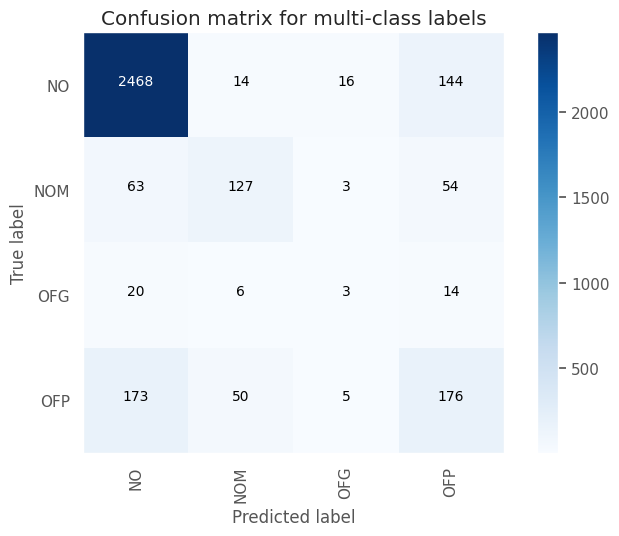

Test Accuracy: 0.8315
Test macro-F1: 0.5055


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4771    0.4430    0.4594       447
     no_hate     0.9148    0.9249    0.9198      2889

    accuracy                         0.8603      3336
   macro avg     0.6959    0.6839    0.6896      3336
weighted avg     0.8561    0.8603    0.8581      3336



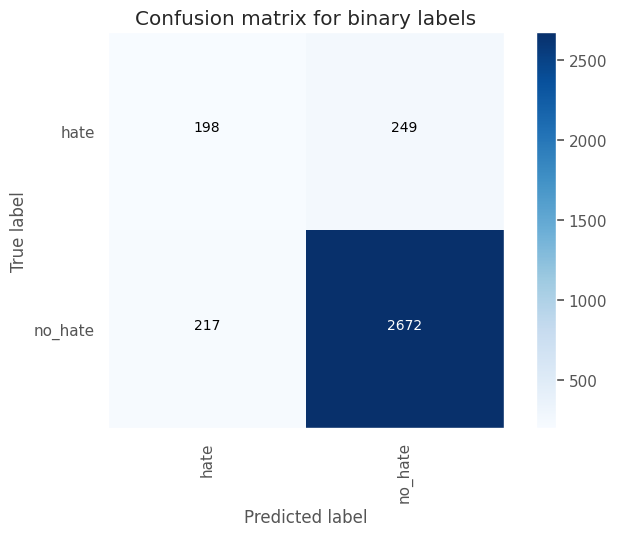

Test Accuracy: 0.8603
Test macro-F1: 0.6896




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_104 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_272 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_116 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_116 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_273 (Dropout)       (None, 42, 32)          

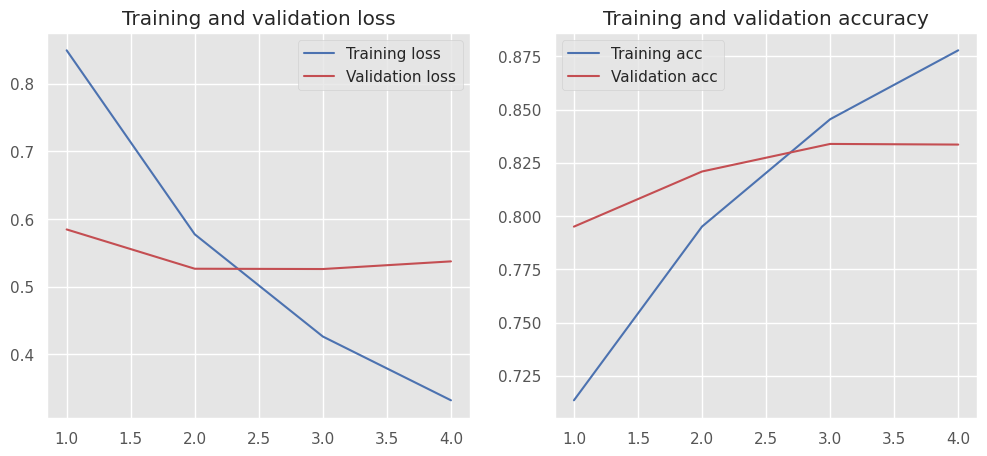

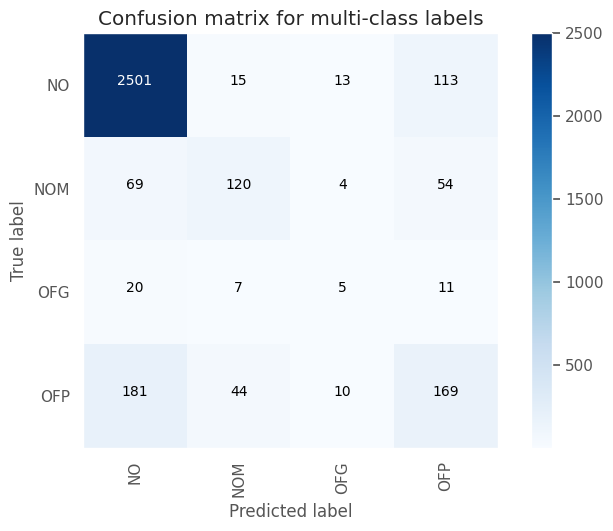

Test Accuracy: 0.8378
Test macro-F1: 0.5154


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5145    0.4362    0.4722       447
     no_hate     0.9148    0.9363    0.9254      2889

    accuracy                         0.8693      3336
   macro avg     0.7146    0.6863    0.6988      3336
weighted avg     0.8611    0.8693    0.8647      3336



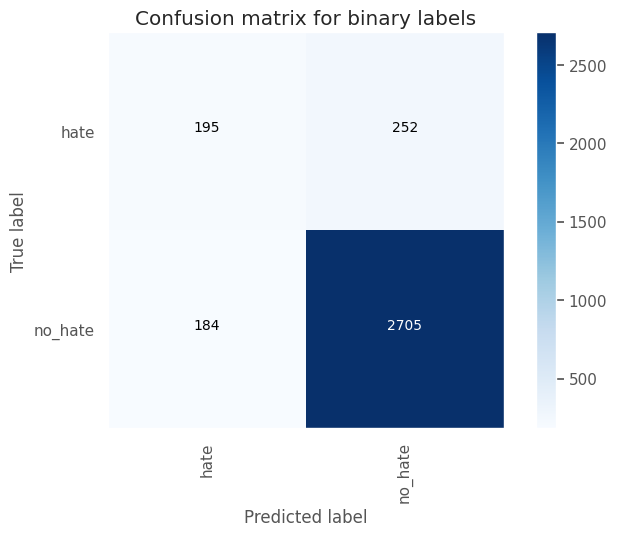

Test Accuracy: 0.8693
Test macro-F1: 0.6988




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_105 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_275 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_117 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_117 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_276 (Dropout)       (None, 42, 32)          

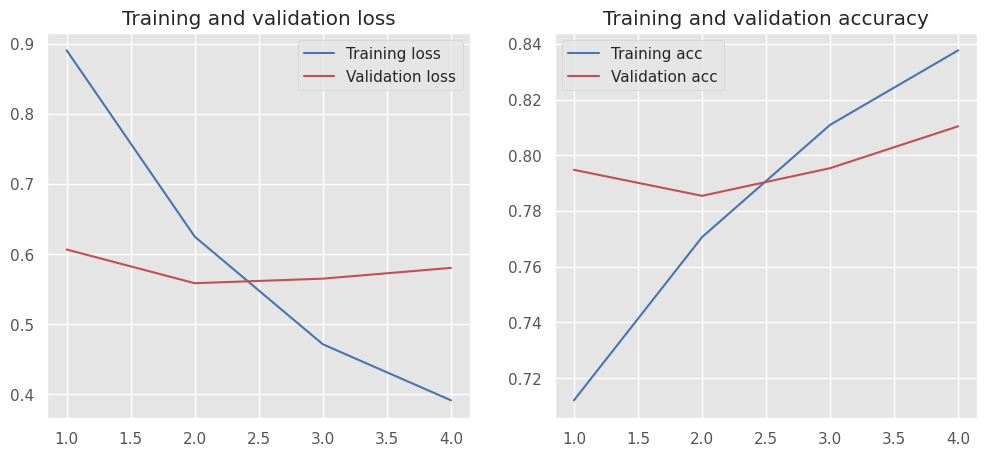

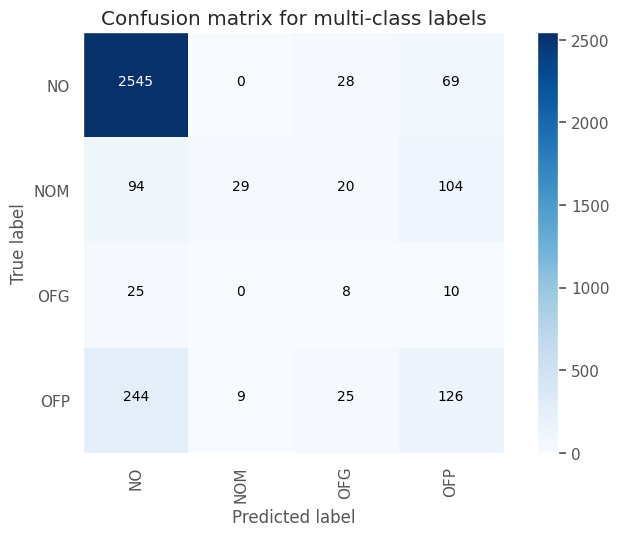

Test Accuracy: 0.8118
Test macro-F1: 0.4008


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4333    0.3781    0.4038       447
     no_hate     0.9056    0.9235    0.9145      2889

    accuracy                         0.8504      3336
   macro avg     0.6695    0.6508    0.6592      3336
weighted avg     0.8423    0.8504    0.8461      3336



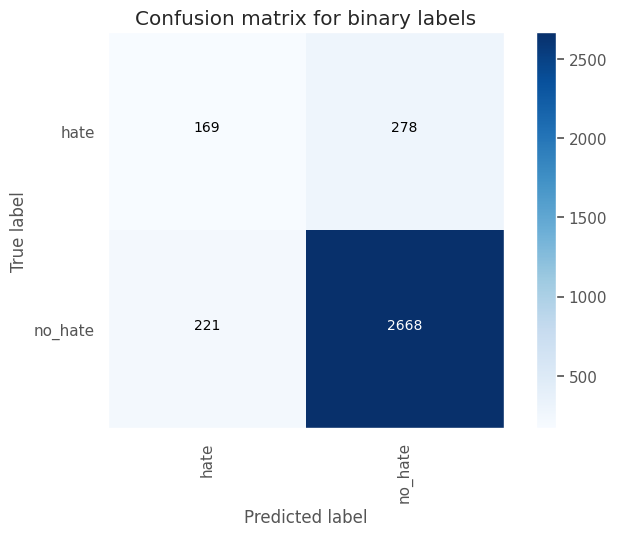

Test Accuracy: 0.8504
Test macro-F1: 0.6592




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_106 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_278 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_118 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_118 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_279 (Dropout)       (None, 42, 32)          

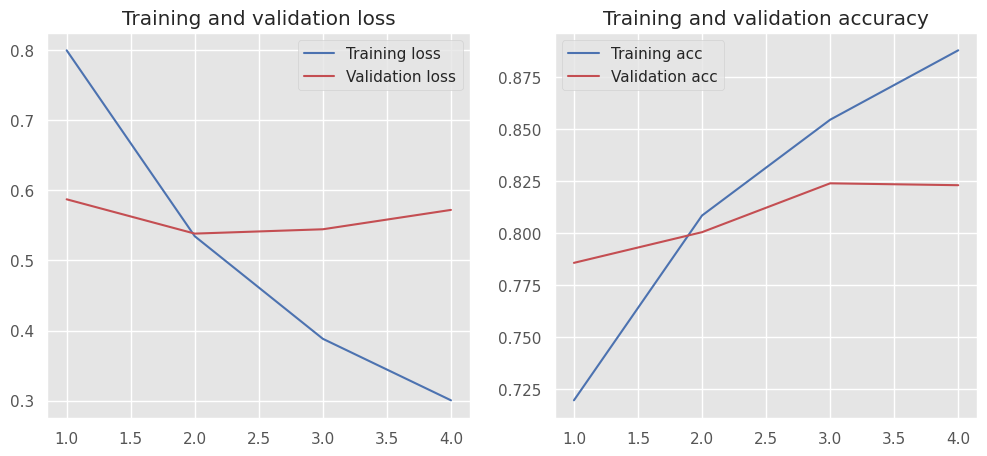

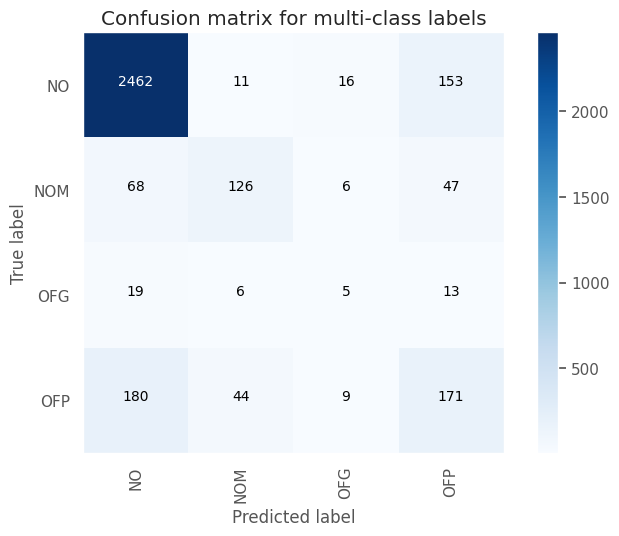

Test Accuracy: 0.8285
Test macro-F1: 0.5145


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4714    0.4430    0.4567       447
     no_hate     0.9146    0.9232    0.9189      2889

    accuracy                         0.8588      3336
   macro avg     0.6930    0.6831    0.6878      3336
weighted avg     0.8552    0.8588    0.8569      3336



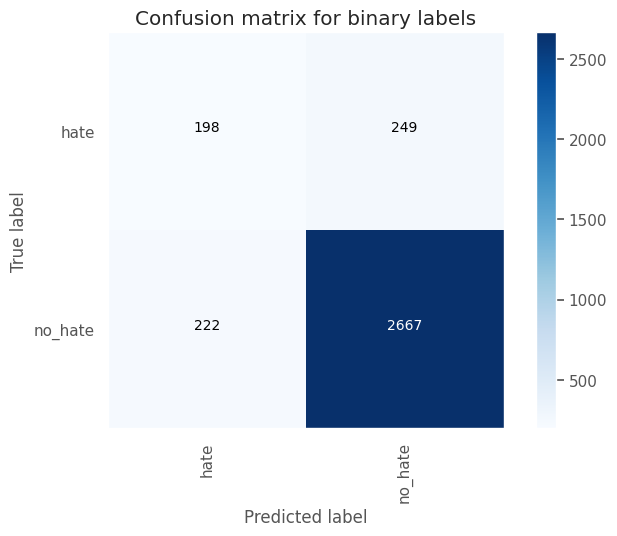

Test Accuracy: 0.8588
Test macro-F1: 0.6878




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_107 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_281 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_119 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_119 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_282 (Dropout)       (None, 42, 32)          

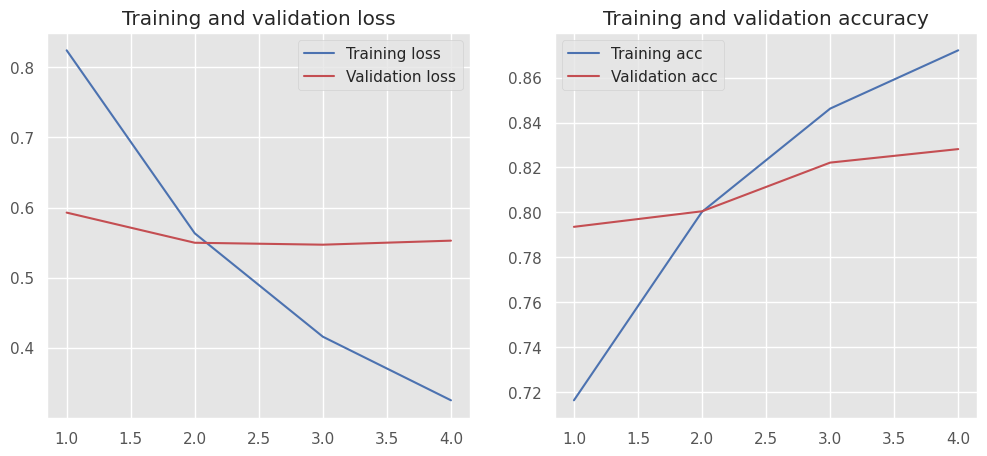

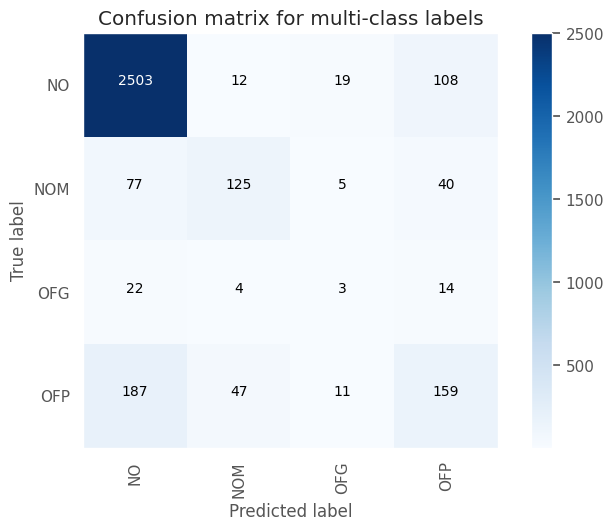

Test Accuracy: 0.8363
Test macro-F1: 0.5023


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5209    0.4183    0.4640       447
     no_hate     0.9127    0.9405    0.9264      2889

    accuracy                         0.8705      3336
   macro avg     0.7168    0.6794    0.6952      3336
weighted avg     0.8602    0.8705    0.8644      3336



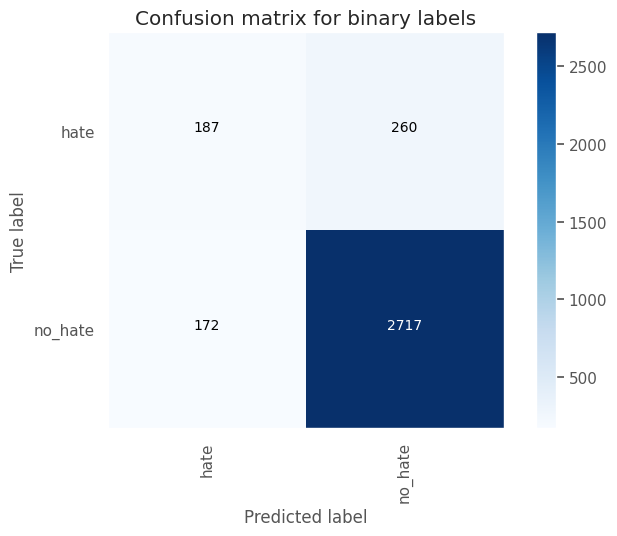

Test Accuracy: 0.8705
Test macro-F1: 0.6952




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_108 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_284 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_120 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_120 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_285 (Dropout)       (None, 42, 32)          

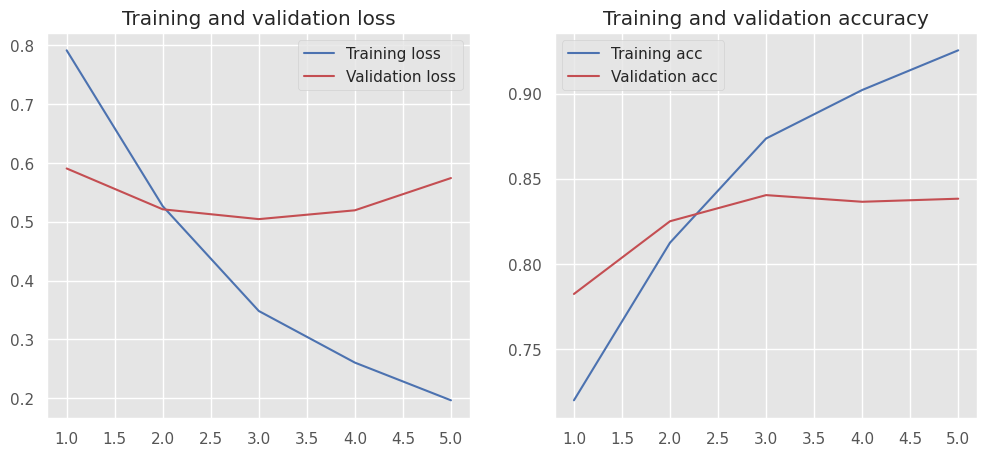

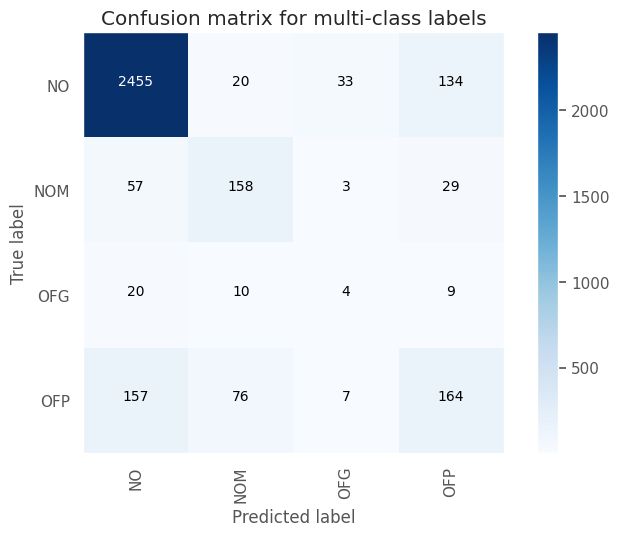

Test Accuracy: 0.8336
Test macro-F1: 0.5179


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4804    0.4116    0.4434       447
     no_hate     0.9109    0.9311    0.9209      2889

    accuracy                         0.8615      3336
   macro avg     0.6957    0.6714    0.6821      3336
weighted avg     0.8533    0.8615    0.8569      3336



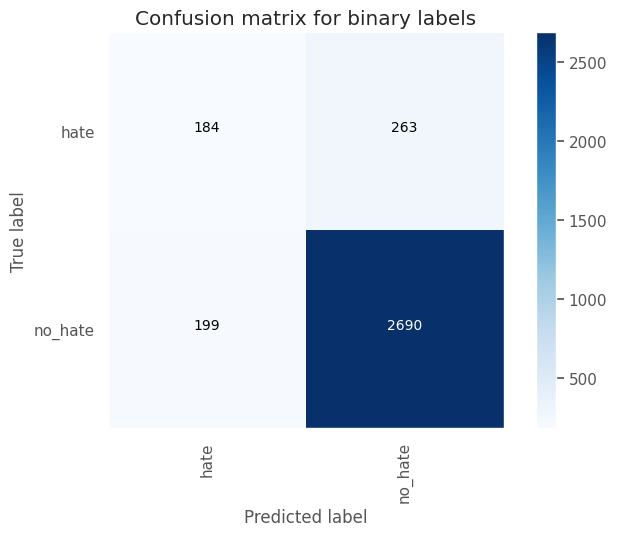

Test Accuracy: 0.8615
Test macro-F1: 0.6821




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_109 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_287 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_121 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_121 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_288 (Dropout)       (None, 42, 32)          

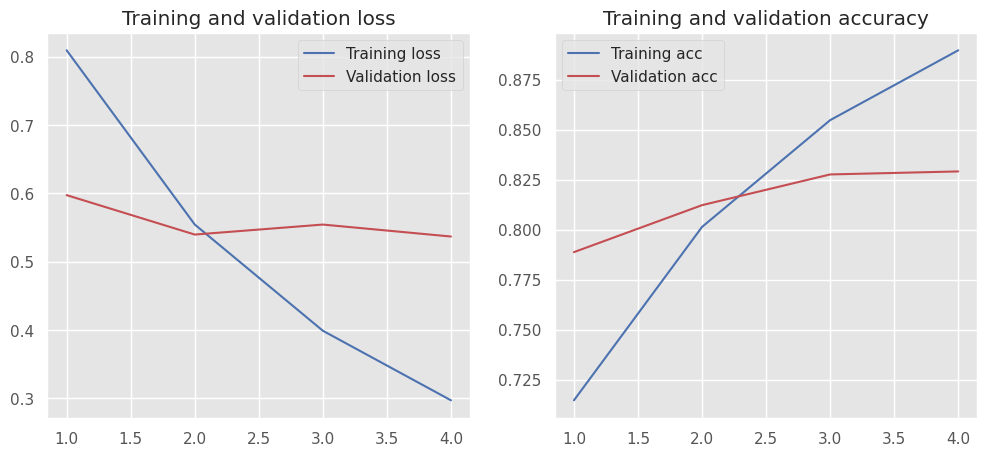

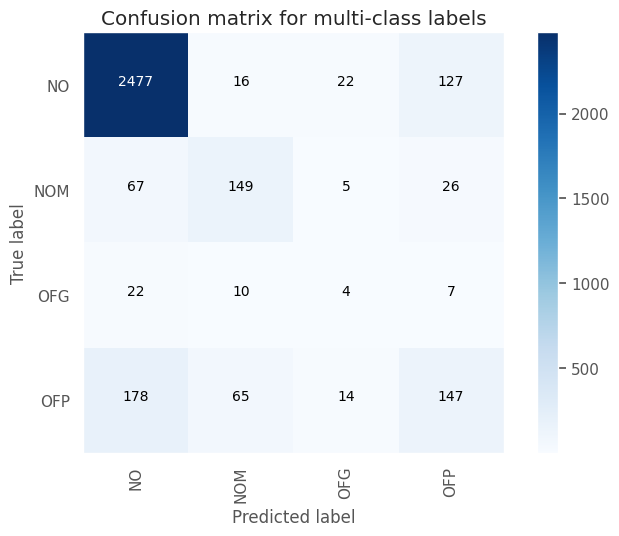

Test Accuracy: 0.8324
Test macro-F1: 0.509


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4886    0.3848    0.4305       447
     no_hate     0.9078    0.9377    0.9225      2889

    accuracy                         0.8636      3336
   macro avg     0.6982    0.6612    0.6765      3336
weighted avg     0.8517    0.8636    0.8566      3336



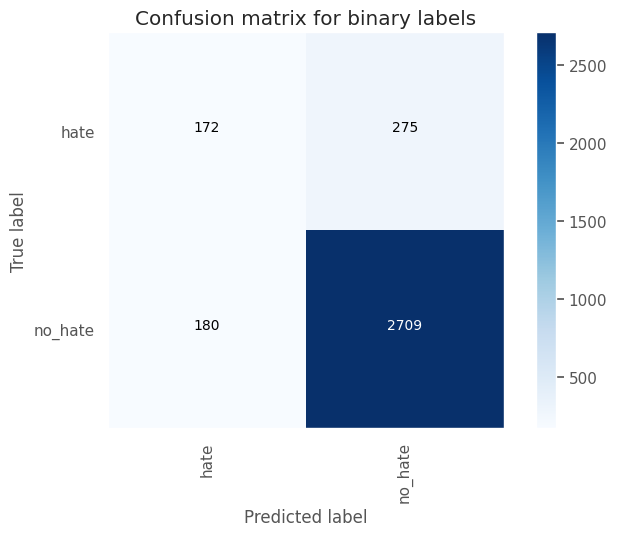

Test Accuracy: 0.8636
Test macro-F1: 0.6765




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_110 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_290 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_122 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_122 (MaxPool  (None, 63, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_291 (Dropout)       (None, 63, 64)          

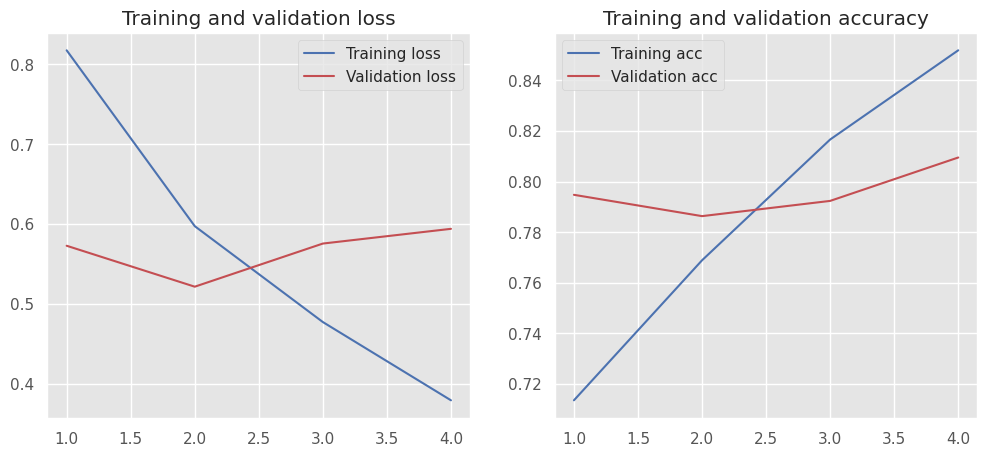

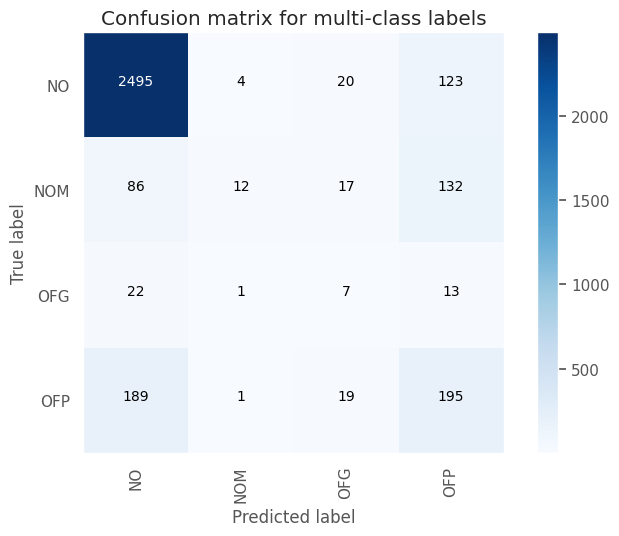

Test Accuracy: 0.8121
Test macro-F1: 0.3977


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4449    0.5235    0.4810       447
     no_hate     0.9242    0.8989    0.9114      2889

    accuracy                         0.8486      3336
   macro avg     0.6845    0.7112    0.6962      3336
weighted avg     0.8600    0.8486    0.8537      3336



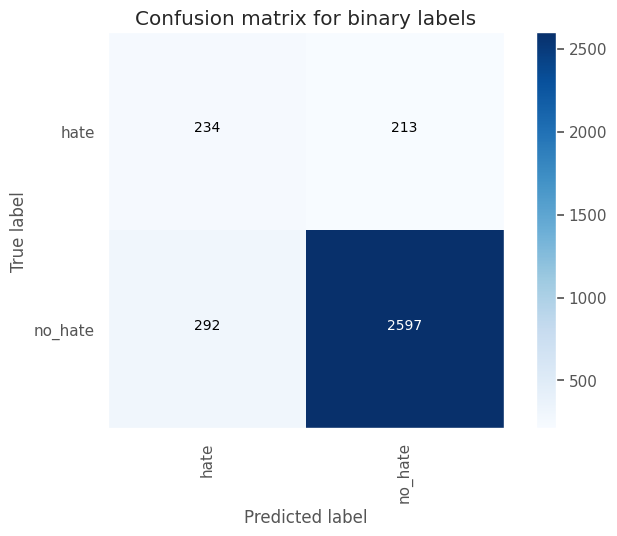

Test Accuracy: 0.8486
Test macro-F1: 0.6962




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_111 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_293 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_123 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_123 (MaxPool  (None, 63, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_294 (Dropout)       (None, 63, 64)          

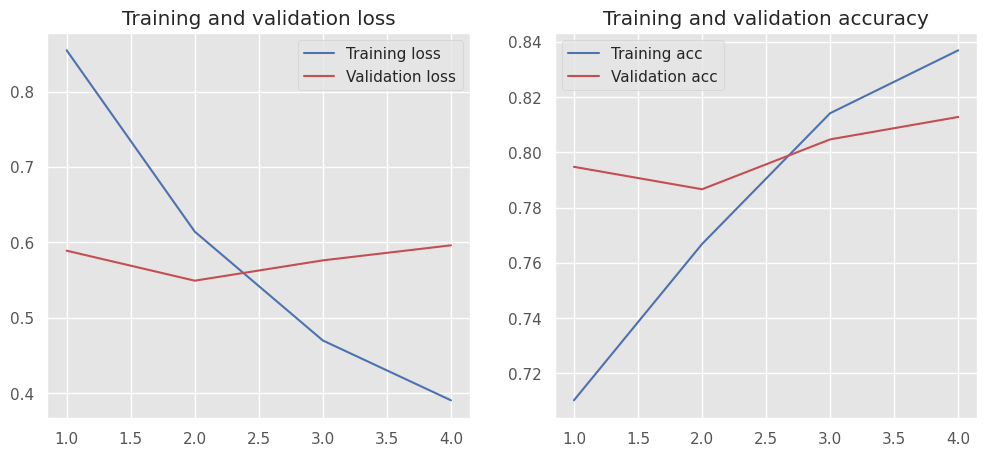

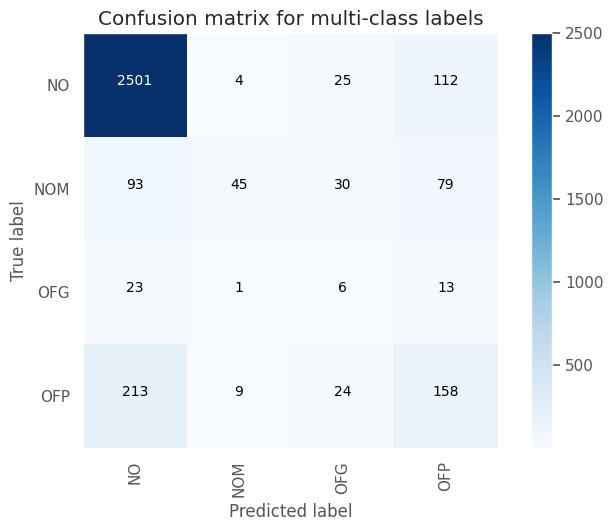

Test Accuracy: 0.8124
Test macro-F1: 0.4286


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4497    0.4497    0.4497       447
     no_hate     0.9148    0.9148    0.9148      2889

    accuracy                         0.8525      3336
   macro avg     0.6823    0.6823    0.6823      3336
weighted avg     0.8525    0.8525    0.8525      3336



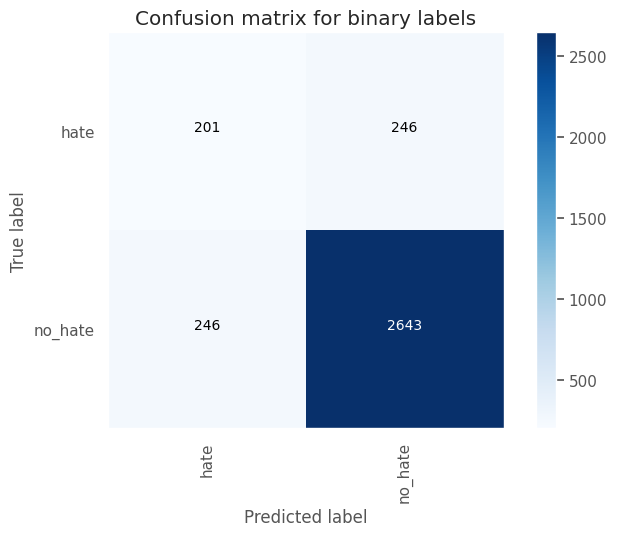

Test Accuracy: 0.8525
Test macro-F1: 0.6823




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_112 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_296 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_124 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_124 (MaxPool  (None, 63, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_297 (Dropout)       (None, 63, 64)          

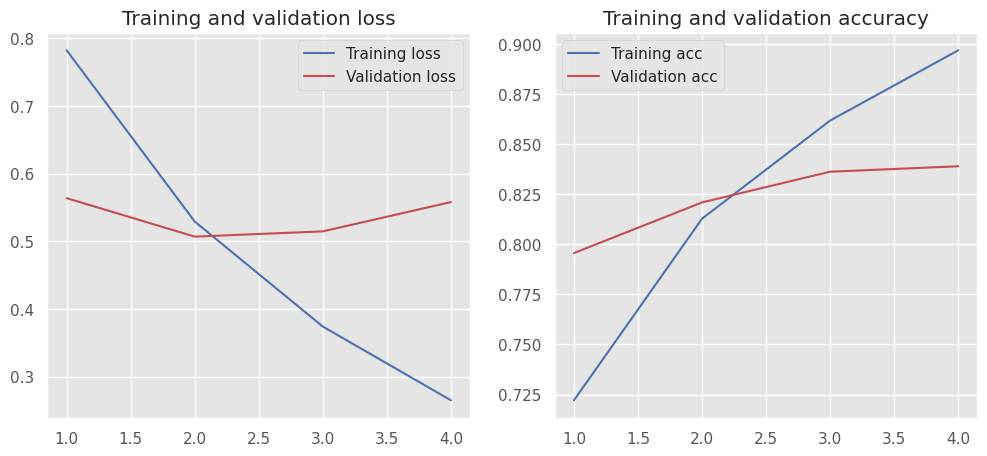

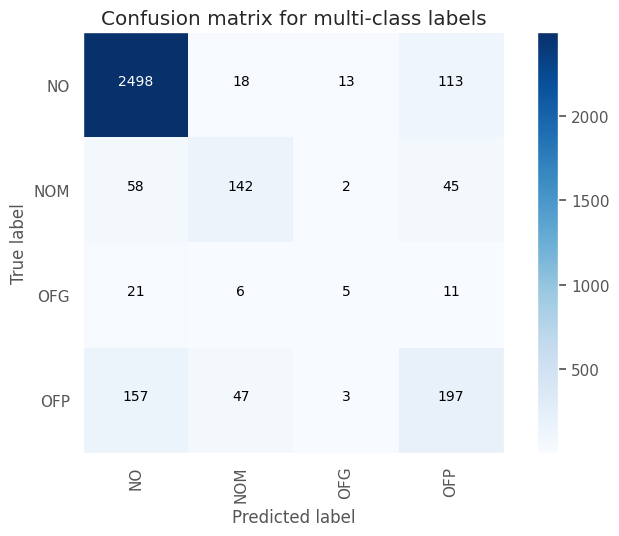

Test Accuracy: 0.8519
Test macro-F1: 0.5525


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5553    0.4832    0.5167       447
     no_hate     0.9216    0.9401    0.9308      2889

    accuracy                         0.8789      3336
   macro avg     0.7384    0.7117    0.7238      3336
weighted avg     0.8725    0.8789    0.8753      3336



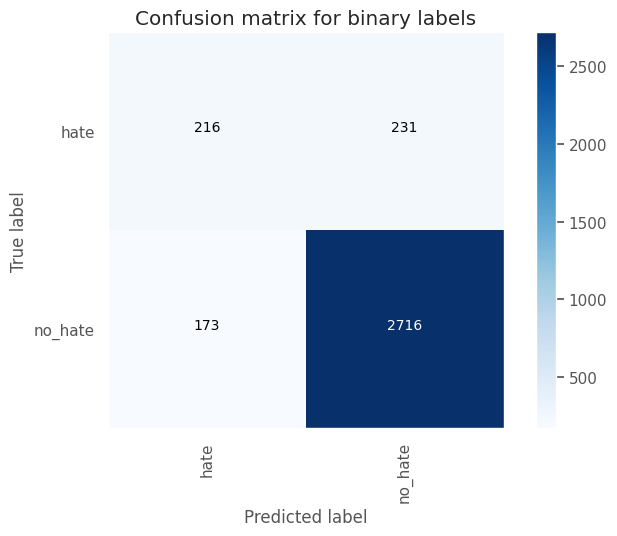

Test Accuracy: 0.8789
Test macro-F1: 0.7238




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_113 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_299 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_125 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_125 (MaxPool  (None, 63, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_300 (Dropout)       (None, 63, 64)          

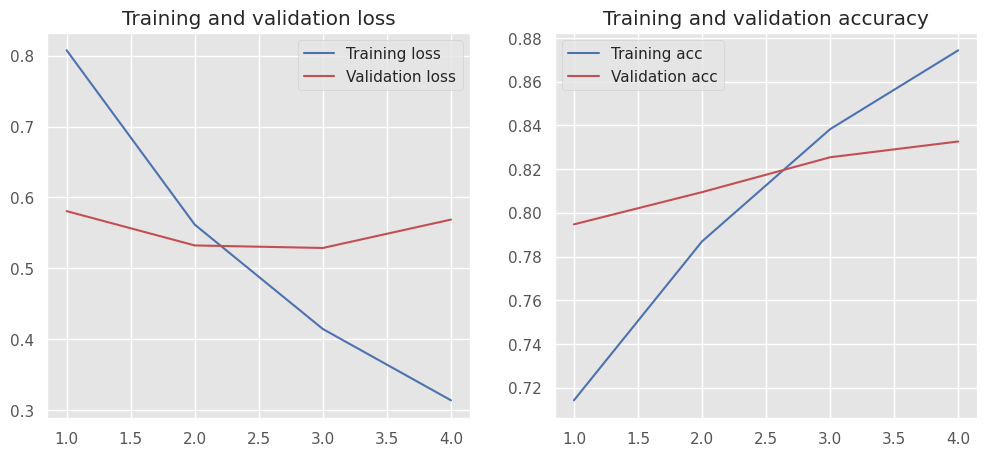

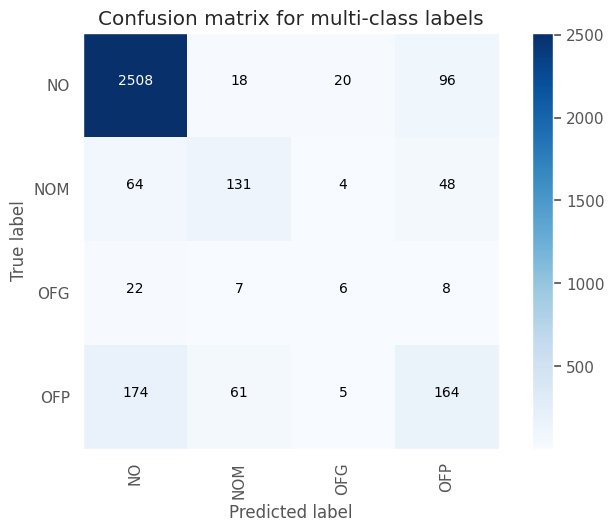

Test Accuracy: 0.842
Test macro-F1: 0.5253


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5214    0.4094    0.4586       447
     no_hate     0.9116    0.9418    0.9265      2889

    accuracy                         0.8705      3336
   macro avg     0.7165    0.6756    0.6926      3336
weighted avg     0.8593    0.8705    0.8638      3336



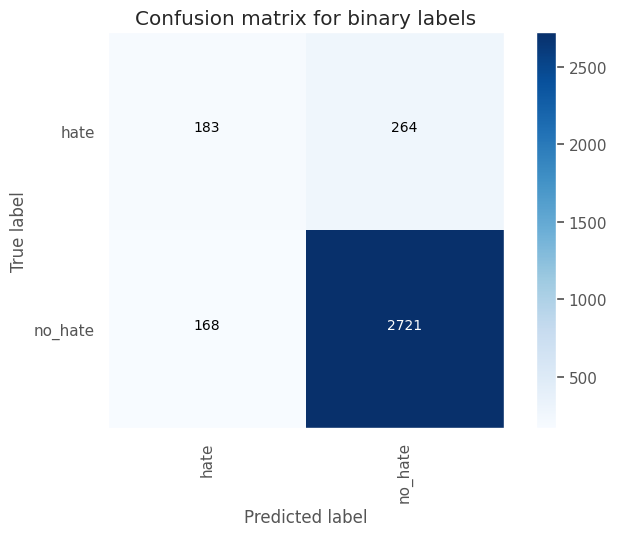

Test Accuracy: 0.8705
Test macro-F1: 0.6926




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_114 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_302 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_126 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_126 (MaxPool  (None, 63, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_303 (Dropout)       (None, 63, 64)          

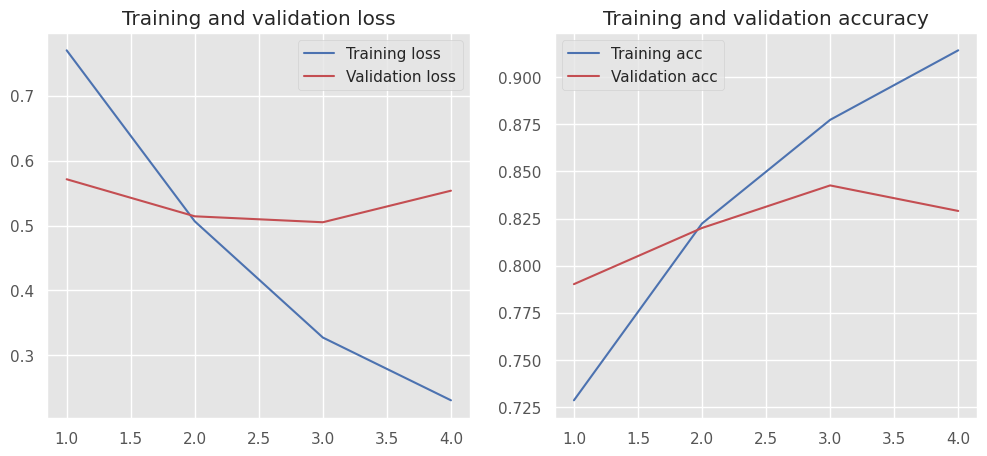

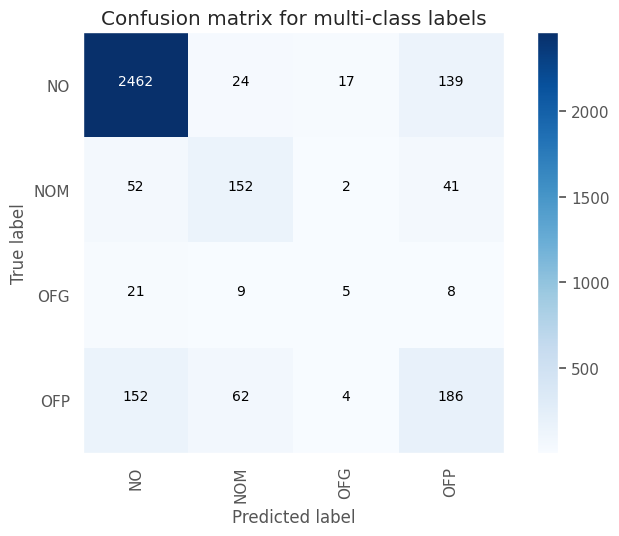

Test Accuracy: 0.8408
Test macro-F1: 0.5396


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5050    0.4541    0.4782       447
     no_hate     0.9168    0.9311    0.9239      2889

    accuracy                         0.8672      3336
   macro avg     0.7109    0.6926    0.7011      3336
weighted avg     0.8617    0.8672    0.8642      3336



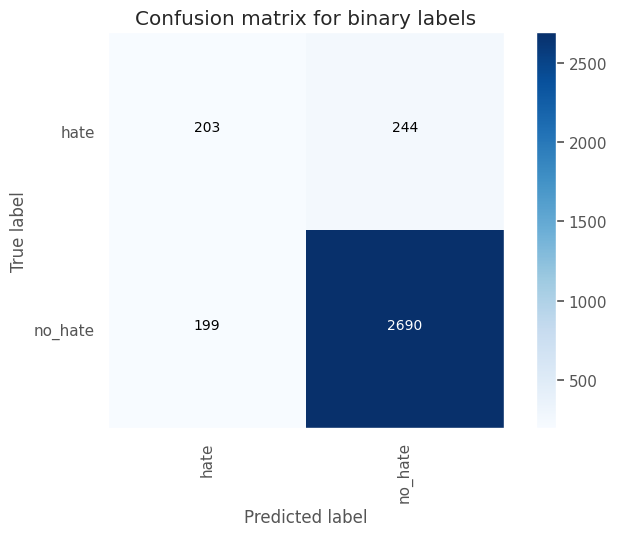

Test Accuracy: 0.8672
Test macro-F1: 0.7011




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_115 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_305 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_127 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_127 (MaxPool  (None, 63, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_306 (Dropout)       (None, 63, 64)          

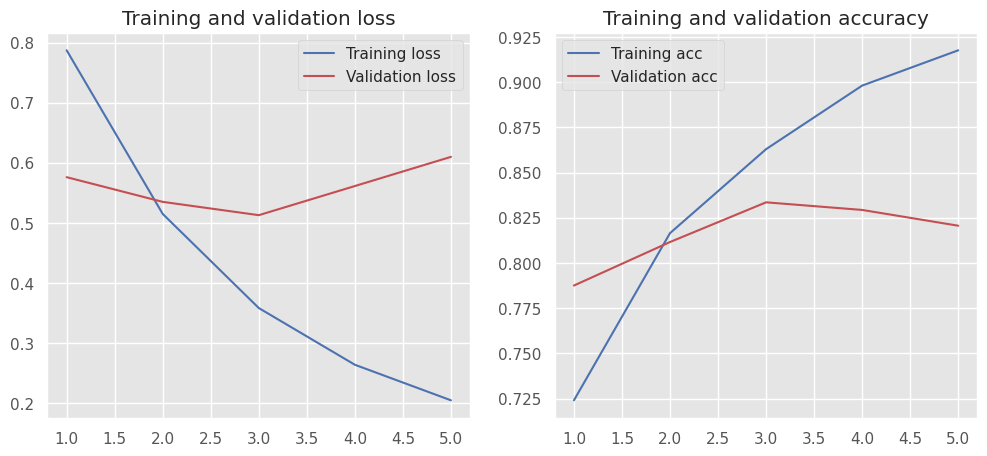

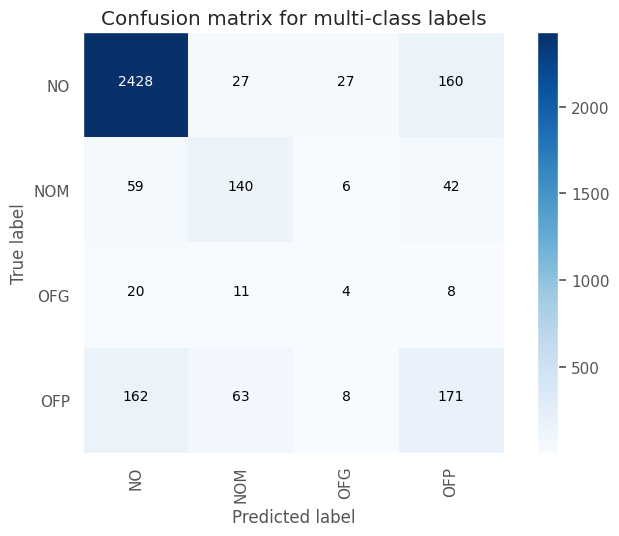

Test Accuracy: 0.8222
Test macro-F1: 0.5037


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4484    0.4273    0.4376       447
     no_hate     0.9120    0.9187    0.9153      2889

    accuracy                         0.8528      3336
   macro avg     0.6802    0.6730    0.6765      3336
weighted avg     0.8499    0.8528    0.8513      3336



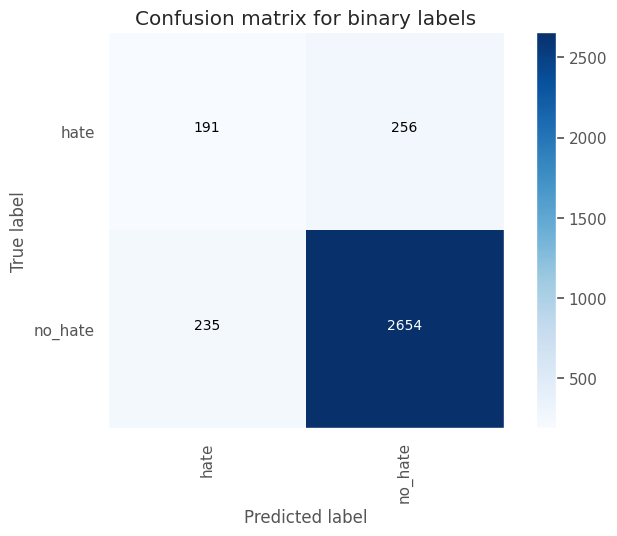

Test Accuracy: 0.8528
Test macro-F1: 0.6765




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_116 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_308 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_128 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_128 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_309 (Dropout)       (None, 42, 64)          

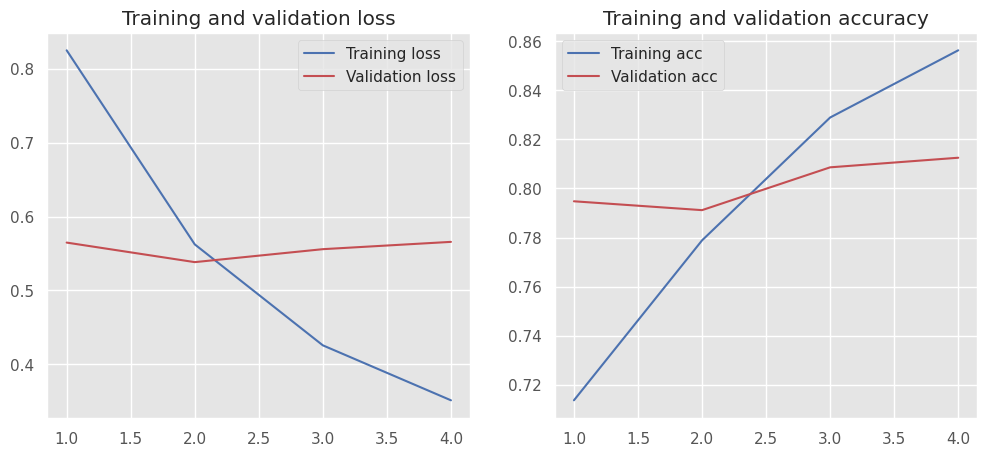

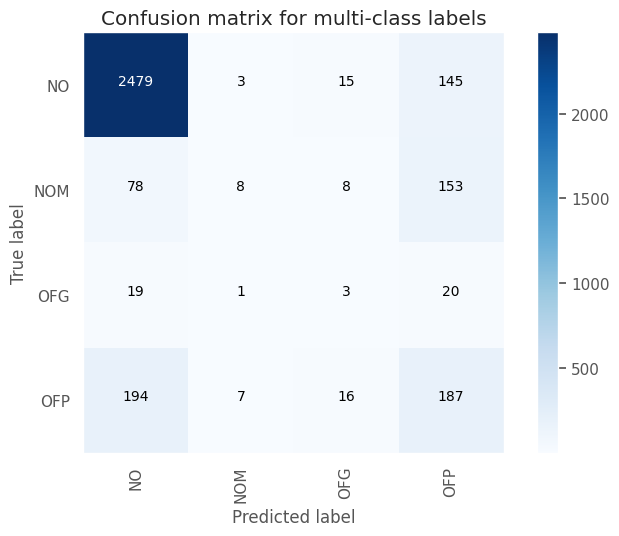

Test Accuracy: 0.8025
Test macro-F1: 0.3646


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4132    0.5056    0.4547       447
     no_hate     0.9208    0.8889    0.9045      2889

    accuracy                         0.8375      3336
   macro avg     0.6670    0.6972    0.6796      3336
weighted avg     0.8527    0.8375    0.8443      3336



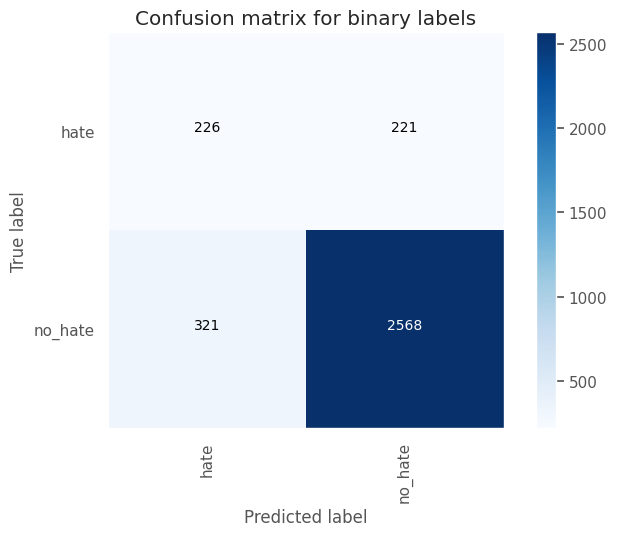

Test Accuracy: 0.8375
Test macro-F1: 0.6796




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_117 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_311 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_129 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_129 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_312 (Dropout)       (None, 42, 64)          

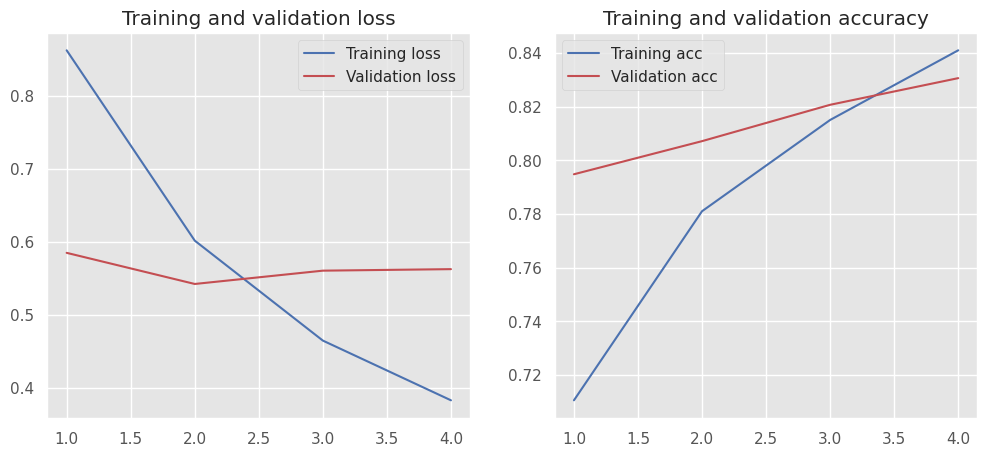

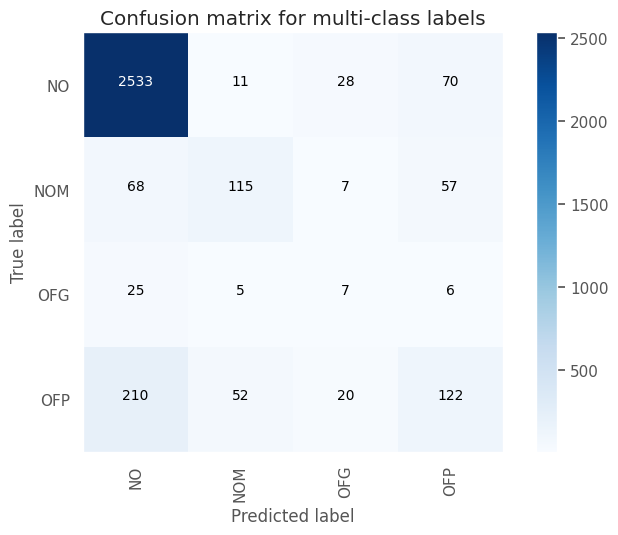

Test Accuracy: 0.8324
Test macro-F1: 0.4908


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4890    0.3468    0.4058       447
     no_hate     0.9033    0.9439    0.9232      2889

    accuracy                         0.8639      3336
   macro avg     0.6961    0.6453    0.6645      3336
weighted avg     0.8478    0.8639    0.8538      3336



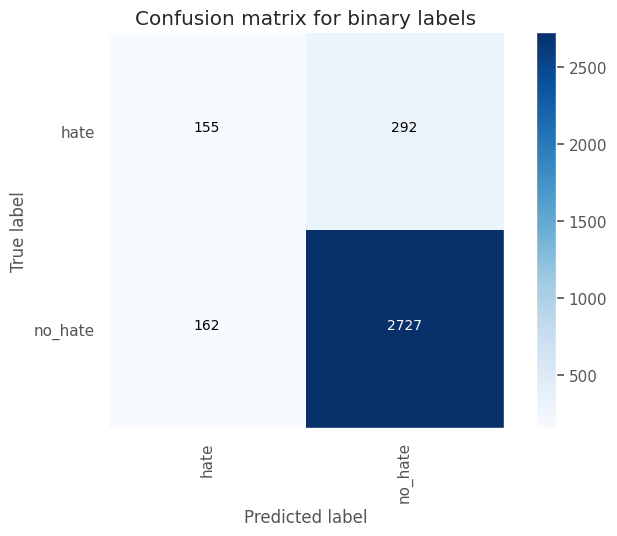

Test Accuracy: 0.8639
Test macro-F1: 0.6645




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_118 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_314 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_130 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_130 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_315 (Dropout)       (None, 42, 64)          

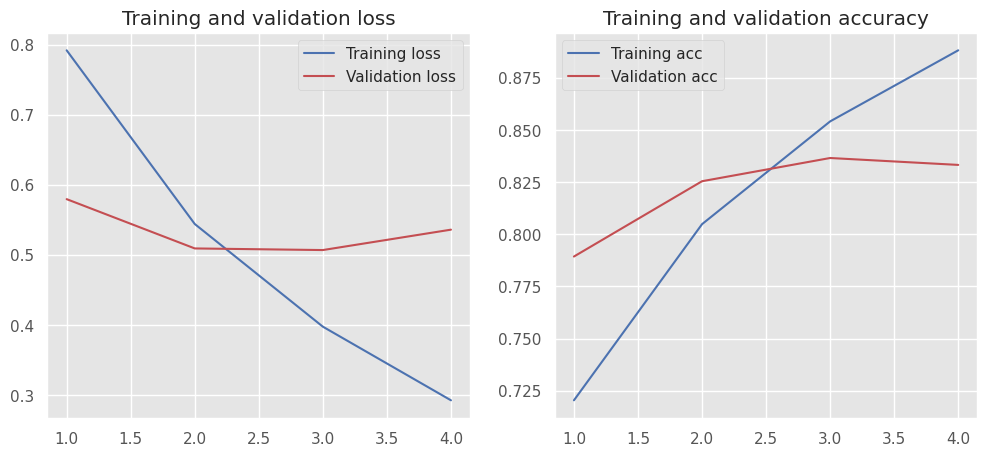

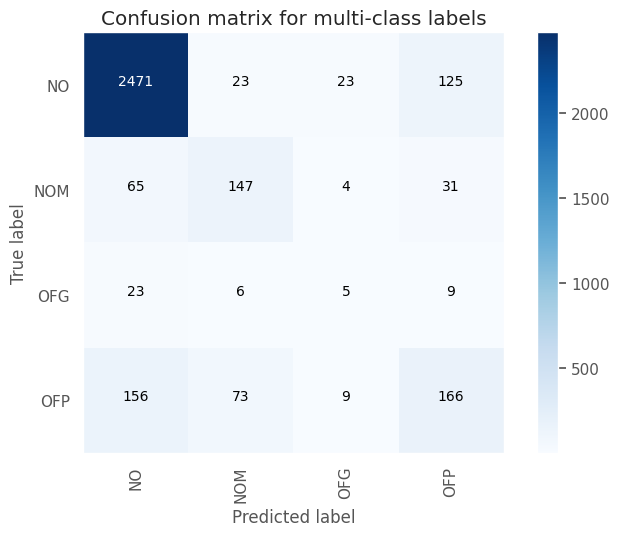

Test Accuracy: 0.836
Test macro-F1: 0.5215


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5081    0.4228    0.4615       447
     no_hate     0.9130    0.9367    0.9247      2889

    accuracy                         0.8678      3336
   macro avg     0.7105    0.6797    0.6931      3336
weighted avg     0.8587    0.8678    0.8626      3336



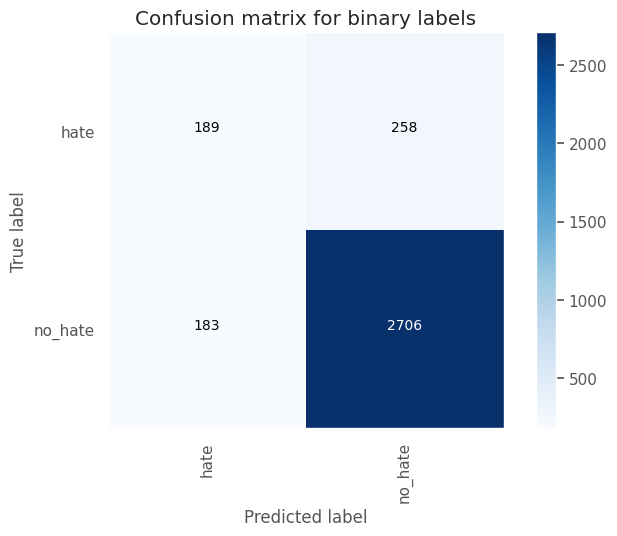

Test Accuracy: 0.8678
Test macro-F1: 0.6931




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_119 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_317 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_131 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_131 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_318 (Dropout)       (None, 42, 64)          

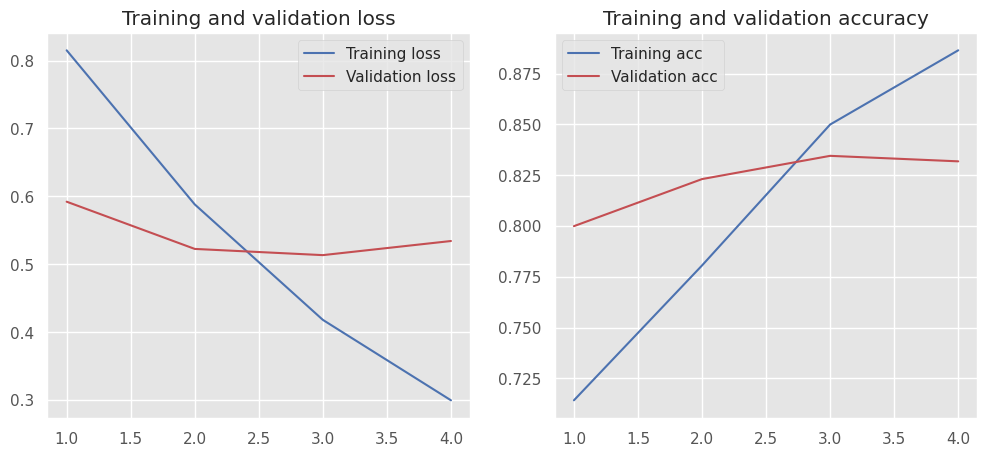

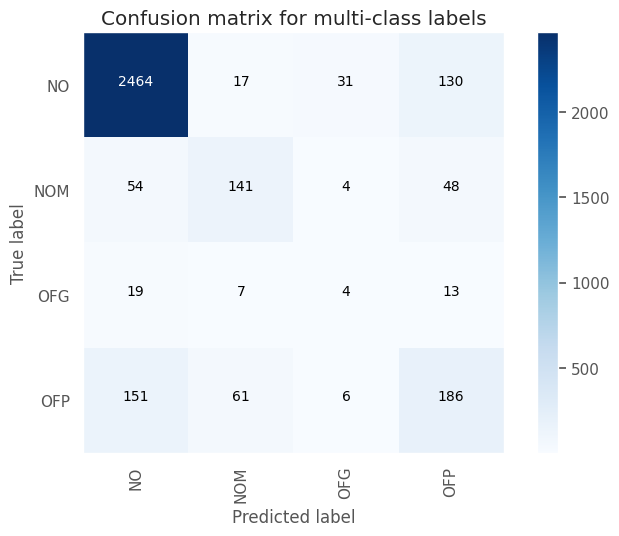

Test Accuracy: 0.8378
Test macro-F1: 0.522


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4953    0.4676    0.4810       447
     no_hate     0.9183    0.9263    0.9223      2889

    accuracy                         0.8648      3336
   macro avg     0.7068    0.6969    0.7016      3336
weighted avg     0.8616    0.8648    0.8632      3336



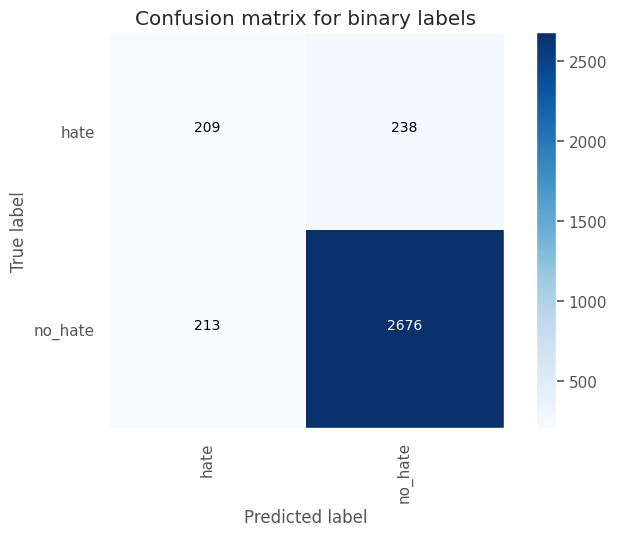

Test Accuracy: 0.8648
Test macro-F1: 0.7016




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_120 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_320 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_132 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_132 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_321 (Dropout)       (None, 42, 64)          

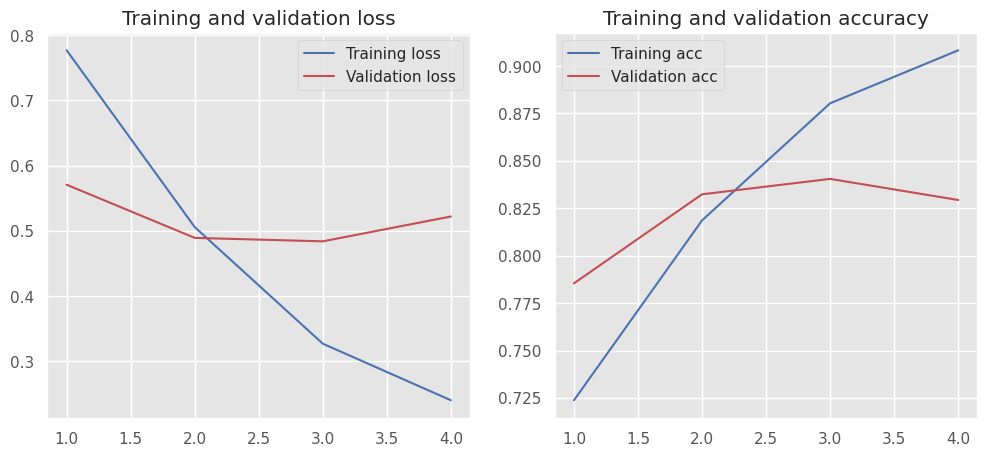

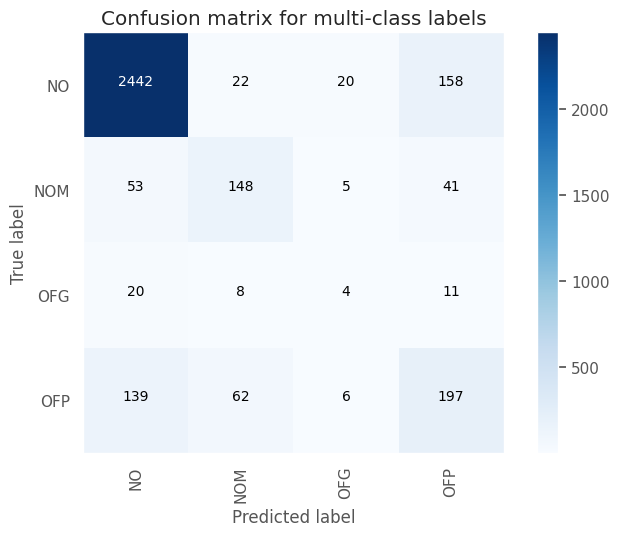

Test Accuracy: 0.8366
Test macro-F1: 0.5296


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4932    0.4877    0.4904       447
     no_hate     0.9209    0.9225    0.9217      2889

    accuracy                         0.8642      3336
   macro avg     0.7070    0.7051    0.7061      3336
weighted avg     0.8636    0.8642    0.8639      3336



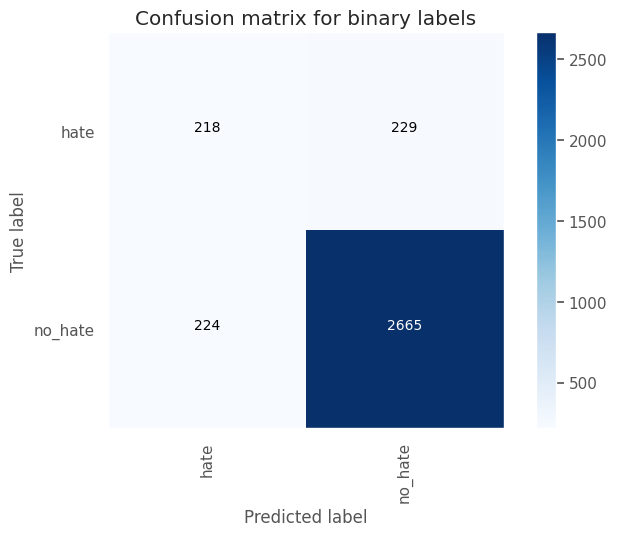

Test Accuracy: 0.8642
Test macro-F1: 0.7061




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_121 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_323 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_133 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_133 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_324 (Dropout)       (None, 42, 64)          

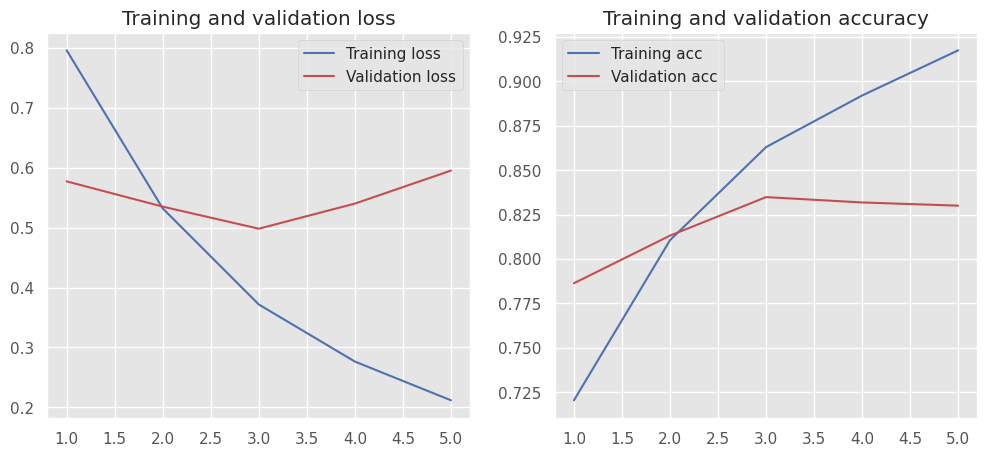

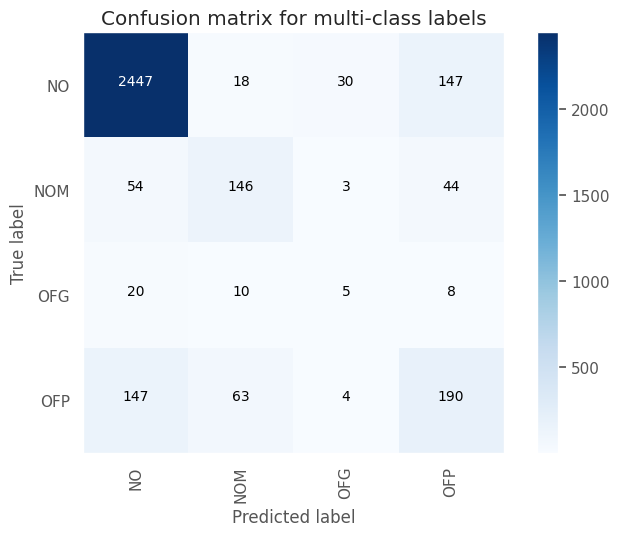

Test Accuracy: 0.8357
Test macro-F1: 0.5305


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4803    0.4631    0.4715       447
     no_hate     0.9174    0.9225    0.9199      2889

    accuracy                         0.8609      3336
   macro avg     0.6988    0.6928    0.6957      3336
weighted avg     0.8588    0.8609    0.8598      3336



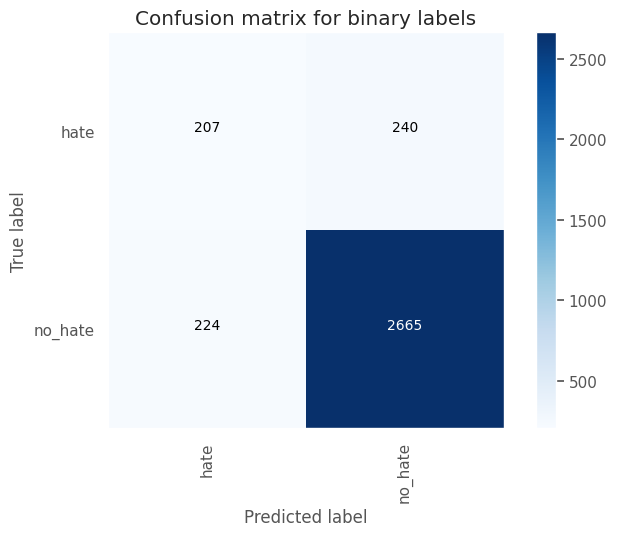

Test Accuracy: 0.8609
Test macro-F1: 0.6957







<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>26</th>
      <td>v6</td>
      <td>{'embedding_112': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_296': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_124': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_124': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 63, 64)}, 'dropout_297': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 64), 'output': (None, 63, 64)}, 'flatten_107': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 64), 'output': (None, 4032)}, 'dense_224': {'class_name': 'Dense', 'param_count': 129056, 'input': (None, 4032), 'output': (None, 32)}, 'dropout_298': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_225': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1148552</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5840</td>
      <td>0.5311</td>
      <td>0.5525</td>
      <td>0.7384</td>
      <td>0.7117</td>
      <td>0.7238</td>
    </tr>
    <tr>
      <th>28</th>
      <td>v6</td>
      <td>{'embedding_114': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_302': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_126': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_126': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 63, 64)}, 'dropout_303': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 64), 'output': (None, 63, 64)}, 'flatten_109': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 64), 'output': (None, 4032)}, 'dense_228': {'class_name': 'Dense', 'param_count': 258112, 'input': (None, 4032), 'output': (None, 64)}, 'dropout_304': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_229': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1277736</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5519</td>
      <td>0.5310</td>
      <td>0.5396</td>
      <td>0.7109</td>
      <td>0.6926</td>
      <td>0.7011</td>
    </tr>
    <tr>
      <th>35</th>
      <td>v6</td>
      <td>{'embedding_121': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_323': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_133': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_133': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_324': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_116': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_242': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_325': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_243': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1191720</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5352</td>
      <td>0.5260</td>
      <td>0.5305</td>
      <td>0.6988</td>
      <td>0.6928</td>
      <td>0.6957</td>
    </tr>
    <tr>
      <th>34</th>
      <td>v6</td>
      <td>{'embedding_120': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_320': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_132': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_132': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_321': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_115': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_240': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_322': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_241': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1191720</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5338</td>
      <td>0.5260</td>
      <td>0.5296</td>
      <td>0.7070</td>
      <td>0.7051</td>
      <td>0.7061</td>
    </tr>
    <tr>
      <th>16</th>
      <td>v6</td>
      <td>{'embedding_102': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_266': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_114': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_114': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 63, 32)}, 'dropout_267': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 32), 'output': (None, 63, 32)}, 'flatten_97': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 32), 'output': (None, 2016)}, 'dense_204': {'class_name': 'Dense', 'param_count': 129088, 'input': (None, 2016), 'output': (None, 64)}, 'dropout_268': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_205': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1139080</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5456</td>
      <td>0.5146</td>
      <td>0.5279</td>
      <td>0.7284</td>
      <td>0.6858</td>
      <td>0.7035</td>
    </tr>
    <tr>
      <th>5</th>
      <td>v6</td>
      <td>{'embedding_91': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_233': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_103': {'class_name': 'Conv1D', 'param_count': 4816, 'input': (None, 128, 100), 'output': (None, 126, 16)}, 'max_pooling1d_103': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 16), 'output': (None, 63, 16)}, 'dropout_234': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 16), 'output': (None, 63, 16)}, 'flatten_86': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 16), 'output': (None, 1008)}, 'dense_182': {'class_name': 'Dense', 'param_count': 64576, 'input': (None, 1008), 'output': (None, 64)}, 'dropout_235': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_183': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1069752</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5481</td>
      <td>0.5116</td>
      <td>0.5262</td>
      <td>0.7224</td>
      <td>0.6713</td>
      <td>0.6915</td>
    </tr>
    <tr>
      <th>10</th>
      <td>v6</td>
      <td>{'embedding_96': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_248': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_108': {'class_name': 'Conv1D', 'param_count': 4816, 'input': (None, 128, 100), 'output': (None, 126, 16)}, 'max_pooling1d_108': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 16), 'output': (None, 42, 16)}, 'dropout_249': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 16), 'output': (None, 42, 16)}, 'flatten_91': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 16), 'output': (None, 672)}, 'dense_192': {'class_name': 'Dense', 'param_count': 43072, 'input': (None, 672), 'output': (None, 64)}, 'dropout_250': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_193': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1048248</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5477</td>
      <td>0.5117</td>
      <td>0.5261</td>
      <td>0.7059</td>
      <td>0.6985</td>
      <td>0.7021</td>
    </tr>
    <tr>
      <th>27</th>
      <td>v6</td>
      <td>{'embedding_113': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_299': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_125': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_125': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 63, 64)}, 'dropout_300': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 64), 'output': (None, 63, 64)}, 'flatten_108': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 64), 'output': (None, 4032)}, 'dense_226': {'class_name': 'Dense', 'param_count': 129056, 'input': (None, 4032), 'output': (None, 32)}, 'dropout_301': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_227': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1148552</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5500</td>
      <td>0.5063</td>
      <td>0.5253</td>
      <td>0.7165</td>
      <td>0.6756</td>
      <td>0.6926</td>
    </tr>
    <tr>
      <th>33</th>
      <td>v6</td>
      <td>{'embedding_119': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_317': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_131': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_131': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_318': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_114': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_238': {'class_name': 'Dense', 'param_count': 86048, 'input': (None, 2688), 'output': (None, 32)}, 'dropout_319': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_239': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1105544</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5307</td>
      <td>0.5142</td>
      <td>0.5220</td>
      <td>0.7068</td>
      <td>0.6969</td>
      <td>0.7016</td>
    </tr>
    <tr>
      <th>32</th>
      <td>v6</td>
      <td>{'embedding_118': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_314': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_130': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_130': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_315': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_113': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_236': {'class_name': 'Dense', 'param_count': 86048, 'input': (None, 2688), 'output': (None, 32)}, 'dropout_316': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_237': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1105544</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5310</td>
      <td>0.5144</td>
      <td>0.5215</td>
      <td>0.7105</td>
      <td>0.6797</td>
      <td>0.6931</td>
    </tr>
    <tr>
      <th>8</th>
      <td>v6</td>
      <td>{'embedding_94': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_242': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_106': {'class_name': 'Conv1D', 'param_count': 4816, 'input': (None, 128, 100), 'output': (None, 126, 16)}, 'max_pooling1d_106': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 16), 'output': (None, 42, 16)}, 'dropout_243': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 16), 'output': (None, 42, 16)}, 'flatten_89': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 16), 'output': (None, 672)}, 'dense_188': {'class_name': 'Dense', 'param_count': 21536, 'input': (None, 672), 'output': (None, 32)}, 'dropout_244': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_189': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1026584</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5541</td>
      <td>0.4946</td>
      <td>0.5194</td>
      <td>0.7292</td>
      <td>0.6774</td>
      <td>0.6980</td>
    </tr>
    <tr>
      <th>22</th>
      <td>v6</td>
      <td>{'embedding_108': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_284': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_120': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_120': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_285': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_103': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_216': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_286': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_217': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1096072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5212</td>
      <td>0.5170</td>
      <td>0.5179</td>
      <td>0.6957</td>
      <td>0.6714</td>
      <td>0.6821</td>
    </tr>
    <tr>
      <th>18</th>
      <td>v6</td>
      <td>{'embedding_104': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_272': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_116': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_116': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_273': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_99': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_208': {'class_name': 'Dense', 'param_count': 21520, 'input': (None, 1344), 'output': (None, 16)}, 'dropout_274': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_209': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1031320</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5478</td>
      <td>0.4918</td>
      <td>0.5154</td>
      <td>0.7146</td>
      <td>0.6863</td>
      <td>0.6988</td>
    </tr>
    <tr>
      <th>20</th>
      <td>v6</td>
      <td>{'embedding_106': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_278': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_118': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_118': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_279': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_101': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_212': {'class_name': 'Dense', 'param_count': 43040, 'input': (None, 1344), 'output': (None, 32)}, 'dropout_280': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_213': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1052904</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5400</td>
      <td>0.4954</td>
      <td>0.5145</td>
      <td>0.6930</td>
      <td>0.6831</td>
      <td>0.6878</td>
    </tr>
    <tr>
      <th>2</th>
      <td>v6</td>
      <td>{'embedding_88': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_224': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_100': {'class_name': 'Conv1D', 'param_count': 4816, 'input': (None, 128, 100), 'output': (None, 126, 16)}, 'max_pooling1d_100': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 16), 'output': (None, 63, 16)}, 'dropout_225': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 16), 'output': (None, 63, 16)}, 'flatten_83': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 16), 'output': (None, 1008)}, 'dense_176': {'class_name': 'Dense', 'param_count': 32288, 'input': (None, 1008), 'output': (None, 32)}, 'dropout_226': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_177': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1037336</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5436</td>
      <td>0.4901</td>
      <td>0.5128</td>
      <td>0.7268</td>
      <td>0.6835</td>
      <td>0.7015</td>
    </tr>
    <tr>
      <th>4</th>
      <td>v6</td>
      <td>{'embedding_90': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_230': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_102': {'class_name': 'Conv1D', 'param_count': 4816, 'input': (None, 128, 100), 'output': (None, 126, 16)}, 'max_pooling1d_102': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 16), 'output': (None, 63, 16)}, 'dropout_231': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 16), 'output': (None, 63, 16)}, 'flatten_85': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 16), 'output': (None, 1008)}, 'dense_180': {'class_name': 'Dense', 'param_count': 64576, 'input': (None, 1008), 'output': (None, 64)}, 'dropout_232': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_181': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1069752</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5381</td>
      <td>0.4966</td>
      <td>0.5121</td>
      <td>0.7007</td>
      <td>0.7119</td>
      <td>0.7060</td>
    </tr>
    <tr>
      <th>11</th>
      <td>v6</td>
      <td>{'embedding_97': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_251': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_109': {'class_name': 'Conv1D', 'param_count': 4816, 'input': (None, 128, 100), 'output': (None, 126, 16)}, 'max_pooling1d_109': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 16), 'output': (None, 42, 16)}, 'dropout_252': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 16), 'output': (None, 42, 16)}, 'flatten_92': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 16), 'output': (None, 672)}, 'dense_194': {'class_name': 'Dense', 'param_count': 43072, 'input': (None, 672), 'output': (None, 64)}, 'dropout_253': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_195': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1048248</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5288</td>
      <td>0.4953</td>
      <td>0.5103</td>
      <td>0.7101</td>
      <td>0.6915</td>
      <td>0.7001</td>
    </tr>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_86': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_218': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_98': {'class_name': 'Conv1D', 'param_count': 4816, 'input': (None, 128, 100), 'output': (None, 126, 16)}, 'max_pooling1d_98': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 16), 'output': (None, 63, 16)}, 'dropout_219': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 16), 'output': (None, 63, 16)}, 'flatten_81': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 16), 'output': (None, 1008)}, 'dense_172': {'class_name': 'Dense', 'param_count': 16144, 'input': (None, 1008), 'output': (None, 16)}, 'dropout_220': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_173': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1021128</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5200</td>
      <td>0.5018</td>
      <td>0.5095</td>
      <td>0.6976</td>
      <td>0.6683</td>
      <td>0.6809</td>
    </tr>
    <tr>
      <th>23</th>
      <td>v6</td>
      <td>{'embedding_109': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_287': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_121': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_121': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_288': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_104': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_218': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_289': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_219': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1096072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5228</td>
      <td>0.4994</td>
      <td>0.5090</td>
      <td>0.6982</td>
      <td>0.6612</td>
      <td>0.6765</td>
    </tr>
    <tr>
      <th>17</th>
      <td>v6</td>
      <td>{'embedding_103': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_269': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_115': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_115': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 63, 32)}, 'dropout_270': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 32), 'output': (None, 63, 32)}, 'flatten_98': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 32), 'output': (None, 2016)}, 'dense_206': {'class_name': 'Dense', 'param_count': 129088, 'input': (None, 2016), 'output': (None, 64)}, 'dropout_271': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_207': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1139080</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5289</td>
      <td>0.4884</td>
      <td>0.5055</td>
      <td>0.6959</td>
      <td>0.6839</td>
      <td>0.6896</td>
    </tr>
    <tr>
      <th>9</th>
      <td>v6</td>
      <td>{'embedding_95': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_245': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_107': {'class_name': 'Conv1D', 'param_count': 4816, 'input': (None, 128, 100), 'output': (None, 126, 16)}, 'max_pooling1d_107': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 16), 'output': (None, 42, 16)}, 'dropout_246': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 16), 'output': (None, 42, 16)}, 'flatten_90': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 16), 'output': (None, 672)}, 'dense_190': {'class_name': 'Dense', 'param_count': 21536, 'input': (None, 672), 'output': (None, 32)}, 'dropout_247': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_191': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1026584</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5402</td>
      <td>0.4808</td>
      <td>0.5054</td>
      <td>0.7183</td>
      <td>0.6695</td>
      <td>0.6889</td>
    </tr>
    <tr>
      <th>29</th>
      <td>v6</td>
      <td>{'embedding_115': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_305': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_127': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_127': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 63, 64)}, 'dropout_306': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 64), 'output': (None, 63, 64)}, 'flatten_110': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 64), 'output': (None, 4032)}, 'dense_230': {'class_name': 'Dense', 'param_count': 258112, 'input': (None, 4032), 'output': (None, 64)}, 'dropout_307': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_231': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1277736</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5071</td>
      <td>0.5005</td>
      <td>0.5037</td>
      <td>0.6802</td>
      <td>0.6730</td>
      <td>0.6765</td>
    </tr>
    <tr>
      <th>3</th>
      <td>v6</td>
      <td>{'embedding_89': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_227': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_101': {'class_name': 'Conv1D', 'param_count': 4816, 'input': (None, 128, 100), 'output': (None, 126, 16)}, 'max_pooling1d_101': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 16), 'output': (None, 63, 16)}, 'dropout_228': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 16), 'output': (None, 63, 16)}, 'flatten_84': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 16), 'output': (None, 1008)}, 'dense_178': {'class_name': 'Dense', 'param_count': 32288, 'input': (None, 1008), 'output': (None, 32)}, 'dropout_229': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_179': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1037336</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5457</td>
      <td>0.4739</td>
      <td>0.5024</td>
      <td>0.7181</td>
      <td>0.6779</td>
      <td>0.6946</td>
    </tr>
    <tr>
      <th>21</th>
      <td>v6</td>
      <td>{'embedding_107': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_281': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_119': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_119': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_282': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_102': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_214': {'class_name': 'Dense', 'param_count': 43040, 'input': (None, 1344), 'output': (None, 32)}, 'dropout_283': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_215': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1052904</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5342</td>
      <td>0.4792</td>
      <td>0.5023</td>
      <td>0.7168</td>
      <td>0.6794</td>
      <td>0.6952</td>
    </tr>
    <tr>
      <th>14</th>
      <td>v6</td>
      <td>{'embedding_100': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_260': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_112': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_112': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 63, 32)}, 'dropout_261': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 32), 'output': (None, 63, 32)}, 'flatten_95': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 32), 'output': (None, 2016)}, 'dense_200': {'class_name': 'Dense', 'param_count': 64544, 'input': (None, 2016), 'output': (None, 32)}, 'dropout_262': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_201': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1074408</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5258</td>
      <td>0.4815</td>
      <td>0.4985</td>
      <td>0.6914</td>
      <td>0.6852</td>
      <td>0.6882</td>
    </tr>
    <tr>
      <th>6</th>
      <td>v6</td>
      <td>{'embedding_92': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_236': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_104': {'class_name': 'Conv1D', 'param_count': 4816, 'input': (None, 128, 100), 'output': (None, 126, 16)}, 'max_pooling1d_104': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 16), 'output': (None, 42, 16)}, 'dropout_237': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 16), 'output': (None, 42, 16)}, 'flatten_87': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 16), 'output': (None, 672)}, 'dense_184': {'class_name': 'Dense', 'param_count': 10768, 'input': (None, 672), 'output': (None, 16)}, 'dropout_238': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_185': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1015752</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5406</td>
      <td>0.4671</td>
      <td>0.4932</td>
      <td>0.7050</td>
      <td>0.6784</td>
      <td>0.6901</td>
    </tr>
    <tr>
      <th>31</th>
      <td>v6</td>
      <td>{'embedding_117': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_311': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_129': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_129': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_312': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_112': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_234': {'class_name': 'Dense', 'param_count': 43024, 'input': (None, 2688), 'output': (None, 16)}, 'dropout_313': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_235': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1062456</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5282</td>
      <td>0.4723</td>
      <td>0.4908</td>
      <td>0.6961</td>
      <td>0.6453</td>
      <td>0.6645</td>
    </tr>
    <tr>
      <th>15</th>
      <td>v6</td>
      <td>{'embedding_101': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_263': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_113': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_113': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 63, 32)}, 'dropout_264': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 32), 'output': (None, 63, 32)}, 'flatten_96': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 32), 'output': (None, 2016)}, 'dense_202': {'class_name': 'Dense', 'param_count': 64544, 'input': (None, 2016), 'output': (None, 32)}, 'dropout_265': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_203': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1074408</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5287</td>
      <td>0.4667</td>
      <td>0.4901</td>
      <td>0.7039</td>
      <td>0.6898</td>
      <td>0.6964</td>
    </tr>
    <tr>
      <th>13</th>
      <td>v6</td>
      <td>{'embedding_99': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_257': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_111': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_111': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 63, 32)}, 'dropout_258': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 32), 'output': (None, 63, 32)}, 'flatten_94': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 32), 'output': (None, 2016)}, 'dense_198': {'class_name': 'Dense', 'param_count': 32272, 'input': (None, 2016), 'output': (None, 16)}, 'dropout_259': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_199': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1042072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5350</td>
      <td>0.4553</td>
      <td>0.4842</td>
      <td>0.7047</td>
      <td>0.6674</td>
      <td>0.6829</td>
    </tr>
    <tr>
      <th>7</th>
      <td>v6</td>
      <td>{'embedding_93': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_239': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_105': {'class_name': 'Conv1D', 'param_count': 4816, 'input': (None, 128, 100), 'output': (None, 126, 16)}, 'max_pooling1d_105': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 16), 'output': (None, 42, 16)}, 'dropout_240': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 16), 'output': (None, 42, 16)}, 'flatten_88': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 16), 'output': (None, 672)}, 'dense_186': {'class_name': 'Dense', 'param_count': 10768, 'input': (None, 672), 'output': (None, 16)}, 'dropout_241': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_187': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1015752</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5217</td>
      <td>0.4419</td>
      <td>0.4694</td>
      <td>0.6990</td>
      <td>0.6441</td>
      <td>0.6643</td>
    </tr>
    <tr>
      <th>25</th>
      <td>v6</td>
      <td>{'embedding_111': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_293': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_123': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_123': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 63, 64)}, 'dropout_294': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 64), 'output': (None, 63, 64)}, 'flatten_106': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 64), 'output': (None, 4032)}, 'dense_222': {'class_name': 'Dense', 'param_count': 64528, 'input': (None, 4032), 'output': (None, 16)}, 'dropout_295': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_223': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1083960</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5384</td>
      <td>0.4149</td>
      <td>0.4286</td>
      <td>0.6823</td>
      <td>0.6823</td>
      <td>0.6823</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_87': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_221': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_99': {'class_name': 'Conv1D', 'param_count': 4816, 'input': (None, 128, 100), 'output': (None, 126, 16)}, 'max_pooling1d_99': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 16), 'output': (None, 63, 16)}, 'dropout_222': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 16), 'output': (None, 63, 16)}, 'flatten_82': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 16), 'output': (None, 1008)}, 'dense_174': {'class_name': 'Dense', 'param_count': 16144, 'input': (None, 1008), 'output': (None, 16)}, 'dropout_223': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_175': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1021128</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5130</td>
      <td>0.3963</td>
      <td>0.4082</td>
      <td>0.6892</td>
      <td>0.6801</td>
      <td>0.6844</td>
    </tr>
    <tr>
      <th>19</th>
      <td>v6</td>
      <td>{'embedding_105': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_275': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_117': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_117': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_276': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_100': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_210': {'class_name': 'Dense', 'param_count': 21520, 'input': (None, 1344), 'output': (None, 16)}, 'dropout_277': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_211': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1031320</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5362</td>
      <td>0.3947</td>
      <td>0.4008</td>
      <td>0.6695</td>
      <td>0.6508</td>
      <td>0.6592</td>
    </tr>
    <tr>
      <th>24</th>
      <td>v6</td>
      <td>{'embedding_110': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_290': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_122': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_122': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 63, 64)}, 'dropout_291': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 64), 'output': (None, 63, 64)}, 'flatten_105': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 64), 'output': (None, 4032)}, 'dense_220': {'class_name': 'Dense', 'param_count': 64528, 'input': (None, 4032), 'output': (None, 16)}, 'dropout_292': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_221': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1083960</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5231</td>
      <td>0.4096</td>
      <td>0.3977</td>
      <td>0.6845</td>
      <td>0.7112</td>
      <td>0.6962</td>
    </tr>
    <tr>
      <th>12</th>
      <td>v6</td>
      <td>{'embedding_98': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_254': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_110': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_110': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 63, 32)}, 'dropout_255': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 63, 32), 'output': (None, 63, 32)}, 'flatten_93': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 63, 32), 'output': (None, 2016)}, 'dense_196': {'class_name': 'Dense', 'param_count': 32272, 'input': (None, 2016), 'output': (None, 16)}, 'dropout_256': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_197': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1042072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.3479</td>
      <td>0.3860</td>
      <td>0.3657</td>
      <td>0.6769</td>
      <td>0.7031</td>
      <td>0.6883</td>
    </tr>
    <tr>
      <th>30</th>
      <td>v6</td>
      <td>{'embedding_116': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_308': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_128': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_128': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_309': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_111': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_232': {'class_name': 'Dense', 'param_count': 43024, 'input': (None, 2688), 'output': (None, 16)}, 'dropout_310': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_233': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1062456</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.4394</td>
      <td>0.3758</td>
      <td>0.3646</td>
      <td>0.6670</td>
      <td>0.6972</td>
      <td>0.6796</td>
    </tr>
  </tbody>
</table>
    

In [29]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

for cnn_filter_dim in [16, 32, 64]:
  for pool_size in [2, 3]:
    for dense_dim in [16, 32, 64]:
      for dp_before_classif_dense in [0.3, 0.5]:
        # Build CNN model  ===========
        model_config = KerasCNNClassifierModelConfig(
            # General
            vocab_size=vocab_size,
            model_name="cnn_classifier",
            # Embeddings
            embedding_config=EmbeddingConfig(output_dim=embedding_dim, input_length=max_length, trainable=True, pre_trained_matrix=None),
            # CNN Layers
            cnn_filter_dims=[cnn_filter_dim],
            cnn_kernel_sizes=[3],
            cnn_activations=["relu"],
            cnn_stride_sizes=[1],
            cnn_padding=["valid"],
            pool_sizes=[pool_size],
            use_global_pooling=False,
            # Dense layers at the end
            dense_activations=["relu", "softmax"],
            dense_dims=[dense_dim,4],
            # Dropouts
            dp_after_embedding=0.5,
            dp_after_pooling=[0.2],
            dp_before_classif_dense=dp_before_classif_dense)
        model: tf.keras.Model = CNNModelFactory.create(model_config)
        # ============================


        # Train  ===========
        trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                  max_input_length=max_length))
        optim_config: OptimizationConfig = OptimizationConfig(
            epochs=25,
            batch_size=32,
            validation_split=0.0,
            validation_data=(x_val, y_val),
            optimizer=Adam(learning_rate=0.001),
            class_weight=None
        )
        trainer.train(x_train=x_train,
                      y_train=y_train,
                      opt_config=optim_config,
                      callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
        mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
        mc_report: dict
        bc_report: dict

        # Accumulate result so it can be plotted
        result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                        dataset_version=dataset_name,
                                        model_params=model.count_params(),
                                        optim_config=optim_config,
                                        macro_prec_mc=mc_report["macro avg"]["precision"],
                                        macro_recall_mc=mc_report["macro avg"]["recall"],
                                        macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                        macro_prec_bc=bc_report["macro avg"]["precision"],
                                        macro_recall_bc=bc_report["macro avg"]["recall"],
                                        macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                        )
        results_rep.accumulate(result)
        # ============================

report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)

Logramos superar ligeramente la prueba inicial. En este caso, obtenemos **55.25% de macro-f1 (MULTI-CLASS y 72.38% de macro-f1 (BINARY-CLASS)** con 64 filtros de CNN y 32 dense_dims.

Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_122 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_326 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_134 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_134 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_3

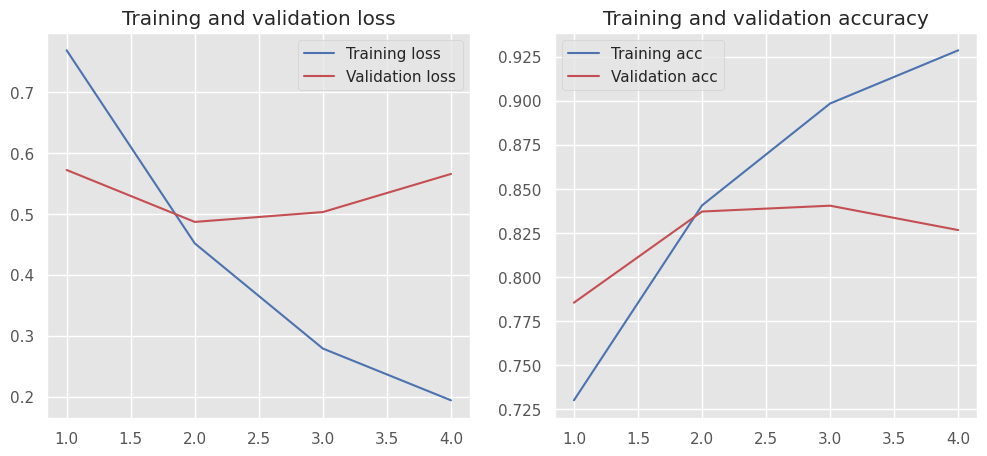

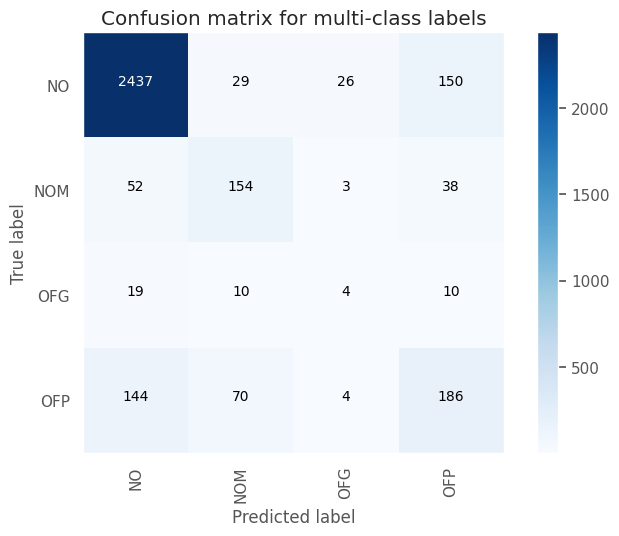

Test Accuracy: 0.8336
Test macro-F1: 0.5242


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4846    0.4564    0.4700       447
     no_hate     0.9166    0.9249    0.9207      2889

    accuracy                         0.8621      3336
   macro avg     0.7006    0.6906    0.6954      3336
weighted avg     0.8587    0.8621    0.8604      3336



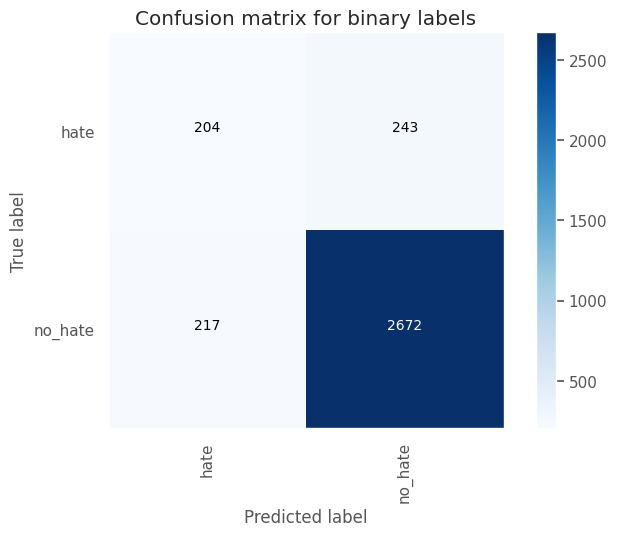

Test Accuracy: 0.8621
Test macro-F1: 0.6954




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_123 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_329 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_135 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_135 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_330 (Dropout)       (None, 42, 32)          

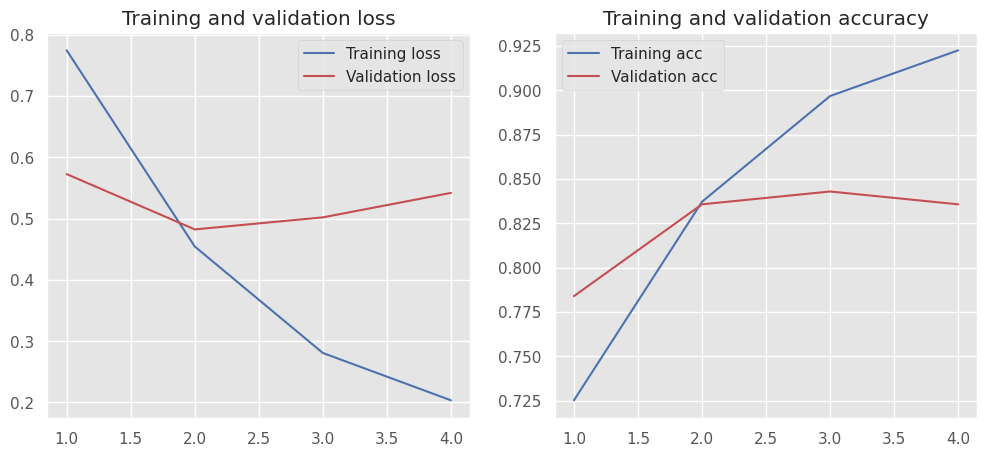

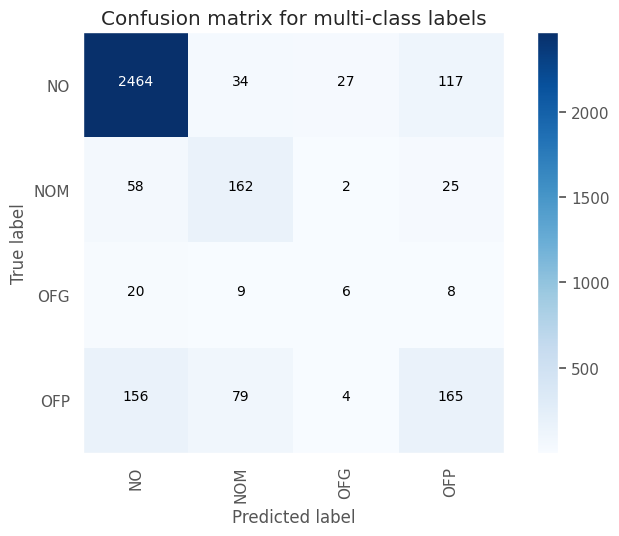

Test Accuracy: 0.8384
Test macro-F1: 0.5346


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5169    0.4094    0.4569       447
     no_hate     0.9115    0.9408    0.9259      2889

    accuracy                         0.8696      3336
   macro avg     0.7142    0.6751    0.6914      3336
weighted avg     0.8586    0.8696    0.8631      3336



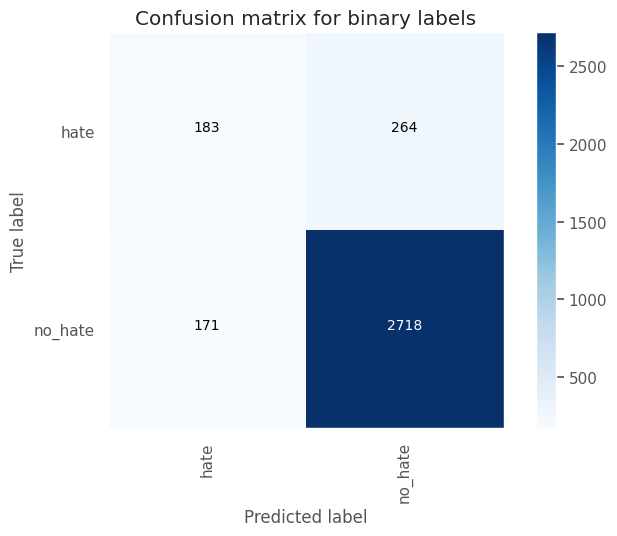

Test Accuracy: 0.8696
Test macro-F1: 0.6914




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_124 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_332 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_136 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_136 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_333 (Dropout)       (None, 42, 32)          

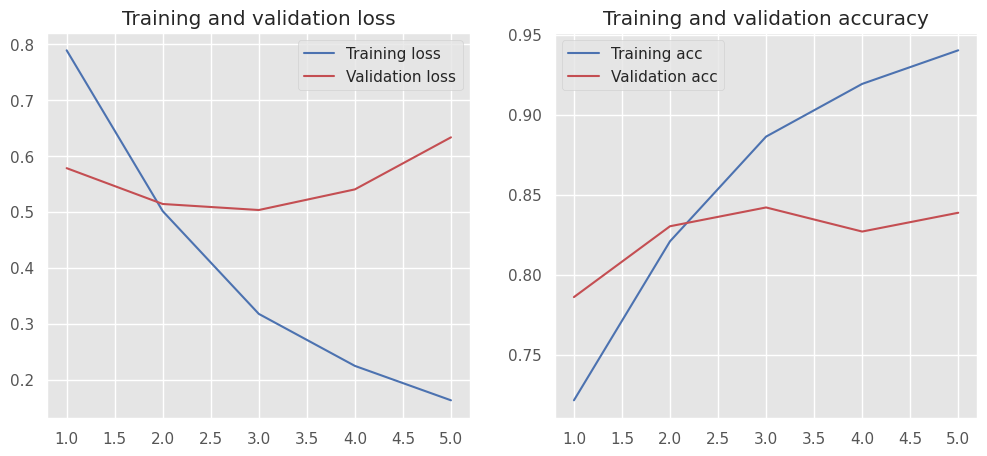

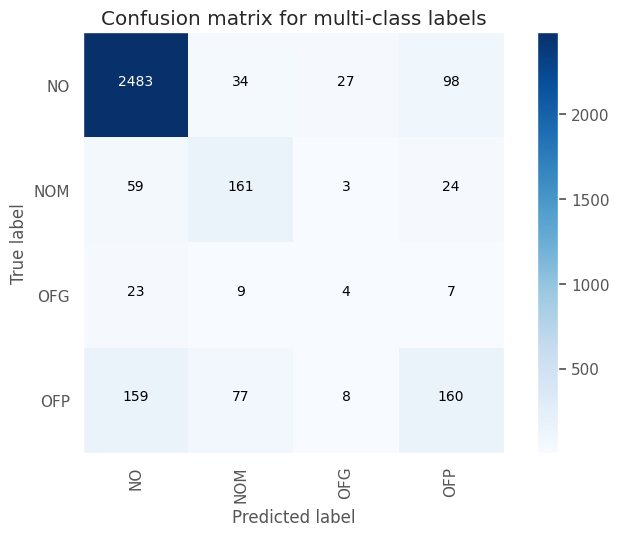

Test Accuracy: 0.8417
Test macro-F1: 0.5228


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5408    0.4004    0.4602       447
     no_hate     0.9108    0.9474    0.9287      2889

    accuracy                         0.8741      3336
   macro avg     0.7258    0.6739    0.6944      3336
weighted avg     0.8612    0.8741    0.8660      3336



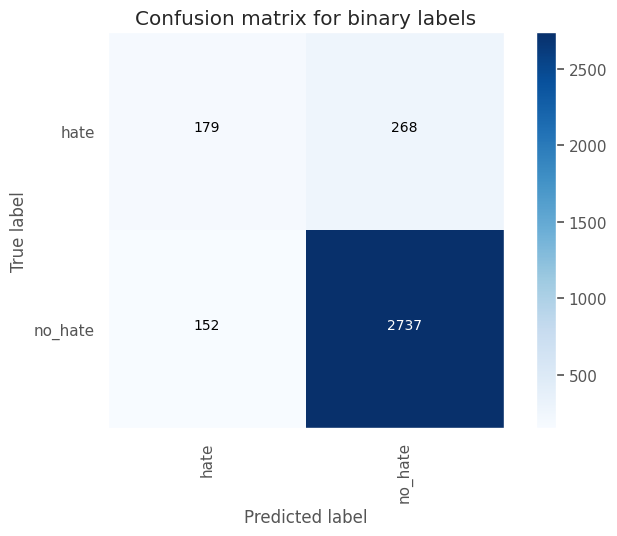

Test Accuracy: 0.8741
Test macro-F1: 0.6944




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_125 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_335 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_137 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_137 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_336 (Dropout)       (None, 42, 32)          

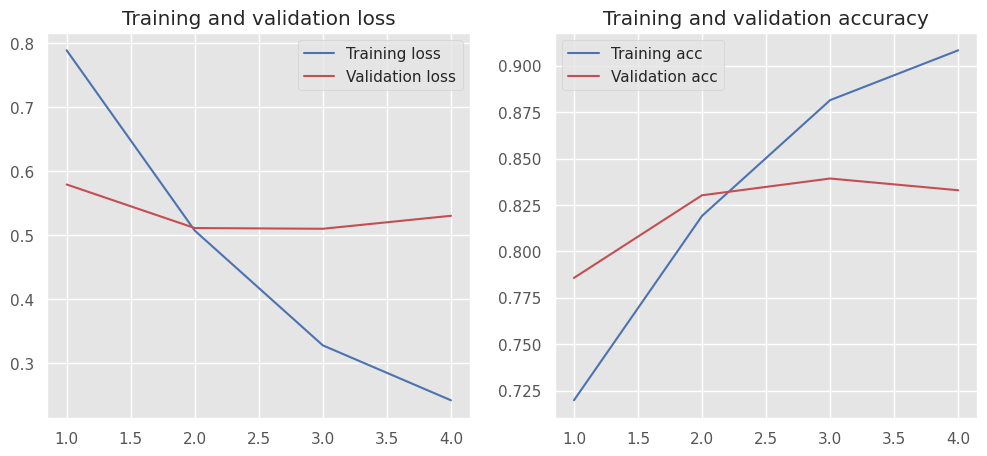

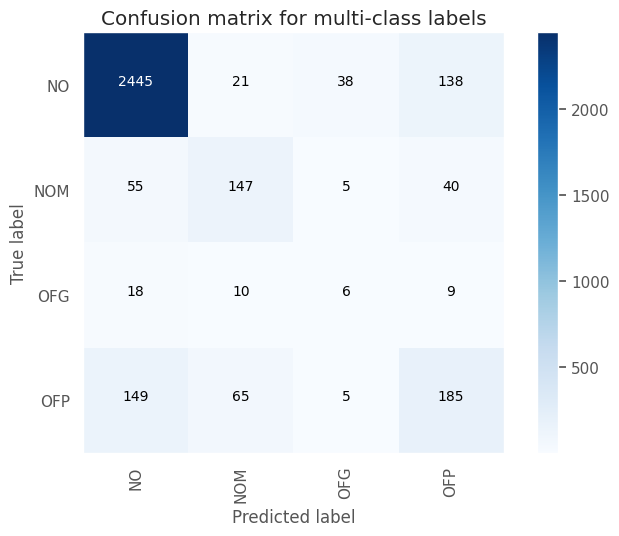

Test Accuracy: 0.8342
Test macro-F1: 0.5304


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4812    0.4586    0.4696       447
     no_hate     0.9168    0.9235    0.9202      2889

    accuracy                         0.8612      3336
   macro avg     0.6990    0.6911    0.6949      3336
weighted avg     0.8585    0.8612    0.8598      3336



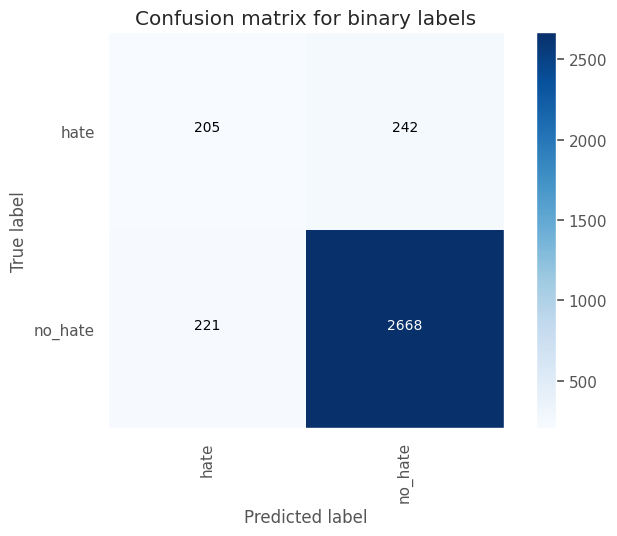

Test Accuracy: 0.8612
Test macro-F1: 0.6949




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_126 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_338 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_138 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_138 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_339 (Dropout)       (None, 42, 32)          

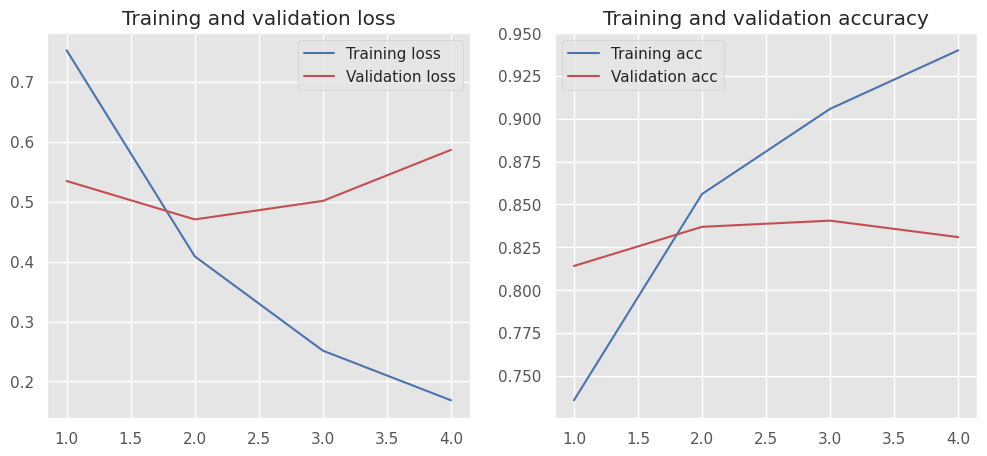

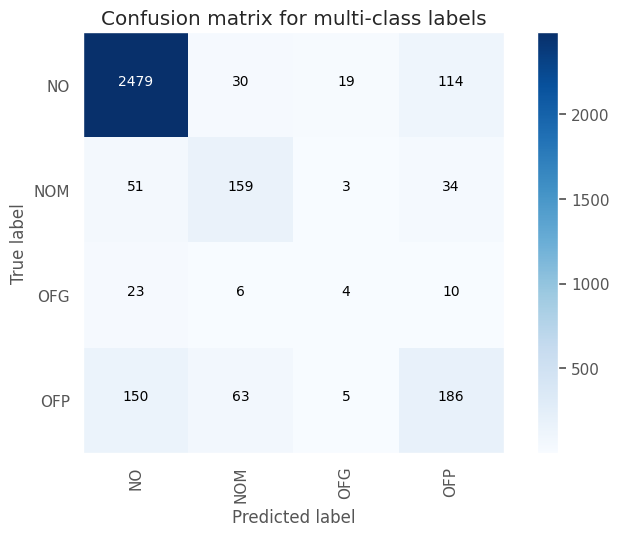

Test Accuracy: 0.8477
Test macro-F1: 0.5407


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5467    0.4586    0.4988       447
     no_hate     0.9183    0.9412    0.9296      2889

    accuracy                         0.8765      3336
   macro avg     0.7325    0.6999    0.7142      3336
weighted avg     0.8685    0.8765    0.8718      3336



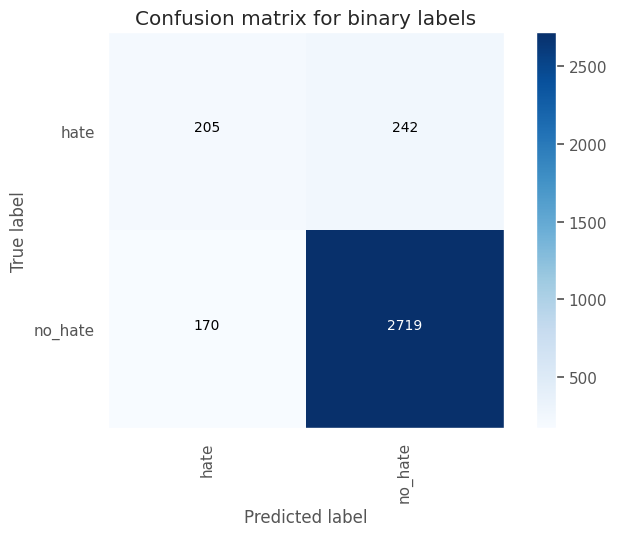

Test Accuracy: 0.8765
Test macro-F1: 0.7142




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_127 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_341 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_139 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_139 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_342 (Dropout)       (None, 42, 32)          

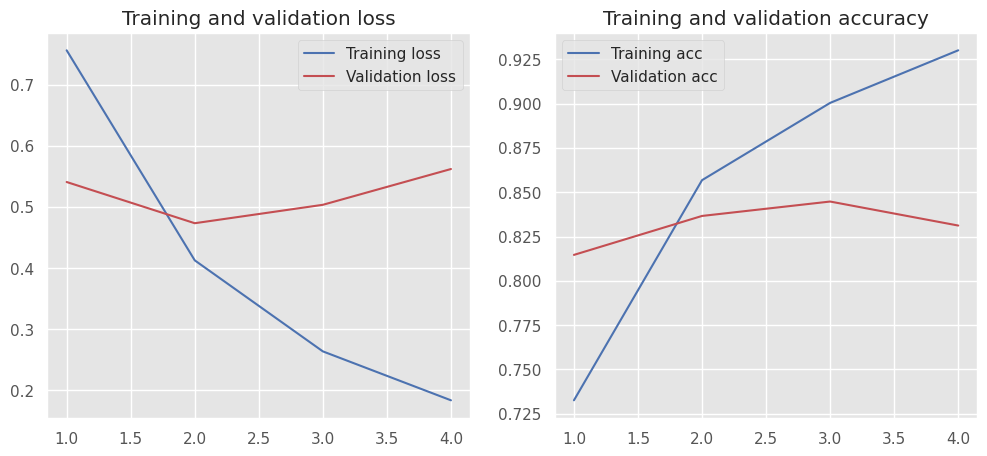

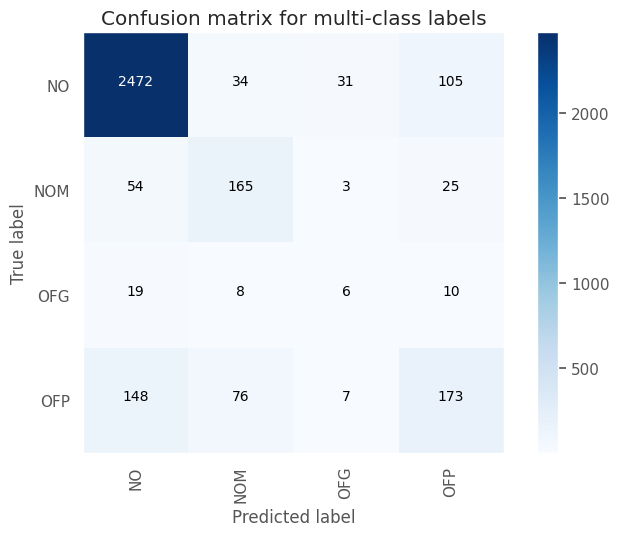

Test Accuracy: 0.8441
Test macro-F1: 0.5413


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5444    0.4385    0.4857       447
     no_hate     0.9157    0.9432    0.9292      2889

    accuracy                         0.8756      3336
   macro avg     0.7301    0.6909    0.7075      3336
weighted avg     0.8659    0.8756    0.8698      3336



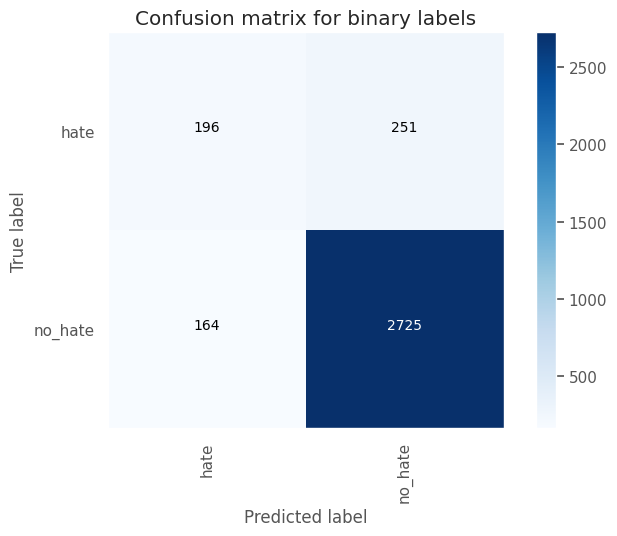

Test Accuracy: 0.8756
Test macro-F1: 0.7075




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_128 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_344 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_140 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_140 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_345 (Dropout)       (None, 42, 32)          

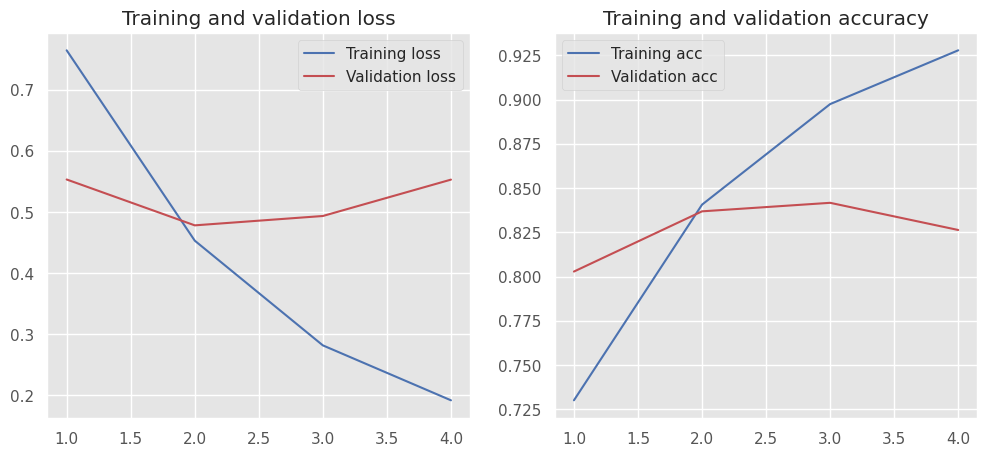

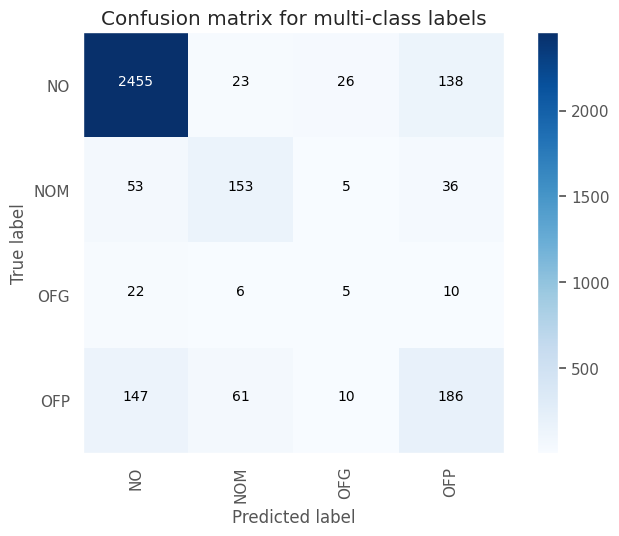

Test Accuracy: 0.839
Test macro-F1: 0.5351


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5072    0.4720    0.4890       447
     no_hate     0.9192    0.9290    0.9241      2889

    accuracy                         0.8678      3336
   macro avg     0.7132    0.7005    0.7065      3336
weighted avg     0.8640    0.8678    0.8658      3336



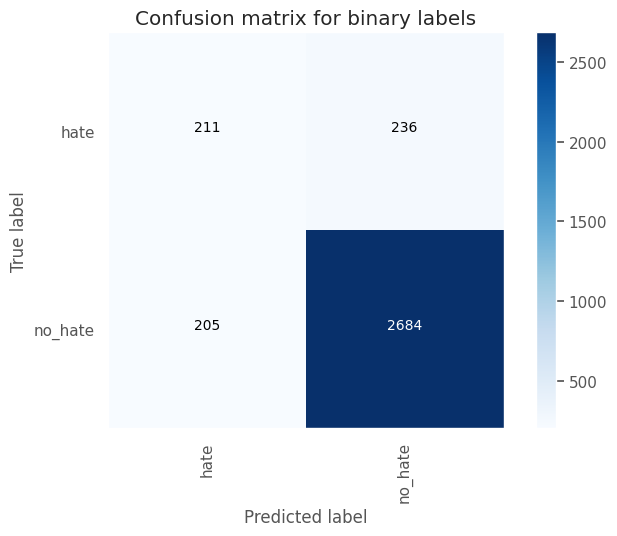

Test Accuracy: 0.8678
Test macro-F1: 0.7065




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_129 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_347 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_141 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_141 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_348 (Dropout)       (None, 42, 32)          

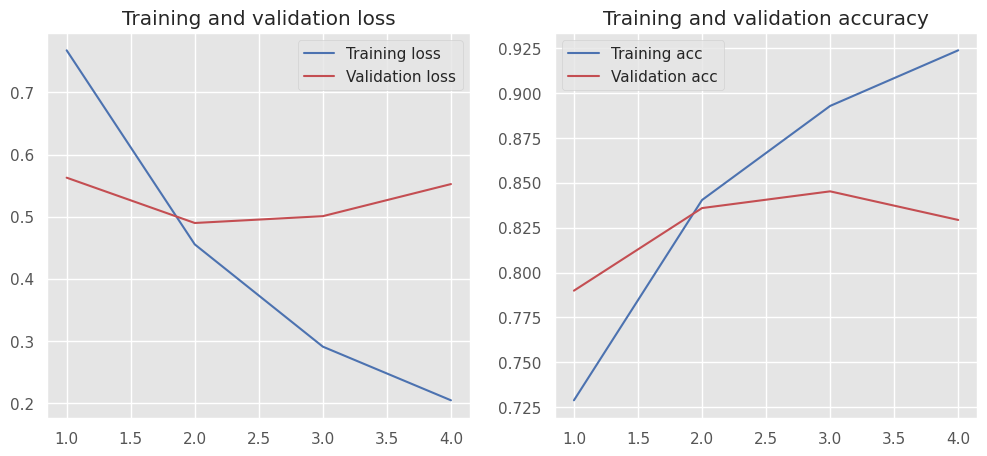

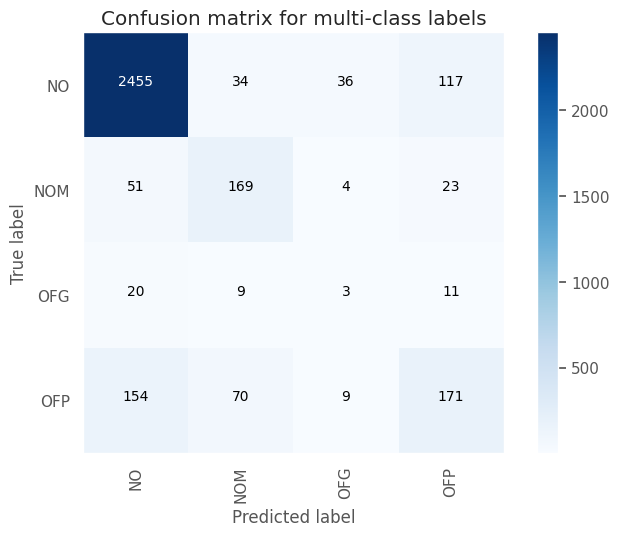

Test Accuracy: 0.8387
Test macro-F1: 0.5239


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5187    0.4340    0.4726       447
     no_hate     0.9146    0.9377    0.9260      2889

    accuracy                         0.8702      3336
   macro avg     0.7167    0.6858    0.6993      3336
weighted avg     0.8615    0.8702    0.8652      3336



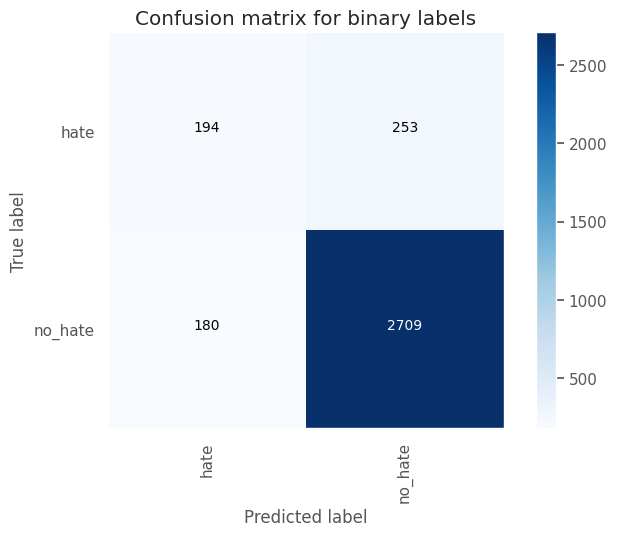

Test Accuracy: 0.8702
Test macro-F1: 0.6993




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_130 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_350 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_142 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_142 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_351 (Dropout)       (None, 42, 64)          

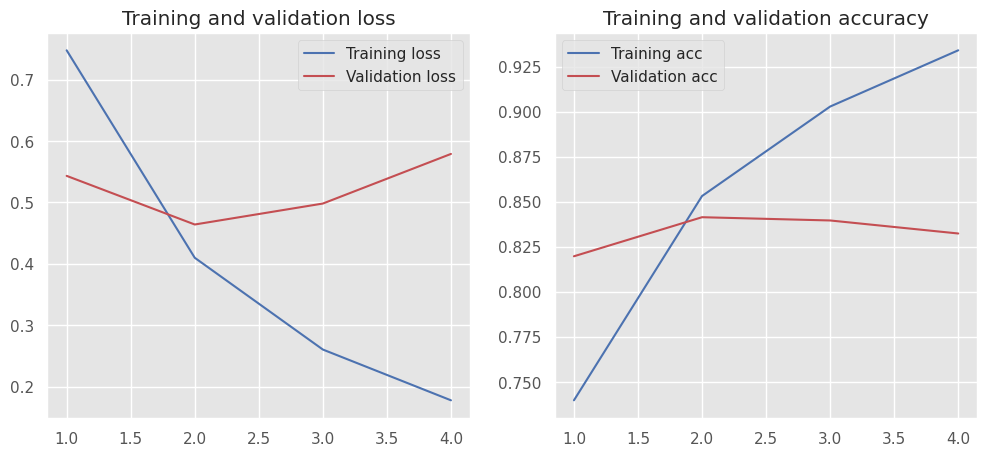

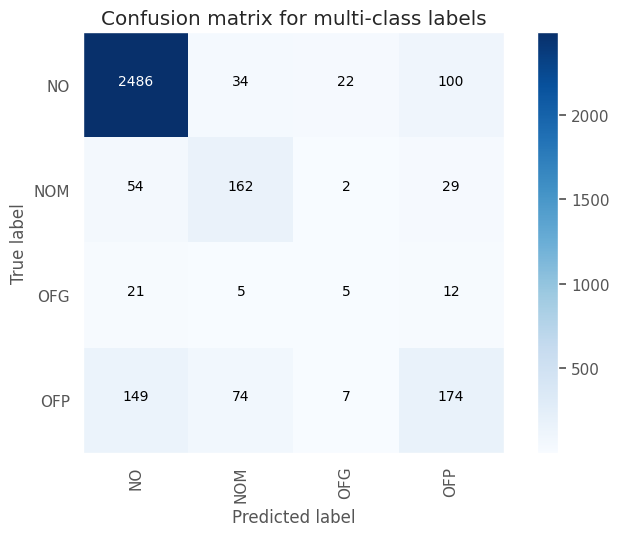

Test Accuracy: 0.8474
Test macro-F1: 0.5401


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5641    0.4430    0.4962       447
     no_hate     0.9166    0.9470    0.9316      2889

    accuracy                         0.8795      3336
   macro avg     0.7403    0.6950    0.7139      3336
weighted avg     0.8694    0.8795    0.8732      3336



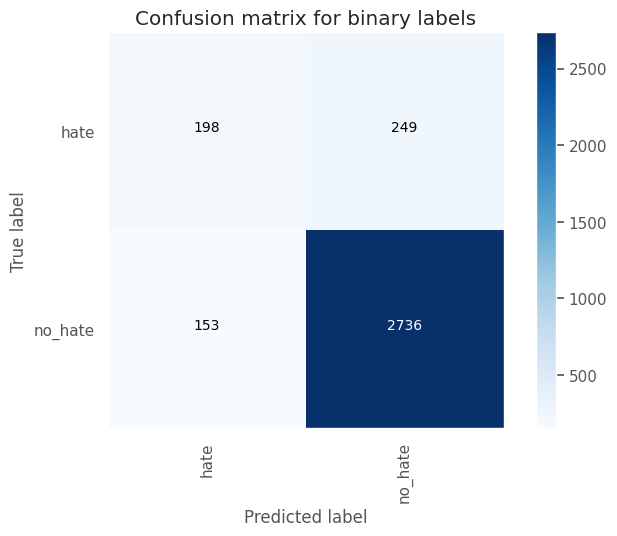

Test Accuracy: 0.8795
Test macro-F1: 0.7139




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_131 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_353 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_143 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_143 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_354 (Dropout)       (None, 42, 64)          

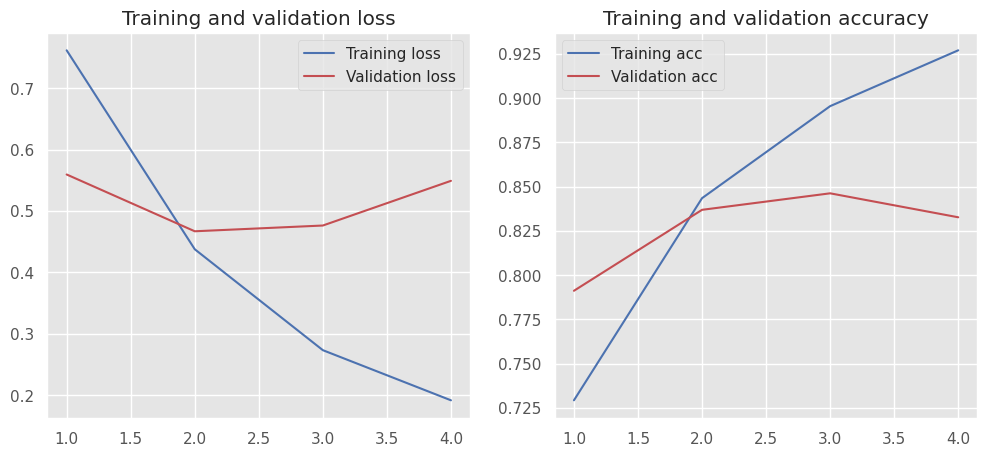

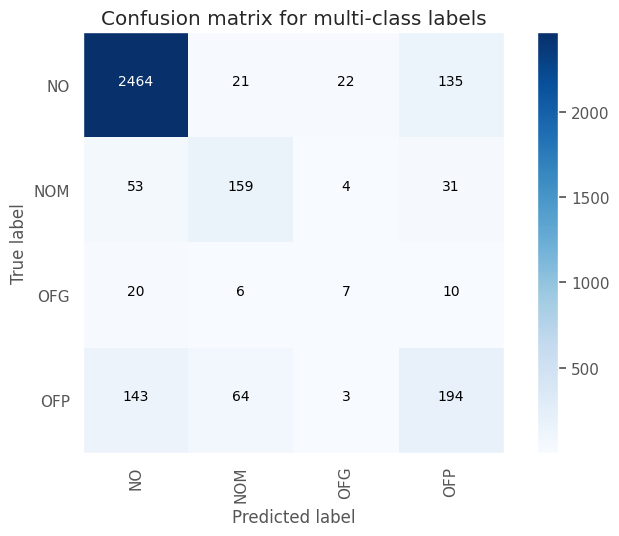

Test Accuracy: 0.8465
Test macro-F1: 0.5611


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5271    0.4787    0.5018       447
     no_hate     0.9205    0.9335    0.9270      2889

    accuracy                         0.8726      3336
   macro avg     0.7238    0.7061    0.7144      3336
weighted avg     0.8678    0.8726    0.8700      3336



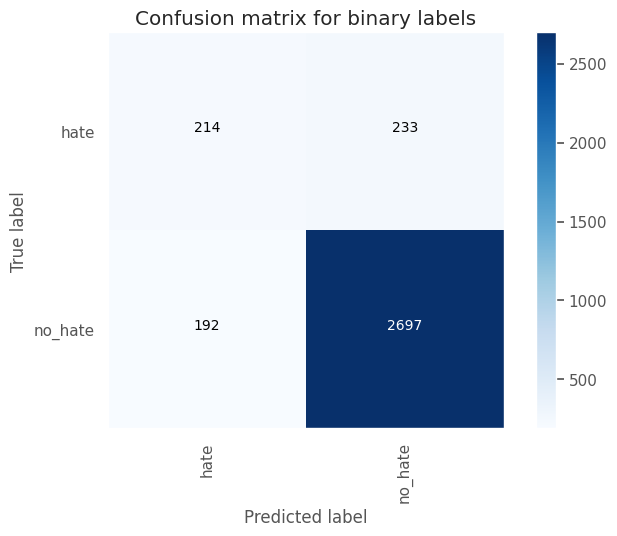

Test Accuracy: 0.8726
Test macro-F1: 0.7144




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_132 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_356 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_144 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_144 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_357 (Dropout)       (None, 42, 64)          

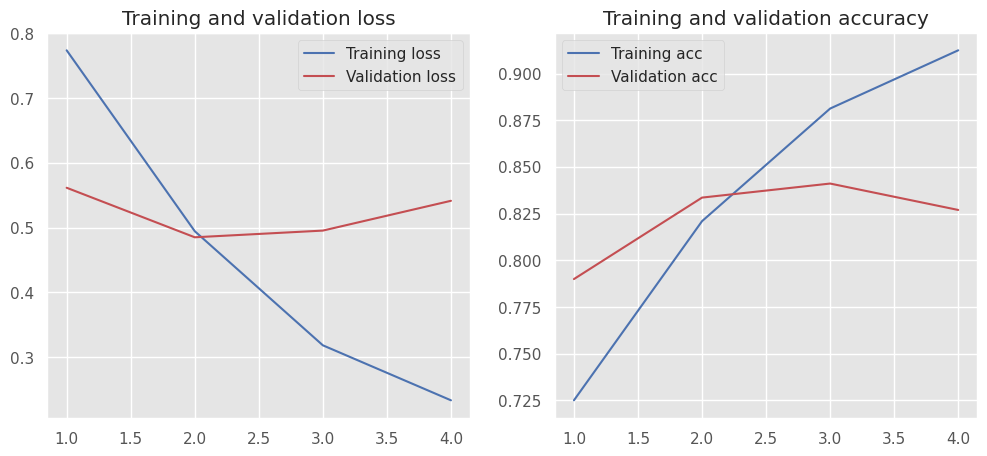

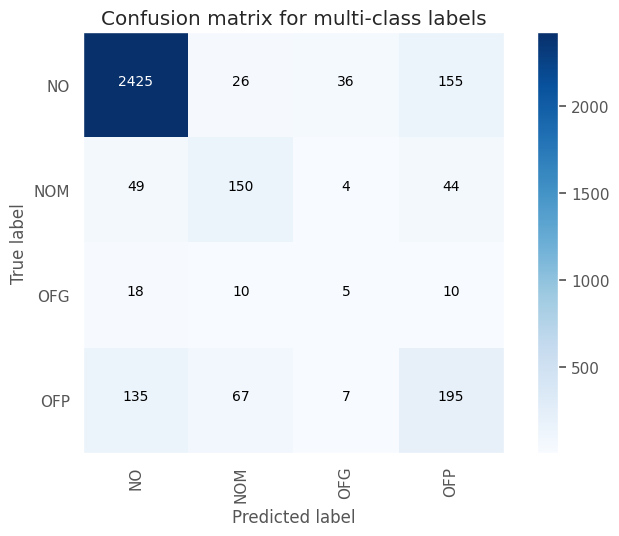

Test Accuracy: 0.8318
Test macro-F1: 0.5271


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4759    0.4855    0.4806       447
     no_hate     0.9201    0.9173    0.9187      2889

    accuracy                         0.8594      3336
   macro avg     0.6980    0.7014    0.6997      3336
weighted avg     0.8606    0.8594    0.8600      3336



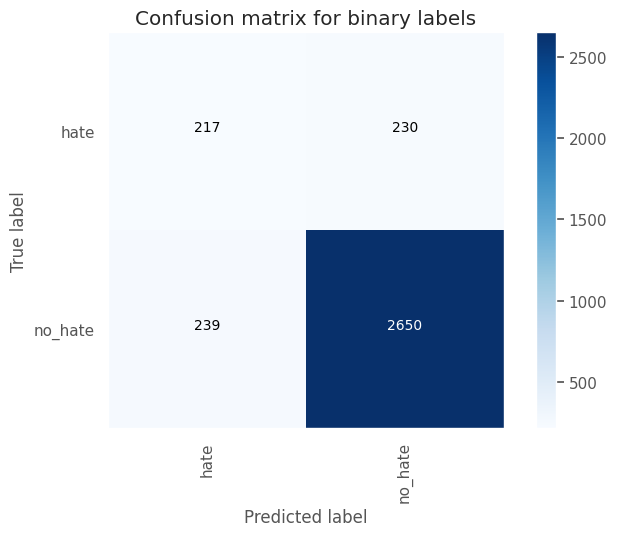

Test Accuracy: 0.8594
Test macro-F1: 0.6997




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_133 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_359 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_145 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_145 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_360 (Dropout)       (None, 42, 64)          

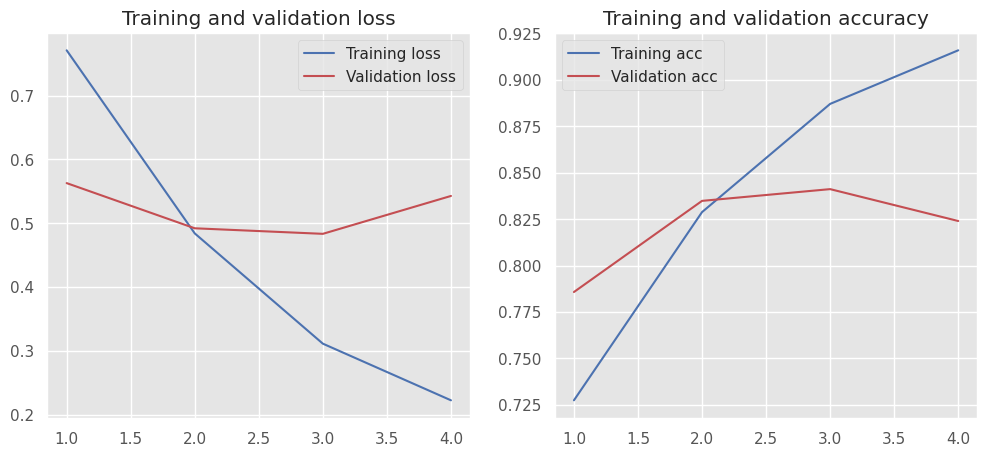

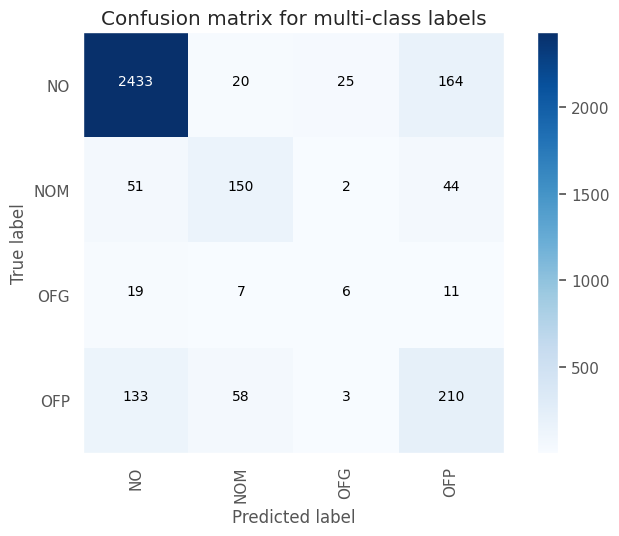

Test Accuracy: 0.839
Test macro-F1: 0.5501


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4946    0.5145    0.5044       447
     no_hate     0.9244    0.9187    0.9215      2889

    accuracy                         0.8645      3336
   macro avg     0.7095    0.7166    0.7130      3336
weighted avg     0.8668    0.8645    0.8656      3336



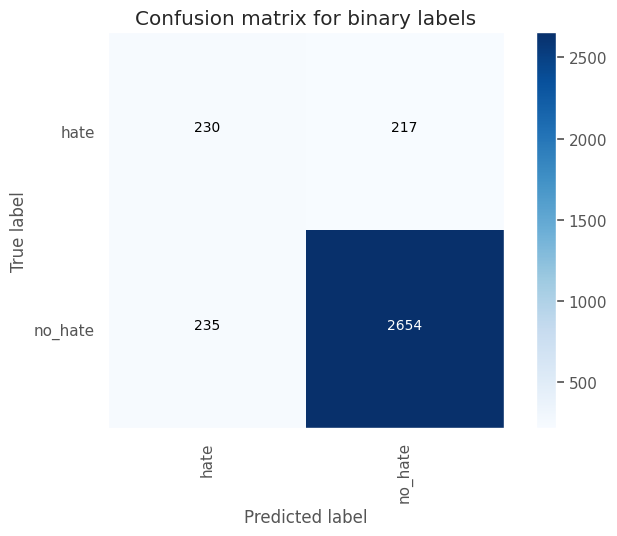

Test Accuracy: 0.8645
Test macro-F1: 0.713




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_134 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_362 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_146 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_146 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_363 (Dropout)       (None, 42, 64)           

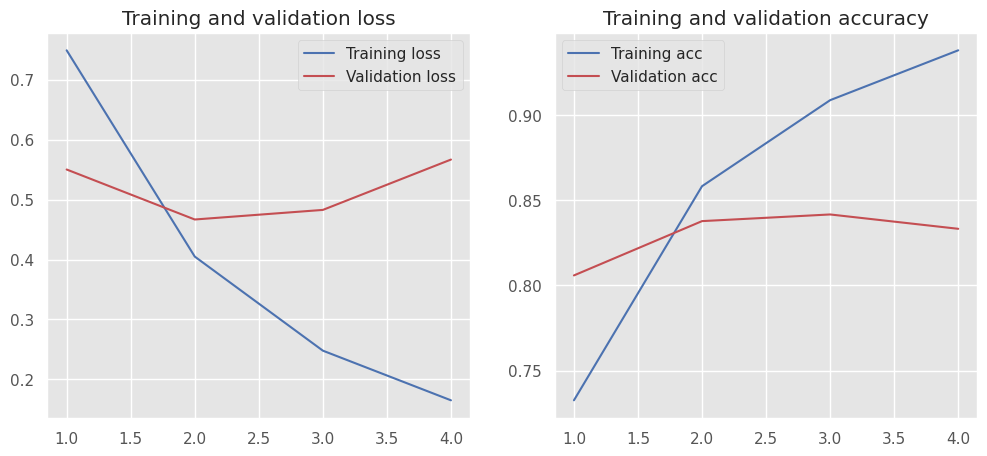

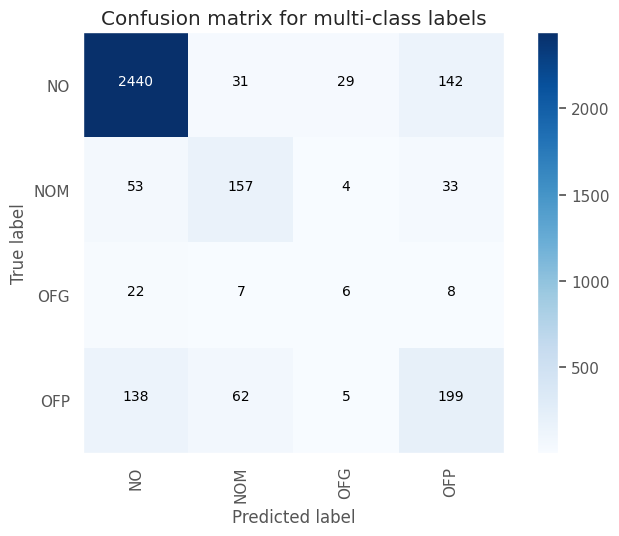

Test Accuracy: 0.8399
Test macro-F1: 0.5472


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5117    0.4877    0.4994       447
     no_hate     0.9213    0.9280    0.9246      2889

    accuracy                         0.8690      3336
   macro avg     0.7165    0.7078    0.7120      3336
weighted avg     0.8664    0.8690    0.8677      3336



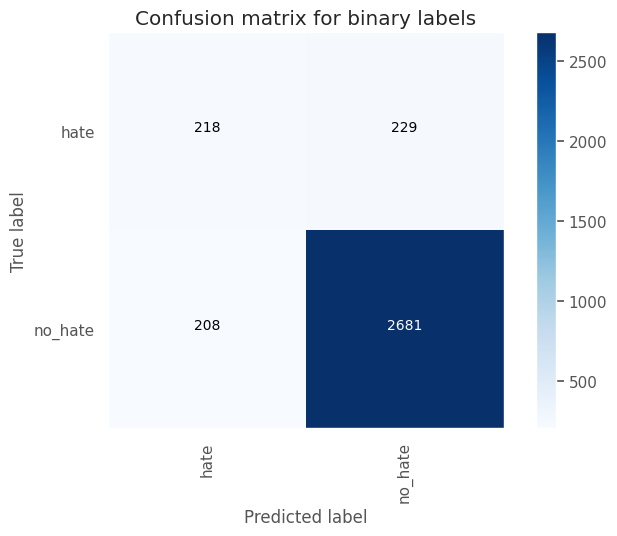

Test Accuracy: 0.869
Test macro-F1: 0.712




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_135 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_365 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_147 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_147 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_366 (Dropout)       (None, 42, 64)            

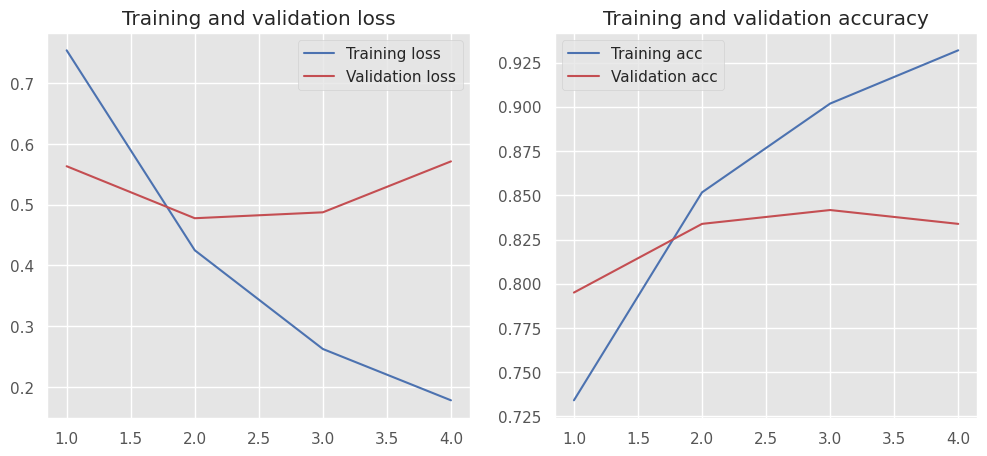

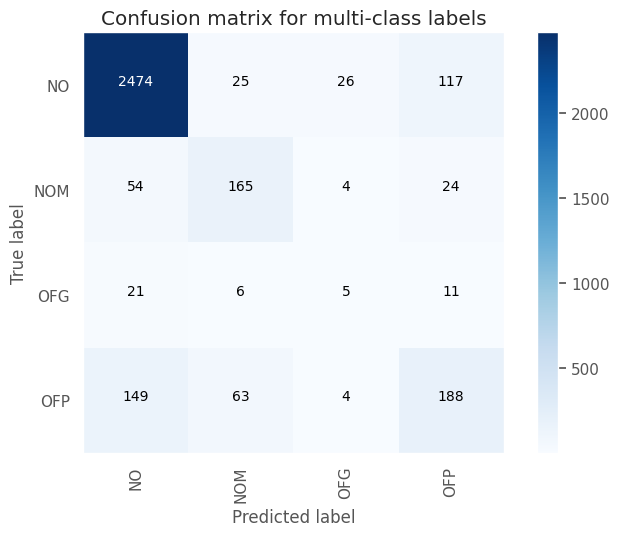

Test Accuracy: 0.8489
Test macro-F1: 0.5515


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5488    0.4653    0.5036       447
     no_hate     0.9192    0.9408    0.9299      2889

    accuracy                         0.8771      3336
   macro avg     0.7340    0.7031    0.7167      3336
weighted avg     0.8695    0.8771    0.8728      3336



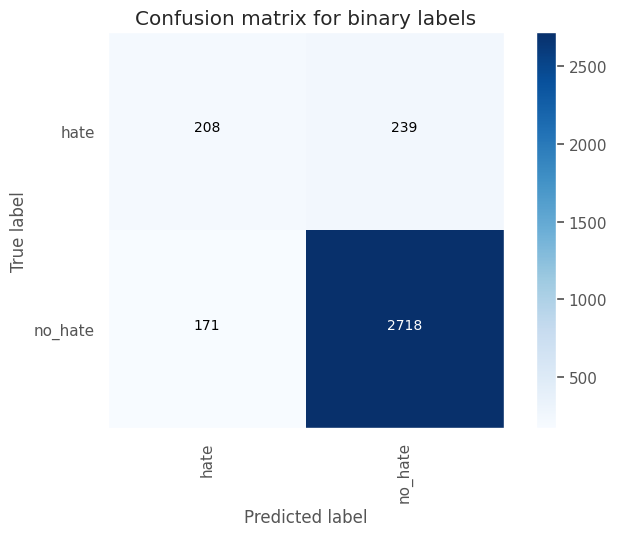

Test Accuracy: 0.8771
Test macro-F1: 0.7167




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_136 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_368 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_148 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_148 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_369 (Dropout)       (None, 42, 64)          

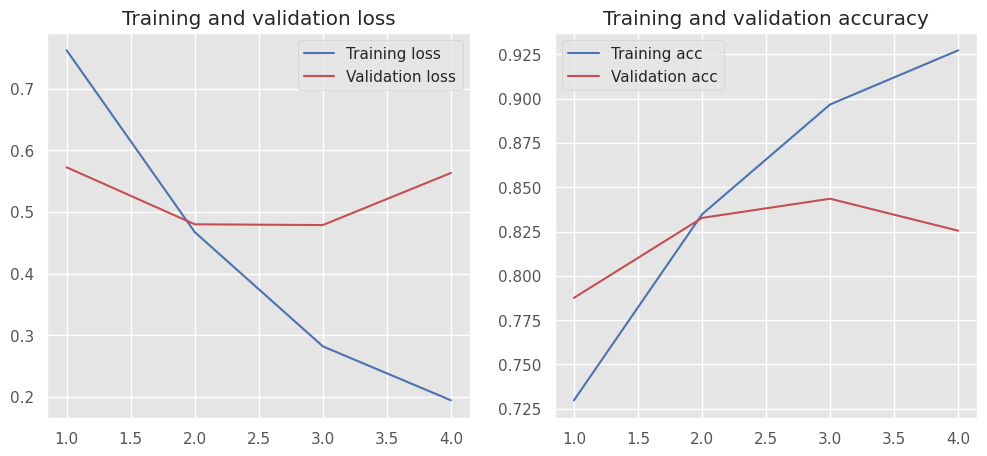

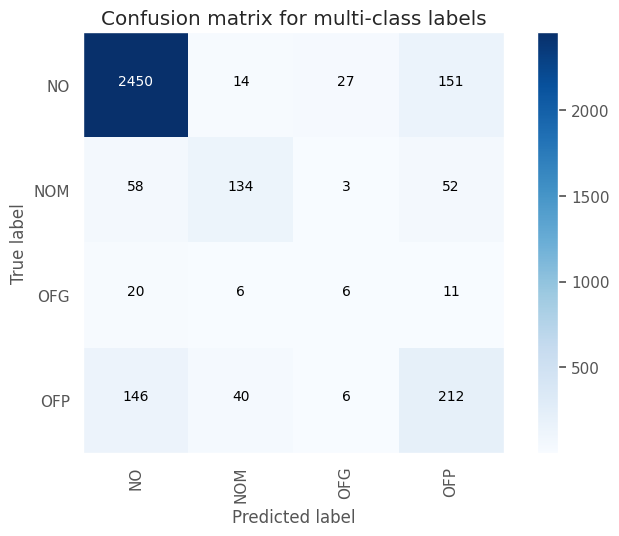

Test Accuracy: 0.8399
Test macro-F1: 0.5454


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5021    0.5257    0.5137       447
     no_hate     0.9261    0.9193    0.9227      2889

    accuracy                         0.8666      3336
   macro avg     0.7141    0.7225    0.7182      3336
weighted avg     0.8693    0.8666    0.8679      3336



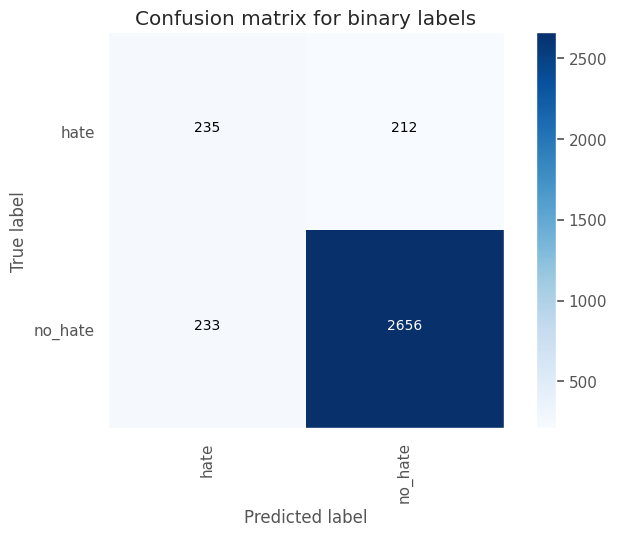

Test Accuracy: 0.8666
Test macro-F1: 0.7182




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_137 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_371 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_149 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_149 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_372 (Dropout)       (None, 42, 64)          

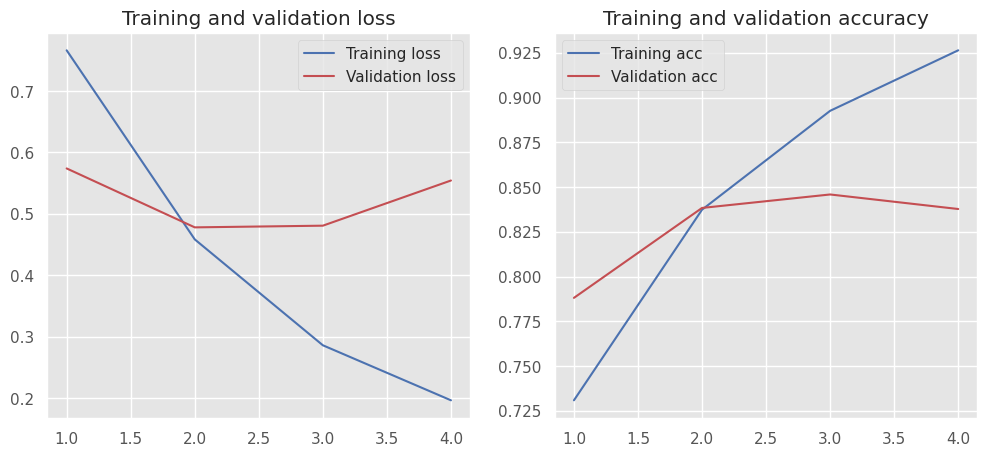

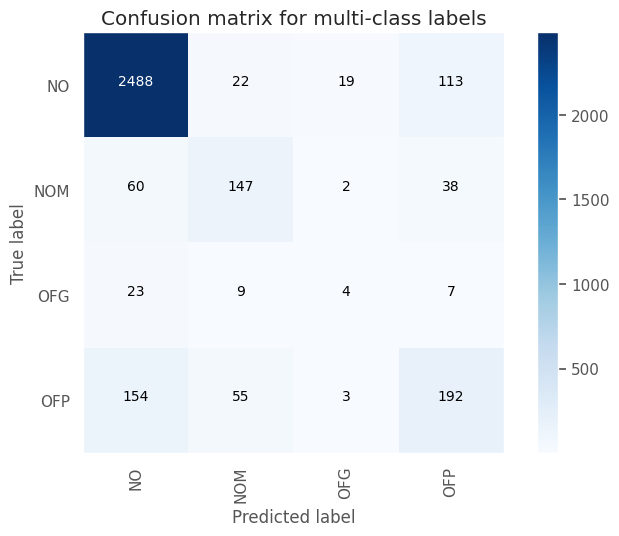

Test Accuracy: 0.8486
Test macro-F1: 0.5404


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5450    0.4609    0.4994       447
     no_hate     0.9185    0.9405    0.9294      2889

    accuracy                         0.8762      3336
   macro avg     0.7317    0.7007    0.7144      3336
weighted avg     0.8685    0.8762    0.8718      3336



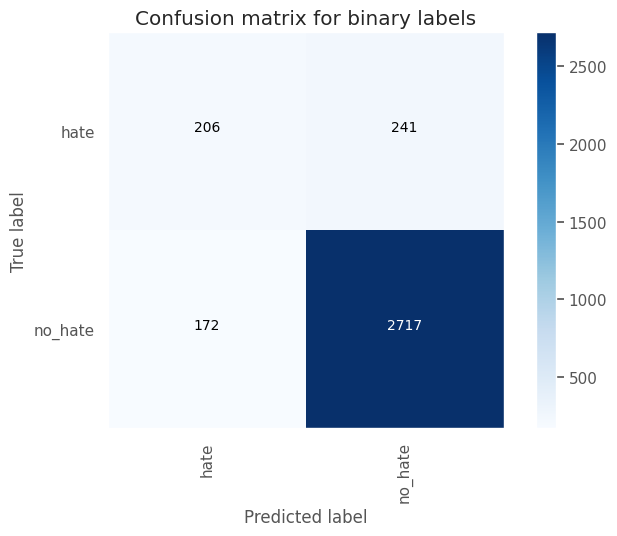

Test Accuracy: 0.8762
Test macro-F1: 0.7144







<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>9</th>
      <td>v6</td>
      <td>{'embedding_131': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_353': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_143': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_143': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_354': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_126': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_262': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_355': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_263': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1191720</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5685</td>
      <td>0.5548</td>
      <td>0.5611</td>
      <td>0.7238</td>
      <td>0.7061</td>
      <td>0.7144</td>
    </tr>
    <tr>
      <th>13</th>
      <td>v6</td>
      <td>{'embedding_135': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_365': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_147': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_147': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_366': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_130': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_270': {'class_name': 'Dense', 'param_count': 344192, 'input': (None, 2688), 'output': (None, 128)}, 'dropout_367': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_271': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1364072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5588</td>
      <td>0.5465</td>
      <td>0.5515</td>
      <td>0.7340</td>
      <td>0.7031</td>
      <td>0.7167</td>
    </tr>
    <tr>
      <th>11</th>
      <td>v6</td>
      <td>{'embedding_133': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_359': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_145': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_145': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_360': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_128': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_266': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_361': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_267': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1191720</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5544</td>
      <td>0.5469</td>
      <td>0.5501</td>
      <td>0.7095</td>
      <td>0.7166</td>
      <td>0.7130</td>
    </tr>
    <tr>
      <th>12</th>
      <td>v6</td>
      <td>{'embedding_134': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_362': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_146': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_146': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_363': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_129': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_268': {'class_name': 'Dense', 'param_count': 344192, 'input': (None, 2688), 'output': (None, 128)}, 'dropout_364': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_269': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1364072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5470</td>
      <td>0.5478</td>
      <td>0.5472</td>
      <td>0.7165</td>
      <td>0.7078</td>
      <td>0.7120</td>
    </tr>
    <tr>
      <th>14</th>
      <td>v6</td>
      <td>{'embedding_136': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_368': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_148': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_148': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_369': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_131': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_272': {'class_name': 'Dense', 'param_count': 344192, 'input': (None, 2688), 'output': (None, 128)}, 'dropout_370': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_273': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1364072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5619</td>
      <td>0.5335</td>
      <td>0.5454</td>
      <td>0.7141</td>
      <td>0.7225</td>
      <td>0.7182</td>
    </tr>
    <tr>
      <th>5</th>
      <td>v6</td>
      <td>{'embedding_127': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_341': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_139': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_139': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_342': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_122': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_254': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dropout_343': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_255': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1182408</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5453</td>
      <td>0.5429</td>
      <td>0.5413</td>
      <td>0.7301</td>
      <td>0.6909</td>
      <td>0.7075</td>
    </tr>
    <tr>
      <th>4</th>
      <td>v6</td>
      <td>{'embedding_126': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_338': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_138': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_138': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_339': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_121': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_252': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dropout_340': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_253': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1182408</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5508</td>
      <td>0.5339</td>
      <td>0.5407</td>
      <td>0.7325</td>
      <td>0.6999</td>
      <td>0.7142</td>
    </tr>
    <tr>
      <th>15</th>
      <td>v6</td>
      <td>{'embedding_137': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_371': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_149': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_149': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_372': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_132': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_274': {'class_name': 'Dense', 'param_count': 344192, 'input': (None, 2688), 'output': (None, 128)}, 'dropout_373': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_275': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1364072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5588</td>
      <td>0.5263</td>
      <td>0.5404</td>
      <td>0.7317</td>
      <td>0.7007</td>
      <td>0.7144</td>
    </tr>
    <tr>
      <th>8</th>
      <td>v6</td>
      <td>{'embedding_130': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_350': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_142': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_142': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_351': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_125': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_260': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_352': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_261': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1191720</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5494</td>
      <td>0.5359</td>
      <td>0.5401</td>
      <td>0.7403</td>
      <td>0.6950</td>
      <td>0.7139</td>
    </tr>
    <tr>
      <th>6</th>
      <td>v6</td>
      <td>{'embedding_128': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_344': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_140': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_140': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_345': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_123': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_256': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dropout_346': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_257': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1182408</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5395</td>
      <td>0.5313</td>
      <td>0.5351</td>
      <td>0.7132</td>
      <td>0.7005</td>
      <td>0.7065</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_123': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_329': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_135': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_135': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_330': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_118': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_246': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_331': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_247': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1096072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5403</td>
      <td>0.5341</td>
      <td>0.5346</td>
      <td>0.7142</td>
      <td>0.6751</td>
      <td>0.6914</td>
    </tr>
    <tr>
      <th>3</th>
      <td>v6</td>
      <td>{'embedding_125': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_335': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_137': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_137': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_336': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_120': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_250': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_337': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_251': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1096072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5325</td>
      <td>0.5295</td>
      <td>0.5304</td>
      <td>0.6990</td>
      <td>0.6911</td>
      <td>0.6949</td>
    </tr>
    <tr>
      <th>10</th>
      <td>v6</td>
      <td>{'embedding_132': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_356': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_144': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_144': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_357': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_127': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_264': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_358': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_265': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1191720</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5237</td>
      <td>0.5310</td>
      <td>0.5271</td>
      <td>0.6980</td>
      <td>0.7014</td>
      <td>0.6997</td>
    </tr>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_122': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_326': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_134': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_134': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_327': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_117': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_244': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_328': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_245': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1096072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5242</td>
      <td>0.5248</td>
      <td>0.5242</td>
      <td>0.7006</td>
      <td>0.6906</td>
      <td>0.6954</td>
    </tr>
    <tr>
      <th>7</th>
      <td>v6</td>
      <td>{'embedding_129': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_347': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_141': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_141': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_348': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_124': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_258': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dropout_349': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_259': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1182408</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5260</td>
      <td>0.5266</td>
      <td>0.5239</td>
      <td>0.7167</td>
      <td>0.6858</td>
      <td>0.6993</td>
    </tr>
    <tr>
      <th>2</th>
      <td>v6</td>
      <td>{'embedding_124': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_332': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_136': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_136': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_333': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_119': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_248': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_334': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_249': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1096072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5333</td>
      <td>0.5202</td>
      <td>0.5228</td>
      <td>0.7258</td>
      <td>0.6739</td>
      <td>0.6944</td>
    </tr>
  </tbody>
</table>
    

In [30]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

for cnn_filter_dim in [32, 64]:
  for pool_size in [3]:
    for dense_dim in [64, 128]:
      for dp_before_classif_dense in [0.0, 0.3]:
        for dp_after_pool in [0.0, 0.1]:
          # Build CNN model  ===========
          model_config = KerasCNNClassifierModelConfig(
              # General
              vocab_size=vocab_size,
              model_name="cnn_classifier",
              # Embeddings
              embedding_config=EmbeddingConfig(output_dim=embedding_dim, input_length=max_length, trainable=True, pre_trained_matrix=None),
              # CNN Layers
              cnn_filter_dims=[cnn_filter_dim],
              cnn_kernel_sizes=[3],
              cnn_activations=["relu"],
              cnn_stride_sizes=[1],
              cnn_padding=["valid"],
              pool_sizes=[pool_size],
              use_global_pooling=False,
              # Dense layers at the end
              dense_activations=["relu", "softmax"],
              dense_dims=[dense_dim, 4],
              # Dropouts
              dp_after_embedding=0.5,
              dp_after_pooling=[dp_after_pool],
              dp_before_classif_dense=dp_before_classif_dense)
          model: tf.keras.Model = CNNModelFactory.create(model_config)
          # ============================


          # Train  ===========
          trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                    max_input_length=max_length))
          optim_config: OptimizationConfig = OptimizationConfig(
              epochs=25,
              batch_size=32,
              validation_split=0.0,
              validation_data=(x_val, y_val),
              optimizer=Adam(learning_rate=0.001),
              class_weight=None
          )
          trainer.train(x_train=x_train,
                        y_train=y_train,
                        opt_config=optim_config,
                        callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
          mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
          mc_report: dict
          bc_report: dict

          # Accumulate result so it can be plotted
          result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                          dataset_version=dataset_name,
                                          model_params=model.count_params(),
                                          optim_config=optim_config,
                                          macro_prec_mc=mc_report["macro avg"]["precision"],
                                          macro_recall_mc=mc_report["macro avg"]["recall"],
                                          macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                          macro_prec_bc=bc_report["macro avg"]["precision"],
                                          macro_recall_bc=bc_report["macro avg"]["recall"],
                                          macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                          )
          results_rep.accumulate(result)
          # ============================

report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)

En este caso, reduciendo el dropout obtenemos ligeramente mejores resultados, con 64 filtros de CNN y dense_dim 64 obtenemos **56.11% de macro-f1 (MULTI-CLASS) y 71.44% de macro-f1 (BINARY-CLASS)**.

Los resultados igualmente siguen siendo bastante malos. A continuación, repetiremos esta misma prueba pero reduciendo la dimensionalidad de los embedding resultantes a la mitad.

Para encontrar los parámetros que quizás no se visualizan en la estructura, lo más fácil es repetir los for loops y encontrar el índice.

In [33]:
idx: int = 0
for cnn_filter_dim in [32, 64]:
  for pool_size in [3]:
    for dense_dim in [64, 128]:
      for dp_before_classif_dense in [0.0, 0.3]:
        for dp_after_pool in [0.0, 0.1]:
          print(f"idx: {idx} || {cnn_filter_dim}, {pool_size}, {dense_dim}, {dp_before_classif_dense}, {dp_after_pool}")
          idx+=1

idx: 0 || 32, 3, 64, 0.0, 0.0
idx: 1 || 32, 3, 64, 0.0, 0.1
idx: 2 || 32, 3, 64, 0.3, 0.0
idx: 3 || 32, 3, 64, 0.3, 0.1
idx: 4 || 32, 3, 128, 0.0, 0.0
idx: 5 || 32, 3, 128, 0.0, 0.1
idx: 6 || 32, 3, 128, 0.3, 0.0
idx: 7 || 32, 3, 128, 0.3, 0.1
idx: 8 || 64, 3, 64, 0.0, 0.0
idx: 9 || 64, 3, 64, 0.0, 0.1
idx: 10 || 64, 3, 64, 0.3, 0.0
idx: 11 || 64, 3, 64, 0.3, 0.1
idx: 12 || 64, 3, 128, 0.0, 0.0
idx: 13 || 64, 3, 128, 0.0, 0.1
idx: 14 || 64, 3, 128, 0.3, 0.0
idx: 15 || 64, 3, 128, 0.3, 0.1


Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_138 (Embedding)   (None, 128, 50)           500050    
                                                                 
 dropout_374 (Dropout)       (None, 128, 50)           0         
                                                                 
 conv1d_150 (Conv1D)         (None, 126, 32)           4832      
                                                                 
 max_pooling1d_150 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_3

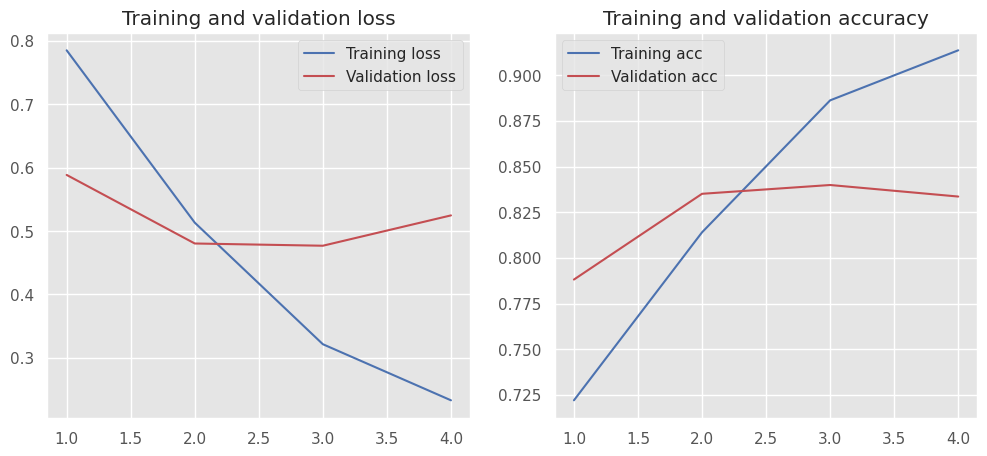

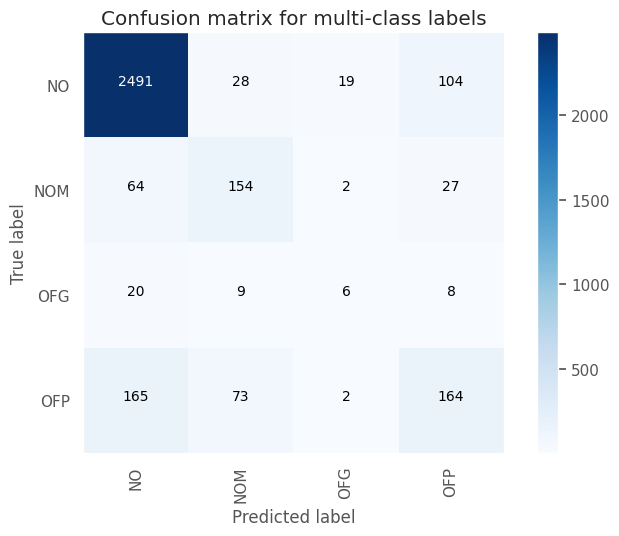

Test Accuracy: 0.8438
Test macro-F1: 0.5398


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5422    0.4027    0.4621       447
     no_hate     0.9111    0.9474    0.9289      2889

    accuracy                         0.8744      3336
   macro avg     0.7266    0.6750    0.6955      3336
weighted avg     0.8617    0.8744    0.8664      3336



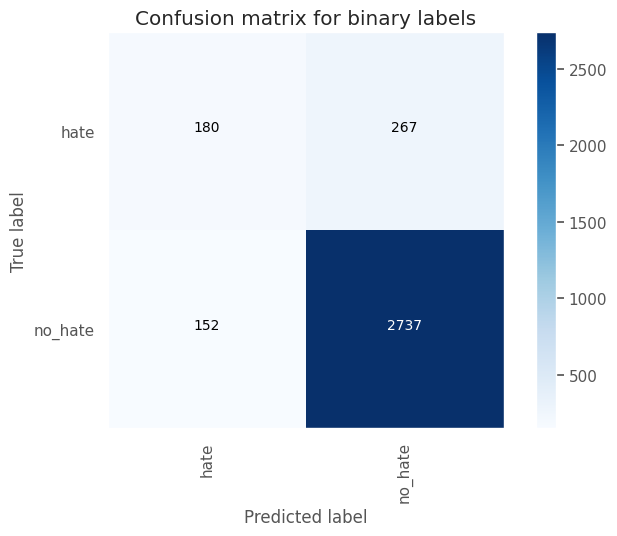

Test Accuracy: 0.8744
Test macro-F1: 0.6955




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_139 (Embedding)   (None, 128, 50)           500050    
                                                                 
 dropout_377 (Dropout)       (None, 128, 50)           0         
                                                                 
 conv1d_151 (Conv1D)         (None, 126, 32)           4832      
                                                                 
 max_pooling1d_151 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_378 (Dropout)       (None, 42, 32)          

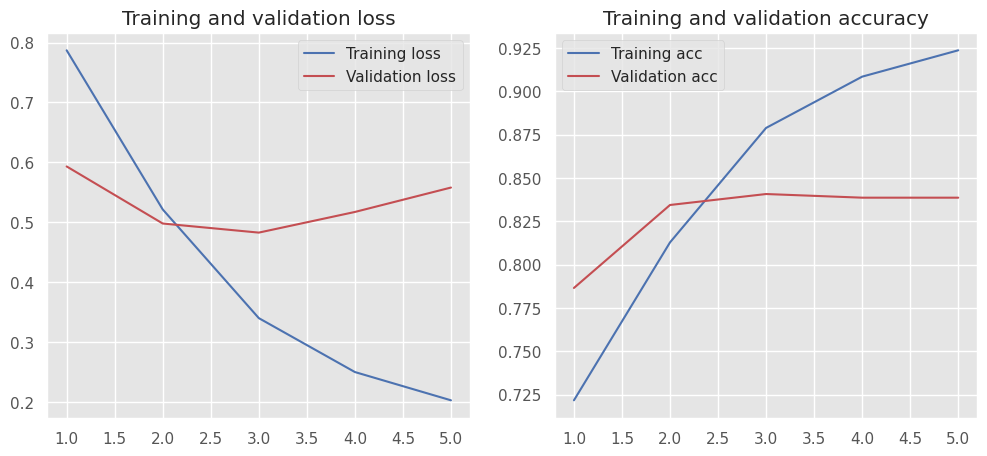

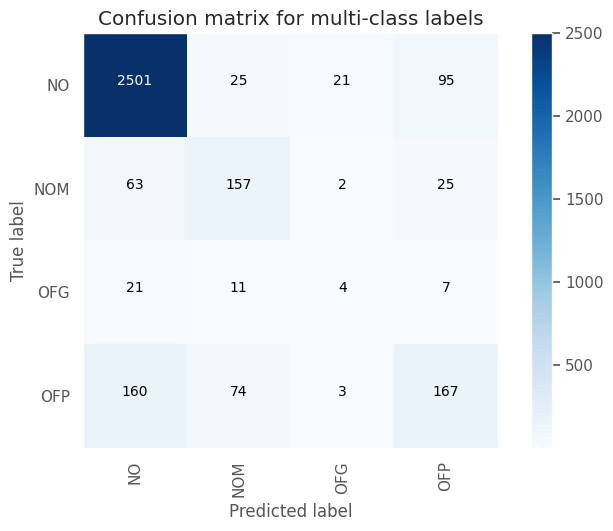

Test Accuracy: 0.848
Test macro-F1: 0.5319


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5586    0.4049    0.4695       447
     no_hate     0.9117    0.9505    0.9307      2889

    accuracy                         0.8774      3336
   macro avg     0.7352    0.6777    0.7001      3336
weighted avg     0.8644    0.8774    0.8689      3336



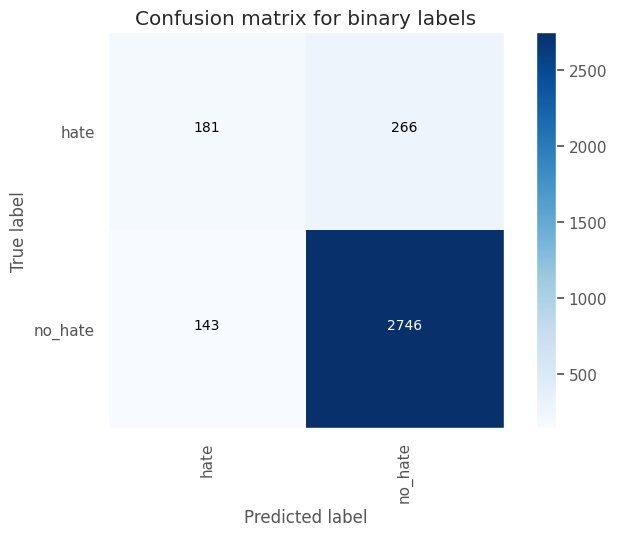

Test Accuracy: 0.8774
Test macro-F1: 0.7001




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_140 (Embedding)   (None, 128, 50)           500050    
                                                                 
 dropout_380 (Dropout)       (None, 128, 50)           0         
                                                                 
 conv1d_152 (Conv1D)         (None, 126, 32)           4832      
                                                                 
 max_pooling1d_152 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_381 (Dropout)       (None, 42, 32)          

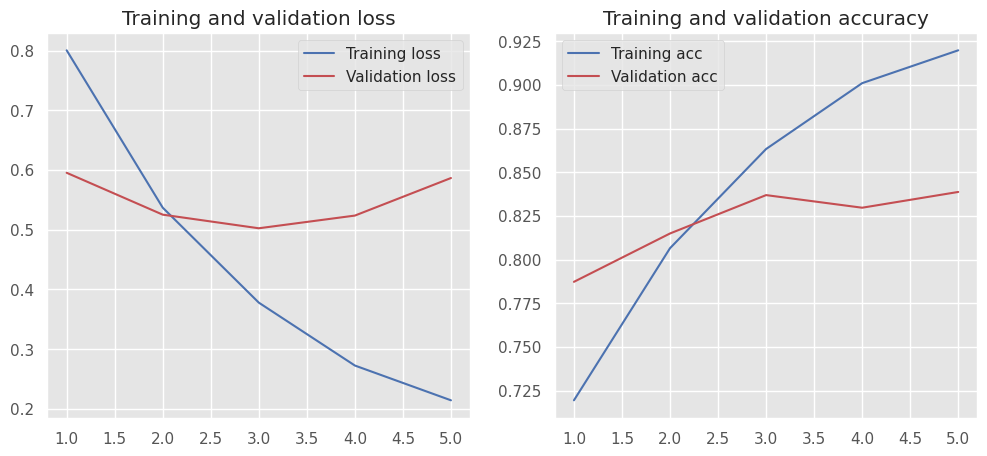

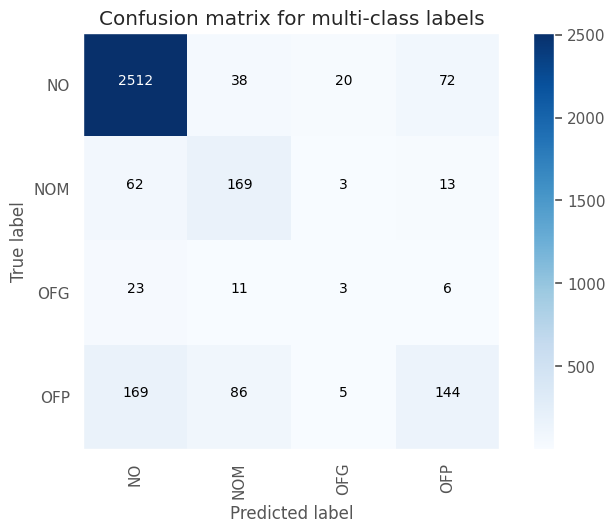

Test Accuracy: 0.8477
Test macro-F1: 0.5186


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5940    0.3535    0.4432       447
     no_hate     0.9059    0.9626    0.9334      2889

    accuracy                         0.8810      3336
   macro avg     0.7499    0.6580    0.6883      3336
weighted avg     0.8641    0.8810    0.8677      3336



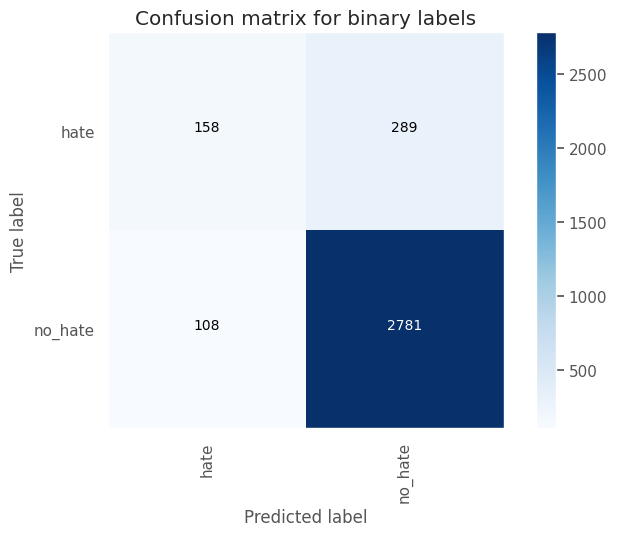

Test Accuracy: 0.881
Test macro-F1: 0.6883




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_141 (Embedding)   (None, 128, 50)           500050    
                                                                 
 dropout_383 (Dropout)       (None, 128, 50)           0         
                                                                 
 conv1d_153 (Conv1D)         (None, 126, 32)           4832      
                                                                 
 max_pooling1d_153 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_384 (Dropout)       (None, 42, 32)           

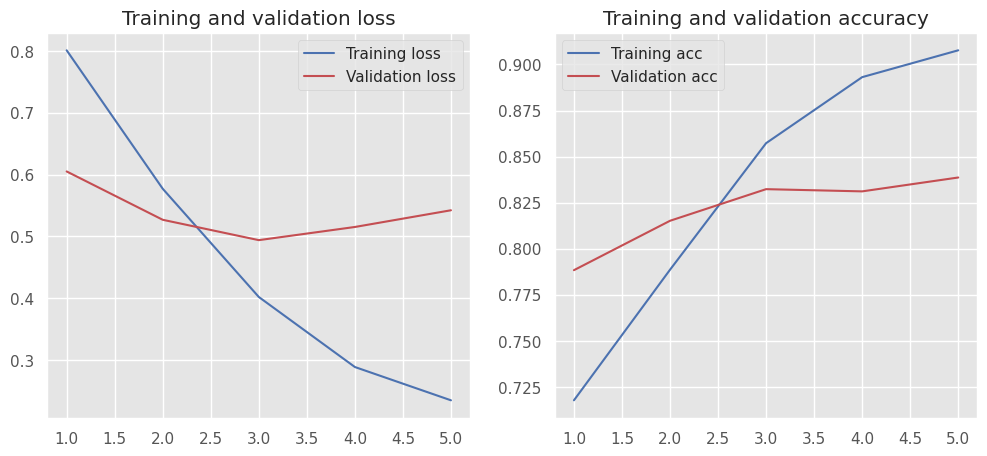

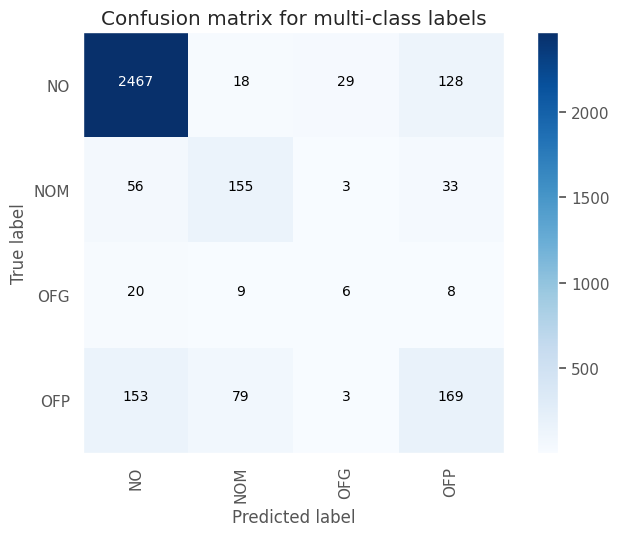

Test Accuracy: 0.8384
Test macro-F1: 0.5332


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4908    0.4161    0.4504       447
     no_hate     0.9117    0.9332    0.9223      2889

    accuracy                         0.8639      3336
   macro avg     0.7013    0.6747    0.6864      3336
weighted avg     0.8553    0.8639    0.8591      3336



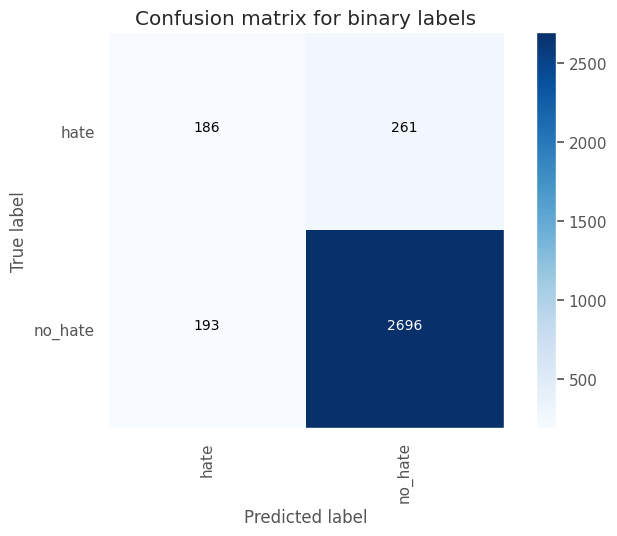

Test Accuracy: 0.8639
Test macro-F1: 0.6864




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_142 (Embedding)   (None, 128, 50)           500050    
                                                                 
 dropout_386 (Dropout)       (None, 128, 50)           0         
                                                                 
 conv1d_154 (Conv1D)         (None, 126, 32)           4832      
                                                                 
 max_pooling1d_154 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_387 (Dropout)       (None, 42, 32)          

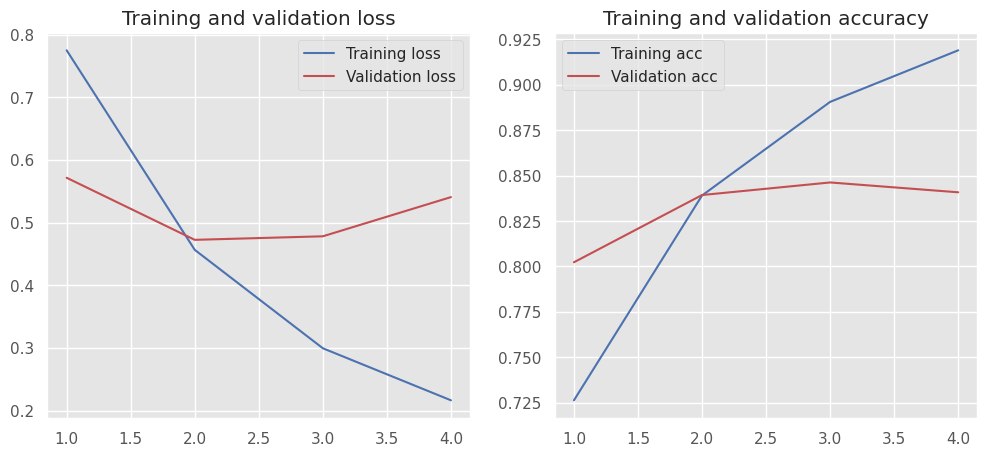

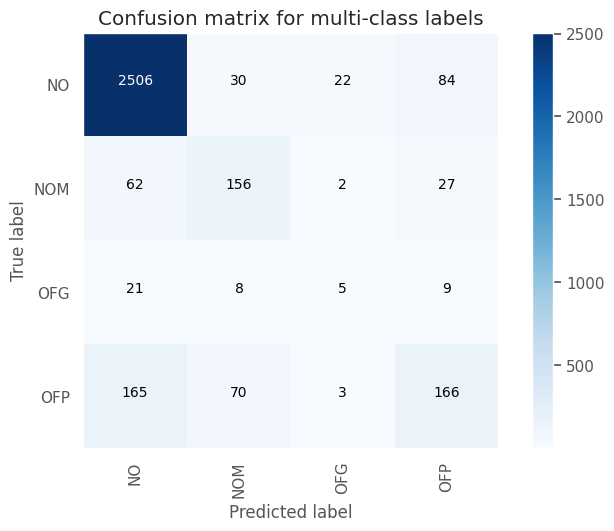

Test Accuracy: 0.8492
Test macro-F1: 0.5385


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5755    0.4094    0.4784       447
     no_hate     0.9125    0.9533    0.9325      2889

    accuracy                         0.8804      3336
   macro avg     0.7440    0.6813    0.7054      3336
weighted avg     0.8674    0.8804    0.8716      3336



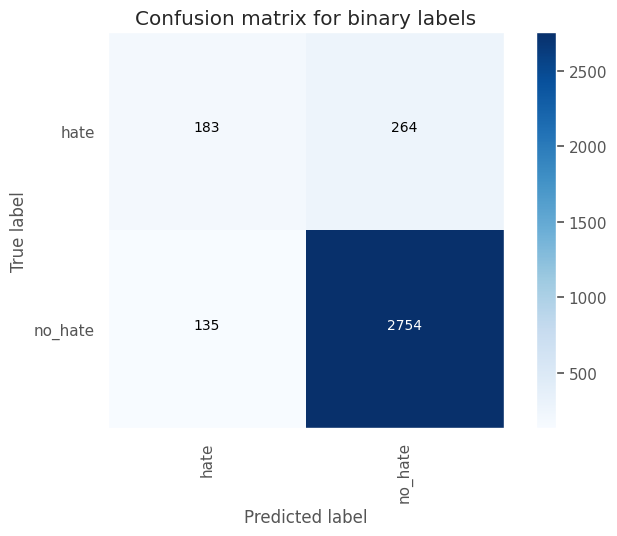

Test Accuracy: 0.8804
Test macro-F1: 0.7054




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_143 (Embedding)   (None, 128, 50)           500050    
                                                                 
 dropout_389 (Dropout)       (None, 128, 50)           0         
                                                                 
 conv1d_155 (Conv1D)         (None, 126, 32)           4832      
                                                                 
 max_pooling1d_155 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_390 (Dropout)       (None, 42, 32)          

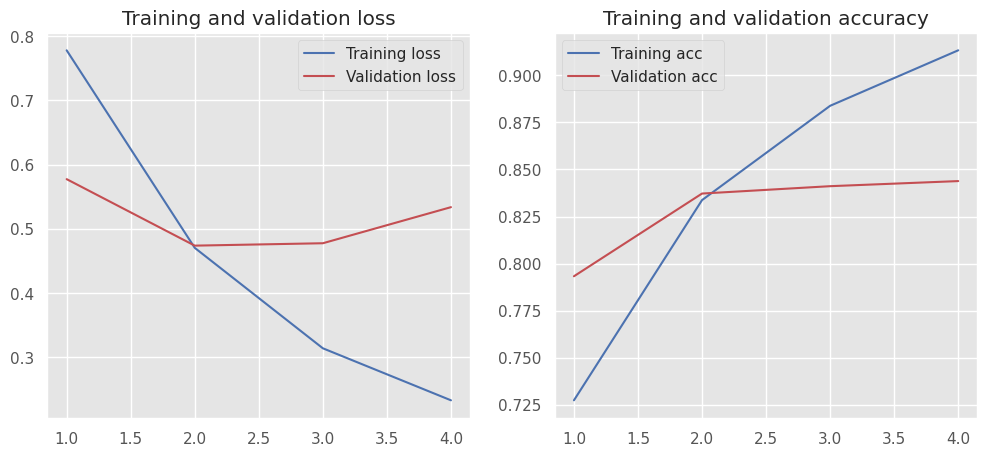

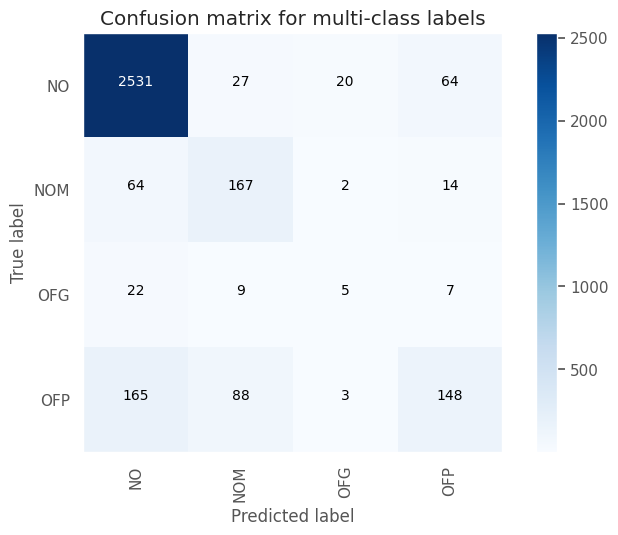

Test Accuracy: 0.8546
Test macro-F1: 0.5389


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6198    0.3647    0.4592       447
     no_hate     0.9076    0.9654    0.9356      2889

    accuracy                         0.8849      3336
   macro avg     0.7637    0.6650    0.6974      3336
weighted avg     0.8690    0.8849    0.8718      3336



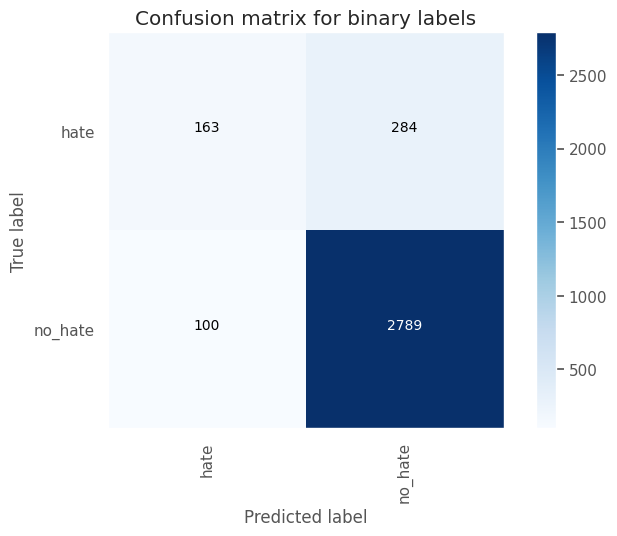

Test Accuracy: 0.8849
Test macro-F1: 0.6974




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_144 (Embedding)   (None, 128, 50)           500050    
                                                                 
 dropout_392 (Dropout)       (None, 128, 50)           0         
                                                                 
 conv1d_156 (Conv1D)         (None, 126, 32)           4832      
                                                                 
 max_pooling1d_156 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_393 (Dropout)       (None, 42, 32)          

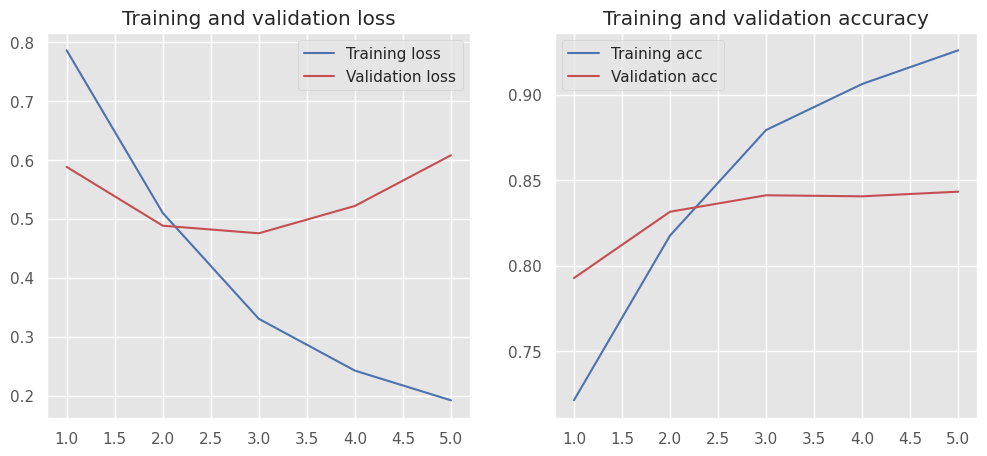

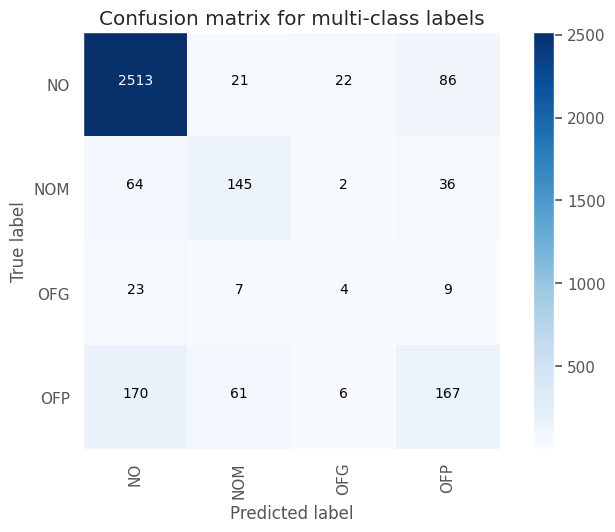

Test Accuracy: 0.848
Test macro-F1: 0.5278


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5602    0.4161    0.4775       447
     no_hate     0.9131    0.9495    0.9309      2889

    accuracy                         0.8780      3336
   macro avg     0.7367    0.6828    0.7042      3336
weighted avg     0.8658    0.8780    0.8702      3336



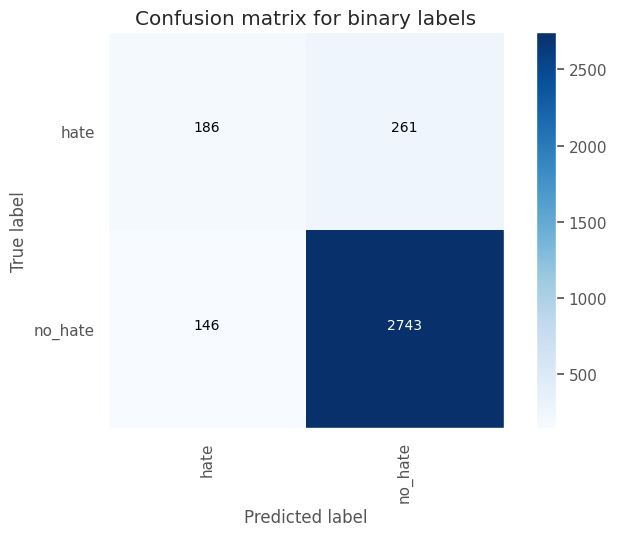

Test Accuracy: 0.878
Test macro-F1: 0.7042




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_145 (Embedding)   (None, 128, 50)           500050    
                                                                 
 dropout_395 (Dropout)       (None, 128, 50)           0         
                                                                 
 conv1d_157 (Conv1D)         (None, 126, 32)           4832      
                                                                 
 max_pooling1d_157 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_396 (Dropout)       (None, 42, 32)           

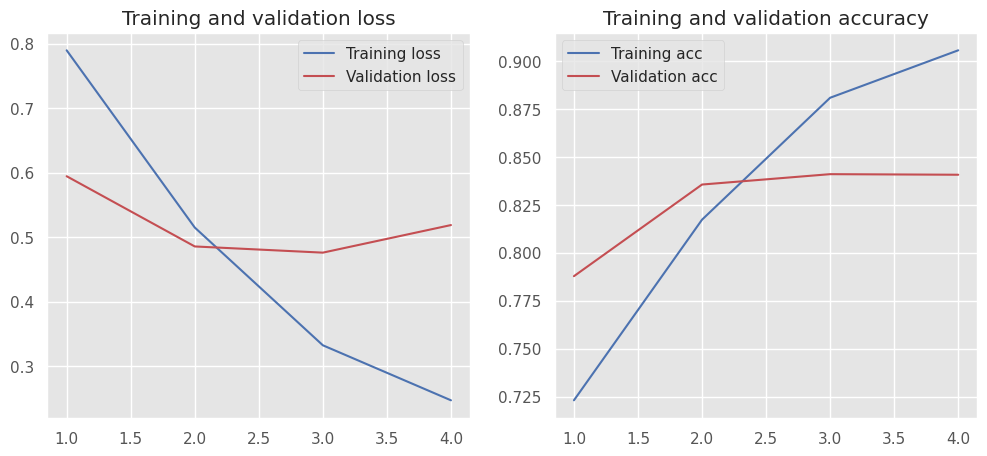

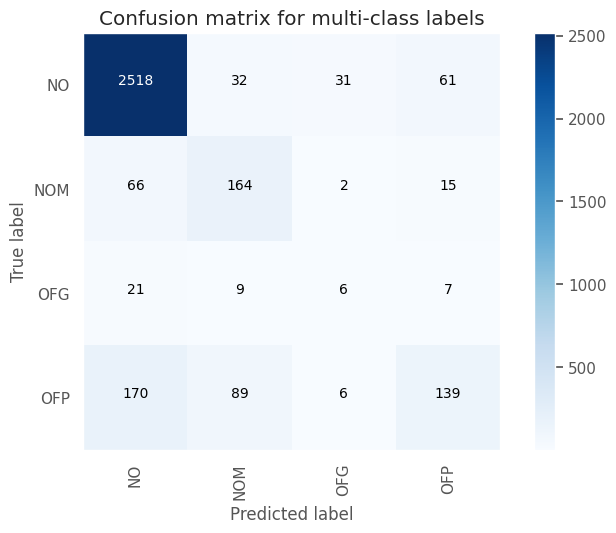

Test Accuracy: 0.8474
Test macro-F1: 0.5291


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5918    0.3535    0.4426       447
     no_hate     0.9058    0.9623    0.9332      2889

    accuracy                         0.8807      3336
   macro avg     0.7488    0.6579    0.6879      3336
weighted avg     0.8637    0.8807    0.8675      3336



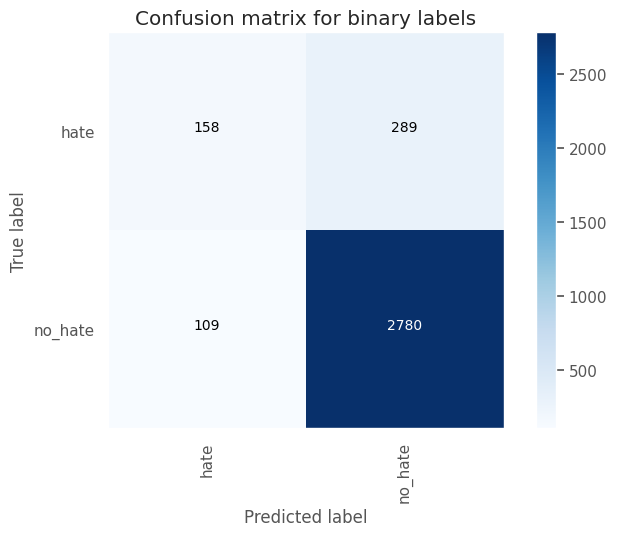

Test Accuracy: 0.8807
Test macro-F1: 0.6879




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_146 (Embedding)   (None, 128, 50)           500050    
                                                                 
 dropout_398 (Dropout)       (None, 128, 50)           0         
                                                                 
 conv1d_158 (Conv1D)         (None, 126, 64)           9664      
                                                                 
 max_pooling1d_158 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_399 (Dropout)       (None, 42, 64)          

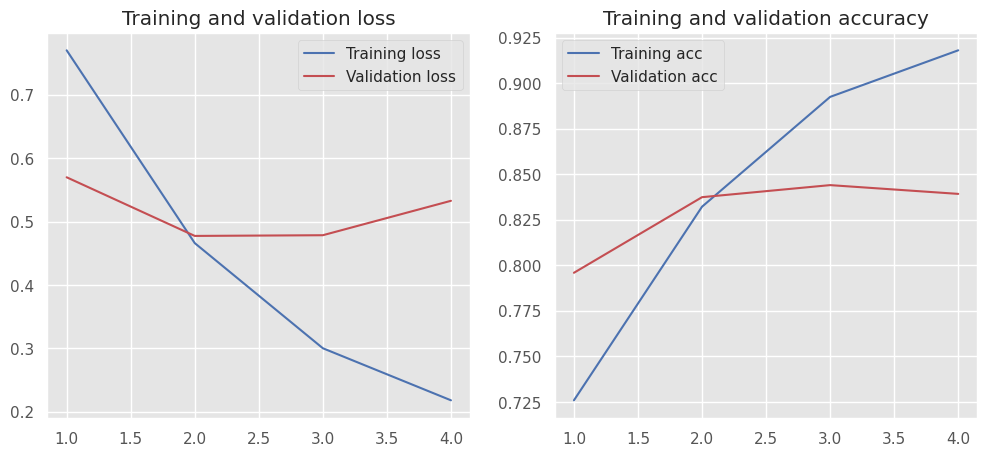

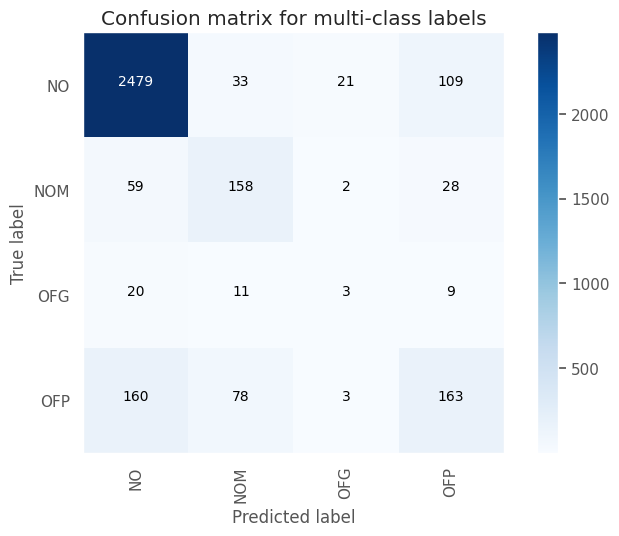

Test Accuracy: 0.8402
Test macro-F1: 0.5163


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5266    0.3982    0.4535       447
     no_hate     0.9103    0.9446    0.9271      2889

    accuracy                         0.8714      3336
   macro avg     0.7185    0.6714    0.6903      3336
weighted avg     0.8589    0.8714    0.8637      3336



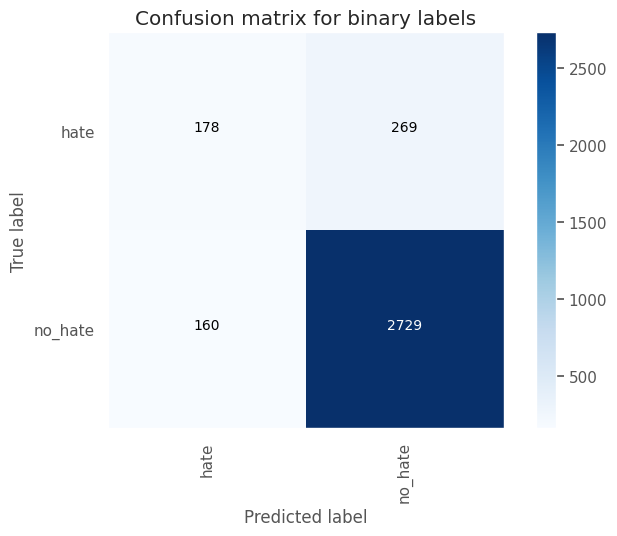

Test Accuracy: 0.8714
Test macro-F1: 0.6903




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_147 (Embedding)   (None, 128, 50)           500050    
                                                                 
 dropout_401 (Dropout)       (None, 128, 50)           0         
                                                                 
 conv1d_159 (Conv1D)         (None, 126, 64)           9664      
                                                                 
 max_pooling1d_159 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_402 (Dropout)       (None, 42, 64)          

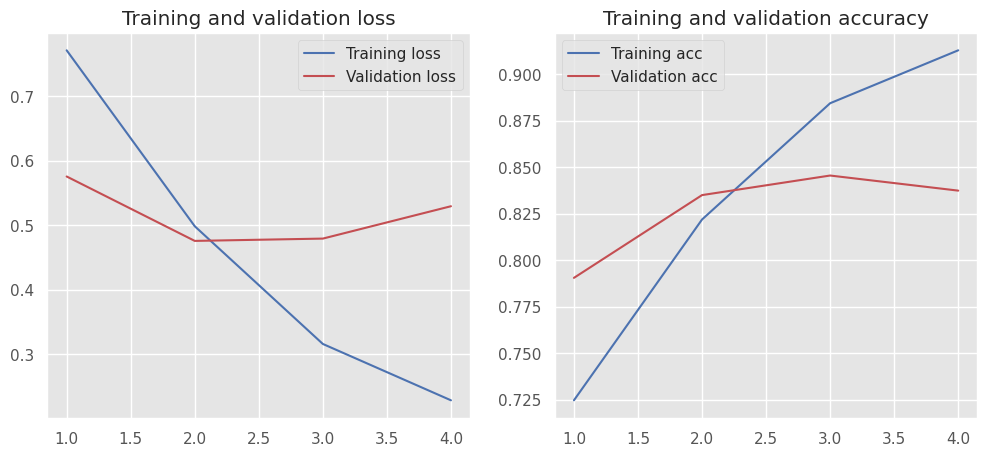

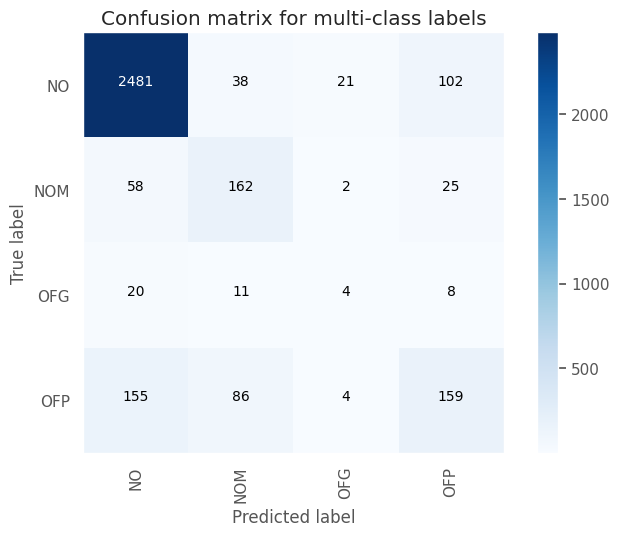

Test Accuracy: 0.8411
Test macro-F1: 0.5214


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5385    0.3915    0.4534       447
     no_hate     0.9097    0.9481    0.9285      2889

    accuracy                         0.8735      3336
   macro avg     0.7241    0.6698    0.6909      3336
weighted avg     0.8599    0.8735    0.8648      3336



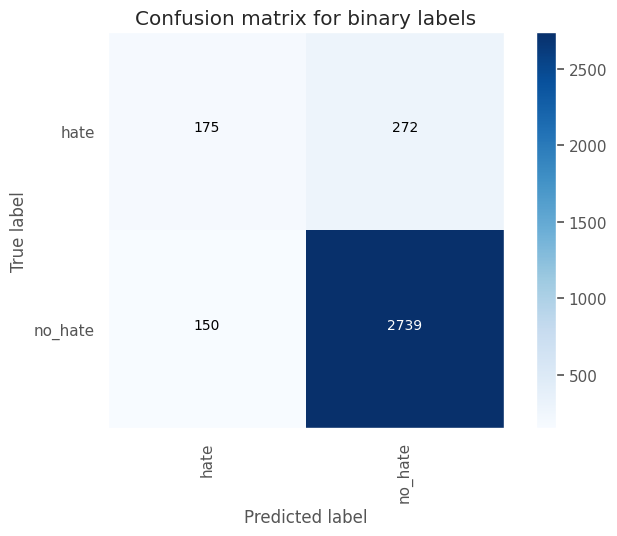

Test Accuracy: 0.8735
Test macro-F1: 0.6909




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_148 (Embedding)   (None, 128, 50)           500050    
                                                                 
 dropout_404 (Dropout)       (None, 128, 50)           0         
                                                                 
 conv1d_160 (Conv1D)         (None, 126, 64)           9664      
                                                                 
 max_pooling1d_160 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_405 (Dropout)       (None, 42, 64)          

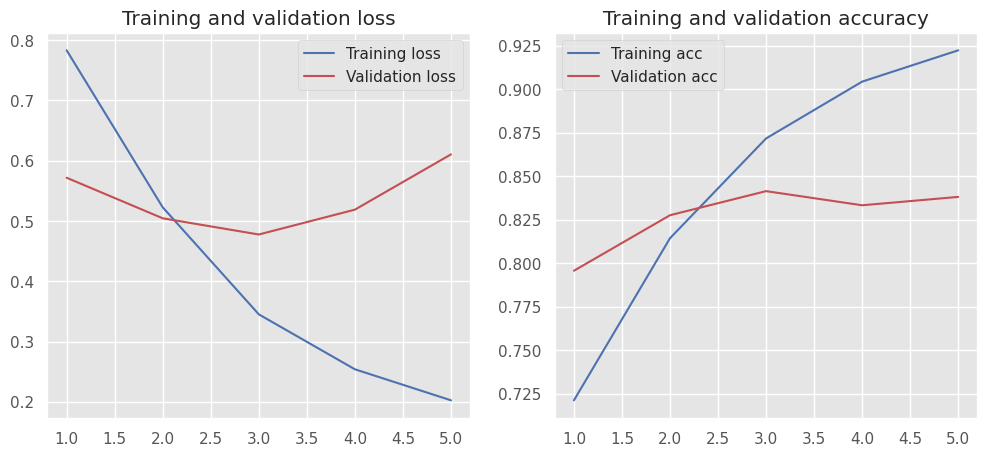

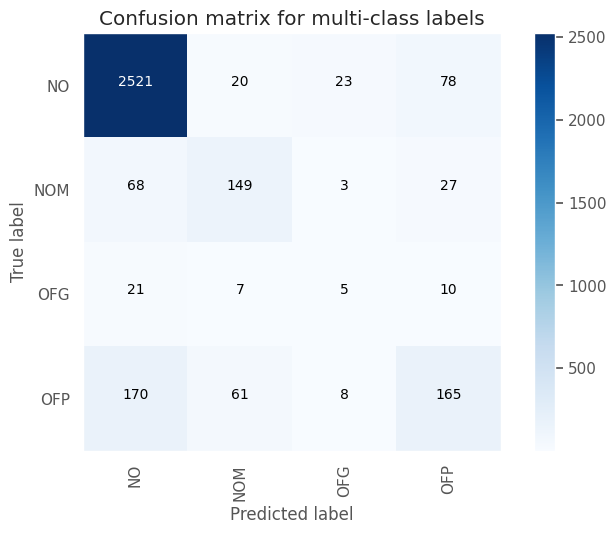

Test Accuracy: 0.8513
Test macro-F1: 0.5375


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5893    0.4206    0.4909       447
     no_hate     0.9142    0.9547    0.9340      2889

    accuracy                         0.8831      3336
   macro avg     0.7517    0.6876    0.7124      3336
weighted avg     0.8706    0.8831    0.8746      3336



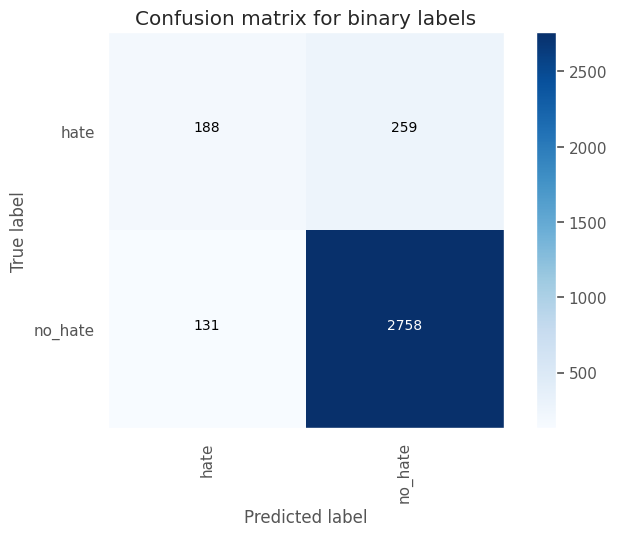

Test Accuracy: 0.8831
Test macro-F1: 0.7124




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_149 (Embedding)   (None, 128, 50)           500050    
                                                                 
 dropout_407 (Dropout)       (None, 128, 50)           0         
                                                                 
 conv1d_161 (Conv1D)         (None, 126, 64)           9664      
                                                                 
 max_pooling1d_161 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_408 (Dropout)       (None, 42, 64)          

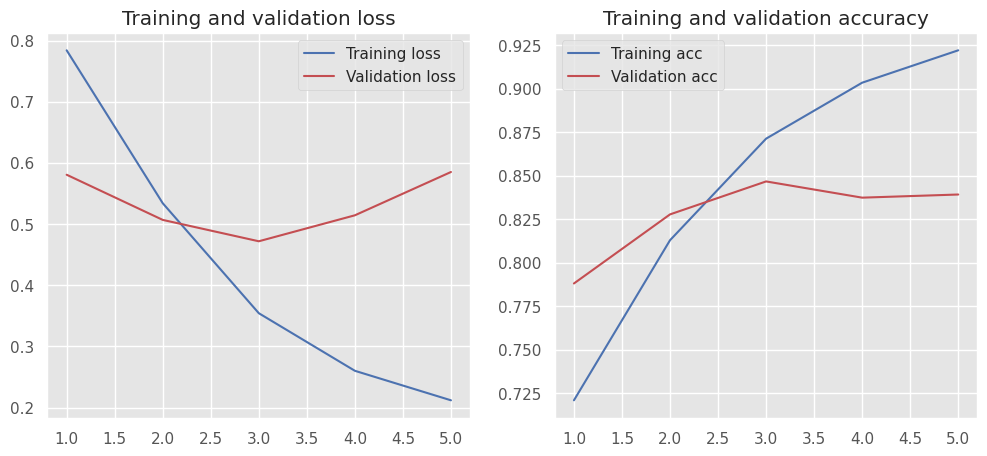

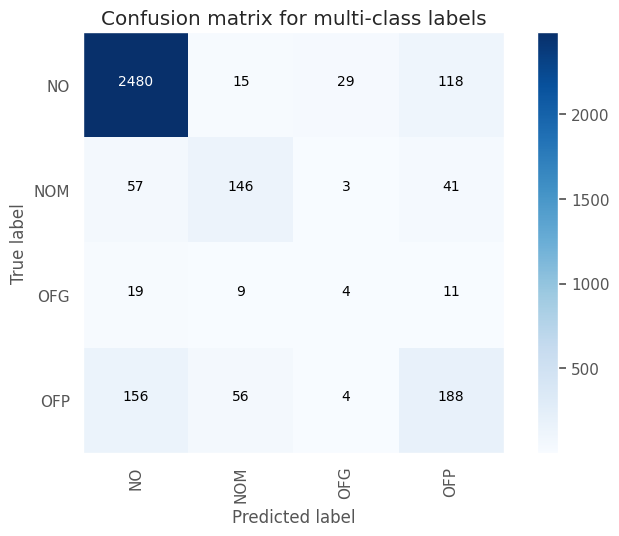

Test Accuracy: 0.8447
Test macro-F1: 0.5334


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5201    0.4631    0.4899       447
     no_hate     0.9183    0.9339    0.9260      2889

    accuracy                         0.8708      3336
   macro avg     0.7192    0.6985    0.7080      3336
weighted avg     0.8650    0.8708    0.8676      3336



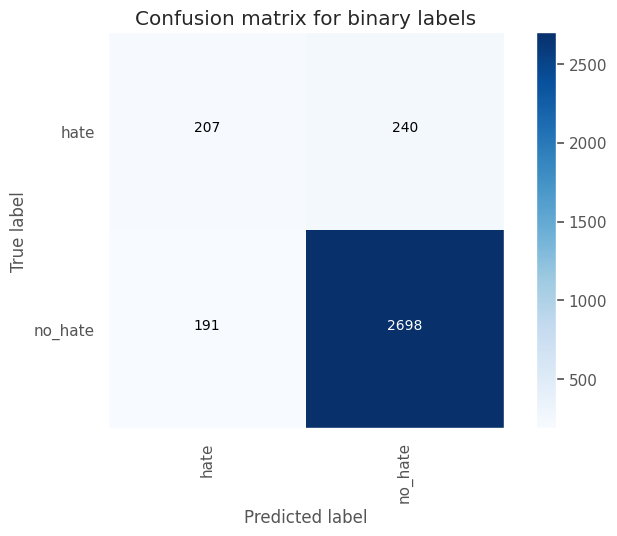

Test Accuracy: 0.8708
Test macro-F1: 0.708




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_150 (Embedding)   (None, 128, 50)           500050    
                                                                 
 dropout_410 (Dropout)       (None, 128, 50)           0         
                                                                 
 conv1d_162 (Conv1D)         (None, 126, 64)           9664      
                                                                 
 max_pooling1d_162 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_411 (Dropout)       (None, 42, 64)           

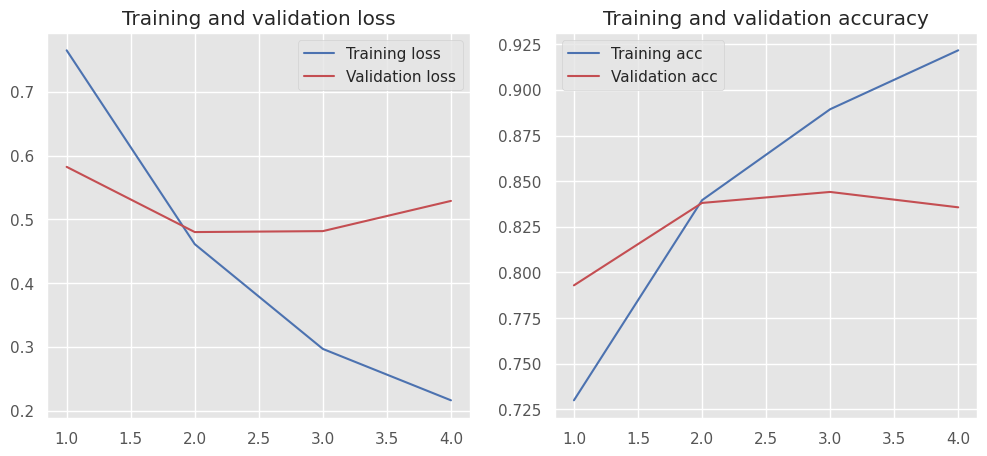

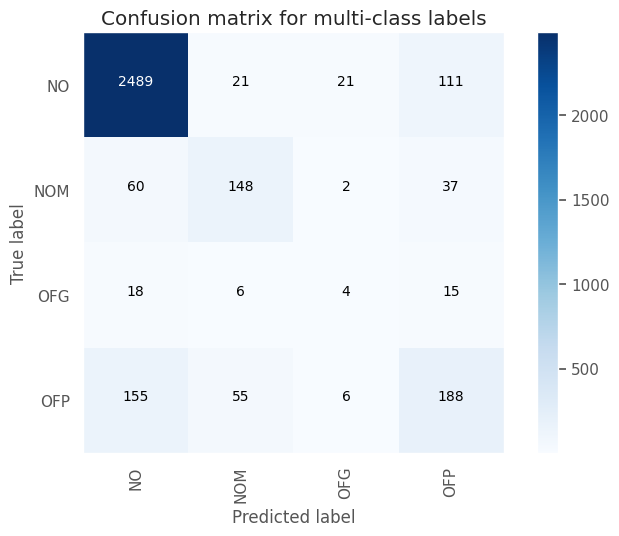

Test Accuracy: 0.848
Test macro-F1: 0.538


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5547    0.4765    0.5126       447
     no_hate     0.9207    0.9408    0.9307      2889

    accuracy                         0.8786      3336
   macro avg     0.7377    0.7087    0.7216      3336
weighted avg     0.8717    0.8786    0.8746      3336



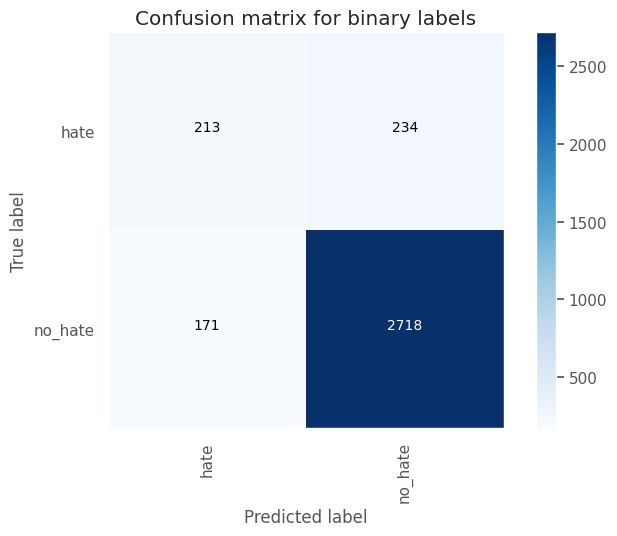

Test Accuracy: 0.8786
Test macro-F1: 0.7216




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_151 (Embedding)   (None, 128, 50)           500050    
                                                                 
 dropout_413 (Dropout)       (None, 128, 50)           0         
                                                                 
 conv1d_163 (Conv1D)         (None, 126, 64)           9664      
                                                                 
 max_pooling1d_163 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_414 (Dropout)       (None, 42, 64)          

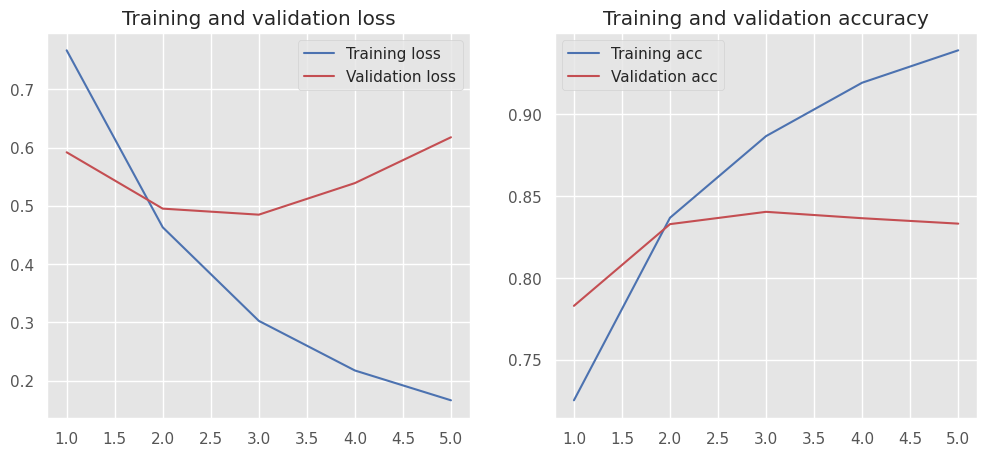

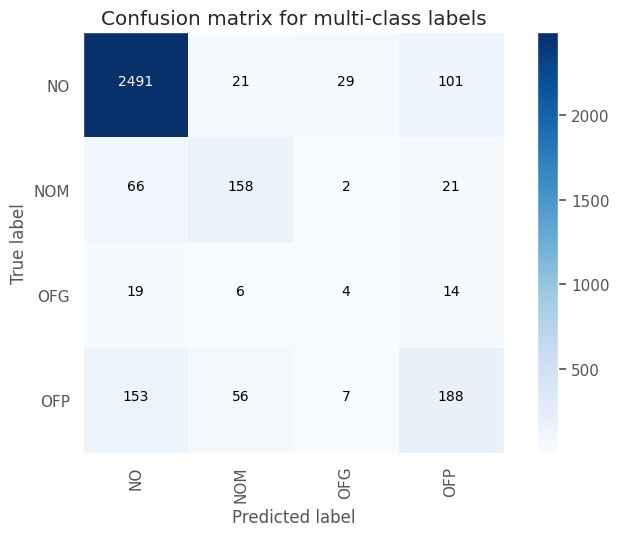

Test Accuracy: 0.8516
Test macro-F1: 0.5464


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5820    0.4765    0.5240       447
     no_hate     0.9212    0.9470    0.9339      2889

    accuracy                         0.8840      3336
   macro avg     0.7516    0.7118    0.7290      3336
weighted avg     0.8758    0.8840    0.8790      3336



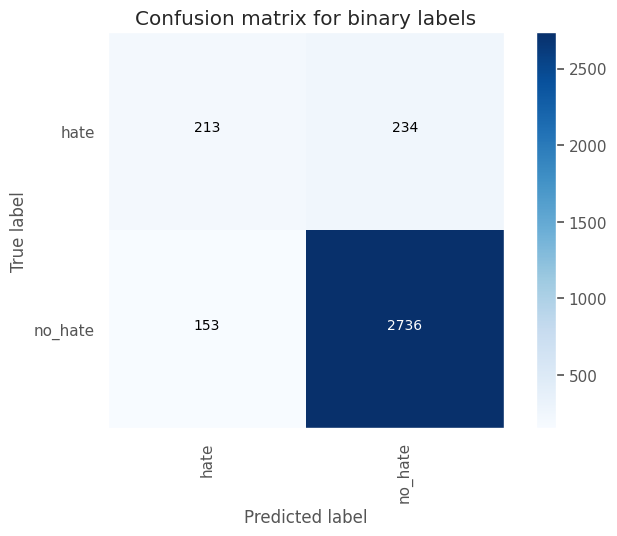

Test Accuracy: 0.884
Test macro-F1: 0.729




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_152 (Embedding)   (None, 128, 50)           500050    
                                                                 
 dropout_416 (Dropout)       (None, 128, 50)           0         
                                                                 
 conv1d_164 (Conv1D)         (None, 126, 64)           9664      
                                                                 
 max_pooling1d_164 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_417 (Dropout)       (None, 42, 64)            

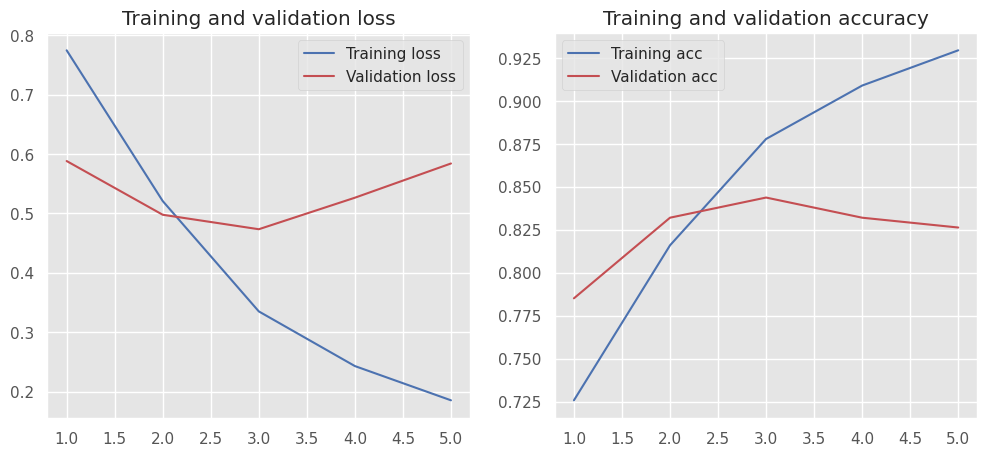

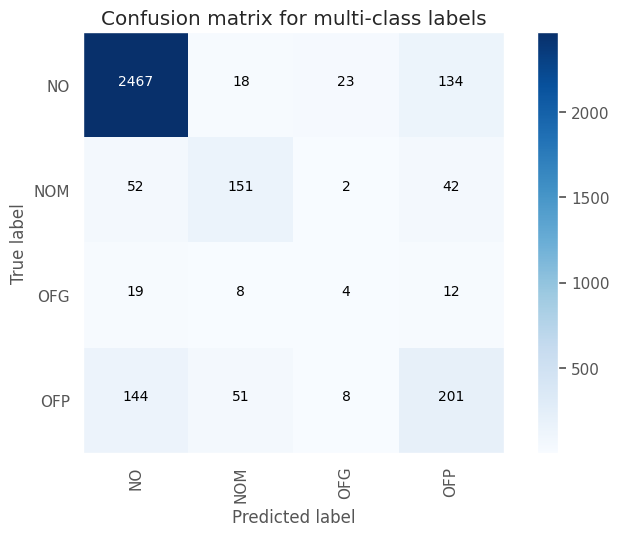

Test Accuracy: 0.8462
Test macro-F1: 0.5424


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5282    0.5034    0.5155       447
     no_hate     0.9237    0.9304    0.9271      2889

    accuracy                         0.8732      3336
   macro avg     0.7259    0.7169    0.7213      3336
weighted avg     0.8707    0.8732    0.8719      3336



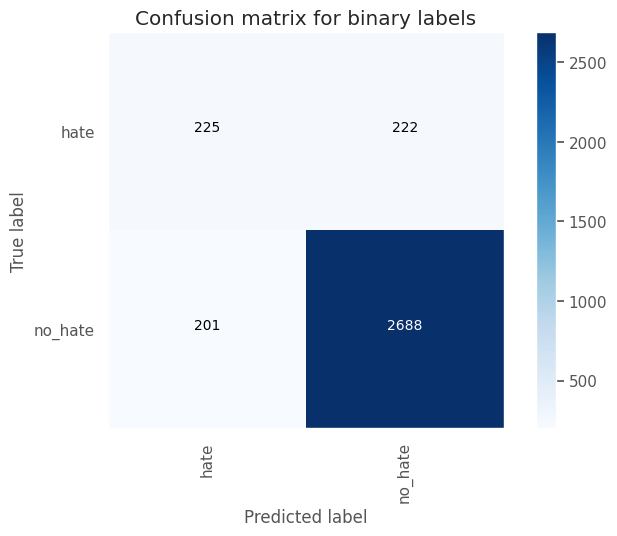

Test Accuracy: 0.8732
Test macro-F1: 0.7213




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_153 (Embedding)   (None, 128, 50)           500050    
                                                                 
 dropout_419 (Dropout)       (None, 128, 50)           0         
                                                                 
 conv1d_165 (Conv1D)         (None, 126, 64)           9664      
                                                                 
 max_pooling1d_165 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_420 (Dropout)       (None, 42, 64)          

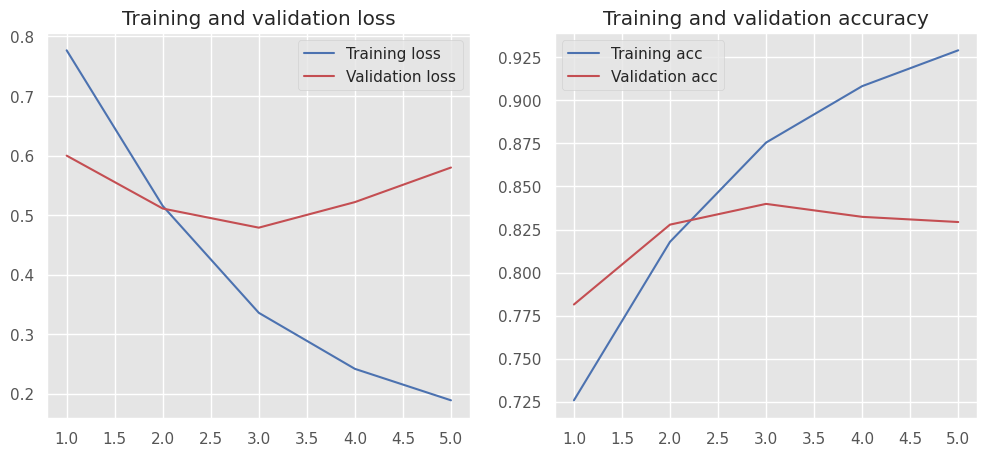

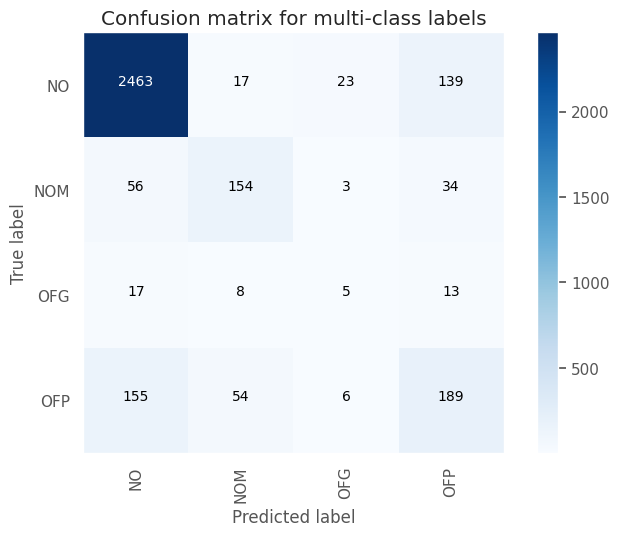

Test Accuracy: 0.8426
Test macro-F1: 0.5439


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5170    0.4765    0.4959       447
     no_hate     0.9200    0.9311    0.9255      2889

    accuracy                         0.8702      3336
   macro avg     0.7185    0.7038    0.7107      3336
weighted avg     0.8660    0.8702    0.8680      3336



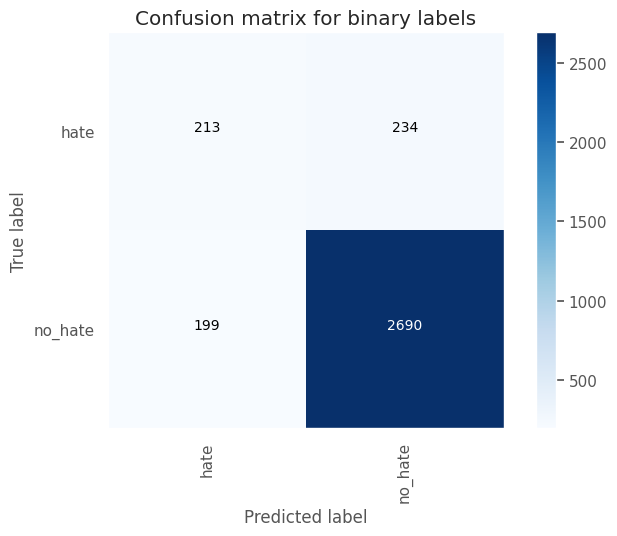

Test Accuracy: 0.8702
Test macro-F1: 0.7107







<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>13</th>
      <td>v6</td>
      <td>{'embedding_151': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_413': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_163': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_163': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_414': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_146': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_302': {'class_name': 'Dense', 'param_count': 344192, 'input': (None, 2688), 'output': (None, 128)}, 'dropout_415': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_303': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>854422</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5610</td>
      <td>0.5352</td>
      <td>0.5464</td>
      <td>0.7516</td>
      <td>0.7118</td>
      <td>0.7290</td>
    </tr>
    <tr>
      <th>15</th>
      <td>v6</td>
      <td>{'embedding_153': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_419': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_165': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_165': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_420': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_148': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_306': {'class_name': 'Dense', 'param_count': 344192, 'input': (None, 2688), 'output': (None, 128)}, 'dropout_421': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_307': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>854422</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5538</td>
      <td>0.5350</td>
      <td>0.5439</td>
      <td>0.7185</td>
      <td>0.7038</td>
      <td>0.7107</td>
    </tr>
    <tr>
      <th>14</th>
      <td>v6</td>
      <td>{'embedding_152': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_416': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_164': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_164': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_417': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_147': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_304': {'class_name': 'Dense', 'param_count': 344192, 'input': (None, 2688), 'output': (None, 128)}, 'dropout_418': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_305': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>854422</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5517</td>
      <td>0.5339</td>
      <td>0.5424</td>
      <td>0.7259</td>
      <td>0.7169</td>
      <td>0.7213</td>
    </tr>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_138': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_374': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_150': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_150': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_375': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_133': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_276': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_376': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_277': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>591222</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5602</td>
      <td>0.5280</td>
      <td>0.5398</td>
      <td>0.7266</td>
      <td>0.6750</td>
      <td>0.6955</td>
    </tr>
    <tr>
      <th>5</th>
      <td>v6</td>
      <td>{'embedding_143': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_389': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_155': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_155': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_390': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_138': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_286': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dropout_391': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_287': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>677558</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5714</td>
      <td>0.5292</td>
      <td>0.5389</td>
      <td>0.7637</td>
      <td>0.6650</td>
      <td>0.6974</td>
    </tr>
    <tr>
      <th>4</th>
      <td>v6</td>
      <td>{'embedding_142': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_386': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_154': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_154': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_387': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_137': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_284': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dropout_388': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_285': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>677558</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5594</td>
      <td>0.5268</td>
      <td>0.5385</td>
      <td>0.7440</td>
      <td>0.6813</td>
      <td>0.7054</td>
    </tr>
    <tr>
      <th>12</th>
      <td>v6</td>
      <td>{'embedding_150': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_410': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_162': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_162': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_411': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_145': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_300': {'class_name': 'Dense', 'param_count': 344192, 'input': (None, 2688), 'output': (None, 128)}, 'dropout_412': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_301': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>854422</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5537</td>
      <td>0.5249</td>
      <td>0.5380</td>
      <td>0.7377</td>
      <td>0.7087</td>
      <td>0.7216</td>
    </tr>
    <tr>
      <th>10</th>
      <td>v6</td>
      <td>{'embedding_148': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_404': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_160': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_160': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_405': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_143': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_296': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_406': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_297': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>682070</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5633</td>
      <td>0.5205</td>
      <td>0.5375</td>
      <td>0.7517</td>
      <td>0.6876</td>
      <td>0.7124</td>
    </tr>
    <tr>
      <th>11</th>
      <td>v6</td>
      <td>{'embedding_149': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_407': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_161': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_161': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_408': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_144': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_298': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_409': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_299': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>682070</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5464</td>
      <td>0.5220</td>
      <td>0.5334</td>
      <td>0.7192</td>
      <td>0.6985</td>
      <td>0.7080</td>
    </tr>
    <tr>
      <th>3</th>
      <td>v6</td>
      <td>{'embedding_141': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_383': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_153': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_153': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_384': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_136': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_282': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_385': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_283': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>591222</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5388</td>
      <td>0.5298</td>
      <td>0.5332</td>
      <td>0.7013</td>
      <td>0.6747</td>
      <td>0.6864</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_139': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_377': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_151': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_151': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_378': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_134': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_278': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_379': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_279': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>591222</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5501</td>
      <td>0.5222</td>
      <td>0.5319</td>
      <td>0.7352</td>
      <td>0.6777</td>
      <td>0.7001</td>
    </tr>
    <tr>
      <th>7</th>
      <td>v6</td>
      <td>{'embedding_145': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_395': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_157': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_157': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_396': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_140': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_290': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dropout_397': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_291': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>677558</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5562</td>
      <td>0.5252</td>
      <td>0.5291</td>
      <td>0.7488</td>
      <td>0.6579</td>
      <td>0.6879</td>
    </tr>
    <tr>
      <th>6</th>
      <td>v6</td>
      <td>{'embedding_144': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_392': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_156': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_156': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_393': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_139': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_288': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dropout_394': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_289': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>677558</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5512</td>
      <td>0.5112</td>
      <td>0.5278</td>
      <td>0.7367</td>
      <td>0.6828</td>
      <td>0.7042</td>
    </tr>
    <tr>
      <th>9</th>
      <td>v6</td>
      <td>{'embedding_147': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_401': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_159': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_159': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_402': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_142': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_294': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_403': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_295': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>682070</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5324</td>
      <td>0.5204</td>
      <td>0.5214</td>
      <td>0.7241</td>
      <td>0.6698</td>
      <td>0.6909</td>
    </tr>
    <tr>
      <th>2</th>
      <td>v6</td>
      <td>{'embedding_140': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_380': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_152': {'class_name': 'Conv1D', 'param_count': 4832, 'input': (None, 128, 50), 'output': (None, 126, 32)}, 'max_pooling1d_152': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_381': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_135': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_280': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_382': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_281': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>591222</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5434</td>
      <td>0.5153</td>
      <td>0.5186</td>
      <td>0.7499</td>
      <td>0.6580</td>
      <td>0.6883</td>
    </tr>
    <tr>
      <th>8</th>
      <td>v6</td>
      <td>{'embedding_146': {'class_name': 'Embedding', 'param_count': 500050, 'input': (None, 128), 'output': (None, 128, 50)}, 'dropout_398': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 50), 'output': (None, 128, 50)}, 'conv1d_158': {'class_name': 'Conv1D', 'param_count': 9664, 'input': (None, 128, 50), 'output': (None, 126, 64)}, 'max_pooling1d_158': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_399': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_141': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_292': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_400': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_293': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>682070</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5268</td>
      <td>0.5128</td>
      <td>0.5163</td>
      <td>0.7185</td>
      <td>0.6714</td>
      <td>0.6903</td>
    </tr>
  </tbody>
</table>
    

In [31]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 50

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

for cnn_filter_dim in [32, 64]:
  for pool_size in [3]:
    for dense_dim in [64, 128]:
      for dp_before_classif_dense in [0.0, 0.3]:
        for dp_after_pool in [0.0, 0.1]:
          # Build CNN model  ===========
          model_config = KerasCNNClassifierModelConfig(
              # General
              vocab_size=vocab_size,
              model_name="cnn_classifier",
              # Embeddings
              embedding_config=EmbeddingConfig(output_dim=embedding_dim, input_length=max_length, trainable=True, pre_trained_matrix=None),
              # CNN Layers
              cnn_filter_dims=[cnn_filter_dim],
              cnn_kernel_sizes=[3],
              cnn_activations=["relu"],
              cnn_stride_sizes=[1],
              cnn_padding=["valid"],
              pool_sizes=[pool_size],
              use_global_pooling=False,
              # Dense layers at the end
              dense_activations=["relu", "softmax"],
              dense_dims=[dense_dim, 4],
              # Dropouts
              dp_after_embedding=0.5,
              dp_after_pooling=[dp_after_pool],
              dp_before_classif_dense=dp_before_classif_dense)
          model: tf.keras.Model = CNNModelFactory.create(model_config)
          # ============================


          # Train  ===========
          trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                    max_input_length=max_length))
          optim_config: OptimizationConfig = OptimizationConfig(
              epochs=25,
              batch_size=32,
              validation_split=0.0,
              validation_data=(x_val, y_val),
              optimizer=Adam(learning_rate=0.001),
              class_weight=None
          )
          trainer.train(x_train=x_train,
                        y_train=y_train,
                        opt_config=optim_config,
                        callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
          mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
          mc_report: dict
          bc_report: dict

          # Accumulate result so it can be plotted
          result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                          dataset_version=dataset_name,
                                          model_params=model.count_params(),
                                          optim_config=optim_config,
                                          macro_prec_mc=mc_report["macro avg"]["precision"],
                                          macro_recall_mc=mc_report["macro avg"]["recall"],
                                          macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                          macro_prec_bc=bc_report["macro avg"]["precision"],
                                          macro_recall_bc=bc_report["macro avg"]["recall"],
                                          macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                          )
          results_rep.accumulate(result)
          # ============================

report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)

No mejoramos los resultados. El óptimo sigue siendo `embedding_dim=100`.

Como ultima prueba, repetiré la misma que nos dio los mejores resultados hasta el momento, pero incrementando el tamaño del vocabulario, para ver si tenemos alguna limitación desde ese lado.

Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_154 (Embedding)   (None, 128, 100)          2000100   
                                                                 
 dropout_422 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_166 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_166 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_4

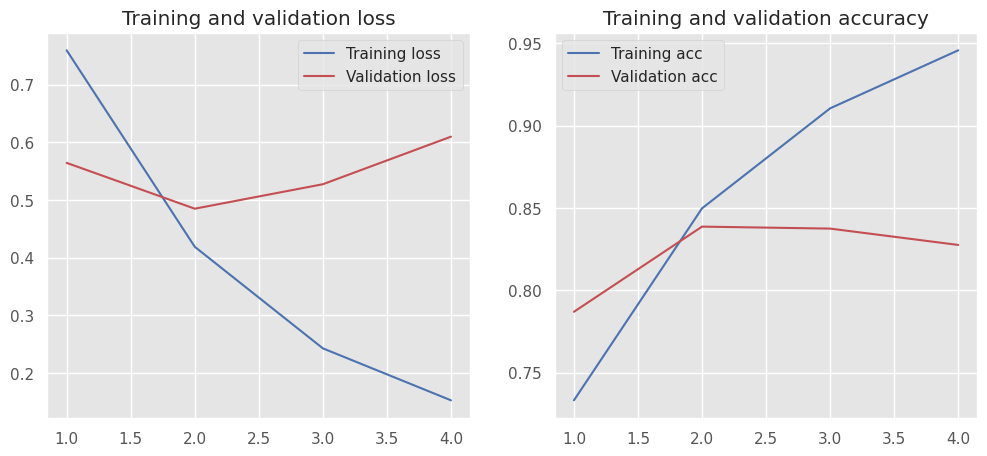

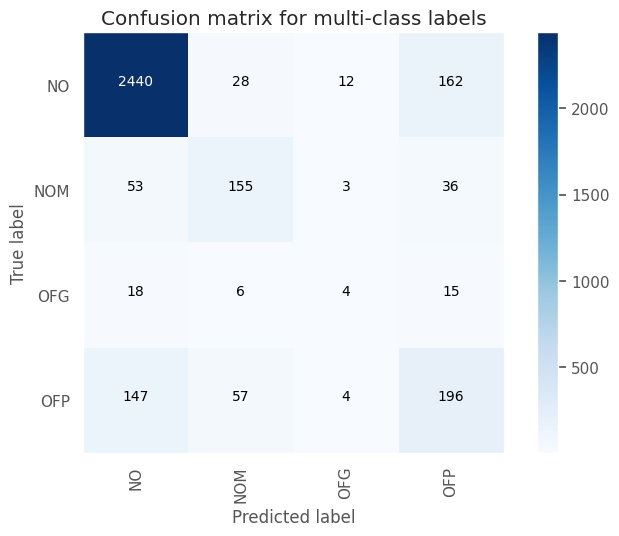

Test Accuracy: 0.8378
Test macro-F1: 0.5382


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5069    0.4899    0.4983       447
     no_hate     0.9215    0.9263    0.9239      2889

    accuracy                         0.8678      3336
   macro avg     0.7142    0.7081    0.7111      3336
weighted avg     0.8659    0.8678    0.8668      3336



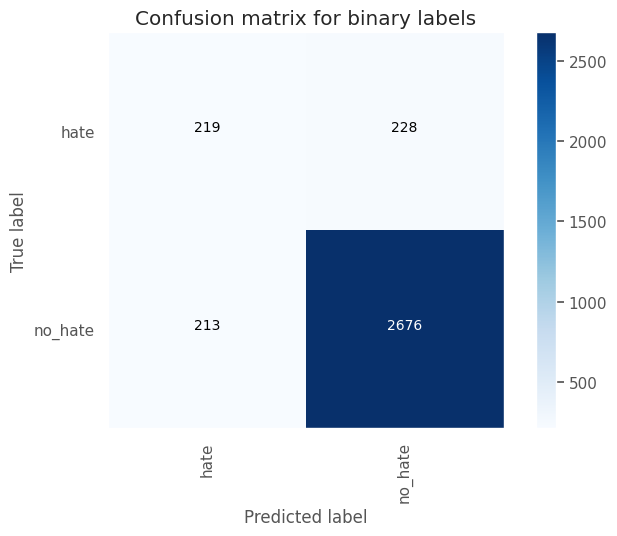

Test Accuracy: 0.8678
Test macro-F1: 0.7111




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_155 (Embedding)   (None, 128, 100)          2000100   
                                                                 
 dropout_425 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_167 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_167 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_426 (Dropout)       (None, 42, 32)          

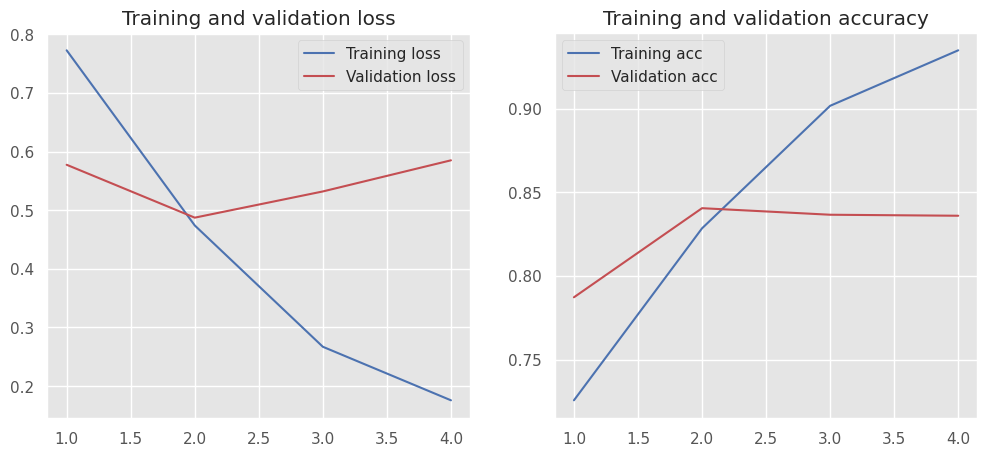

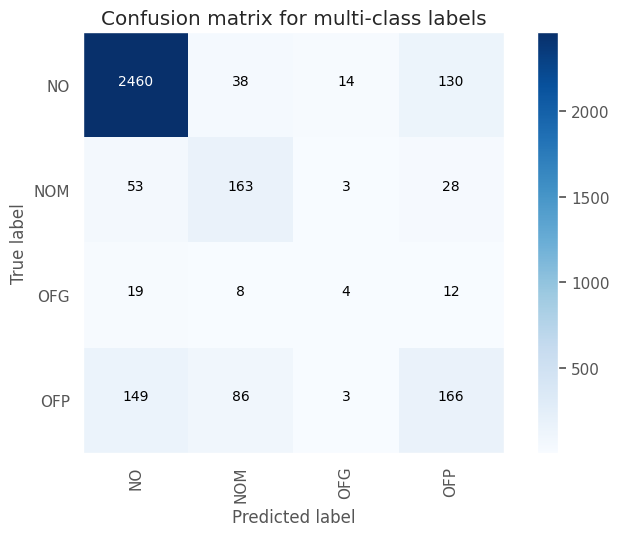

Test Accuracy: 0.8372
Test macro-F1: 0.5235


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5139    0.4139    0.4585       447
     no_hate     0.9120    0.9394    0.9255      2889

    accuracy                         0.8690      3336
   macro avg     0.7129    0.6766    0.6920      3336
weighted avg     0.8586    0.8690    0.8629      3336



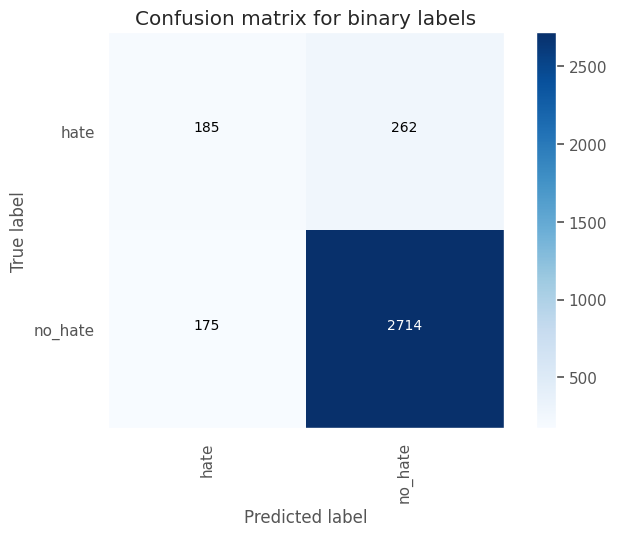

Test Accuracy: 0.869
Test macro-F1: 0.692




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_156 (Embedding)   (None, 128, 100)          2000100   
                                                                 
 dropout_428 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_168 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_168 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_429 (Dropout)       (None, 42, 32)            

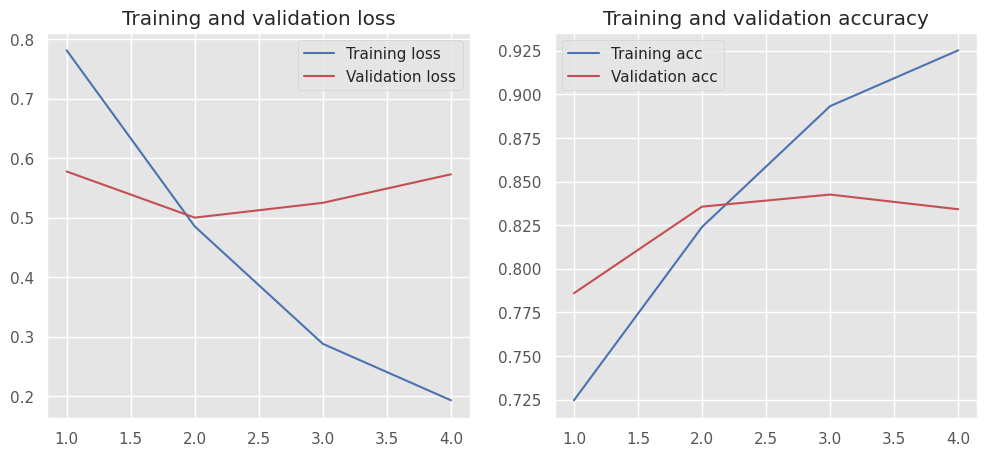

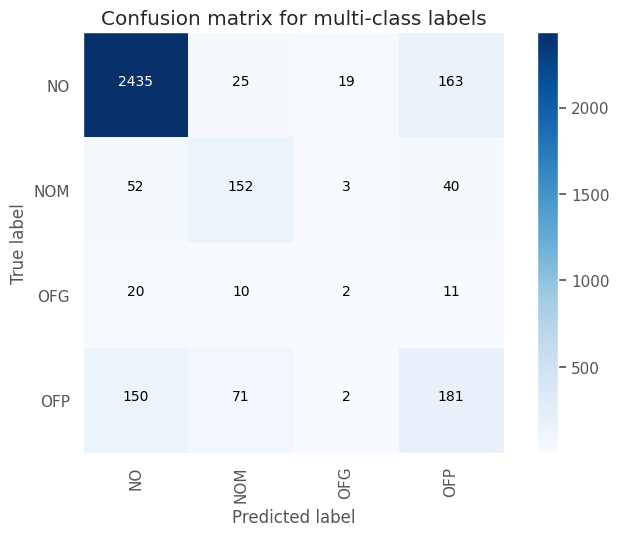

Test Accuracy: 0.8303
Test macro-F1: 0.508


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4656    0.4385    0.4516       447
     no_hate     0.9139    0.9221    0.9180      2889

    accuracy                         0.8573      3336
   macro avg     0.6897    0.6803    0.6848      3336
weighted avg     0.8538    0.8573    0.8555      3336



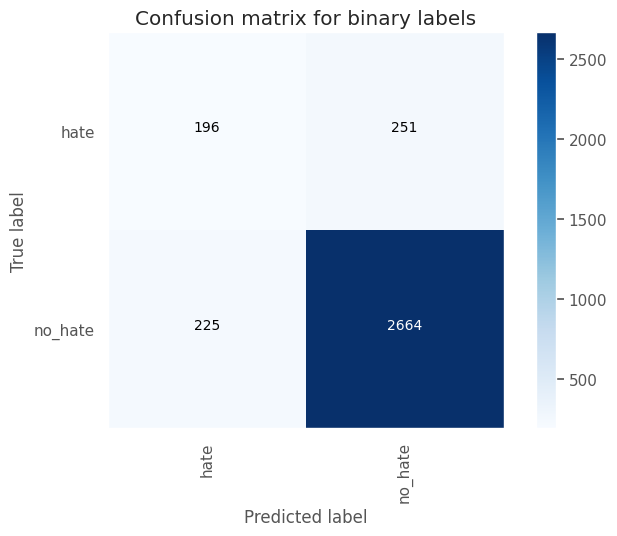

Test Accuracy: 0.8573
Test macro-F1: 0.6848




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_157 (Embedding)   (None, 128, 100)          2000100   
                                                                 
 dropout_431 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_169 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_169 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_432 (Dropout)       (None, 42, 32)          

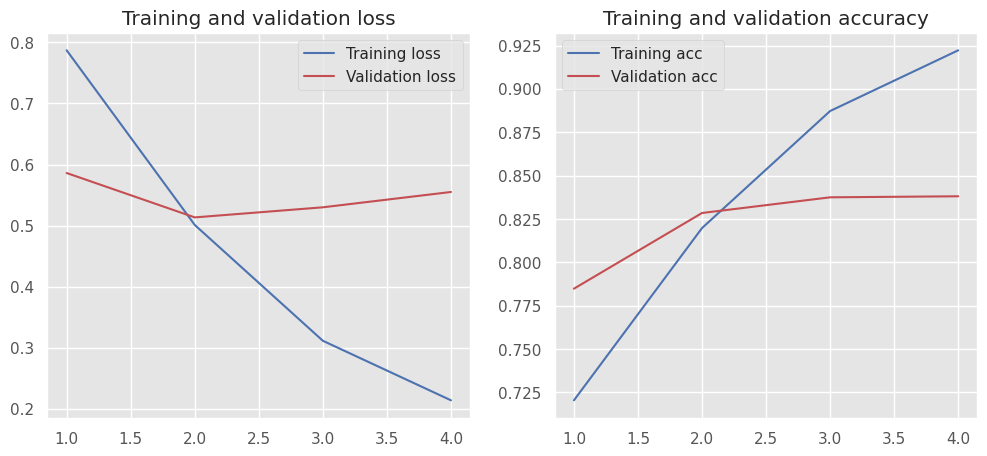

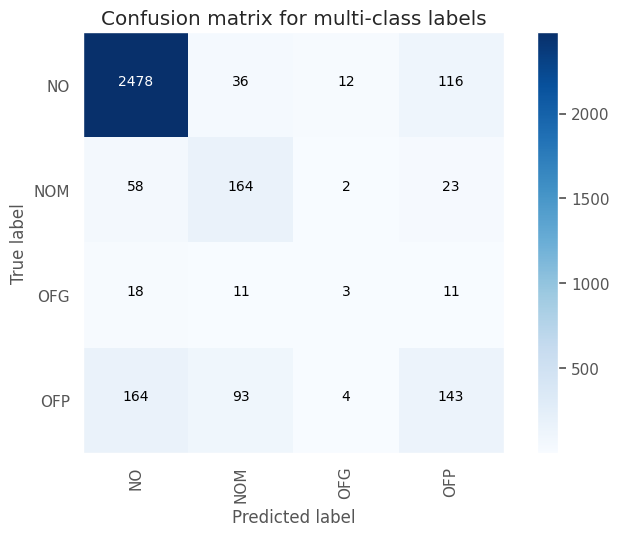

Test Accuracy: 0.8357
Test macro-F1: 0.506


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5127    0.3602    0.4231       447
     no_hate     0.9054    0.9470    0.9257      2889

    accuracy                         0.8684      3336
   macro avg     0.7090    0.6536    0.6744      3336
weighted avg     0.8528    0.8684    0.8584      3336



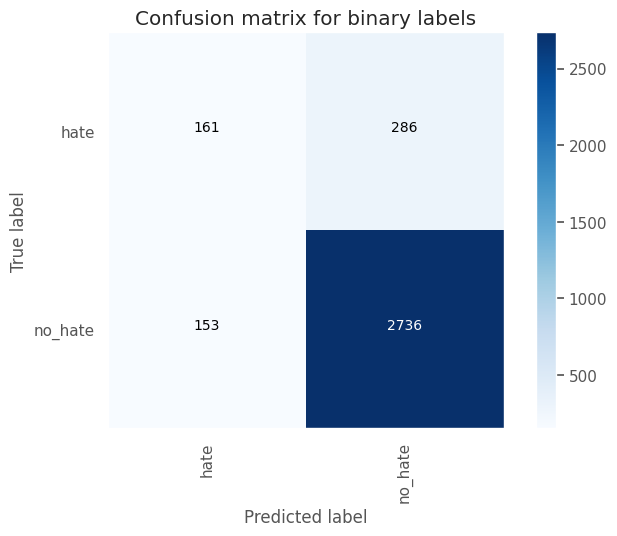

Test Accuracy: 0.8684
Test macro-F1: 0.6744




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_158 (Embedding)   (None, 128, 100)          2000100   
                                                                 
 dropout_434 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_170 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_170 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_435 (Dropout)       (None, 42, 32)          

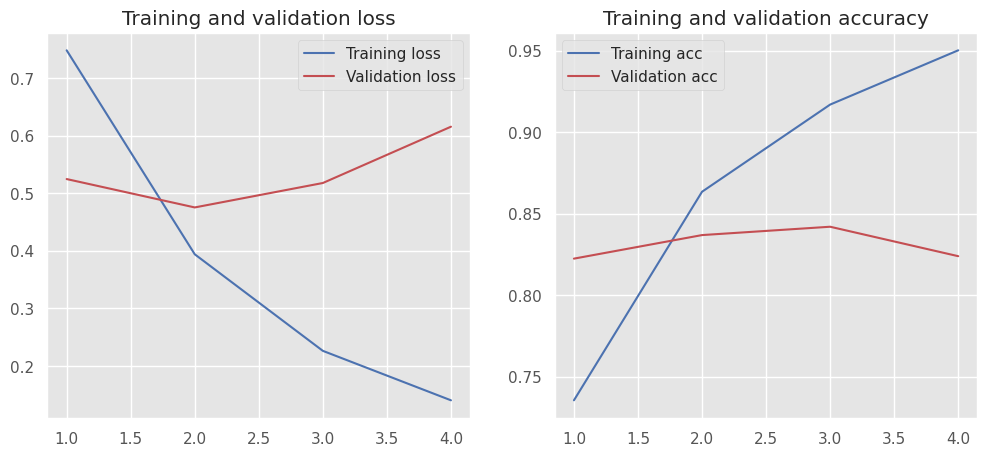

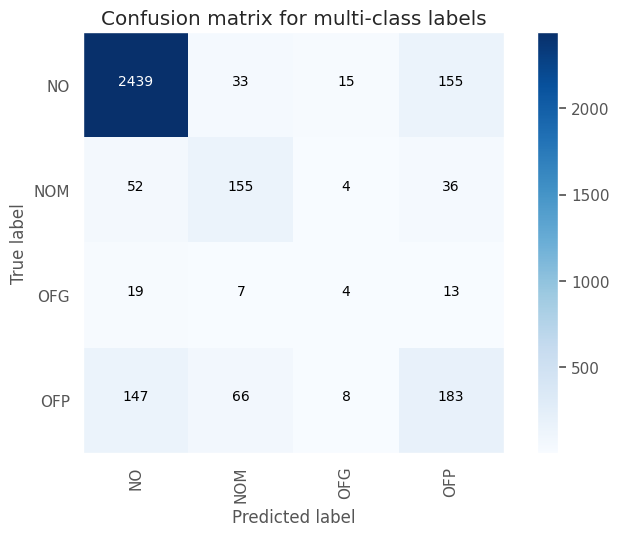

Test Accuracy: 0.8336
Test macro-F1: 0.5254


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4976    0.4653    0.4809       447
     no_hate     0.9181    0.9273    0.9227      2889

    accuracy                         0.8654      3336
   macro avg     0.7079    0.6963    0.7018      3336
weighted avg     0.8618    0.8654    0.8635      3336



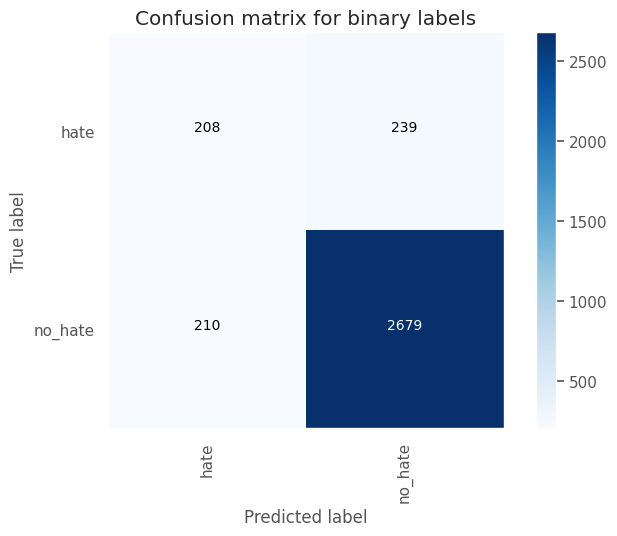

Test Accuracy: 0.8654
Test macro-F1: 0.7018




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_159 (Embedding)   (None, 128, 100)          2000100   
                                                                 
 dropout_437 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_171 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_171 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_438 (Dropout)       (None, 42, 32)          

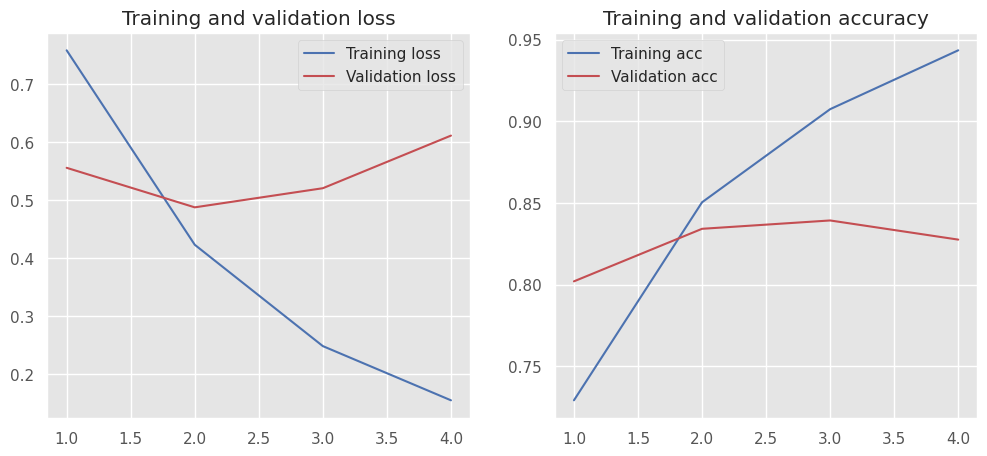

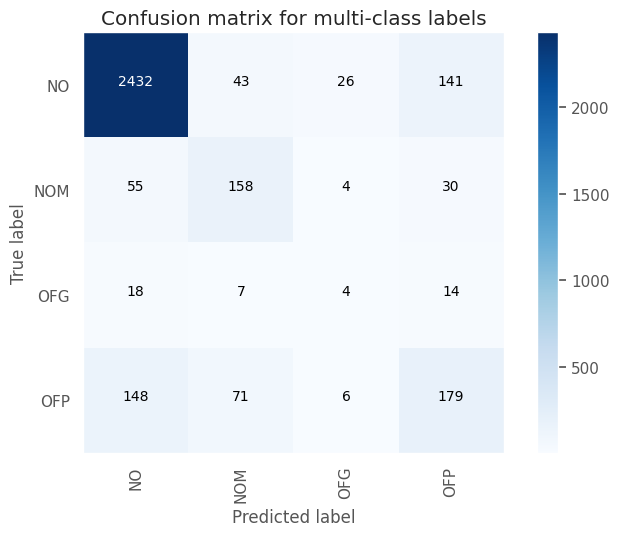

Test Accuracy: 0.8312
Test macro-F1: 0.5205


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5025    0.4541    0.4771       447
     no_hate     0.9168    0.9304    0.9236      2889

    accuracy                         0.8666      3336
   macro avg     0.7096    0.6923    0.7003      3336
weighted avg     0.8613    0.8666    0.8637      3336



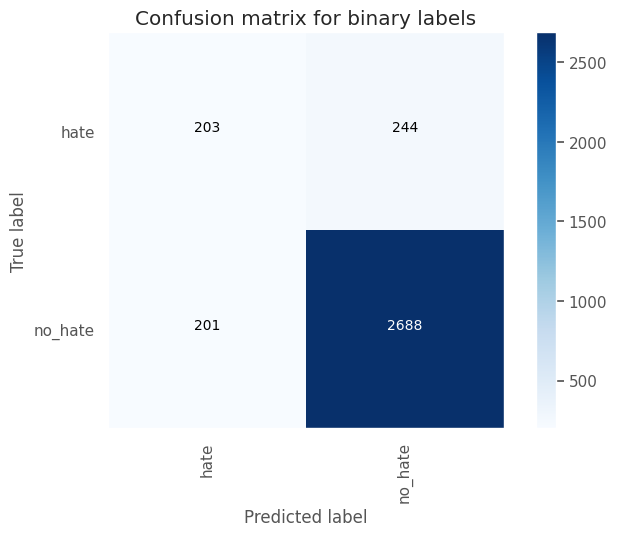

Test Accuracy: 0.8666
Test macro-F1: 0.7003




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_160 (Embedding)   (None, 128, 100)          2000100   
                                                                 
 dropout_440 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_172 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_172 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_441 (Dropout)       (None, 42, 32)          

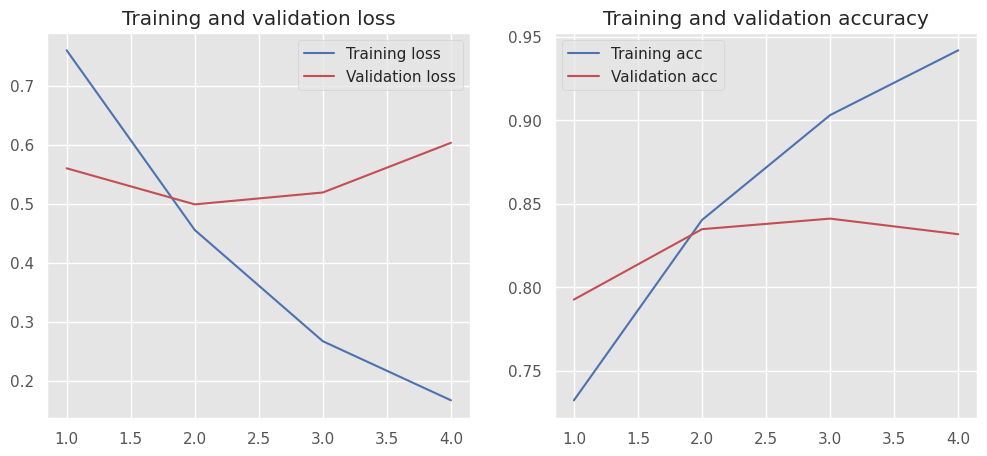

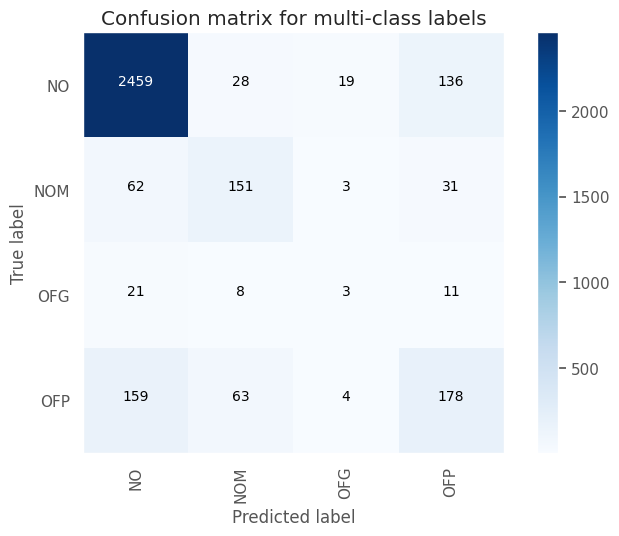

Test Accuracy: 0.8366
Test macro-F1: 0.52


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5091    0.4385    0.4712       447
     no_hate     0.9149    0.9346    0.9247      2889

    accuracy                         0.8681      3336
   macro avg     0.7120    0.6865    0.6979      3336
weighted avg     0.8606    0.8681    0.8639      3336



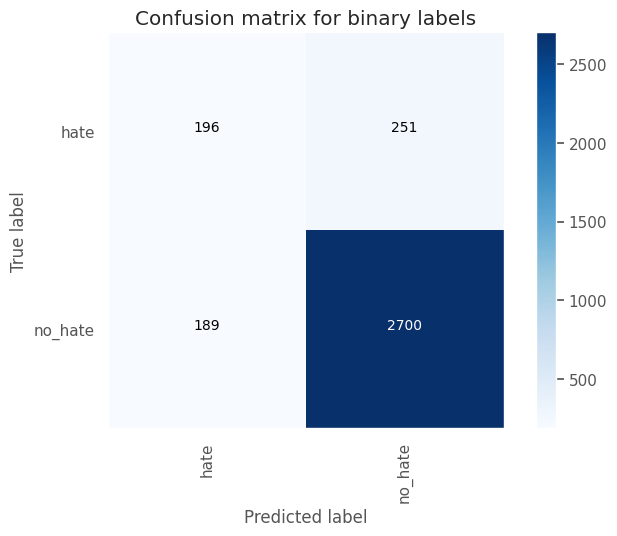

Test Accuracy: 0.8681
Test macro-F1: 0.6979




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_161 (Embedding)   (None, 128, 100)          2000100   
                                                                 
 dropout_443 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_173 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_173 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_444 (Dropout)       (None, 42, 32)          

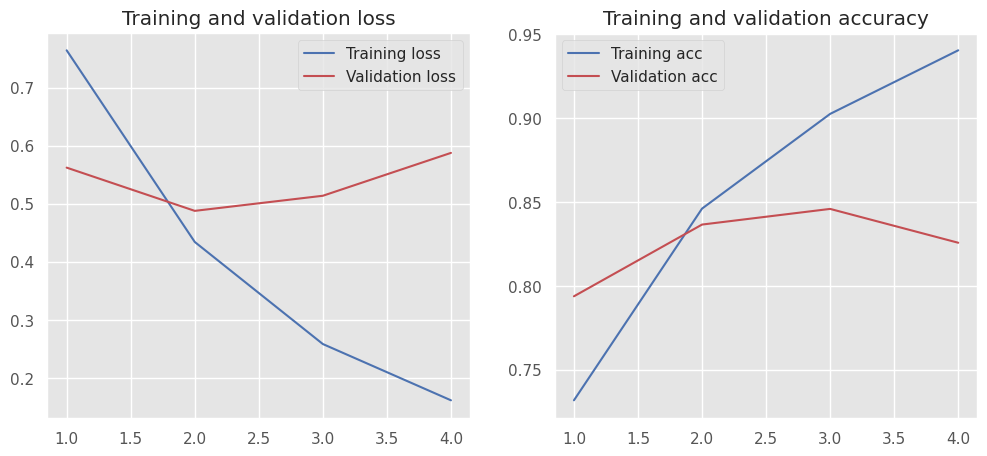

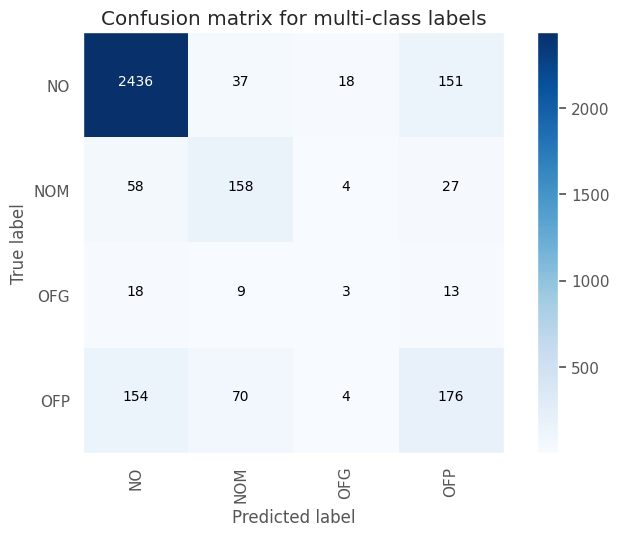

Test Accuracy: 0.8312
Test macro-F1: 0.5161


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4949    0.4385    0.4650       447
     no_hate     0.9146    0.9308    0.9226      2889

    accuracy                         0.8648      3336
   macro avg     0.7048    0.6846    0.6938      3336
weighted avg     0.8584    0.8648    0.8613      3336



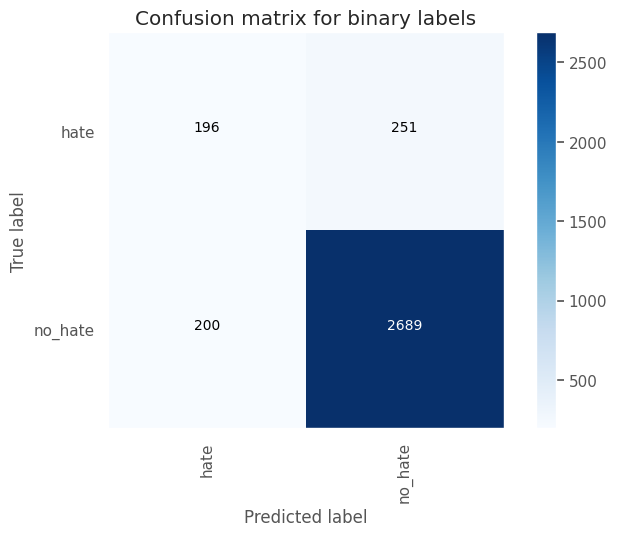

Test Accuracy: 0.8648
Test macro-F1: 0.6938




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_162 (Embedding)   (None, 128, 100)          2000100   
                                                                 
 dropout_446 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_174 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_174 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_447 (Dropout)       (None, 42, 64)          

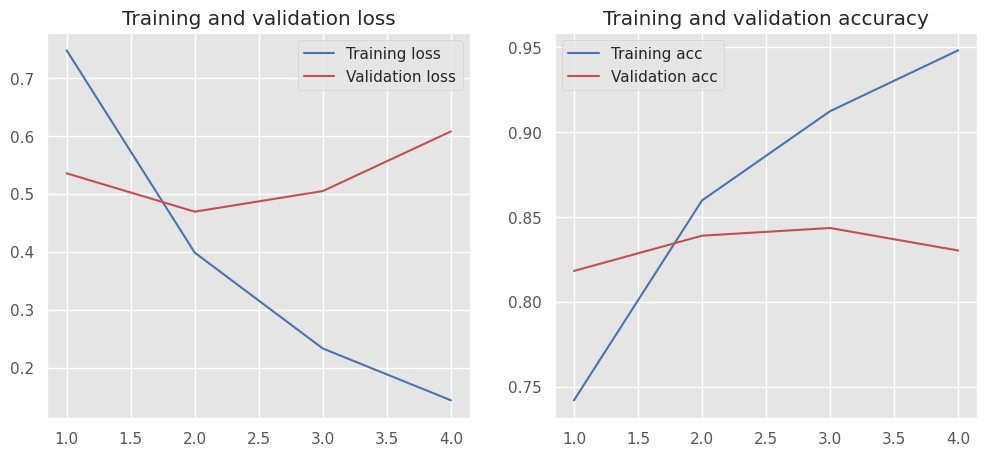

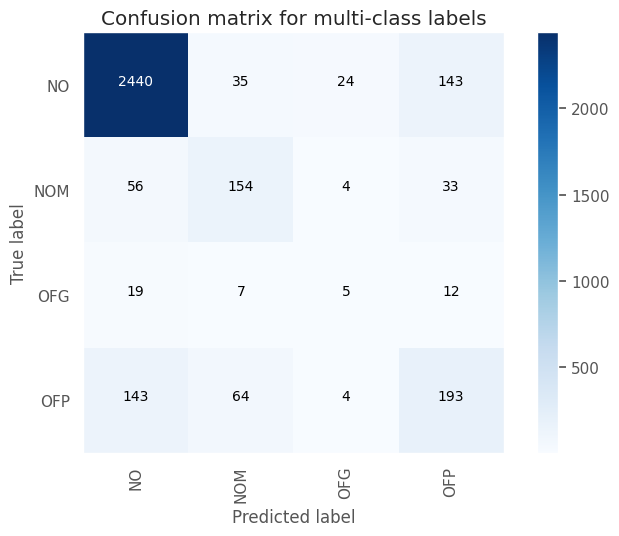

Test Accuracy: 0.8369
Test macro-F1: 0.5362


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5120    0.4787    0.4948       447
     no_hate     0.9202    0.9294    0.9247      2889

    accuracy                         0.8690      3336
   macro avg     0.7161    0.7041    0.7098      3336
weighted avg     0.8655    0.8690    0.8671      3336



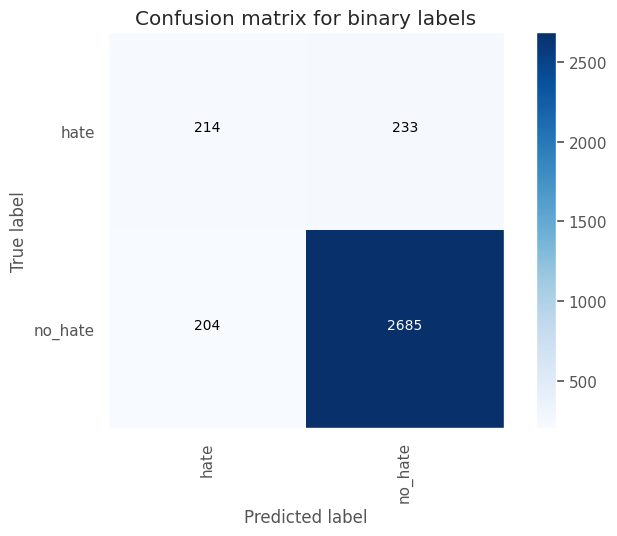

Test Accuracy: 0.869
Test macro-F1: 0.7098




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_163 (Embedding)   (None, 128, 100)          2000100   
                                                                 
 dropout_449 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_175 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_175 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_450 (Dropout)       (None, 42, 64)           

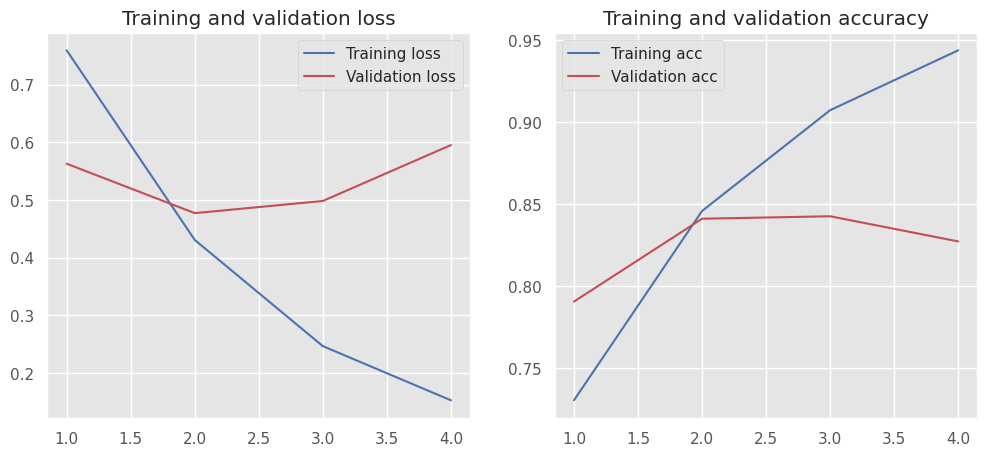

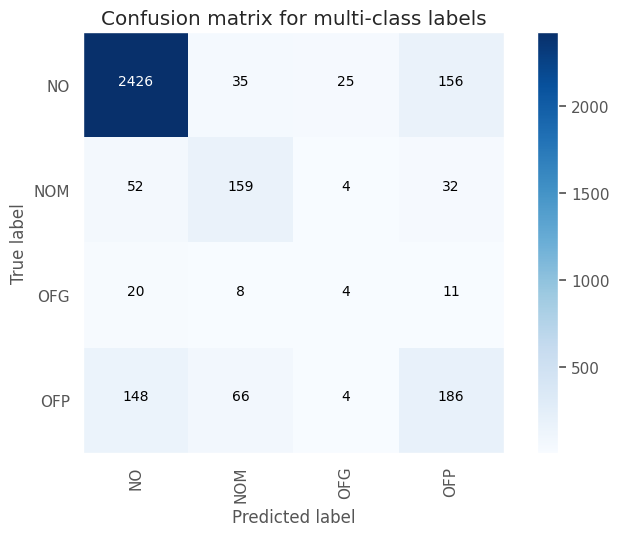

Test Accuracy: 0.8318
Test macro-F1: 0.5266


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4858    0.4586    0.4718       447
     no_hate     0.9170    0.9249    0.9209      2889

    accuracy                         0.8624      3336
   macro avg     0.7014    0.6918    0.6964      3336
weighted avg     0.8592    0.8624    0.8607      3336



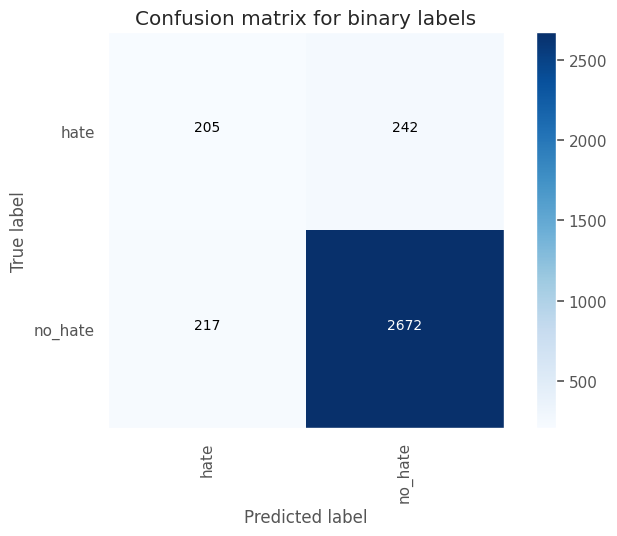

Test Accuracy: 0.8624
Test macro-F1: 0.6964




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_164 (Embedding)   (None, 128, 100)          2000100   
                                                                 
 dropout_452 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_176 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_176 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_453 (Dropout)       (None, 42, 64)          

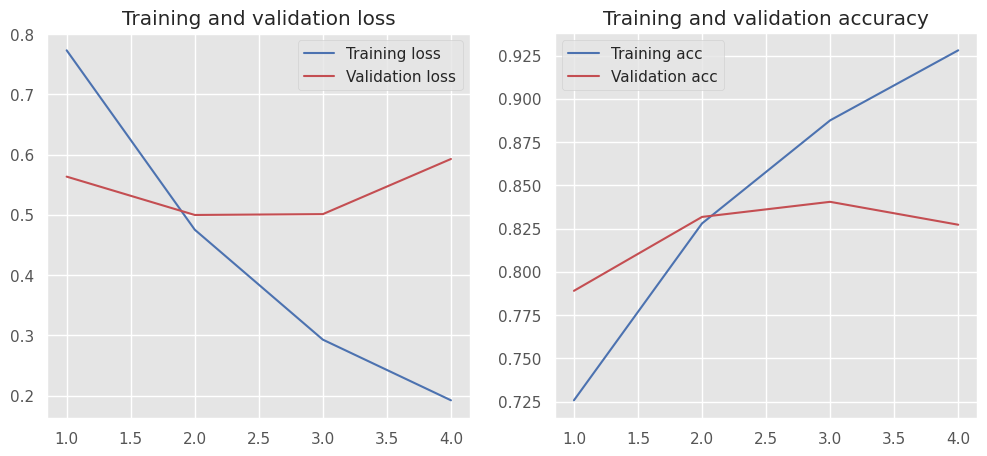

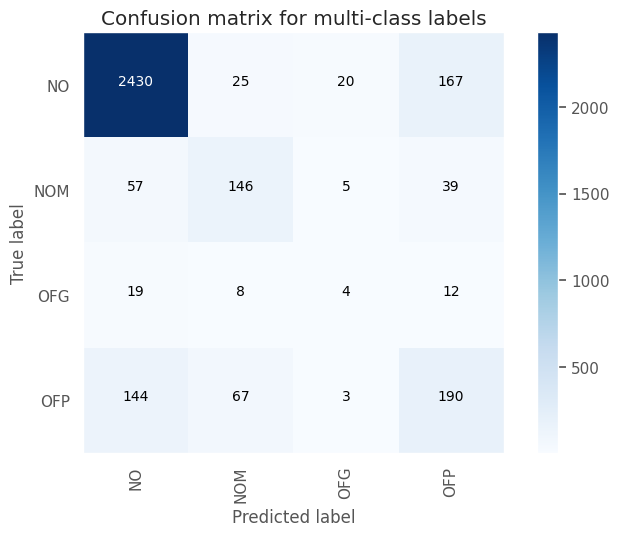

Test Accuracy: 0.8303
Test macro-F1: 0.5213


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4750    0.4676    0.4713       447
     no_hate     0.9178    0.9200    0.9189      2889

    accuracy                         0.8594      3336
   macro avg     0.6964    0.6938    0.6951      3336
weighted avg     0.8585    0.8594    0.8589      3336



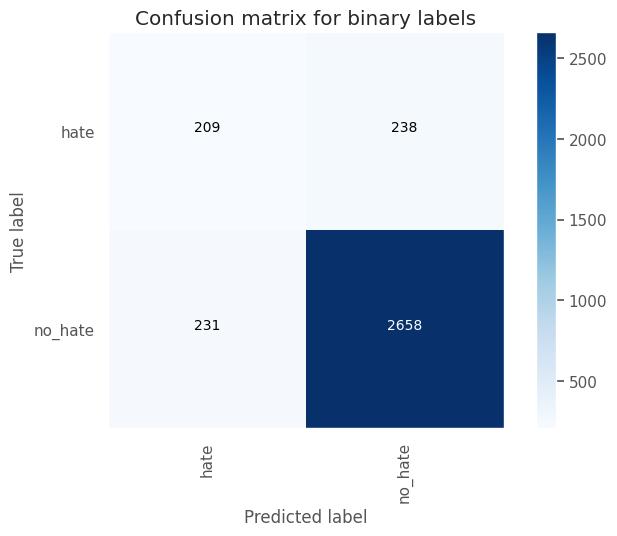

Test Accuracy: 0.8594
Test macro-F1: 0.6951




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_165 (Embedding)   (None, 128, 100)          2000100   
                                                                 
 dropout_455 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_177 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_177 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_456 (Dropout)       (None, 42, 64)          

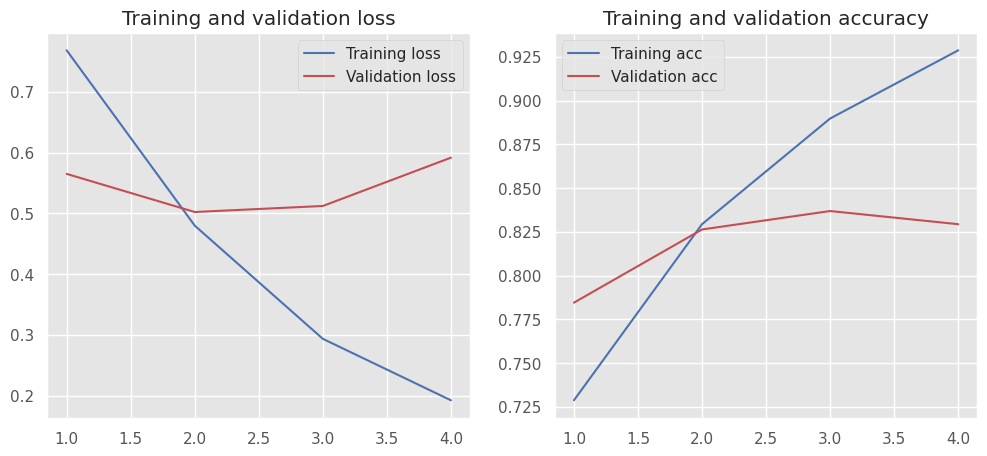

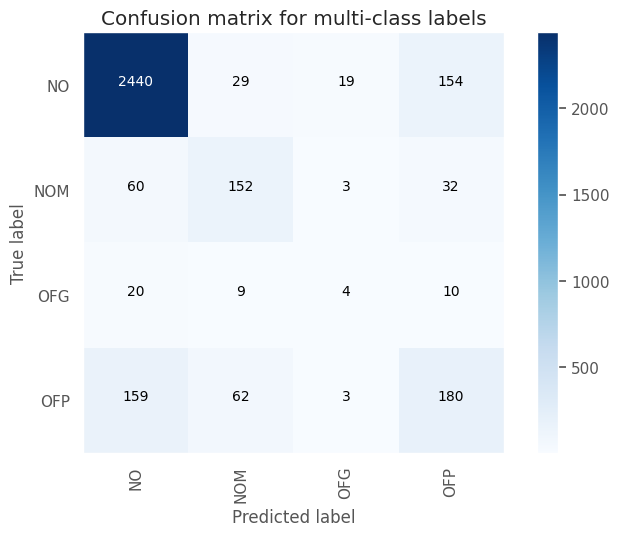

Test Accuracy: 0.8321
Test macro-F1: 0.5247


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4864    0.4407    0.4624       447
     no_hate     0.9147    0.9280    0.9213      2889

    accuracy                         0.8627      3336
   macro avg     0.7006    0.6844    0.6919      3336
weighted avg     0.8573    0.8627    0.8598      3336



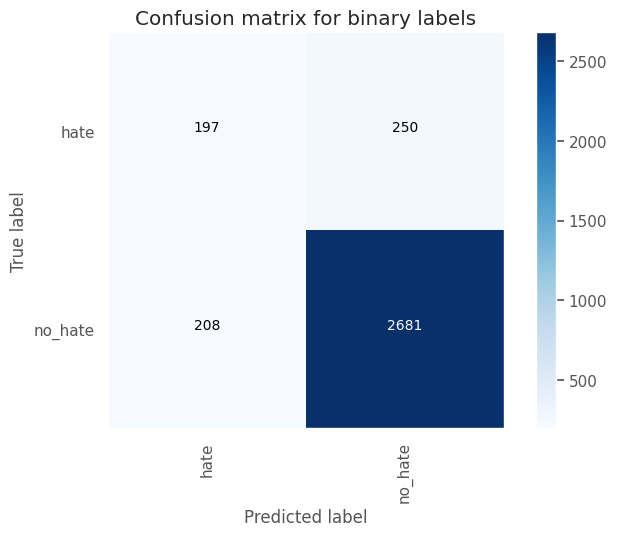

Test Accuracy: 0.8627
Test macro-F1: 0.6919




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_166 (Embedding)   (None, 128, 100)          2000100   
                                                                 
 dropout_458 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_178 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_178 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_459 (Dropout)       (None, 42, 64)          

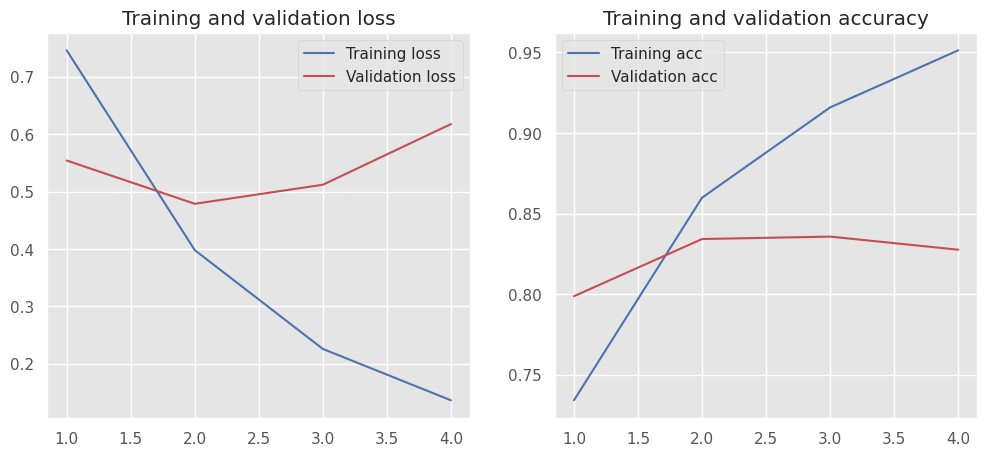

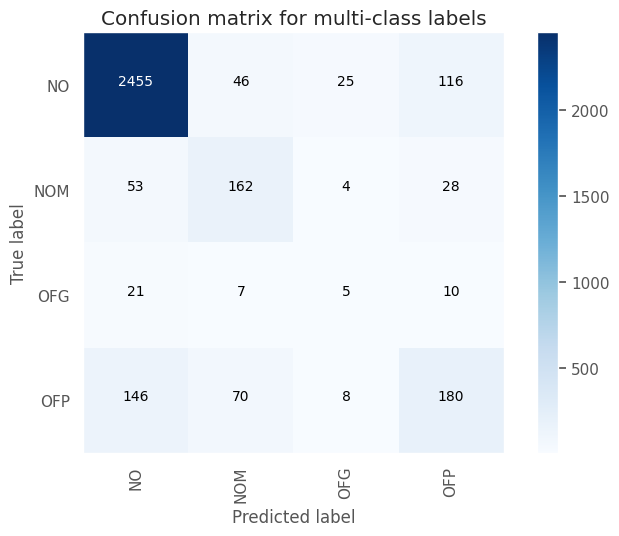

Test Accuracy: 0.8399
Test macro-F1: 0.5345


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5399    0.4541    0.4933       447
     no_hate     0.9176    0.9401    0.9287      2889

    accuracy                         0.8750      3336
   macro avg     0.7287    0.6971    0.7110      3336
weighted avg     0.8670    0.8750    0.8704      3336



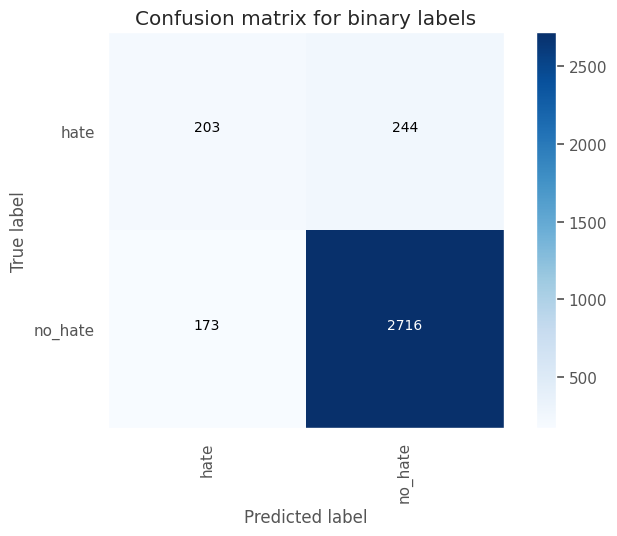

Test Accuracy: 0.875
Test macro-F1: 0.711




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_167 (Embedding)   (None, 128, 100)          2000100   
                                                                 
 dropout_461 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_179 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_179 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_462 (Dropout)       (None, 42, 64)            

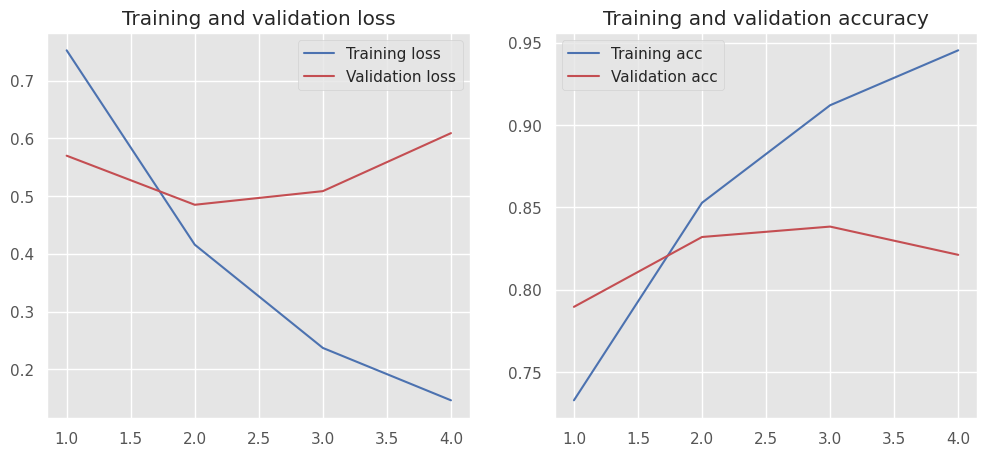

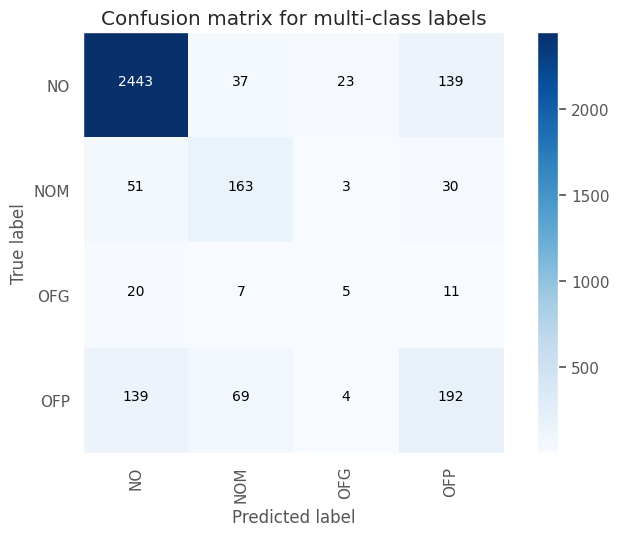

Test Accuracy: 0.8402
Test macro-F1: 0.5423


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5209    0.4743    0.4965       447
     no_hate     0.9198    0.9325    0.9261      2889

    accuracy                         0.8711      3336
   macro avg     0.7203    0.7034    0.7113      3336
weighted avg     0.8663    0.8711    0.8685      3336



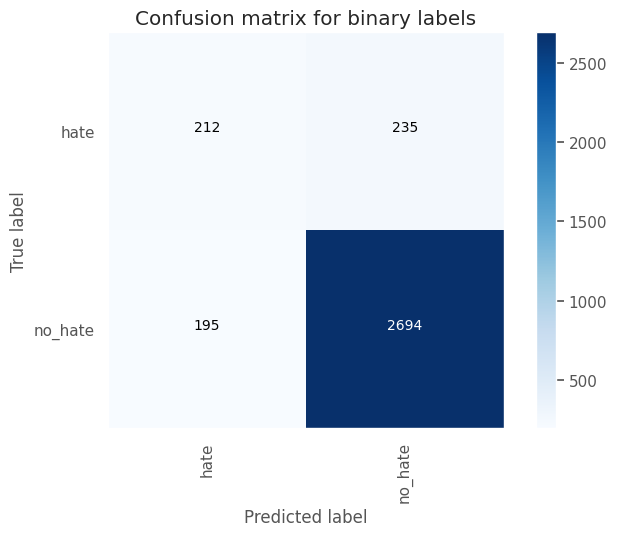

Test Accuracy: 0.8711
Test macro-F1: 0.7113




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_168 (Embedding)   (None, 128, 100)          2000100   
                                                                 
 dropout_464 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_180 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_180 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_465 (Dropout)       (None, 42, 64)          

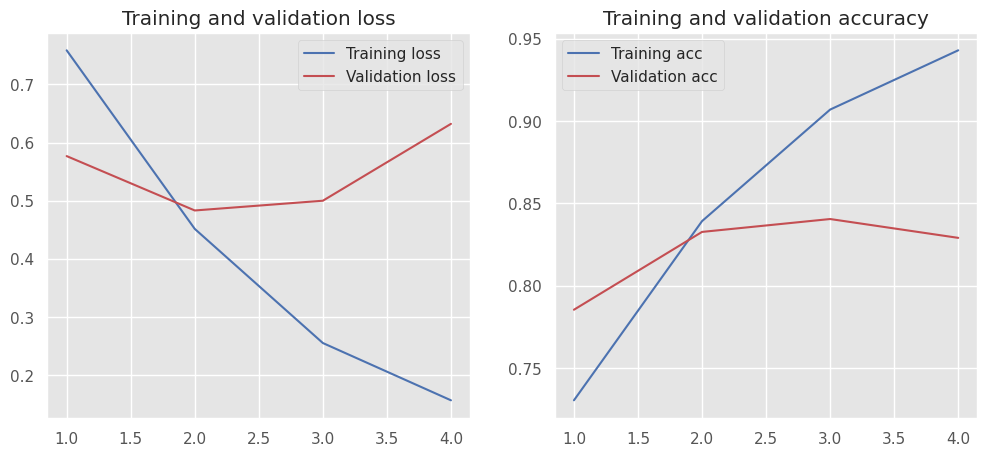

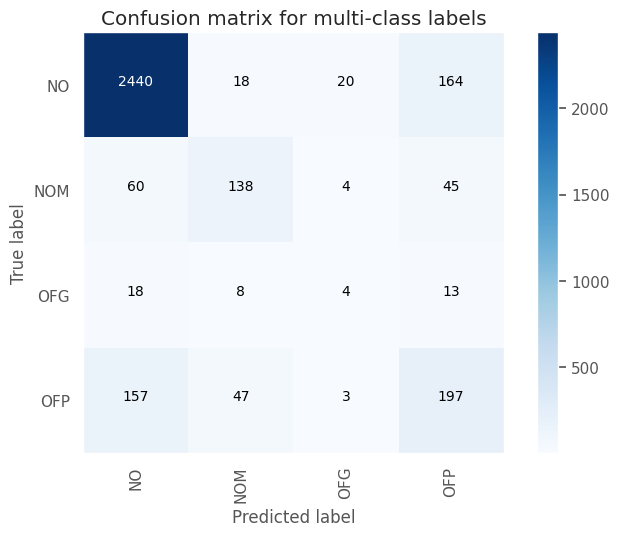

Test Accuracy: 0.833
Test macro-F1: 0.5268


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4822    0.4855    0.4838       447
     no_hate     0.9203    0.9193    0.9198      2889

    accuracy                         0.8612      3336
   macro avg     0.7013    0.7024    0.7018      3336
weighted avg     0.8616    0.8612    0.8614      3336



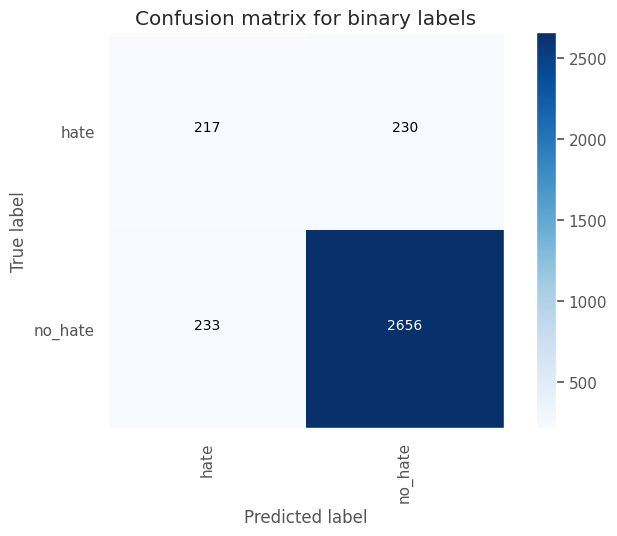

Test Accuracy: 0.8612
Test macro-F1: 0.7018




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_169 (Embedding)   (None, 128, 100)          2000100   
                                                                 
 dropout_467 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_181 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_181 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_468 (Dropout)       (None, 42, 64)          

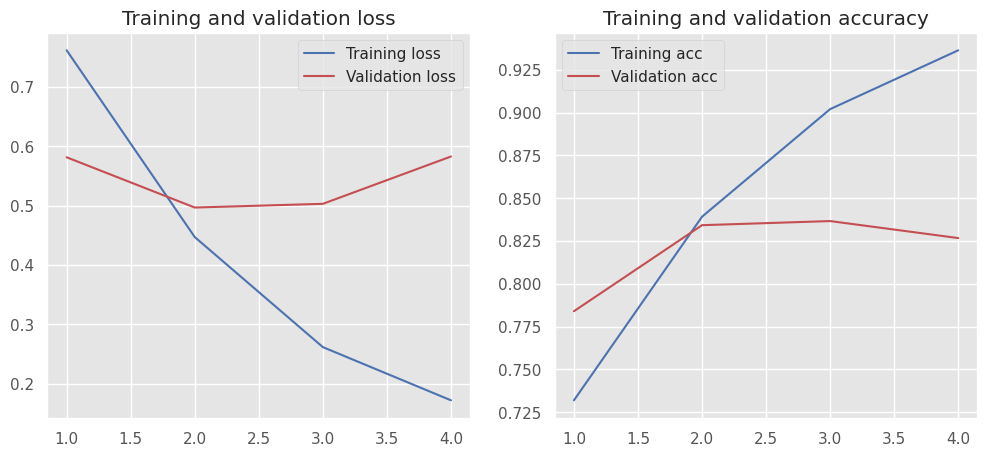

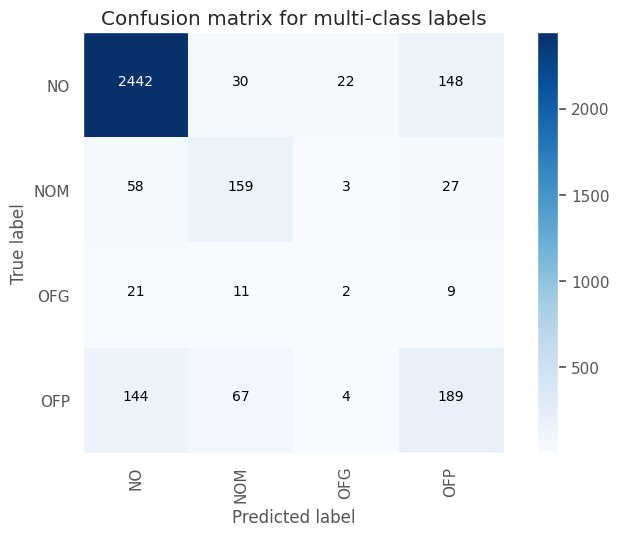

Test Accuracy: 0.8369
Test macro-F1: 0.5199


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5050    0.4564    0.4794       447
     no_hate     0.9171    0.9308    0.9239      2889

    accuracy                         0.8672      3336
   macro avg     0.7110    0.6936    0.7017      3336
weighted avg     0.8619    0.8672    0.8643      3336



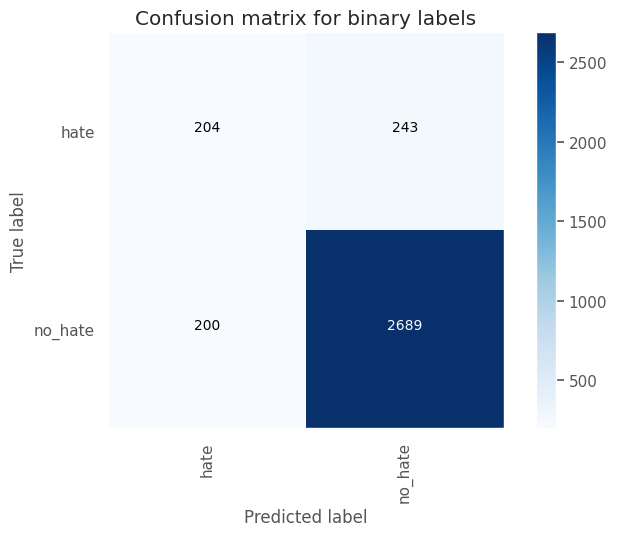

Test Accuracy: 0.8672
Test macro-F1: 0.7017







<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>13</th>
      <td>v6</td>
      <td>{'embedding_167': {'class_name': 'Embedding', 'param_count': 2000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_461': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_179': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_179': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_462': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_162': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_334': {'class_name': 'Dense', 'param_count': 344192, 'input': (None, 2688), 'output': (None, 128)}, 'dropout_463': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_335': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2364072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5426</td>
      <td>0.5440</td>
      <td>0.5423</td>
      <td>0.7203</td>
      <td>0.7034</td>
      <td>0.7113</td>
    </tr>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_154': {'class_name': 'Embedding', 'param_count': 2000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_422': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_166': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_166': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_423': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_149': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_308': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_424': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_309': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>2096072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5503</td>
      <td>0.5323</td>
      <td>0.5382</td>
      <td>0.7142</td>
      <td>0.7081</td>
      <td>0.7111</td>
    </tr>
    <tr>
      <th>8</th>
      <td>v6</td>
      <td>{'embedding_162': {'class_name': 'Embedding', 'param_count': 2000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_446': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_174': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_174': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_447': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_157': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_324': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_448': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_325': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>2191720</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5380</td>
      <td>0.5353</td>
      <td>0.5362</td>
      <td>0.7161</td>
      <td>0.7041</td>
      <td>0.7098</td>
    </tr>
    <tr>
      <th>12</th>
      <td>v6</td>
      <td>{'embedding_166': {'class_name': 'Embedding', 'param_count': 2000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_458': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_178': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_178': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_459': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_161': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_332': {'class_name': 'Dense', 'param_count': 344192, 'input': (None, 2688), 'output': (None, 128)}, 'dropout_460': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_333': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2364072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5360</td>
      <td>0.5367</td>
      <td>0.5345</td>
      <td>0.7287</td>
      <td>0.6971</td>
      <td>0.7110</td>
    </tr>
    <tr>
      <th>14</th>
      <td>v6</td>
      <td>{'embedding_168': {'class_name': 'Embedding', 'param_count': 2000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_464': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_180': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_180': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_465': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_163': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_336': {'class_name': 'Dense', 'param_count': 344192, 'input': (None, 2688), 'output': (None, 128)}, 'dropout_466': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_337': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2364072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5413</td>
      <td>0.5157</td>
      <td>0.5268</td>
      <td>0.7013</td>
      <td>0.7024</td>
      <td>0.7018</td>
    </tr>
    <tr>
      <th>9</th>
      <td>v6</td>
      <td>{'embedding_163': {'class_name': 'Embedding', 'param_count': 2000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_449': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_175': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_175': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_450': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_158': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_326': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_451': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_327': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>2191720</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5253</td>
      <td>0.5288</td>
      <td>0.5266</td>
      <td>0.7014</td>
      <td>0.6918</td>
      <td>0.6964</td>
    </tr>
    <tr>
      <th>4</th>
      <td>v6</td>
      <td>{'embedding_158': {'class_name': 'Embedding', 'param_count': 2000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_434': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_170': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_170': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_435': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_153': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_316': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dropout_436': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_317': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2182408</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5284</td>
      <td>0.5242</td>
      <td>0.5254</td>
      <td>0.7079</td>
      <td>0.6963</td>
      <td>0.7018</td>
    </tr>
    <tr>
      <th>11</th>
      <td>v6</td>
      <td>{'embedding_165': {'class_name': 'Embedding', 'param_count': 2000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_455': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_177': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_177': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_456': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_160': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_330': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_457': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_331': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>2191720</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5327</td>
      <td>0.5194</td>
      <td>0.5247</td>
      <td>0.7006</td>
      <td>0.6844</td>
      <td>0.6919</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_155': {'class_name': 'Embedding', 'param_count': 2000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_425': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_167': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_167': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_426': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_150': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_310': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_427': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_311': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>2096072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5327</td>
      <td>0.5237</td>
      <td>0.5235</td>
      <td>0.7129</td>
      <td>0.6766</td>
      <td>0.6920</td>
    </tr>
    <tr>
      <th>10</th>
      <td>v6</td>
      <td>{'embedding_164': {'class_name': 'Embedding', 'param_count': 2000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_452': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_176': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_176': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_453': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_159': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_328': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_454': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_329': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>2191720</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5253</td>
      <td>0.5185</td>
      <td>0.5213</td>
      <td>0.6964</td>
      <td>0.6938</td>
      <td>0.6951</td>
    </tr>
    <tr>
      <th>5</th>
      <td>v6</td>
      <td>{'embedding_159': {'class_name': 'Embedding', 'param_count': 2000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_437': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_171': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_171': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_438': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_154': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_318': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dropout_439': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_319': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2182408</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5187</td>
      <td>0.5241</td>
      <td>0.5205</td>
      <td>0.7096</td>
      <td>0.6923</td>
      <td>0.7003</td>
    </tr>
    <tr>
      <th>6</th>
      <td>v6</td>
      <td>{'embedding_160': {'class_name': 'Embedding', 'param_count': 2000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_440': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_172': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_172': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_441': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_155': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_320': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dropout_442': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_321': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2182408</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5295</td>
      <td>0.5131</td>
      <td>0.5200</td>
      <td>0.7120</td>
      <td>0.6865</td>
      <td>0.6979</td>
    </tr>
    <tr>
      <th>15</th>
      <td>v6</td>
      <td>{'embedding_169': {'class_name': 'Embedding', 'param_count': 2000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_467': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_181': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_181': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_468': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_164': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_338': {'class_name': 'Dense', 'param_count': 344192, 'input': (None, 2688), 'output': (None, 128)}, 'dropout_469': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_339': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2364072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5208</td>
      <td>0.5206</td>
      <td>0.5199</td>
      <td>0.7110</td>
      <td>0.6936</td>
      <td>0.7017</td>
    </tr>
    <tr>
      <th>7</th>
      <td>v6</td>
      <td>{'embedding_161': {'class_name': 'Embedding', 'param_count': 2000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_443': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_173': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_173': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_444': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_156': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_322': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dropout_445': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_323': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>2182408</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5183</td>
      <td>0.5168</td>
      <td>0.5161</td>
      <td>0.7048</td>
      <td>0.6846</td>
      <td>0.6938</td>
    </tr>
    <tr>
      <th>2</th>
      <td>v6</td>
      <td>{'embedding_156': {'class_name': 'Embedding', 'param_count': 2000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_428': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_168': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_168': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_429': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_151': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_312': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_430': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_313': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>2096072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5102</td>
      <td>0.5079</td>
      <td>0.5080</td>
      <td>0.6897</td>
      <td>0.6803</td>
      <td>0.6848</td>
    </tr>
    <tr>
      <th>3</th>
      <td>v6</td>
      <td>{'embedding_157': {'class_name': 'Embedding', 'param_count': 2000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_431': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_169': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_169': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_432': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_152': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_314': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_433': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_315': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>2096072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5205</td>
      <td>0.5064</td>
      <td>0.5060</td>
      <td>0.7090</td>
      <td>0.6536</td>
      <td>0.6744</td>
    </tr>
  </tbody>
</table>
    

In [32]:
vocab_size: int = 20000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

for cnn_filter_dim in [32, 64]:
  for pool_size in [3]:
    for dense_dim in [64, 128]:
      for dp_before_classif_dense in [0.0, 0.3]:
        for dp_after_pool in [0.0, 0.1]:
          # Build CNN model  ===========
          model_config = KerasCNNClassifierModelConfig(
              # General
              vocab_size=vocab_size,
              model_name="cnn_classifier",
              # Embeddings
              embedding_config=EmbeddingConfig(output_dim=embedding_dim, input_length=max_length, trainable=True, pre_trained_matrix=None),
              # CNN Layers
              cnn_filter_dims=[cnn_filter_dim],
              cnn_kernel_sizes=[3],
              cnn_activations=["relu"],
              cnn_stride_sizes=[1],
              cnn_padding=["valid"],
              pool_sizes=[pool_size],
              use_global_pooling=False,
              # Dense layers at the end
              dense_activations=["relu", "softmax"],
              dense_dims=[dense_dim, 4],
              # Dropouts
              dp_after_embedding=0.5,
              dp_after_pooling=[dp_after_pool],
              dp_before_classif_dense=dp_before_classif_dense)
          model: tf.keras.Model = CNNModelFactory.create(model_config)
          # ============================


          # Train  ===========
          trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                    max_input_length=max_length))
          optim_config: OptimizationConfig = OptimizationConfig(
              epochs=25,
              batch_size=32,
              validation_split=0.0,
              validation_data=(x_val, y_val),
              optimizer=Adam(learning_rate=0.001),
              class_weight=None
          )
          trainer.train(x_train=x_train,
                        y_train=y_train,
                        opt_config=optim_config,
                        callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
          mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
          mc_report: dict
          bc_report: dict

          # Accumulate result so it can be plotted
          result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                          dataset_version=dataset_name,
                                          model_params=model.count_params(),
                                          optim_config=optim_config,
                                          macro_prec_mc=mc_report["macro avg"]["precision"],
                                          macro_recall_mc=mc_report["macro avg"]["recall"],
                                          macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                          macro_prec_bc=bc_report["macro avg"]["precision"],
                                          macro_recall_bc=bc_report["macro avg"]["recall"],
                                          macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                          )
          results_rep.accumulate(result)
          # ============================

report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)

Incrementar el vocabulario no nos ayuda a obtener mejores resultados!.

## Revisando contra `v2`

Tomaré la arquitectura que mejores resultados nos dio antes, y la entrenaré contra `v2`, como para asegurarnos que la aumentación que hicimos en `v6` no nos afecte negativamente.

Total elements for train: 31660
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_202 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_533 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_182 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_182 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_5

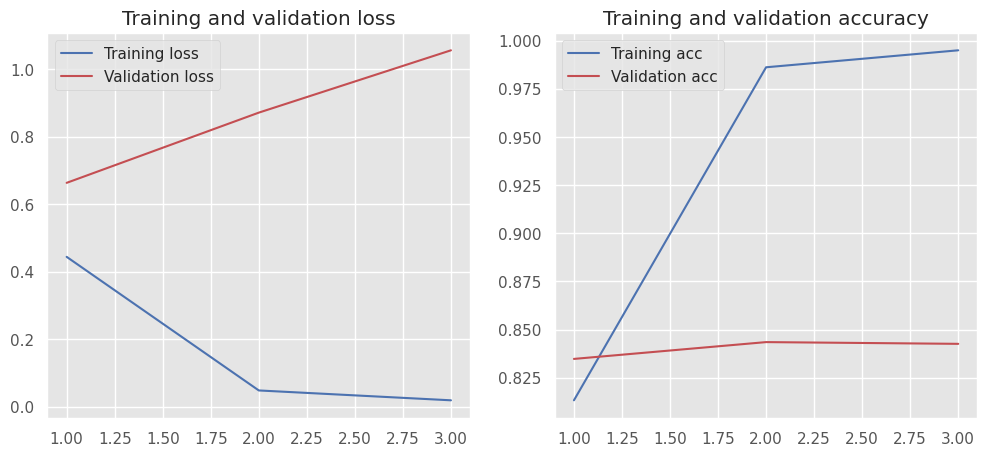

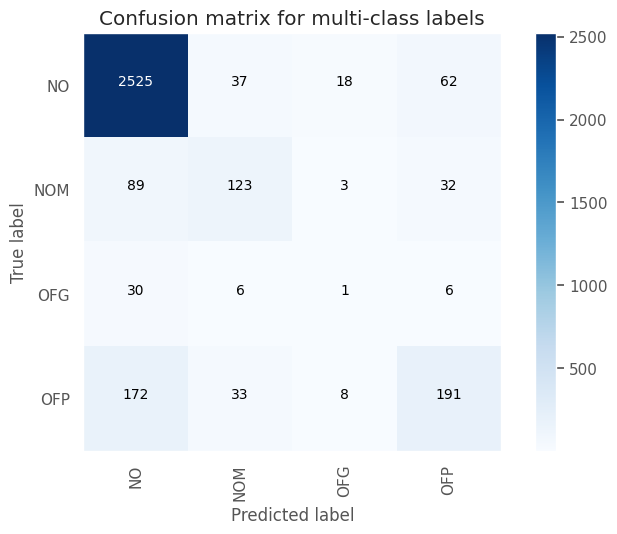

Test Accuracy: 0.8513
Test macro-F1: 0.5135


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6417    0.4609    0.5365       447
     no_hate     0.9201    0.9602    0.9397      2889

    accuracy                         0.8933      3336
   macro avg     0.7809    0.7105    0.7381      3336
weighted avg     0.8828    0.8933    0.8857      3336



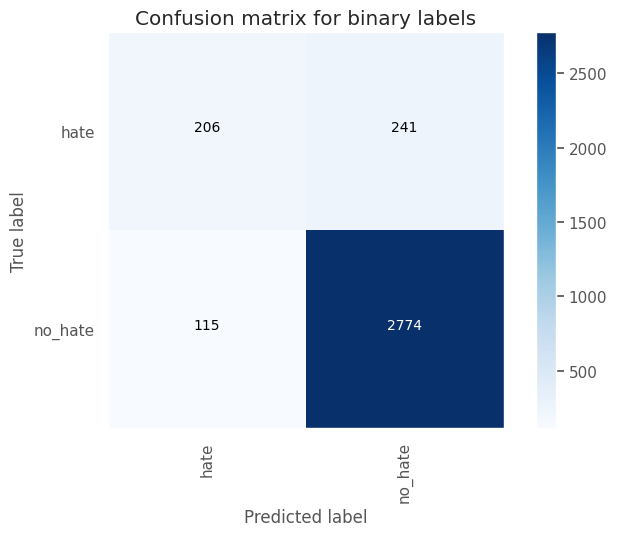

Test Accuracy: 0.8933
Test macro-F1: 0.7381




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_203 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_536 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_183 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_183 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_537 (Dropout)       (None, 42, 32)          

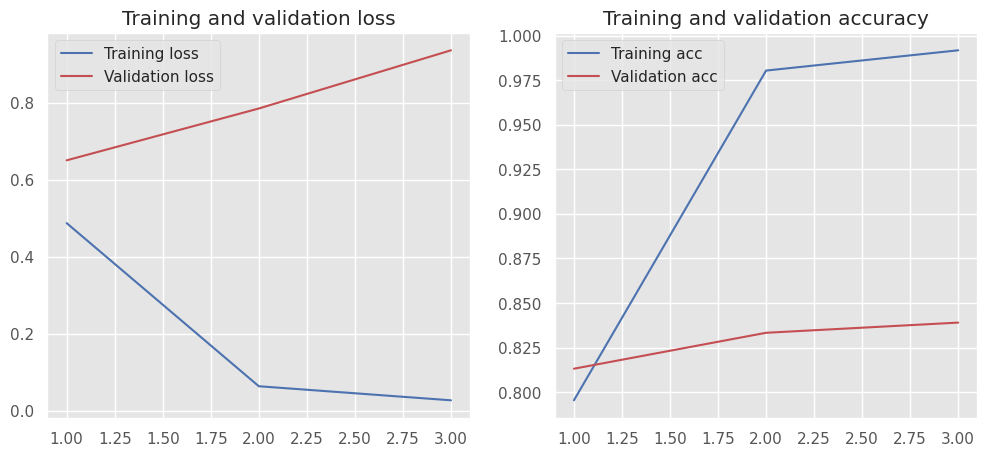

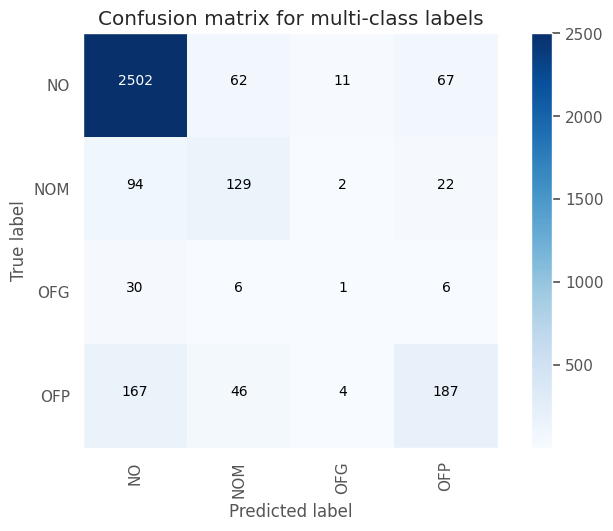

Test Accuracy: 0.845
Test macro-F1: 0.5063


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6600    0.4430    0.5301       447
     no_hate     0.9180    0.9647    0.9408      2889

    accuracy                         0.8948      3336
   macro avg     0.7890    0.7038    0.7354      3336
weighted avg     0.8834    0.8948    0.8857      3336



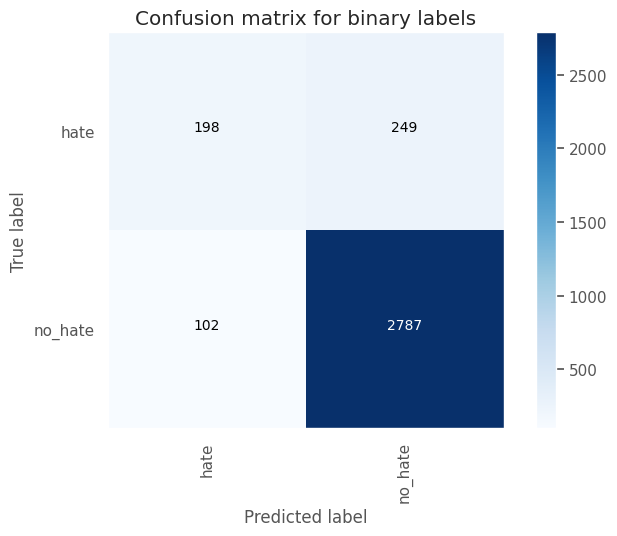

Test Accuracy: 0.8948
Test macro-F1: 0.7354




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_204 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_539 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_184 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_184 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_540 (Dropout)       (None, 42, 32)          

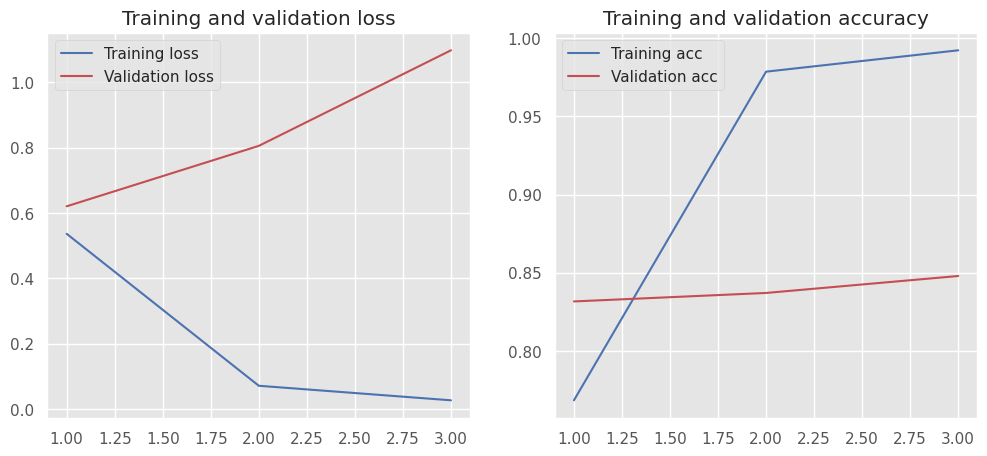

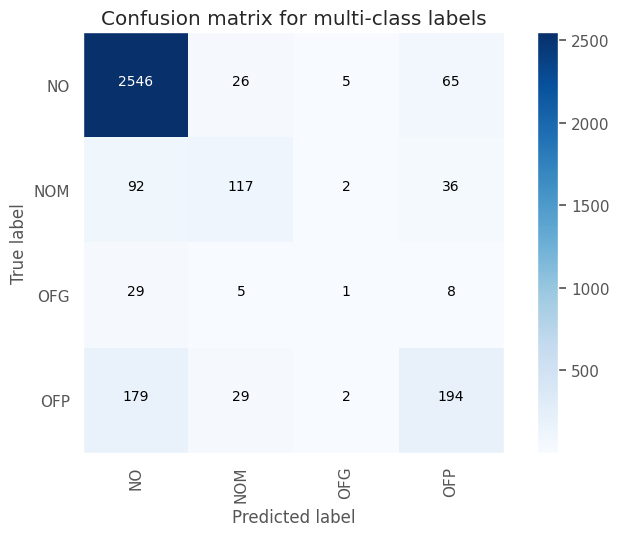

Test Accuracy: 0.8567
Test macro-F1: 0.5166


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6550    0.4586    0.5395       447
     no_hate     0.9199    0.9626    0.9408      2889

    accuracy                         0.8951      3336
   macro avg     0.7874    0.7106    0.7401      3336
weighted avg     0.8844    0.8951    0.8870      3336



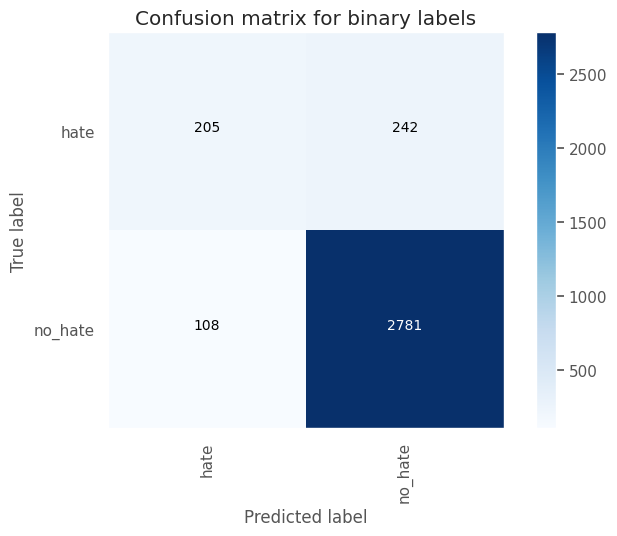

Test Accuracy: 0.8951
Test macro-F1: 0.7401




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_205 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_542 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_185 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_185 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_543 (Dropout)       (None, 42, 32)          

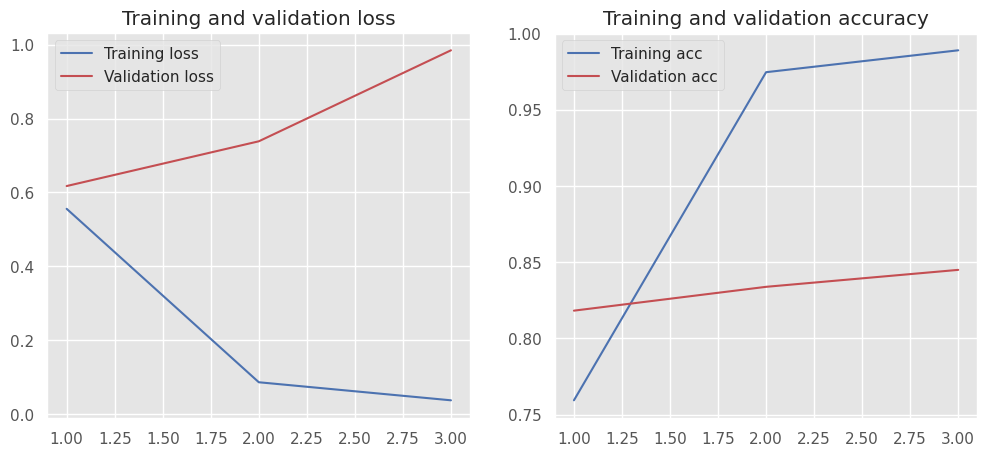

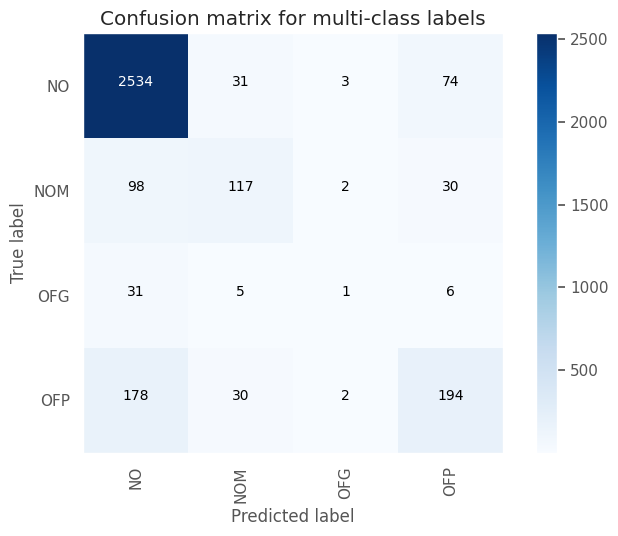

Test Accuracy: 0.8531
Test macro-F1: 0.5139


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6506    0.4541    0.5349       447
     no_hate     0.9193    0.9623    0.9403      2889

    accuracy                         0.8942      3336
   macro avg     0.7850    0.7082    0.7376      3336
weighted avg     0.8833    0.8942    0.8860      3336



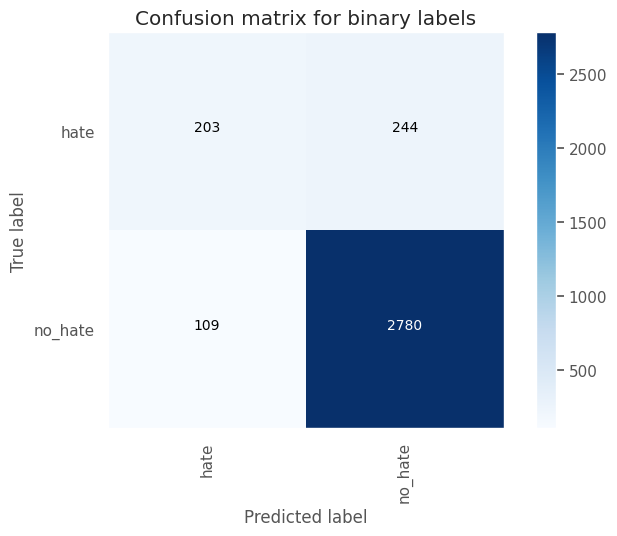

Test Accuracy: 0.8942
Test macro-F1: 0.7376




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_206 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_545 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_186 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_186 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_546 (Dropout)       (None, 42, 32)          

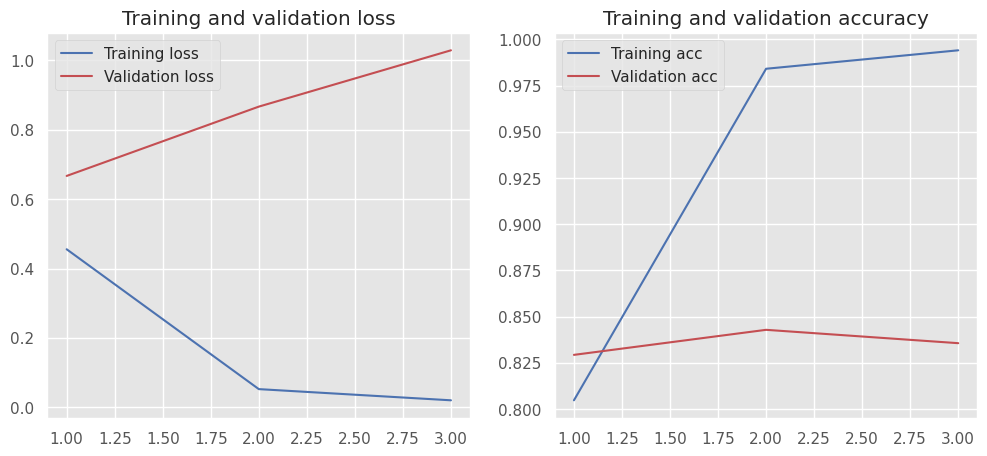

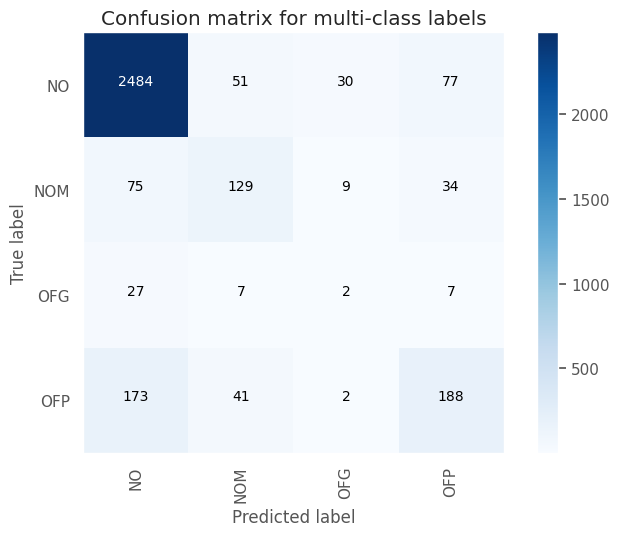

Test Accuracy: 0.8402
Test macro-F1: 0.5098


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5702    0.4452    0.5000       447
     no_hate     0.9170    0.9481    0.9323      2889

    accuracy                         0.8807      3336
   macro avg     0.7436    0.6966    0.7161      3336
weighted avg     0.8705    0.8807    0.8743      3336



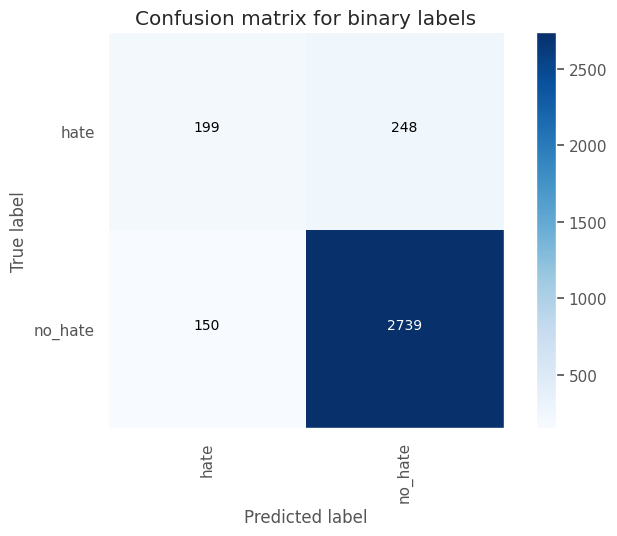

Test Accuracy: 0.8807
Test macro-F1: 0.7161




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_207 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_548 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_187 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_187 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_549 (Dropout)       (None, 42, 32)          

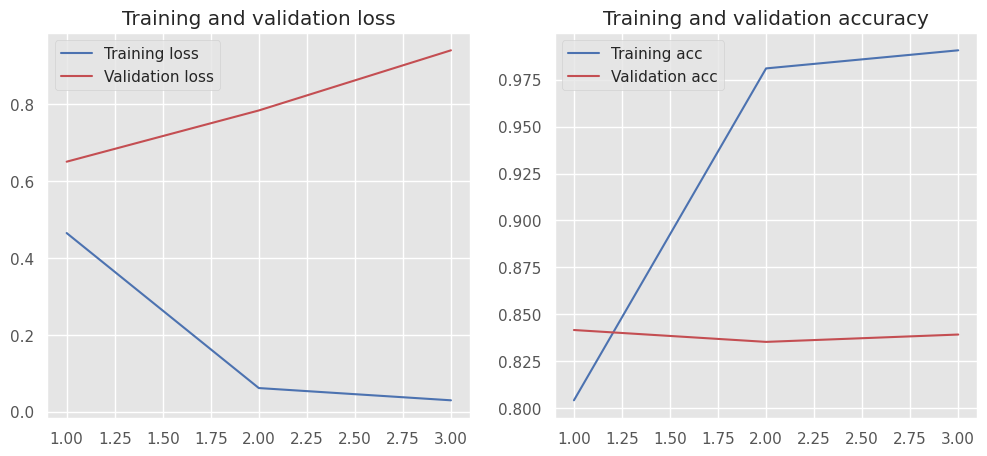

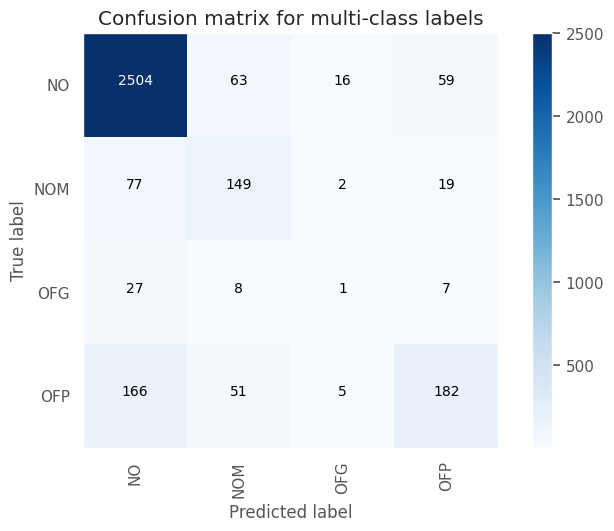

Test Accuracy: 0.8501
Test macro-F1: 0.5181


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6701    0.4362    0.5285       447
     no_hate     0.9172    0.9668    0.9414      2889

    accuracy                         0.8957      3336
   macro avg     0.7937    0.7015    0.7349      3336
weighted avg     0.8841    0.8957    0.8860      3336



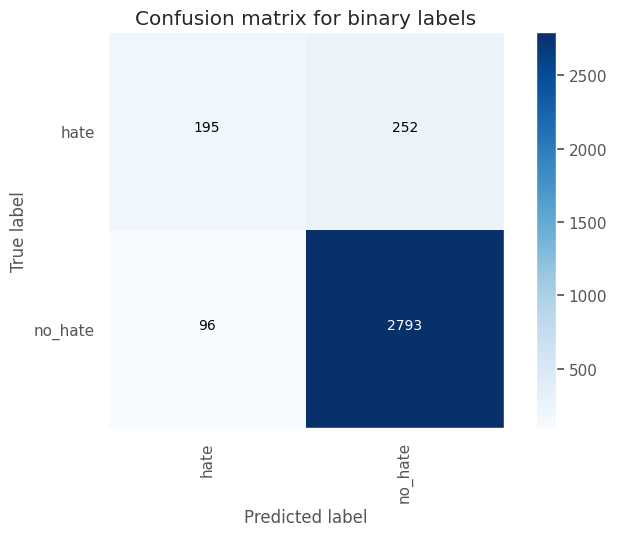

Test Accuracy: 0.8957
Test macro-F1: 0.7349




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_208 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_551 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_188 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_188 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_552 (Dropout)       (None, 42, 32)          

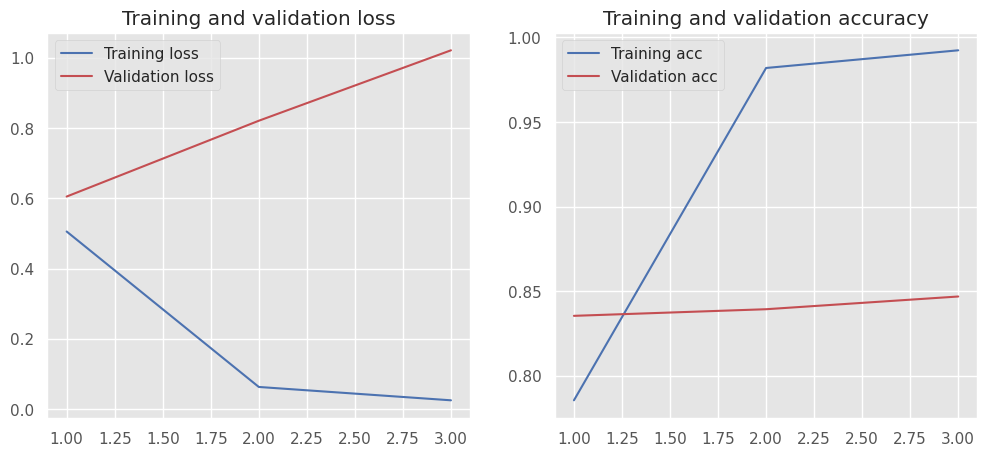

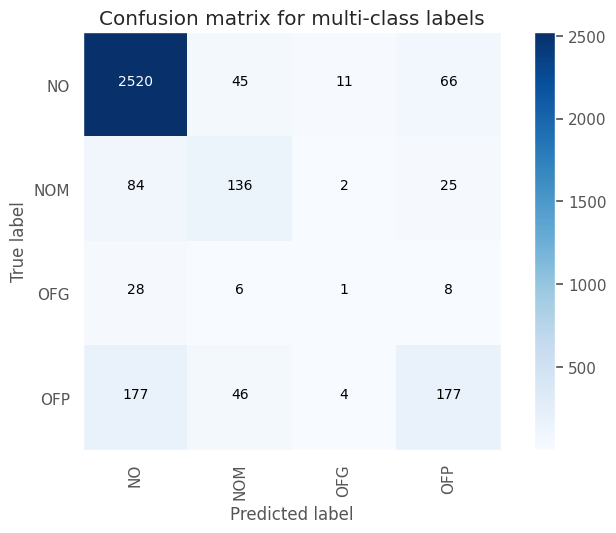

Test Accuracy: 0.8495
Test macro-F1: 0.5112


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6463    0.4251    0.5128       447
     no_hate     0.9155    0.9640    0.9391      2889

    accuracy                         0.8918      3336
   macro avg     0.7809    0.6945    0.7260      3336
weighted avg     0.8794    0.8918    0.8820      3336



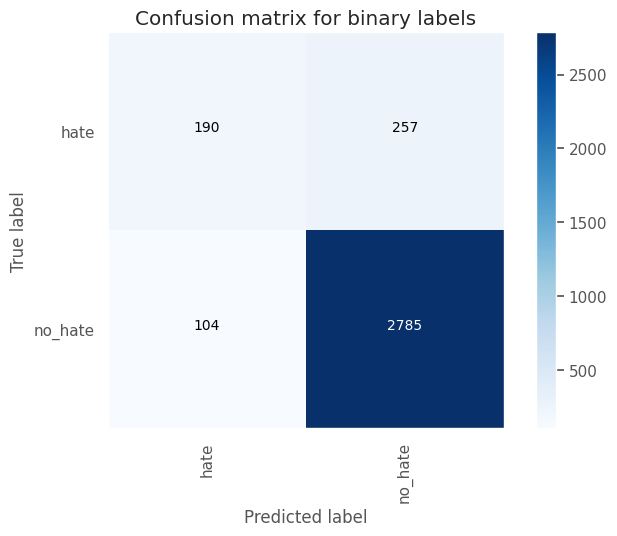

Test Accuracy: 0.8918
Test macro-F1: 0.726




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_209 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_554 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_189 (Conv1D)         (None, 126, 32)           9632      
                                                                 
 max_pooling1d_189 (MaxPool  (None, 42, 32)            0         
 ing1D)                                                          
                                                                 
 dropout_555 (Dropout)       (None, 42, 32)           

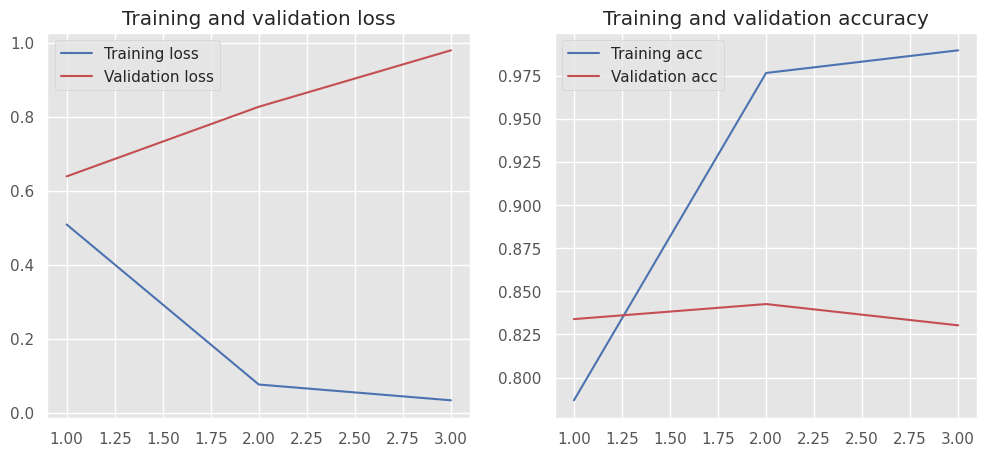

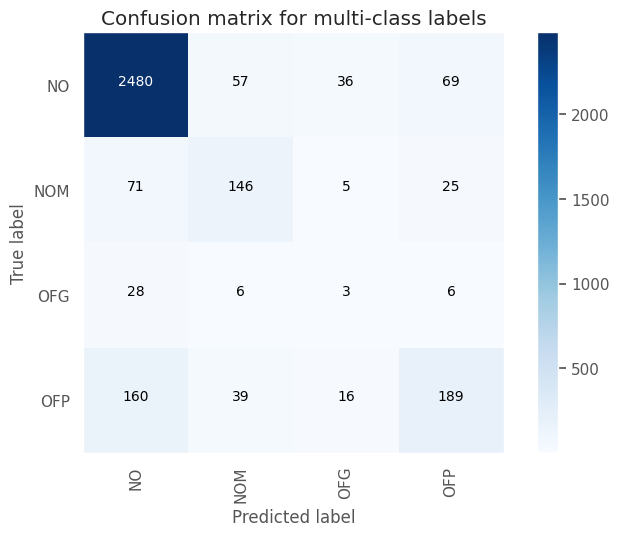

Test Accuracy: 0.8447
Test macro-F1: 0.5288


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6132    0.4787    0.5377       447
     no_hate     0.9220    0.9533    0.9374      2889

    accuracy                         0.8897      3336
   macro avg     0.7676    0.7160    0.7375      3336
weighted avg     0.8806    0.8897    0.8838      3336



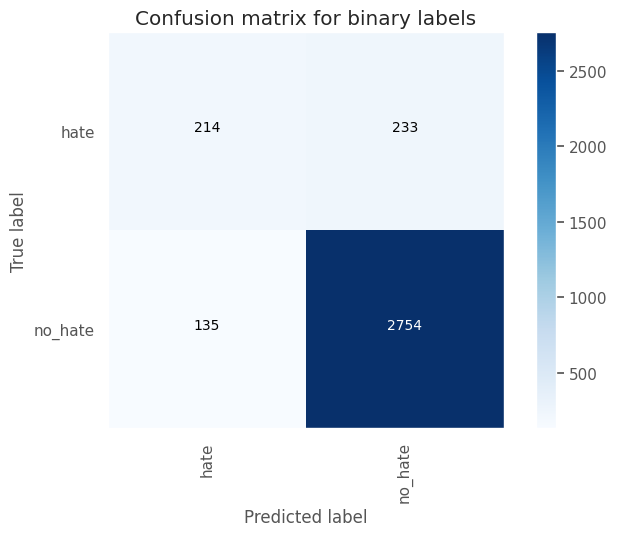

Test Accuracy: 0.8897
Test macro-F1: 0.7375




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_210 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_557 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_190 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_190 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_558 (Dropout)       (None, 42, 64)          

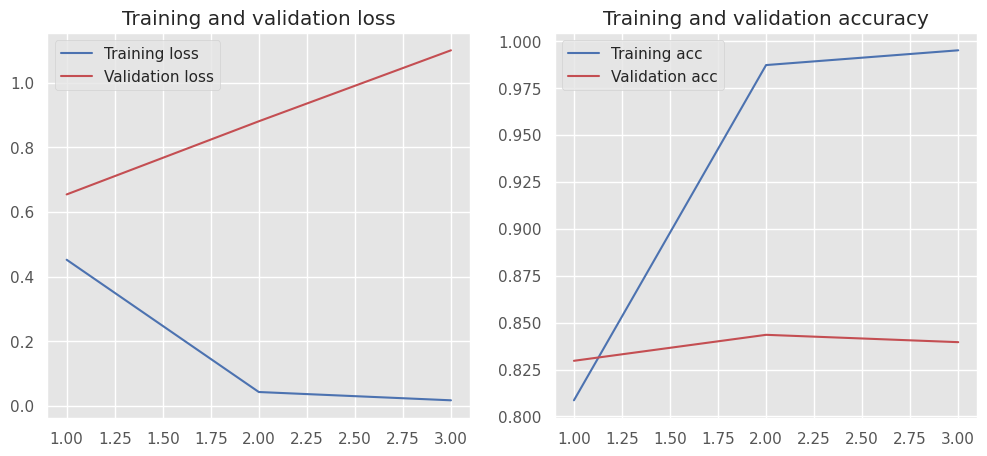

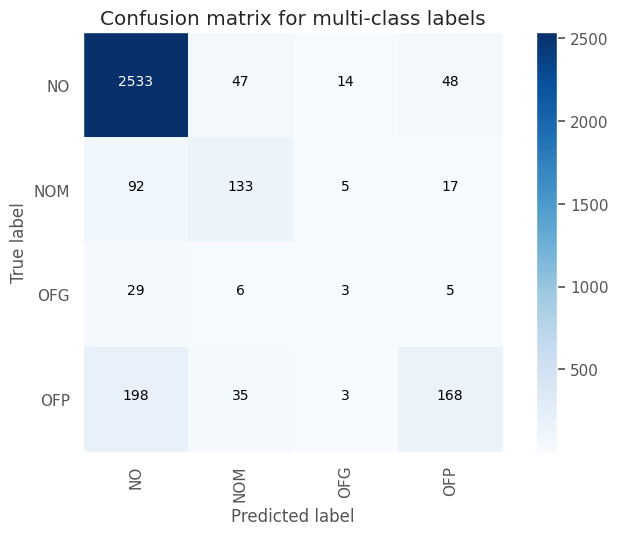

Test Accuracy: 0.8504
Test macro-F1: 0.5255


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6806    0.4004    0.5042       447
     no_hate     0.9128    0.9709    0.9410      2889

    accuracy                         0.8945      3336
   macro avg     0.7967    0.6857    0.7226      3336
weighted avg     0.8817    0.8945    0.8824      3336



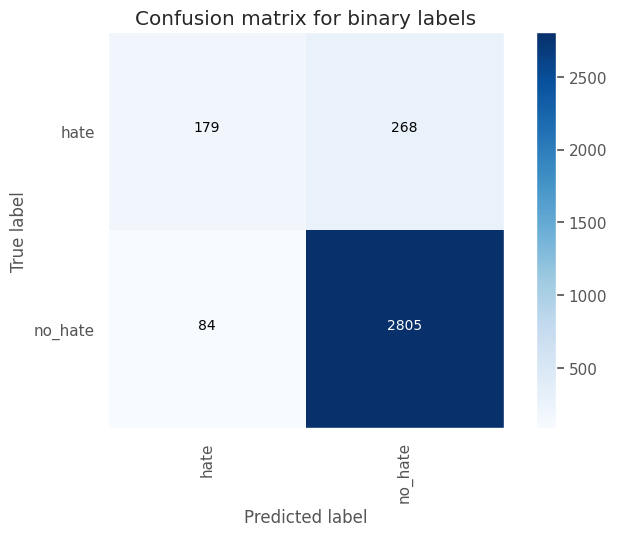

Test Accuracy: 0.8945
Test macro-F1: 0.7226




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_211 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_560 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_191 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_191 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_561 (Dropout)       (None, 42, 64)          

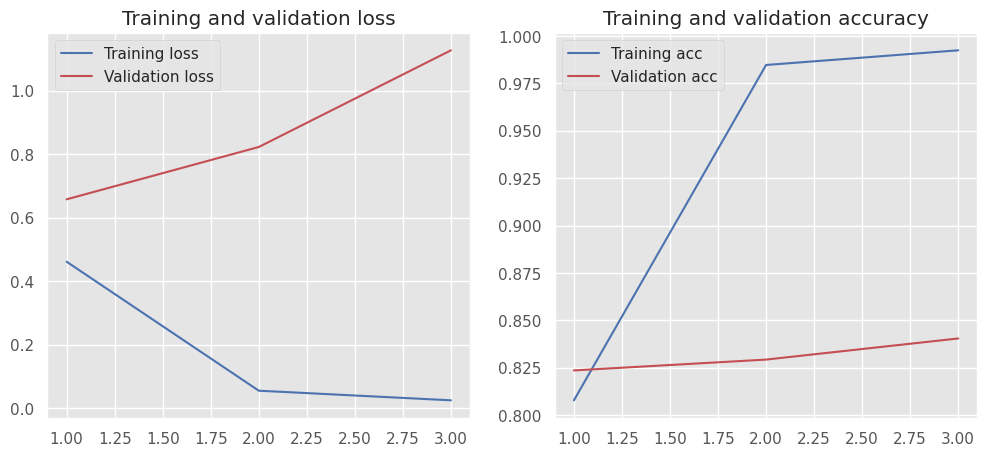

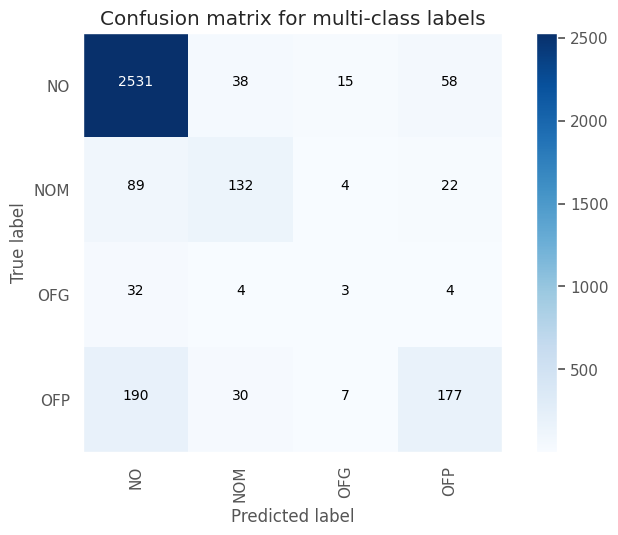

Test Accuracy: 0.8522
Test macro-F1: 0.531


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6586    0.4273    0.5183       447
     no_hate     0.9160    0.9657    0.9402      2889

    accuracy                         0.8936      3336
   macro avg     0.7873    0.6965    0.7293      3336
weighted avg     0.8815    0.8936    0.8837      3336



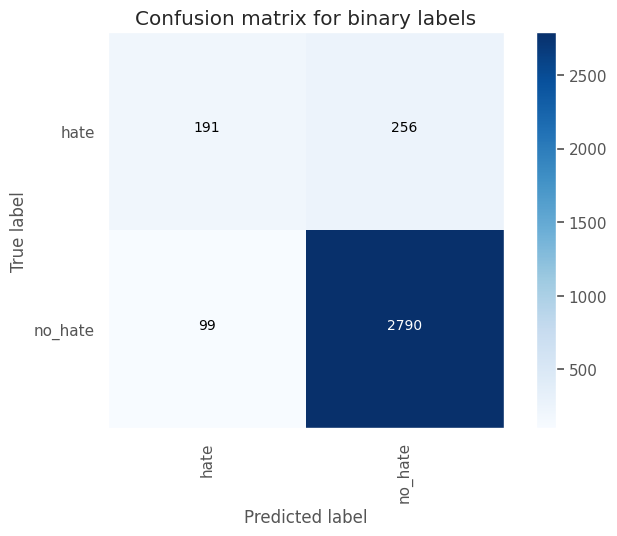

Test Accuracy: 0.8936
Test macro-F1: 0.7293




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_212 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_563 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_192 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_192 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_564 (Dropout)       (None, 42, 64)          

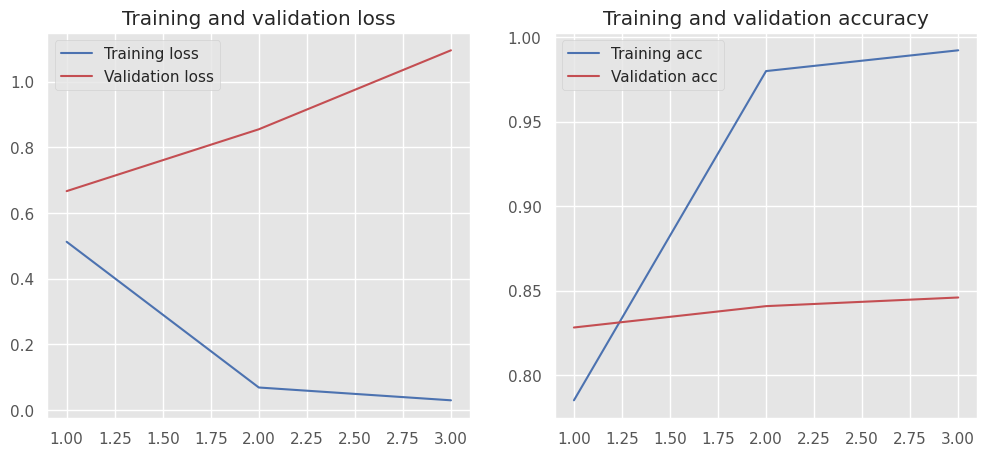

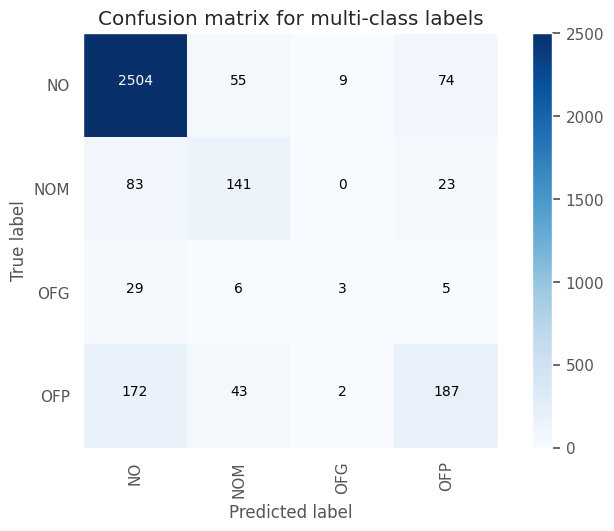

Test Accuracy: 0.8498
Test macro-F1: 0.5351


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6502    0.4407    0.5253       447
     no_hate     0.9176    0.9633    0.9399      2889

    accuracy                         0.8933      3336
   macro avg     0.7839    0.7020    0.7326      3336
weighted avg     0.8817    0.8933    0.8843      3336



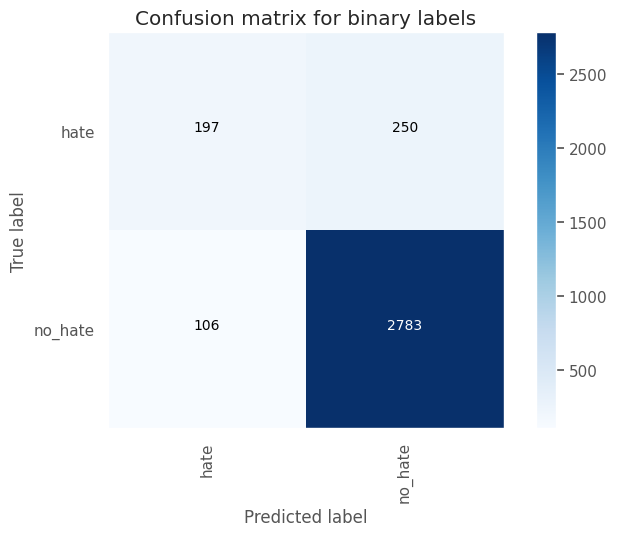

Test Accuracy: 0.8933
Test macro-F1: 0.7326




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_213 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_566 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_193 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_193 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_567 (Dropout)       (None, 42, 64)          

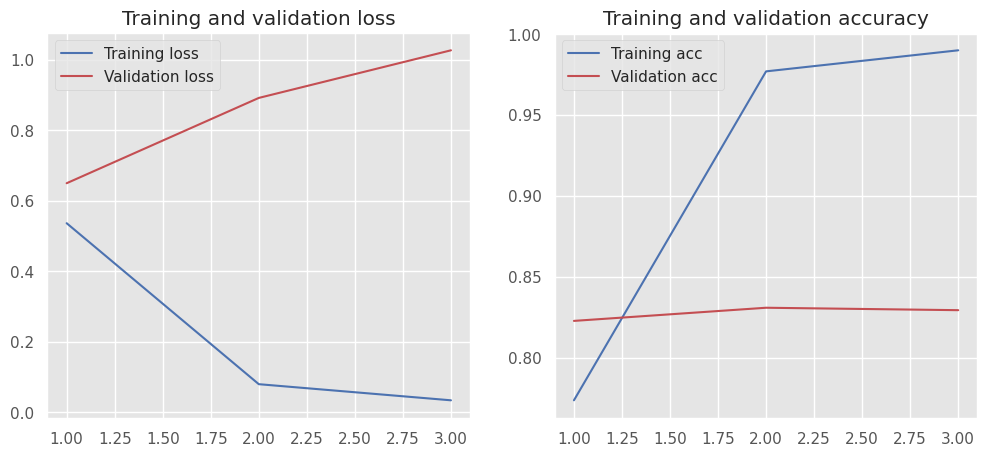

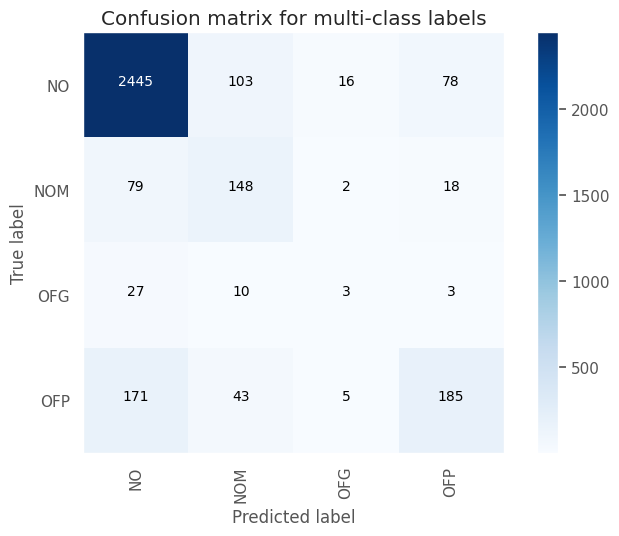

Test Accuracy: 0.8336
Test macro-F1: 0.5184


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6323    0.4385    0.5178       447
     no_hate     0.9171    0.9605    0.9383      2889

    accuracy                         0.8906      3336
   macro avg     0.7747    0.6995    0.7281      3336
weighted avg     0.8789    0.8906    0.8820      3336



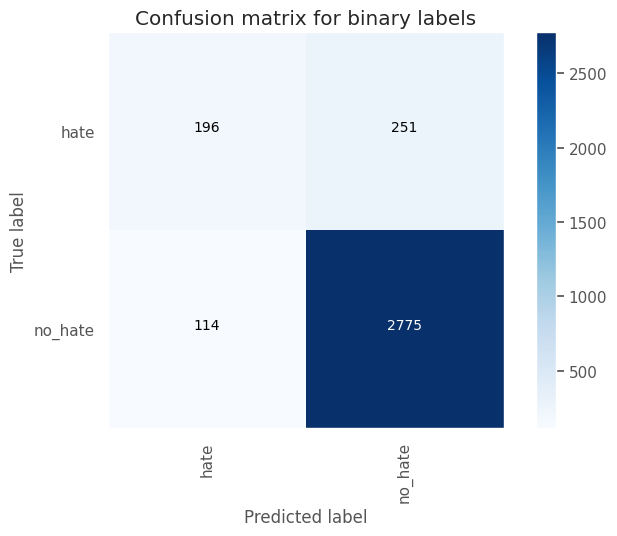

Test Accuracy: 0.8906
Test macro-F1: 0.7281




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_214 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_569 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_194 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_194 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_570 (Dropout)       (None, 42, 64)          

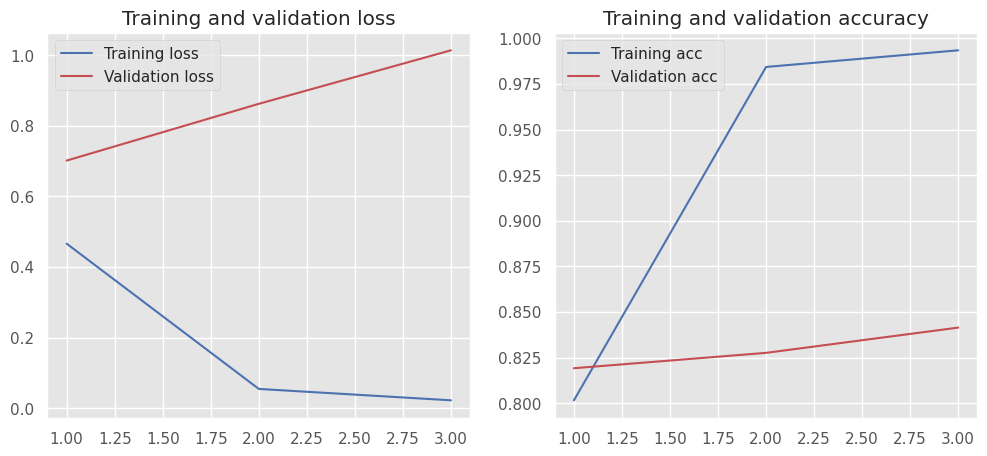

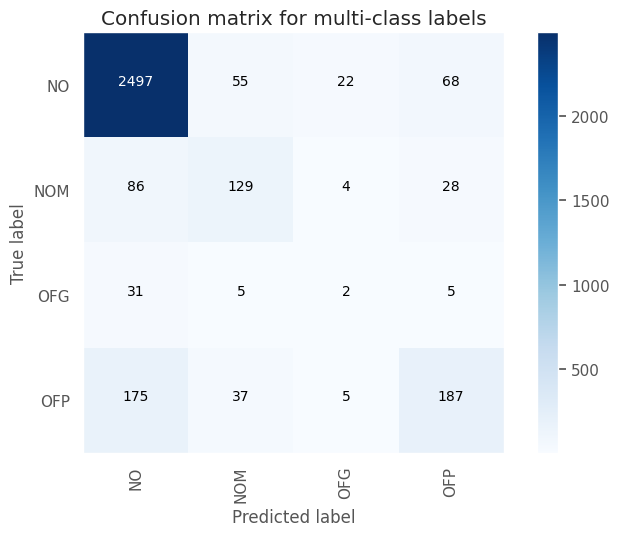

Test Accuracy: 0.8438
Test macro-F1: 0.5145


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6199    0.4452    0.5182       447
     no_hate     0.9177    0.9578    0.9373      2889

    accuracy                         0.8891      3336
   macro avg     0.7688    0.7015    0.7278      3336
weighted avg     0.8778    0.8891    0.8812      3336



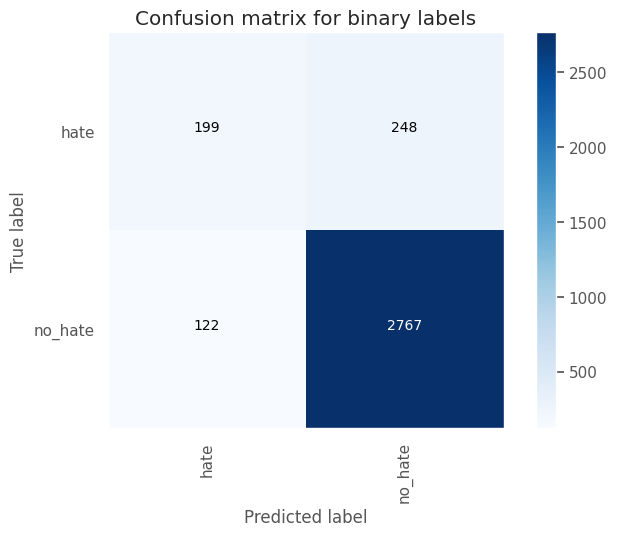

Test Accuracy: 0.8891
Test macro-F1: 0.7278




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_215 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_572 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_195 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_195 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_573 (Dropout)       (None, 42, 64)          

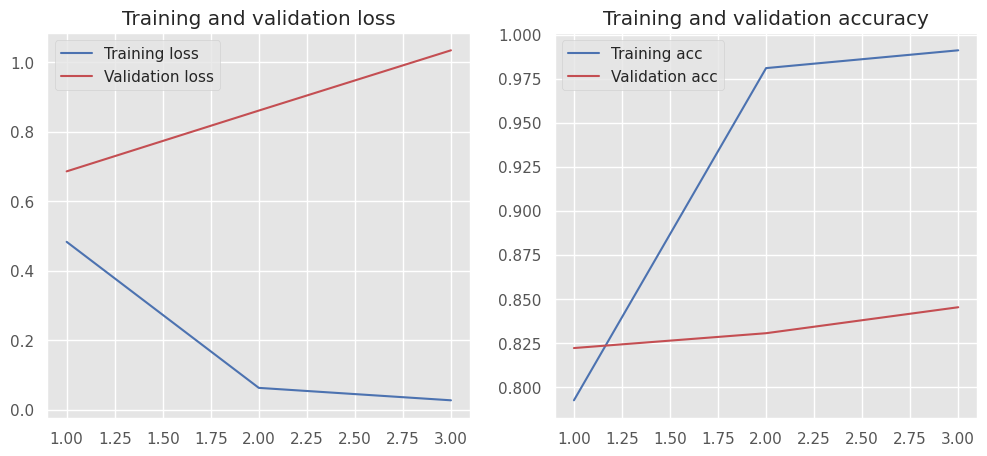

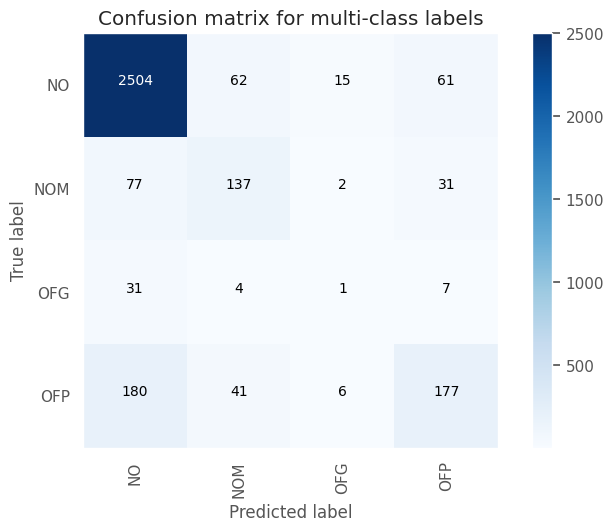

Test Accuracy: 0.845
Test macro-F1: 0.5075


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6367    0.4273    0.5114       447
     no_hate     0.9157    0.9623    0.9384      2889

    accuracy                         0.8906      3336
   macro avg     0.7762    0.6948    0.7249      3336
weighted avg     0.8783    0.8906    0.8812      3336



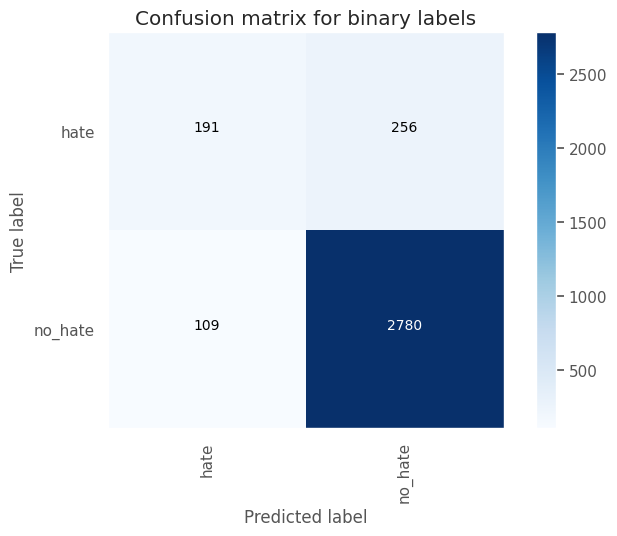

Test Accuracy: 0.8906
Test macro-F1: 0.7249




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_216 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_575 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_196 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_196 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_576 (Dropout)       (None, 42, 64)          

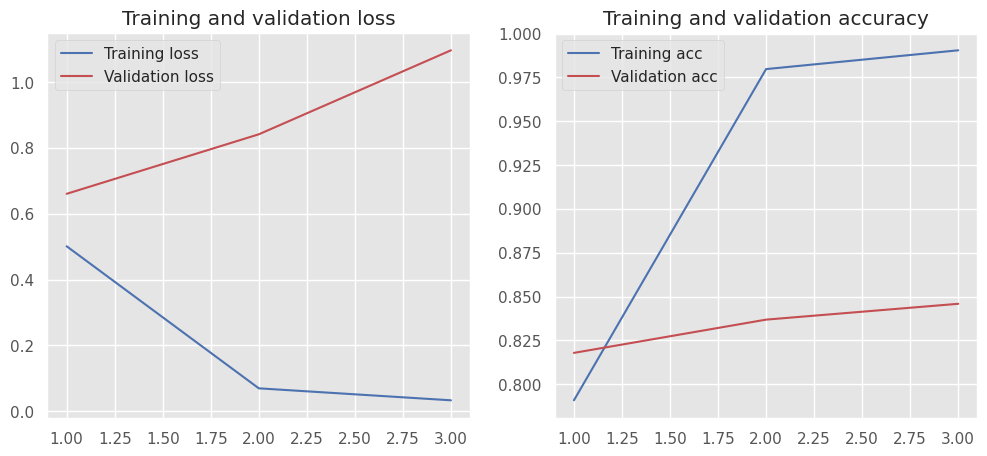

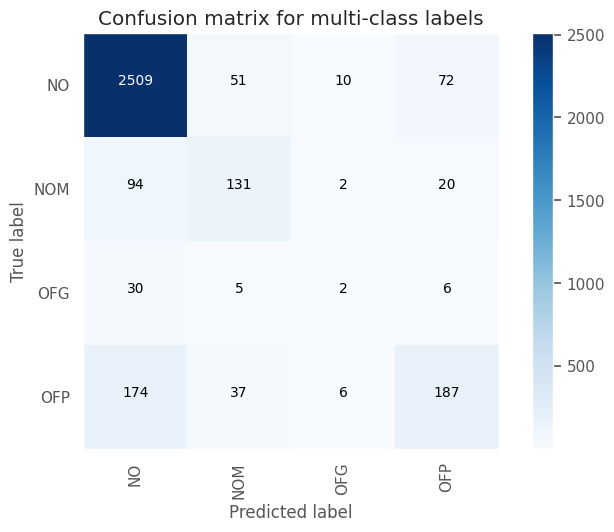

Test Accuracy: 0.848
Test macro-F1: 0.5209


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6590    0.4497    0.5346       447
     no_hate     0.9188    0.9640    0.9409      2889

    accuracy                         0.8951      3336
   macro avg     0.7889    0.7068    0.7377      3336
weighted avg     0.8840    0.8951    0.8864      3336



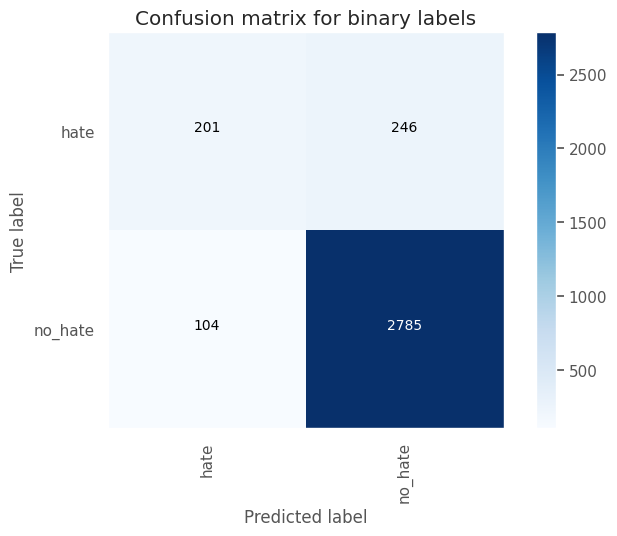

Test Accuracy: 0.8951
Test macro-F1: 0.7377




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "cnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_217 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_578 (Dropout)       (None, 128, 100)          0         
                                                                 
 conv1d_197 (Conv1D)         (None, 126, 64)           19264     
                                                                 
 max_pooling1d_197 (MaxPool  (None, 42, 64)            0         
 ing1D)                                                          
                                                                 
 dropout_579 (Dropout)       (None, 42, 64)          

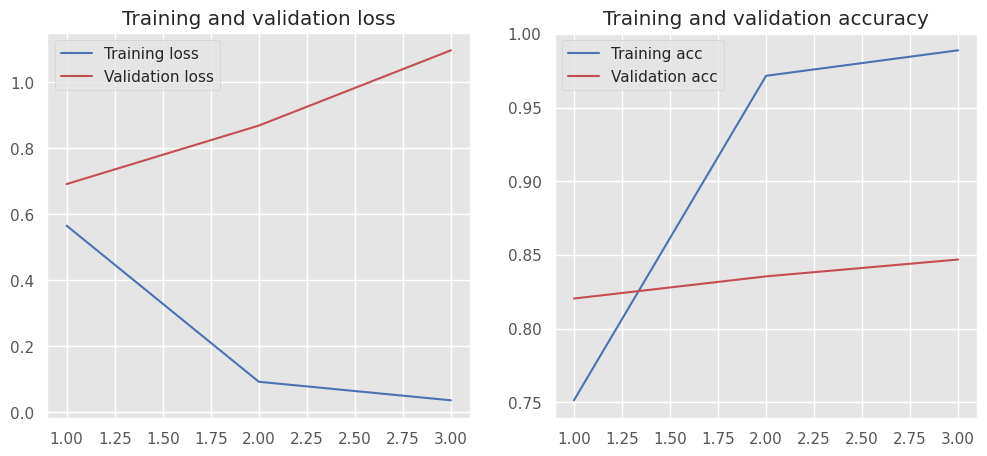

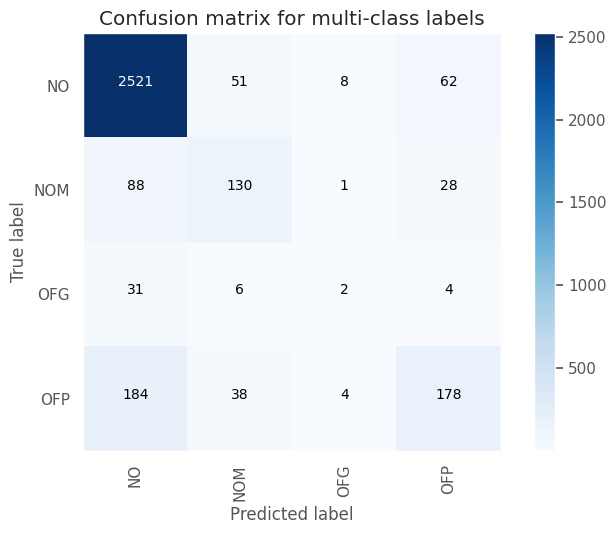

Test Accuracy: 0.8486
Test macro-F1: 0.5172


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6551    0.4206    0.5123       447
     no_hate     0.9151    0.9657    0.9397      2889

    accuracy                         0.8927      3336
   macro avg     0.7851    0.6932    0.7260      3336
weighted avg     0.8802    0.8927    0.8824      3336



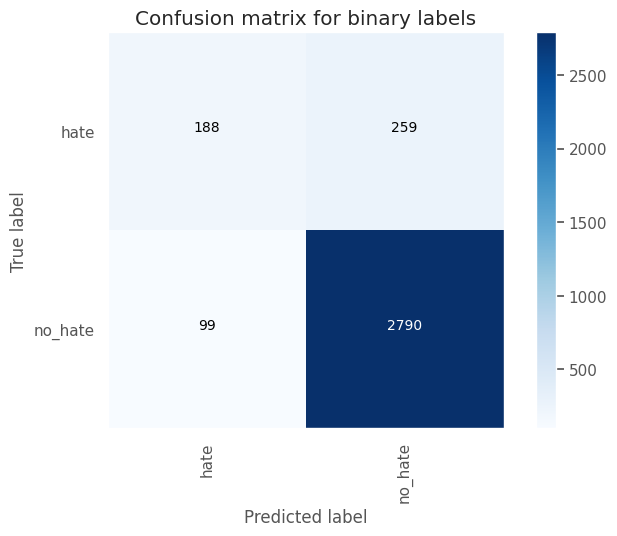

Test Accuracy: 0.8927
Test macro-F1: 0.726







<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>10</th>
      <td>v2</td>
      <td>{'embedding_212': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_563': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_192': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_192': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_564': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_175': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_391': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_565': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_392': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1191720</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5837</td>
      <td>0.5128</td>
      <td>0.5351</td>
      <td>0.7839</td>
      <td>0.7020</td>
      <td>0.7326</td>
    </tr>
    <tr>
      <th>9</th>
      <td>v2</td>
      <td>{'embedding_211': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_560': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_191': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_191': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_561': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_174': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_389': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_562': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_390': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1191720</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5798</td>
      <td>0.5001</td>
      <td>0.5310</td>
      <td>0.7873</td>
      <td>0.6965</td>
      <td>0.7293</td>
    </tr>
    <tr>
      <th>7</th>
      <td>v2</td>
      <td>{'embedding_209': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_554': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_189': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_189': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_555': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_172': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_385': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dropout_556': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_386': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1182408</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5495</td>
      <td>0.5168</td>
      <td>0.5288</td>
      <td>0.7676</td>
      <td>0.7160</td>
      <td>0.7375</td>
    </tr>
    <tr>
      <th>8</th>
      <td>v2</td>
      <td>{'embedding_210': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_557': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_190': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_190': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_558': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_173': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_387': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_559': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_388': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1191720</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5790</td>
      <td>0.4957</td>
      <td>0.5255</td>
      <td>0.7967</td>
      <td>0.6857</td>
      <td>0.7226</td>
    </tr>
    <tr>
      <th>14</th>
      <td>v2</td>
      <td>{'embedding_216': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_575': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_196': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_196': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_576': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_179': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_399': {'class_name': 'Dense', 'param_count': 344192, 'input': (None, 2688), 'output': (None, 128)}, 'dropout_577': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_400': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1364072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5587</td>
      <td>0.4974</td>
      <td>0.5209</td>
      <td>0.7889</td>
      <td>0.7068</td>
      <td>0.7377</td>
    </tr>
    <tr>
      <th>11</th>
      <td>v2</td>
      <td>{'embedding_213': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_566': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_193': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_193': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_567': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_176': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_393': {'class_name': 'Dense', 'param_count': 172096, 'input': (None, 2688), 'output': (None, 64)}, 'dropout_568': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_394': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1191720</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5380</td>
      <td>0.5131</td>
      <td>0.5184</td>
      <td>0.7747</td>
      <td>0.6995</td>
      <td>0.7281</td>
    </tr>
    <tr>
      <th>5</th>
      <td>v2</td>
      <td>{'embedding_207': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_548': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_187': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_187': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_549': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_170': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_381': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dropout_550': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_382': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1182408</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5439</td>
      <td>0.5062</td>
      <td>0.5181</td>
      <td>0.7937</td>
      <td>0.7015</td>
      <td>0.7349</td>
    </tr>
    <tr>
      <th>15</th>
      <td>v2</td>
      <td>{'embedding_217': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_578': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_197': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_197': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_579': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_180': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_401': {'class_name': 'Dense', 'param_count': 344192, 'input': (None, 2688), 'output': (None, 128)}, 'dropout_580': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_402': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1364072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5646</td>
      <td>0.4919</td>
      <td>0.5172</td>
      <td>0.7851</td>
      <td>0.6932</td>
      <td>0.7260</td>
    </tr>
    <tr>
      <th>2</th>
      <td>v2</td>
      <td>{'embedding_204': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_539': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_184': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_184': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_540': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_167': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_375': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_541': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_376': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1096072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5740</td>
      <td>0.4852</td>
      <td>0.5166</td>
      <td>0.7874</td>
      <td>0.7106</td>
      <td>0.7401</td>
    </tr>
    <tr>
      <th>12</th>
      <td>v2</td>
      <td>{'embedding_214': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_569': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_194': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_194': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_570': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_177': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_395': {'class_name': 'Dense', 'param_count': 344192, 'input': (None, 2688), 'output': (None, 128)}, 'dropout_571': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_396': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1364072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5440</td>
      <td>0.4942</td>
      <td>0.5145</td>
      <td>0.7688</td>
      <td>0.7015</td>
      <td>0.7278</td>
    </tr>
    <tr>
      <th>3</th>
      <td>v2</td>
      <td>{'embedding_205': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_542': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_185': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_185': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_543': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_168': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_377': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_544': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_378': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1096072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5736</td>
      <td>0.4841</td>
      <td>0.5139</td>
      <td>0.7850</td>
      <td>0.7082</td>
      <td>0.7376</td>
    </tr>
    <tr>
      <th>0</th>
      <td>v2</td>
      <td>{'embedding_202': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_533': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_182': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_182': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_534': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_165': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_371': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_535': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_372': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1096072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5511</td>
      <td>0.4874</td>
      <td>0.5135</td>
      <td>0.7809</td>
      <td>0.7105</td>
      <td>0.7381</td>
    </tr>
    <tr>
      <th>6</th>
      <td>v2</td>
      <td>{'embedding_208': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_551': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_188': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_188': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_552': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_171': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_383': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dropout_553': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_384': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1182408</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5444</td>
      <td>0.4915</td>
      <td>0.5112</td>
      <td>0.7809</td>
      <td>0.6945</td>
      <td>0.7260</td>
    </tr>
    <tr>
      <th>4</th>
      <td>v2</td>
      <td>{'embedding_206': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_545': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_186': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_186': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_546': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_169': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_379': {'class_name': 'Dense', 'param_count': 172160, 'input': (None, 1344), 'output': (None, 128)}, 'dropout_547': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_380': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1182408</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5318</td>
      <td>0.4936</td>
      <td>0.5098</td>
      <td>0.7436</td>
      <td>0.6966</td>
      <td>0.7161</td>
    </tr>
    <tr>
      <th>13</th>
      <td>v2</td>
      <td>{'embedding_215': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_572': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_195': {'class_name': 'Conv1D', 'param_count': 19264, 'input': (None, 128, 100), 'output': (None, 126, 64)}, 'max_pooling1d_195': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 64), 'output': (None, 42, 64)}, 'dropout_573': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 42, 64)}, 'flatten_178': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 64), 'output': (None, 2688)}, 'dense_397': {'class_name': 'Dense', 'param_count': 344192, 'input': (None, 2688), 'output': (None, 128)}, 'dropout_574': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_398': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1364072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5353</td>
      <td>0.4909</td>
      <td>0.5075</td>
      <td>0.7762</td>
      <td>0.6948</td>
      <td>0.7249</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v2</td>
      <td>{'embedding_203': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_536': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'conv1d_183': {'class_name': 'Conv1D', 'param_count': 9632, 'input': (None, 128, 100), 'output': (None, 126, 32)}, 'max_pooling1d_183': {'class_name': 'MaxPooling1D', 'param_count': 0, 'input': (None, 126, 32), 'output': (None, 42, 32)}, 'dropout_537': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 42, 32)}, 'flatten_166': {'class_name': 'Flatten', 'param_count': 0, 'input': (None, 42, 32), 'output': (None, 1344)}, 'dense_373': {'class_name': 'Dense', 'param_count': 86080, 'input': (None, 1344), 'output': (None, 64)}, 'dropout_538': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_374': {'class_name': 'Dense', 'param_count': 260, 'input': (None, 64), 'output': (None, 4)}}</td>
      <td>1096072</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5363</td>
      <td>0.4889</td>
      <td>0.5063</td>
      <td>0.7890</td>
      <td>0.7038</td>
      <td>0.7354</td>
    </tr>
  </tbody>
</table>
    

In [52]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v2_folder
dataset_name: str = "v2"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

for cnn_filter_dim in [32, 64]:
  for pool_size in [3]:
    for dense_dim in [64, 128]:
      for dp_before_classif_dense in [0.0, 0.3]:
        for dp_after_pool in [0.0, 0.1]:
          # Build CNN model  ===========
          model_config = KerasCNNClassifierModelConfig(
              # General
              vocab_size=vocab_size,
              model_name="cnn_classifier",
              # Embeddings
              embedding_config=EmbeddingConfig(output_dim=embedding_dim, input_length=max_length, trainable=True, pre_trained_matrix=None),
              # CNN Layers
              cnn_filter_dims=[cnn_filter_dim],
              cnn_kernel_sizes=[3],
              cnn_activations=["relu"],
              cnn_stride_sizes=[1],
              cnn_padding=["valid"],
              pool_sizes=[pool_size],
              use_global_pooling=False,
              # Dense layers at the end
              dense_activations=["relu", "softmax"],
              dense_dims=[dense_dim, 4],
              # Dropouts
              dp_after_embedding=0.5,
              dp_after_pooling=[dp_after_pool],
              dp_before_classif_dense=dp_before_classif_dense)
          model: tf.keras.Model = CNNModelFactory.create(model_config)
          # ============================


          # Train  ===========
          trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                    max_input_length=max_length))
          optim_config: OptimizationConfig = OptimizationConfig(
              epochs=25,
              batch_size=32,
              validation_split=0.0,
              validation_data=(x_val, y_val),
              optimizer=Adam(learning_rate=0.001),
              class_weight=None
          )
          trainer.train(x_train=x_train,
                        y_train=y_train,
                        opt_config=optim_config,
                        callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
          mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
          mc_report: dict
          bc_report: dict

          # Accumulate result so it can be plotted
          result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                          dataset_version=dataset_name,
                                          model_params=model.count_params(),
                                          optim_config=optim_config,
                                          macro_prec_mc=mc_report["macro avg"]["precision"],
                                          macro_recall_mc=mc_report["macro avg"]["recall"],
                                          macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                          macro_prec_bc=bc_report["macro avg"]["precision"],
                                          macro_recall_bc=bc_report["macro avg"]["recall"],
                                          macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                          )
          results_rep.accumulate(result)
          # ============================

report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)

Comprobamos no sólo que no mejora, si no que es peor, así que vamos por el buen camino con `v6`.

# Recurrent Neural Networks

Para finalizar esta práctica, intentaremos resolver este problema de clasificación de texto haciendo uso de [redes neuronales recurrentes](https://www.tensorflow.org/guide/keras/working_with_rnns), también conocidas como `Recurrent Neural Networks`, `RNNs`.

Una característica importante de los tipos de redes neuronales que hemos visto
hasta el momento (`Dense` y `CNNs`) es que no tienen memoria. Cada input
que ven es procesado de forma independiente, sin ningun tipo de estado que almecene información entre ellos.

Con este tipo de arquitecturas, si quisiéramos procesar una secuencia o series temporales de datos, tendríamos que mostrarle la secuencia entera de data points a la red de una, volviendola un single data point. Por otro lado, si pensamos en la forma en que nosotros como humanos leemos, lo hacemos procesando la secuencia palabra a palabra, mientras que mantenemos memoria de lo que vino antes de forma de tener información contextual.

Una RNN adopta este mismo principio (de manera un poco más simplificada). lo que hace es procesar una secuencia iterando sobre cada uno de sus elementos y manteniendo un `state` que contiene información relativa de lo que se ha visto (o procesado) hasta ahora. Como tal, una RNN es un tipo de red neuronal que tiene un `loop` interno.

**Hardware a usar**

Es interesante notar que ya aquí el entrenamiento de este tipo de redes sin GPU se vuelve bastante lento, así que ya deberemos hacerlo en un entorno que tenga un hardware apropiado. Usaremos entonces `Google Colab` con la [Tesla T4](https://www.nvidia.com/en-us/data-center/tesla-t4/). En algunos casos (como menciono a continuación), nos podemos beneficiar y obtener resultados más rápidos con multicore CPU que con GPU.

**Uso de unroll**

En general, modelos recurrentes con muy pocos parámetros (como los que podemos probar al principio), tienden a performar mucho más rápido en multicore CPU que en GPU. El motivo, tiene que ver con que involucran multiplicaciones de matrices pequeñas y que el chain de multiplicaciones no es paralelizado muy bien por la presencia de un `for loop` (mencionado antes). Cuando los modelos son más grandes, sí que logramos beneficiarnos más del uso de GPU.

Una forma bastante buena de acelerar el procesamiento de nuestra RNN cuando no podemos usar `cuDNN` es hacer uso de `unrolling`. Con este mecanismo, removemos el for loop y simplemente ponemos N veces el contenido (esto puede llegar a requerir grandes cantidades de memoria RAM).

Al igual que siempre, comenzaré haciendo alguna prueba sencilla para comprobar que nuestro Trainer funciona bien y luego directamente pasaré a usar aquellas arquitecturas que pienso que tienen más chance de funcionar mejor (BiLSTM).

## Entrenando sobre `v6`

Siguiendo la misma lógica que antes, entrenaré sobre `v6`.

Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_178 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_485 (Dropout)       (None, 128, 100)          0         
                                                                 
 simple_rnn_7 (SimpleRNN)    (None, 16)                1872      
                                                                 
 dropout_486 (Dropout)       (None, 16)                0         
                                                                 
 dense_347 (Dense)           (None, 4)                 68        
          

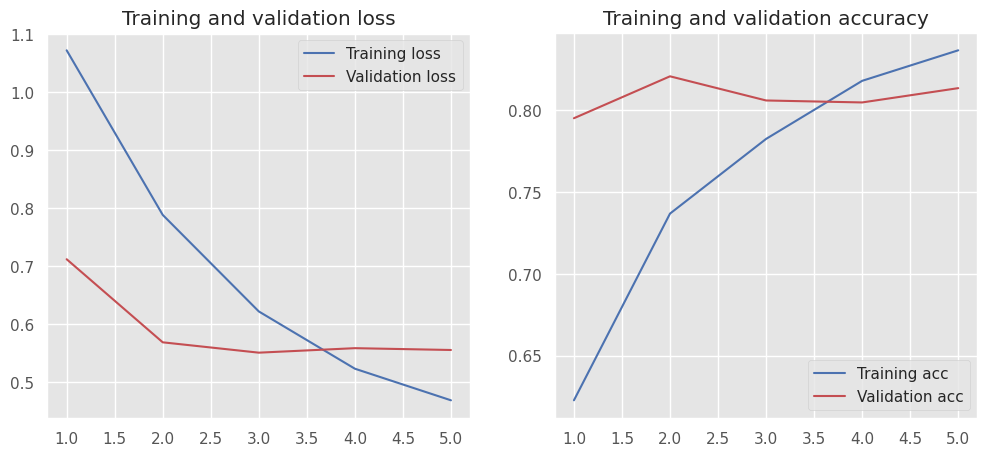

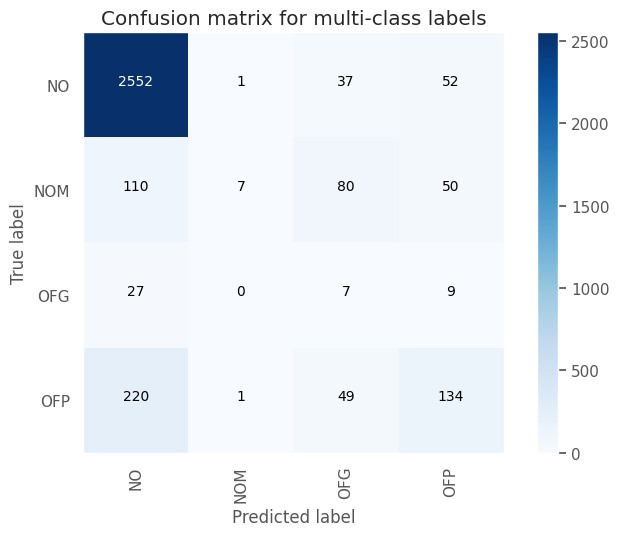

Test Accuracy: 0.8094
Test macro-F1: 0.363


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4761    0.4452    0.4601       447
     no_hate     0.9150    0.9242    0.9196      2889

    accuracy                         0.8600      3336
   macro avg     0.6955    0.6847    0.6898      3336
weighted avg     0.8562    0.8600    0.8580      3336



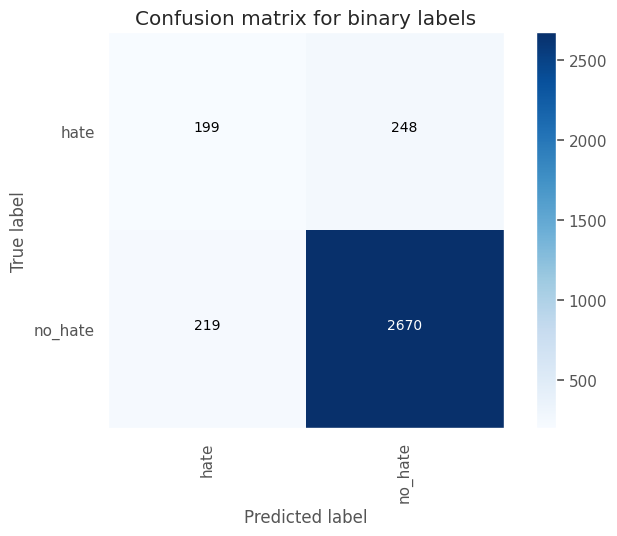

Test Accuracy: 0.86
Test macro-F1: 0.6898




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_179 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_487 (Dropout)       (None, 128, 100)          0         
                                                                 
 simple_rnn_8 (SimpleRNN)    (None, 16)                1872      
                                                                 
 dropout_488 (Dropout)       (None, 16)                0         
                                                                 
 dense_348 (Dense)           (None, 4)                 68        
                                                       

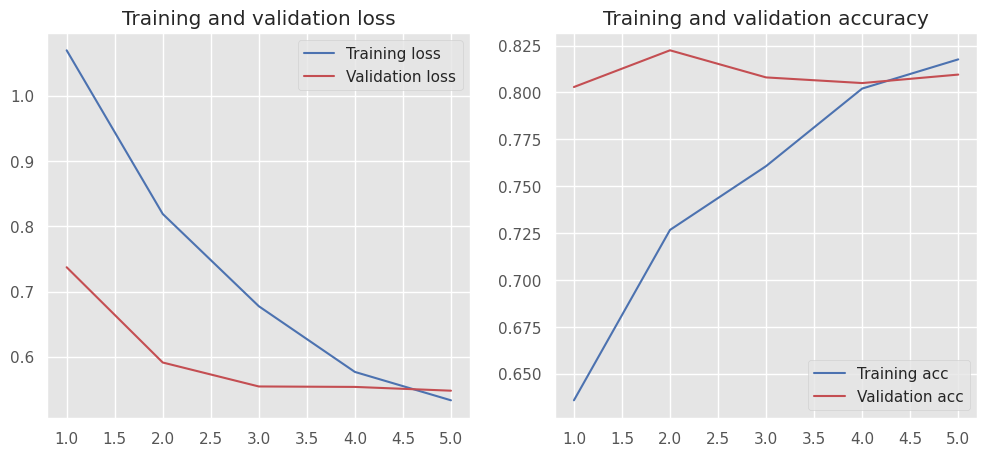

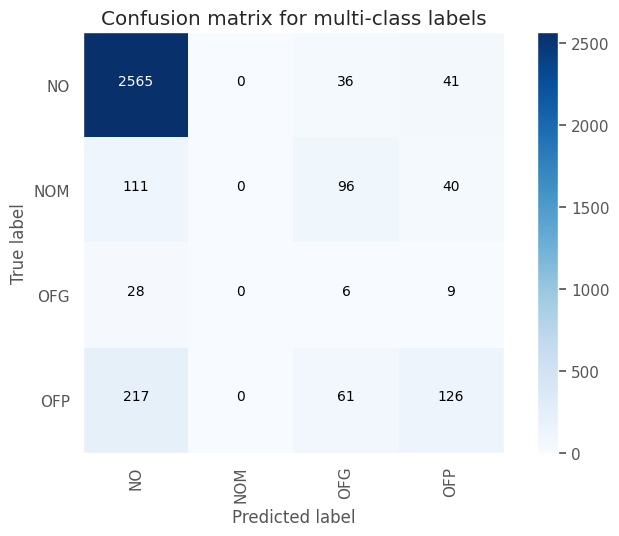

Test Accuracy: 0.8085
Test macro-F1: 0.3446


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4867    0.4519    0.4687       447
     no_hate     0.9161    0.9263    0.9212      2889

    accuracy                         0.8627      3336
   macro avg     0.7014    0.6891    0.6949      3336
weighted avg     0.8586    0.8627    0.8605      3336



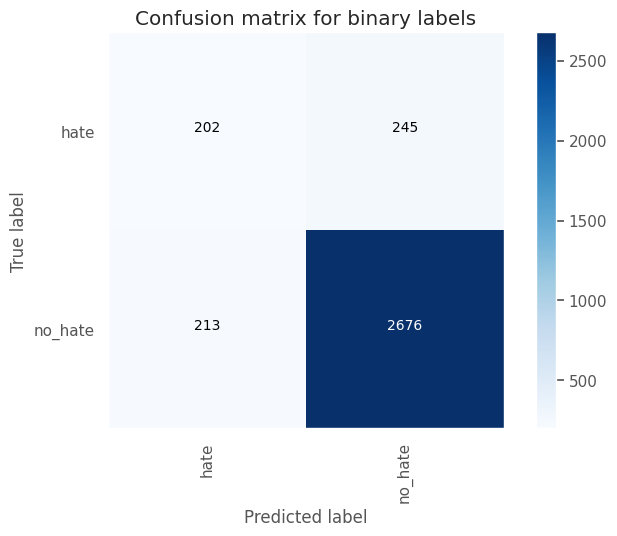

Test Accuracy: 0.8627
Test macro-F1: 0.6949




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_180 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_489 (Dropout)       (None, 128, 100)          0         
                                                                 
 simple_rnn_9 (SimpleRNN)    (None, 16)                1872      
                                                                 
 dropout_490 (Dropout)       (None, 16)                0         
                                                                 
 dense_349 (Dense)           (None, 4)                 68        
                                                     

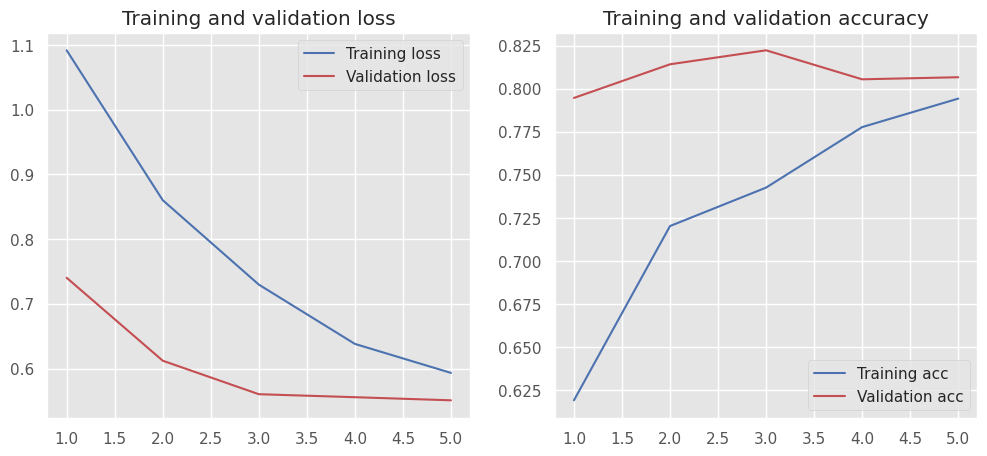

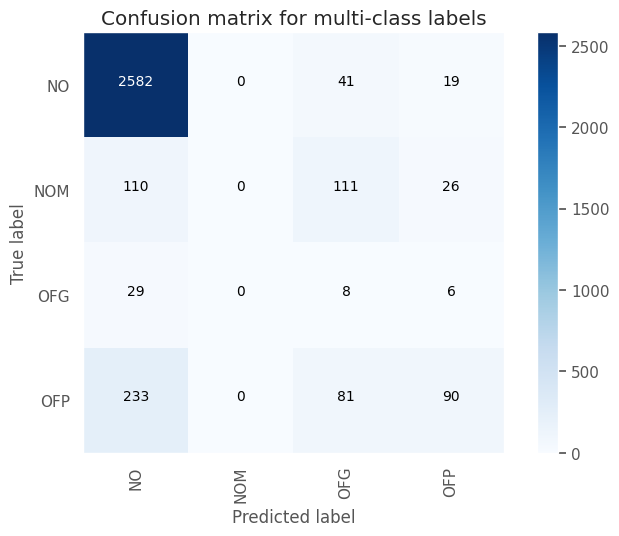

Test Accuracy: 0.8034
Test macro-F1: 0.3274


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4843    0.4139    0.4463       447
     no_hate     0.9113    0.9318    0.9214      2889

    accuracy                         0.8624      3336
   macro avg     0.6978    0.6728    0.6839      3336
weighted avg     0.8541    0.8624    0.8578      3336



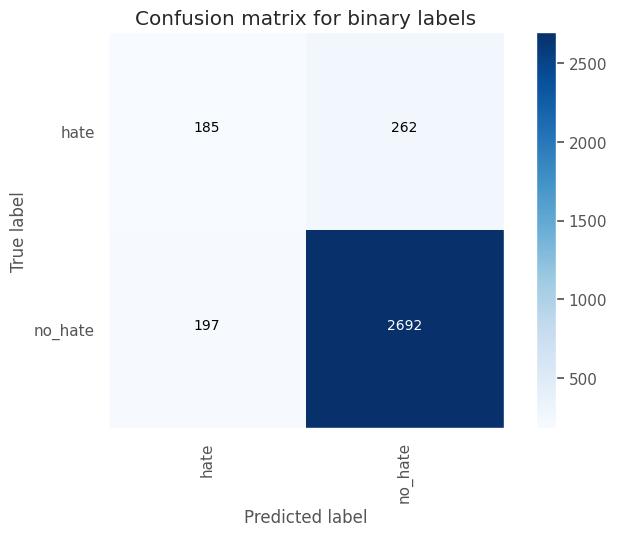

Test Accuracy: 0.8624
Test macro-F1: 0.6839




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_181 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_491 (Dropout)       (None, 128, 100)          0         
                                                                 
 simple_rnn_10 (SimpleRNN)   (None, 16)                1872      
                                                                 
 dropout_492 (Dropout)       (None, 16)                0         
                                                                 
 dense_350 (Dense)           (None, 4)                 68        
                                                     

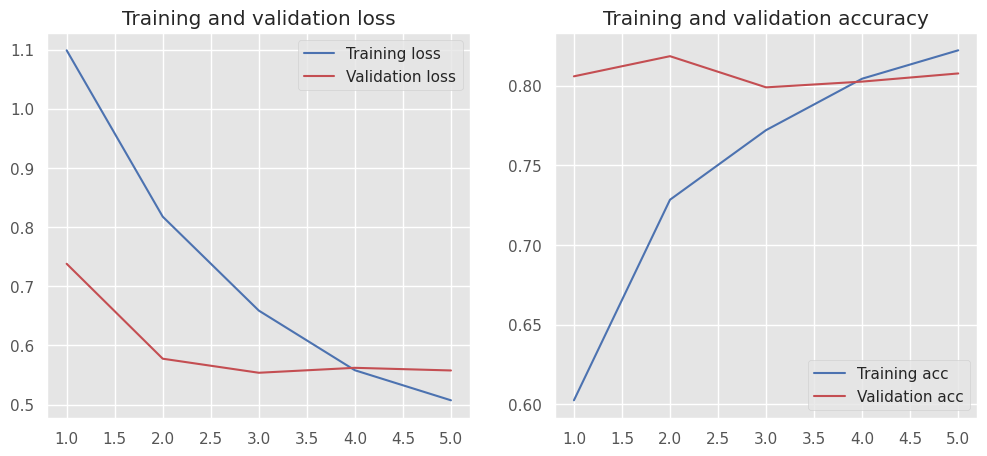

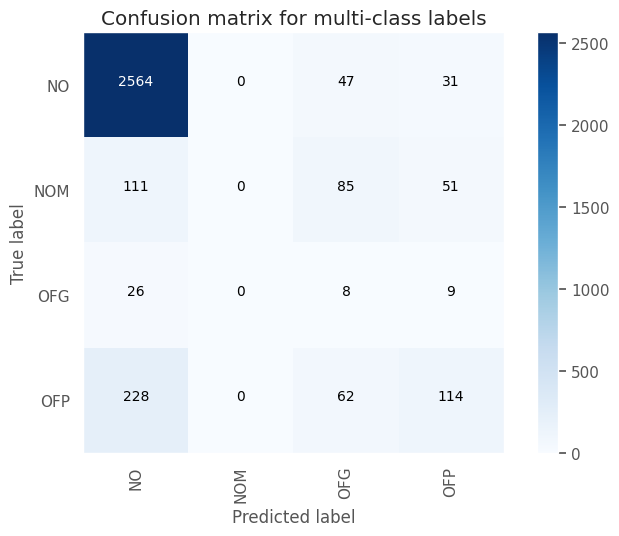

Test Accuracy: 0.8052
Test macro-F1: 0.34


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4742    0.4318    0.4520       447
     no_hate     0.9133    0.9259    0.9196      2889

    accuracy                         0.8597      3336
   macro avg     0.6937    0.6788    0.6858      3336
weighted avg     0.8544    0.8597    0.8569      3336



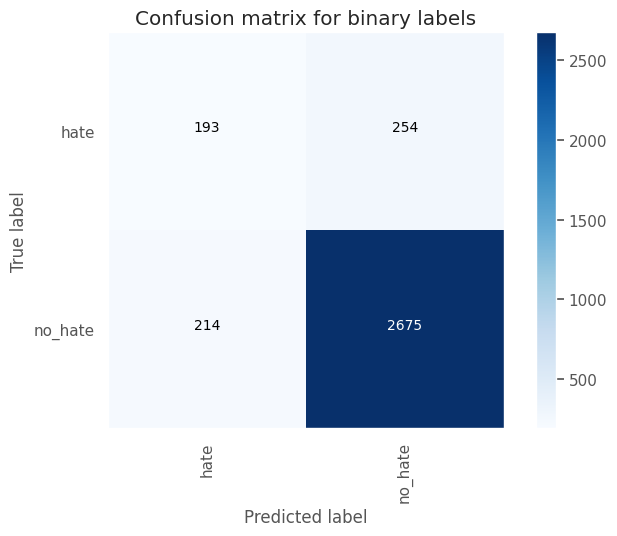

Test Accuracy: 0.8597
Test macro-F1: 0.6858




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_182 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_493 (Dropout)       (None, 128, 100)          0         
                                                                 
 simple_rnn_11 (SimpleRNN)   (None, 16)                1872      
                                                                 
 dropout_494 (Dropout)       (None, 16)                0         
                                                                 
 dense_351 (Dense)           (None, 4)                 68        
                                                     

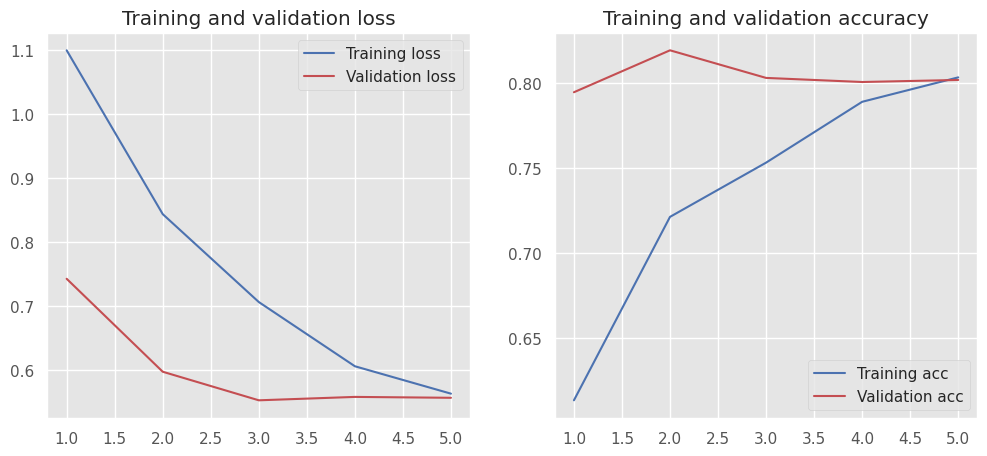

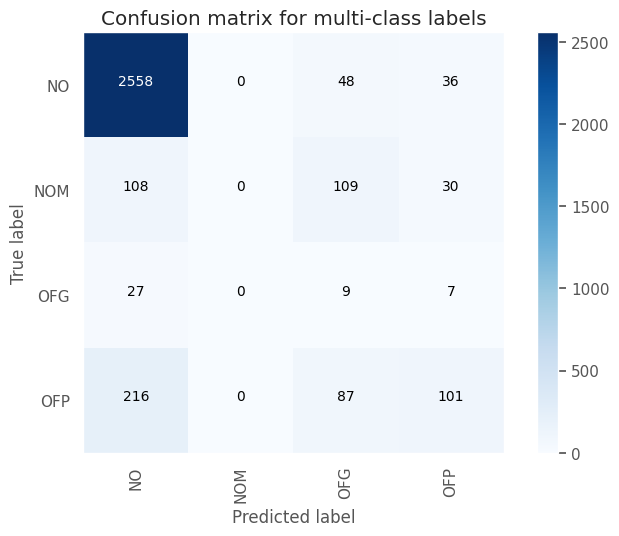

Test Accuracy: 0.7998
Test macro-F1: 0.333


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4778    0.4564    0.4668       447
     no_hate     0.9165    0.9228    0.9196      2889

    accuracy                         0.8603      3336
   macro avg     0.6971    0.6896    0.6932      3336
weighted avg     0.8577    0.8603    0.8590      3336



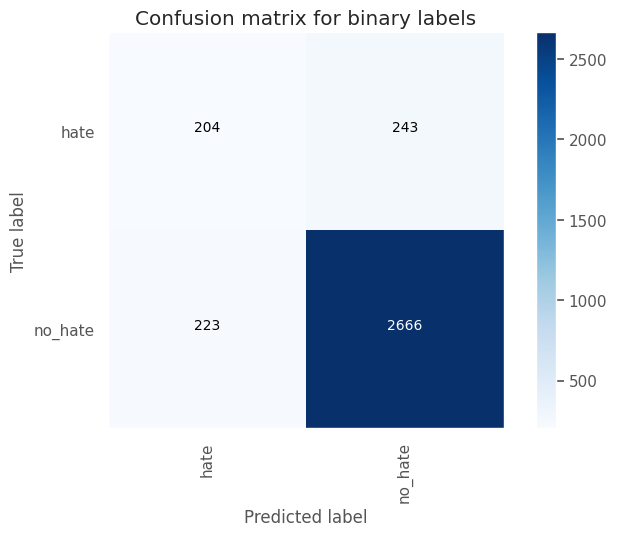

Test Accuracy: 0.8603
Test macro-F1: 0.6932




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_183 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_495 (Dropout)       (None, 128, 100)          0         
                                                                 
 simple_rnn_12 (SimpleRNN)   (None, 16)                1872      
                                                                 
 dropout_496 (Dropout)       (None, 16)                0         
                                                                 
 dense_352 (Dense)           (None, 4)                 68        
                                                     

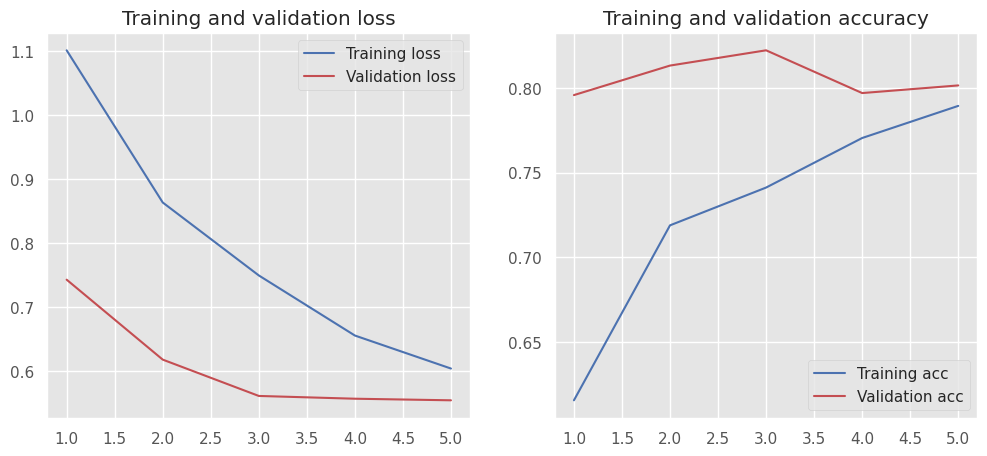

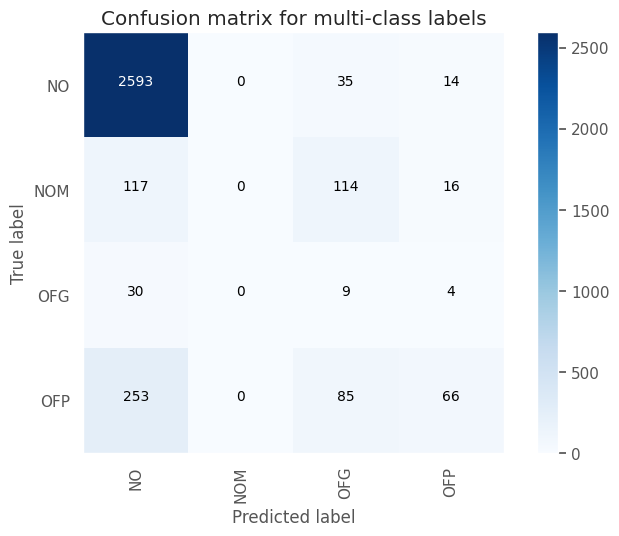

Test Accuracy: 0.7998
Test macro-F1: 0.3113


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4781    0.3669    0.4152       447
     no_hate     0.9054    0.9380    0.9215      2889

    accuracy                         0.8615      3336
   macro avg     0.6918    0.6525    0.6683      3336
weighted avg     0.8482    0.8615    0.8536      3336



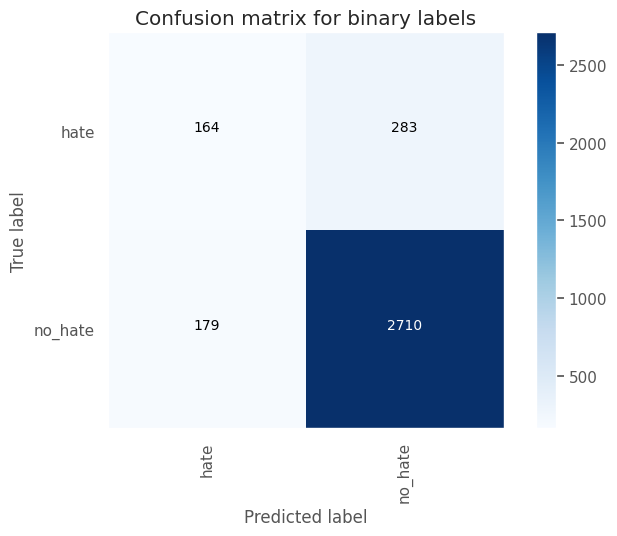

Test Accuracy: 0.8615
Test macro-F1: 0.6683




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_184 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_497 (Dropout)       (None, 128, 100)          0         
                                                                 
 simple_rnn_13 (SimpleRNN)   (None, 16)                1872      
                                                                 
 dropout_498 (Dropout)       (None, 16)                0         
                                                                 
 dense_353 (Dense)           (None, 4)                 68        
                                                     

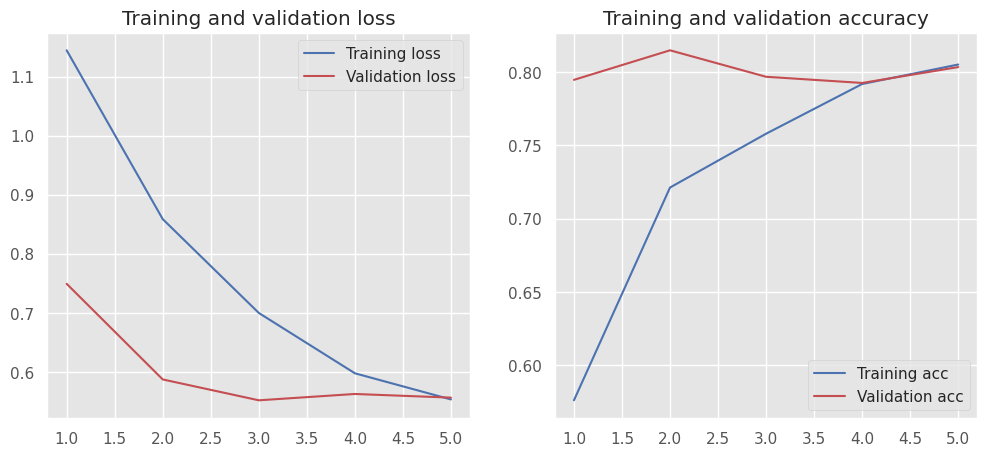

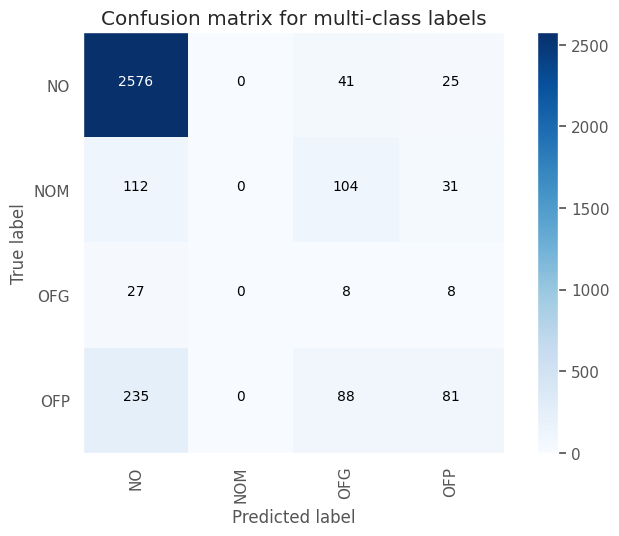

Test Accuracy: 0.7989
Test macro-F1: 0.3182


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4793    0.4139    0.4442       447
     no_hate     0.9112    0.9304    0.9207      2889

    accuracy                         0.8612      3336
   macro avg     0.6952    0.6721    0.6824      3336
weighted avg     0.8533    0.8612    0.8569      3336



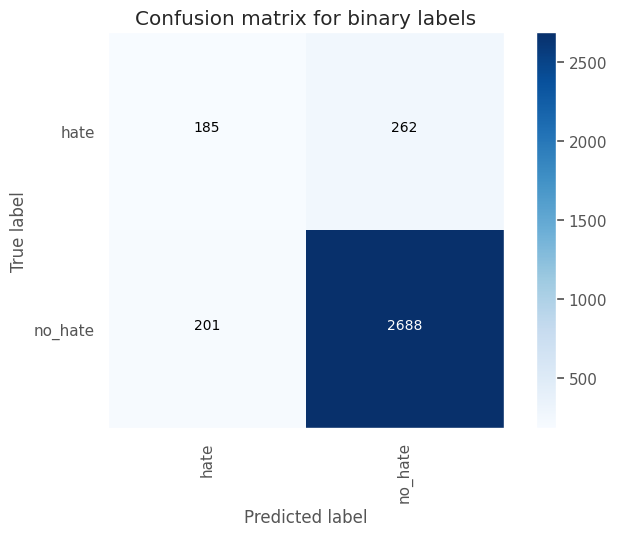

Test Accuracy: 0.8612
Test macro-F1: 0.6824




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_185 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_499 (Dropout)       (None, 128, 100)          0         
                                                                 
 simple_rnn_14 (SimpleRNN)   (None, 16)                1872      
                                                                 
 dropout_500 (Dropout)       (None, 16)                0         
                                                                 
 dense_354 (Dense)           (None, 4)                 68        
                                                     

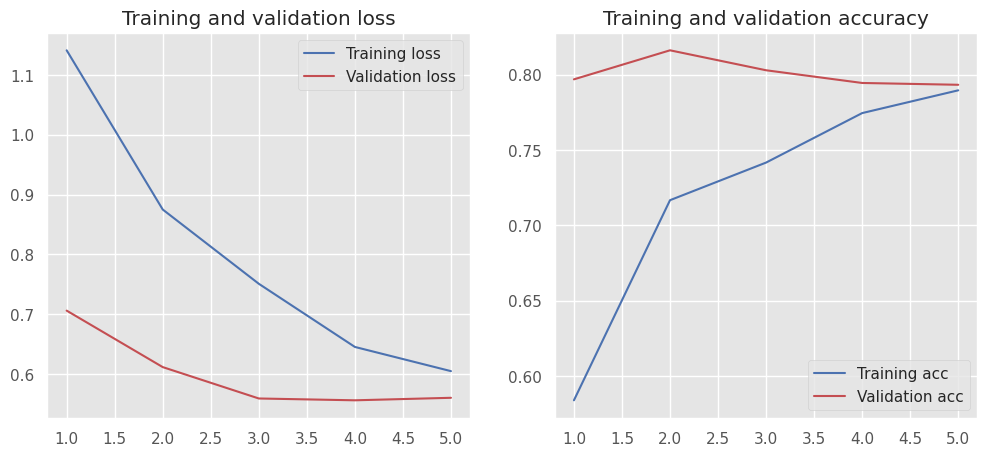

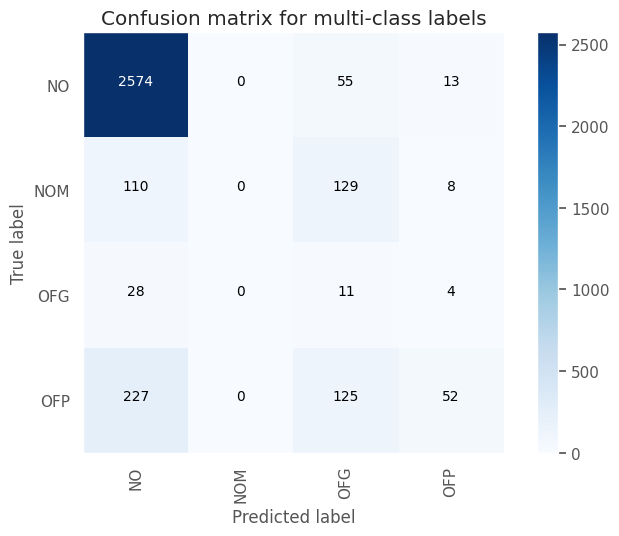

Test Accuracy: 0.7905
Test macro-F1: 0.2998


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4836    0.4295    0.4550       447
     no_hate     0.9132    0.9290    0.9211      2889

    accuracy                         0.8621      3336
   macro avg     0.6984    0.6793    0.6880      3336
weighted avg     0.8557    0.8621    0.8586      3336



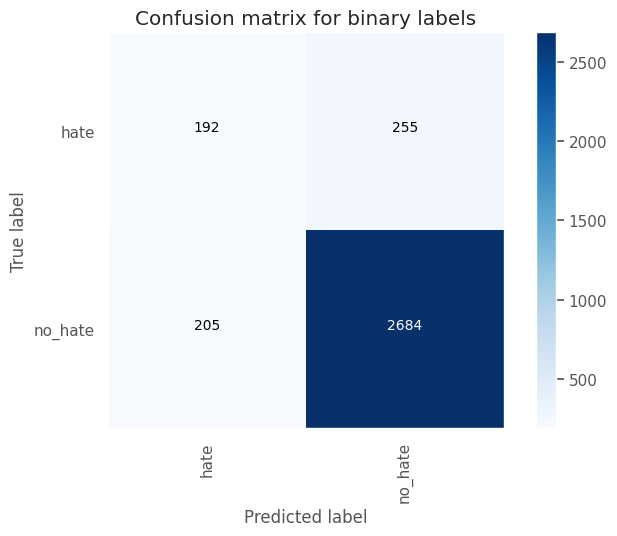

Test Accuracy: 0.8621
Test macro-F1: 0.688




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_186 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_501 (Dropout)       (None, 128, 100)          0         
                                                                 
 simple_rnn_15 (SimpleRNN)   (None, 16)                1872      
                                                                 
 dropout_502 (Dropout)       (None, 16)                0         
                                                                 
 dense_355 (Dense)           (None, 4)                 68        
                                                      

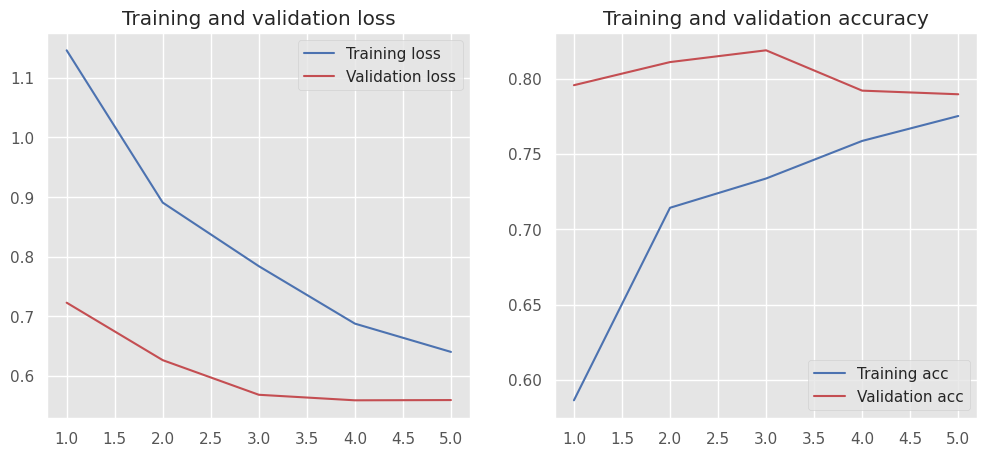

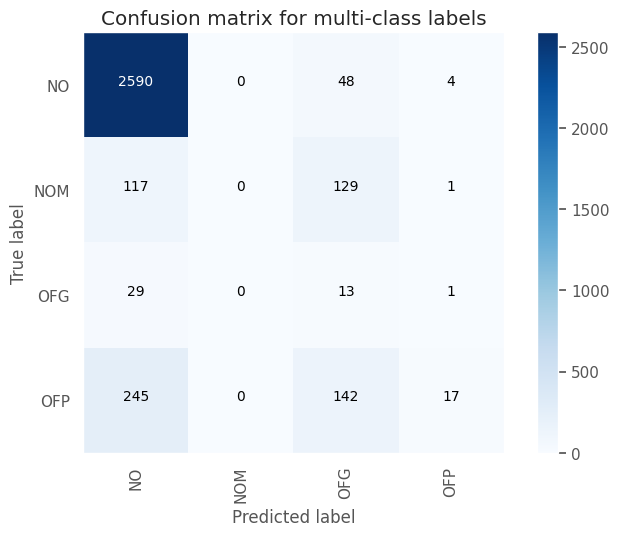

Test Accuracy: 0.7854
Test macro-F1: 0.2675


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4873    0.3870    0.4314       447
     no_hate     0.9081    0.9370    0.9223      2889

    accuracy                         0.8633      3336
   macro avg     0.6977    0.6620    0.6769      3336
weighted avg     0.8517    0.8633    0.8565      3336



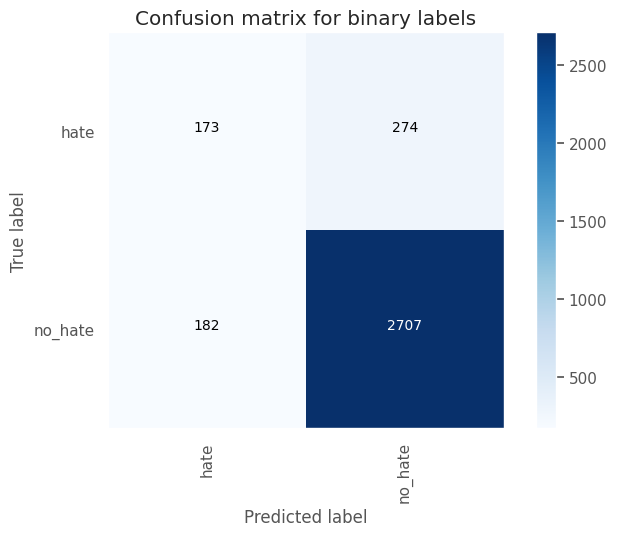

Test Accuracy: 0.8633
Test macro-F1: 0.6769




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_187 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_503 (Dropout)       (None, 128, 100)          0         
                                                                 
 simple_rnn_16 (SimpleRNN)   (None, 16)                1872      
                                                                 
 dropout_504 (Dropout)       (None, 16)                0         
                                                                 
 dense_356 (Dense)           (None, 4)                 68        
                                                     

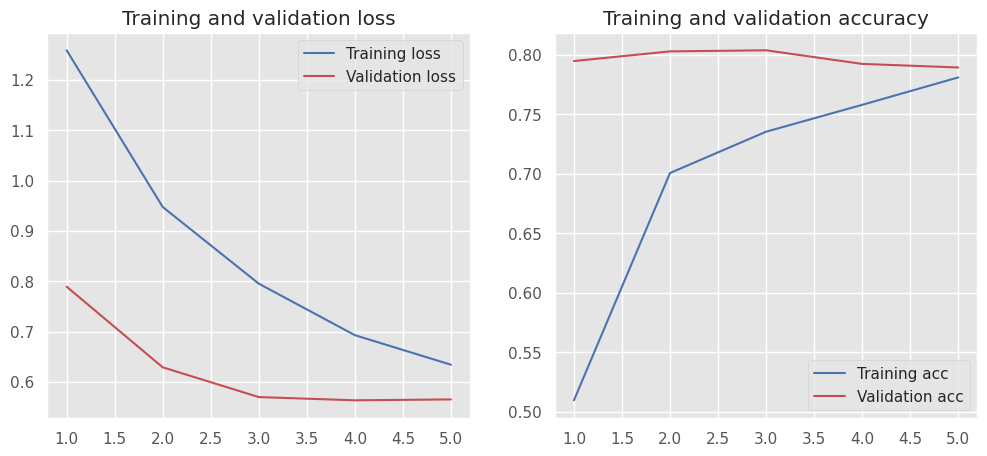

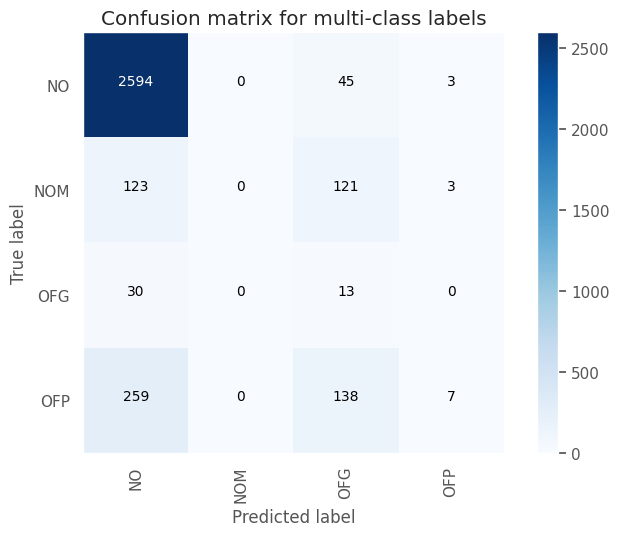

Test Accuracy: 0.7836
Test macro-F1: 0.2561


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4788    0.3535    0.4067       447
     no_hate     0.9039    0.9405    0.9218      2889

    accuracy                         0.8618      3336
   macro avg     0.6913    0.6470    0.6642      3336
weighted avg     0.8469    0.8618    0.8528      3336



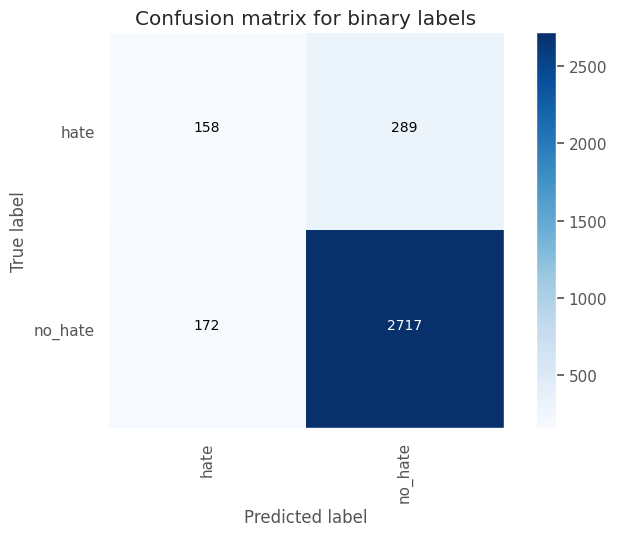

Test Accuracy: 0.8618
Test macro-F1: 0.6642




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_188 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_505 (Dropout)       (None, 128, 100)          0         
                                                                 
 simple_rnn_17 (SimpleRNN)   (None, 16)                1872      
                                                                 
 dropout_506 (Dropout)       (None, 16)                0         
                                                                 
 dense_357 (Dense)           (None, 4)                 68        
                                                     

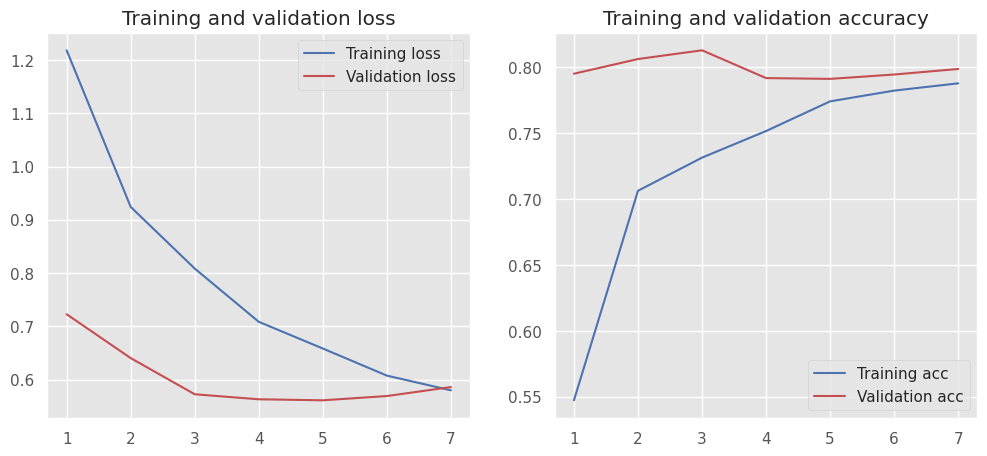

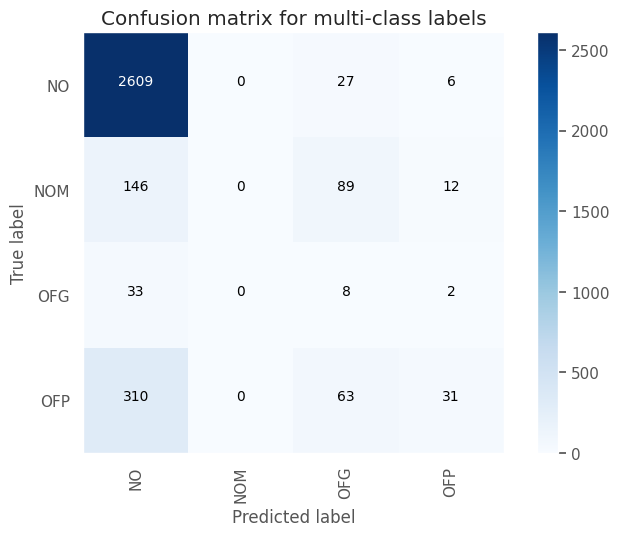

Test Accuracy: 0.7938
Test macro-F1: 0.2787


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4370    0.2327    0.3036       447
     no_hate     0.8893    0.9536    0.9203      2889

    accuracy                         0.8570      3336
   macro avg     0.6631    0.5931    0.6120      3336
weighted avg     0.8287    0.8570    0.8377      3336



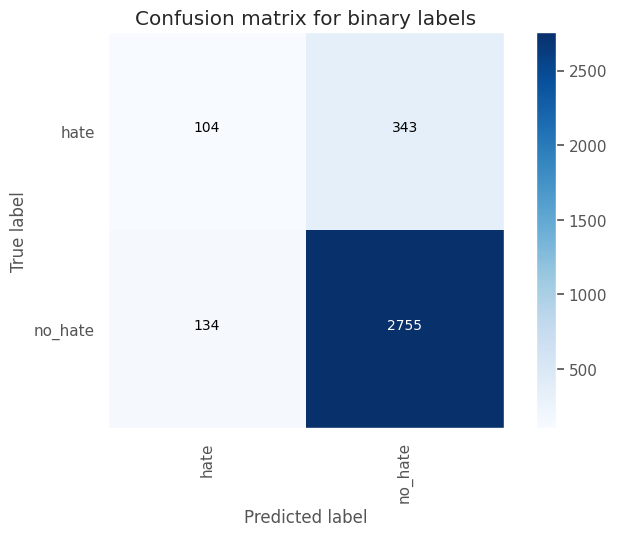

Test Accuracy: 0.857
Test macro-F1: 0.612




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_189 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_507 (Dropout)       (None, 128, 100)          0         
                                                                 
 simple_rnn_18 (SimpleRNN)   (None, 16)                1872      
                                                                 
 dropout_508 (Dropout)       (None, 16)                0         
                                                                 
 dense_358 (Dense)           (None, 4)                 68        
                                                       

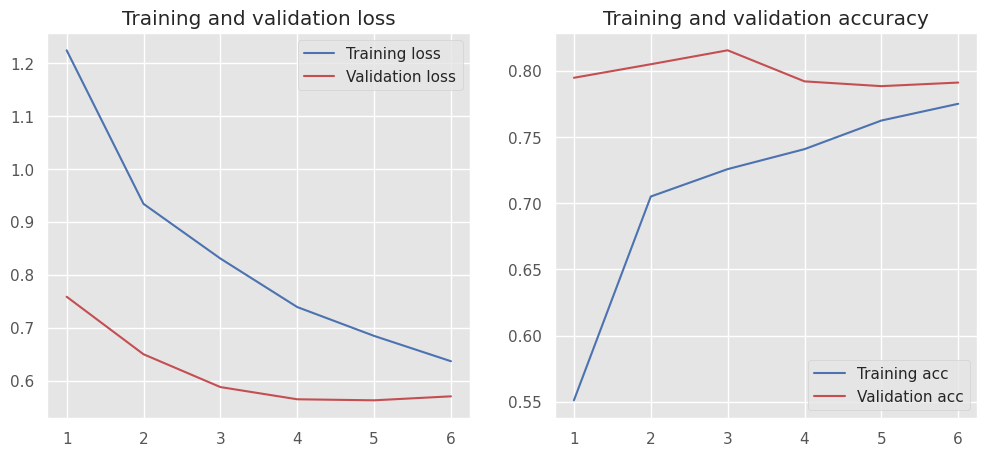

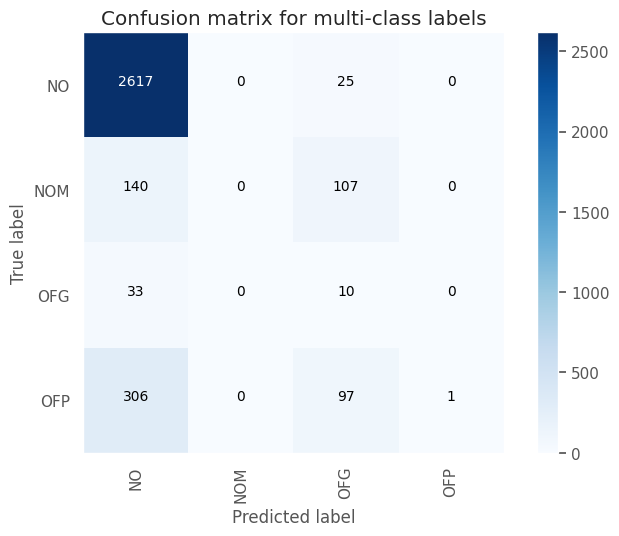

Test Accuracy: 0.7878
Test macro-F1: 0.247


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.4500    0.2416    0.3144       447
     no_hate     0.8905    0.9543    0.9213      2889

    accuracy                         0.8588      3336
   macro avg     0.6703    0.5980    0.6179      3336
weighted avg     0.8315    0.8588    0.8400      3336



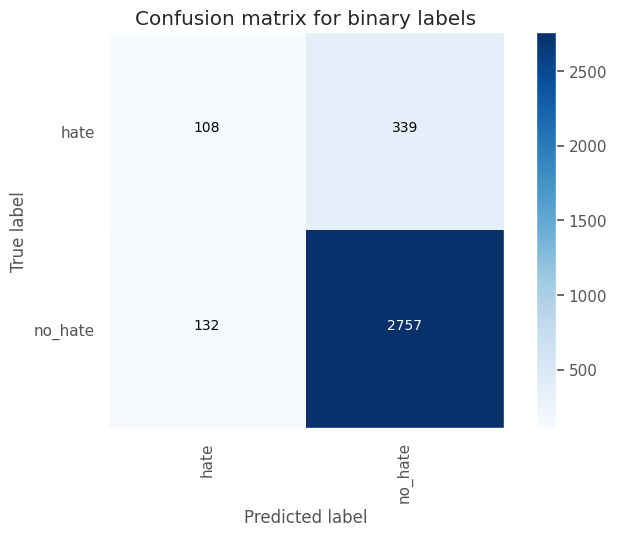

Test Accuracy: 0.8588
Test macro-F1: 0.6179







<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_178': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_485': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'simple_rnn_7': {'class_name': 'SimpleRNN', 'param_count': 1872, 'input': (None, 128, 100), 'output': (None, 16)}, 'dropout_486': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_347': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1002040</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5606</td>
      <td>0.3722</td>
      <td>0.3630</td>
      <td>0.6955</td>
      <td>0.6847</td>
      <td>0.6898</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_179': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_487': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'simple_rnn_8': {'class_name': 'SimpleRNN', 'param_count': 1872, 'input': (None, 128, 100), 'output': (None, 16)}, 'dropout_488': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_348': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1002040</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.3729</td>
      <td>0.3556</td>
      <td>0.3446</td>
      <td>0.7014</td>
      <td>0.6891</td>
      <td>0.6949</td>
    </tr>
    <tr>
      <th>3</th>
      <td>v6</td>
      <td>{'embedding_181': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_491': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'simple_rnn_10': {'class_name': 'SimpleRNN', 'param_count': 1872, 'input': (None, 128, 100), 'output': (None, 16)}, 'dropout_492': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_350': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1002040</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.3678</td>
      <td>0.3597</td>
      <td>0.3400</td>
      <td>0.6937</td>
      <td>0.6788</td>
      <td>0.6858</td>
    </tr>
    <tr>
      <th>4</th>
      <td>v6</td>
      <td>{'embedding_182': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_493': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'simple_rnn_11': {'class_name': 'SimpleRNN', 'param_count': 1872, 'input': (None, 128, 100), 'output': (None, 16)}, 'dropout_494': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_351': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1002040</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.3738</td>
      <td>0.3569</td>
      <td>0.3330</td>
      <td>0.6971</td>
      <td>0.6896</td>
      <td>0.6932</td>
    </tr>
    <tr>
      <th>2</th>
      <td>v6</td>
      <td>{'embedding_180': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_489': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'simple_rnn_9': {'class_name': 'SimpleRNN', 'param_count': 1872, 'input': (None, 128, 100), 'output': (None, 16)}, 'dropout_490': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_349': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1002040</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.3864</td>
      <td>0.3465</td>
      <td>0.3274</td>
      <td>0.6978</td>
      <td>0.6728</td>
      <td>0.6839</td>
    </tr>
    <tr>
      <th>6</th>
      <td>v6</td>
      <td>{'embedding_184': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_497': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'simple_rnn_13': {'class_name': 'SimpleRNN', 'param_count': 1872, 'input': (None, 128, 100), 'output': (None, 16)}, 'dropout_498': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_353': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1002040</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.3663</td>
      <td>0.3404</td>
      <td>0.3182</td>
      <td>0.6952</td>
      <td>0.6721</td>
      <td>0.6824</td>
    </tr>
    <tr>
      <th>5</th>
      <td>v6</td>
      <td>{'embedding_183': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_495': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'simple_rnn_12': {'class_name': 'SimpleRNN', 'param_count': 1872, 'input': (None, 128, 100), 'output': (None, 16)}, 'dropout_496': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_352': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1002040</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.3908</td>
      <td>0.3385</td>
      <td>0.3113</td>
      <td>0.6918</td>
      <td>0.6525</td>
      <td>0.6683</td>
    </tr>
    <tr>
      <th>7</th>
      <td>v6</td>
      <td>{'embedding_185': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_499': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'simple_rnn_14': {'class_name': 'SimpleRNN', 'param_count': 1872, 'input': (None, 128, 100), 'output': (None, 16)}, 'dropout_500': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_354': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1002040</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.3964</td>
      <td>0.3397</td>
      <td>0.2998</td>
      <td>0.6984</td>
      <td>0.6793</td>
      <td>0.6880</td>
    </tr>
    <tr>
      <th>10</th>
      <td>v6</td>
      <td>{'embedding_188': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_505': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'simple_rnn_17': {'class_name': 'SimpleRNN', 'param_count': 1872, 'input': (None, 128, 100), 'output': (None, 16)}, 'dropout_506': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_357': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1002040</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.3732</td>
      <td>0.3126</td>
      <td>0.2787</td>
      <td>0.6631</td>
      <td>0.5931</td>
      <td>0.6120</td>
    </tr>
    <tr>
      <th>8</th>
      <td>v6</td>
      <td>{'embedding_186': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_501': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'simple_rnn_15': {'class_name': 'SimpleRNN', 'param_count': 1872, 'input': (None, 128, 100), 'output': (None, 16)}, 'dropout_502': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_355': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1002040</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.4118</td>
      <td>0.3312</td>
      <td>0.2675</td>
      <td>0.6977</td>
      <td>0.6620</td>
      <td>0.6769</td>
    </tr>
    <tr>
      <th>9</th>
      <td>v6</td>
      <td>{'embedding_187': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_503': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'simple_rnn_16': {'class_name': 'SimpleRNN', 'param_count': 1872, 'input': (None, 128, 100), 'output': (None, 16)}, 'dropout_504': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_356': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1002040</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.3606</td>
      <td>0.3254</td>
      <td>0.2561</td>
      <td>0.6913</td>
      <td>0.6470</td>
      <td>0.6642</td>
    </tr>
    <tr>
      <th>11</th>
      <td>v6</td>
      <td>{'embedding_189': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_507': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'simple_rnn_18': {'class_name': 'SimpleRNN', 'param_count': 1872, 'input': (None, 128, 100), 'output': (None, 16)}, 'dropout_508': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_358': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1002040</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.4718</td>
      <td>0.3064</td>
      <td>0.2470</td>
      <td>0.6703</td>
      <td>0.5980</td>
      <td>0.6179</td>
    </tr>
  </tbody>
</table>
    

In [46]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

for rnn_dropout in [0.5, 0.6, 0.7, 0.8]:
  for emb_dropout in [0.7, 0.8, 0.85]:
      # RNN model. Dump the whole config here so we can always see what we are sending  ===========
      model_config: KerasRNNClassifierModelConfig = KerasRNNClassifierModelConfig(
          vocab_size=vocab_size,
          model_name="rnn_classifier",
          embedding_config=EmbeddingConfig(
              output_dim=embedding_dim,
              input_length=max_length,
              pre_trained_matrix=None,
              trainable=True,
              dropout_rate=emb_dropout
          ),
          rnn_stack_config=RNNStackConfig(
              types=[RNNName.SIMPLE.value],
              units=[16],
              bidirectional=False,
              unroll=True,
              internal_dp_rates=[0.0],
              recurrent_dp_rates=[0.1],
              external_dp_rates=[rnn_dropout]
          ),
          classification_head_config=ClassificationHeadConfig(
              dense_activations=["softmax"],
              dense_dims=[4],
              dropout_rates=[0.0]
          ))
      model = RNNModelFactory.create(model_config)
      # ============================

      # Train  ===========
      trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                max_input_length=max_length))
      optim_config: OptimizationConfig = OptimizationConfig(
          epochs=25,
          batch_size=32,
          validation_split=0.0,
          validation_data=(x_val, y_val),
          optimizer=Adam(learning_rate=0.001),
          class_weight=None
      )
      trainer.train(x_train=x_train,
                    y_train=y_train,
                    opt_config=optim_config,
                    callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
      mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
      mc_report: dict
      bc_report: dict

      # Accumulate result so it can be plotted
      result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                      dataset_version=dataset_name,
                                      model_params=model.count_params(),
                                      optim_config=optim_config,
                                      macro_prec_mc=mc_report["macro avg"]["precision"],
                                      macro_recall_mc=mc_report["macro avg"]["recall"],
                                      macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                      macro_prec_bc=bc_report["macro avg"]["precision"],
                                      macro_recall_bc=bc_report["macro avg"]["recall"],
                                      macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                      )
      results_rep.accumulate(result)
      # ============================

report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)

Usando una `SimpleRNN`, obtenemos **36.30% de macro-f1 (MULTI-CLASS) y 68.98% de macro-f1 (BINARY-CLASS)**, performance que es bastante pobre.

Mirando las curvas de entrenamiento, la realidad es que no se ven tan mal, pero sí es cierto que logramos entrenar por pocas epochs antes de stoppear.



Como comenté en la práctica anterior, probar todas las combinaciones de hiper-parámetros y arquitecturas posibles para resolver este problema no es factible en términos de tiempo. Es por esto que para RNNs me enfocaré únicamente en la arquitectura que vi que obtuvo históricamente mejores resultados para esta tarea, que es LSTM.

Realizaré algunas pruebas con LSTMs y al final con BiLSTMs para ver si logro obtener buenos resultados.

Inicialmente partiré de una estructura sencilla que no tiene stacking, y ya luego la iré evolucionando en función de los resultados que tenga.

Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier_lstm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_190 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_509 (Dropout)       (None, 128, 100)          0         
                                                                 
 lstm (LSTM)                 (None, 16)                7488      
                                                                 
 dropout_510 (Dropout)       (None, 16)                0         
                                                                 
 dense_359 (Dense)           (None, 4)                 68        
     

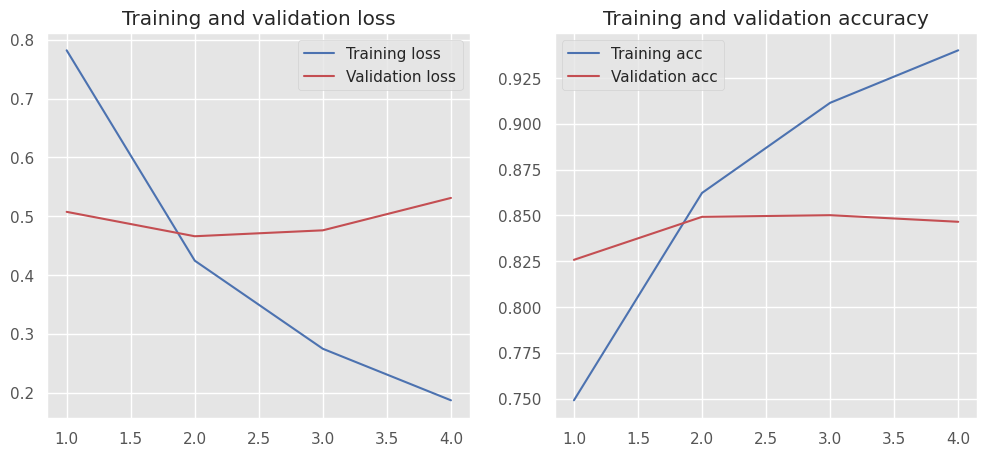

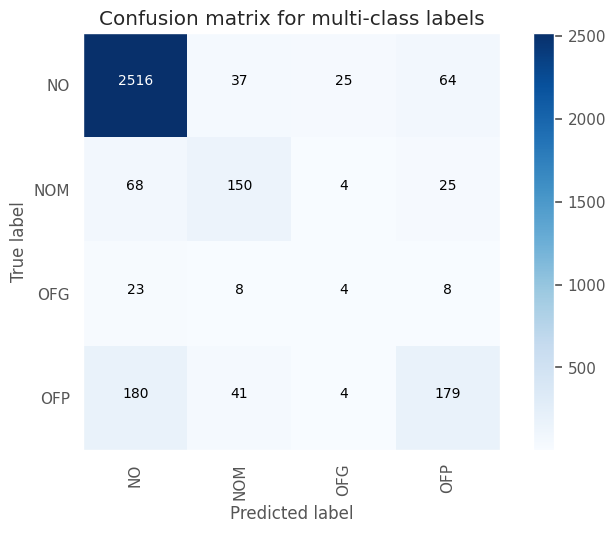

Test Accuracy: 0.854
Test macro-F1: 0.5436


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6230    0.4362    0.5132       447
     no_hate     0.9166    0.9592    0.9374      2889

    accuracy                         0.8891      3336
   macro avg     0.7698    0.6977    0.7253      3336
weighted avg     0.8773    0.8891    0.8806      3336



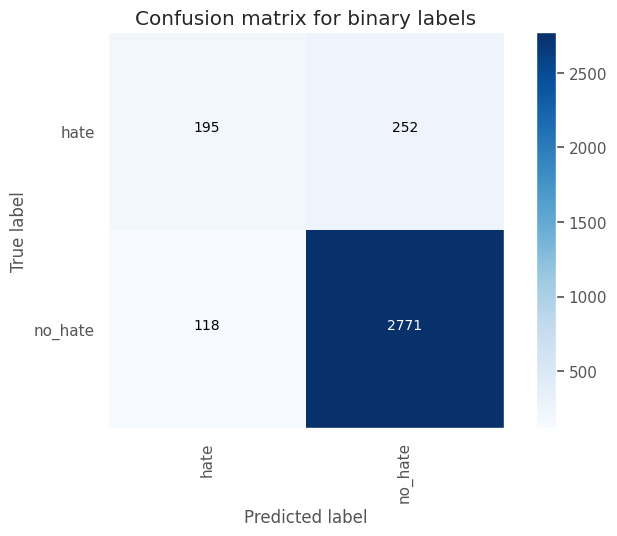

Test Accuracy: 0.8891
Test macro-F1: 0.7253




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier_lstm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_191 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_511 (Dropout)       (None, 128, 100)          0         
                                                                 
 lstm_1 (LSTM)               (None, 16)                7488      
                                                                 
 dropout_512 (Dropout)       (None, 16)                0         
                                                                 
 dense_360 (Dense)           (None, 4)                 68        
                                                

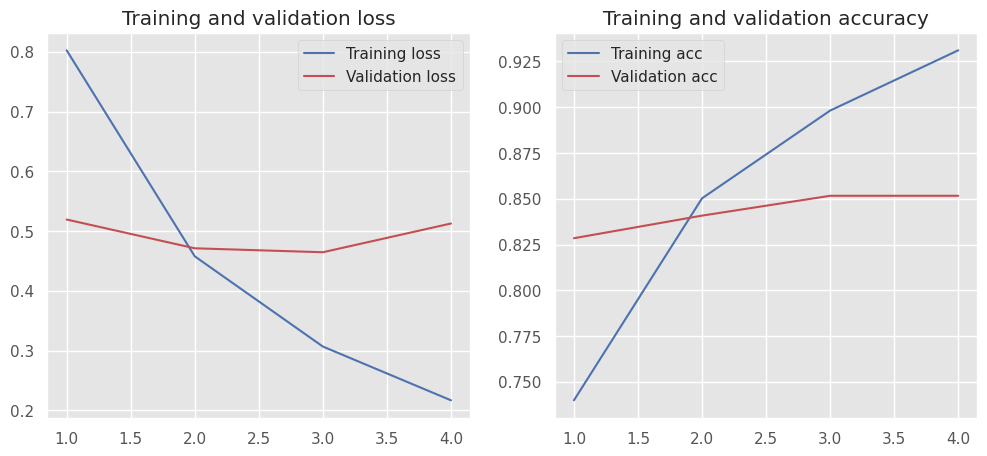

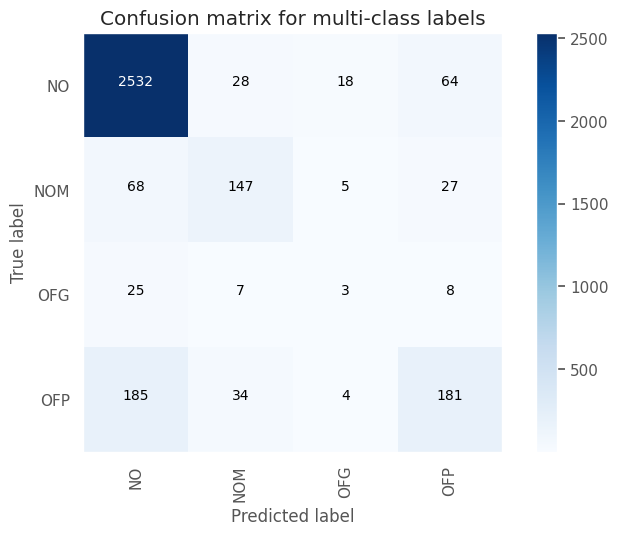

Test Accuracy: 0.8582
Test macro-F1: 0.5438


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6323    0.4385    0.5178       447
     no_hate     0.9171    0.9605    0.9383      2889

    accuracy                         0.8906      3336
   macro avg     0.7747    0.6995    0.7281      3336
weighted avg     0.8789    0.8906    0.8820      3336



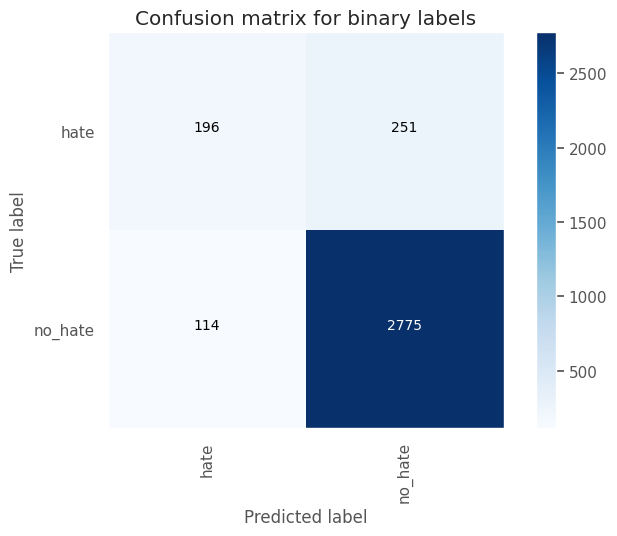

Test Accuracy: 0.8906
Test macro-F1: 0.7281




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier_lstm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_192 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_513 (Dropout)       (None, 128, 100)          0         
                                                                 
 lstm_2 (LSTM)               (None, 16)                7488      
                                                                 
 dropout_514 (Dropout)       (None, 16)                0         
                                                                 
 dense_361 (Dense)           (None, 4)                 68        
                                                

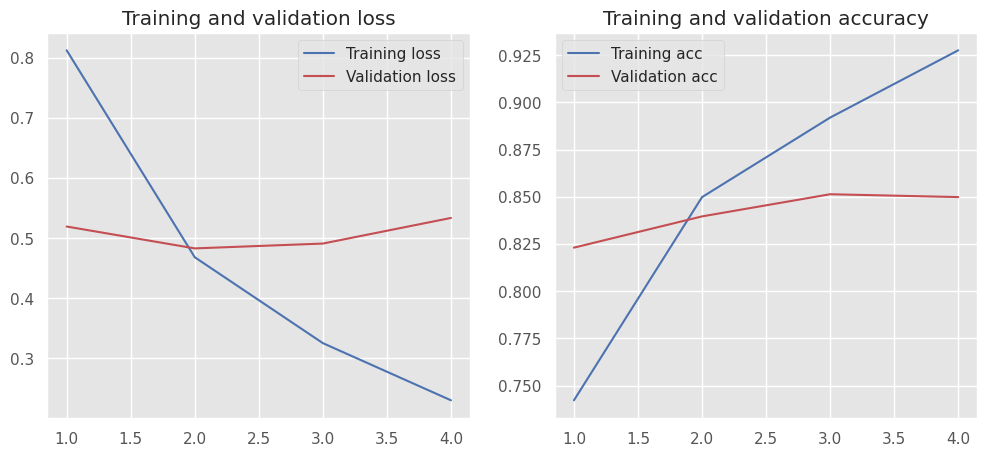

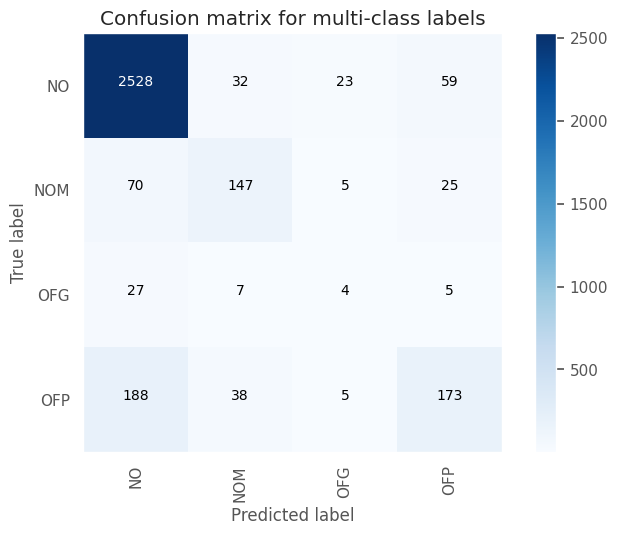

Test Accuracy: 0.8549
Test macro-F1: 0.5426


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6254    0.4183    0.5013       447
     no_hate     0.9144    0.9612    0.9372      2889

    accuracy                         0.8885      3336
   macro avg     0.7699    0.6898    0.7193      3336
weighted avg     0.8757    0.8885    0.8788      3336



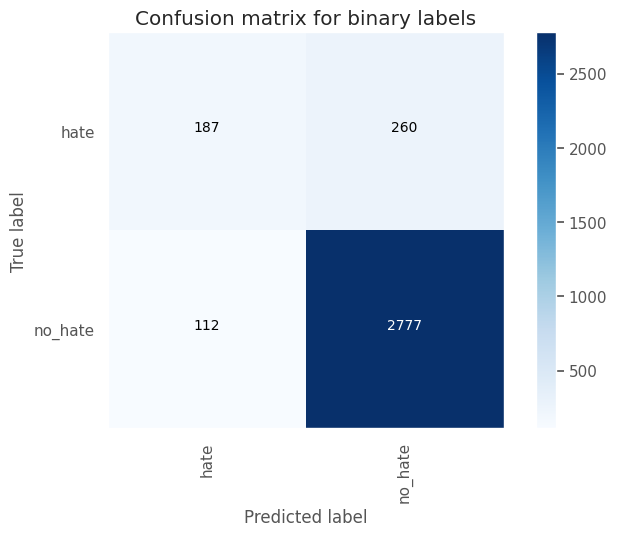

Test Accuracy: 0.8885
Test macro-F1: 0.7193




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier_lstm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_193 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_515 (Dropout)       (None, 128, 100)          0         
                                                                 
 lstm_3 (LSTM)               (None, 16)                7488      
                                                                 
 dropout_516 (Dropout)       (None, 16)                0         
                                                                 
 dense_362 (Dense)           (None, 4)                 68        
                                                

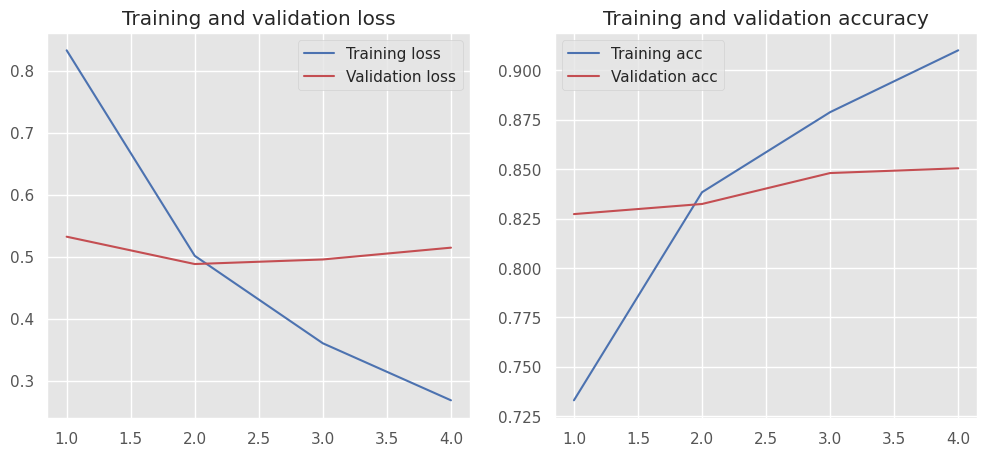

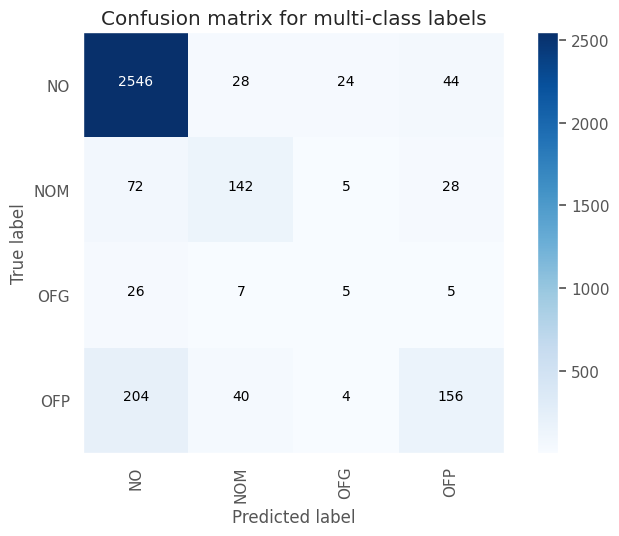

Test Accuracy: 0.854
Test macro-F1: 0.5382


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6273    0.3803    0.4735       447
     no_hate     0.9096    0.9650    0.9365      2889

    accuracy                         0.8867      3336
   macro avg     0.7685    0.6727    0.7050      3336
weighted avg     0.8718    0.8867    0.8745      3336



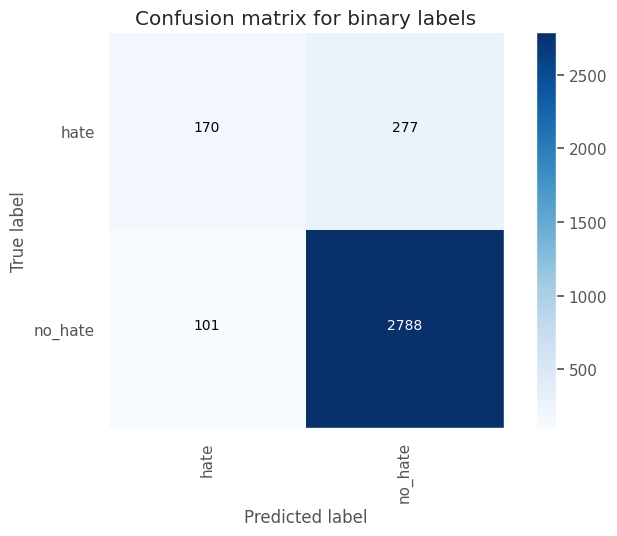

Test Accuracy: 0.8867
Test macro-F1: 0.705







<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_191': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_511': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'lstm_1': {'class_name': 'LSTM', 'param_count': 7488, 'input': (None, 128, 100), 'output': (None, 16)}, 'dropout_512': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_360': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1007656</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5820</td>
      <td>0.5178</td>
      <td>0.5438</td>
      <td>0.7747</td>
      <td>0.6995</td>
      <td>0.7281</td>
    </tr>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_190': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_509': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'lstm': {'class_name': 'LSTM', 'param_count': 7488, 'input': (None, 128, 100), 'output': (None, 16)}, 'dropout_510': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_359': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1007656</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5738</td>
      <td>0.5239</td>
      <td>0.5436</td>
      <td>0.7698</td>
      <td>0.6977</td>
      <td>0.7253</td>
    </tr>
    <tr>
      <th>2</th>
      <td>v6</td>
      <td>{'embedding_192': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_513': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'lstm_2': {'class_name': 'LSTM', 'param_count': 7488, 'input': (None, 128, 100), 'output': (None, 16)}, 'dropout_514': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_361': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1007656</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5808</td>
      <td>0.5183</td>
      <td>0.5426</td>
      <td>0.7699</td>
      <td>0.6898</td>
      <td>0.7193</td>
    </tr>
    <tr>
      <th>3</th>
      <td>v6</td>
      <td>{'embedding_193': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_515': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'lstm_3': {'class_name': 'LSTM', 'param_count': 7488, 'input': (None, 128, 100), 'output': (None, 16)}, 'dropout_516': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 16), 'output': (None, 16)}, 'dense_362': {'class_name': 'Dense', 'param_count': 68, 'input': (None, 16), 'output': (None, 4)}}</td>
      <td>1007656</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5874</td>
      <td>0.5102</td>
      <td>0.5382</td>
      <td>0.7685</td>
      <td>0.6727</td>
      <td>0.7050</td>
    </tr>
  </tbody>
</table>
    

In [47]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

for rnn_dropout in [0.3, 0.5]:
  for emb_dropout in [0.3, 0.5]:
      # RNN model. Dump the whole config here so we can always see what we are sending  ===========
      model_config: KerasRNNClassifierModelConfig = KerasRNNClassifierModelConfig(
          vocab_size=vocab_size,
          model_name="rnn_classifier_lstm",
          embedding_config=EmbeddingConfig(
              output_dim=embedding_dim,
              input_length=max_length,
              pre_trained_matrix=None,
              trainable=True,
              dropout_rate=emb_dropout
          ),
          rnn_stack_config=RNNStackConfig(
              types=[RNNName.LSTM.value],
              units=[16],
              bidirectional=False,
              unroll=True,
              internal_dp_rates=[0.0],
              recurrent_dp_rates=[0.1],
              external_dp_rates=[rnn_dropout]
          ),
          classification_head_config=ClassificationHeadConfig(
              dense_activations=["softmax"],
              dense_dims=[4],
              dropout_rates=[0.0]
          ))
      model = RNNModelFactory.create(model_config)
      # ============================

      # Train  ===========
      trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                max_input_length=max_length))
      optim_config: OptimizationConfig = OptimizationConfig(
          epochs=25,
          batch_size=32,
          validation_split=0.0,
          validation_data=(x_val, y_val),
          optimizer=Adam(learning_rate=0.001),
          class_weight=None
      )
      trainer.train(x_train=x_train,
                    y_train=y_train,
                    opt_config=optim_config,
                    callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
      mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
      mc_report: dict
      bc_report: dict

      # Accumulate result so it can be plotted
      result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                      dataset_version=dataset_name,
                                      model_params=model.count_params(),
                                      optim_config=optim_config,
                                      macro_prec_mc=mc_report["macro avg"]["precision"],
                                      macro_recall_mc=mc_report["macro avg"]["recall"],
                                      macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                      macro_prec_bc=bc_report["macro avg"]["precision"],
                                      macro_recall_bc=bc_report["macro avg"]["recall"],
                                      macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                      )
      results_rep.accumulate(result)
      # ============================

report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)

Partiendo de esta estructura sencilla, logramos un **54.38% de macro-f1 (MULTI-CLASS) y 72.81% de macro-f1 (BINARY-CLASS)**, a través de usar LSTMs. La performance sigue siendo baja, pero está a la par de la obtenida con Dense NNs y CNNs.

Repetiré ahora la misma prueba pero usando Bidirectional.

Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier_lstm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_194 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_517 (Dropout)       (None, 128, 100)          0         
                                                                 
 bidirectional (Bidirection  (None, 32)                14976     
 al)                                                             
                                                                 
 dropout_518 (Dropout)       (None, 32)                0         
                                                                 
 dens

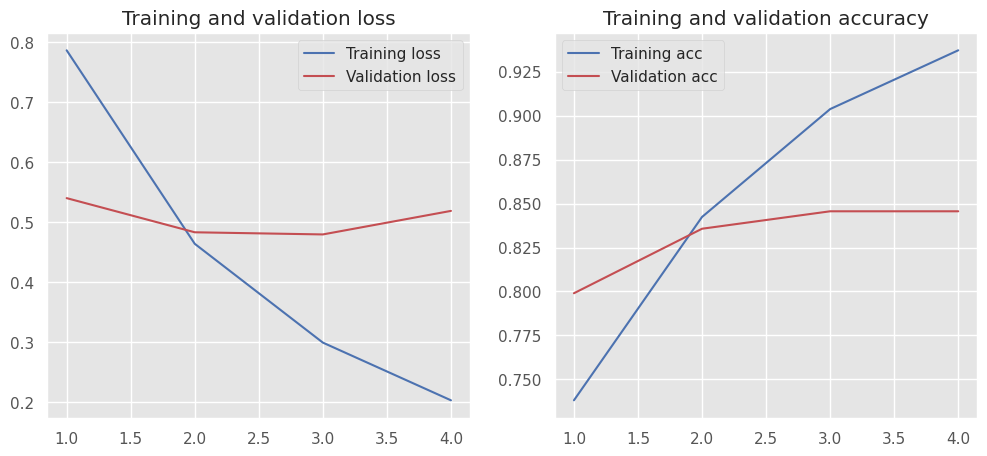

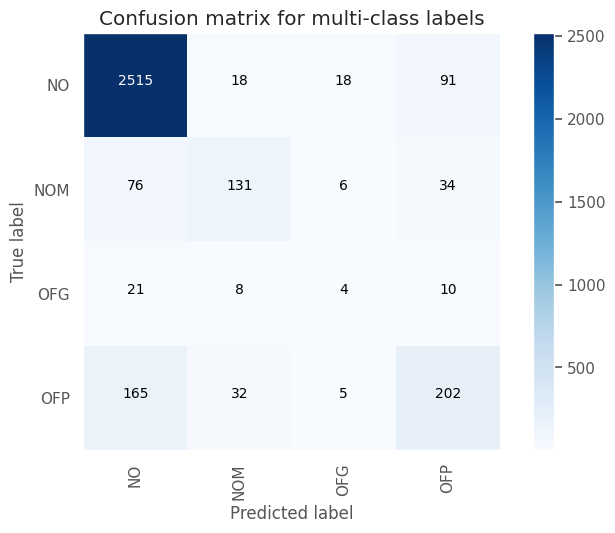

Test Accuracy: 0.8549
Test macro-F1: 0.5449


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5973    0.4944    0.5410       447
     no_hate     0.9238    0.9484    0.9360      2889

    accuracy                         0.8876      3336
   macro avg     0.7606    0.7214    0.7385      3336
weighted avg     0.8801    0.8876    0.8830      3336



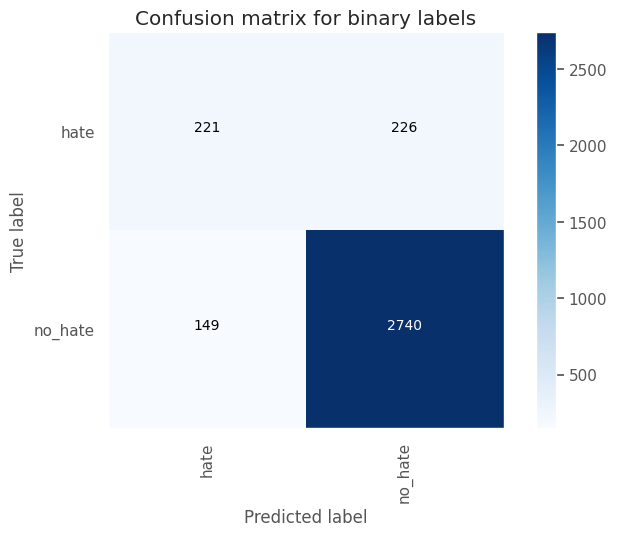

Test Accuracy: 0.8876
Test macro-F1: 0.7385




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier_lstm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_195 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_519 (Dropout)       (None, 128, 100)          0         
                                                                 
 bidirectional_1 (Bidirecti  (None, 32)                14976     
 onal)                                                           
                                                                 
 dropout_520 (Dropout)       (None, 32)                0         
                                                                 
 dense_364 (Dense)           (None, 4)          

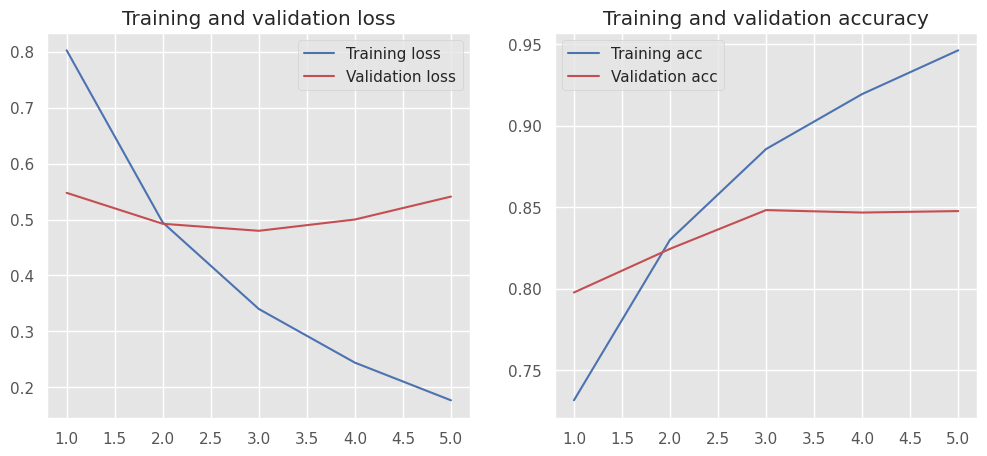

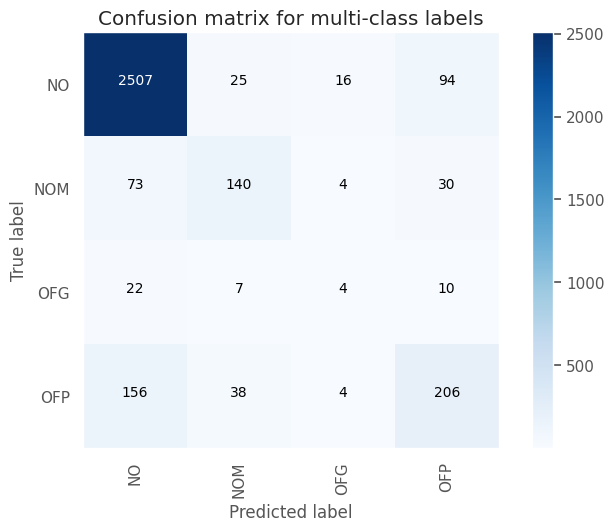

Test Accuracy: 0.8564
Test macro-F1: 0.5519


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6087    0.5011    0.5497       447
     no_hate     0.9249    0.9502    0.9373      2889

    accuracy                         0.8900      3336
   macro avg     0.7668    0.7256    0.7435      3336
weighted avg     0.8825    0.8900    0.8854      3336



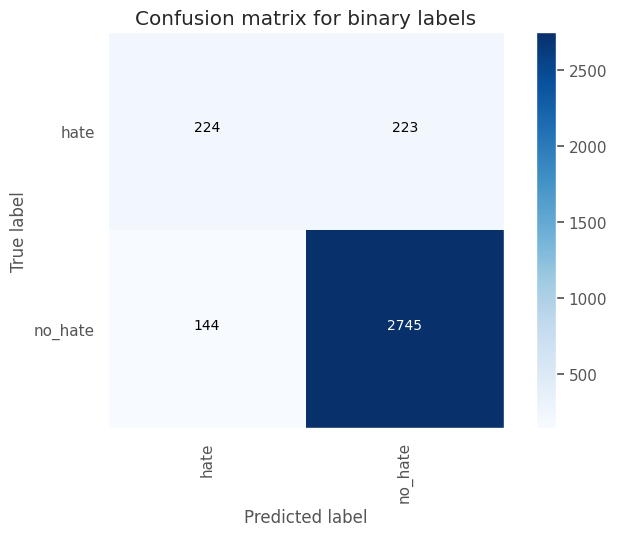

Test Accuracy: 0.89
Test macro-F1: 0.7435




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier_lstm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_196 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_521 (Dropout)       (None, 128, 100)          0         
                                                                 
 bidirectional_2 (Bidirecti  (None, 32)                14976     
 onal)                                                           
                                                                 
 dropout_522 (Dropout)       (None, 32)                0         
                                                                 
 dense_365 (Dense)           (None, 4)            

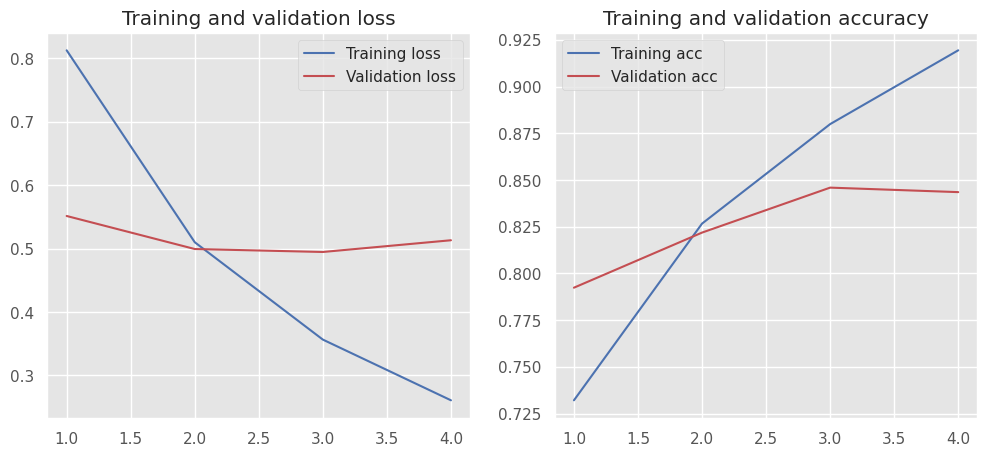

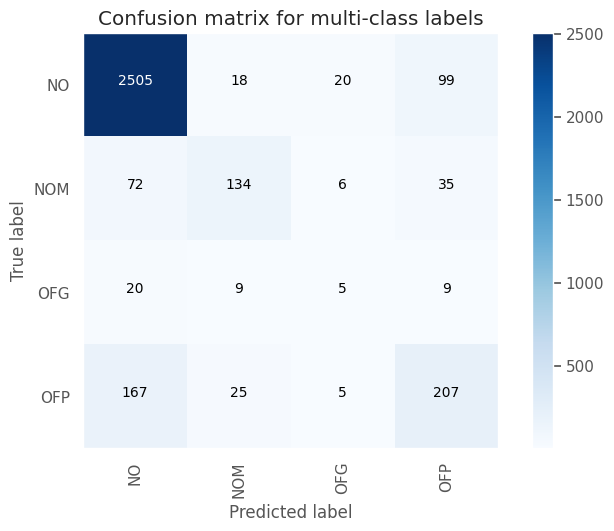

Test Accuracy: 0.8546
Test macro-F1: 0.5553


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5855    0.5056    0.5426       447
     no_hate     0.9251    0.9446    0.9347      2889

    accuracy                         0.8858      3336
   macro avg     0.7553    0.7251    0.7387      3336
weighted avg     0.8796    0.8858    0.8822      3336



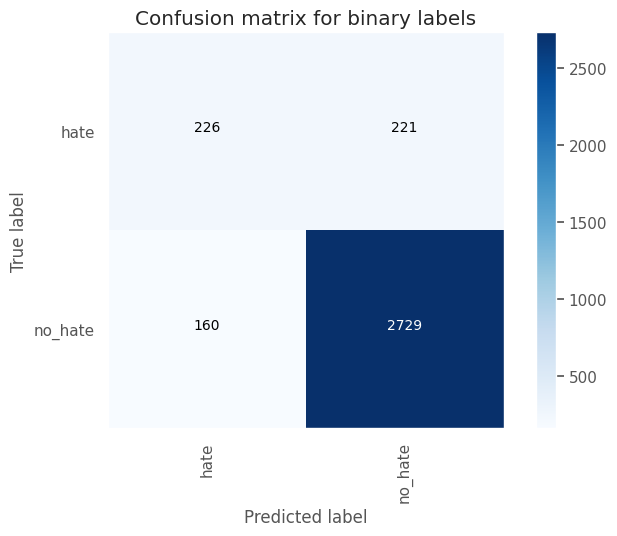

Test Accuracy: 0.8858
Test macro-F1: 0.7387




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier_lstm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_197 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_523 (Dropout)       (None, 128, 100)          0         
                                                                 
 bidirectional_3 (Bidirecti  (None, 32)                14976     
 onal)                                                           
                                                                 
 dropout_524 (Dropout)       (None, 32)                0         
                                                                 
 dense_366 (Dense)           (None, 4)          

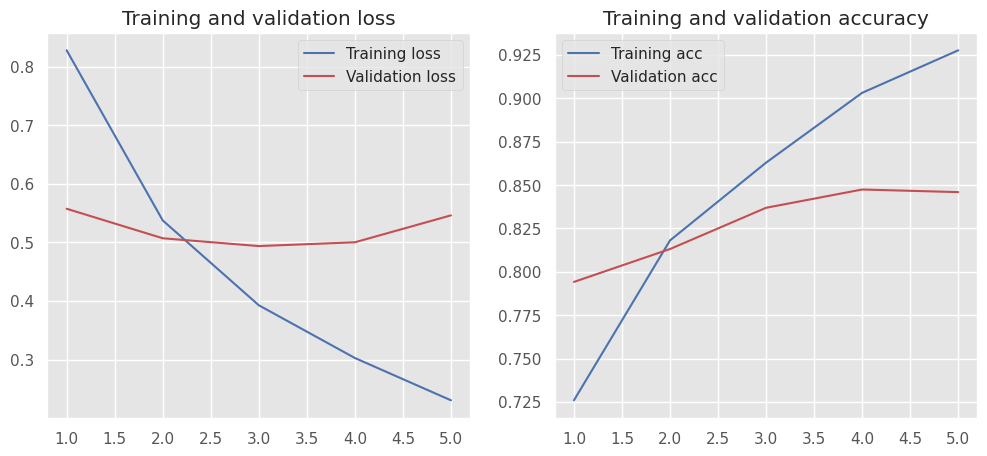

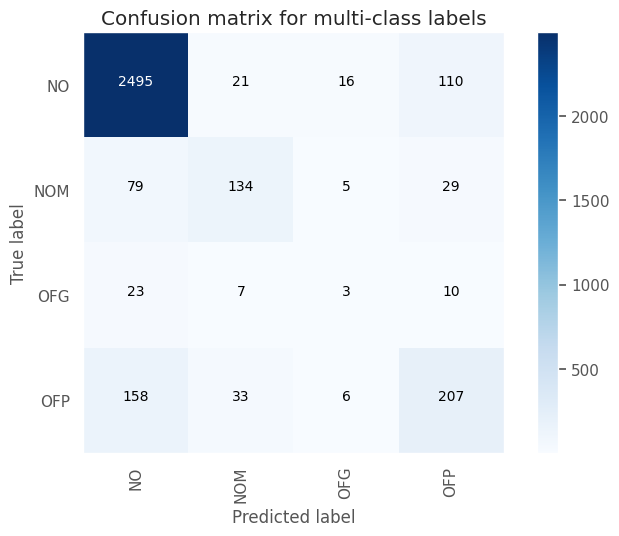

Test Accuracy: 0.851
Test macro-F1: 0.5395


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5855    0.5056    0.5426       447
     no_hate     0.9251    0.9446    0.9347      2889

    accuracy                         0.8858      3336
   macro avg     0.7553    0.7251    0.7387      3336
weighted avg     0.8796    0.8858    0.8822      3336



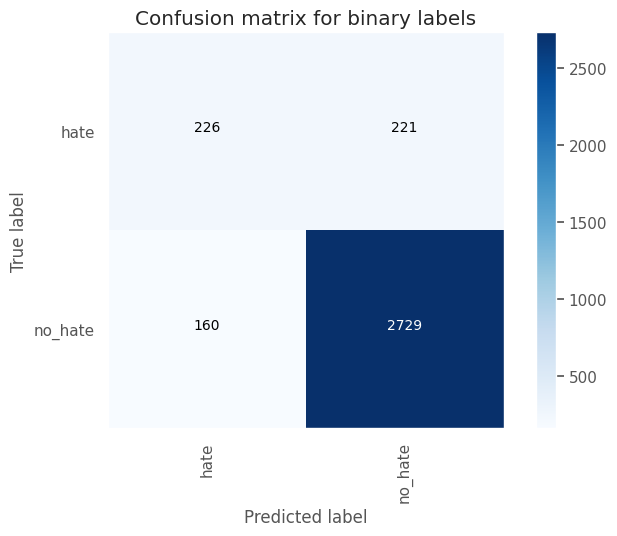

Test Accuracy: 0.8858
Test macro-F1: 0.7387







<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>2</th>
      <td>v6</td>
      <td>{'embedding_196': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_521': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'bidirectional_2': {'class_name': 'Bidirectional', 'param_count': 14976, 'input': (None, 128, 100), 'output': (None, 32)}, 'dropout_522': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_365': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1015208</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5893</td>
      <td>0.5298</td>
      <td>0.5553</td>
      <td>0.7553</td>
      <td>0.7251</td>
      <td>0.7387</td>
    </tr>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_195': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_519': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'bidirectional_1': {'class_name': 'Bidirectional', 'param_count': 14976, 'input': (None, 128, 100), 'output': (None, 32)}, 'dropout_520': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_364': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1015208</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5811</td>
      <td>0.5297</td>
      <td>0.5519</td>
      <td>0.7668</td>
      <td>0.7256</td>
      <td>0.7435</td>
    </tr>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_194': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_517': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'bidirectional': {'class_name': 'Bidirectional', 'param_count': 14976, 'input': (None, 128, 100), 'output': (None, 32)}, 'dropout_518': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_363': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1015208</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5798</td>
      <td>0.5188</td>
      <td>0.5449</td>
      <td>0.7606</td>
      <td>0.7214</td>
      <td>0.7385</td>
    </tr>
    <tr>
      <th>3</th>
      <td>v6</td>
      <td>{'embedding_197': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_523': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'bidirectional_3': {'class_name': 'Bidirectional', 'param_count': 14976, 'input': (None, 128, 100), 'output': (None, 32)}, 'dropout_524': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_366': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1015208</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'Adam', 'lr': 0.001}}</td>
      <td>0.5686</td>
      <td>0.5173</td>
      <td>0.5395</td>
      <td>0.7553</td>
      <td>0.7251</td>
      <td>0.7387</td>
    </tr>
  </tbody>
</table>
    

In [50]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

for rnn_dropout in [0.3, 0.5]:
  for emb_dropout in [0.3, 0.5]:
      # RNN model. Dump the whole config here so we can always see what we are sending  ===========
      model_config: KerasRNNClassifierModelConfig = KerasRNNClassifierModelConfig(
          vocab_size=vocab_size,
          model_name="rnn_classifier_lstm",
          embedding_config=EmbeddingConfig(
              output_dim=embedding_dim,
              input_length=max_length,
              pre_trained_matrix=None,
              trainable=True,
              dropout_rate=emb_dropout
          ),
          rnn_stack_config=RNNStackConfig(
              types=[RNNName.LSTM.value],
              units=[16],
              bidirectional=True,
              unroll=True,
              internal_dp_rates=[0.0],
              recurrent_dp_rates=[0.1],
              external_dp_rates=[rnn_dropout]
          ),
          classification_head_config=ClassificationHeadConfig(
              dense_activations=["softmax"],
              dense_dims=[4],
              dropout_rates=[0.0]
          ))
      model = RNNModelFactory.create(model_config)
      # ============================

      # Train  ===========
      trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                max_input_length=max_length))
      optim_config: OptimizationConfig = OptimizationConfig(
          epochs=25,
          batch_size=32,
          validation_split=0.0,
          validation_data=(x_val, y_val),
          optimizer=Adam(learning_rate=0.001),
          class_weight=None
      )
      trainer.train(x_train=x_train,
                    y_train=y_train,
                    opt_config=optim_config,
                    callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
      mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
      mc_report: dict
      bc_report: dict

      # Accumulate result so it can be plotted
      result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                      dataset_version=dataset_name,
                                      model_params=model.count_params(),
                                      optim_config=optim_config,
                                      macro_prec_mc=mc_report["macro avg"]["precision"],
                                      macro_recall_mc=mc_report["macro avg"]["recall"],
                                      macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                      macro_prec_bc=bc_report["macro avg"]["precision"],
                                      macro_recall_bc=bc_report["macro avg"]["recall"],
                                      macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                      )
      results_rep.accumulate(result)
      # ============================

report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)

Podemos comprobar que hacer uso de `Bidirectional` nos ayuda a lograr una mejor performance. **Alcanzamos 55.53% de macro-f1 (MULTI-CLASS) y 73.87% de macro-f1 (BINARY-CLASS)**.

Misma prueba con Bidirectional y RMSProp, que lo usamos en la práctica.

Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336
Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier_lstm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_198 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_525 (Dropout)       (None, 128, 100)          0         
                                                                 
 bidirectional_4 (Bidirecti  (None, 32)                14976     
 onal)                                                           
                                                                 
 dropout_526 (Dropout)       (None, 32)                0         
                                                                 
 dens

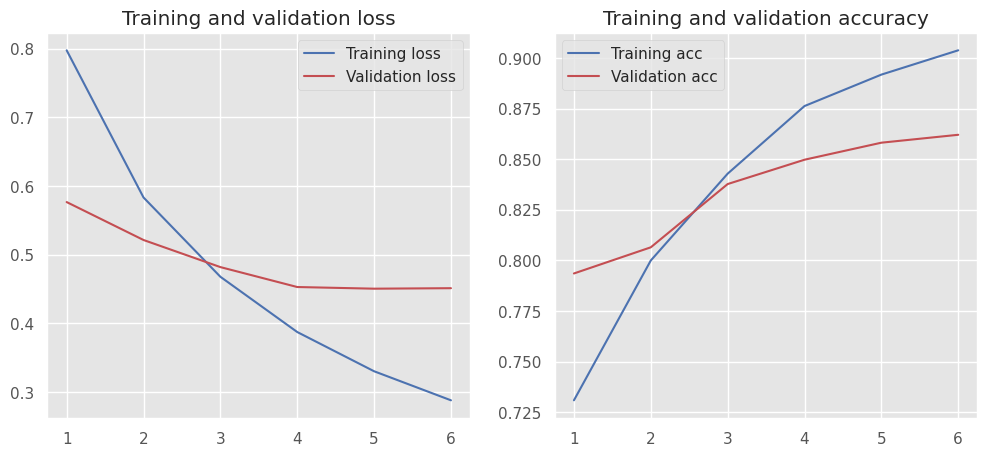

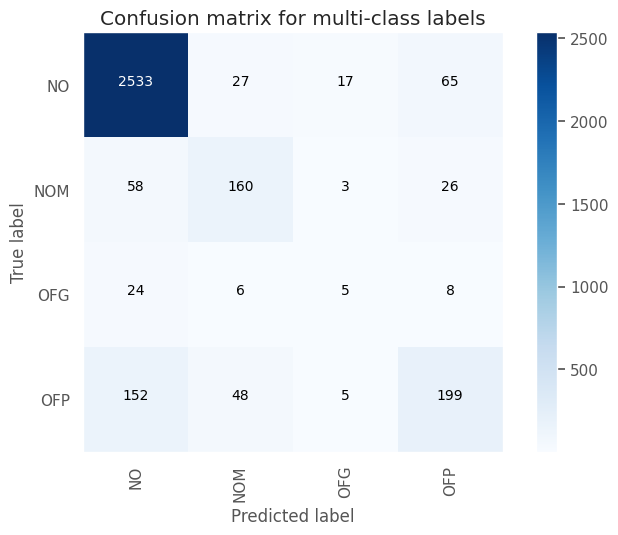

Test Accuracy: 0.8684
Test macro-F1: 0.5741


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6616    0.4855    0.5600       447
     no_hate     0.9235    0.9616    0.9422      2889

    accuracy                         0.8978      3336
   macro avg     0.7926    0.7235    0.7511      3336
weighted avg     0.8884    0.8978    0.8910      3336



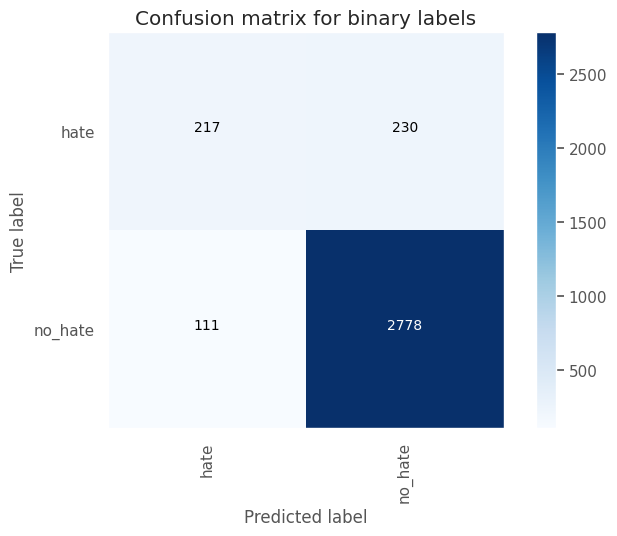

Test Accuracy: 0.8978
Test macro-F1: 0.7511




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier_lstm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_199 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_527 (Dropout)       (None, 128, 100)          0         
                                                                 
 bidirectional_5 (Bidirecti  (None, 32)                14976     
 onal)                                                           
                                                                 
 dropout_528 (Dropout)       (None, 32)                0         
                                                                 
 dense_368 (Dense)           (None, 4)          

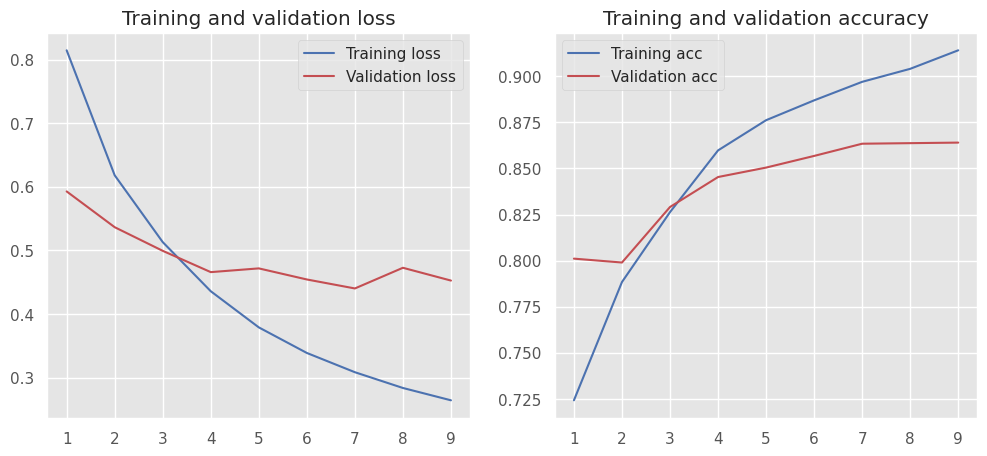

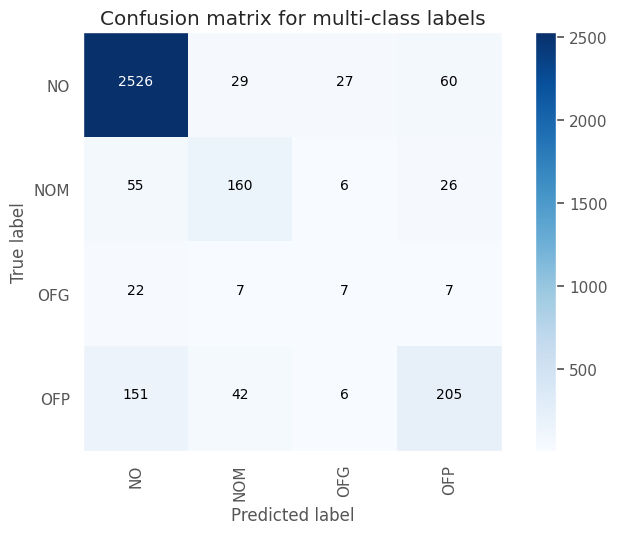

Test Accuracy: 0.8687
Test macro-F1: 0.5843


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6541    0.5034    0.5689       447
     no_hate     0.9258    0.9588    0.9420      2889

    accuracy                         0.8978      3336
   macro avg     0.7899    0.7311    0.7555      3336
weighted avg     0.8894    0.8978    0.8920      3336



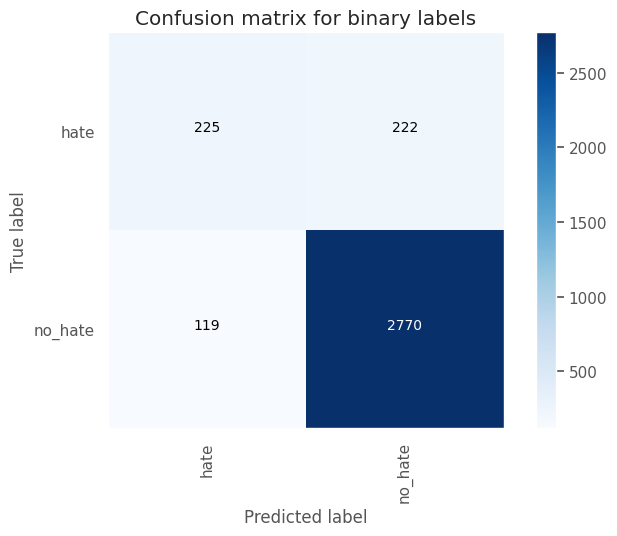

Test Accuracy: 0.8978
Test macro-F1: 0.7555




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier_lstm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_200 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_529 (Dropout)       (None, 128, 100)          0         
                                                                 
 bidirectional_6 (Bidirecti  (None, 32)                14976     
 onal)                                                           
                                                                 
 dropout_530 (Dropout)       (None, 32)                0         
                                                                 
 dense_369 (Dense)           (None, 4)          

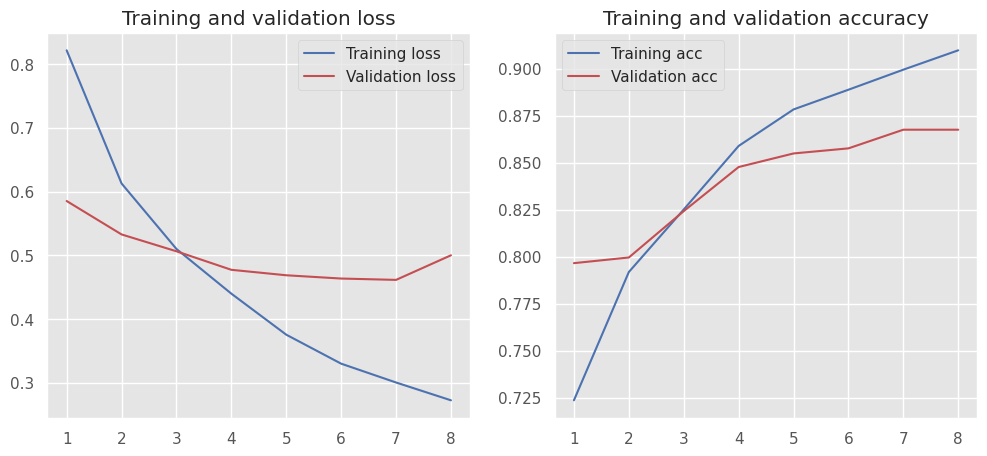

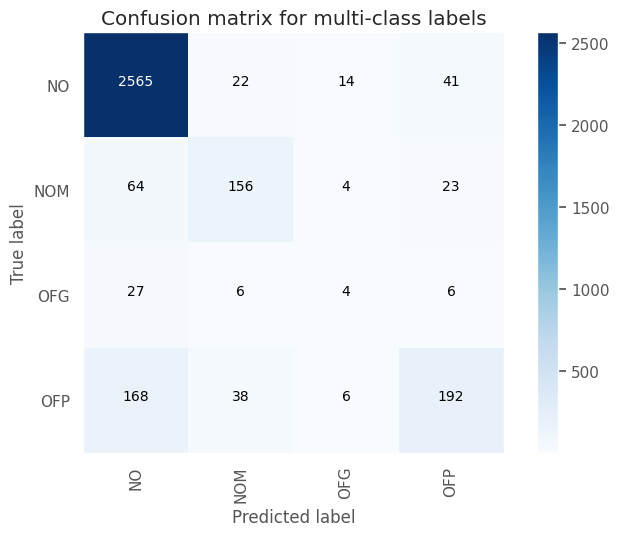

Test Accuracy: 0.8744
Test macro-F1: 0.5733


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.7172    0.4653    0.5645       447
     no_hate     0.9215    0.9716    0.9459      2889

    accuracy                         0.9038      3336
   macro avg     0.8194    0.7185    0.7552      3336
weighted avg     0.8942    0.9038    0.8948      3336



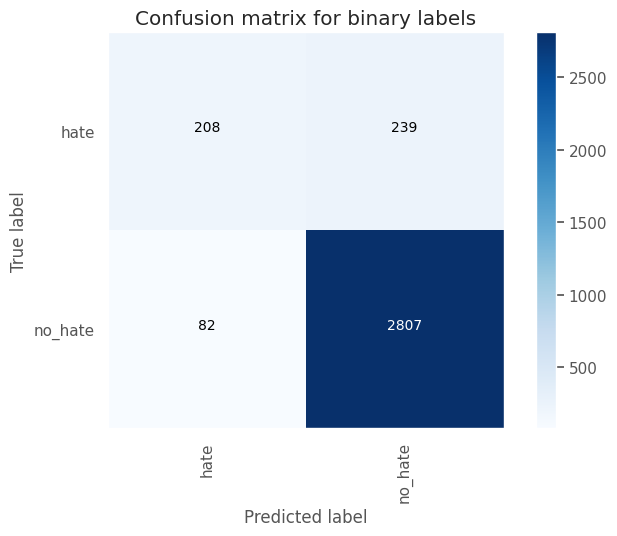

Test Accuracy: 0.9038
Test macro-F1: 0.7552




Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier_lstm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_201 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_531 (Dropout)       (None, 128, 100)          0         
                                                                 
 bidirectional_7 (Bidirecti  (None, 32)                14976     
 onal)                                                           
                                                                 
 dropout_532 (Dropout)       (None, 32)                0         
                                                                 
 dense_370 (Dense)           (None, 4)          

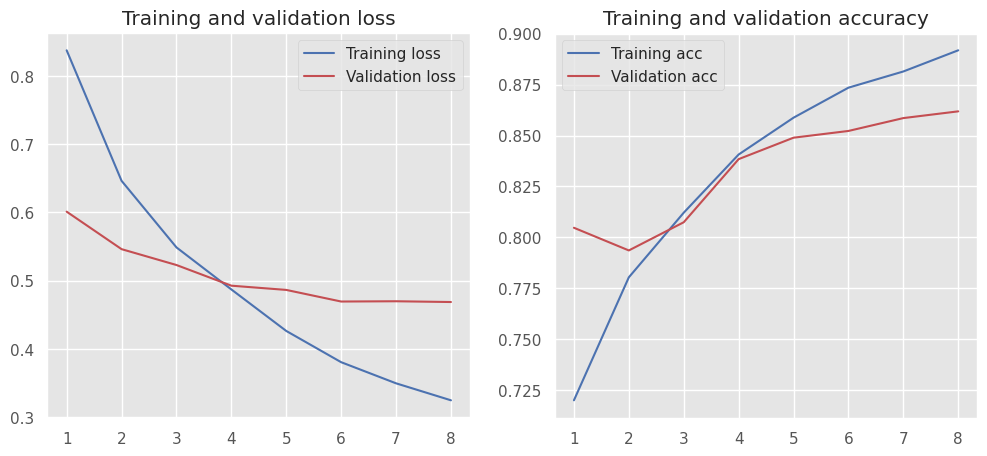

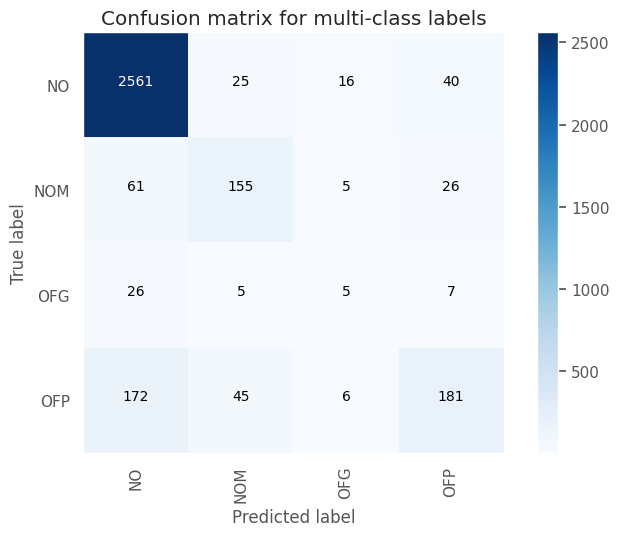

Test Accuracy: 0.8699
Test macro-F1: 0.5678


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6958    0.4452    0.5430       447
     no_hate     0.9187    0.9699    0.9436      2889

    accuracy                         0.8996      3336
   macro avg     0.8072    0.7075    0.7433      3336
weighted avg     0.8888    0.8996    0.8899      3336



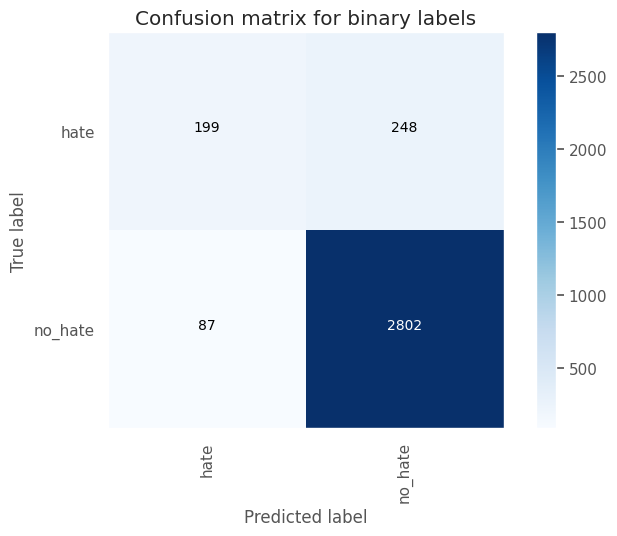

Test Accuracy: 0.8996
Test macro-F1: 0.7433







<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>1</th>
      <td>v6</td>
      <td>{'embedding_199': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_527': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'bidirectional_5': {'class_name': 'Bidirectional', 'param_count': 14976, 'input': (None, 128, 100), 'output': (None, 32)}, 'dropout_528': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_368': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1015208</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'RMSprop', 'lr': 0.001}}</td>
      <td>0.6074</td>
      <td>0.5685</td>
      <td>0.5843</td>
      <td>0.7899</td>
      <td>0.7311</td>
      <td>0.7555</td>
    </tr>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_198': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_525': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'bidirectional_4': {'class_name': 'Bidirectional', 'param_count': 14976, 'input': (None, 128, 100), 'output': (None, 32)}, 'dropout_526': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_367': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1015208</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'RMSprop', 'lr': 0.001}}</td>
      <td>0.6034</td>
      <td>0.5538</td>
      <td>0.5741</td>
      <td>0.7926</td>
      <td>0.7235</td>
      <td>0.7511</td>
    </tr>
    <tr>
      <th>2</th>
      <td>v6</td>
      <td>{'embedding_200': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_529': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'bidirectional_6': {'class_name': 'Bidirectional', 'param_count': 14976, 'input': (None, 128, 100), 'output': (None, 32)}, 'dropout_530': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_369': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1015208</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'RMSprop', 'lr': 0.001}}</td>
      <td>0.6217</td>
      <td>0.5427</td>
      <td>0.5733</td>
      <td>0.8194</td>
      <td>0.7185</td>
      <td>0.7552</td>
    </tr>
    <tr>
      <th>3</th>
      <td>v6</td>
      <td>{'embedding_201': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_531': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'bidirectional_7': {'class_name': 'Bidirectional', 'param_count': 14976, 'input': (None, 128, 100), 'output': (None, 32)}, 'dropout_532': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 32), 'output': (None, 32)}, 'dense_370': {'class_name': 'Dense', 'param_count': 132, 'input': (None, 32), 'output': (None, 4)}}</td>
      <td>1015208</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'RMSprop', 'lr': 0.001}}</td>
      <td>0.6127</td>
      <td>0.5403</td>
      <td>0.5678</td>
      <td>0.8072</td>
      <td>0.7075</td>
      <td>0.7433</td>
    </tr>
  </tbody>
</table>
    

In [51]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

for rnn_dropout in [0.3, 0.5]:
  for emb_dropout in [0.3, 0.5]:
      # RNN model. Dump the whole config here so we can always see what we are sending  ===========
      model_config: KerasRNNClassifierModelConfig = KerasRNNClassifierModelConfig(
          vocab_size=vocab_size,
          model_name="rnn_classifier_lstm",
          embedding_config=EmbeddingConfig(
              output_dim=embedding_dim,
              input_length=max_length,
              pre_trained_matrix=None,
              trainable=True,
              dropout_rate=emb_dropout
          ),
          rnn_stack_config=RNNStackConfig(
              types=[RNNName.LSTM.value],
              units=[16],
              bidirectional=True,
              unroll=True,
              internal_dp_rates=[0.0],
              recurrent_dp_rates=[0.1],
              external_dp_rates=[rnn_dropout]
          ),
          classification_head_config=ClassificationHeadConfig(
              dense_activations=["softmax"],
              dense_dims=[4],
              dropout_rates=[0.0]
          ))
      model = RNNModelFactory.create(model_config)
      # ============================

      # Train  ===========
      trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                max_input_length=max_length))
      optim_config: OptimizationConfig = OptimizationConfig(
          epochs=25,
          batch_size=32,
          validation_split=0.0,
          validation_data=(x_val, y_val),
          optimizer=RMSprop(learning_rate=0.001),
          class_weight=None
      )
      trainer.train(x_train=x_train,
                    y_train=y_train,
                    opt_config=optim_config,
                    callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
      mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
      mc_report: dict
      bc_report: dict

      # Accumulate result so it can be plotted
      result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                      dataset_version=dataset_name,
                                      model_params=model.count_params(),
                                      optim_config=optim_config,
                                      macro_prec_mc=mc_report["macro avg"]["precision"],
                                      macro_recall_mc=mc_report["macro avg"]["recall"],
                                      macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                      macro_prec_bc=bc_report["macro avg"]["precision"],
                                      macro_recall_bc=bc_report["macro avg"]["recall"],
                                      macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                      )
      results_rep.accumulate(result)
      # ============================

report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)

Para nuestra sorpresa, el cambio en el Optimizador tiene un gran impacto en los resultados obtenidos. En este caso, obtenemos un **58.43% de macro-f1 (MULTI-CLASS) y 75.55% de macro-f1 (BINARY-CLASS)**, lo cual marca nuestro nuevo mejor resultado con RNNs.

Para concluir, veré si stackeando LSTMs podemos mejorar un poco los resultados o no.

Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336


Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier_lstm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_218 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_581 (Dropout)       (None, 128, 100)          0         
                                                                 
 bidirectional_8 (Bidirecti  (None, 128, 128)          84480     
 onal)                                                           
                                                                 
 dropout_582 (Dropout)       (None, 128, 128)          0         
                                                                 
 bidirectional_9 (Bidirecti  (None, 64)                41216     
 onal)                        

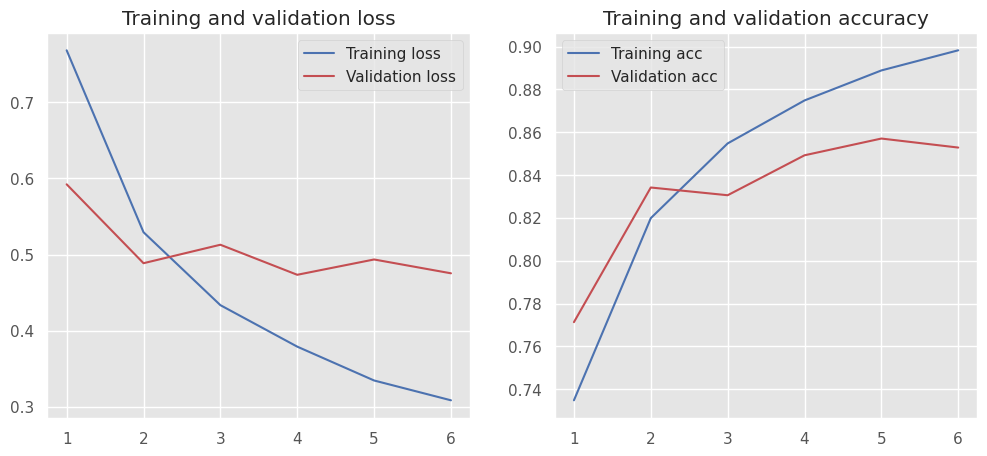

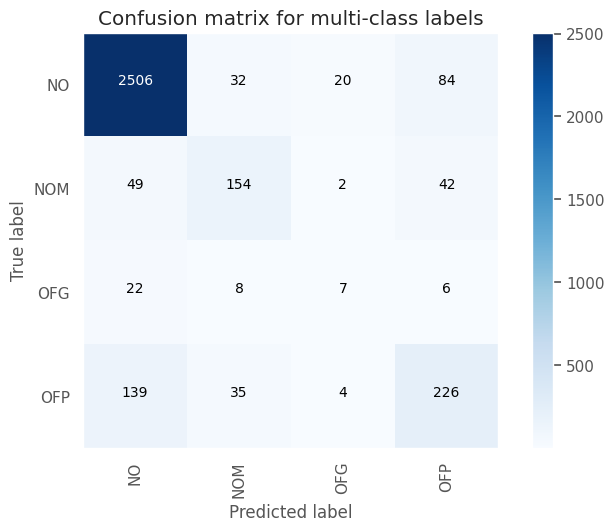

Test Accuracy: 0.8672
Test macro-F1: 0.59


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.6215    0.5436    0.5800       447
     no_hate     0.9307    0.9488    0.9397      2889

    accuracy                         0.8945      3336
   macro avg     0.7761    0.7462    0.7598      3336
weighted avg     0.8893    0.8945    0.8915      3336



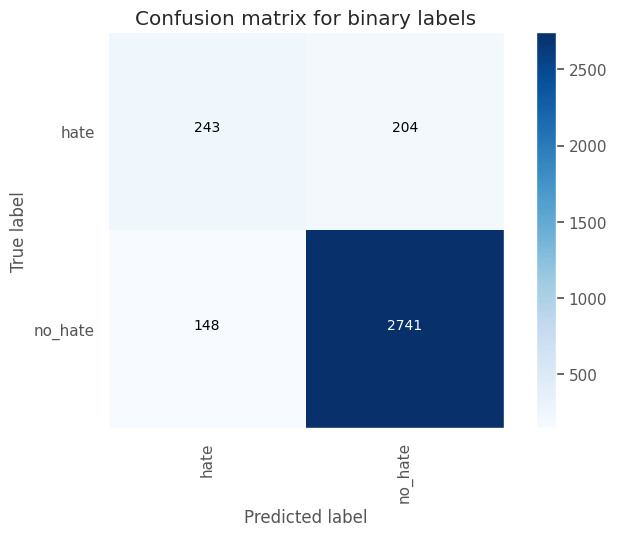

Test Accuracy: 0.8945
Test macro-F1: 0.7598







<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_218': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_581': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'bidirectional_8': {'class_name': 'Bidirectional', 'param_count': 84480, 'input': (None, 128, 100), 'output': (None, 128, 128)}, 'dropout_582': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 128), 'output': (None, 128, 128)}, 'bidirectional_9': {'class_name': 'Bidirectional', 'param_count': 41216, 'input': (None, 128, 128), 'output': (None, 64)}, 'dropout_583': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_403': {'class_name': 'Dense', 'param_count': 8320, 'input': (None, 64), 'output': (None, 128)}, 'dropout_584': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_404': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1134632</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'RMSprop', 'lr': 0.001}}</td>
      <td>0.6096</td>
      <td>0.5736</td>
      <td>0.59</td>
      <td>0.7761</td>
      <td>0.7462</td>
      <td>0.7598</td>
    </tr>
  </tbody>
</table>
    

In [56]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

for rnn_dropout in [0.3]:
  for emb_dropout in [0.5]:
      # RNN model. Dump the whole config here so we can always see what we are sending  ===========
      model_config: KerasRNNClassifierModelConfig = KerasRNNClassifierModelConfig(
          vocab_size=vocab_size,
          model_name="rnn_classifier_lstm",
          embedding_config=EmbeddingConfig(
              output_dim=embedding_dim,
              input_length=max_length,
              pre_trained_matrix=None,
              trainable=True,
              dropout_rate=emb_dropout
          ),
          rnn_stack_config=RNNStackConfig(
              types=[RNNName.LSTM.value]*2,
              units=[64, 32],
              bidirectional=True,
              unroll=True,
              internal_dp_rates=[0.0]*2,
              recurrent_dp_rates=[0.1]*2,
              external_dp_rates=[rnn_dropout]*2
          ),
          classification_head_config=ClassificationHeadConfig(
              dense_activations=["relu", "softmax"],
              dense_dims=[128, 4],
              dropout_rates=[0.3, 0.0]
          ))
      model = RNNModelFactory.create(model_config)
      # ============================

      # Train  ===========
      trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                max_input_length=max_length))
      optim_config: OptimizationConfig = OptimizationConfig(
          epochs=25,
          batch_size=32,
          validation_split=0.0,
          validation_data=(x_val, y_val),
          optimizer=RMSprop(learning_rate=0.001),
          class_weight=None
      )
      trainer.train(x_train=x_train,
                    y_train=y_train,
                    opt_config=optim_config,
                    callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
      mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
      mc_report: dict
      bc_report: dict

      # Accumulate result so it can be plotted
      result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                      dataset_version=dataset_name,
                                      model_params=model.count_params(),
                                      optim_config=optim_config,
                                      macro_prec_mc=mc_report["macro avg"]["precision"],
                                      macro_recall_mc=mc_report["macro avg"]["recall"],
                                      macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                      macro_prec_bc=bc_report["macro avg"]["precision"],
                                      macro_recall_bc=bc_report["macro avg"]["recall"],
                                      macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                      )
      results_rep.accumulate(result)
      # ============================

report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)

Con esta arquitectura llegamos a **59% de macro-f1 (MULTI-CLASS) y 75.98% de macro-f1 (BINARY CLASS)**. Naturalmente podemos seguir realizando más pruebas para optimizar esta arquitectura.

Como última, veré si reduciendo el learning_rate podemos entrenar por más tiempo y por tanto mejorar los resultados.

Total elements for train: 11059
Total elements for val: 3323
Total elements for test: 3336


Training tokenizer on x_train...
Tokenizer trained!
Tokenizing and padding x_train...
Done!
Training label encoder on y_train
Label encoder trained!
Model: "rnn_classifier_lstm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_219 (Embedding)   (None, 128, 100)          1000100   
                                                                 
 dropout_585 (Dropout)       (None, 128, 100)          0         
                                                                 
 bidirectional_10 (Bidirect  (None, 128, 128)          84480     
 ional)                                                          
                                                                 
 dropout_586 (Dropout)       (None, 128, 128)          0         
                                                                 
 bidirectional_11 (Bidirect  (None, 64)                41216     
 ional)                       

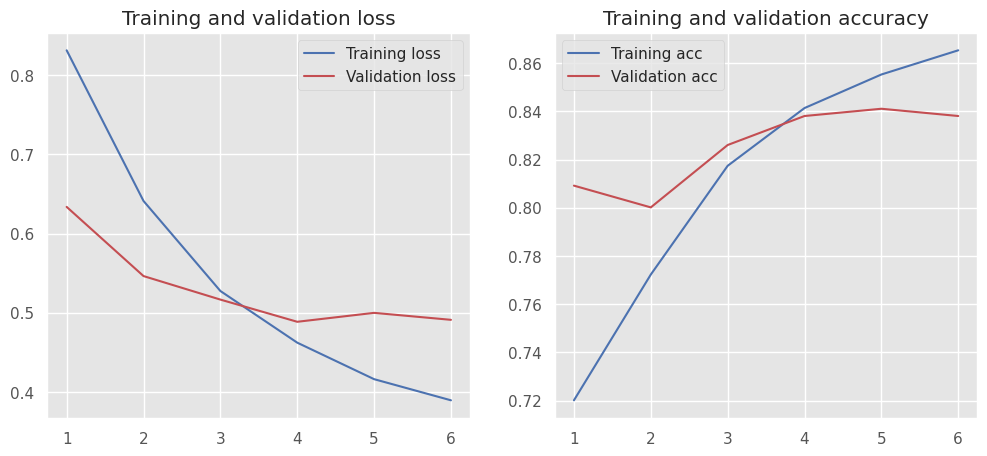

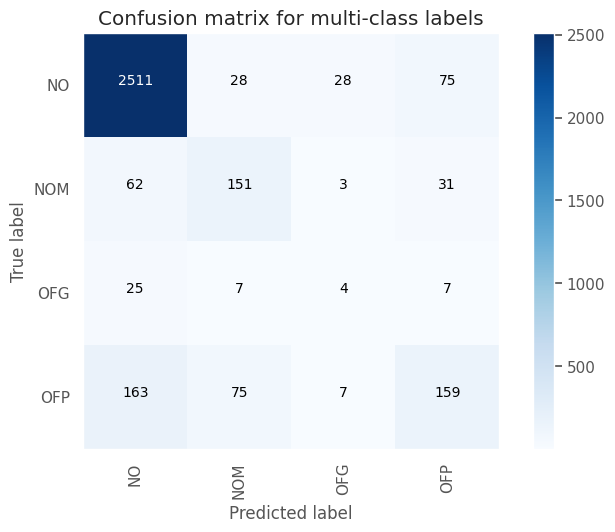

Test Accuracy: 0.8468
Test macro-F1: 0.5221


 TEST SET REPORT (BINARY-CLASS) =================================
              precision    recall  f1-score   support

        hate     0.5637    0.3960    0.4652       447
     no_hate     0.9107    0.9526    0.9311      2889

    accuracy                         0.8780      3336
   macro avg     0.7372    0.6743    0.6982      3336
weighted avg     0.8642    0.8780    0.8687      3336



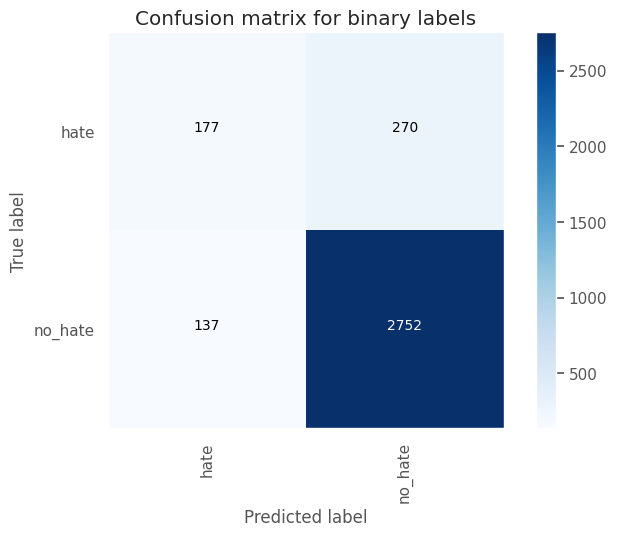

Test Accuracy: 0.878
Test macro-F1: 0.6982







<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>dataset_version</th>
      <th>model_config</th>
      <th>model_params</th>
      <th>optim</th>
      <th>macro_prec_mc</th>
      <th>macro_recall_mc</th>
      <th>macro_f1_mc</th>
      <th>macro_prec_bc</th>
      <th>macro_recall_bc</th>
      <th>macro_f1_bc</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>0</th>
      <td>v6</td>
      <td>{'embedding_219': {'class_name': 'Embedding', 'param_count': 1000100, 'input': (None, 128), 'output': (None, 128, 100)}, 'dropout_585': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 100), 'output': (None, 128, 100)}, 'bidirectional_10': {'class_name': 'Bidirectional', 'param_count': 84480, 'input': (None, 128, 100), 'output': (None, 128, 128)}, 'dropout_586': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128, 128), 'output': (None, 128, 128)}, 'bidirectional_11': {'class_name': 'Bidirectional', 'param_count': 41216, 'input': (None, 128, 128), 'output': (None, 64)}, 'dropout_587': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 64), 'output': (None, 64)}, 'dense_405': {'class_name': 'Dense', 'param_count': 8320, 'input': (None, 64), 'output': (None, 128)}, 'dropout_588': {'class_name': 'Dropout', 'param_count': 0, 'input': (None, 128), 'output': (None, 128)}, 'dense_406': {'class_name': 'Dense', 'param_count': 516, 'input': (None, 128), 'output': (None, 4)}}</td>
      <td>1134632</td>
      <td>{'epochs': 25, 'batch_size': 32, 'loss': 'categorical_crossentropy', 'metrics': ['acc'], 'class_weight': None, 'optimizer': {'name': 'RMSprop', 'lr': 0.0005}}</td>
      <td>0.5419</td>
      <td>0.5121</td>
      <td>0.5221</td>
      <td>0.7372</td>
      <td>0.6743</td>
      <td>0.6982</td>
    </tr>
  </tbody>
</table>
    

In [57]:
vocab_size: int = 10000 + 1 # +1 for padding
max_length: int = 128
embedding_dim: int = 100

results_rep: ResultsReporter = ResultsReporter()

# Data
dataset_folder: str = dataset_v6_folder
dataset_name: str = "v6"
data: dict[str, list[str]] = prepare_data_for_training(dataset_folder)
x_train, y_train, x_val, y_val, x_test, y_test = data["x_train"], data["y_train"], data["x_val"], data["y_val"], data["x_test"], data["y_test"]

for rnn_dropout in [0.3]:
  for emb_dropout in [0.5]:
      # RNN model. Dump the whole config here so we can always see what we are sending  ===========
      model_config: KerasRNNClassifierModelConfig = KerasRNNClassifierModelConfig(
          vocab_size=vocab_size,
          model_name="rnn_classifier_lstm",
          embedding_config=EmbeddingConfig(
              output_dim=embedding_dim,
              input_length=max_length,
              pre_trained_matrix=None,
              trainable=True,
              dropout_rate=emb_dropout
          ),
          rnn_stack_config=RNNStackConfig(
              types=[RNNName.LSTM.value]*2,
              units=[64, 32],
              bidirectional=True,
              unroll=True,
              internal_dp_rates=[0.0]*2,
              recurrent_dp_rates=[0.1]*2,
              external_dp_rates=[rnn_dropout]*2
          ),
          classification_head_config=ClassificationHeadConfig(
              dense_activations=["relu", "softmax"],
              dense_dims=[128, 4],
              dropout_rates=[0.3, 0.0]
          ))
      model = RNNModelFactory.create(model_config)
      # ============================

      # Train  ===========
      trainer: DLClassifier = DLClassifier(keras_model=model, tokenizer_config=TokenizerConfig(num_words=vocab_size,
                                                                                                max_input_length=max_length))
      optim_config: OptimizationConfig = OptimizationConfig(
          epochs=25,
          batch_size=32,
          validation_split=0.0,
          validation_data=(x_val, y_val),
          optimizer=RMSprop(learning_rate=0.0005),
          class_weight=None
      )
      trainer.train(x_train=x_train,
                    y_train=y_train,
                    opt_config=optim_config,
                    callbacks=[EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)])
      mc_report, bc_report = trainer.predict_with_report(x_test=x_test, y_test=y_test)
      mc_report: dict
      bc_report: dict

      # Accumulate result so it can be plotted
      result: ResultInfo = ResultInfo(model_config=keras_model_to_dict(model),
                                      dataset_version=dataset_name,
                                      model_params=model.count_params(),
                                      optim_config=optim_config,
                                      macro_prec_mc=mc_report["macro avg"]["precision"],
                                      macro_recall_mc=mc_report["macro avg"]["recall"],
                                      macro_f1_mc=mc_report["macro avg"]["f1-score"],
                                      macro_prec_bc=bc_report["macro avg"]["precision"],
                                      macro_recall_bc=bc_report["macro avg"]["recall"],
                                      macro_f1_bc=bc_report["macro avg"]["f1-score"]
                                      )
      results_rep.accumulate(result)
      # ============================

report_df: pd.DataFrame = results_rep.build_report()
display_df_markdown(report_df)

No logramos mejorar los resultados anteriores.

# Conclusiones y Resultados

Realizamos varias pruebas con distintos modelos basados en algoritmos de Deep Learning.
Nos enfocamos principalmente en modelos que históricamente han demostrado tener muy buena performance para hate-speech detection, como `RNNs` y `CNNs` y por completitud hicimos algunas pruebas con `Dense Neural Networks` también.

En términos generales, los tres tipos de redes performaron de manera muy similar, y pobre desde mi punto de vista, no llegando a superar a los baselines planteados en el notebook anterior.

Cabe recalcar también, que por cuestiones de tiempo no llegué a hacer una optimización extensiva de las diferentes arquitecturas, si no que fui más conservador a plantear directamente esquemas que pensaba que podían funcionar bien y a evaluarlos. Seguramente con más tiempo para optimizar los parámetros podríamos haber logrado superar a los ML-based baselines.
Tampoco pude explorar otras representaciones de texto como BOW (TF, TF-IDF) y feature selection, fui directamente a los enfoques más clásicos de `Tokenizer` y `Embedding` layer.

Como problemas, notamos siempre los mismos que hemos visto en el notebook anterior respecto a los datos. No logramos entrenar por muchas epochs, y siempre tenemos esa misma dificultad en reconocer `OFG`, inclusive utilizando técnicas de data augmentation (a través de generación de samples sintéticos) y de Random Over Sampling para nivelar la cantidad de ejemplos por clase. Estos problemas se ven en todas las arquitecturas exploradas.

⚠️ Por otro lado, algo que no llegamos a explorar fue probar embeddings pre-entrenados en español, de forma de ver si logramos alcanzar una mejor performance. Tengo mis dudas respecto a si esto nos hubiera beneficiado bastante o no, ya que mucho del vocabulario que se usa en los tweets siento que hubiera quedado fuera del vocabulario típicamente brindado por embeddings pre-entrenados como [FastText](https://fasttext.cc/docs/en/crawl-vectors.html). Este [repositorio de GitHub](https://github.com/dccuchile/spanish-word-embeddings) tiene una buena recopilación de embeddings pre-entrenados que podríamos haber utilizado. Notar que en este caso, hubiese sido necesario también desarrollar un nuevo cleanup (y por tanto una nueva versión de nuestro dataset) que probablemente use stemming y lemmatization para intentar abarcar un mayor vocabulario del brindado por los embeddings pre-entrenados.

Como conclusiones adicionales:
- Exploramos el uso de `class_weight="balanced"` pero no nos trajo mejorías.
- Los tres tipos de modelos tienen una performance muy similar.
- 🥇 El mejor modelo para MULTI-CLASS y BINARY-CLASS se obtiene a través de BiLSTMs alcanzando un 59% de macro-f1 y 75.98% de macro-f1 respectivamente.

Si tuviese que elegir un modelo para desplegar en producción, probablemente elegiría el mejor de los tres, ya que son bastante pequeños. Si la velocidad de inferencia fuese una limitante, entonces el obtenido a través de Dense layers sería sin dudas la opción a seguir.

El resumen de los mejores resultados se presenta en la siguiente tabla. _Notar que `MC` significa `MULTI-CLASS` y `BC` hace referencia a la performance para `BINARY-CLASS`_.

<br>

| Model     | Model Size | Dataset | Representation                                                                    | macro-precision (MC) | macro-recall (MC) | macro-F1 (MC) | macro-precision (BC) | macro-recall (BC) | macro-F1 (BC) | Config highlights                                                                                                                                                                                                                                                                                                                                                                                     |
| --------- | ---------- | ------- | --------------------------------------------------------------------------------- | --------------- | ------------ | -------- | --------------- | ------------ | -------- | ----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------- |
| Dense NNs | 4.27M      | v2      | Embeddings: from scratch<br>max_length=128<br>vocab_size=10001<br>output_dim: 100 | 0.6010          | 0.5275       | 0.5566   | 0.7871          | 0.7116       | 0.7407   | (batch_size=32, dense_dims=[256, 4], dense_act=["relu", "softmax"], dp_after_emb=0.5, dp_before_class_head=0.7, class_weight=None, Adam(learning_rate=0.001), EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01))                                                                                                                                                              |
| CNNs      | 1.2M       | v6      | Embeddings: from scratch<br>max_length=128<br>vocab_size=10001<br>output_dim: 100 | 0.5685          | 0.5548       | 0.5611   | 0.7238          | 0.7061       | 0.7144   | (batch_size=32, cnn_filter_dims: [64], cnn_kernel_sizes=[3], cnn_activations=["relu"], dense_act=["relu"], use_global_pooling=False, dp_after_emb=0.5, dp_after_pooling=[0.0], dp_before_class_head=0.1, dense_dims=[64, 4], dense_act=["relu", "softmax"], class_weight=None, Adam(learning_rate=0.001), EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01))                  |
| RNNs      | 1M         | v6      | Embeddings: from scratch<br>max_length=128<br>vocab_size=10001<br>output_dim: 100 | 0.6096          | 0.5736       | **0.5900**   | 0.7761          | 0.7462       | **0.7598**   | (batch_size=32, emb_dp=0.5, types=[RNNName.LSTM.value]\*2, units=[64, 32], bidirectional=True, unroll=True, internal_dp_rates=[0.0]\*2, recurrent_dp_rates=[0.1]\*2, external_dp_rates=[0.3]\*2, dense_dims=[128, 4], dense_dp=[0.3, 0.0], dense_act=["relu", "softmax"], class_weight=None, RMSprop(learning_rate=0.001), EarlyStopping(monitor='val_loss', mode='min', patience=2, min_delta=0.01)) |

<br>


_Los resultados de este notebook y del resto, pueden visualizarse en el siguiente [Google Spreadsheet](https://docs.google.com/spreadsheets/d/1mzY6YMFSP3kXgH3qgbJnX1w0f463ZQ06n32tLGgqOos/edit?usp=sharing). Para más información, dirigirse a `5_results_and_conclusions.ipynb`, la cual también los muestra y concluye nuestra práctica._

